In [1]:
import os
import sys
import pickle
import numpy as np
import matplotlib.pyplot as plt

from tqdm import tqdm
from scipy.linalg import block_diag

module_path = os.path.abspath(os.path.join('../../src'))
if module_path not in sys.path:
    sys.path.append(module_path)
    
module_path = os.path.abspath(os.path.join('../../data'))
if module_path not in sys.path:
    sys.path.append(module_path)
    
from dynamics import Dynamics
from utils import get_form_initial_conditions
from gauss_newton import GaussNewton

In [2]:
# Position estimation error
def position_estimation_error(X_est, X_true):
    return np.linalg.norm(X_est[:3, :, :] - X_true[:3, :, :], axis=0).flatten(), np.linalg.norm(X_est[6:9, :, :] - X_true[6:9, :, :], axis=0).flatten(), np.linalg.norm(X_est[12:15, :, :] - X_true[12:15, :, :], axis=0).flatten(), np.linalg.norm(X_est[18:21, :, :] - X_true[18:21, :, :], axis=0).flatten()

In [3]:
# Simulation parameters
dt = 60.0  # Time step [s]
K = 395  # Duration [min]
M = 1  # Number of Monte-Carlo simulations
N = 4  # Number of satellites
formation = 1
n_x = 6 
n_p = 3  
n = N * n_x
o = 3 + 3 + 2 + 1 
H = 10 # Window size [min]
invalid_rmse = 1e20 # [m]
grad_norm_order_mag = True
grad_norm_tol = 1e-6
max_iterations = 20
dyn = Dynamics()

In [4]:
# Observation noise
r_chief_pos = 1e-1  # [m]
R_chief = np.diag(np.concatenate([r_chief_pos * np.ones(3)])) ** 2
r_deputy_pos = 1e0  # [m]
R_deputies = np.diag(np.concatenate([r_deputy_pos * np.ones(6)])) ** 2
R = block_diag(R_chief, R_deputies)

# Initial deviation noise
p_pos_initial = 1e2  # [m]
p_vel_initial = 1e-2  # [m / s]
P_0 = np.diag(np.concatenate([p_pos_initial * np.ones(3), p_vel_initial * np.ones(3)])) ** 2
P_0 = block_diag(P_0, P_0, P_0, P_0)

In [5]:
def plots(k, algorithm_class):
    iterations = np.arange(0, algorithm_class.iterations + 1)

    fig, axs = plt.subplots(1, 2, figsize=(12, 5))

    # Plot 1
    axs[0].semilogy(iterations, 1 / H * np.array(algorithm_class.cost_values), '.-')
    axs[0].set_xlabel(r'$n$')
    axs[0].set_ylabel(r'$\frac{1}{H}J(x_n)$')
    axs[0].set_title('Normalized Cost Function') 
    axs[0].grid()

    # Plot 2
    axs[1].semilogy(iterations, 1 / H * np.array(algorithm_class.gradient_norm_values), '.-')
    axs[1].set_xlabel(r'$n$')
    axs[1].set_ylabel(r'$\frac{1}{H}||\nabla J(x_n)||_2$')
    axs[1].set_title('Normalized Gradient Norm')
    axs[1].grid()
    
    fig.suptitle(f'Solving MHE problem J(k) with k = {k}', fontsize=14)

    plt.tight_layout()
    plt.show()

In [6]:
# Seed for reproducibility
np.random.seed(42)

# Initial conditions for the state vector and true state vectors
X_initial = get_form_initial_conditions(formation)
with open(f"../../data/tudatpy_form{formation}.pkl", "rb") as file:
    X_true = pickle.load(file)[:, :, :K]

# Initial position estimation error
X_est = np.zeros_like(X_true)
X_est[:, :, 0] = X_initial + np.random.multivariate_normal(np.zeros(n), P_0).reshape((n, 1))
for k in range(K - 1):
    X_est[:, :, k + 1] = dyn.f(dt, X_est[:, :, k])
position_estimation_error_1_initial, position_estimation_error_2_initial, position_estimation_error_3_initial, position_estimation_error_4_initial = position_estimation_error(X_est, X_true)

# Algorithm class to use
centralized_newton = GaussNewton(H, K, o, R, grad_norm_order_mag, grad_norm_tol, max_iterations)

# Observations
Y = np.zeros((o, 1, K))
for k in range(K):
    Y[:, :, k] = centralized_newton.h(X_true[:, :, k]) + np.random.multivariate_normal(np.zeros(o), R).reshape((o, 1))

Windows:   0%|          | 0/386 [00:00<?, ?it/s]

[Gauss-Newton] Before applying the algorithm
Cost function: 38901437.19260773
Gradient norm: 73953064.62012652
Global estimation error: 429.50490519551005
Initial conditions estimation errors: 272.4697073631671 m, 173.20827048054102 m, 227.7797328342984 m, 168.37460816595575 m
Position estimation errors: 273.3743279639509 m, 258.86398617977767 m, 237.2773852325354 m, 160.2598856115576 m

[Gauss-Newton] Iteration 1
Cost function: 655094484.8025752 (1583.99%)
Gradient norm: 67307693.30679575 (-8.99%)
Global estimation error: 7828.856978443269 (1722.76%)
Initial conditions estimation errors: 7.005721365961106 m, 4762.736075918501 m, 4488.92783901526 m, 4296.081332015652 m
Position estimation errors: 5.765939795781796 m, 3040.876572210851 m, 9891.961448116383 m, 11427.774460380142 m

[Gauss-Newton] Iteration 2
Cost function: 4631703213.257479 (607.03%)
Gradient norm: 179732949.93585414 (167.03%)
Global estimation error: 16752.648546689154 (113.99%)
Initial conditions estimation errors: 7.0

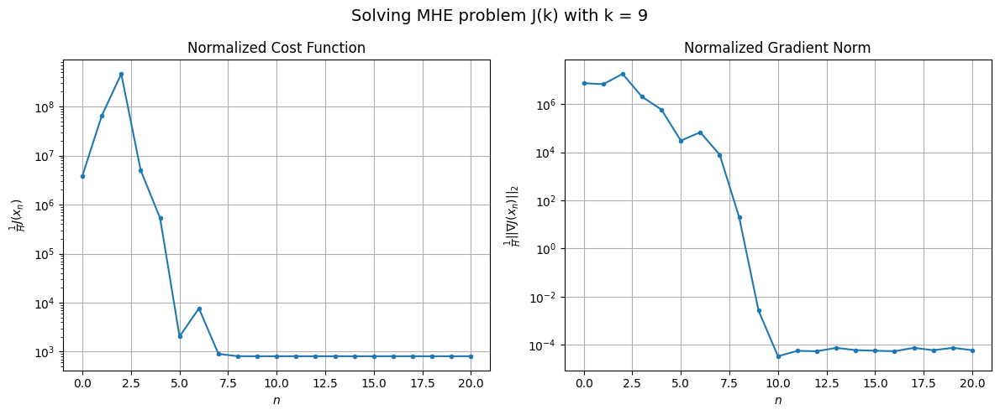

Windows:   0%|          | 1/386 [00:07<45:57,  7.16s/it]

[Gauss-Newton] Before applying the algorithm
Cost function: 10601.170083994253
Gradient norm: 628764.9607293678
Global estimation error: 19.822144768823748
Initial conditions estimation errors: 2.0316394053549156 m, 9.30695325336241 m, 11.874377068383144 m, 12.693877426017062 m
Position estimation errors: 9.764334347412289 m, 9.703706615645258 m, 47.16104355611322 m, 62.15490895023878 m

[Gauss-Newton] Iteration 1
Cost function: 6800.761559751528 (-35.85%)
Gradient norm: 54239.546608900935 (-91.37%)
Global estimation error: 172.29104225788052 (769.18%)
Initial conditions estimation errors: 6.258595226554472 m, 84.9318800042333 m, 101.92529650990774 m, 109.73850394960817 m
Position estimation errors: 4.918831552749075 m, 48.40178892716391 m, 237.99376200231833 m, 278.1896813620132 m

[Gauss-Newton] Iteration 2
Cost function: 6333.830209584077 (-6.87%)
Gradient norm: 111.97549336198394 (-99.79%)
Global estimation error: 166.56806897562882 (-3.32%)
Initial conditions estimation errors: 6.

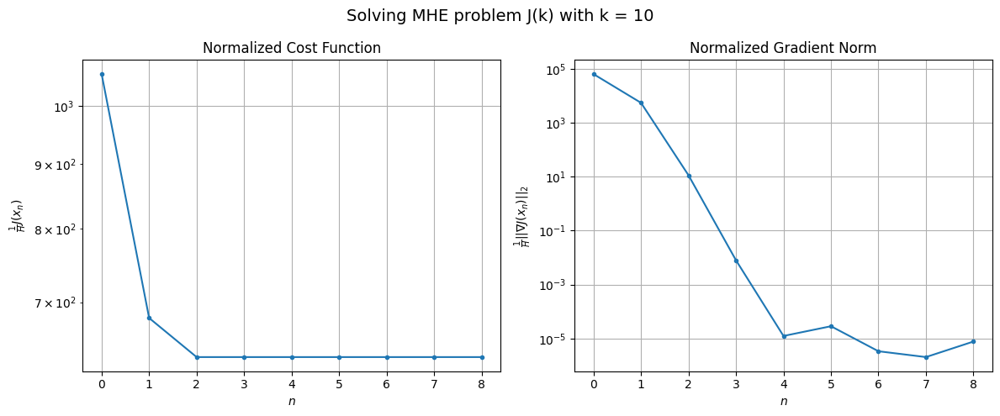

Windows:   1%|          | 2/386 [00:10<31:17,  4.89s/it]

[Gauss-Newton] Before applying the algorithm
Cost function: 7933.310480908423
Gradient norm: 535903.6874106989
Global estimation error: 185.82304248016226
Initial conditions estimation errors: 1.7052243905323294 m, 79.13848234097762 m, 114.59546823560035 m, 123.01222777878789 m
Position estimation errors: 8.44590545842668 m, 41.48169505012809 m, 242.0891803192394 m, 282.36761956677225 m

[Gauss-Newton] Iteration 1
Cost function: 4672.82424525946 (-41.10%)
Gradient norm: 4173.101798853998 (-99.22%)
Global estimation error: 140.9691615211786 (-24.14%)
Initial conditions estimation errors: 5.446365406845889 m, 53.94346237571336 m, 87.22229637075756 m, 96.56517318259998 m
Position estimation errors: 4.234498383721807 m, 31.01888614543479 m, 190.958949788094 m, 220.5597567331239 m

[Gauss-Newton] Iteration 2
Cost function: 4669.885403782217 (-0.06%)
Gradient norm: 0.5028585955189002 (-99.99%)
Global estimation error: 141.59078875459437 (0.44%)
Initial conditions estimation errors: 5.4463653

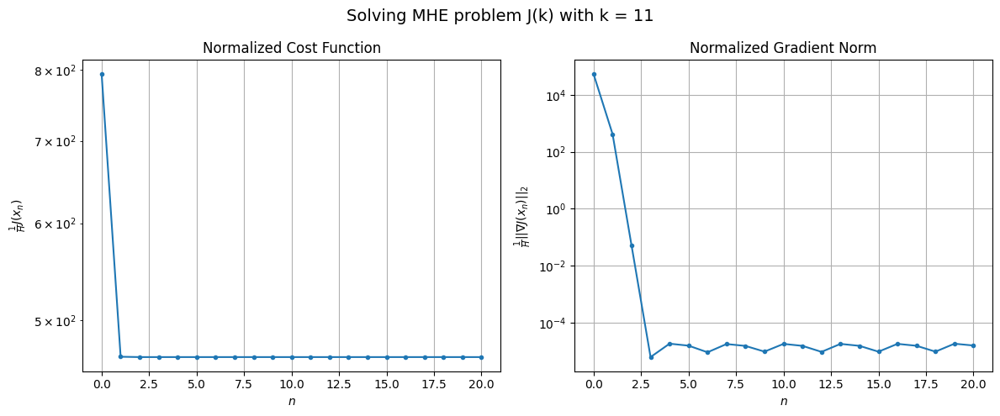

Windows:   1%|          | 3/386 [00:17<37:33,  5.88s/it]

[Gauss-Newton] Before applying the algorithm
Cost function: 6099.5998304133345
Gradient norm: 485397.66558642057
Global estimation error: 158.75865691936684
Initial conditions estimation errors: 1.3941668736357746 m, 52.355369276352235 m, 100.77969329702931 m, 110.92596876764547 m
Position estimation errors: 7.555589216188257 m, 27.722362706781293 m, 200.11390225332912 m, 230.93689748721934 m

[Gauss-Newton] Iteration 1
Cost function: 4949.592163527357 (-18.85%)
Gradient norm: 99084.73040929552 (-79.59%)
Global estimation error: 57.89943415077965 (-63.53%)
Initial conditions estimation errors: 4.723249129246276 m, 26.324191730049677 m, 34.43802911470935 m, 38.09254586684897 m
Position estimation errors: 3.7512384468665956 m, 10.84142722887479 m, 85.93637953496497 m, 95.53623478931414 m

[Gauss-Newton] Iteration 2
Cost function: 3465.688141896783 (-29.98%)
Gradient norm: 69.62103119741282 (-99.93%)
Global estimation error: 57.35326048973381 (-0.94%)
Initial conditions estimation errors:

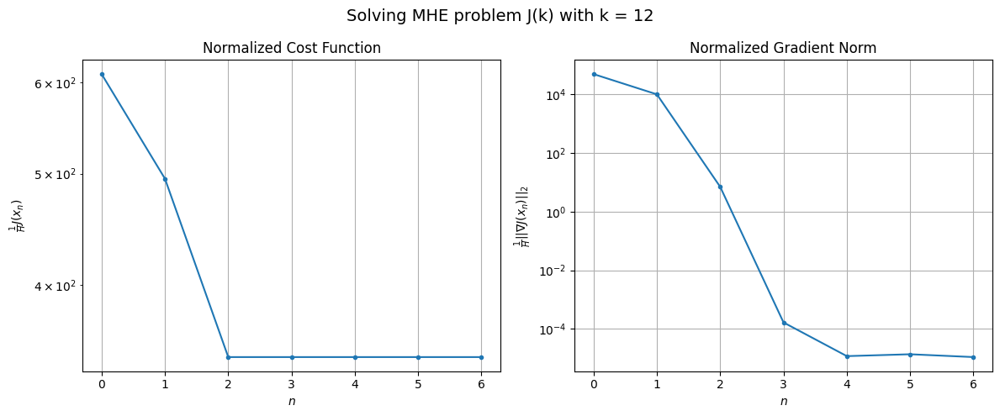

Windows:   1%|          | 4/386 [00:20<29:38,  4.66s/it]

[Gauss-Newton] Before applying the algorithm
Cost function: 4752.003127475755
Gradient norm: 440082.4734231606
Global estimation error: 63.69769929407345
Initial conditions estimation errors: 1.1839873323542836 m, 24.14500674498109 m, 40.09739598077605 m, 43.187628099287735 m
Position estimation errors: 7.018917903819361 m, 10.87571336854508 m, 90.23878695139332 m, 103.94692725064736 m

[Gauss-Newton] Iteration 1
Cost function: 2706.2920874856673 (-43.05%)
Gradient norm: 12836.289830891466 (-97.08%)
Global estimation error: 23.282567590409258 (-63.45%)
Initial conditions estimation errors: 4.115418597318304 m, 8.123832979798381 m, 16.4875236482659 m, 13.685031857970941 m
Position estimation errors: 3.613254378888639 m, 3.8344982673467864 m, 32.785900349453 m, 24.406761720916244 m

[Gauss-Newton] Iteration 2
Cost function: 2683.197154349714 (-0.85%)
Gradient norm: 3.572238536014358 (-99.97%)
Global estimation error: 24.122860784791545 (3.61%)
Initial conditions estimation errors: 4.1154

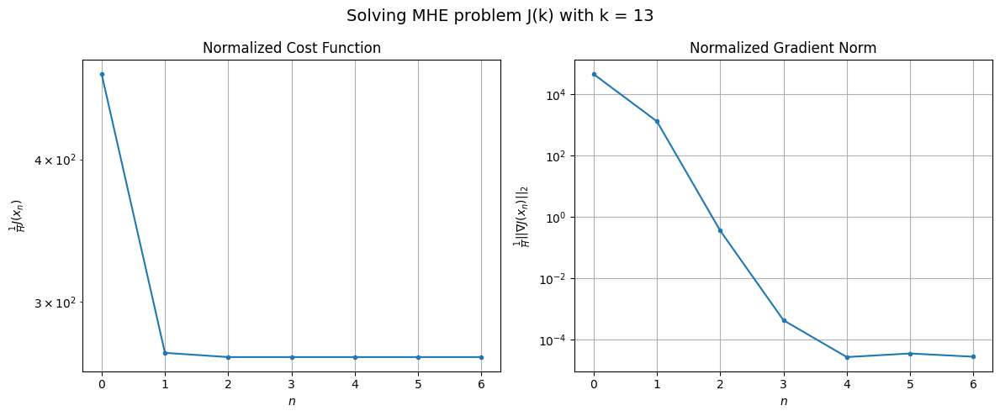

Windows:   1%|▏         | 5/386 [00:22<24:57,  3.93s/it]

[Gauss-Newton] Before applying the algorithm
Cost function: 4180.108291124896
Gradient norm: 428386.9450357188
Global estimation error: 16.991753287369864
Initial conditions estimation errors: 1.0416152511221233 m, 5.5775382939806954 m, 12.585856194797918 m, 9.904806435061804 m
Position estimation errors: 6.848951449868066 m, 6.3372232473507015 m, 35.956935977607095 m, 25.413744247464024 m

[Gauss-Newton] Iteration 1
Cost function: 2381.327264730547 (-43.03%)
Gradient norm: 2599.476098679295 (-99.39%)
Global estimation error: 64.30988709104493 (278.48%)
Initial conditions estimation errors: 3.6939498394338575 m, 8.488238378709081 m, 42.59795265354268 m, 47.280709031403 m
Position estimation errors: 3.6160032770294213 m, 3.771928944008916 m, 24.526722524924306 m, 28.12414795472541 m

[Gauss-Newton] Iteration 2
Cost function: 2379.3992272983987 (-0.08%)
Gradient norm: 4.415172892095457 (-99.83%)
Global estimation error: 59.00823881661925 (-8.24%)
Initial conditions estimation errors: 3.6

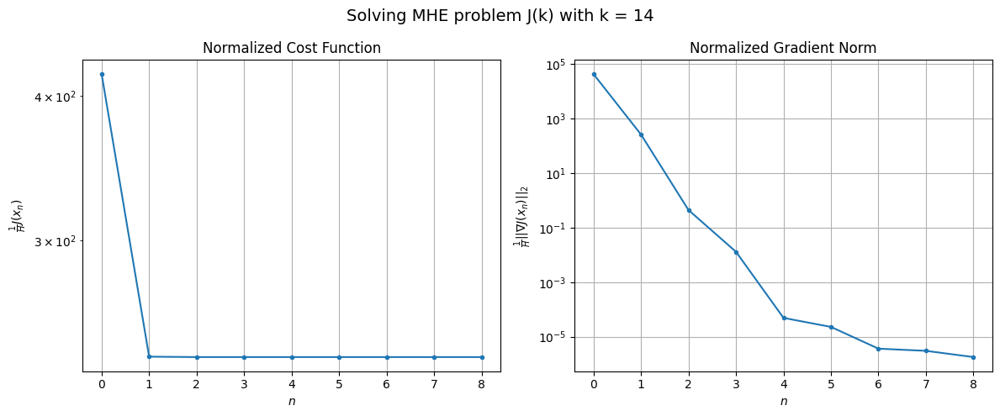

Windows:   2%|▏         | 6/386 [00:26<23:27,  3.70s/it]

[Gauss-Newton] Before applying the algorithm
Cost function: 4087.107234096068
Gradient norm: 423502.4407515745
Global estimation error: 55.25934304603462
Initial conditions estimation errors: 0.9850204423490723 m, 6.487906674145459 m, 36.024060440004504 m, 41.38587249356162 m
Position estimation errors: 6.784180844824251 m, 7.05703571002029 m, 26.094651581901182 m, 31.604510881039264 m

[Gauss-Newton] Iteration 1
Cost function: 2398.874447125476 (-41.31%)
Gradient norm: 153.17261291567254 (-99.96%)
Global estimation error: 36.95671033920344 (-33.12%)
Initial conditions estimation errors: 3.4898430969317547 m, 10.057291910377545 m, 31.99057760342708 m, 15.134656508189764 m
Position estimation errors: 3.6202608775482275 m, 3.0349563029745803 m, 29.491586598880527 m, 33.337010586354204 m

[Gauss-Newton] Iteration 2
Cost function: 2398.800296419977 (-0.00%)
Gradient norm: 29.438740525096232 (-80.78%)
Global estimation error: 37.43509534569968 (1.29%)
Initial conditions estimation errors: 3

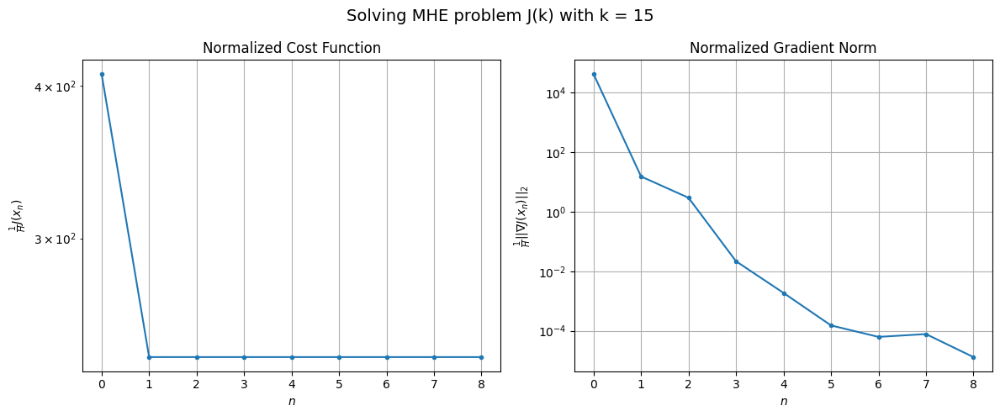

Windows:   2%|▏         | 7/386 [00:29<22:03,  3.49s/it]

[Gauss-Newton] Before applying the algorithm
Cost function: 3988.6633514571568
Gradient norm: 402347.72596474714
Global estimation error: 33.298575386415465
Initial conditions estimation errors: 1.0529581109482147 m, 8.978378328832676 m, 28.45944178899534 m, 14.73522357124154 m
Position estimation errors: 6.68971669325631 m, 6.2226496227433135 m, 29.4114015782755 m, 30.183867589091953 m

[Gauss-Newton] Iteration 1
Cost function: 2449.8513397444412 (-38.58%)
Gradient norm: 626.0697458967 (-99.84%)
Global estimation error: 17.576362472327588 (-47.22%)
Initial conditions estimation errors: 3.4376489881886334 m, 5.596458648457202 m, 15.594407957077195 m, 4.753391274134893 m
Position estimation errors: 3.6722987630716757 m, 3.385654753928712 m, 17.949917322427726 m, 6.358877080965628 m

[Gauss-Newton] Iteration 2
Cost function: 2449.791185140758 (-0.00%)
Gradient norm: 0.24730788815412016 (-99.96%)
Global estimation error: 17.3976508469378 (-1.02%)
Initial conditions estimation errors: 3.43

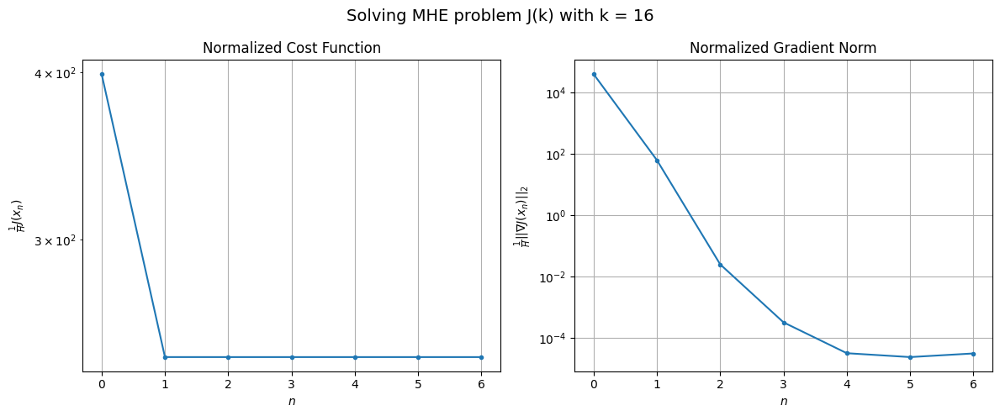

Windows:   2%|▏         | 8/386 [00:31<19:50,  3.15s/it]

[Gauss-Newton] Before applying the algorithm
Cost function: 4154.0991455577605
Gradient norm: 396277.3698110351
Global estimation error: 13.957938909911949
Initial conditions estimation errors: 1.1651254401314926 m, 4.077967792779327 m, 13.053694330119283 m, 2.5360419280652136 m
Position estimation errors: 6.632381415175417 m, 6.614138441425152 m, 20.200963638553137 m, 6.63373276693605 m

[Gauss-Newton] Iteration 1
Cost function: 2697.266540314721 (-35.07%)
Gradient norm: 3959.2236237563075 (-99.00%)
Global estimation error: 167.3670745597806 (1099.08%)
Initial conditions estimation errors: 3.4572601236612277 m, 6.64645901395457 m, 108.22857049045696 m, 127.44468404691854 m
Position estimation errors: 3.679222381513594 m, 10.98785929008378 m, 25.88548270881275 m, 31.365315183868077 m

[Gauss-Newton] Iteration 2
Cost function: 2675.6373629937334 (-0.80%)
Gradient norm: 298.32060163590853 (-92.47%)
Global estimation error: 146.81875076030252 (-12.28%)
Initial conditions estimation errors

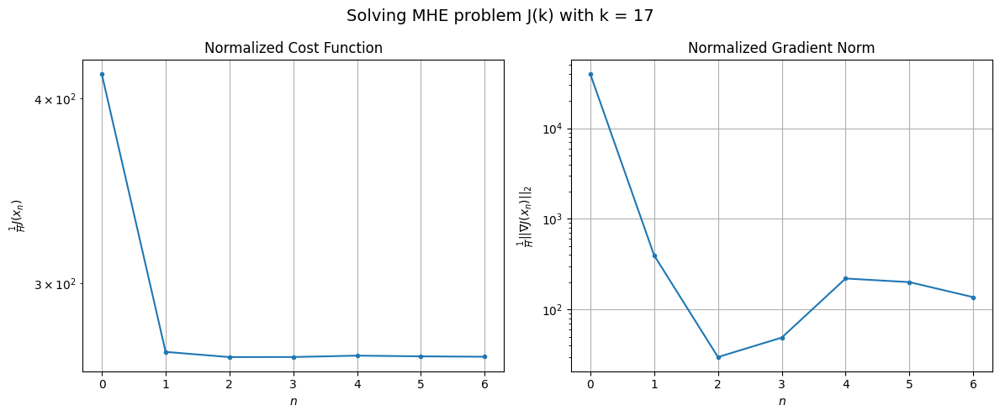

Windows:   2%|▏         | 9/386 [00:34<18:45,  2.99s/it]

[Gauss-Newton] Before applying the algorithm
Cost function: 4260.616079961814
Gradient norm: 380176.39002016315
Global estimation error: 110.40430019051848
Initial conditions estimation errors: 1.2166275013965693 m, 4.230955691874759 m, 70.42588842307815 m, 84.91124236707078 m
Position estimation errors: 6.514044208172735 m, 14.548580016537386 m, 57.57242222235711 m, 69.75715248555623 m

[Gauss-Newton] Iteration 1
Cost function: 2790.6500937555775 (-34.50%)
Gradient norm: 219.2748726488369 (-99.94%)
Global estimation error: 61.9128909294217 (-43.92%)
Initial conditions estimation errors: 3.536321800982603 m, 6.991573686598303 m, 41.31858065932432 m, 45.43745012460235 m
Position estimation errors: 3.606036801370832 m, 10.160411358507664 m, 73.92258225440011 m, 87.63329794216551 m

[Gauss-Newton] Iteration 2
Cost function: 2790.496058490627 (-0.01%)
Gradient norm: 2.6207895371324996 (-98.80%)
Global estimation error: 63.319597919305956 (2.27%)
Initial conditions estimation errors: 3.5363

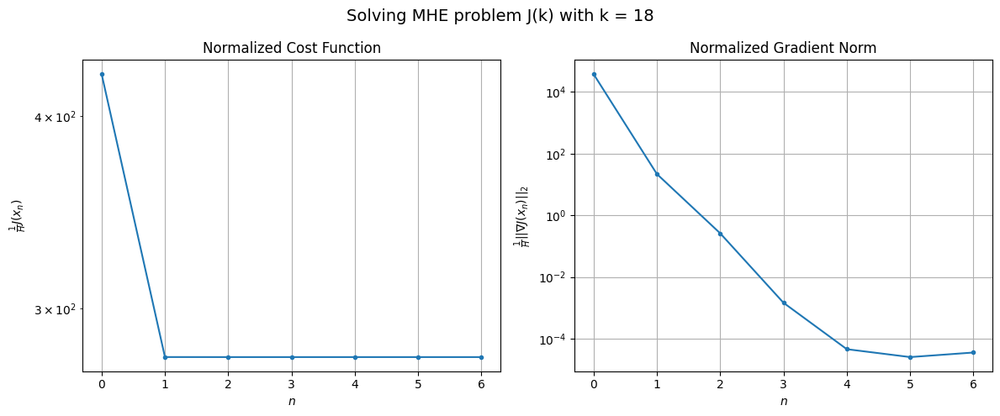

Windows:   3%|▎         | 10/386 [00:36<17:47,  2.84s/it]

[Gauss-Newton] Before applying the algorithm
Cost function: 4077.7646034026475
Gradient norm: 357414.34270703583
Global estimation error: 71.18923351001838
Initial conditions estimation errors: 1.251243514409233 m, 6.445495698975541 m, 46.87859275996885 m, 53.17112249040615 m
Position estimation errors: 6.308494530067733 m, 12.939064549195123 m, 74.97372856444252 m, 86.42060375092522 m

[Gauss-Newton] Iteration 1
Cost function: 3276.614764027809 (-19.65%)
Gradient norm: 60923.586672559504 (-82.95%)
Global estimation error: 239.1457124464006 (235.93%)
Initial conditions estimation errors: 3.6034076597149256 m, 18.587389445109743 m, 160.1478817949888 m, 176.59220552185838 m
Position estimation errors: 3.4999355221188653 m, 16.221520849257544 m, 196.00918630095097 m, 223.84172976265643 m

[Gauss-Newton] Iteration 2
Cost function: 2636.7124168761384 (-19.53%)
Gradient norm: 17.145278388366183 (-99.97%)
Global estimation error: 238.06295013339573 (-0.45%)
Initial conditions estimation error

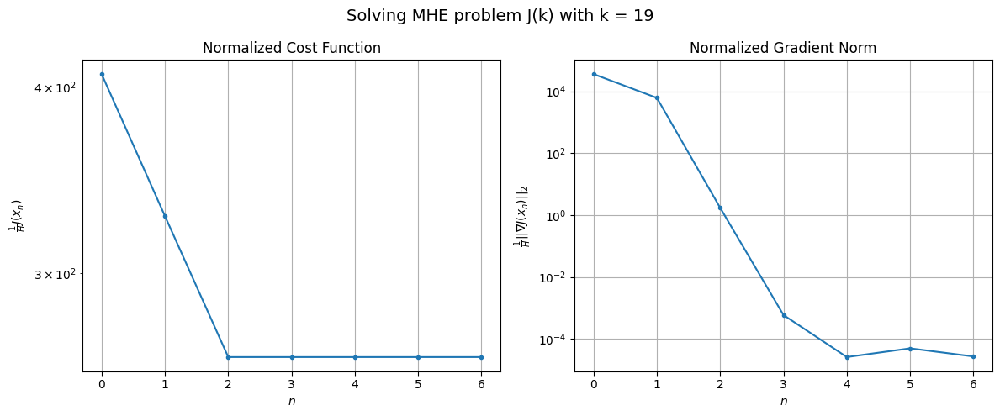

Windows:   3%|▎         | 11/386 [00:39<17:02,  2.73s/it]

[Gauss-Newton] Before applying the algorithm
Cost function: 3783.292142359584
Gradient norm: 337102.31479807786
Global estimation error: 247.43798129509827
Initial conditions estimation errors: 1.2719988573400394 m, 14.132257893291378 m, 166.17720993175266 m, 182.78212963019183 m
Position estimation errors: 6.120620213773588 m, 19.24314431025232 m, 200.94339917873086 m, 231.83497111330502 m

[Gauss-Newton] Iteration 1
Cost function: 2442.5041570834055 (-35.44%)
Gradient norm: 15207.340165708456 (-95.49%)
Global estimation error: 110.1126045913428 (-55.50%)
Initial conditions estimation errors: 3.5703899532469334 m, 12.52514896783448 m, 60.83037415922033 m, 90.85593222018349 m
Position estimation errors: 3.4106852494317628 m, 8.98409072242932 m, 56.70725732365172 m, 70.94608632946169 m

[Gauss-Newton] Iteration 2
Cost function: 2403.4164023617523 (-1.60%)
Gradient norm: 4.585969647637619 (-99.97%)
Global estimation error: 112.09417567243052 (1.80%)
Initial conditions estimation errors: 

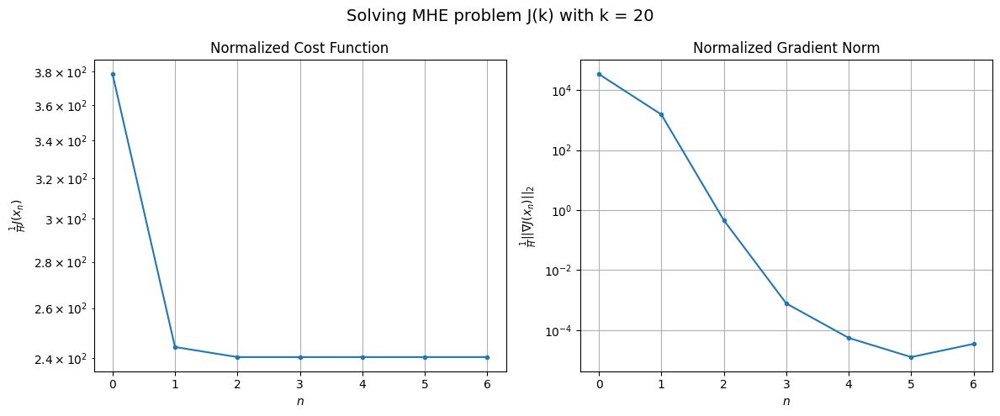

Windows:   3%|▎         | 12/386 [00:41<16:28,  2.64s/it]

[Gauss-Newton] Before applying the algorithm
Cost function: 3400.231951614409
Gradient norm: 314299.8140270535
Global estimation error: 107.92051608929584
Initial conditions estimation errors: 1.239164357965505 m, 9.79919619235554 m, 61.78915265376601 m, 87.928151580992 m
Position estimation errors: 6.014313001980026 m, 11.700506574283354 m, 58.118346761556936 m, 73.89108515999419 m

[Gauss-Newton] Iteration 1
Cost function: 2137.8587449510196 (-37.13%)
Gradient norm: 4345.0660559269 (-98.62%)
Global estimation error: 61.602802560705754 (-42.92%)
Initial conditions estimation errors: 3.456083931543607 m, 0.9726025816453842 m, 42.30605692439793 m, 44.633704076086765 m
Position estimation errors: 3.403524027011387 m, 4.732402638040762 m, 31.340111021544406 m, 20.546987068596508 m

[Gauss-Newton] Iteration 2
Cost function: 2134.5139662195907 (-0.16%)
Gradient norm: 5.428708897057662 (-99.88%)
Global estimation error: 58.547987479550095 (-4.96%)
Initial conditions estimation errors: 3.4560

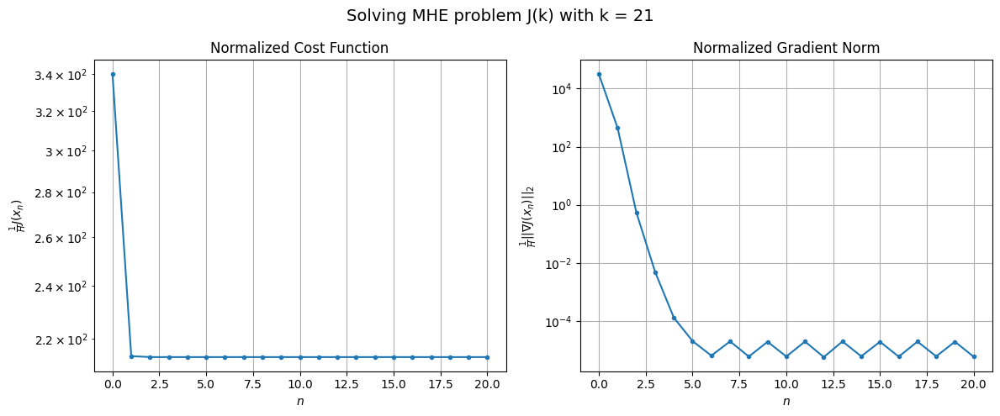

Windows:   3%|▎         | 13/386 [00:48<24:35,  3.96s/it]

[Gauss-Newton] Before applying the algorithm
Cost function: 3331.375730335705
Gradient norm: 325344.2105127272
Global estimation error: 46.81244649449019
Initial conditions estimation errors: 1.2144319476804615 m, 2.0654900375913594 m, 32.00184966145223 m, 34.08093181290742 m
Position estimation errors: 6.023782282740142 m, 7.874555641911632 m, 34.61017188157806 m, 24.12847602176397 m

[Gauss-Newton] Iteration 1
Cost function: 2084.3064832412315 (-37.43%)
Gradient norm: 12943.489498109488 (-96.02%)
Global estimation error: 184.16291218467785 (293.41%)
Initial conditions estimation errors: 3.3885447158081448 m, 21.093630427328602 m, 114.0521209672592 m, 143.00921910332647 m
Position estimation errors: 3.3670676066680656 m, 13.501117012222991 m, 114.53820039980927 m, 140.61084233873996 m

[Gauss-Newton] Iteration 2
Cost function: 2054.101490302398 (-1.45%)
Gradient norm: 574.3904076421201 (-95.56%)
Global estimation error: 129.8739524843522 (-29.48%)
Initial conditions estimation errors:

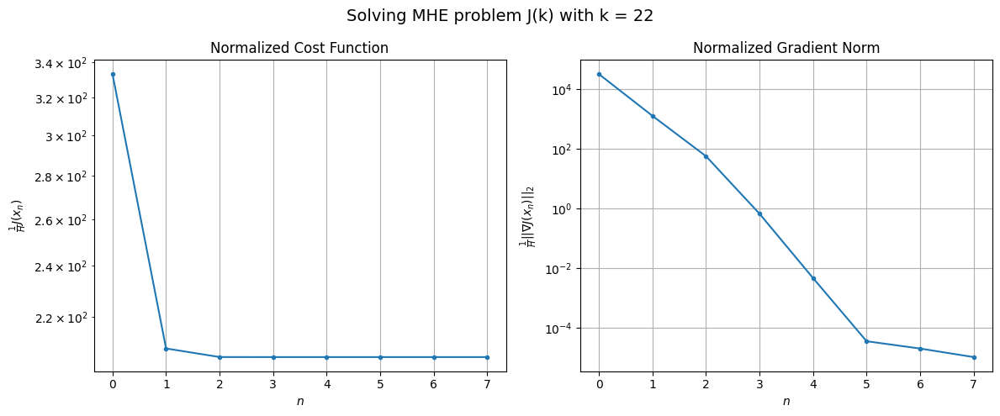

Windows:   4%|▎         | 14/386 [00:51<22:48,  3.68s/it]

[Gauss-Newton] Before applying the algorithm
Cost function: 3296.375643318799
Gradient norm: 331056.1013170946
Global estimation error: 123.13340628507133
Initial conditions estimation errors: 1.2123238476600928 m, 16.81425619574563 m, 75.80074330746518 m, 95.56078640541867 m
Position estimation errors: 6.035185382847981 m, 8.842084089643189 m, 96.93699052070241 m, 119.16348903118318 m

[Gauss-Newton] Iteration 1
Cost function: 2024.4807251653756 (-38.58%)
Gradient norm: 1535.174040265421 (-99.54%)
Global estimation error: 127.11176251051396 (3.23%)
Initial conditions estimation errors: 3.3834378386463513 m, 19.905405312023447 m, 84.02281793870445 m, 93.21940981364787 m
Position estimation errors: 3.3736190367614376 m, 5.36636647516589 m, 52.700133972598344 m, 62.41163123644791 m

[Gauss-Newton] Iteration 2
Cost function: 2024.0656001641412 (-0.02%)
Gradient norm: 2.425238444210319 (-99.84%)
Global estimation error: 124.05833546816821 (-2.40%)
Initial conditions estimation errors: 3.38

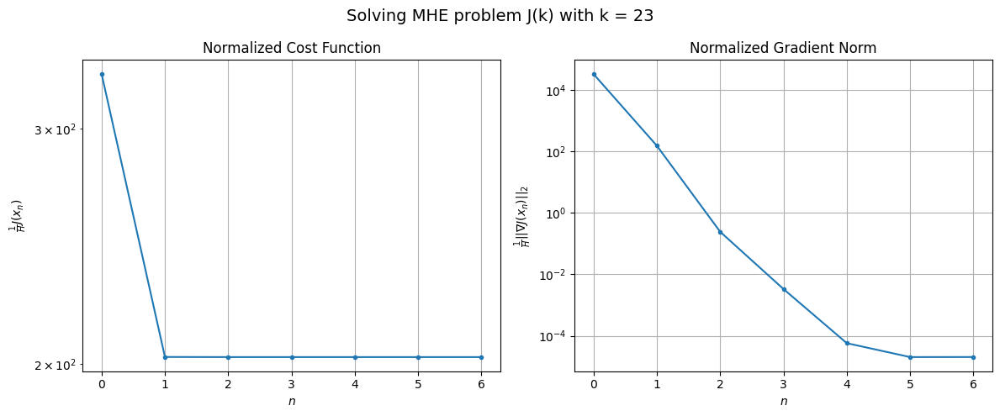

Windows:   4%|▍         | 15/386 [00:54<20:49,  3.37s/it]

[Gauss-Newton] Before applying the algorithm
Cost function: 3413.3506576216123
Gradient norm: 342635.9348788347
Global estimation error: 115.2624538923325
Initial conditions estimation errors: 1.2574211258264487 m, 19.15536555398312 m, 75.86576471451082 m, 84.62434983572795 m
Position estimation errors: 6.136509869561793 m, 7.400808009524506 m, 51.00290803532506 m, 60.624200600163306 m

[Gauss-Newton] Iteration 1
Cost function: 2331.285374737303 (-31.70%)
Gradient norm: 20427.66868148164 (-94.04%)
Global estimation error: 272.5187551425424 (136.43%)
Initial conditions estimation errors: 3.349088293940369 m, 8.980130446364274 m, 191.11496702415522 m, 194.0351781636934 m
Position estimation errors: 3.484428563900652 m, 22.186355845190832 m, 97.92499094551015 m, 107.77326178117968 m

[Gauss-Newton] Iteration 2
Cost function: 2173.9376557963287 (-6.75%)
Gradient norm: 61.023964160154414 (-99.70%)
Global estimation error: 266.1234321350233 (-2.35%)
Initial conditions estimation errors: 3.34

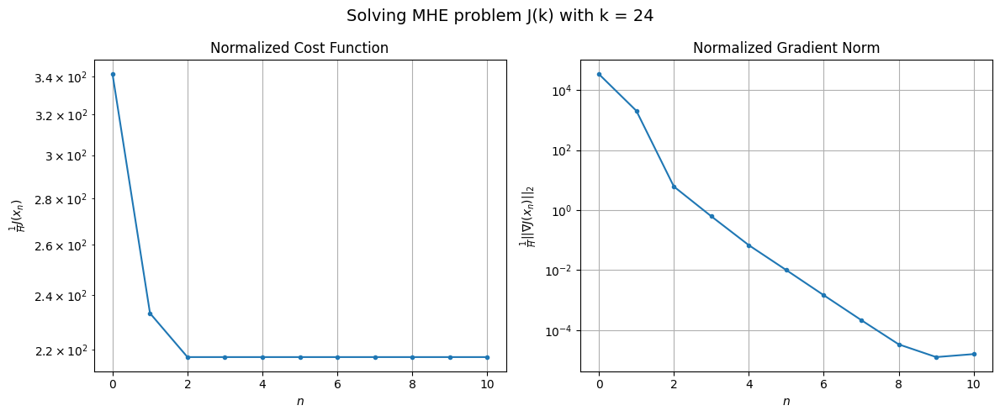

Windows:   4%|▍         | 16/386 [00:58<21:17,  3.45s/it]

[Gauss-Newton] Before applying the algorithm
Cost function: 3685.0082900603716
Gradient norm: 367305.85128824646
Global estimation error: 261.7663266877976
Initial conditions estimation errors: 1.2759920360286225 m, 11.183849261186925 m, 181.31376985426817 m, 188.46799886932413 m
Position estimation errors: 6.372407568918188 m, 25.03976587214392 m, 83.99599613680708 m, 94.62346327821834 m

[Gauss-Newton] Iteration 1
Cost function: 3165.107131613114 (-14.11%)
Gradient norm: 67565.78668329427 (-81.61%)
Global estimation error: 652.2460603461826 (149.17%)
Initial conditions estimation errors: 3.377964430923767 m, 34.79324999502406 m, 434.29154441505773 m, 485.3799596322242 m
Position estimation errors: 3.640419946477043 m, 74.30562801683173 m, 422.24382298912434 m, 486.74641207159186 m

[Gauss-Newton] Iteration 2
Cost function: 2395.0869297477084 (-24.33%)
Gradient norm: 1192.0527163738336 (-98.24%)
Global estimation error: 732.7958956681356 (12.35%)
Initial conditions estimation errors: 

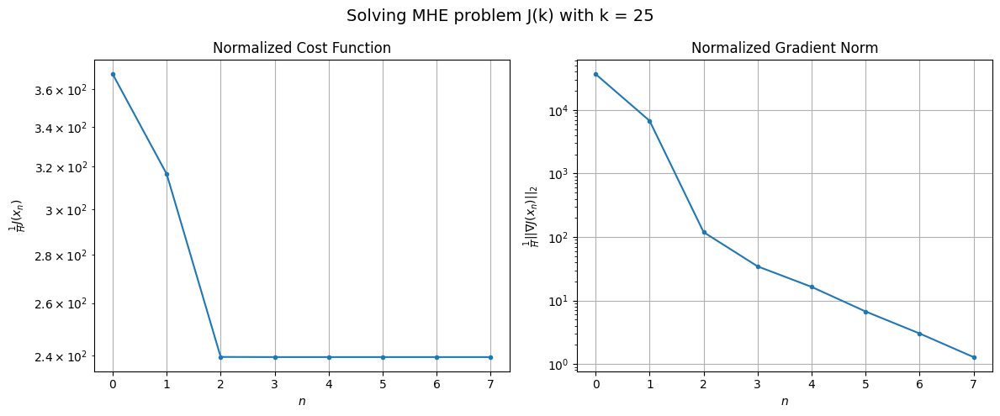

Windows:   4%|▍         | 17/386 [01:01<20:47,  3.38s/it]

[Gauss-Newton] Before applying the algorithm
Cost function: 4028.818639639241
Gradient norm: 386045.19760104537
Global estimation error: 714.6456457721458
Initial conditions estimation errors: 1.3176117029972956 m, 42.482540483805614 m, 473.3560720314287 m, 533.7095288874286 m
Position estimation errors: 6.632965426914432 m, 82.82915342979136 m, 431.32826464819703 m, 500.68783538737125 m

[Gauss-Newton] Iteration 1
Cost function: 2650.4905035438605 (-34.21%)
Gradient norm: 4298.425876096282 (-98.89%)
Global estimation error: 858.9942708897354 (20.20%)
Initial conditions estimation errors: 3.4999649565528257 m, 69.2345382230704 m, 550.1629288396362 m, 656.0382356716407 m
Position estimation errors: 3.803466976369102 m, 76.91120156734273 m, 407.7718137340138 m, 502.1789382660566 m

[Gauss-Newton] Iteration 2
Cost function: 2645.466566693083 (-0.19%)
Gradient norm: 4500.081440109801 (4.69%)
Global estimation error: 1012.3832463051502 (17.86%)
Initial conditions estimation errors: 3.499964

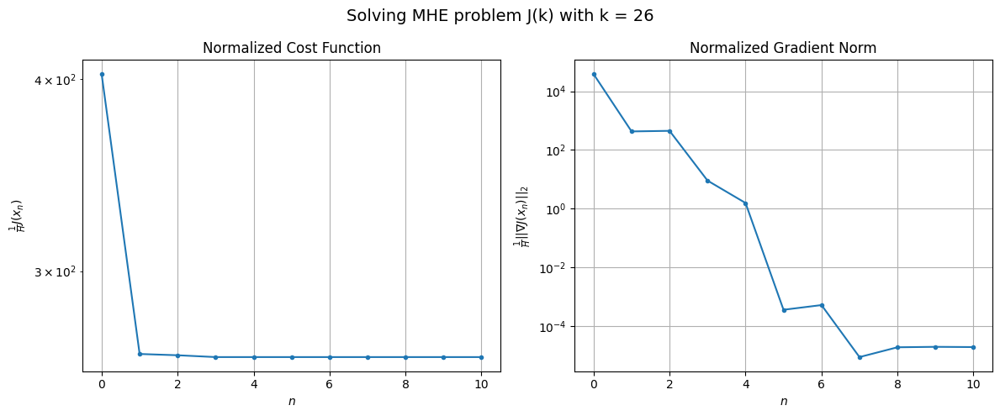

Windows:   5%|▍         | 18/386 [01:04<21:14,  3.46s/it]

[Gauss-Newton] Before applying the algorithm
Cost function: 4401.017854026091
Gradient norm: 412033.32241390797
Global estimation error: 1027.587220067018
Initial conditions estimation errors: 1.4020995112616685 m, 89.79782907274844 m, 656.5961664766888 m, 785.3351079311371 m
Position estimation errors: 6.84352331850509 m, 90.0130826933275 m, 454.77292117599006 m, 566.5092725833595 m

[Gauss-Newton] Iteration 1
Cost function: 31269.176857339484 (610.50%)
Gradient norm: 272365.2145442754 (-33.90%)
Global estimation error: 349.09399111533924 (-66.03%)
Initial conditions estimation errors: 3.6592431400920833 m, 28.16162912716454 m, 224.6500198294724 m, 265.6921490810937 m
Position estimation errors: 3.8981309113802087 m, 3.576522190432119 m, 67.62454002194565 m, 108.65749775768393 m

[Gauss-Newton] Iteration 2
Cost function: 3048.338711351553 (-90.25%)
Gradient norm: 19537.10078980501 (-92.83%)
Global estimation error: 236.11933158061217 (-32.36%)
Initial conditions estimation errors: 3.6

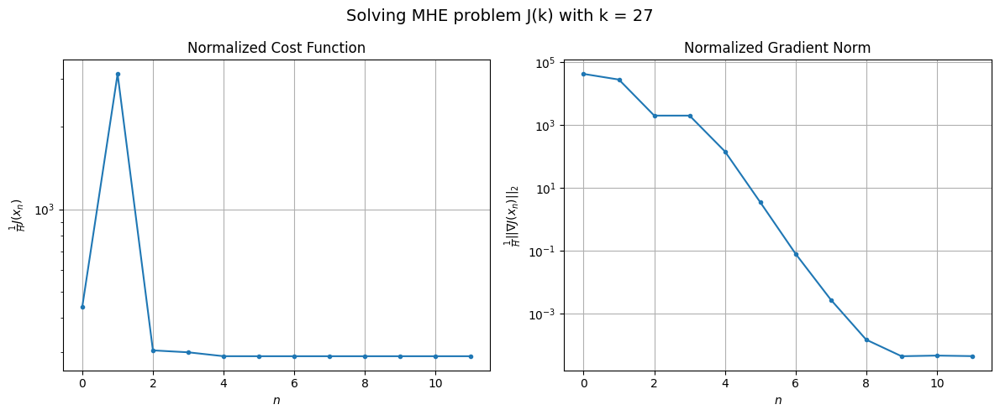

Windows:   5%|▍         | 19/386 [01:08<21:59,  3.59s/it]

[Gauss-Newton] Before applying the algorithm
Cost function: 4503.767677069358
Gradient norm: 404153.6682102586
Global estimation error: 409.1034006314365
Initial conditions estimation errors: 1.4704794307803013 m, 52.62591562927487 m, 223.1005810818239 m, 338.850661968322 m
Position estimation errors: 6.866245778482399 m, 51.513994365104004 m, 263.5907278626613 m, 350.66850462776483 m

[Gauss-Newton] Iteration 1
Cost function: 3047.123789766477 (-32.34%)
Gradient norm: 14665.680678171764 (-96.37%)
Global estimation error: 240.45103825989509 (-41.22%)
Initial conditions estimation errors: 3.8117459937525937 m, 25.152901942451987 m, 70.6564258115195 m, 228.42253908313222 m
Position estimation errors: 3.9208107563500407 m, 26.432238301790115 m, 133.03183148234154 m, 192.99841396429323 m

[Gauss-Newton] Iteration 2
Cost function: 2981.101532684071 (-2.17%)
Gradient norm: 700.1306088814456 (-95.23%)
Global estimation error: 280.2329354784244 (16.54%)
Initial conditions estimation errors: 3.

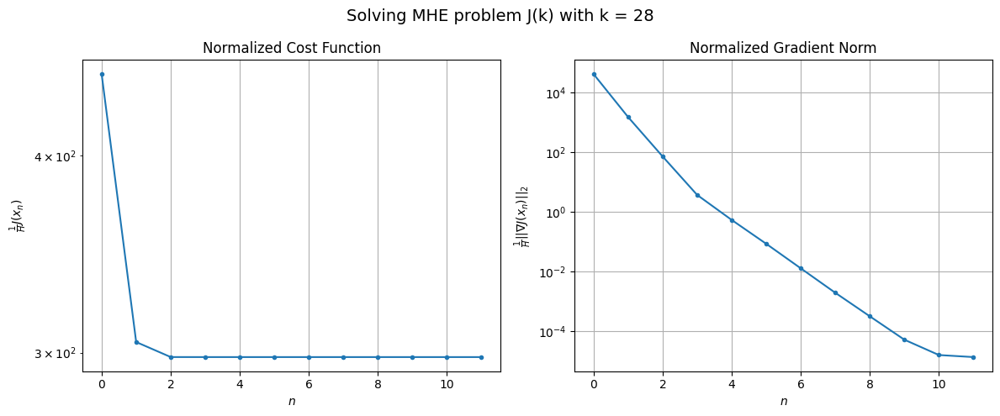

Windows:   5%|▌         | 20/386 [01:12<22:21,  3.67s/it]

[Gauss-Newton] Before applying the algorithm
Cost function: 4514.28144253709
Gradient norm: 391882.9647124033
Global estimation error: 263.1954000750716
Initial conditions estimation errors: 1.5241639308689492 m, 30.586903617398903 m, 82.96010266310715 m, 247.89359243956744 m
Position estimation errors: 6.690182720376307 m, 32.79193224543115 m, 174.3459390704436 m, 240.78655960807137 m

[Gauss-Newton] Iteration 1
Cost function: 40161.49464952809 (789.65%)
Gradient norm: 412824.3277883942 (5.34%)
Global estimation error: 1324.443579911277 (403.22%)
Initial conditions estimation errors: 3.8430011561321504 m, 89.44667686409784 m, 764.9372673276359 m, 1077.4996656324624 m
Position estimation errors: 3.827964587974246 m, 110.17406867947717 m, 626.8169955341245 m, 825.928521733771 m

[Gauss-Newton] Iteration 2
Cost function: 3143.5739592322707 (-92.17%)
Gradient norm: 23007.164628001978 (-94.43%)
Global estimation error: 1095.39842385769 (-17.29%)
Initial conditions estimation errors: 3.8430

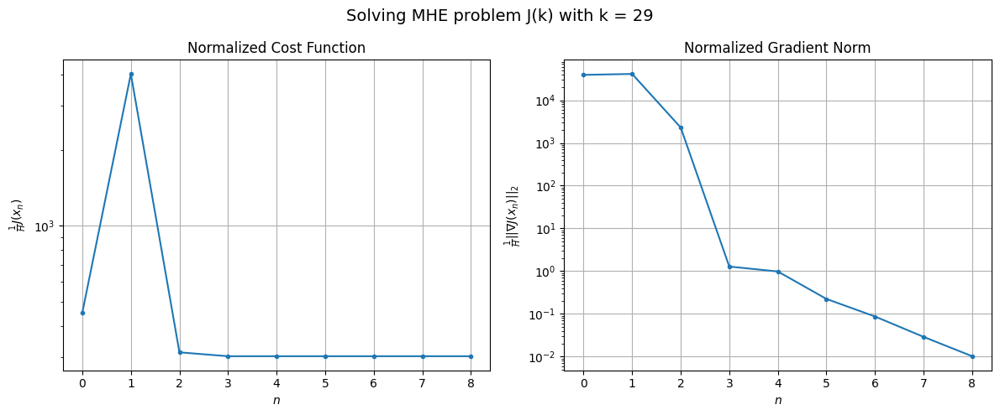

Windows:   5%|▌         | 21/386 [01:16<21:55,  3.60s/it]

[Gauss-Newton] Before applying the algorithm
Cost function: 4331.219194672314
Gradient norm: 358485.56993694353
Global estimation error: 1060.8461188258275
Initial conditions estimation errors: 1.5085915102106862 m, 71.62910059424635 m, 564.2180264911393 m, 895.4991224597392 m
Position estimation errors: 6.375229447404822 m, 76.05103071323519 m, 413.3123227721672 m, 603.6370027826199 m

[Gauss-Newton] Iteration 1
Cost function: 4420.146281400521 (2.05%)
Gradient norm: 71856.52871173053 (-79.96%)
Global estimation error: 1079.5829411322454 (1.77%)
Initial conditions estimation errors: 3.7802552883771696 m, 94.29591017277836 m, 689.9517230765563 m, 824.9604314495602 m
Position estimation errors: 3.6827147633144004 m, 118.75396126310027 m, 685.4990788695421 m, 859.7430707965335 m

[Gauss-Newton] Iteration 2
Cost function: 3159.518558194522 (-28.52%)
Gradient norm: 36213.735487708196 (-49.60%)
Global estimation error: 818.6283193000797 (-24.17%)
Initial conditions estimation errors: 3.7802

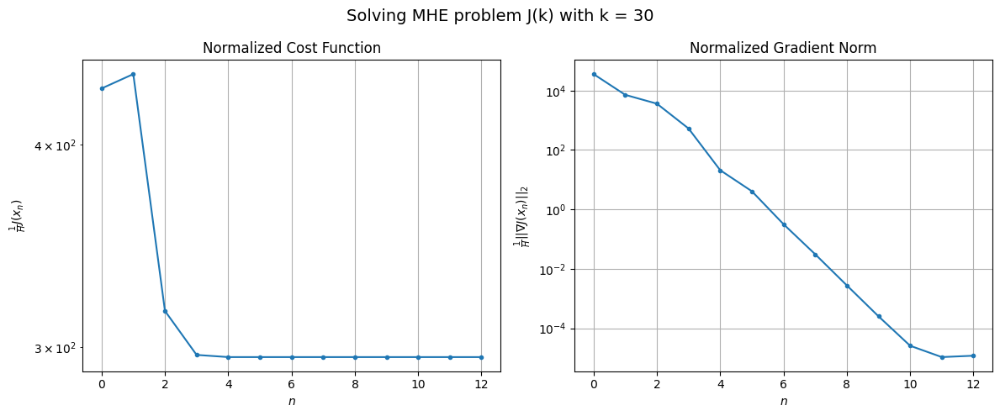

Windows:   6%|▌         | 22/386 [01:20<22:47,  3.76s/it]

[Gauss-Newton] Before applying the algorithm
Cost function: 4064.5127366056267
Gradient norm: 328590.29469260667
Global estimation error: 649.4509668200533
Initial conditions estimation errors: 1.4951650208525271 m, 52.45830224878279 m, 421.60163509250407 m, 491.20715301612347 m
Position estimation errors: 6.087638544053152 m, 57.27461499428211 m, 328.31170845112973 m, 400.3685930309205 m

[Gauss-Newton] Iteration 1
Cost function: 3676.7204330996865 (-9.54%)
Gradient norm: 36392.21791161661 (-88.92%)
Global estimation error: 298.76215691476324 (-54.00%)
Initial conditions estimation errors: 3.701888115783891 m, 27.33646181022488 m, 77.2813133328386 m, 287.2718305464083 m
Position estimation errors: 3.571097677446806 m, 28.52788666274138 m, 200.99926387275883 m, 289.4366452805814 m

[Gauss-Newton] Iteration 2
Cost function: 2786.3096349340485 (-24.22%)
Gradient norm: 2194.3739421002706 (-93.97%)
Global estimation error: 286.3741595124092 (-4.15%)
Initial conditions estimation errors: 3.

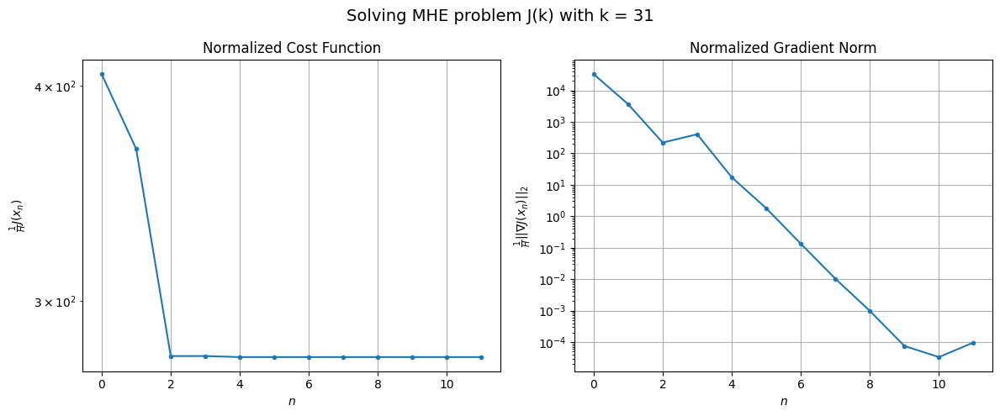

Windows:   6%|▌         | 23/386 [01:24<23:53,  3.95s/it]

[Gauss-Newton] Before applying the algorithm
Cost function: 3945.099261102944
Gradient norm: 323600.0804650287
Global estimation error: 180.62588960559083
Initial conditions estimation errors: 1.5031395041807045 m, 20.298463509175967 m, 42.2746129684437 m, 174.42519887595955 m
Position estimation errors: 6.017542696923704 m, 13.351863751291067 m, 113.37055131839986 m, 152.42786794305297 m

[Gauss-Newton] Iteration 1
Cost function: 3814.152139218671 (-3.32%)
Gradient norm: 67705.86760235358 (-79.08%)
Global estimation error: 597.4732588542232 (230.78%)
Initial conditions estimation errors: 3.5769881967329655 m, 57.62653843545258 m, 364.57187242210455 m, 469.8168356257619 m
Position estimation errors: 3.600738269939279 m, 47.93462169569556 m, 240.6441197547456 m, 305.49679330126173 m

[Gauss-Newton] Iteration 2
Cost function: 2758.823564063903 (-27.67%)
Gradient norm: 4779.105950405321 (-92.94%)
Global estimation error: 756.1885251350434 (26.56%)
Initial conditions estimation errors: 3.5

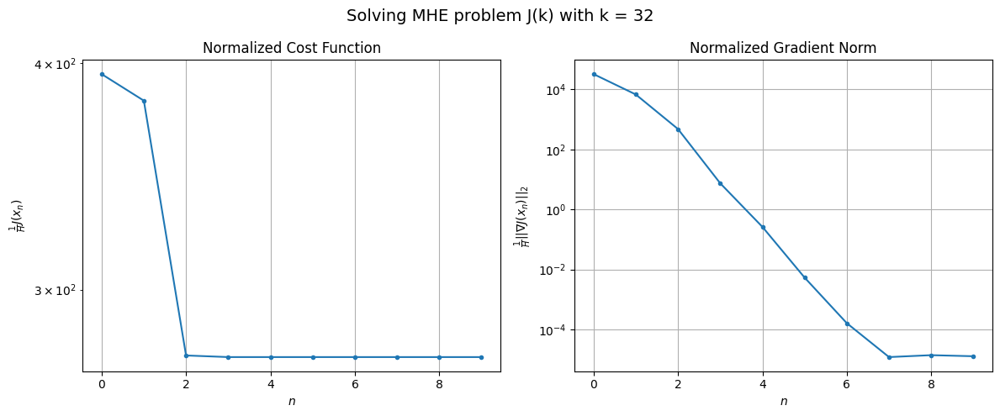

Windows:   6%|▌         | 24/386 [01:27<22:36,  3.75s/it]

[Gauss-Newton] Before applying the algorithm
Cost function: 4095.018783318538
Gradient norm: 346282.116335493
Global estimation error: 765.0211631307275
Initial conditions estimation errors: 1.4895291269362294 m, 75.87972647017013 m, 480.3939157224206 m, 590.5242822572876 m
Position estimation errors: 6.213710051860633 m, 63.092450306829065 m, 317.35473458775874 m, 401.4389041936378 m

[Gauss-Newton] Iteration 1
Cost function: 2861.6744362198533 (-30.12%)
Gradient norm: 1186.013610054895 (-99.66%)
Global estimation error: 772.7423453094058 (1.01%)
Initial conditions estimation errors: 3.5455126090633167 m, 81.93572278946436 m, 482.897419954788 m, 597.674325628918 m
Position estimation errors: 3.695363814075234 m, 56.24553635351135 m, 296.4314269655674 m, 382.1377248185846 m

[Gauss-Newton] Iteration 2
Cost function: 2860.8747930823047 (-0.03%)
Gradient norm: 57.95559817558092 (-95.11%)
Global estimation error: 785.1431179165372 (1.60%)
Initial conditions estimation errors: 3.5455126068

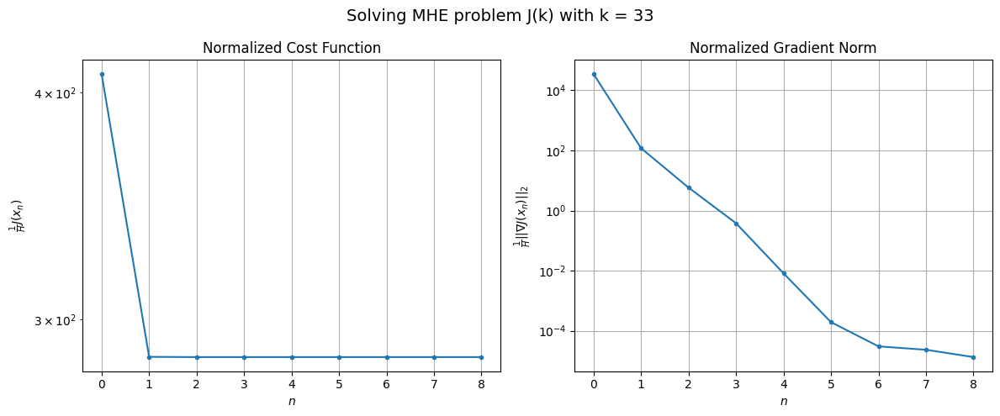

Windows:   6%|▋         | 25/386 [01:31<21:38,  3.60s/it]

[Gauss-Newton] Before applying the algorithm
Cost function: 4296.430080741789
Gradient norm: 372092.731031358
Global estimation error: 760.6035157051252
Initial conditions estimation errors: 1.53148458038741 m, 80.68845739267596 m, 476.63482160728535 m, 587.2169858449041 m
Position estimation errors: 6.412956705581738 m, 53.72141765732264 m, 276.9201493763592 m, 361.3940309147722 m

[Gauss-Newton] Iteration 1
Cost function: 6017.982879683832 (40.07%)
Gradient norm: 115815.67367596155 (-68.87%)
Global estimation error: 1572.6292294198354 (106.76%)
Initial conditions estimation errors: 3.621483294359071 m, 164.5107769815048 m, 997.0346731188632 m, 1204.9926878325068 m
Position estimation errors: 3.765253661316928 m, 133.81467151263584 m, 736.2289119543997 m, 932.9124782867677 m

[Gauss-Newton] Iteration 2
Cost function: 3327.7952165876804 (-44.70%)
Gradient norm: 37065.20006925956 (-68.00%)
Global estimation error: 1097.1307022354144 (-30.24%)
Initial conditions estimation errors: 3.6214

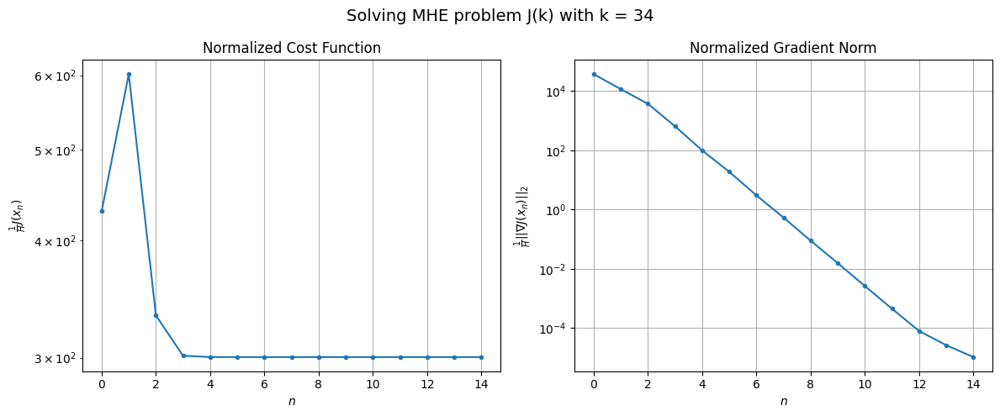

Windows:   7%|▋         | 26/386 [01:35<23:36,  3.93s/it]

[Gauss-Newton] Before applying the algorithm
Cost function: 4381.149798601297
Gradient norm: 377832.35032526765
Global estimation error: 1223.0816544790607
Initial conditions estimation errors: 1.5679634144062295 m, 129.07967309641165 m, 775.2330106885506 m, 937.1650047505261 m
Position estimation errors: 6.449129405398672 m, 96.42288767632573 m, 522.2018739961632 m, 668.1278202017724 m

[Gauss-Newton] Iteration 1
Cost function: 5233.116430648338 (19.45%)
Gradient norm: 113281.85974818417 (-70.02%)
Global estimation error: 1845.139626925173 (50.86%)
Initial conditions estimation errors: 3.6859177710314666 m, 191.64187158262902 m, 1163.1707267801978 m, 1419.4483600629148 m
Position estimation errors: 3.7760819497537423 m, 185.54146645897083 m, 1023.5369485658948 m, 1311.9577155721656 m

[Gauss-Newton] STOP on Iteration 2 (gradient norm stagnated)
Cost function = 5792.17035285485 (10.68%)
Gradient norm = 103396.87441554206 (-8.73%)
Global estimation error = 1000.6008305254405 (-45.77%)
F

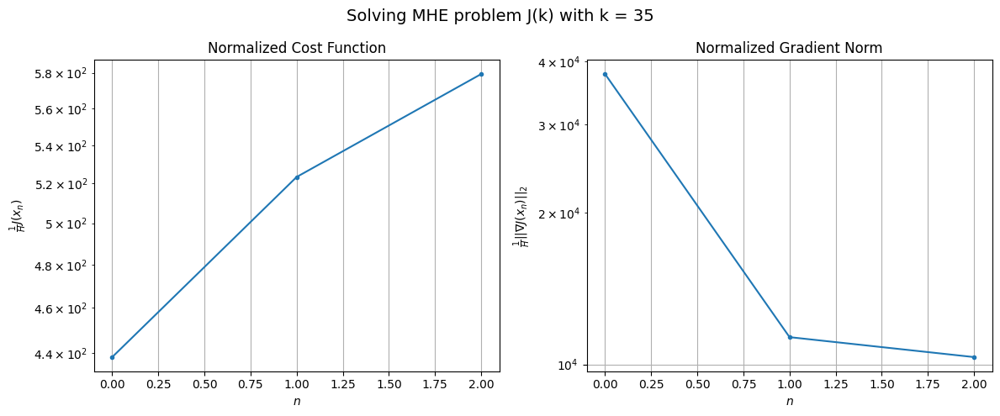

Windows:   7%|▋         | 27/386 [01:37<19:14,  3.22s/it]

[Gauss-Newton] Before applying the algorithm
Cost function: 6656.10079861401
Gradient norm: 423940.30660534085
Global estimation error: 1016.9053226935785
Initial conditions estimation errors: 1.4729113586746658 m, 106.24063254581161 m, 635.5392411281233 m, 786.7000376136723 m
Position estimation errors: 6.344600795105209 m, 108.42230608556277 m, 590.5673212667075 m, 763.9798028719499 m

[Gauss-Newton] Iteration 1
Cost function: 5291.657385096959 (-20.50%)
Gradient norm: 104750.48526298619 (-75.29%)
Global estimation error: 226.58954690370368 (-77.72%)
Initial conditions estimation errors: 3.7923126711493778 m, 26.555287601721133 m, 143.5530942627553 m, 173.25052247574587 m
Position estimation errors: 3.5269309531101167 m, 32.64347883187455 m, 145.03435965436327 m, 185.2891123423884 m

[Gauss-Newton] Iteration 2
Cost function: 3003.4626161620267 (-43.24%)
Gradient norm: 19847.513387708124 (-81.05%)
Global estimation error: 597.3859485861385 (163.64%)
Initial conditions estimation error

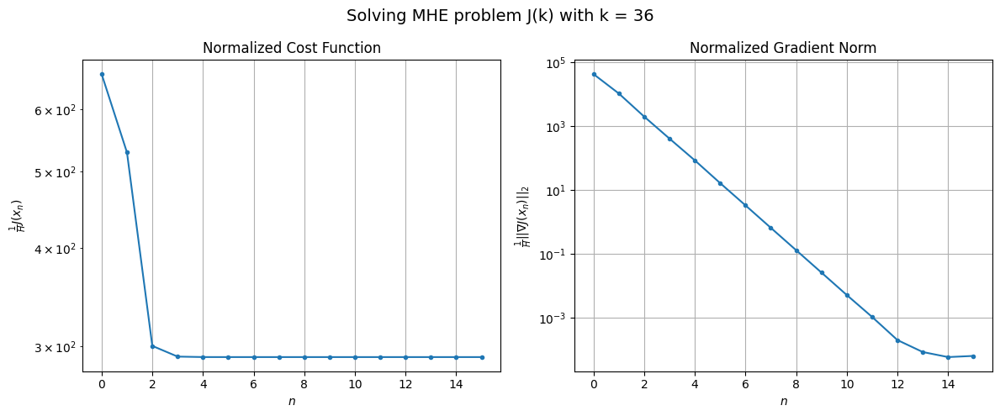

Windows:   7%|▋         | 28/386 [01:42<22:48,  3.82s/it]

[Gauss-Newton] Before applying the algorithm
Cost function: 3884.1142089735413
Gradient norm: 365011.3309207815
Global estimation error: 486.0500434462294
Initial conditions estimation errors: 1.3886938848515984 m, 50.7090834278916 m, 307.2147903398271 m, 373.2162273170143 m
Position estimation errors: 5.888536743970812 m, 54.46868688538779 m, 265.69337788039377 m, 342.09826218826953 m

[Gauss-Newton] Iteration 1
Cost function: 675993.8699408269 (17304.07%)
Gradient norm: 1682635.3655909926 (360.98%)
Global estimation error: 2953.168840018702 (507.59%)
Initial conditions estimation errors: 3.687478970164774 m, 315.7137384775647 m, 1856.1126640483908 m, 2275.162155752954 m
Position estimation errors: 3.1811340467394005 m, 258.34883738342677 m, 1487.2523627788705 m, 1925.4954384435082 m

[Gauss-Newton] Iteration 2
Cost function: 10806.12593872457 (-98.40%)
Gradient norm: 185867.4530056128 (-88.95%)
Global estimation error: 1779.9754913080337 (-39.73%)
Initial conditions estimation errors

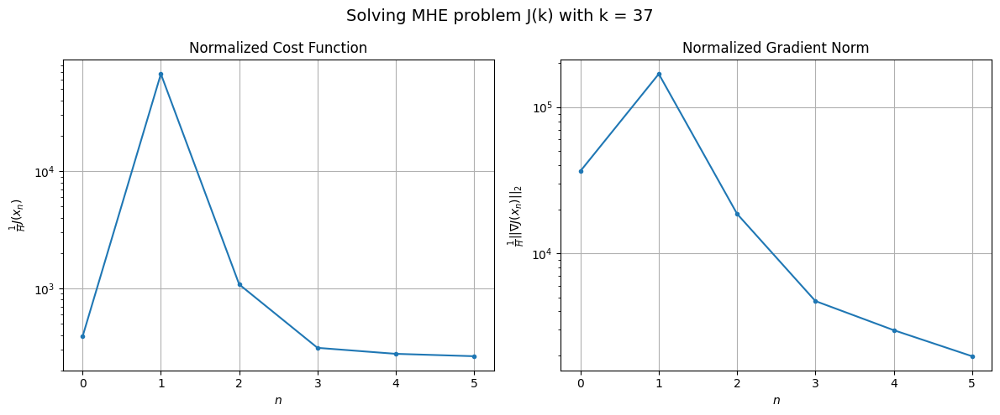

Windows:   8%|▊         | 29/386 [01:45<20:08,  3.38s/it]

[Gauss-Newton] Before applying the algorithm
Cost function: 3373.759598968668
Gradient norm: 347113.267499978
Global estimation error: 2278.481271206336
Initial conditions estimation errors: 1.1947622873926111 m, 243.84850287346816 m, 1431.3065118392194 m, 1755.9540989765571 m
Position estimation errors: 5.311816317381299 m, 191.49807471688518 m, 1087.559759827498 m, 1404.5512714930585 m

[Gauss-Newton] Iteration 1
Cost function: 523510.1399412493 (15417.11%)
Gradient norm: 1404043.3517261154 (304.49%)
Global estimation error: 1115.3619607129745 (-51.05%)
Initial conditions estimation errors: 3.455656693499167 m, 122.129815891873 m, 702.6789512635044 m, 857.523597919465 m
Position estimation errors: 2.7155606264769068 m, 97.67091290808025 m, 487.55165039717417 m, 598.814263950835 m

[Gauss-Newton] Iteration 2
Cost function: 2006.870929421903 (-99.62%)
Gradient norm: 7240.589458107961 (-99.48%)
Global estimation error: 1176.5888617372698 (5.49%)
Initial conditions estimation errors: 3.4

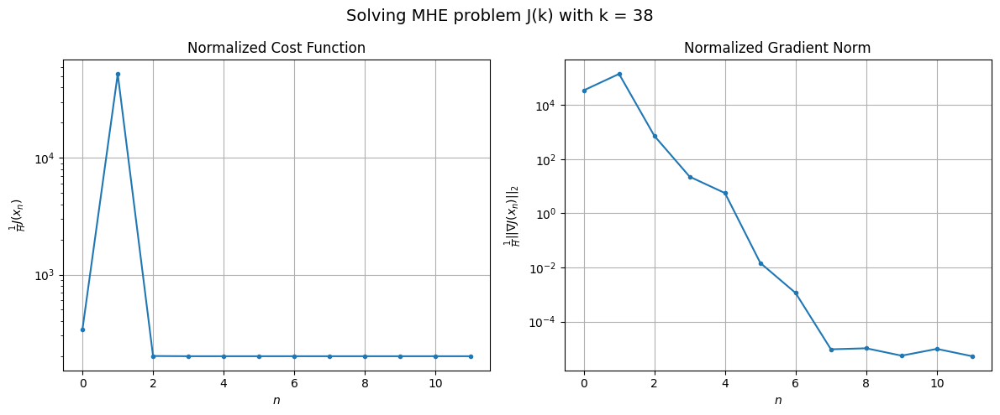

Windows:   8%|▊         | 30/386 [01:49<21:26,  3.61s/it]

[Gauss-Newton] Before applying the algorithm
Cost function: 2392.017855064987
Gradient norm: 286400.11832556495
Global estimation error: 1226.5513021273534
Initial conditions estimation errors: 0.9676475922440554 m, 134.1287791618771 m, 764.7265589906056 m, 949.54190886949 m
Position estimation errors: 4.588951261249141 m, 111.01860206741985 m, 607.8112220823413 m, 796.5346862505133 m

[Gauss-Newton] Iteration 1
Cost function: 1530.9776091797717 (-36.00%)
Gradient norm: 27464.073913946308 (-90.41%)
Global estimation error: 1010.5189269686614 (-17.61%)
Initial conditions estimation errors: 3.0000867326731613 m, 113.12214851873641 m, 626.8967532843819 m, 784.4379440971945 m
Position estimation errors: 2.3411612985786934 m, 72.3839517379967 m, 346.6296587700796 m, 450.17378849478064 m

[Gauss-Newton] Iteration 2
Cost function: 1421.7234551130325 (-7.14%)
Gradient norm: 3978.121986927518 (-85.52%)
Global estimation error: 837.7420395531849 (-17.10%)
Initial conditions estimation errors: 3.

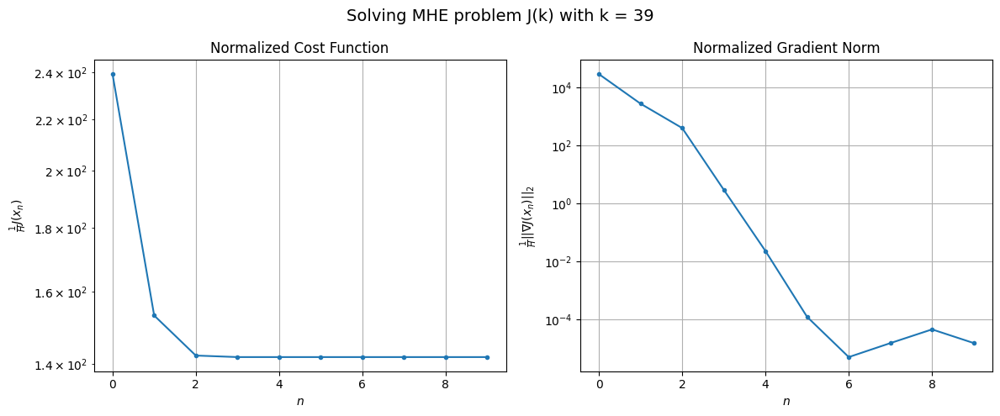

Windows:   8%|▊         | 31/386 [01:52<20:28,  3.46s/it]

[Gauss-Newton] Before applying the algorithm
Cost function: 1720.3046063684644
Gradient norm: 247956.98006385594
Global estimation error: 814.2880738930825
Initial conditions estimation errors: 0.7389644137681095 m, 93.23487933255127 m, 501.7487444279305 m, 634.5230666861054 m
Position estimation errors: 3.940612730103352 m, 53.457487287010906 m, 238.16316432239236 m, 316.2985906578966 m

[Gauss-Newton] Iteration 1
Cost function: 119716.81204342301 (6859.05%)
Gradient norm: 784418.0490796468 (216.35%)
Global estimation error: 2907.422248613072 (257.05%)
Initial conditions estimation errors: 2.5137095237546556 m, 312.2579022809516 m, 1801.7752456687208 m, 2260.3535949646484 m
Position estimation errors: 1.9555356638617567 m, 273.87810788836686 m, 1524.4320466201516 m, 2023.4445569149837 m

[Gauss-Newton] Iteration 2
Cost function: 973.0346136505756 (-99.19%)
Gradient norm: 2512.2174006351265 (-99.68%)
Global estimation error: 2775.0550553210064 (-4.55%)
Initial conditions estimation err

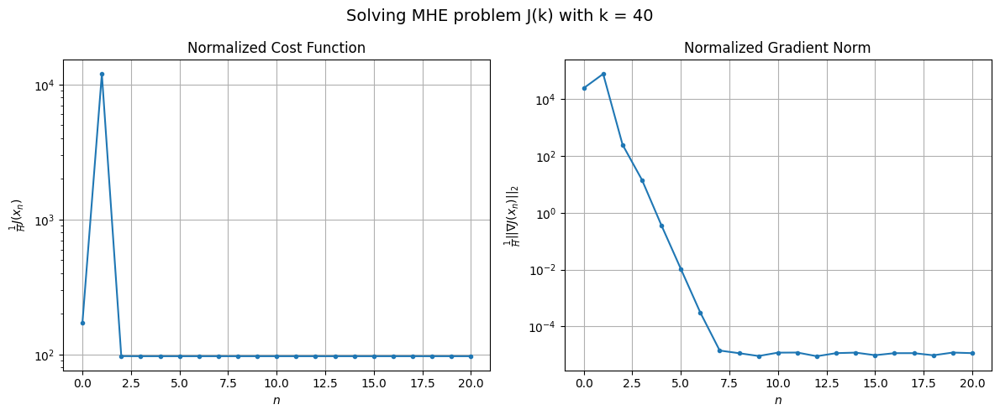

Windows:   8%|▊         | 32/386 [01:58<26:09,  4.43s/it]

[Gauss-Newton] Before applying the algorithm
Cost function: 1134.2200639079927
Gradient norm: 202096.68482094846
Global estimation error: 2808.8499729723226
Initial conditions estimation errors: 0.575807347171629 m, 302.4462890285754 m, 1735.1274246929647 m, 2188.0348658231055 m
Position estimation errors: 3.292142410896113 m, 252.1845089437801 m, 1399.3408665878965 m, 1874.452857340305 m

[Gauss-Newton] Iteration 1
Cost function: 676.2409279718344 (-40.38%)
Gradient norm: 9256.894830038405 (-95.42%)
Global estimation error: 2615.668756840454 (-6.88%)
Initial conditions estimation errors: 2.0401419197813575 m, 278.1022805767156 m, 1591.1158894125638 m, 2057.3593840592566 m
Position estimation errors: 1.6766301549013303 m, 239.64962997209864 m, 1420.4497241142942 m, 1922.0375316496936 m

[Gauss-Newton] Iteration 2
Cost function: 1312.3748365774109 (94.07%)
Gradient norm: 55947.53381092792 (504.39%)
Global estimation error: 3242.0018129772457 (23.95%)
Initial conditions estimation errors

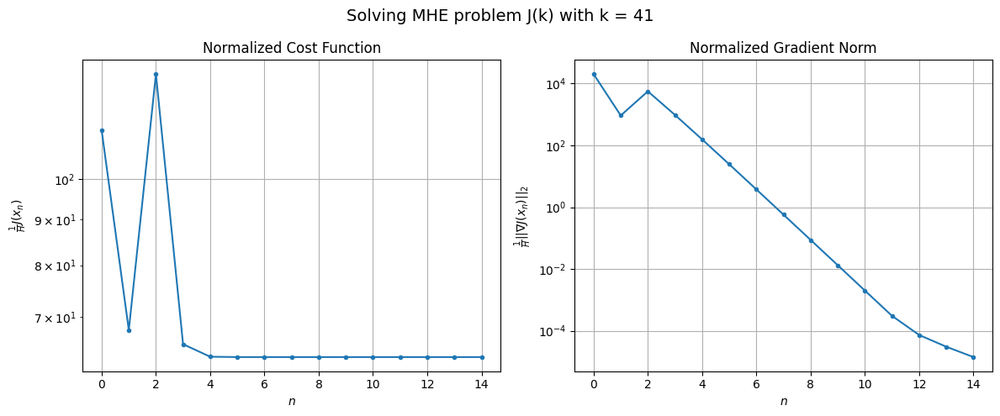

Windows:   9%|▊         | 33/386 [02:04<27:47,  4.72s/it]

[Gauss-Newton] Before applying the algorithm
Cost function: 864.3341303411592
Gradient norm: 187184.2127316287
Global estimation error: 3710.8260565793457
Initial conditions estimation errors: 0.4461738338716028 m, 392.9717900751814 m, 2258.5646996202577 m, 2917.993789159428 m
Position estimation errors: 2.9004846182770225 m, 320.91055299669756 m, 1900.3906961965704 m, 2592.251552173967 m

[Gauss-Newton] Iteration 1
Cost function: 26056.38879961538 (2914.62%)
Gradient norm: 334926.1099867789 (78.93%)
Global estimation error: 2111.645840844092 (-43.09%)
Initial conditions estimation errors: 1.6652242803779915 m, 222.2734792534356 m, 1274.491062886414 m, 1668.9254486038235 m
Position estimation errors: 1.495851437051769 m, 180.0450142126841 m, 1088.4363169114797 m, 1513.8792745235505 m

[Gauss-Newton] Iteration 2
Cost function: 533.4217138819716 (-97.95%)
Gradient norm: 12883.291389293307 (-96.15%)
Global estimation error: 1794.233468312098 (-15.03%)
Initial conditions estimation errors:

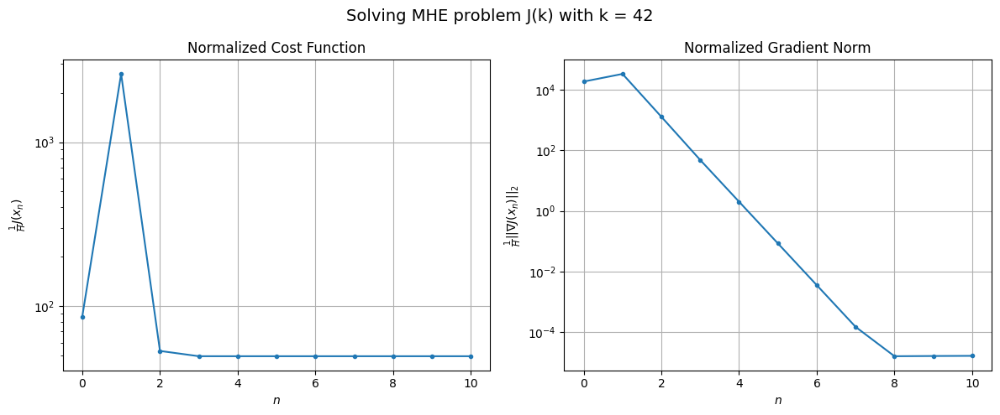

Windows:   9%|▉         | 34/386 [02:08<26:03,  4.44s/it]

[Gauss-Newton] Before applying the algorithm
Cost function: 774.4769286130403
Gradient norm: 178600.85421867078
Global estimation error: 1725.3049956789698
Initial conditions estimation errors: 0.4105874965896206 m, 179.87856554185535 m, 1033.3178825177504 m, 1369.8813253017784 m
Position estimation errors: 2.8984147510048306 m, 139.1998884506257 m, 855.3191517791417 m, 1210.5789303193421 m

[Gauss-Newton] Iteration 1
Cost function: 7387.897514847843 (853.92%)
Gradient norm: 163015.53721451733 (-8.73%)
Global estimation error: 2903.129119125876 (68.27%)
Initial conditions estimation errors: 1.4449250247906265 m, 311.416287742648 m, 1764.033580479116 m, 2284.59223633745 m
Position estimation errors: 1.66187165156575 m, 236.95704859325556 m, 1378.1858440195733 m, 1899.7388331779232 m

[Gauss-Newton] Iteration 2
Cost function: 480.2902341230457 (-93.50%)
Gradient norm: 848.9371162398863 (-99.48%)
Global estimation error: 2794.7526849720784 (-3.73%)
Initial conditions estimation errors: 1.

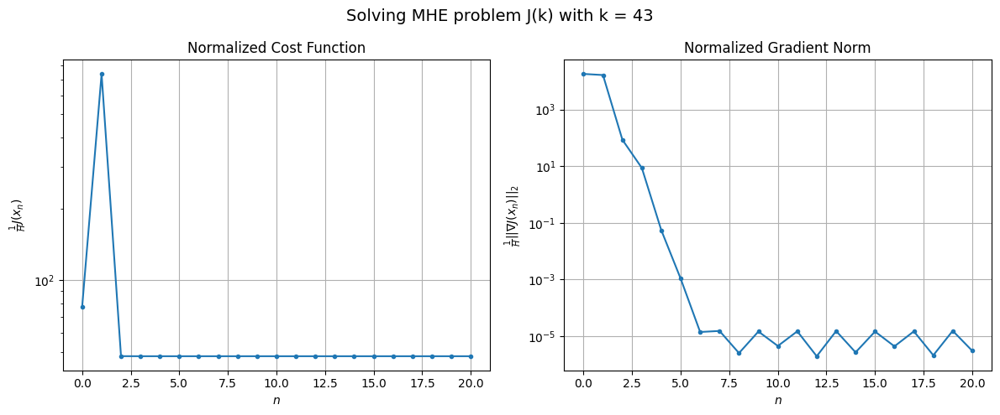

Windows:   9%|▉         | 35/386 [02:14<30:09,  5.15s/it]

[Gauss-Newton] Before applying the algorithm
Cost function: 988.1456058641188
Gradient norm: 210534.12206487145
Global estimation error: 2812.967960272012
Initial conditions estimation errors: 0.46322694772575795 m, 299.6642189900066 m, 1702.4888100143419 m, 2219.126263252981 m
Position estimation errors: 3.421437532897848 m, 220.28881863255603 m, 1285.8402833227378 m, 1795.4472666936679 m

[Gauss-Newton] Iteration 1
Cost function: 604736.1453681185 (61099.09%)
Gradient norm: 1556736.6104547163 (639.42%)
Global estimation error: 964.5033952380641 (-65.71%)
Initial conditions estimation errors: 1.5274158148800367 m, 98.50346010088835 m, 602.4676712473104 m, 746.722227550316 m
Position estimation errors: 1.9933264210290298 m, 74.322208697626 m, 397.07443616926554 m, 523.4179646350767 m

[Gauss-Newton] Iteration 2
Cost function: 283494.56269795005 (-53.12%)
Gradient norm: 1121973.1987891516 (-27.93%)
Global estimation error: 3905.972672371404 (304.97%)
Initial conditions estimation errors

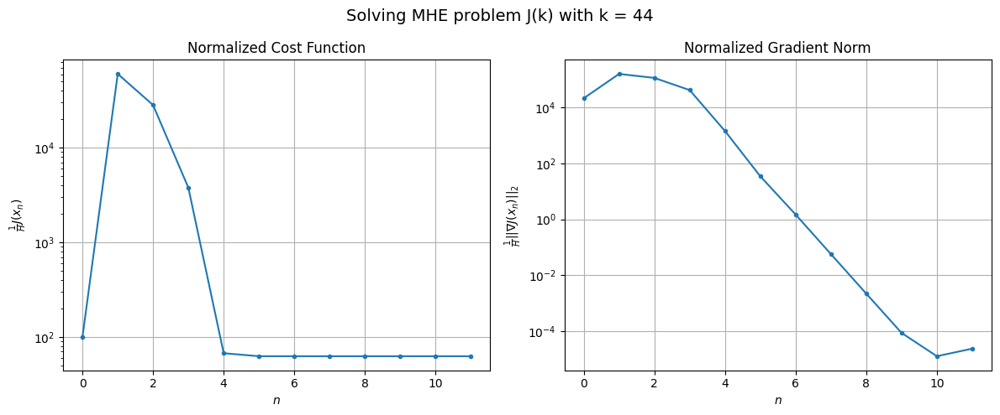

Windows:   9%|▉         | 36/386 [02:19<28:22,  4.86s/it]

[Gauss-Newton] Before applying the algorithm
Cost function: 1295.8555742750289
Gradient norm: 229144.3939795709
Global estimation error: 6051.133722281435
Initial conditions estimation errors: 0.6431923485776597 m, 631.2957891610625 m, 3650.3036800444597 m, 4784.65947293906 m
Position estimation errors: 4.033010458429785 m, 482.05022044766173 m, 2821.8028921881137 m, 3867.4029934487207 m

[Gauss-Newton] Iteration 1
Cost function: 12722987.474588407 (981721.41%)
Gradient norm: 7409526.025096734 (3133.56%)
Global estimation error: 2128.076084157528 (-64.83%)
Initial conditions estimation errors: 1.782335307644164 m, 228.4497468011203 m, 1264.957027706543 m, 1695.9948823580328 m
Position estimation errors: 2.4140421272827886 m, 170.4954761214132 m, 1030.2577851144663 m, 1407.575259942325 m

[Gauss-Newton] Iteration 2
Cost function: 4472095.834944919 (-64.85%)
Gradient norm: 4572746.8318537725 (-38.29%)
Global estimation error: 4270.0937750379635 (100.66%)
Initial conditions estimation err

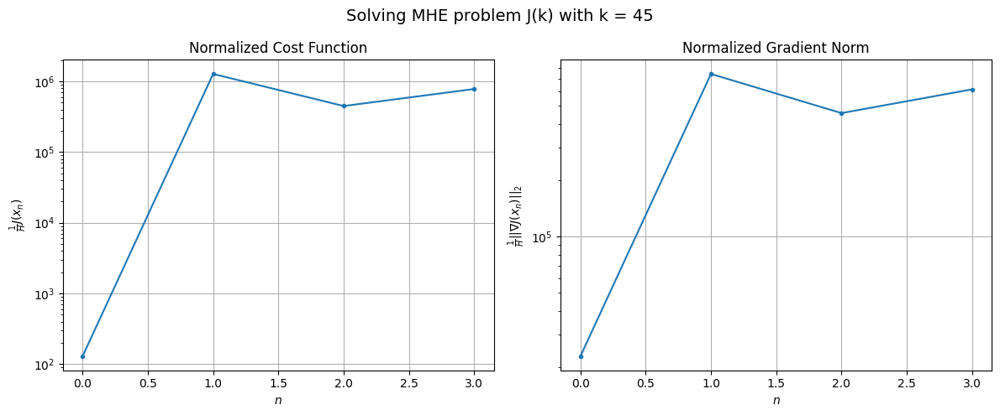

Windows:  10%|▉         | 37/386 [02:21<23:05,  3.97s/it]

[Gauss-Newton] Before applying the algorithm
Cost function: 7287087.34227473
Gradient norm: 5843827.654543835
Global estimation error: 2685.812622610295
Initial conditions estimation errors: 0.8120681536826364 m, 268.56075641801345 m, 1577.526635665351 m, 2157.051945693585 m
Position estimation errors: 4.602169437053787 m, 219.48747521964216 m, 1423.4739972370796 m, 2033.380478124605 m

[Gauss-Newton] Iteration 1
Cost function: 2468899.231018655 (-66.12%)
Gradient norm: 3584387.415520823 (-38.66%)
Global estimation error: 2444.5816370690136 (-8.98%)
Initial conditions estimation errors: 2.211229679234164 m, 224.72345746210593 m, 1414.2086866538452 m, 1981.2840749812658 m
Position estimation errors: 2.6419893224068045 m, 211.81151306913748 m, 1393.1107470278416 m, 2046.2822806379545 m

[Gauss-Newton] STOP on Iteration 2 (gradient norm stagnated)
Cost function = 11565584.845741846 (368.45%)
Gradient norm = 7568459.913367817 (111.15%)
Global estimation error = 5107.380305200804 (108.93%)


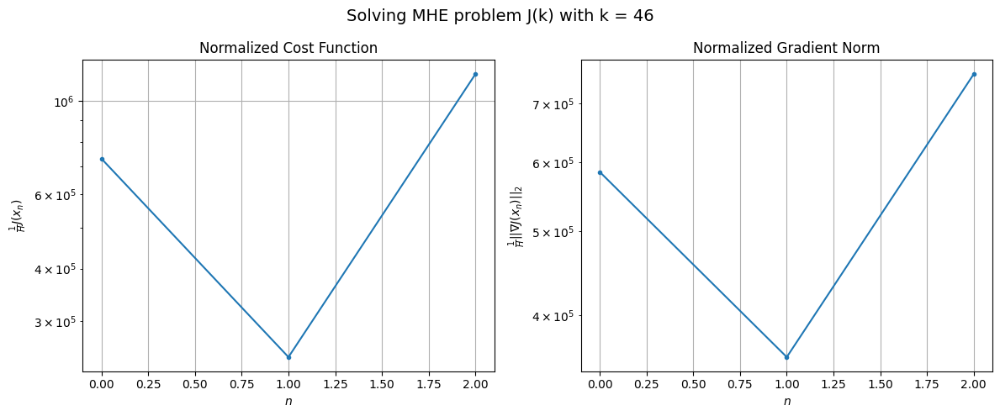

Windows:  10%|▉         | 38/386 [02:22<18:44,  3.23s/it]

[Gauss-Newton] Before applying the algorithm
Cost function: 10955496.197504386
Gradient norm: 7262009.569812452
Global estimation error: 5129.473729476489
Initial conditions estimation errors: 0.9722717040787032 m, 514.2553065070493 m, 3032.8122851354387 m, 4104.764312491201 m
Position estimation errors: 4.835894680279586 m, 393.20314356529644 m, 2493.104335368317 m, 3558.622292967126 m

[Gauss-Newton] Iteration 1
Cost function: 31063439.022657376 (183.54%)
Gradient norm: 12045884.323199095 (65.88%)
Global estimation error: 5111.390162917454 (-0.35%)
Initial conditions estimation errors: 2.5229039054120452 m, 495.9002364189006 m, 3022.9922853600046 m, 4091.686962439837 m
Position estimation errors: 2.738438376699483 m, 410.1354248721354 m, 2516.9795131861397 m, 3617.0581790463425 m

[Gauss-Newton] Iteration 2
Cost function: 12273538.746957168 (-60.49%)
Gradient norm: 7943256.417603857 (-34.06%)
Global estimation error: 2968.331625492218 (-41.93%)
Initial conditions estimation errors: 2

/home/jgaspar/SpaceSim-Toolkit/test/new_newton_based_algorithms/gauss_newton.py:181: LinAlgWarning: Ill-conditioned matrix (rcond=1.03068e-16): result may not be accurate.
  delta_x = solve(HJ_x, -DJ_x)


[Gauss-Newton] Iteration 11
Cost function: 4812781.280026132 (-68.77%)
Gradient norm: 5011492.373106927 (-43.71%)
Global estimation error: 7886.149435218162 (227.90%)
Initial conditions estimation errors: 2.52290383258286 m, 763.3448441102523 m, 4628.978023663794 m, 6338.865109840546 m
Position estimation errors: 2.7384384632188454 m, 644.2112467897825 m, 4028.6239245722504 m, 5809.654666251959 m

[Gauss-Newton] STOP on Iteration 12 (gradient norm stagnated)
Cost function = 11819275.96830298 (145.58%)
Gradient norm = 7825151.3850938305 (56.14%)
Global estimation error = 1216.8405072508638 (-84.57%)
Final initial conditions estimation errors: 2.522903907329652 m, 129.62362526161772 m, 759.8331219690031 m, 941.5649445188601 m
Final position estimation errors: 2.738438378967988 m, 97.58014204551168 m, 536.0894420796008 m, 772.0859441062488 m



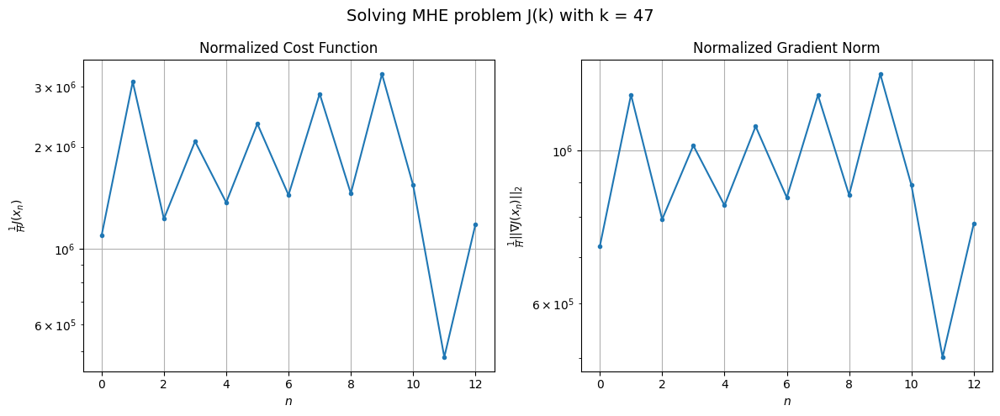

Windows:  10%|█         | 39/386 [02:27<20:58,  3.63s/it]

[Gauss-Newton] Before applying the algorithm
Cost function: 11431756.410325829
Gradient norm: 7576040.254643251
Global estimation error: 1188.2796187857973
Initial conditions estimation errors: 1.0134152522403292 m, 128.77123932221414 m, 733.5257191934595 m, 925.9395713324625 m
Position estimation errors: 4.834589319972388 m, 90.360843267221 m, 519.5334477955474 m, 753.9231362422446 m

[Gauss-Newton] Iteration 1
Cost function: 1668055.9895411977 (-85.41%)
Gradient norm: 2858273.484864879 (-62.27%)
Global estimation error: 4151.323477777085 (249.36%)
Initial conditions estimation errors: 2.645840702290832 m, 374.549333995961 m, 2342.530180526756 m, 3406.7198959868106 m
Position estimation errors: 2.6906268090279677 m, 286.6798004526884 m, 2416.943604032651 m, 3676.326264029594 m

[Gauss-Newton] Iteration 2
Cost function: 6669.10699476724 (-99.60%)
Gradient norm: 162454.1876697691 (-94.32%)
Global estimation error: 3034.064255895287 (-26.91%)
Initial conditions estimation errors: 2.64584

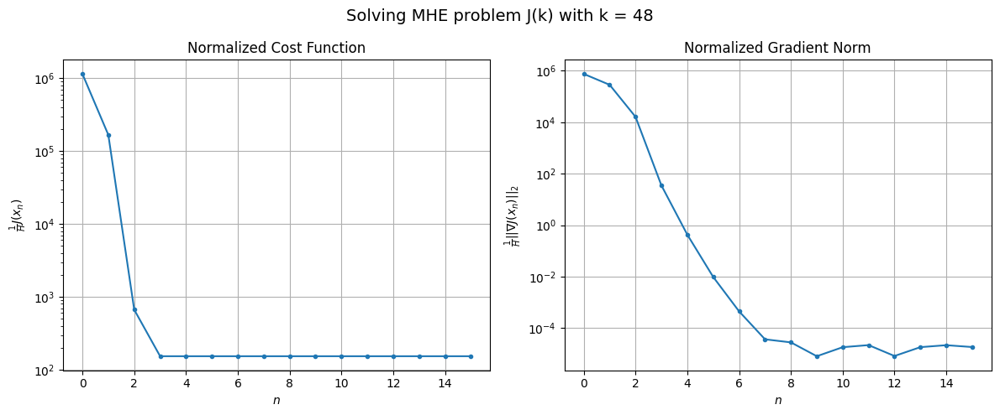

Windows:  10%|█         | 40/386 [02:32<23:59,  4.16s/it]

[Gauss-Newton] Before applying the algorithm
Cost function: 2302.383772218361
Gradient norm: 282790.29936148506
Global estimation error: 3073.1285708706982
Initial conditions estimation errors: 0.9322558328833479 m, 262.1044805899672 m, 1714.6526139359992 m, 2536.8057999983034 m
Position estimation errors: 4.609438122607943 m, 191.9204985134505 m, 1764.7213569017556 m, 2716.644267552933 m

[Gauss-Newton] Iteration 1
Cost function: 1874.80568172012 (-18.57%)
Gradient norm: 28456.35281759313 (-89.94%)
Global estimation error: 3786.5317192148214 (23.21%)
Initial conditions estimation errors: 2.7645235692781287 m, 357.5573213152646 m, 2174.3154973656706 m, 3079.3373964980146 m
Position estimation errors: 2.3876416091334347 m, 250.4924152475478 m, 1936.7185855318937 m, 2858.1886995515147 m

[Gauss-Newton] Iteration 2
Cost function: 1430.3972082450582 (-23.70%)
Gradient norm: 1450.5530478641397 (-94.90%)
Global estimation error: 3867.4642270483587 (2.14%)
Initial conditions estimation errors

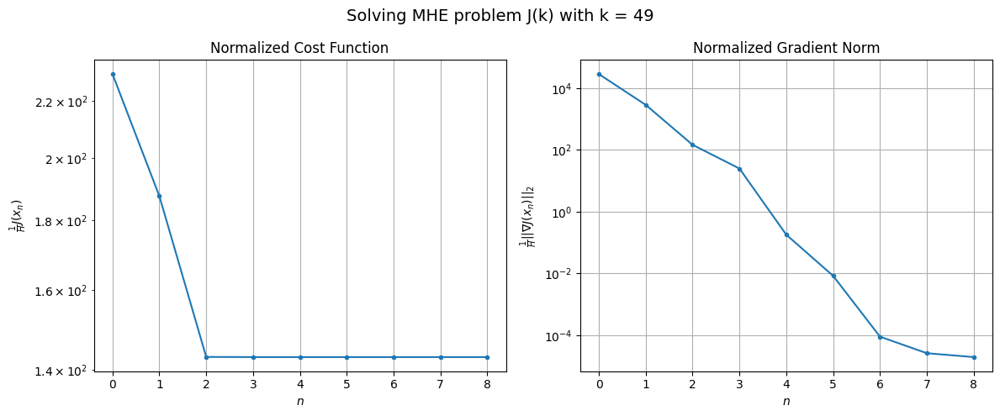

Windows:  11%|█         | 41/386 [02:35<22:25,  3.90s/it]

[Gauss-Newton] Before applying the algorithm
Cost function: 1919.0003985866997
Gradient norm: 242470.8408029987
Global estimation error: 3942.647733568701
Initial conditions estimation errors: 0.932431521012794 m, 359.5086307263966 m, 2255.634549390272 m, 3213.6172573287718 m
Position estimation errors: 4.033141181301684 m, 237.39162284198233 m, 1942.4288414804482 m, 2893.833990383216 m

[Gauss-Newton] Iteration 1
Cost function: 189040.1041366235 (9750.97%)
Gradient norm: 905965.4271724615 (273.64%)
Global estimation error: 1107.0742332168247 (-71.92%)
Initial conditions estimation errors: 2.65566819073121 m, 82.4643872085337 m, 603.6698646504111 m, 924.3311964851733 m
Position estimation errors: 2.044056261544338 m, 43.02070005778608 m, 651.8959830182027 m, 1035.396564882452 m

[Gauss-Newton] STOP on Iteration 2 (gradient norm stagnated)
Cost function = 137965.36528918977 (-27.02%)
Gradient norm = 854804.8326966626 (-5.65%)
Global estimation error = 1329.363217095214 (20.08%)
Final in

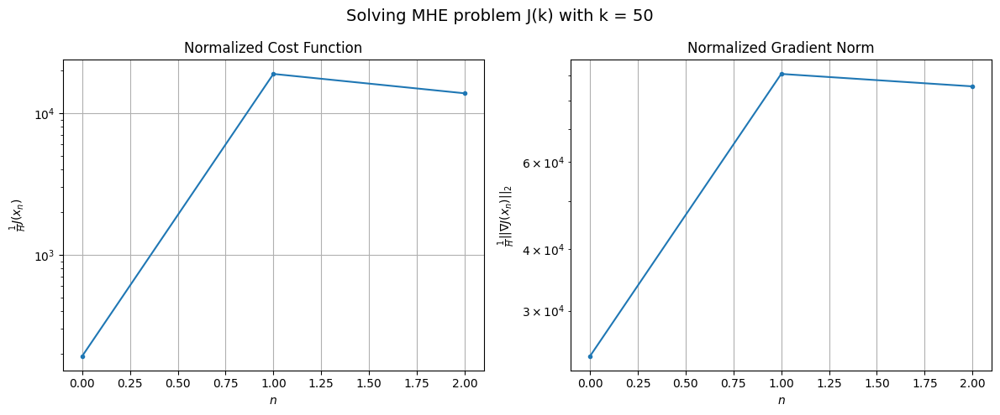

Windows:  11%|█         | 42/386 [02:37<18:20,  3.20s/it]

[Gauss-Newton] Before applying the algorithm
Cost function: 135984.45031230693
Gradient norm: 824523.0794412398
Global estimation error: 1337.5683290485283
Initial conditions estimation errors: 0.8478789175837116 m, 122.35264164179719 m, 757.8214796603223 m, 1095.3650934104223 m
Position estimation errors: 3.3727308525101938 m, 96.73809820565376 m, 635.6125378356246 m, 985.2888798068078 m

[Gauss-Newton] Iteration 1
Cost function: 73521582.69840811 (53966.17%)
Gradient norm: 19769846.701158095 (2297.73%)
Global estimation error: 10706.919507246848 (700.48%)
Initial conditions estimation errors: 2.3782135895099596 m, 843.0611842627983 m, 5923.117631549323 m, 8879.416048922372 m
Position estimation errors: 1.7501464176834591 m, 697.736496147909 m, 5635.248568327291 m, 9002.348136977676 m

[Gauss-Newton] Iteration 2
Cost function: 2233237.6983543616 (-96.96%)
Gradient norm: 3522501.386745543 (-82.18%)
Global estimation error: 5311.0429662378 (-50.40%)
Initial conditions estimation errors:

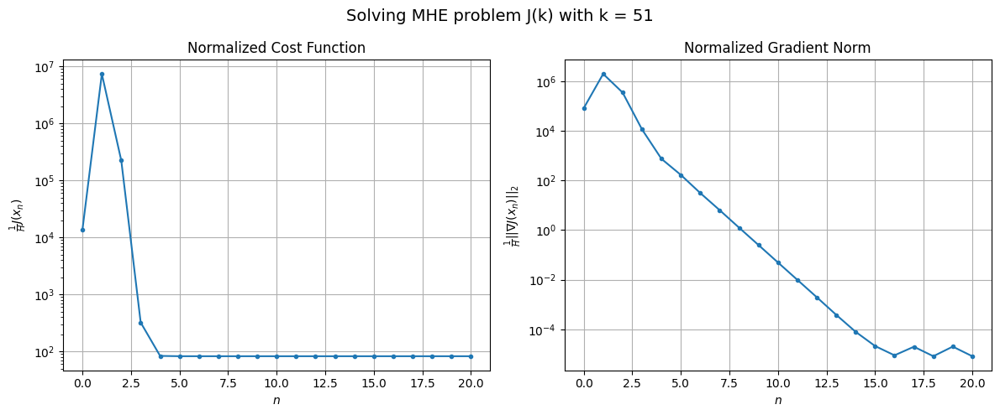

Windows:  11%|█         | 43/386 [02:43<23:54,  4.18s/it]

[Gauss-Newton] Before applying the algorithm
Cost function: 964.1453795375719
Gradient norm: 164642.36459682905
Global estimation error: 4591.447372237748
Initial conditions estimation errors: 0.7077443652678869 m, 365.63186225319436 m, 2551.690145788558 m, 3799.549706698858 m
Position estimation errors: 2.7695131847289427 m, 300.2248089181629 m, 2225.328453228964 m, 3530.2395007927435 m

[Gauss-Newton] Iteration 1
Cost function: 275196.474883969 (28443.05%)
Gradient norm: 1201371.159353586 (629.69%)
Global estimation error: 1672.052854832297 (-63.58%)
Initial conditions estimation errors: 2.014341709075632 m, 139.70401884724407 m, 946.6912492742716 m, 1371.1364127509153 m
Position estimation errors: 1.3909369183971414 m, 94.94910725127187 m, 758.3903897124276 m, 1161.0614100088644 m

[Gauss-Newton] Iteration 2
Cost function: 9897.10620177208 (-96.40%)
Gradient norm: 222639.48301235837 (-81.47%)
Global estimation error: 2914.592084265204 (74.31%)
Initial conditions estimation errors: 2

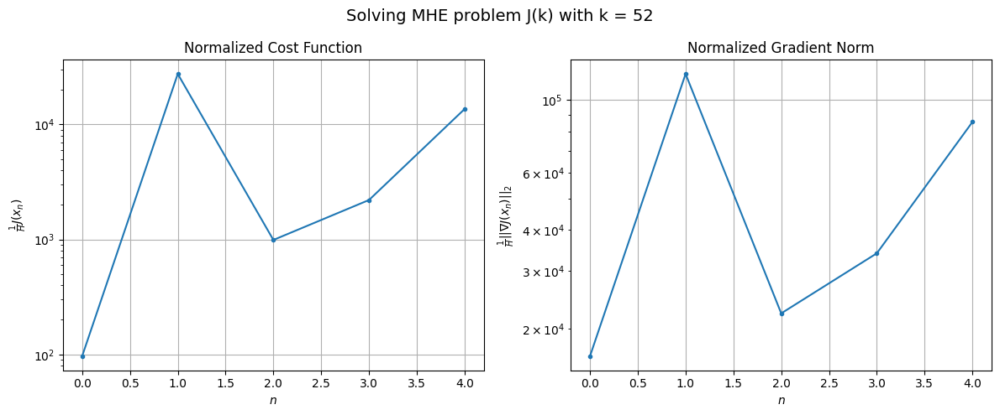

Windows:  11%|█▏        | 44/386 [02:45<20:12,  3.54s/it]

[Gauss-Newton] Before applying the algorithm
Cost function: 135033.2689036866
Gradient norm: 818365.6061181381
Global estimation error: 3843.6429130603638
Initial conditions estimation errors: 0.5506448476122939 m, 294.1802012929764 m, 2122.125654648978 m, 3191.1801235617368 m
Position estimation errors: 2.1087223090992047 m, 205.56836575081476 m, 1793.9214668082911 m, 2879.5809258277177 m

[Gauss-Newton] Iteration 1
Cost function: 512.2955822431103 (-99.62%)
Gradient norm: 21323.38299387879 (-97.39%)
Global estimation error: 3363.6951731652703 (-12.49%)
Initial conditions estimation errors: 1.6111955933278543 m, 218.63667316031592 m, 1831.2552844197628 m, 2813.031089079409 m
Position estimation errors: 1.0098816355219238 m, 166.47239825741394 m, 1611.6590981825555 m, 2644.0026094809346 m

[Gauss-Newton] Iteration 2
Cost function: 411.3055647766987 (-19.71%)
Gradient norm: 13362.521486725222 (-37.33%)
Global estimation error: 3064.6145373566633 (-8.89%)
Initial conditions estimation er

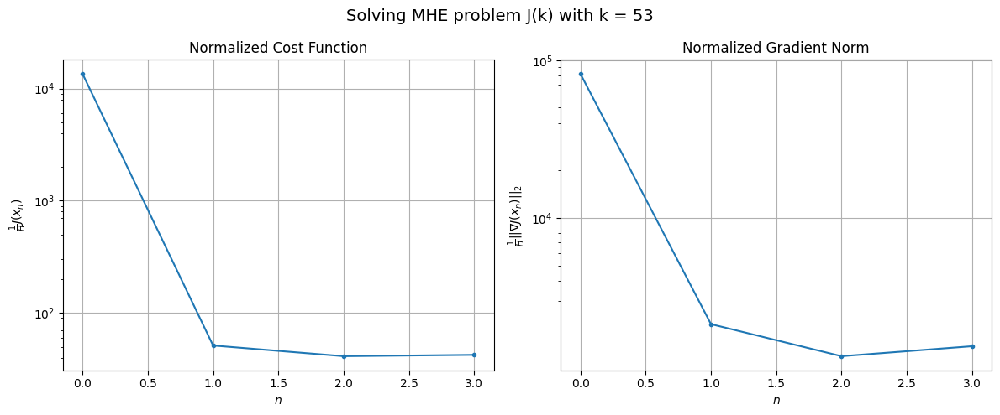

Windows:  12%|█▏        | 45/386 [02:47<17:16,  3.04s/it]

[Gauss-Newton] Before applying the algorithm
Cost function: 417.57675386631996
Gradient norm: 82942.99282639974
Global estimation error: 2755.710343781417
Initial conditions estimation errors: 0.4220082750655529 m, 171.05027229000416 m, 1498.8314019303957 m, 2306.1190854181978 m
Position estimation errors: 1.4532284122285744 m, 127.85440389060335 m, 1236.095278607896 m, 2036.6874230913718 m

[Gauss-Newton] Iteration 1
Cost function: 3668015.737040563 (878305.16%)
Gradient norm: 4358851.851562098 (5155.24%)
Global estimation error: 3007.6809545074434 (9.14%)
Initial conditions estimation errors: 1.200213114553302 m, 220.17952188900782 m, 1581.7263960869493 m, 2548.6868085734563 m
Position estimation errors: 0.6840022614455183 m, 134.45107894298195 m, 1513.6199809564325 m, 2602.456239473097 m

[Gauss-Newton] Iteration 2
Cost function: 4949.223914524154 (-99.87%)
Gradient norm: 166649.94389638415 (-96.18%)
Global estimation error: 3901.612044030002 (29.72%)
Initial conditions estimation e

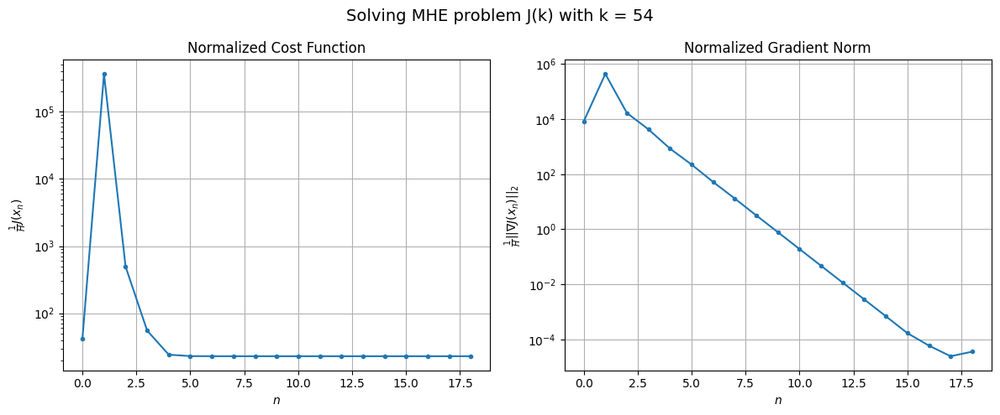

Windows:  12%|█▏        | 46/386 [02:54<22:49,  4.03s/it]

[Gauss-Newton] Before applying the algorithm
Cost function: 206.43157740900034
Gradient norm: 60289.0466501941
Global estimation error: 3599.2254533057517
Initial conditions estimation errors: 0.29367878914195034 m, 237.09526086870255 m, 1869.5179527485416 m, 3066.4491411170216 m
Position estimation errors: 0.910702925462545 m, 131.26044687283058 m, 1770.3246349987596 m, 3131.407170128601 m

[Gauss-Newton] Iteration 1
Cost function: 195.83617800825294 (-5.13%)
Gradient norm: 13905.710620140839 (-76.93%)
Global estimation error: 4075.5959288327545 (13.24%)
Initial conditions estimation errors: 0.8745994230784527 m, 237.33796801857198 m, 2162.43828854216 m, 3446.4491710261277 m
Position estimation errors: 0.3635036971747647 m, 204.3329841817982 m, 1898.2240000026595 m, 3184.959547758802 m

[Gauss-Newton] STOP on Iteration 2 (gradient norm stagnated)
Cost function = 153.02050677536778 (-21.86%)
Gradient norm = 12774.159043722275 (-8.14%)
Global estimation error = 4343.758137803049 (6.58%)

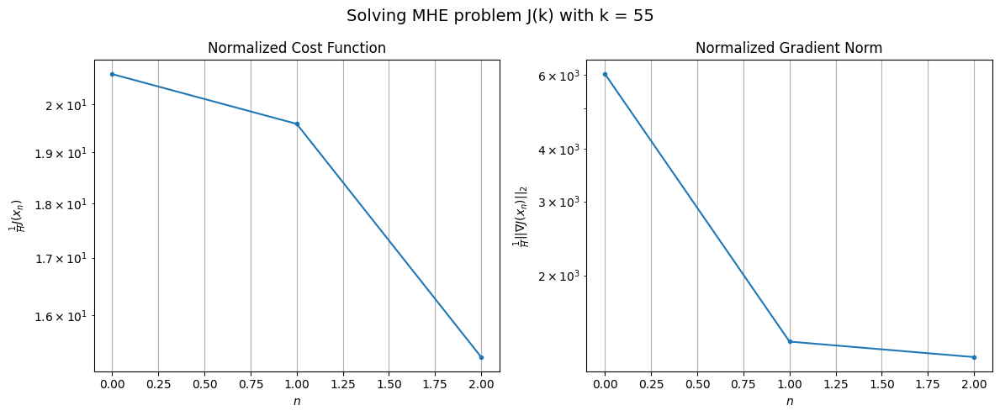

Windows:  12%|█▏        | 47/386 [02:55<18:26,  3.26s/it]

[Gauss-Newton] Before applying the algorithm
Cost function: 151.58445926591608
Gradient norm: 33800.66549042554
Global estimation error: 4381.250606936354
Initial conditions estimation errors: 0.23870237151397614 m, 276.72083041585347 m, 2306.1754891912174 m, 3714.880381600591 m
Position estimation errors: 0.5176933263867296 m, 193.50297343373447 m, 1970.820529339784 m, 3350.764133123881 m

[Gauss-Newton] Iteration 1
Cost function: 293628.21701206313 (193606.02%)
Gradient norm: 1219498.796838413 (3507.91%)
Global estimation error: 1318.0565696430062 (-69.92%)
Initial conditions estimation errors: 0.5404122954447843 m, 84.44587121408601 m, 702.9915966792175 m, 1111.730399436712 m
Position estimation errors: 0.26636990913831204 m, 71.02157575076524 m, 582.185119203938 m, 962.2773132918793 m

[Gauss-Newton] Iteration 2
Cost function: 3976468.952539339 (1254.25%)
Gradient norm: 4726776.194664323 (287.60%)
Global estimation error: 4314.245407121704 (227.32%)
Initial conditions estimation er

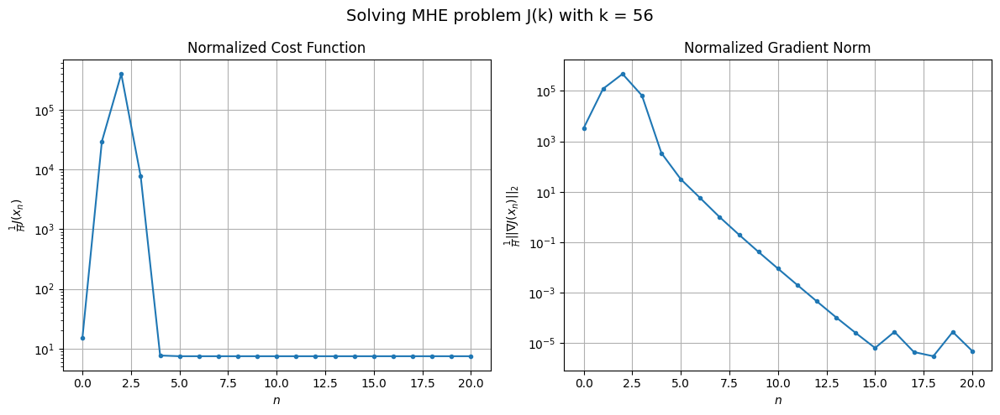

Windows:  12%|█▏        | 48/386 [03:02<24:54,  4.42s/it]

[Gauss-Newton] Before applying the algorithm
Cost function: 97.98710992564463
Gradient norm: 41268.31411731853
Global estimation error: 2127.264598052451
Initial conditions estimation errors: 0.14367390625467644 m, 88.54684025731454 m, 1049.6272906571523 m, 1848.1600097238436 m
Position estimation errors: 0.6614627466665369 m, 19.83566939735207 m, 1035.380049376051 m, 2037.9827572438548 m

[Gauss-Newton] Iteration 1
Cost function: 6241434.873062806 (6369548.90%)
Gradient norm: 5934888.642846951 (14281.22%)
Global estimation error: 4148.639785489267 (95.02%)
Initial conditions estimation errors: 0.35924511478577925 m, 218.04175593686762 m, 2100.066773448474 m, 3571.1883870982965 m
Position estimation errors: 0.46416839288325185 m, 83.98066227058568 m, 1945.9271569218183 m, 3708.3944957074077 m

[Gauss-Newton] Iteration 2
Cost function: 8549512.30849022 (36.98%)
Gradient norm: 6961081.610958625 (17.29%)
Global estimation error: 2773.5357378391536 (-33.15%)
Initial conditions estimation e

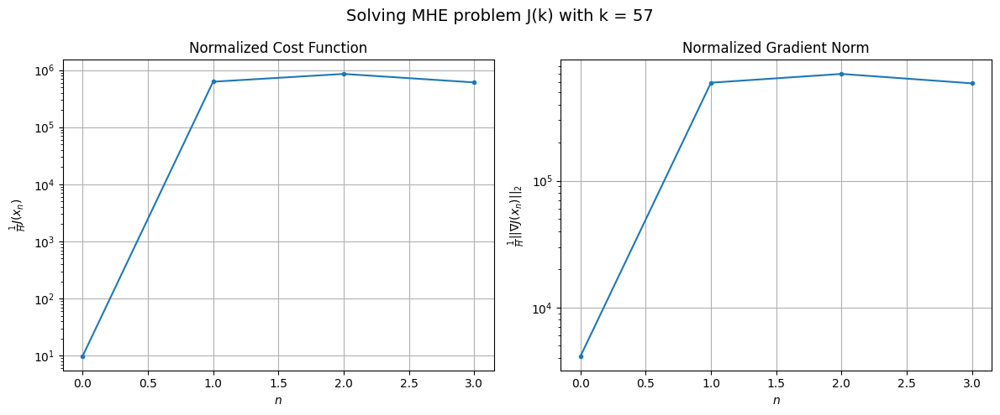

Windows:  13%|█▎        | 49/386 [03:04<20:46,  3.70s/it]

[Gauss-Newton] Before applying the algorithm
Cost function: 6171631.912214552
Gradient norm: 5862594.212933375
Global estimation error: 3680.974625909575
Initial conditions estimation errors: 0.14674181284240428 m, 180.34207891417154 m, 1845.811231643351 m, 3179.627386886299 m
Position estimation errors: 1.0978163190305261 m, 55.972154550915484 m, 1640.3351604127881 m, 3168.341365866038 m

[Gauss-Newton] Iteration 1
Cost function: 382718.95396043285 (-93.80%)
Gradient norm: 1444878.1830376836 (-75.35%)
Global estimation error: 443.06489796940957 (-87.96%)
Initial conditions estimation errors: 0.23558152101111327 m, 32.61751137435287 m, 227.3049730347651 m, 378.9128998723902 m
Position estimation errors: 0.7667629900630792 m, 7.338861807408855 m, 182.86326985417364 m, 347.48567605923716 m

[Gauss-Newton] STOP on Iteration 2 (gradient norm stagnated)
Cost function = 16298674.928275384 (4158.65%)
Gradient norm = 9627683.757641703 (566.33%)
Global estimation error = 7577.765240690406 (1610

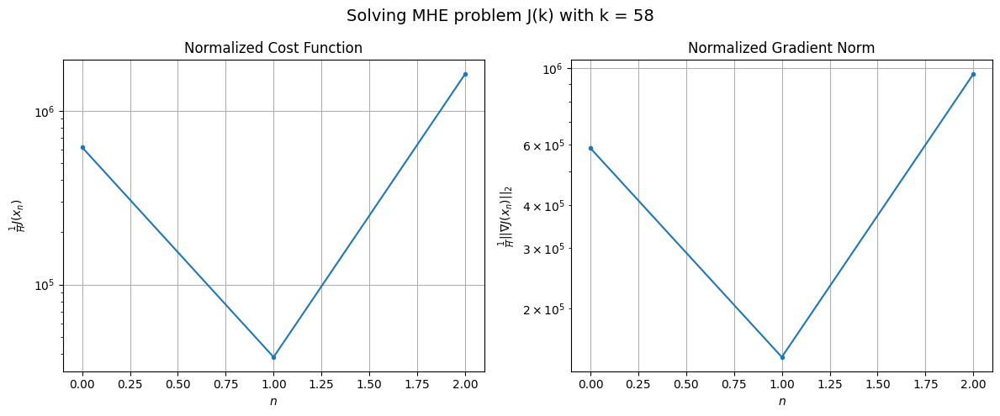

Windows:  13%|█▎        | 50/386 [03:06<16:59,  3.03s/it]

[Gauss-Newton] Before applying the algorithm
Cost function: 16588963.09760667
Gradient norm: 9621426.830477886
Global estimation error: 7748.088508508651
Initial conditions estimation errors: 0.15768598488251587 m, 286.69844938516775 m, 3792.1554910180635 m, 6750.572349605203 m
Position estimation errors: 1.556531343688229 m, 51.4768433034299 m, 3452.191401511829 m, 6957.647496708576 m

[Gauss-Newton] Iteration 1
Cost function: 1762829.279998851 (-89.37%)
Gradient norm: 3190950.3541659447 (-66.83%)
Global estimation error: 3122.811341622407 (-59.70%)
Initial conditions estimation errors: 0.4790803069252573 m, 108.00908276975694 m, 1524.3866283019233 m, 2723.330520084198 m
Position estimation errors: 1.0237751089414038 m, 60.2392827274407 m, 1351.368191789516 m, 2576.851130649401 m

[Gauss-Newton] STOP on Iteration 2 (gradient norm stagnated)
Cost function = 280737.67336277134 (-84.07%)
Gradient norm = 1271103.726481254 (-60.17%)
Global estimation error = 311.00084638369236 (-90.04%)
Fi

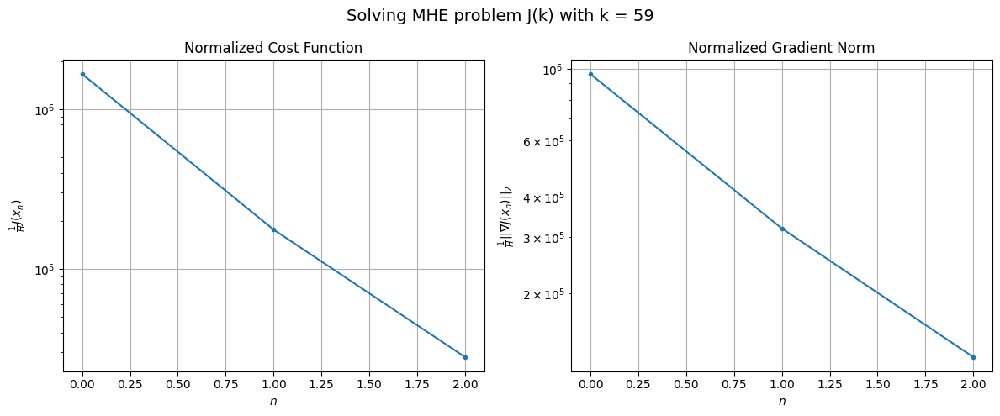

Windows:  13%|█▎        | 51/386 [03:07<14:34,  2.61s/it]

[Gauss-Newton] Before applying the algorithm
Cost function: 288846.19268709316
Gradient norm: 1301783.9581031175
Global estimation error: 281.77063221549514
Initial conditions estimation errors: 0.2947104575850629 m, 8.355512974421186 m, 147.9668497365144 m, 239.64582380861196 m
Position estimation errors: 1.9228152535481509 m, 62.149516201621296 m, 120.26757407887136 m, 228.16508152051426 m

[Gauss-Newton] Iteration 1
Cost function: 204.50748755168706 (-99.93%)
Gradient norm: 1980.359915998756 (-99.85%)
Global estimation error: 90.31331979963036 (-67.95%)
Initial conditions estimation errors: 0.7131775350368557 m, 4.946570787779275 m, 54.2459301329406 m, 72.03354695695964 m
Position estimation errors: 1.180577633092572 m, 38.90122783959246 m, 70.64277449019997 m, 73.28973770284287 m

[Gauss-Newton] Iteration 2
Cost function: 203.5139997241352 (-0.49%)
Gradient norm: 1008.8543485622697 (-49.06%)
Global estimation error: 162.2521631556619 (79.65%)
Initial conditions estimation errors: 0

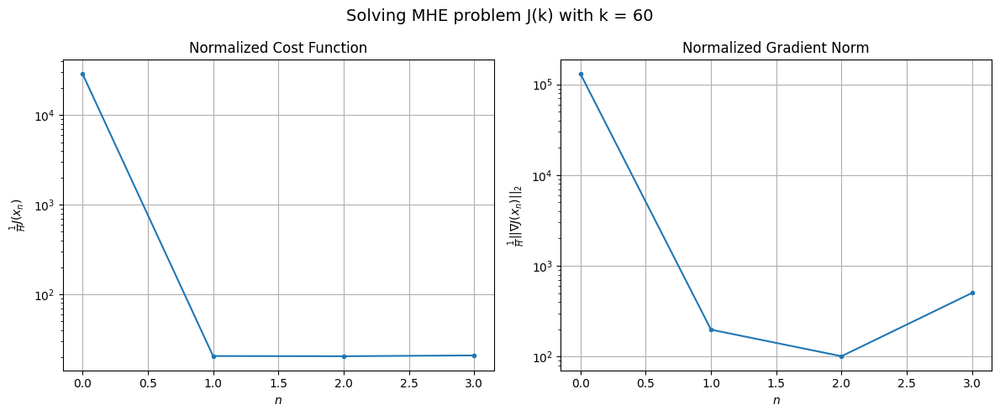

Windows:  13%|█▎        | 52/386 [03:09<13:41,  2.46s/it]

[Gauss-Newton] Before applying the algorithm
Cost function: 400.4953518290884
Gradient norm: 123422.17128537135
Global estimation error: 327.4526146425472
Initial conditions estimation errors: 0.37189928737022887 m, 9.127977163706255 m, 171.39405862512783 m, 278.86520747627276 m
Position estimation errors: 2.1423520549304524 m, 40.30437912285884 m, 150.15986632246447 m, 156.83786899819873 m

[Gauss-Newton] Iteration 1
Cost function: 29774.5455436957 (7334.43%)
Gradient norm: 387689.25734493026 (214.12%)
Global estimation error: 1415.1172246494536 (332.16%)
Initial conditions estimation errors: 0.8943933140500471 m, 48.65585251614154 m, 666.475593593666 m, 1247.3967646744893 m
Position estimation errors: 1.3194858886737788 m, 15.31890833713547 m, 564.3573148045143 m, 1196.719795254276 m

[Gauss-Newton] Iteration 2
Cost function: 6454622.579752441 (21578.32%)
Gradient norm: 6135318.279574232 (1482.54%)
Global estimation error: 7567.205790595001 (434.74%)
Initial conditions estimation err

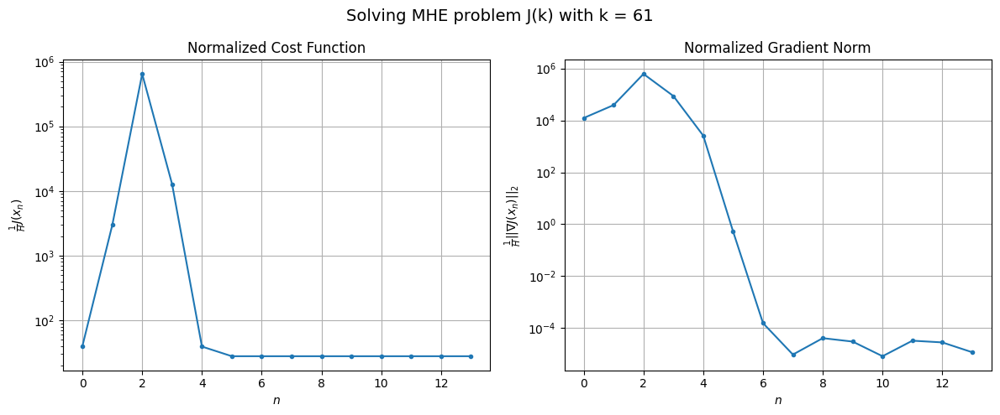

Windows:  14%|█▎        | 53/386 [03:14<17:18,  3.12s/it]

[Gauss-Newton] Before applying the algorithm
Cost function: 506.59679713985844
Gradient norm: 138676.6456830016
Global estimation error: 4867.623189225573
Initial conditions estimation errors: 0.38601135367593187 m, 118.84713599861497 m, 2268.884659367613 m, 4304.856580233572 m
Position estimation errors: 2.3435827649242813 m, 91.75104367123848 m, 1943.0013806546872 m, 4320.9255880486335 m

[Gauss-Newton] Iteration 1
Cost function: 451310.83320026315 (88986.79%)
Gradient norm: 1571018.8014957213 (1032.86%)
Global estimation error: 1615.0361342947126 (-66.82%)
Initial conditions estimation errors: 1.085858196071382 m, 41.74541246285557 m, 751.3240487339474 m, 1429.0240026580857 m
Position estimation errors: 1.359127062263598 m, 33.53433262163721 m, 667.5238486159305 m, 1484.419048135841 m

[Gauss-Newton] Iteration 2
Cost function: 765244.6637545233 (69.56%)
Gradient norm: 2132203.9358173925 (35.72%)
Global estimation error: 1936.8390953906473 (19.93%)
Initial conditions estimation error

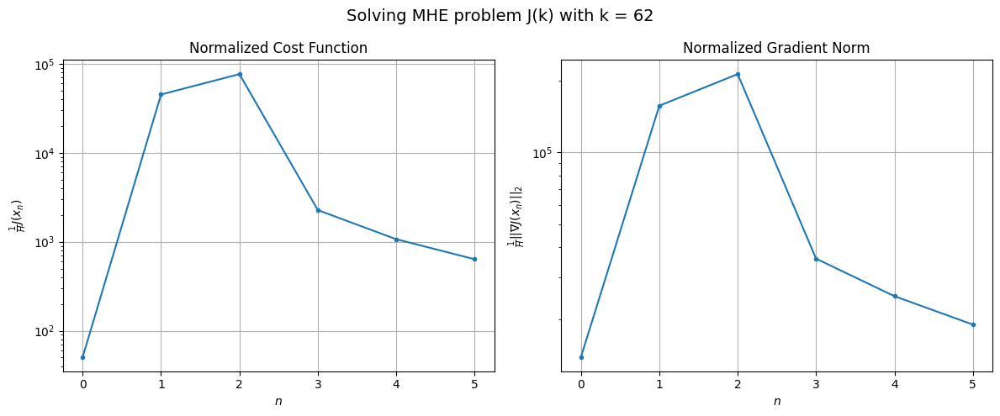

Windows:  14%|█▍        | 54/386 [03:17<16:14,  2.93s/it]

[Gauss-Newton] Before applying the algorithm
Cost function: 6880.108803672901
Gradient norm: 260915.7397912497
Global estimation error: 599.7453357645837
Initial conditions estimation errors: 0.404089748455138 m, 8.576275524728295 m, 278.21241936803307 m, 531.2420673072972 m
Position estimation errors: 2.4586263979811487 m, 41.99395792904973 m, 288.3591558410826 m, 768.6817394659126 m

[Gauss-Newton] Iteration 1
Cost function: 19653.562262258587 (185.66%)
Gradient norm: 327213.789467579 (25.41%)
Global estimation error: 2070.9913996859964 (245.31%)
Initial conditions estimation errors: 1.2449758888014437 m, 40.657059267075525 m, 954.6760818913301 m, 1837.3739483389454 m
Position estimation errors: 1.3375077380058507 m, 73.26058905363107 m, 870.3967153646893 m, 2077.051251094404 m

[Gauss-Newton] STOP on Iteration 2 (gradient norm stagnated)
Cost function = 72714.0496506671 (269.98%)
Gradient norm = 668456.9193220243 (104.29%)
Global estimation error = 205.5094257069922 (-90.08%)
Final 

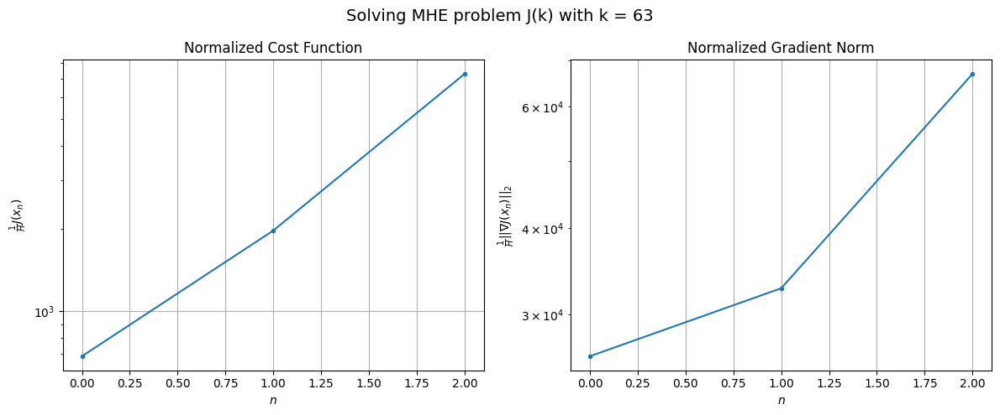

Windows:  14%|█▍        | 55/386 [03:18<13:37,  2.47s/it]

[Gauss-Newton] Before applying the algorithm
Cost function: 78005.20991879533
Gradient norm: 718042.6258805197
Global estimation error: 201.16055362500663
Initial conditions estimation errors: 0.4317370206766589 m, 1.4456065409908372 m, 83.44563916513482 m, 183.03030671468787 m
Position estimation errors: 2.573749979234694 m, 5.959515589544556 m, 58.28550642632586 m, 126.71784955812126 m

[Gauss-Newton] Iteration 1
Cost function: 90279.6634132904 (15.74%)
Gradient norm: 739911.2793811153 (3.05%)
Global estimation error: 2190.5996648645555 (988.98%)
Initial conditions estimation errors: 1.3102596656390153 m, 27.45793549974129 m, 987.8386771350598 m, 1955.0306167817448 m
Position estimation errors: 1.3699991827481008 m, 88.47405442226976 m, 879.5238342160802 m, 2145.9460778977955 m

[Gauss-Newton] Iteration 2
Cost function: 333090.08765257115 (268.95%)
Gradient norm: 1440242.6582108908 (94.65%)
Global estimation error: 541.2211254789352 (-75.29%)
Initial conditions estimation errors: 1.3

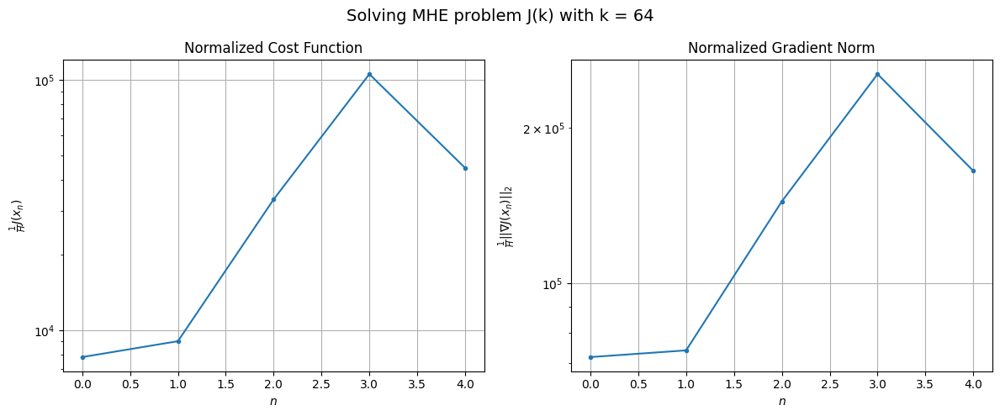

Windows:  15%|█▍        | 56/386 [03:20<12:58,  2.36s/it]

[Gauss-Newton] Before applying the algorithm
Cost function: 475830.3068087254
Gradient norm: 1718808.1793869578
Global estimation error: 254.5775038463988
Initial conditions estimation errors: 0.4182761615127612 m, 8.175704962021623 m, 102.69431073403688 m, 232.80120024322457 m
Position estimation errors: 2.8328346054172107 m, 20.053261739939767 m, 96.34902256707335 m, 221.0234439331546 m

[Gauss-Newton] Iteration 1
Cost function: 813.9695657110362 (-99.83%)
Gradient norm: 44414.47797223995 (-97.42%)
Global estimation error: 367.45737852788653 (44.34%)
Initial conditions estimation errors: 1.4370341245701497 m, 4.2884592363724225 m, 166.87140779103416 m, 327.3501820490839 m
Position estimation errors: 1.5568841991888154 m, 44.868885318260915 m, 179.17307490900765 m, 520.1023418622258 m

[Gauss-Newton] Iteration 2
Cost function: 11439.240741521078 (1305.36%)
Gradient norm: 261730.18354318247 (489.29%)
Global estimation error: 782.1290822527156 (112.85%)
Initial conditions estimation err

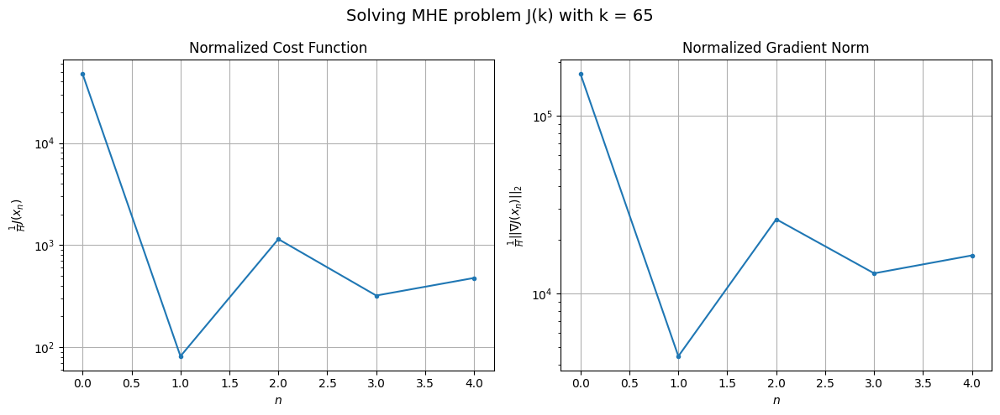

Windows:  15%|█▍        | 57/386 [03:22<12:33,  2.29s/it]

[Gauss-Newton] Before applying the algorithm
Cost function: 5551.915352085963
Gradient norm: 273595.9274473872
Global estimation error: 884.1927422542644
Initial conditions estimation errors: 0.5049826534198503 m, 4.996925747001205 m, 389.0708418066893 m, 793.9743915955829 m
Position estimation errors: 3.3314542279231922 m, 36.28713147815883 m, 322.34081803694284 m, 810.7412066570503 m

[Gauss-Newton] Iteration 1
Cost function: 938.5307598748773 (-83.10%)
Gradient norm: 54976.8141586415 (-79.91%)
Global estimation error: 1201.4690432844552 (35.88%)
Initial conditions estimation errors: 1.5996960321877727 m, 18.932259751255046 m, 545.0295422783107 m, 1070.564479691123 m
Position estimation errors: 1.8816735758096952 m, 86.61925816693069 m, 540.7308824952602 m, 1445.9310337986626 m

[Gauss-Newton] Iteration 2
Cost function: 846.1267644159227 (-9.85%)
Gradient norm: 46494.1025408457 (-15.43%)
Global estimation error: 791.1278266739573 (-34.15%)
Initial conditions estimation errors: 1.5996

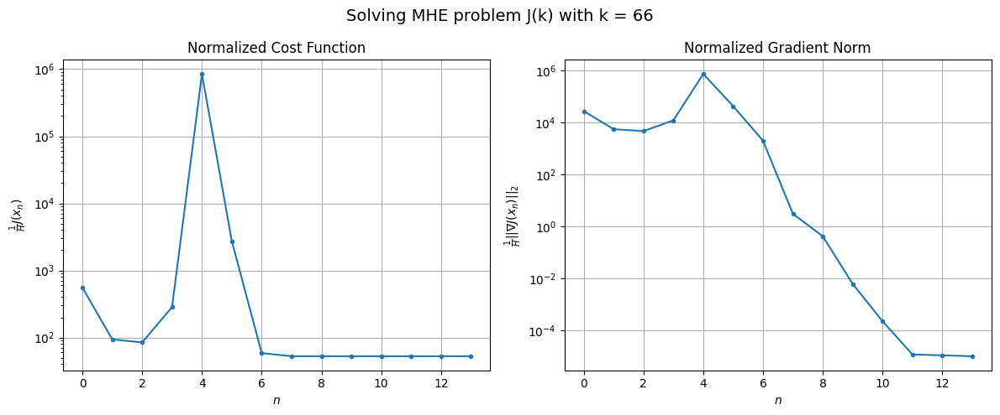

Windows:  15%|█▌        | 58/386 [03:27<16:18,  2.98s/it]

[Gauss-Newton] Before applying the algorithm
Cost function: 1292.7048184308505
Gradient norm: 255186.9382874575
Global estimation error: 4395.017601460379
Initial conditions estimation errors: 0.6252449628733573 m, 41.84224130736974 m, 1847.517476173936 m, 3987.6186608096887 m
Position estimation errors: 4.025873833491468 m, 325.0171808980083 m, 1540.0213831360702 m, 4342.317967274241 m

[Gauss-Newton] Iteration 1
Cost function: 798.1731338684472 (-38.26%)
Gradient norm: 5554.104732375438 (-97.82%)
Global estimation error: 4020.3830927154854 (-8.52%)
Initial conditions estimation errors: 1.8642886200488193 m, 32.59740884298155 m, 1696.618449313227 m, 3644.707423250038 m
Position estimation errors: 2.2428483086431736 m, 328.63110488877385 m, 1527.622614525461 m, 4346.250562525814 m

[Gauss-Newton] Iteration 2
Cost function: 778.8759317934341 (-2.42%)
Gradient norm: 4242.43037281447 (-23.62%)
Global estimation error: 3908.954741081122 (-2.77%)
Initial conditions estimation errors: 1.8642

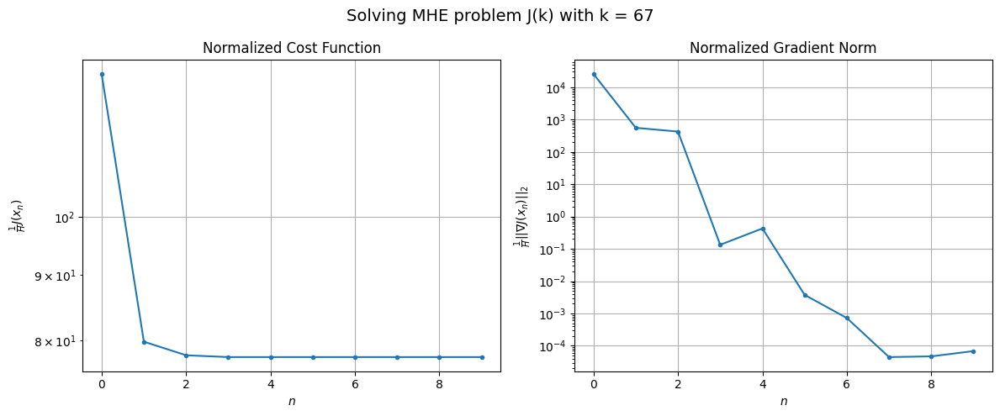

Windows:  15%|█▌        | 59/386 [03:31<17:54,  3.28s/it]

[Gauss-Newton] Before applying the algorithm
Cost function: 1816.4065354541603
Gradient norm: 293561.7079772933
Global estimation error: 4025.010584355929
Initial conditions estimation errors: 0.7890807232992779 m, 67.34137385821236 m, 1648.0411359329196 m, 3671.5295789043203 m
Position estimation errors: 4.7724251141164284 m, 342.3461634898505 m, 1419.168182883572 m, 4159.94946281084 m

[Gauss-Newton] Iteration 1
Cost function: 42123.68025985883 (2219.07%)
Gradient norm: 502231.2286330274 (71.08%)
Global estimation error: 2447.0963975829086 (-39.20%)
Initial conditions estimation errors: 2.1859322881281944 m, 47.11754914411976 m, 992.8286418346545 m, 2236.145169358757 m
Position estimation errors: 2.725030171140981 m, 219.25761433742198 m, 849.3666902701567 m, 2520.3736384011736 m

[Gauss-Newton] STOP on Iteration 2 (gradient norm stagnated)
Cost function = 30141.725555443532 (-28.44%)
Gradient norm = 432844.2316299193 (-13.82%)
Global estimation error = 1075.4260021790037 (-56.05%)
F

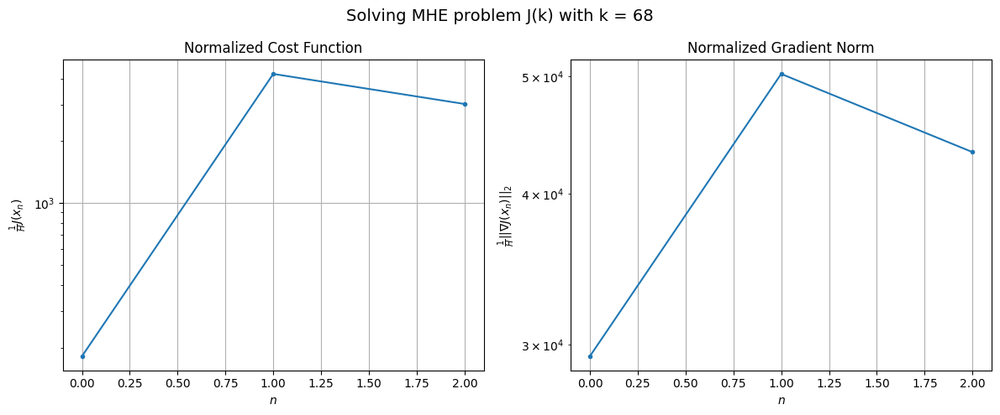

Windows:  16%|█▌        | 60/386 [03:32<14:44,  2.71s/it]

[Gauss-Newton] Before applying the algorithm
Cost function: 34897.53831312935
Gradient norm: 571712.7114791641
Global estimation error: 1085.0725899886415
Initial conditions estimation errors: 0.9478515347011043 m, 43.10339629613517 m, 409.1495434448752 m, 1004.0519481709518 m
Position estimation errors: 5.633512666928823 m, 89.15647993797255 m, 306.98274811523856 m, 921.0367196665237 m

[Gauss-Newton] Iteration 1
Cost function: 281590.0105580077 (706.91%)
Gradient norm: 1329681.47560706 (132.58%)
Global estimation error: 1390.6395117901022 (28.16%)
Initial conditions estimation errors: 2.558834346840388 m, 7.9400228591713224 m, 612.1105662936538 m, 1248.6499933033238 m
Position estimation errors: 3.241551682168746 m, 155.4471521308569 m, 588.8012548671653 m, 1790.2261011299327 m

[Gauss-Newton] Iteration 2
Cost function: 17333.5594669888 (-93.84%)
Gradient norm: 319244.58862760867 (-75.99%)
Global estimation error: 232.15295943766498 (-83.31%)
Initial conditions estimation errors: 2.5

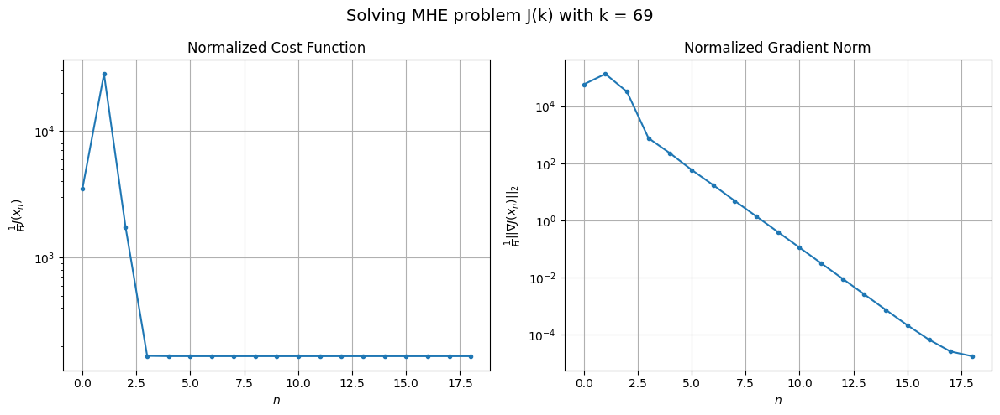

Windows:  16%|█▌        | 61/386 [03:38<20:24,  3.77s/it]

[Gauss-Newton] Before applying the algorithm
Cost function: 3459.540859124475
Gradient norm: 394594.68877577345
Global estimation error: 384.52717390595575
Initial conditions estimation errors: 1.092408202825837 m, 11.576808167279122 m, 181.27439777015107 m, 338.9176002491822 m
Position estimation errors: 6.439245575499067 m, 45.08465640484709 m, 189.14509915623975 m, 573.1837367050933 m

[Gauss-Newton] Iteration 1
Cost function: 2259.377960853057 (-34.69%)
Gradient norm: 5558.782057474518 (-98.59%)
Global estimation error: 309.6135833304054 (-19.48%)
Initial conditions estimation errors: 3.017783400053303 m, 2.6788554837991136 m, 128.359154145046 m, 281.72343716770536 m
Position estimation errors: 3.683246814976667 m, 45.58391433041953 m, 108.0233718894844 m, 388.48919327732557 m

[Gauss-Newton] Iteration 2
Cost function: 2260.062542180474 (0.03%)
Gradient norm: 5921.1900665555 (6.52%)
Global estimation error: 183.21506221380056 (-40.82%)
Initial conditions estimation errors: 3.017783

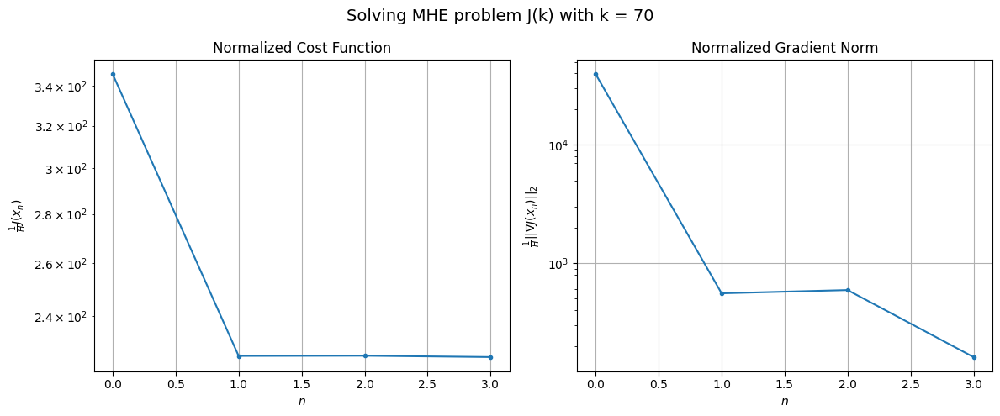

Windows:  16%|█▌        | 62/386 [03:40<17:07,  3.17s/it]

[Gauss-Newton] Before applying the algorithm
Cost function: 4412.6201890503835
Gradient norm: 440343.06887591863
Global estimation error: 121.00155552501379
Initial conditions estimation errors: 1.2493492179637844 m, 6.370462860463815 m, 38.273975207273 m, 114.60510753423686 m
Position estimation errors: 7.086591643392953 m, 18.825395331679903 m, 25.748223103408847 m, 90.13095750420591 m

[Gauss-Newton] Iteration 1
Cost function: 4621.453107093831 (4.73%)
Gradient norm: 111239.73305193258 (-74.74%)
Global estimation error: 421.4745395060317 (248.32%)
Initial conditions estimation errors: 3.4630373999225004 m, 4.986226609538864 m, 199.59481563413866 m, 371.1672041805639 m
Position estimation errors: 3.9898632741208986 m, 67.21006993968153 m, 242.26879824807057 m, 735.6795123575489 m

[Gauss-Newton] Iteration 2
Cost function: 2880.6993377655126 (-37.67%)
Gradient norm: 2988.0361430211656 (-97.31%)
Global estimation error: 530.3014570994915 (25.82%)
Initial conditions estimation errors: 3

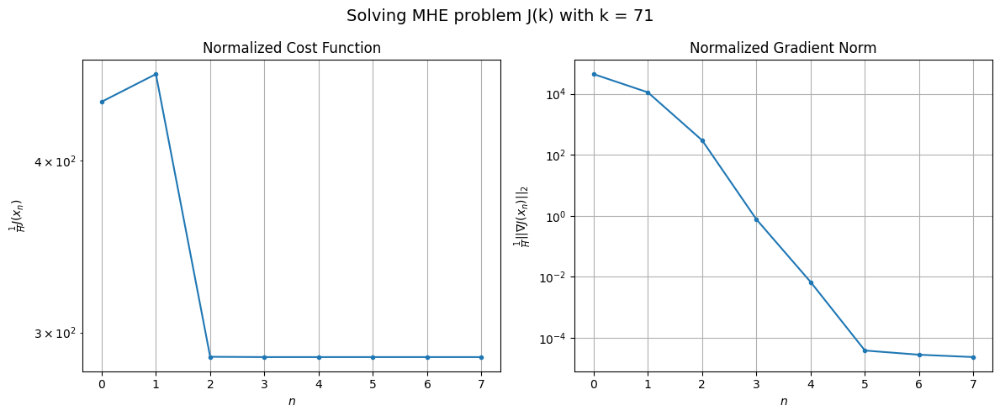

Windows:  16%|█▋        | 63/386 [03:43<16:23,  3.04s/it]

[Gauss-Newton] Before applying the algorithm
Cost function: 5008.062098425297
Gradient norm: 446391.4504263735
Global estimation error: 587.1271554397762
Initial conditions estimation errors: 1.3776652568255754 m, 10.646677319200508 m, 247.443290544594 m, 532.3288608332715 m
Position estimation errors: 7.48566825376922 m, 95.86496790710588 m, 275.6933634209438 m, 898.5151898047515 m

[Gauss-Newton] Iteration 1
Cost function: 3908.5000869989844 (-21.96%)
Gradient norm: 66623.51518862371 (-85.08%)
Global estimation error: 180.848553877099 (-69.20%)
Initial conditions estimation errors: 3.8121531202060597 m, 5.10615043726261 m, 82.8788012474712 m, 160.61327796518307 m
Position estimation errors: 4.255394244892095 m, 34.091480896423974 m, 79.57889016760305 m, 267.2072554730344 m

[Gauss-Newton] Iteration 2
Cost function: 3284.324797928017 (-15.97%)
Gradient norm: 2164.260197091165 (-96.75%)
Global estimation error: 275.48272632563715 (52.33%)
Initial conditions estimation errors: 3.8121530

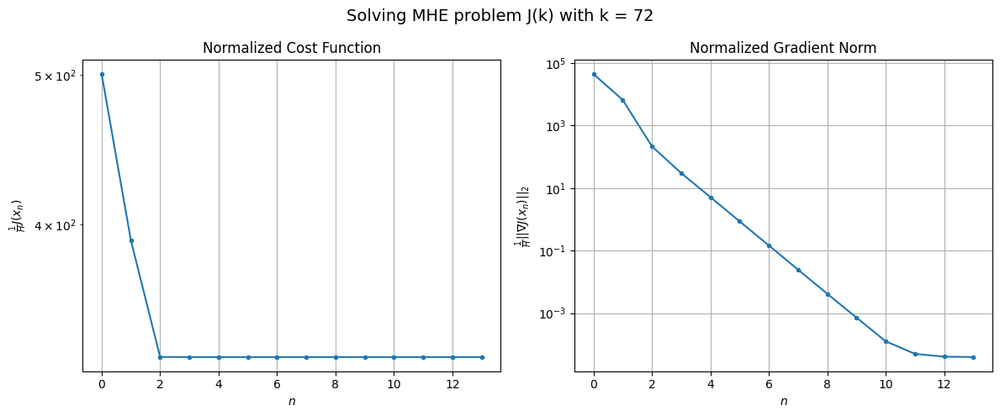

Windows:  17%|█▋        | 64/386 [03:48<19:00,  3.54s/it]

[Gauss-Newton] Before applying the algorithm
Cost function: 5513.671687813468
Gradient norm: 461612.33986897155
Global estimation error: 268.1701217434093
Initial conditions estimation errors: 1.4406663373920336 m, 10.4029131604433 m, 105.9915212782812 m, 246.11101169870523 m
Position estimation errors: 7.767832967857433 m, 51.71782453273467 m, 96.28607020734111 m, 351.04307873107683 m

[Gauss-Newton] Iteration 1
Cost function: 3575.920653718057 (-35.14%)
Gradient norm: 165.05862341673986 (-99.96%)
Global estimation error: 257.4602253778667 (-3.99%)
Initial conditions estimation errors: 4.064998165235841 m, 7.639885337999304 m, 113.29671216289917 m, 231.0293808740615 m
Position estimation errors: 4.381189378994104 m, 53.21323876017388 m, 106.28579189033523 m, 387.77719459123506 m

[Gauss-Newton] Iteration 2
Cost function: 3575.916951908518 (-0.00%)
Gradient norm: 104.02314549616497 (-36.98%)
Global estimation error: 241.78890628799263 (-6.09%)
Initial conditions estimation errors: 4.06

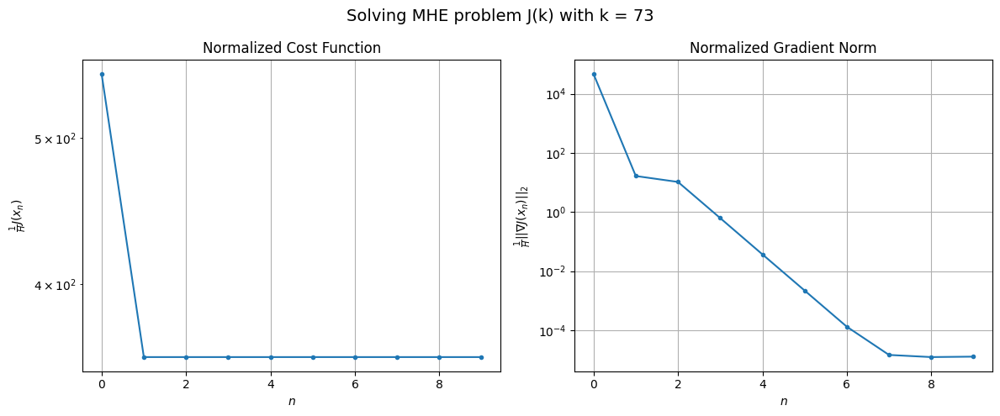

Windows:  17%|█▋        | 65/386 [03:51<18:34,  3.47s/it]

[Gauss-Newton] Before applying the algorithm
Cost function: 5709.0633342065485
Gradient norm: 459132.4360503999
Global estimation error: 262.40663005994537
Initial conditions estimation errors: 1.4463348786227848 m, 10.069421242011856 m, 106.32346048931846 m, 239.68510285208836 m
Position estimation errors: 7.811092146228036 m, 57.44678622561879 m, 102.02276047228779 m, 379.1396717956266 m

[Gauss-Newton] Iteration 1
Cost function: 3741.4611603427584 (-34.46%)
Gradient norm: 30916.896346250007 (-93.27%)
Global estimation error: 592.0052706167451 (125.61%)
Initial conditions estimation errors: 4.257907192810272 m, 25.098266858613908 m, 232.50944809961976 m, 543.8392179575143 m
Position estimation errors: 4.3302223803411195 m, 111.28051239323042 m, 200.87555523771738 m, 777.2129096572448 m

[Gauss-Newton] Iteration 2
Cost function: 3597.1468393996843 (-3.86%)
Gradient norm: 7.171721957964107 (-99.98%)
Global estimation error: 602.7811841803493 (1.82%)
Initial conditions estimation errors

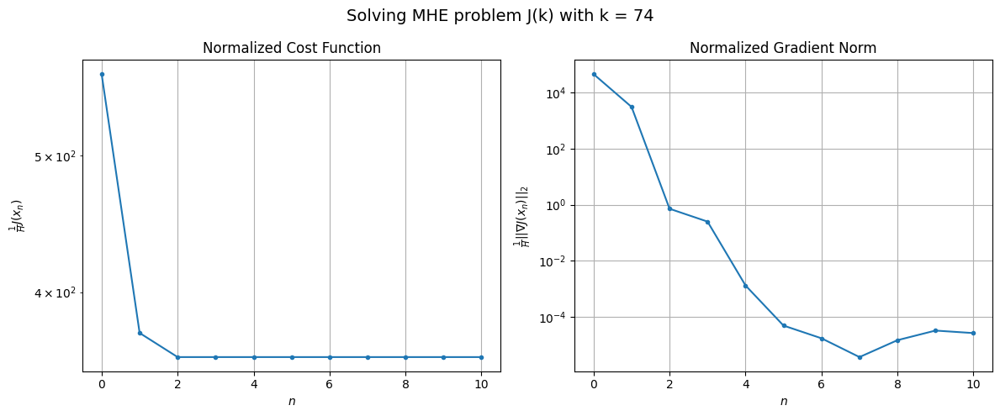

Windows:  17%|█▋        | 66/386 [03:55<18:57,  3.56s/it]

[Gauss-Newton] Before applying the algorithm
Cost function: 5582.221454325743
Gradient norm: 429975.4847954139
Global estimation error: 636.0733914156955
Initial conditions estimation errors: 1.4731507054785382 m, 36.136640646321005 m, 230.91158813048207 m, 591.5748360915602 m
Position estimation errors: 7.5640013685135195 m, 122.96376759748144 m, 196.84417955862952 m, 791.6684314493474 m

[Gauss-Newton] Iteration 1
Cost function: 85974.06804298799 (1440.14%)
Gradient norm: 725422.3700611462 (68.71%)
Global estimation error: 1017.7914093762281 (60.01%)
Initial conditions estimation errors: 4.18872911115484 m, 87.62073247754002 m, 301.6235364977911 m, 968.1049467198927 m
Position estimation errors: 4.221868320337228 m, 194.45139400181122 m, 206.587678712026 m, 1081.2370626137654 m

[Gauss-Newton] Iteration 2
Cost function: 3604.7674881436815 (-95.81%)
Gradient norm: 2743.827436498406 (-99.62%)
Global estimation error: 906.9779450400296 (-10.89%)
Initial conditions estimation errors: 4.1

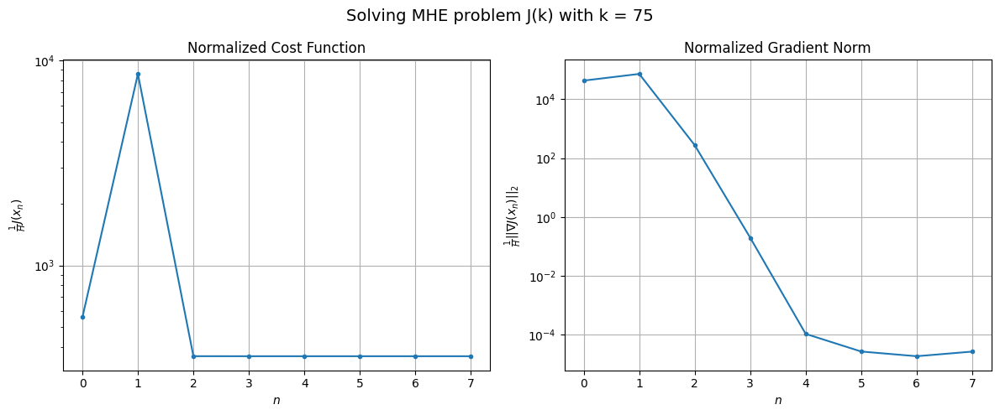

Windows:  17%|█▋        | 67/386 [03:57<17:35,  3.31s/it]

[Gauss-Newton] Before applying the algorithm
Cost function: 5235.966205547639
Gradient norm: 402521.74947193125
Global estimation error: 937.4295693664925
Initial conditions estimation errors: 1.396122473911294 m, 87.33908487854268 m, 273.90523830722725 m, 892.2554226466663 m
Position estimation errors: 7.238392670662856 m, 173.24736576771576 m, 186.6977192444525 m, 959.120414380396 m

[Gauss-Newton] Iteration 1
Cost function: 6378.123772699302 (21.81%)
Gradient norm: 138893.46968165244 (-65.49%)
Global estimation error: 223.77536694131865 (-76.13%)
Initial conditions estimation errors: 4.099276996419071 m, 22.35406154707332 m, 59.57221946851537 m, 214.49951578225452 m
Position estimation errors: 4.032483240706754 m, 37.37981749251268 m, 28.44467200185024 m, 159.80319567792202 m

[Gauss-Newton] Iteration 2
Cost function: 3348.2195810149883 (-47.50%)
Gradient norm: 95.26265058047089 (-99.93%)
Global estimation error: 217.43031103252795 (-2.84%)
Initial conditions estimation errors: 4.09

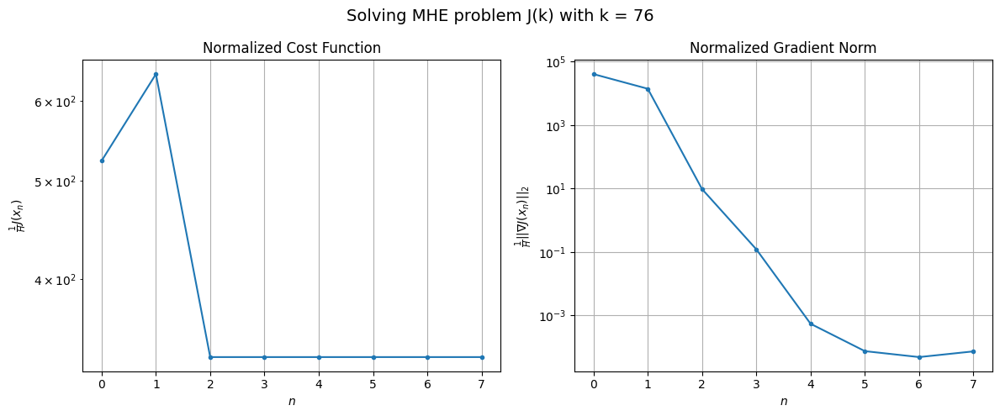

Windows:  18%|█▊        | 68/386 [04:00<16:32,  3.12s/it]

[Gauss-Newton] Before applying the algorithm
Cost function: 4845.408617255294
Gradient norm: 378291.7507022495
Global estimation error: 212.1494689750462
Initial conditions estimation errors: 1.3993156592070626 m, 25.74115800326946 m, 53.321198095519684 m, 203.71466467739373 m
Position estimation errors: 6.888273345367215 m, 30.97334687292212 m, 33.49680564118111 m, 117.03637742005635 m

[Gauss-Newton] Iteration 1
Cost function: 3114.6000107743243 (-35.72%)
Gradient norm: 7164.67862906088 (-98.11%)
Global estimation error: 87.93259656343102 (-58.55%)
Initial conditions estimation errors: 3.983405198325282 m, 19.155615349647963 m, 17.07720706208768 m, 84.0098000673148 m
Position estimation errors: 3.830439747794944 m, 10.581991018069498 m, 19.16063665502225 m, 19.99922820278571 m

[Gauss-Newton] Iteration 2
Cost function: 3094.192555006013 (-0.66%)
Gradient norm: 194.1574422154051 (-97.29%)
Global estimation error: 82.28257116762161 (-6.43%)
Initial conditions estimation errors: 3.98340

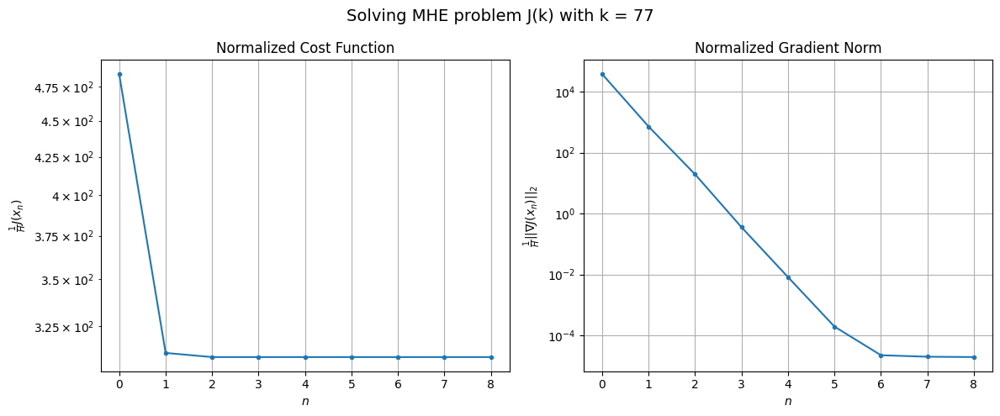

Windows:  18%|█▊        | 69/386 [04:03<16:17,  3.08s/it]

[Gauss-Newton] Before applying the algorithm
Cost function: 4557.091302589668
Gradient norm: 366468.2235616081
Global estimation error: 65.39867915499387
Initial conditions estimation errors: 1.405216160730877 m, 17.841785276128697 m, 9.200290059020839 m, 62.225011306475764 m
Position estimation errors: 6.606503085004422 m, 6.779719117223902 m, 32.92156776157738 m, 69.27223094188136 m

[Gauss-Newton] Iteration 1
Cost function: 3076.5010944022524 (-32.49%)
Gradient norm: 29843.960921784696 (-91.86%)
Global estimation error: 415.7192266306633 (535.67%)
Initial conditions estimation errors: 3.8798844106371404 m, 67.37220538512705 m, 87.11346564035911 m, 400.848585155393 m
Position estimation errors: 3.6337566224641535 m, 82.60407641212842 m, 50.202131412867665 m, 272.96659693840365 m

[Gauss-Newton] Iteration 2
Cost function: 2924.337824708081 (-4.95%)
Gradient norm: 73.69255087349622 (-99.75%)
Global estimation error: 434.2547616963006 (4.46%)
Initial conditions estimation errors: 3.8798

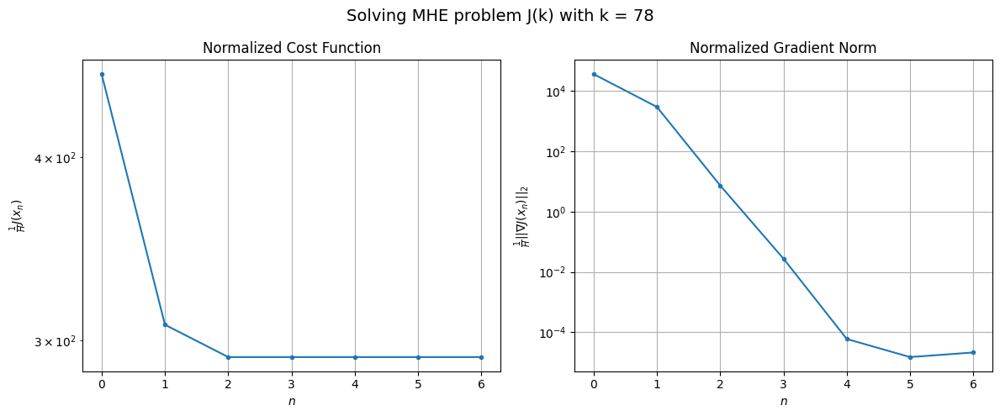

Windows:  18%|█▊        | 70/386 [04:06<15:14,  2.89s/it]

[Gauss-Newton] Before applying the algorithm
Cost function: 4148.574382747732
Gradient norm: 347245.3578800564
Global estimation error: 424.6339888721978
Initial conditions estimation errors: 1.4360609808944365 m, 71.43857014099196 m, 82.04465947871556 m, 410.4596200452331 m
Position estimation errors: 6.365207778242163 m, 89.19294163784477 m, 54.564508670581624 m, 270.7216653154186 m

[Gauss-Newton] Iteration 1
Cost function: 2786.8484921965464 (-32.82%)
Gradient norm: 14290.422079060729 (-95.88%)
Global estimation error: 93.83705985812159 (-77.90%)
Initial conditions estimation errors: 3.80199113268908 m, 31.15618541511499 m, 69.02659682154278 m, 55.27507982788314 m
Position estimation errors: 3.550483545861262 m, 27.1985651884026 m, 82.88250692395192 m, 242.37577715830727 m

[Gauss-Newton] Iteration 2
Cost function: 2667.203369878223 (-4.29%)
Gradient norm: 1193.7971027285325 (-91.65%)
Global estimation error: 111.1232845881913 (18.42%)
Initial conditions estimation errors: 3.801991

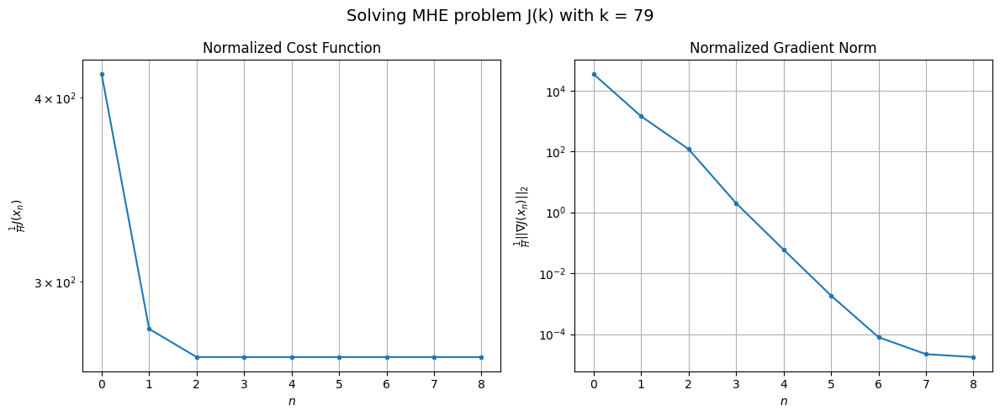

Windows:  18%|█▊        | 71/386 [04:08<15:11,  2.90s/it]

[Gauss-Newton] Before applying the algorithm
Cost function: 3951.0775507162043
Gradient norm: 355351.69617717835
Global estimation error: 126.25877833887988
Initial conditions estimation errors: 1.4258597737505103 m, 19.002072095511437 m, 79.8838953117159 m, 95.89789504264289 m
Position estimation errors: 6.295102229506736 m, 58.01237691043015 m, 96.36294129423183 m, 357.48845984311464 m

[Gauss-Newton] Iteration 1
Cost function: 4311.1546591604065 (9.11%)
Gradient norm: 111212.4302532741 (-68.70%)
Global estimation error: 428.23365321248747 (239.17%)
Initial conditions estimation errors: 3.7399324207242985 m, 75.73583513557601 m, 67.13834162327343 m, 416.0848192870498 m
Position estimation errors: 3.488653836822247 m, 102.16379869210512 m, 46.69596344909739 m, 353.10830121913955 m

[Gauss-Newton] Iteration 2
Cost function: 2506.379475467731 (-41.86%)
Gradient norm: 564.7768741007301 (-99.49%)
Global estimation error: 385.5435369309737 (-9.97%)
Initial conditions estimation errors: 3.7

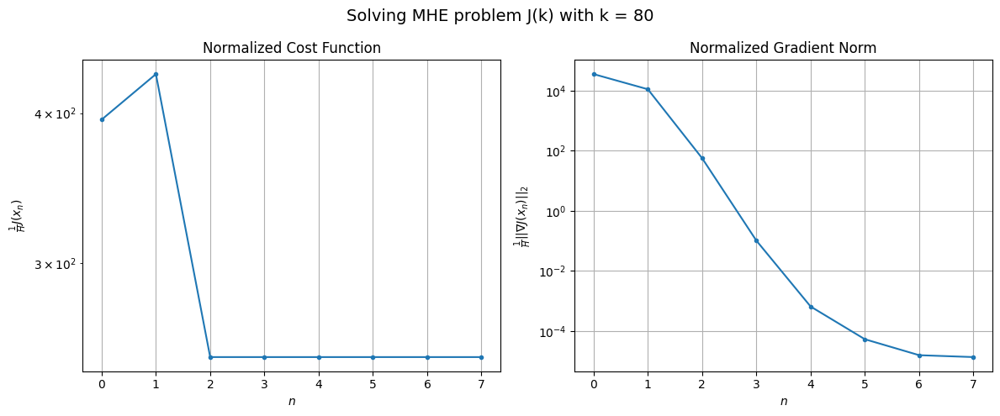

Windows:  19%|█▊        | 72/386 [04:11<14:46,  2.82s/it]

[Gauss-Newton] Before applying the algorithm
Cost function: 3851.212896911497
Gradient norm: 364088.86297386594
Global estimation error: 387.01021154898393
Initial conditions estimation errors: 1.3924979797189567 m, 72.6911427151648 m, 59.56406921979425 m, 375.4238502466465 m
Position estimation errors: 6.274662067136925 m, 86.83695327496875 m, 44.715403016269285 m, 293.091768874881 m

[Gauss-Newton] Iteration 1
Cost function: 2509.161278782591 (-34.85%)
Gradient norm: 19361.67235427282 (-94.68%)
Global estimation error: 184.66668734916598 (-52.28%)
Initial conditions estimation errors: 3.6360307650309776 m, 46.39706129507661 m, 44.60867302885317 m, 173.0487817100092 m
Position estimation errors: 3.4817696082884355 m, 28.79380708100351 m, 37.13757436272728 m, 35.04306133284913 m

[Gauss-Newton] Iteration 2
Cost function: 2454.42994347469 (-2.18%)
Gradient norm: 0.2514675430883301 (-100.00%)
Global estimation error: 186.65194751838442 (1.08%)
Initial conditions estimation errors: 3.6360

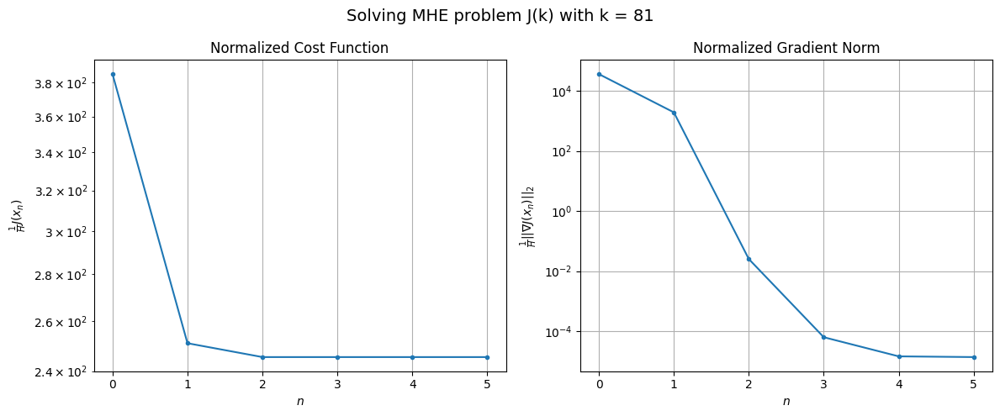

Windows:  19%|█▉        | 73/386 [04:13<13:51,  2.66s/it]

[Gauss-Newton] Before applying the algorithm
Cost function: 3774.7796790394827
Gradient norm: 374923.11004197993
Global estimation error: 172.30230350975657
Initial conditions estimation errors: 1.2624261367013452 m, 47.345385361028185 m, 43.485356782633296 m, 159.85573262300977 m
Position estimation errors: 6.343171901775736 m, 25.049263992263455 m, 38.963848512706846 m, 41.5612717017747 m

[Gauss-Newton] Iteration 1
Cost function: 2388.560538343119 (-36.72%)
Gradient norm: 1889.7686988399287 (-99.50%)
Global estimation error: 18.59064494633368 (-89.21%)
Initial conditions estimation errors: 3.5262237736354844 m, 1.2795710157344302 m, 7.228691393985426 m, 16.71140455520558 m
Position estimation errors: 3.520905304259257 m, 15.66231508324063 m, 8.953864249184234 m, 38.16420656235247 m

[Gauss-Newton] Iteration 2
Cost function: 2386.4328661963295 (-0.09%)
Gradient norm: 357.91382109451024 (-81.06%)
Global estimation error: 45.79967691289275 (146.36%)
Initial conditions estimation errors

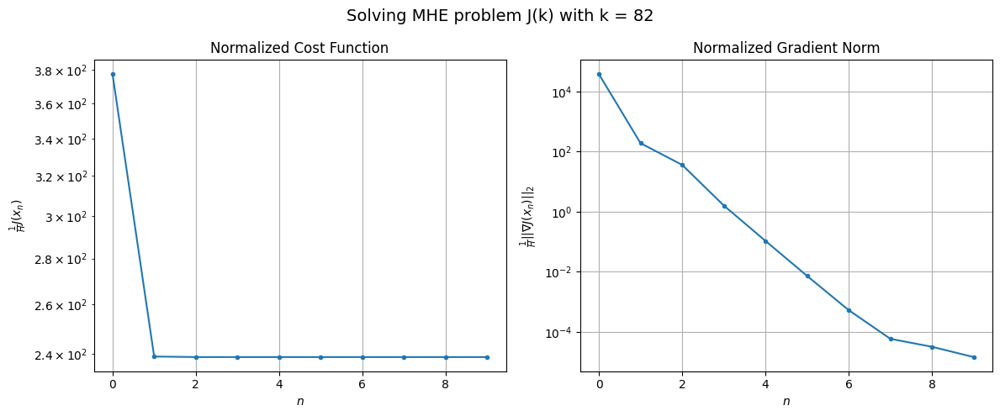

Windows:  19%|█▉        | 74/386 [04:17<14:59,  2.88s/it]

[Gauss-Newton] Before applying the algorithm
Cost function: 3882.8609801945827
Gradient norm: 388229.8698627174
Global estimation error: 51.55186498383964
Initial conditions estimation errors: 1.1523281665168432 m, 19.266826023304205 m, 13.316701675181744 m, 45.909389234369904 m
Position estimation errors: 6.415137911992076 m, 13.15564867746598 m, 34.61024620693703 m, 48.9511051572981 m

[Gauss-Newton] Iteration 1
Cost function: 2453.355450210077 (-36.82%)
Gradient norm: 6356.170701757877 (-98.36%)
Global estimation error: 313.48879969923667 (508.10%)
Initial conditions estimation errors: 3.445402571093323 m, 94.26371228249096 m, 60.3081169806817 m, 292.8145340147865 m
Position estimation errors: 3.5050785649747347 m, 34.15884641146856 m, 81.0684311219543 m, 47.517677304048114 m

[Gauss-Newton] Iteration 2
Cost function: 2433.423801924673 (-0.81%)
Gradient norm: 96.63725064303715 (-98.48%)
Global estimation error: 337.26373663758534 (7.58%)
Initial conditions estimation errors: 3.44540

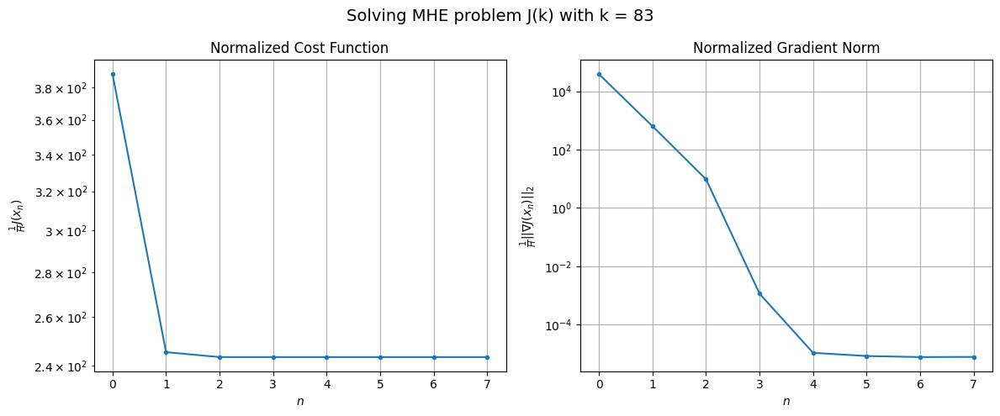

Windows:  19%|█▉        | 75/386 [04:20<14:55,  2.88s/it]

[Gauss-Newton] Before applying the algorithm
Cost function: 3780.7874374391176
Gradient norm: 385304.2975326436
Global estimation error: 306.7809799583714
Initial conditions estimation errors: 1.087104333903932 m, 94.16308044783372 m, 64.40015963988829 m, 284.7788651934841 m
Position estimation errors: 6.371749217862041 m, 34.089358590875364 m, 92.67777315813527 m, 55.74813336488095 m

[Gauss-Newton] Iteration 1
Cost function: 3273.590172335788 (-13.42%)
Gradient norm: 81095.48107194099 (-78.95%)
Global estimation error: 669.7236207579076 (118.31%)
Initial conditions estimation errors: 3.4124629918088485 m, 165.55133849122794 m, 84.15679101846692 m, 643.4503932318884 m
Position estimation errors: 3.488182625226827 m, 186.90261421420084 m, 124.05118416644875 m, 539.4763321383065 m

[Gauss-Newton] Iteration 2
Cost function: 2340.2229955686826 (-28.51%)
Gradient norm: 985.7684221929371 (-98.78%)
Global estimation error: 725.6547148973838 (8.35%)
Initial conditions estimation errors: 3.412

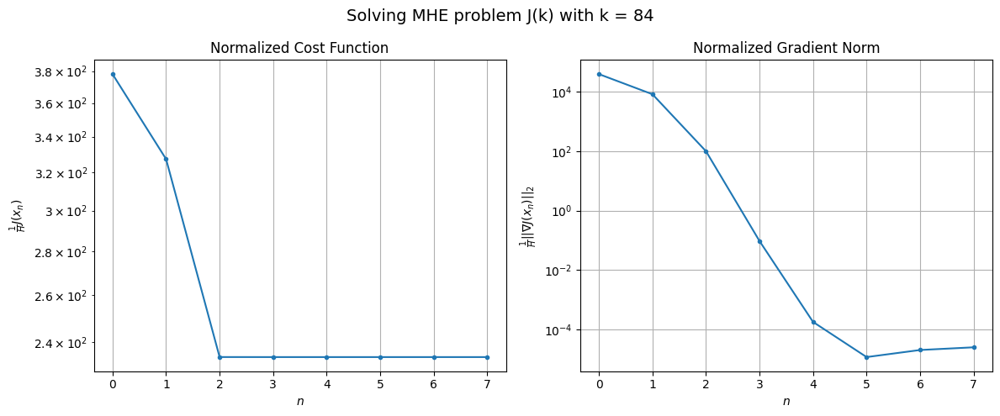

Windows:  20%|█▉        | 76/386 [04:23<15:01,  2.91s/it]

[Gauss-Newton] Before applying the algorithm
Cost function: 3668.7682670069485
Gradient norm: 386225.1638707591
Global estimation error: 723.5078422076579
Initial conditions estimation errors: 1.083625584961516 m, 184.4902986220257 m, 93.65866204650563 m, 693.2919568964116 m
Position estimation errors: 6.295340385267008 m, 207.62309673168443 m, 143.31487700372432 m, 565.4990771631545 m

[Gauss-Newton] Iteration 1
Cost function: 2250.4323479076434 (-38.66%)
Gradient norm: 7802.953973113261 (-97.98%)
Global estimation error: 920.5562862142442 (27.24%)
Initial conditions estimation errors: 3.4215578465538115 m, 270.6385518922296 m, 166.05042320535895 m, 864.0565558607693 m
Position estimation errors: 3.420379350063268 m, 210.22343034925362 m, 208.93674756897525 m, 427.03804790483576 m

[Gauss-Newton] Iteration 2
Cost function: 2230.1041948087513 (-0.90%)
Gradient norm: 1204.1373863069412 (-84.57%)
Global estimation error: 817.9038358406442 (-11.15%)
Initial conditions estimation errors: 3

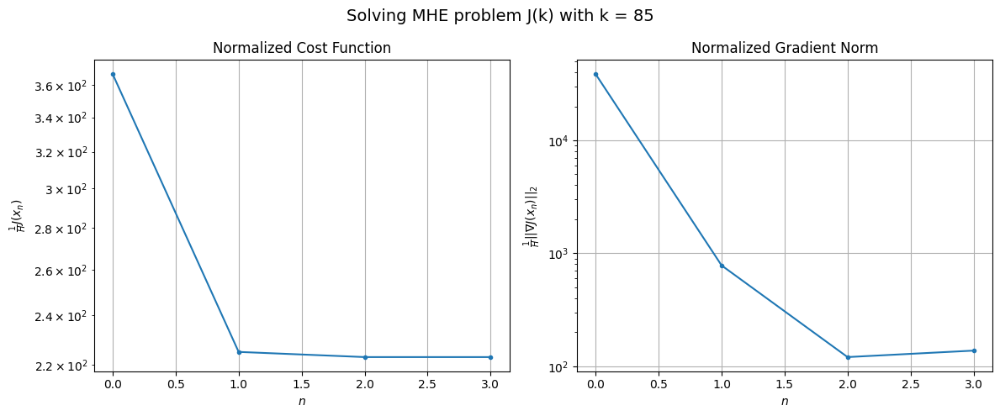

Windows:  20%|█▉        | 77/386 [04:25<13:26,  2.61s/it]

[Gauss-Newton] Before applying the algorithm
Cost function: 3603.165600953337
Gradient norm: 380732.81630241295
Global estimation error: 892.1558465317568
Initial conditions estimation errors: 1.1230467841656016 m, 264.7577998056829 m, 162.2034193399962 m, 836.3813453994604 m
Position estimation errors: 6.161152792170833 m, 215.80533844783042 m, 211.43485764962662 m, 430.69282852343804 m

[Gauss-Newton] Iteration 1
Cost function: 8945.294043123175 (148.26%)
Gradient norm: 147602.55131718 (-61.23%)
Global estimation error: 114.31865765915568 (-87.19%)
Initial conditions estimation errors: 3.3606804859982886 m, 47.81350127486426 m, 45.36847305982588 m, 93.3432565790818 m
Position estimation errors: 3.3518537097576746 m, 12.282672651309635 m, 55.775418165033145 m, 66.76044957254194 m

[Gauss-Newton] Iteration 2
Cost function: 2267.3784063686862 (-74.65%)
Gradient norm: 7843.210104326095 (-94.69%)
Global estimation error: 121.7244922898173 (6.48%)
Initial conditions estimation errors: 3.36

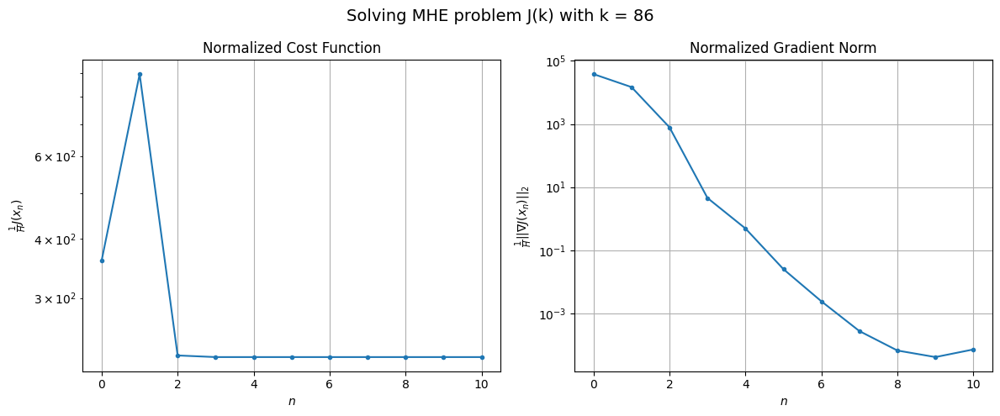

Windows:  20%|██        | 78/386 [04:28<14:40,  2.86s/it]

[Gauss-Newton] Before applying the algorithm
Cost function: 3453.6669760140544
Gradient norm: 357450.47323731944
Global estimation error: 128.01218479325513
Initial conditions estimation errors: 1.1123394853295792 m, 25.769690501501163 m, 15.459194331748142 m, 124.42991735130134 m
Position estimation errors: 6.02927246724759 m, 50.483341210913345 m, 23.46089351483474 m, 151.70376175529717 m

[Gauss-Newton] Iteration 1
Cost function: 2251.3312742865983 (-34.81%)
Gradient norm: 15803.514315334169 (-95.58%)
Global estimation error: 26.219915323509426 (-79.52%)
Initial conditions estimation errors: 3.2689549258902884 m, 13.96867226682229 m, 4.659959564307479 m, 21.44581974572625 m
Position estimation errors: 3.34971034362256 m, 22.972866344029704 m, 12.618102651727549 m, 84.60778935583733 m

[Gauss-Newton] Iteration 2
Cost function: 2216.1640428770634 (-1.56%)
Gradient norm: 109.64181240288721 (-99.31%)
Global estimation error: 51.553671480656604 (96.62%)
Initial conditions estimation erro

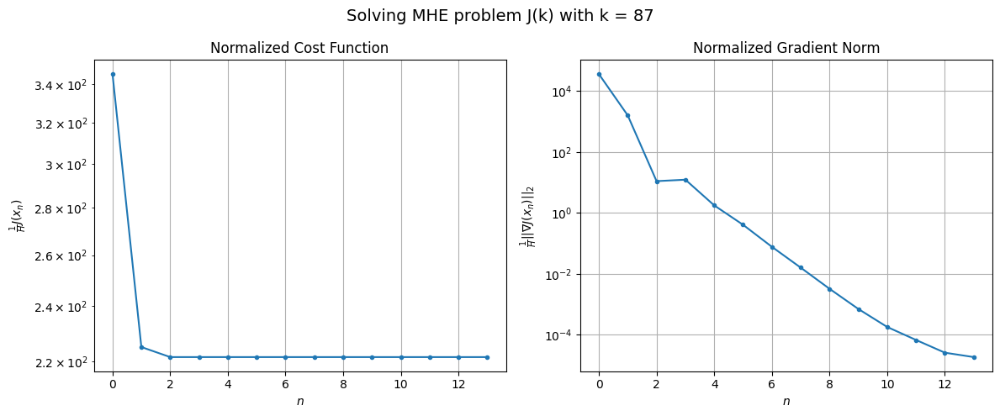

Windows:  20%|██        | 79/386 [04:32<16:51,  3.30s/it]

[Gauss-Newton] Before applying the algorithm
Cost function: 3313.80878621989
Gradient norm: 346037.3306940628
Global estimation error: 35.19197126001202
Initial conditions estimation errors: 1.0683343222842738 m, 17.76172023529032 m, 8.616890939892958 m, 29.113335506847896 m
Position estimation errors: 5.958955676281666 m, 19.30864140901689 m, 14.774595719954295 m, 65.93757724210842 m

[Gauss-Newton] Iteration 1
Cost function: 7552.229818056123 (127.90%)
Gradient norm: 164422.39854051132 (-52.48%)
Global estimation error: 828.8637244019812 (2255.26%)
Initial conditions estimation errors: 3.2353006483500337 m, 288.22336623121157 m, 209.27769762506736 m, 748.421431755202 m
Position estimation errors: 3.322839601168006 m, 283.839056058752 m, 278.3999142309552 m, 586.5840852280029 m

[Gauss-Newton] Iteration 2
Cost function: 2089.7773060478125 (-72.33%)
Gradient norm: 4085.6237754046583 (-97.52%)
Global estimation error: 953.779618572792 (15.07%)
Initial conditions estimation errors: 3.235

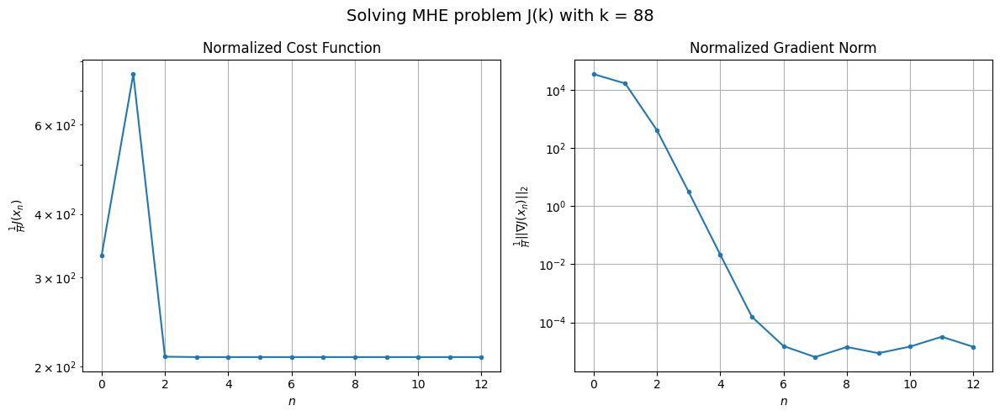

Windows:  21%|██        | 80/386 [04:36<18:01,  3.54s/it]

[Gauss-Newton] Before applying the algorithm
Cost function: 3310.714240085539
Gradient norm: 352135.8891411168
Global estimation error: 964.8143726799435
Initial conditions estimation errors: 1.0529232204336347 m, 341.61601673250556 m, 255.12876407172277 m, 865.4902308488678 m
Position estimation errors: 5.845961389500488 m, 320.90219787196816 m, 329.54382014107364 m, 635.3418726656962 m

[Gauss-Newton] Iteration 1
Cost function: 2071.4524739251037 (-37.43%)
Gradient norm: 14147.931826001544 (-95.98%)
Global estimation error: 784.3863046138952 (-18.70%)
Initial conditions estimation errors: 3.2397741734748955 m, 270.28789220970316 m, 187.22821884440398 m, 712.1385644930842 m
Position estimation errors: 3.1443176066175837 m, 237.3144957205532 m, 229.38178302087144 m, 490.98142241319874 m

[Gauss-Newton] Iteration 2
Cost function: 2038.5634161910966 (-1.59%)
Gradient norm: 65.78056780584649 (-99.54%)
Global estimation error: 769.5883477373792 (-1.89%)
Initial conditions estimation errors

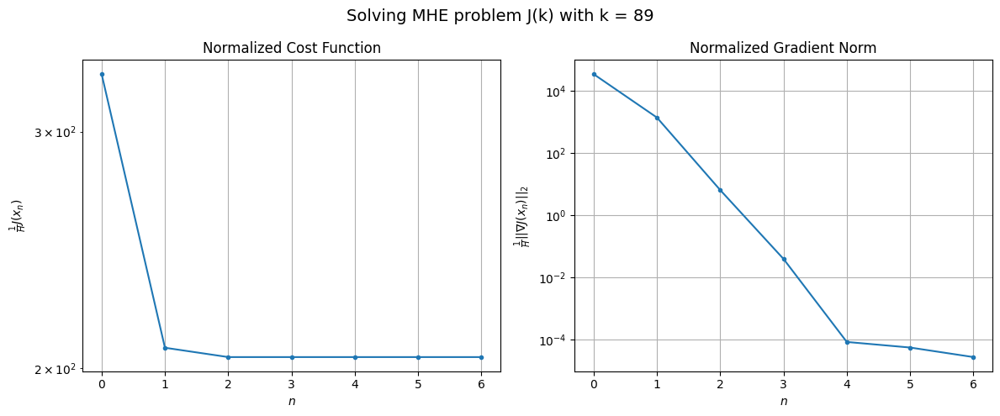

Windows:  21%|██        | 81/386 [04:39<16:26,  3.24s/it]

[Gauss-Newton] Before applying the algorithm
Cost function: 3014.226664339698
Gradient norm: 321834.3678740364
Global estimation error: 758.8953311341959
Initial conditions estimation errors: 1.0878155438695563 m, 266.3128969211433 m, 187.46885553162775 m, 685.4587539493317 m
Position estimation errors: 5.550292477785716 m, 221.5251333778739 m, 226.85765585316864 m, 442.3212906634869 m

[Gauss-Newton] Iteration 1
Cost function: 1858.1344047969892 (-38.35%)
Gradient norm: 2737.9089071836893 (-99.15%)
Global estimation error: 822.3927680089749 (8.37%)
Initial conditions estimation errors: 3.208230121363128 m, 288.5847514330755 m, 207.08973319374851 m, 741.7224252069407 m
Position estimation errors: 2.9996816173704413 m, 261.2191015289594 m, 262.2715419005229 m, 520.1479200369012 m

[Gauss-Newton] Iteration 2
Cost function: 1857.0610964649138 (-0.06%)
Gradient norm: 70.85356577305731 (-97.41%)
Global estimation error: 806.1590586339457 (-1.97%)
Initial conditions estimation errors: 3.2082

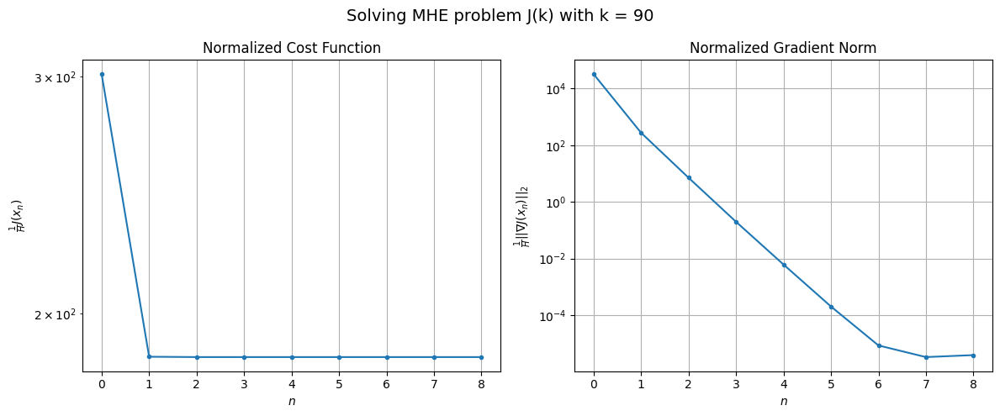

Windows:  21%|██        | 82/386 [04:42<16:23,  3.24s/it]

[Gauss-Newton] Before applying the algorithm
Cost function: 2821.293203742639
Gradient norm: 307114.83697095595
Global estimation error: 800.8154371915598
Initial conditions estimation errors: 1.1180385600692364 m, 286.3440163534672 m, 209.56249507417672 m, 717.9099306735592 m
Position estimation errors: 5.318868158036387 m, 246.3953968967861 m, 261.0346972382902 m, 473.7276280248442 m

[Gauss-Newton] Iteration 1
Cost function: 29321.068165618253 (939.28%)
Gradient norm: 379146.94827250147 (23.45%)
Global estimation error: 321.68126967891305 (-59.83%)
Initial conditions estimation errors: 3.129572370892672 m, 126.94605425245734 m, 120.71668223129525 m, 269.7798494470139 m
Position estimation errors: 2.8723717003847433 m, 165.80537334758645 m, 151.63344823452704 m, 313.1127571336309 m

[Gauss-Newton] Iteration 2
Cost function: 1830.751613908538 (-93.76%)
Gradient norm: 20194.84391873478 (-94.67%)
Global estimation error: 74.29504982898048 (-76.90%)
Initial conditions estimation errors: 

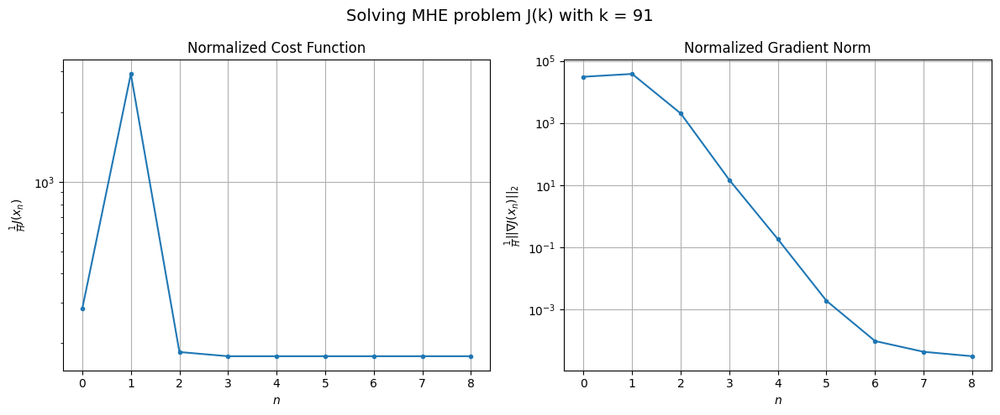

Windows:  22%|██▏       | 83/386 [04:45<16:11,  3.21s/it]

[Gauss-Newton] Before applying the algorithm
Cost function: 2617.8054817642105
Gradient norm: 286522.56249901303
Global estimation error: 102.7192508809726
Initial conditions estimation errors: 1.1066478303950507 m, 42.862616221611624 m, 44.82952987425271 m, 81.87244018439468 m
Position estimation errors: 5.164987391019115 m, 78.1121514872074 m, 56.66739986237139 m, 154.47037348319998 m

[Gauss-Newton] Iteration 1
Cost function: 67552.8064749722 (2480.51%)
Gradient norm: 593945.7935545003 (107.29%)
Global estimation error: 1231.8760363793572 (1099.27%)
Initial conditions estimation errors: 3.0319634760664544 m, 473.35107344740334 m, 425.64349910351535 m, 1054.644730870093 m
Position estimation errors: 2.8548314545052387 m, 465.87947015302785 m, 512.8819593960329 m, 786.0102385160311 m

[Gauss-Newton] Iteration 2
Cost function: 1644.5098025511993 (-97.57%)
Gradient norm: 777.9303392652505 (-99.87%)
Global estimation error: 1167.2461665497385 (-5.25%)
Initial conditions estimation errors

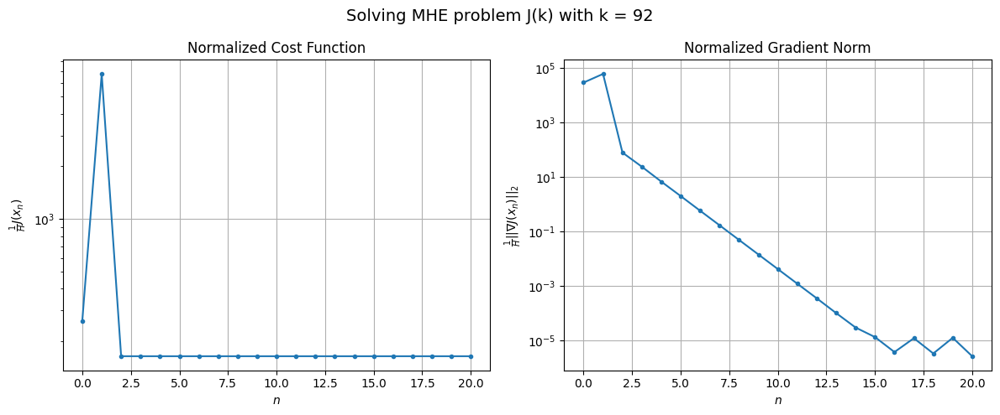

Windows:  22%|██▏       | 84/386 [04:52<20:55,  4.16s/it]

[Gauss-Newton] Before applying the algorithm
Cost function: 2438.460116559794
Gradient norm: 272115.2273459889
Global estimation error: 1185.1064413845772
Initial conditions estimation errors: 1.0796863392644607 m, 465.009190305921 m, 426.2707328299738 m, 1003.2624778517812 m
Position estimation errors: 5.201146353327898 m, 443.00397912825457 m, 501.5291029961402 m, 723.8804529984563 m

[Gauss-Newton] Iteration 1
Cost function: 1722.9877532059013 (-29.34%)
Gradient norm: 33657.08939513083 (-87.63%)
Global estimation error: 1457.170102049146 (22.96%)
Initial conditions estimation errors: 2.947880266649835 m, 583.5367708359571 m, 553.773995437526 m, 1214.9711390900297 m
Position estimation errors: 2.986918070758362 m, 572.9810811289447 m, 660.0117904941256 m, 935.8815315705388 m

[Gauss-Newton] Iteration 2
Cost function: 1609.2316886646822 (-6.60%)
Gradient norm: 20373.760652534354 (-39.47%)
Global estimation error: 1700.3728792867757 (16.69%)
Initial conditions estimation errors: 2.9478

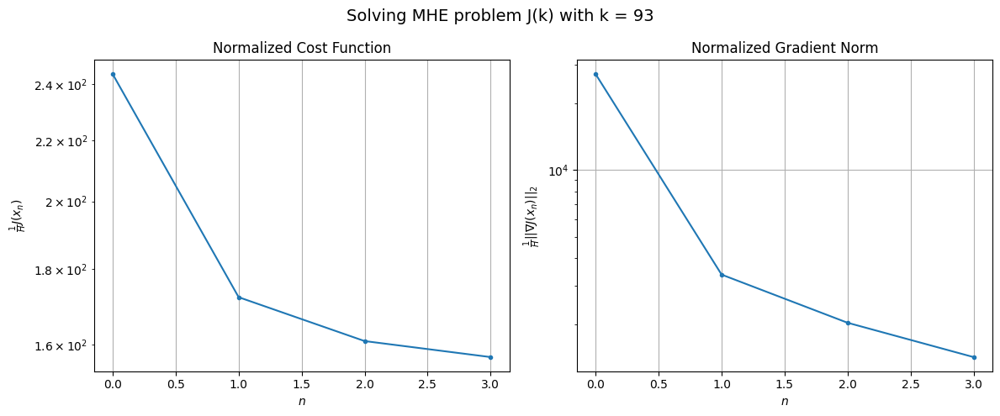

Windows:  22%|██▏       | 85/386 [04:53<17:08,  3.42s/it]

[Gauss-Newton] Before applying the algorithm
Cost function: 2648.2550713114033
Gradient norm: 293976.0247027236
Global estimation error: 1910.2921426249736
Initial conditions estimation errors: 1.0562447609247694 m, 778.5741769722625 m, 752.2646633560231 m, 1573.8915203534941 m
Position estimation errors: 5.451431807680426 m, 738.0206163835546 m, 858.9670625936767 m, 1176.9164405838392 m

[Gauss-Newton] Iteration 1
Cost function: 2638.808650194919 (-0.36%)
Gradient norm: 62261.87002467949 (-78.82%)
Global estimation error: 1383.2172445337453 (-27.59%)
Initial conditions estimation errors: 2.9164815149871037 m, 561.4657991690873 m, 557.0524944368614 m, 1134.7818129217605 m
Position estimation errors: 3.1215341223425654 m, 585.9107813693629 m, 640.7212423293553 m, 979.7086758352041 m

[Gauss-Newton] Iteration 2
Cost function: 1902.9819242472483 (-27.88%)
Gradient norm: 33824.36602152457 (-45.67%)
Global estimation error: 1026.893334426104 (-25.76%)
Initial conditions estimation errors: 2

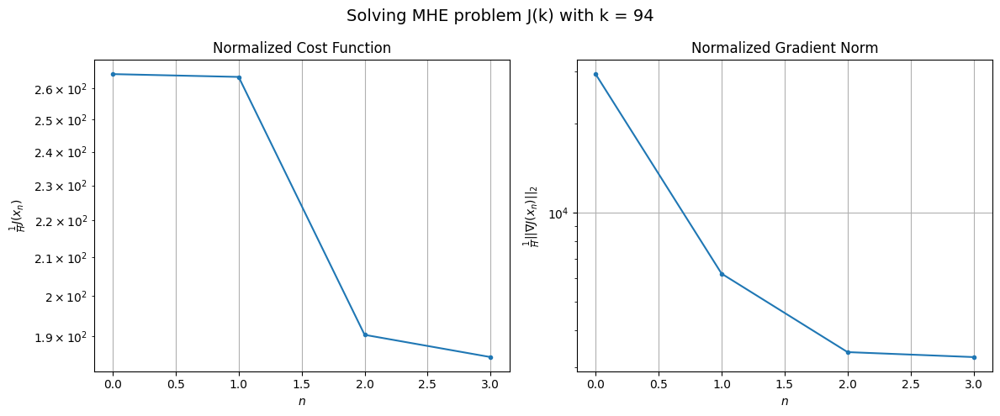

Windows:  22%|██▏       | 86/386 [04:55<14:25,  2.88s/it]

[Gauss-Newton] Before applying the algorithm
Cost function: 3073.6497335970694
Gradient norm: 317009.1307694071
Global estimation error: 732.7332583938158
Initial conditions estimation errors: 1.067837247283476 m, 295.45299160915926 m, 290.44511946694865 m, 604.3557620683368 m
Position estimation errors: 5.7235069453384195 m, 335.265579124726 m, 349.8735678696207 m, 598.2420523732362 m

[Gauss-Newton] Iteration 1
Cost function: 923827.1215051666 (29956.36%)
Gradient norm: 2257196.017704899 (612.03%)
Global estimation error: 1690.0845108069545 (130.65%)
Initial conditions estimation errors: 2.9222538778612357 m, 732.7218264122777 m, 775.0038571322265 m, 1311.0546221434533 m
Position estimation errors: 3.3004434013963415 m, 750.7686462554312 m, 835.092175842937 m, 1188.5557974261155 m

[Gauss-Newton] Iteration 2
Cost function: 12230.84857720156 (-98.68%)
Gradient norm: 215911.8681667896 (-90.43%)
Global estimation error: 2541.176335208304 (50.36%)
Initial conditions estimation errors: 2.

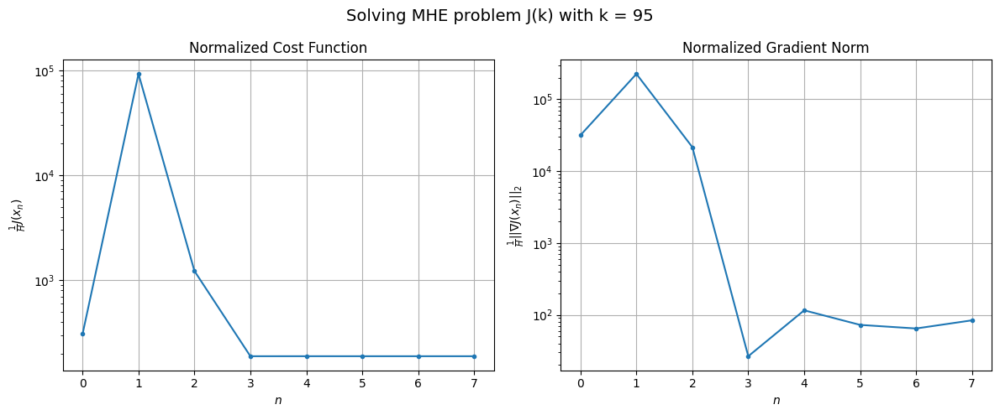

Windows:  23%|██▎       | 87/386 [04:58<14:36,  2.93s/it]

[Gauss-Newton] Before applying the algorithm
Cost function: 3292.6778680274074
Gradient norm: 337254.38989133714
Global estimation error: 2814.07988839571
Initial conditions estimation errors: 1.095741924477056 m, 1214.0443928064435 m, 1261.916489977664 m, 2202.8858490505204 m
Position estimation errors: 6.029975724905296 m, 1096.7454891078876 m, 1280.7678814027852 m, 1636.1112092085953 m

[Gauss-Newton] Iteration 1
Cost function: 33693.02869331911 (923.27%)
Gradient norm: 386745.49793472193 (14.67%)
Global estimation error: 3943.0193910124913 (40.12%)
Initial conditions estimation errors: 3.0367113796089775 m, 1688.9382978956603 m, 1723.4718041097058 m, 3118.4166500414303 m
Position estimation errors: 3.4720741026645467 m, 1523.2281389539992 m, 1746.7880780962003 m, 2319.288485905957 m

[Gauss-Newton] Iteration 2
Cost function: 2853.1655235730514 (-91.53%)
Gradient norm: 53666.26839047683 (-86.12%)
Global estimation error: 3485.0788425630503 (-11.61%)
Initial conditions estimation err

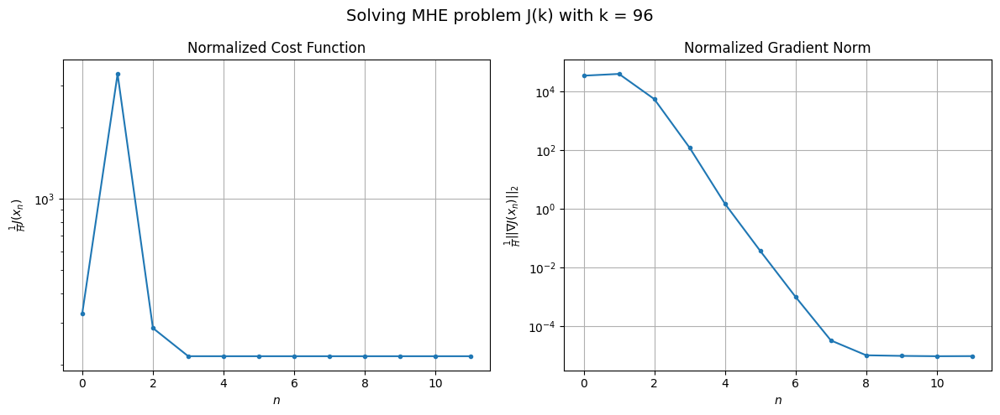

Windows:  23%|██▎       | 88/386 [05:02<16:18,  3.28s/it]

[Gauss-Newton] Before applying the algorithm
Cost function: 3728.536994102171
Gradient norm: 365438.7559969413
Global estimation error: 3400.0151166483174
Initial conditions estimation errors: 1.1623390573758043 m, 1474.7857905245698 m, 1526.2983573126876 m, 2656.222830295084 m
Position estimation errors: 6.322760953792923 m, 1302.5638910276982 m, 1495.3716426760252 m, 1959.5938515100695 m

[Gauss-Newton] Iteration 1
Cost function: 124610.50162999288 (3242.07%)
Gradient norm: 765318.4186222085 (109.42%)
Global estimation error: 1863.4038231169834 (-45.19%)
Initial conditions estimation errors: 3.2352978009667104 m, 802.4770979888493 m, 831.9094256136459 m, 1461.581328304219 m
Position estimation errors: 3.601390240277747 m, 723.1409583895688 m, 784.656776818709 m, 1075.9236617215827 m

[Gauss-Newton] Iteration 2
Cost function: 2455.9334848740423 (-98.03%)
Gradient norm: 81.4710940342368 (-99.99%)
Global estimation error: 1867.5598525825399 (0.22%)
Initial conditions estimation errors: 

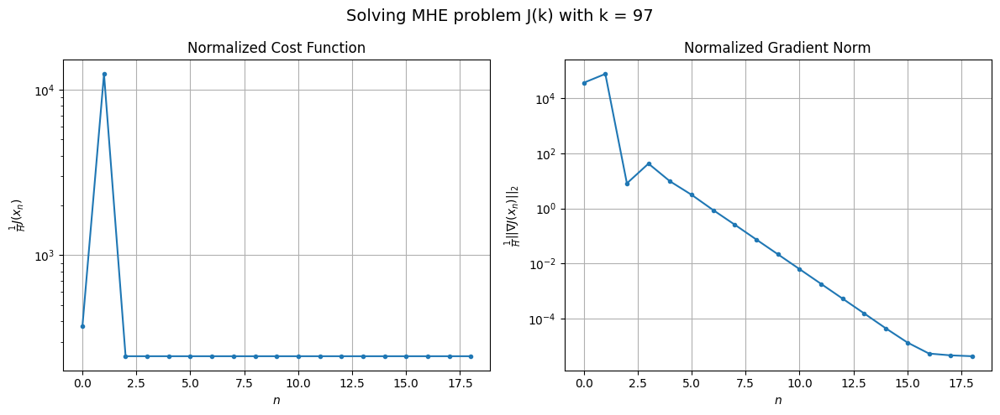

Windows:  23%|██▎       | 89/386 [05:08<19:52,  4.01s/it]

[Gauss-Newton] Before applying the algorithm
Cost function: 3996.31132646608
Gradient norm: 380270.7332818966
Global estimation error: 1877.388819820553
Initial conditions estimation errors: 1.252602917160518 m, 816.8983572228992 m, 848.1691508623891 m, 1462.146598026861 m
Position estimation errors: 6.547705823492003 m, 701.757006706527 m, 767.979197467035 m, 1012.8907090056736 m

[Gauss-Newton] Iteration 1
Cost function: 6976363.054223435 (174470.06%)
Gradient norm: 5942899.923556341 (1462.81%)
Global estimation error: 2301.133161425888 (22.57%)
Initial conditions estimation errors: 3.469675161447901 m, 1032.8604423601887 m, 1181.3383262406323 m, 1683.1040047450215 m
Position estimation errors: 3.7129818983599274 m, 1031.0366780491934 m, 1232.9053006534941 m, 1650.005248912412 m

[Gauss-Newton] Iteration 2
Cost function: 1702812.017894724 (-75.59%)
Gradient norm: 2860215.324736405 (-51.87%)
Global estimation error: 901.0611953846384 (-60.84%)
Initial conditions estimation errors: 3.4

/home/jgaspar/SpaceSim-Toolkit/test/new_newton_based_algorithms/gauss_newton.py:181: LinAlgWarning: Ill-conditioned matrix (rcond=9.25364e-17): result may not be accurate.
  delta_x = solve(HJ_x, -DJ_x)


[Gauss-Newton] STOP on Iteration 3 (gradient norm stagnated)
Cost function = 18612533.055695184 (993.05%)
Gradient norm = 9607383.816611374 (235.90%)
Global estimation error = 4644.217045080185 (415.42%)
Final initial conditions estimation errors: 3.4696751103354964 m, 2074.021188376756 m, 2324.89164941126 m, 3444.1326054510123 m
Final position estimation errors: 3.7129818911802315 m, 2002.8945765261842 m, 2379.6194337159764 m, 3164.1918076628554 m



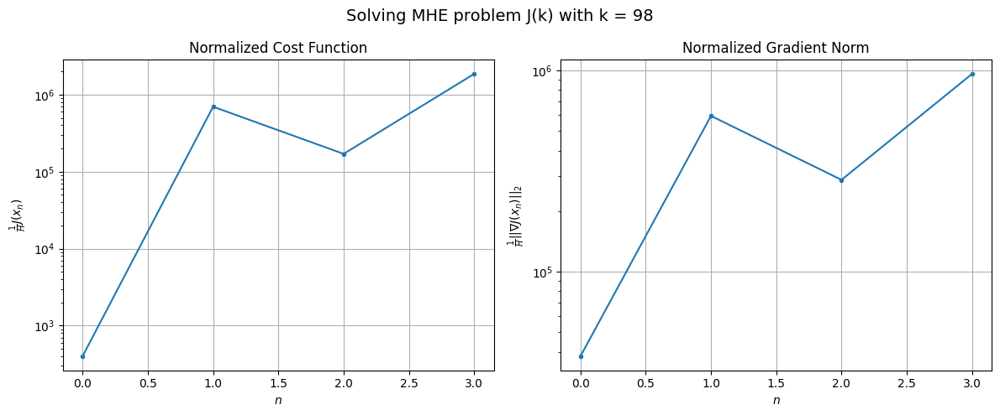

Windows:  23%|██▎       | 90/386 [05:10<16:41,  3.38s/it]

[Gauss-Newton] Before applying the algorithm
Cost function: 17781287.811062172
Gradient norm: 9277099.538664326
Global estimation error: 4690.588354912778
Initial conditions estimation errors: 1.3582942508287534 m, 2104.5737004471675 m, 2364.923296681184 m, 3461.144279005321 m
Position estimation errors: 6.728056533101379 m, 1947.4983198383052 m, 2343.1320589382917 m, 3077.108634555242 m

[Gauss-Newton] Iteration 1
Cost function: 439870.97394176916 (-97.53%)
Gradient norm: 1413118.410806132 (-84.77%)
Global estimation error: 2263.783847492273 (-51.74%)
Initial conditions estimation errors: 3.658022607587539 m, 1027.228472340755 m, 1214.1939719484685 m, 1610.973722887542 m
Position estimation errors: 3.8095822864374953 m, 1075.4261424089088 m, 1249.3891081162542 m, 1795.3532373210792 m

[Gauss-Newton] Iteration 2
Cost function: 2732.6855793562036 (-99.38%)
Gradient norm: 1289.6111797028639 (-99.91%)
Global estimation error: 2244.904621522308 (-0.83%)
Initial conditions estimation errors

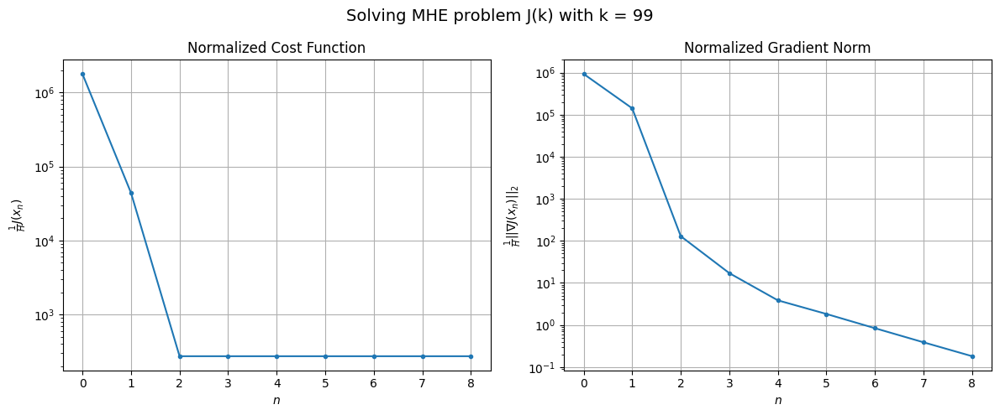

Windows:  24%|██▎       | 91/386 [05:13<16:55,  3.44s/it]

[Gauss-Newton] Before applying the algorithm
Cost function: 4331.404192641437
Gradient norm: 398430.9870319795
Global estimation error: 2336.3411076299176
Initial conditions estimation errors: 1.393661537677535 m, 1061.7812923284823 m, 1245.2719222428811 m, 1667.4544439869576 m
Position estimation errors: 6.894600175188916 m, 1061.8806891210484 m, 1237.0755517385664 m, 1798.5898599318925 m

[Gauss-Newton] Iteration 1
Cost function: 12419413.769381069 (286629.50%)
Gradient norm: 8828440.36180751 (2115.80%)
Global estimation error: 6238.269951045124 (167.01%)
Initial conditions estimation errors: 3.7772882550644287 m, 2873.5963229404765 m, 3530.281010652054 m, 4265.6212660531655 m
Position estimation errors: 3.926602473894737 m, 3212.647644814999 m, 3653.0572114222073 m, 5783.371628889345 m

[Gauss-Newton] Iteration 2
Cost function: 145332.9937933848 (-98.83%)
Gradient norm: 928217.8833821886 (-89.49%)
Global estimation error: 4798.30249577923 (-23.08%)
Initial conditions estimation erro

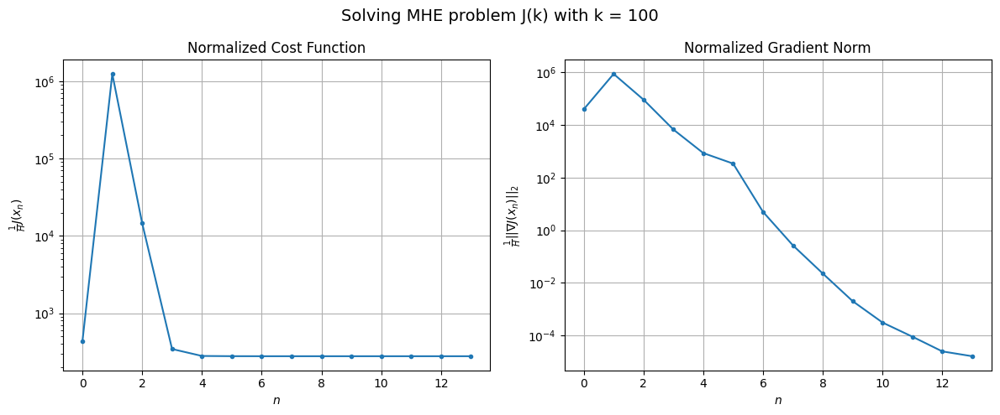

Windows:  24%|██▍       | 92/386 [05:18<18:23,  3.75s/it]

[Gauss-Newton] Before applying the algorithm
Cost function: 4642.097062028319
Gradient norm: 419385.84510054975
Global estimation error: 5575.340430406653
Initial conditions estimation errors: 1.389924021503887 m, 2537.2671737001183 m, 3012.1611739037176 m, 3946.3349450862715 m
Position estimation errors: 7.087579949993245 m, 2641.260126191581 m, 2988.36279233573 m, 4893.581214037969 m

[Gauss-Newton] Iteration 1
Cost function: 10058379.750015493 (216577.50%)
Gradient norm: 7792962.643945728 (1758.18%)
Global estimation error: 1972.1400357783516 (-64.63%)
Initial conditions estimation errors: 3.8867833830184417 m, 875.3675034758503 m, 1009.9253472101577 m, 1450.207722345557 m
Position estimation errors: 3.9306650410596733 m, 879.4754935688594 m, 975.9735829791504 m, 1675.7307068186988 m

[Gauss-Newton] Iteration 2
Cost function: 4731064.14861737 (-52.96%)
Gradient norm: 5253998.19076583 (-32.58%)
Global estimation error: 1527.3396358818193 (-22.55%)
Initial conditions estimation errors

/home/jgaspar/SpaceSim-Toolkit/test/new_newton_based_algorithms/gauss_newton.py:181: LinAlgWarning: Ill-conditioned matrix (rcond=8.73009e-17): result may not be accurate.
  delta_x = solve(HJ_x, -DJ_x)


[Gauss-Newton] Iteration 5
Cost function: 35137758.58072763 (572.82%)
Gradient norm: 14063594.880979842 (163.18%)
Global estimation error: 5761.730838133577 (907.17%)
Initial conditions estimation errors: 3.8867833700267966 m, 2596.67065409298 m, 3067.446687359331 m, 4128.630113388951 m
Position estimation errors: 3.9306649878436137 m, 2618.420791760186 m, 2958.2087723158224 m, 4682.188489574317 m

[Gauss-Newton] Iteration 6
Cost function: 10494992.13337615 (-70.13%)
Gradient norm: 7611118.847308878 (-45.88%)
Global estimation error: 1517.8692202430514 (-73.66%)
Initial conditions estimation errors: 3.8867833497539177 m, 661.4438553960584 m, 780.3530036133559 m, 1121.3615419879225 m
Position estimation errors: 3.9306651380471402 m, 683.6834472512439 m, 736.8050935257394 m, 1320.1752192119127 m

[Gauss-Newton] Iteration 7
Cost function: 1283978.9662024458 (-87.77%)
Gradient norm: 2721876.38684272 (-64.24%)
Global estimation error: 1153.7969167222464 (-23.99%)
Initial conditions estimati

/home/jgaspar/SpaceSim-Toolkit/test/new_newton_based_algorithms/gauss_newton.py:181: LinAlgWarning: Ill-conditioned matrix (rcond=7.96301e-17): result may not be accurate.
  delta_x = solve(HJ_x, -DJ_x)


[Gauss-Newton] Iteration 19
Cost function: 28469546.15518716 (609822.23%)
Gradient norm: 12683490.372460105 (12079.40%)
Global estimation error: 5450.95760520195 (3544.45%)
Initial conditions estimation errors: 3.886783375550064 m, 2453.773556851499 m, 2889.7234142181587 m, 3916.8108316923826 m
Position estimation errors: 3.9306649890141827 m, 2456.7638466660624 m, 2778.959223414655 m, 4381.836972198439 m

[Gauss-Newton] STOP on Iteration 20 (max iteration reached)
Cost function = 8973875.895723306 (-68.48%)
Gradient norm = 7038808.001242118 (-44.50%)
Global estimation error = 1396.6306976336443 (-74.38%)
Final initial conditions estimation errors: 3.886783351103681 m, 605.7608476743945 m, 704.050181692903 m, 1043.0380790008687 m
Final position estimation errors: 3.9306651318696297 m, 608.8386500497176 m, 658.0009457309882 m, 1171.6415823582017 m



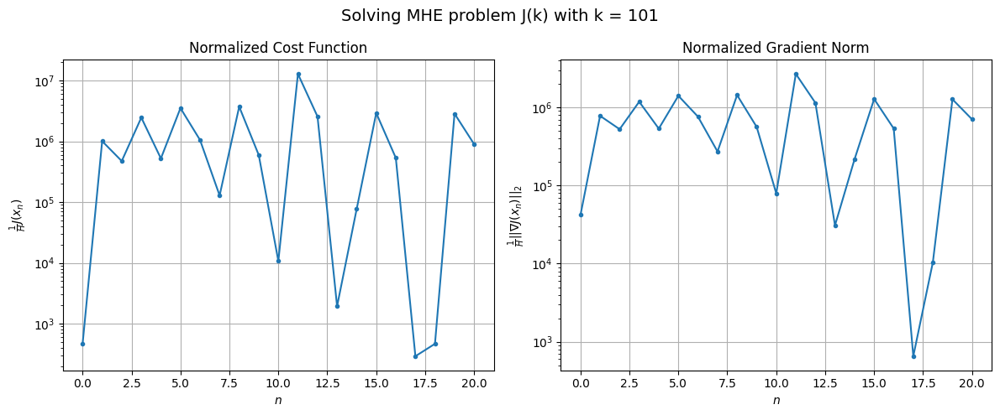

Windows:  24%|██▍       | 93/386 [05:25<22:41,  4.65s/it]

[Gauss-Newton] Before applying the algorithm
Cost function: 9020234.974949848
Gradient norm: 6990706.729193199
Global estimation error: 1426.3346465584245
Initial conditions estimation errors: 1.4150349315127888 m, 617.7783212745843 m, 707.3557135365895 m, 1073.5108746277901 m
Position estimation errors: 7.107660940580104 m, 594.2257278971209 m, 641.969921629023 m, 1163.7199027890053 m

[Gauss-Newton] Iteration 1
Cost function: 7223359.509533782 (-19.92%)
Gradient norm: 6574483.089471669 (-5.95%)
Global estimation error: 2440.125930774174 (71.08%)
Initial conditions estimation errors: 3.928315860653432 m, 1170.392402661858 m, 1428.312976589012 m, 1595.0851128886534 m
Position estimation errors: 3.9507780451874344 m, 1299.946142282153 m, 1465.5126896301927 m, 2382.155681206074 m

[Gauss-Newton] Iteration 2
Cost function: 117593208.42857471 (1527.96%)
Gradient norm: 25497256.988401048 (287.82%)
Global estimation error: 5769.8038290799095 (136.46%)
Initial conditions estimation errors: 3.

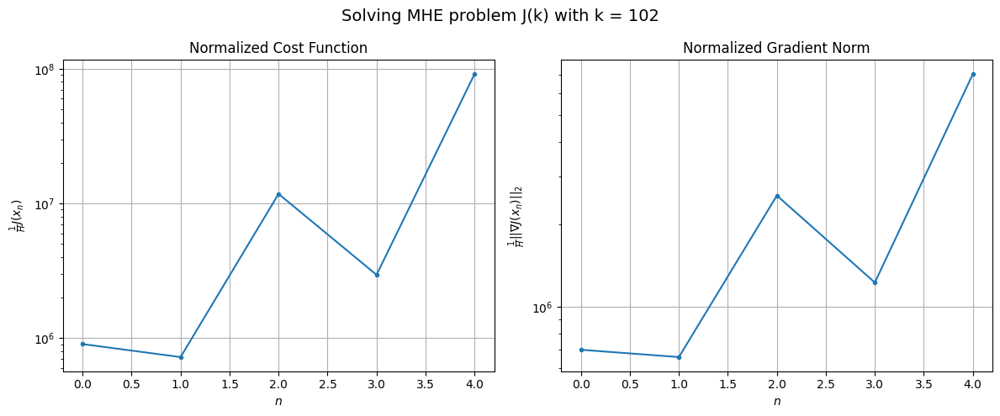

Windows:  24%|██▍       | 94/386 [05:27<18:43,  3.85s/it]

[Gauss-Newton] Before applying the algorithm
Cost function: 910530746.2697582
Gradient norm: 69805051.11146143
Global estimation error: 14277.210346459844
Initial conditions estimation errors: 1.4031036188863049 m, 6442.405965541941 m, 7539.541013017359 m, 10270.803679864151 m
Position estimation errors: 7.076965302633181 m, 5975.870511216253 m, 6799.939551720699 m, 10890.826396798118 m

[Gauss-Newton] Iteration 1
Cost function: 114425774.66795431 (-87.43%)
Gradient norm: 21858812.66124286 (-68.69%)
Global estimation error: 4160.922586231476 (-70.86%)
Initial conditions estimation errors: 3.973605613184184 m, 1861.9546449559753 m, 2139.0760495638233 m, 3044.778706182036 m
Position estimation errors: 3.8785207479358 m, 1827.6507317250243 m, 1888.7976664277387 m, 4280.049358168943 m

[Gauss-Newton] Iteration 2
Cost function: 149577.76155293596 (-99.87%)
Gradient norm: 441766.9242987258 (-97.98%)
Global estimation error: 3625.608282681655 (-12.87%)
Initial conditions estimation errors: 3.

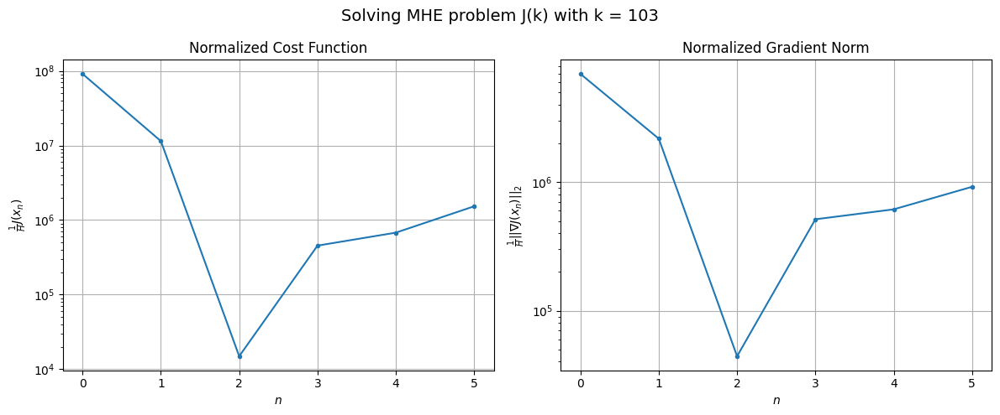

Windows:  25%|██▍       | 95/386 [05:29<16:31,  3.41s/it]

[Gauss-Newton] Before applying the algorithm
Cost function: 15391092.396872615
Gradient norm: 9125415.574058834
Global estimation error: 1509.0076341994122
Initial conditions estimation errors: 1.4102387083692691 m, 659.9813627342274 m, 730.4014410281397 m, 1143.6958738683095 m
Position estimation errors: 6.843462591213974 m, 508.74013461128783 m, 604.5901819722426 m, 908.6647696233545 m

[Gauss-Newton] Iteration 1
Cost function: 15385739.842748871 (-0.03%)
Gradient norm: 9118908.074293947 (-0.07%)
Global estimation error: 3638.684305168323 (141.13%)
Initial conditions estimation errors: 3.9083885165797163 m, 1669.0222288094587 m, 1997.0363346782951 m, 2542.874635297157 m
Position estimation errors: 3.7828331683782617 m, 1693.2955511467026 m, 1854.8604820191663 m, 3331.8182766439304 m

[Gauss-Newton] STOP on Iteration 2 (gradient norm stagnated)
Cost function = 3358825.305276104 (-78.17%)
Gradient norm = 4331411.012133766 (-52.50%)
Global estimation error = 521.3805328310938 (-85.67%)


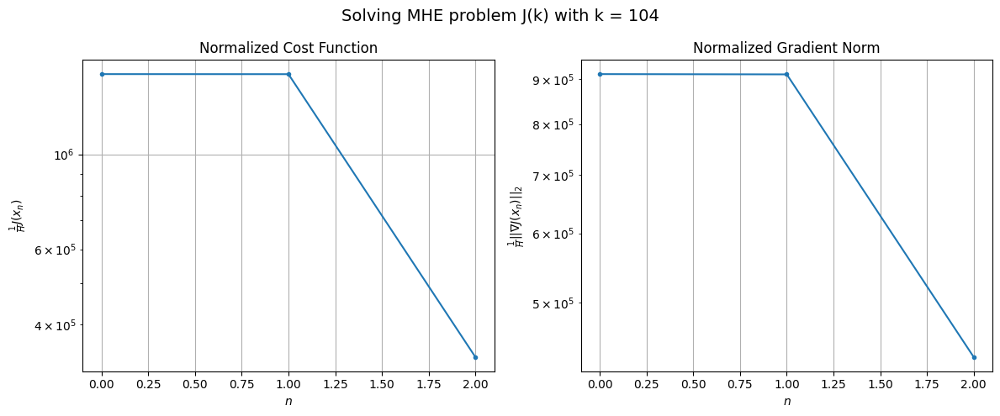

Windows:  25%|██▍       | 96/386 [05:30<13:44,  2.84s/it]

[Gauss-Newton] Before applying the algorithm
Cost function: 3393424.39903298
Gradient norm: 4303971.834679574
Global estimation error: 554.0276043317285
Initial conditions estimation errors: 1.3449491763666641 m, 261.8450926602369 m, 325.20366039782414 m, 364.17568832882506 m
Position estimation errors: 6.560239095366815 m, 314.91246247331986 m, 319.6577069679275 m, 659.3596140191519 m

[Gauss-Newton] Iteration 1
Cost function: 3554289.774602282 (4.74%)
Gradient norm: 4403468.346398777 (2.31%)
Global estimation error: 3623.34123471973 (554.00%)
Initial conditions estimation errors: 3.8018379115245664 m, 1651.4437196822414 m, 1955.692184156143 m, 2564.484730075494 m
Position estimation errors: 3.5913973089656235 m, 1612.570919223881 m, 1749.0545340623316 m, 3294.874695321716 m

[Gauss-Newton] STOP on Iteration 2 (gradient norm stagnated)
Cost function = 278661.67861302954 (-92.16%)
Gradient norm = 1238791.463227332 (-71.87%)
Global estimation error = 1874.3279930439612 (-48.27%)
Final i

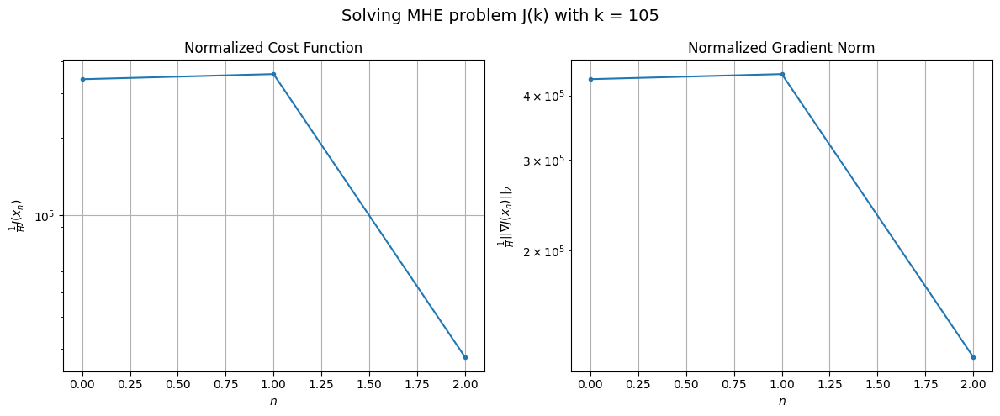

Windows:  25%|██▌       | 97/386 [05:32<11:37,  2.41s/it]

[Gauss-Newton] Before applying the algorithm
Cost function: 281315.91283265006
Gradient norm: 1257324.2341278868
Global estimation error: 1934.9135665553483
Initial conditions estimation errors: 1.269142319057054 m, 885.2664417103717 m, 1052.4513129149107 m, 1361.0790931185904 m
Position estimation errors: 6.241683577850623 m, 850.9321416369343 m, 913.6720383866478 m, 1788.2472564451875 m

[Gauss-Newton] Iteration 1
Cost function: 47403.94698894688 (-83.15%)
Gradient norm: 492627.4789436528 (-60.82%)
Global estimation error: 833.8702158579389 (-56.90%)
Initial conditions estimation errors: 3.6767772333025217 m, 387.14096708271876 m, 461.09830254696357 m, 576.9189927842912 m
Position estimation errors: 3.3175735797917274 m, 392.35243064441653 m, 404.69458576259296 m, 886.816958902101 m

[Gauss-Newton] Iteration 2
Cost function: 11973.310327731928 (-74.74%)
Gradient norm: 231446.72162014697 (-53.02%)
Global estimation error: 123.00828826333041 (-85.25%)
Initial conditions estimation erro

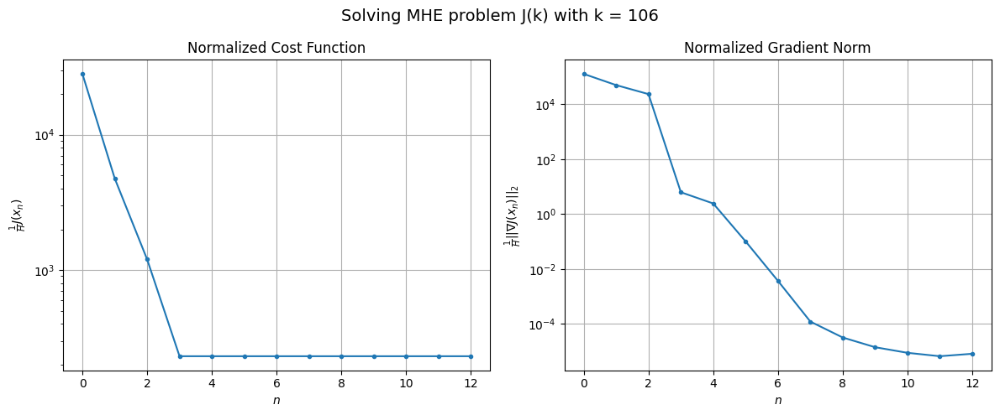

Windows:  25%|██▌       | 98/386 [05:36<14:23,  3.00s/it]

[Gauss-Newton] Before applying the algorithm
Cost function: 3466.2941478203584
Gradient norm: 333758.7770630767
Global estimation error: 117.9862255244231
Initial conditions estimation errors: 1.2262044381305424 m, 60.75330225431667 m, 84.98969622846133 m, 54.81708003992814 m
Position estimation errors: 5.97737178256734 m, 81.1755126692597 m, 69.55866350934072 m, 219.02694030540025 m

[Gauss-Newton] Iteration 1
Cost function: 3998.4571043157125 (15.35%)
Gradient norm: 86741.67122649396 (-74.01%)
Global estimation error: 499.0038251222475 (322.93%)
Initial conditions estimation errors: 3.54460478172134 m, 155.02480070147644 m, 144.58932279698573 m, 451.72260901511214 m
Position estimation errors: 3.2082808222402925 m, 75.47382176275582 m, 80.16567990719464 m, 173.913928326609 m

[Gauss-Newton] Iteration 2
Cost function: 2173.499718917272 (-45.64%)
Gradient norm: 21776.056072841937 (-74.90%)
Global estimation error: 702.2227534242547 (40.72%)
Initial conditions estimation errors: 3.54460

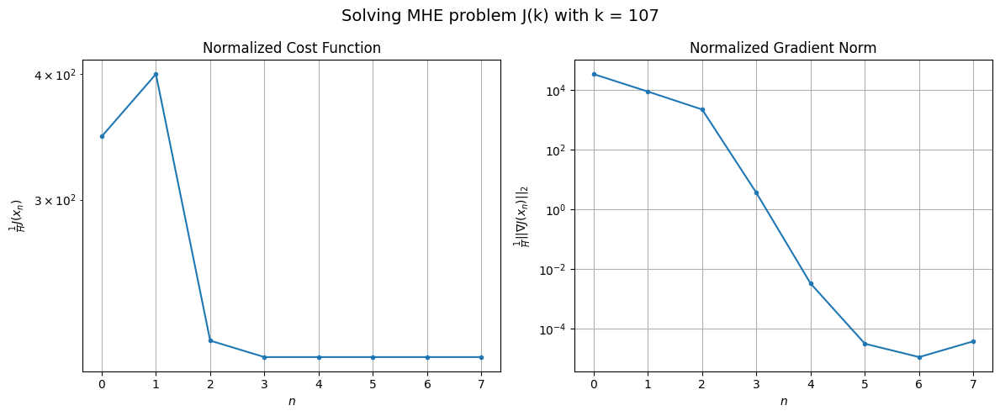

Windows:  26%|██▌       | 99/386 [05:39<14:13,  2.98s/it]

[Gauss-Newton] Before applying the algorithm
Cost function: 3357.970947150591
Gradient norm: 329023.55700219277
Global estimation error: 676.4178057183944
Initial conditions estimation errors: 1.2090391875539743 m, 241.3791725708532 m, 235.36555613237186 m, 586.4116572998673 m
Position estimation errors: 5.9654810716282265 m, 147.6630588497823 m, 158.98739249871744 m, 350.79099540026874 m

[Gauss-Newton] Iteration 1
Cost function: 2177.024479386037 (-35.17%)
Gradient norm: 7236.0433020482105 (-97.80%)
Global estimation error: 358.50290396031176 (-47.00%)
Initial conditions estimation errors: 3.408142158590167 m, 156.9971439681475 m, 184.69935742183898 m, 264.10345065250397 m
Position estimation errors: 3.2698758064216142 m, 145.3763259809666 m, 153.1386826737529 m, 358.0870857881282 m

[Gauss-Newton] Iteration 2
Cost function: 498854.2226810372 (22814.50%)
Gradient norm: 1761098.0741810268 (24237.86%)
Global estimation error: 2138.155564125897 (496.41%)
Initial conditions estimation er

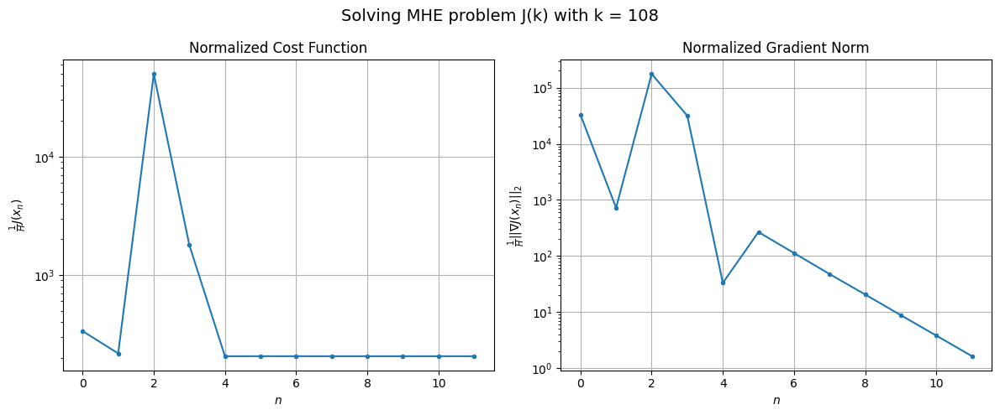

Windows:  26%|██▌       | 100/386 [05:43<15:32,  3.26s/it]

[Gauss-Newton] Before applying the algorithm
Cost function: 3230.587934023366
Gradient norm: 319414.02517476963
Global estimation error: 1538.5895257740174
Initial conditions estimation errors: 1.180187797000203 m, 656.0141643217281 m, 739.2474039520044 m, 1179.157659575928 m
Position estimation errors: 6.100267439006074 m, 621.038272481413 m, 600.6105933304893 m, 1658.8229755287496 m

[Gauss-Newton] Iteration 1
Cost function: 49626.397192027944 (1436.14%)
Gradient norm: 549143.5133507525 (71.92%)
Global estimation error: 578.7320226317223 (-62.39%)
Initial conditions estimation errors: 3.340187244581292 m, 217.80355177039343 m, 222.6808486927468 m, 487.7442010053988 m
Position estimation errors: 3.4550978718739 m, 172.16908299046935 m, 169.1426612784987 m, 455.5020754826643 m

[Gauss-Newton] STOP on Iteration 2 (gradient norm stagnated)
Cost function = 4058.2592818140542 (-91.82%)
Gradient norm = 120113.49147571194 (-78.13%)
Global estimation error = 903.1633140567326 (56.06%)
Final i

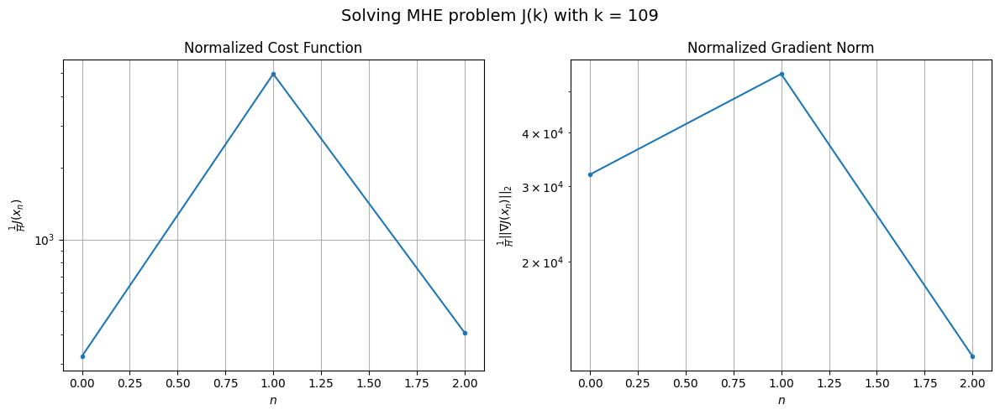

Windows:  26%|██▌       | 101/386 [05:45<12:59,  2.74s/it]

[Gauss-Newton] Before applying the algorithm
Cost function: 6081.211163464127
Gradient norm: 362498.8012124136
Global estimation error: 949.1114957071534
Initial conditions estimation errors: 1.2051040351826743 m, 401.6489517637282 m, 455.6639160202541 m, 729.2863716793806 m
Position estimation errors: 6.261466269349532 m, 389.08456420027284 m, 375.0218372532117 m, 1076.1575531225594 m

[Gauss-Newton] Iteration 1
Cost function: 377647.0075853992 (6110.06%)
Gradient norm: 1571598.7813028563 (333.55%)
Global estimation error: 617.5489752889675 (-34.93%)
Initial conditions estimation errors: 3.33920826386231 m, 292.73553127562843 m, 385.9034792806155 m, 383.0633899782865 m
Position estimation errors: 3.5070915662471993 m, 385.41363029253887 m, 340.44910032449474 m, 1083.1547619010967 m

[Gauss-Newton] Iteration 2
Cost function: 3099.8216498135835 (-99.18%)
Gradient norm: 80074.47579061368 (-94.90%)
Global estimation error: 424.0185352098492 (-31.34%)
Initial conditions estimation errors: 

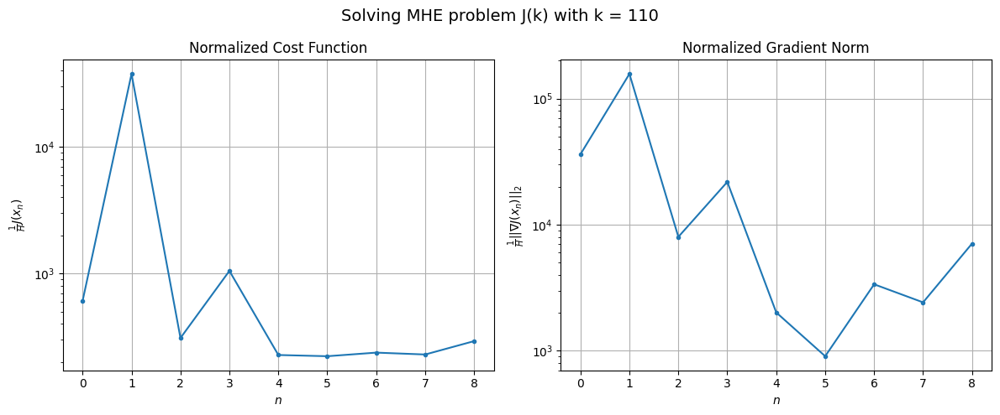

Windows:  26%|██▋       | 102/386 [05:48<13:42,  2.90s/it]

[Gauss-Newton] Before applying the algorithm
Cost function: 4380.842614248502
Gradient norm: 341222.87312433653
Global estimation error: 166.15473590504698
Initial conditions estimation errors: 1.2248366270695772 m, 78.87909802128196 m, 120.41114827123326 m, 82.97422364954947 m
Position estimation errors: 6.199051572724235 m, 141.0785601635956 m, 114.14889789481256 m, 388.59797141444176 m

[Gauss-Newton] Iteration 1
Cost function: 9316.45860728708 (112.66%)
Gradient norm: 150311.13020314497 (-55.95%)
Global estimation error: 991.1611994158849 (496.53%)
Initial conditions estimation errors: 3.4851897216482435 m, 337.99629469904806 m, 298.1464527228081 m, 882.7544242417664 m
Position estimation errors: 3.3897713447199855 m, 283.8105856114019 m, 205.1216511144797 m, 952.7193880920596 m

[Gauss-Newton] STOP on Iteration 2 (gradient norm stagnated)
Cost function = 8736.278214620866 (-6.23%)
Gradient norm = 196030.99109665886 (30.42%)
Global estimation error = 352.8666526476029 (-64.40%)
Fin

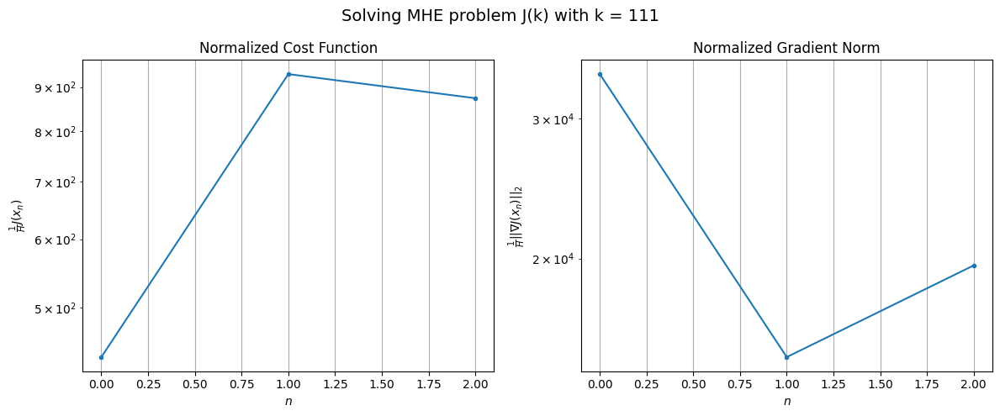

Windows:  27%|██▋       | 103/386 [05:49<11:27,  2.43s/it]

[Gauss-Newton] Before applying the algorithm
Cost function: 10116.262997252932
Gradient norm: 360252.94065458915
Global estimation error: 338.6526658086518
Initial conditions estimation errors: 1.2836198171036228 m, 71.01528570828602 m, 47.08115684320736 m, 327.7561689320456 m
Position estimation errors: 5.906947315418743 m, 40.969678321032085 m, 26.583782534958562 m, 183.53349546713983 m

[Gauss-Newton] Iteration 1
Cost function: 89089.782576753 (780.66%)
Gradient norm: 746667.5816721467 (107.26%)
Global estimation error: 1418.0755447017657 (318.74%)
Initial conditions estimation errors: 3.479292366019607 m, 557.5861375877598 m, 587.2868632963758 m, 1164.0943512344954 m
Position estimation errors: 3.2439129331010594 m, 540.4633958963924 m, 445.96264338449254 m, 1717.0952011232807 m

[Gauss-Newton] Iteration 2
Cost function: 2762.252193563205 (-96.90%)
Gradient norm: 66149.40278478581 (-91.14%)
Global estimation error: 1029.873287314187 (-27.38%)
Initial conditions estimation errors: 3

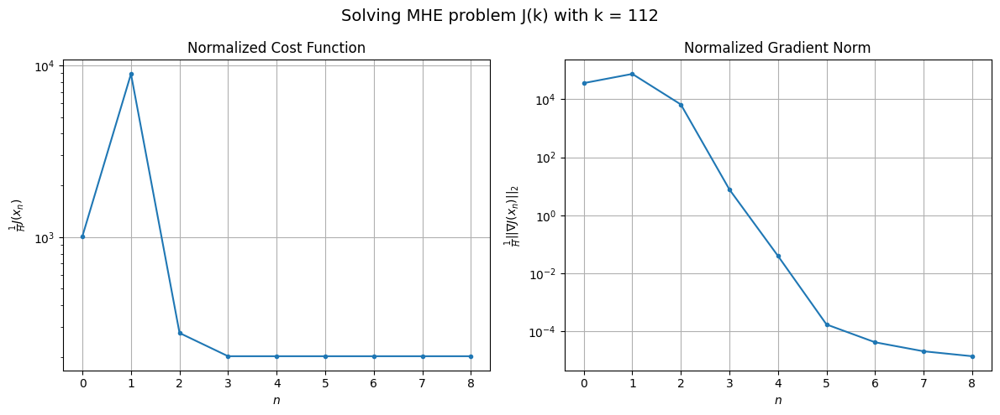

Windows:  27%|██▋       | 104/386 [05:52<12:20,  2.63s/it]

[Gauss-Newton] Before applying the algorithm
Cost function: 3009.8730750507602
Gradient norm: 303839.6710953707
Global estimation error: 1088.4210939148913
Initial conditions estimation errors: 1.1957388284761714 m, 417.9907064968151 m, 431.71658202916933 m, 907.5034139735353 m
Position estimation errors: 5.639520914938392 m, 400.4294046452156 m, 326.13378460437275 m, 1289.5398133157962 m

[Gauss-Newton] Iteration 1
Cost function: 117002.27121381002 (3787.28%)
Gradient norm: 796087.2922016047 (162.01%)
Global estimation error: 388.63303451006794 (-64.29%)
Initial conditions estimation errors: 3.3302003334997528 m, 112.94290324723346 m, 85.94800633789981 m, 361.775304162244 m
Position estimation errors: 3.0773927623475044 m, 70.07071972636189 m, 51.69329393435971 m, 274.2182722209768 m

[Gauss-Newton] Iteration 2
Cost function: 1847.0482253999558 (-98.42%)
Gradient norm: 10530.256523597374 (-98.68%)
Global estimation error: 216.906991151602 (-44.19%)
Initial conditions estimation errors

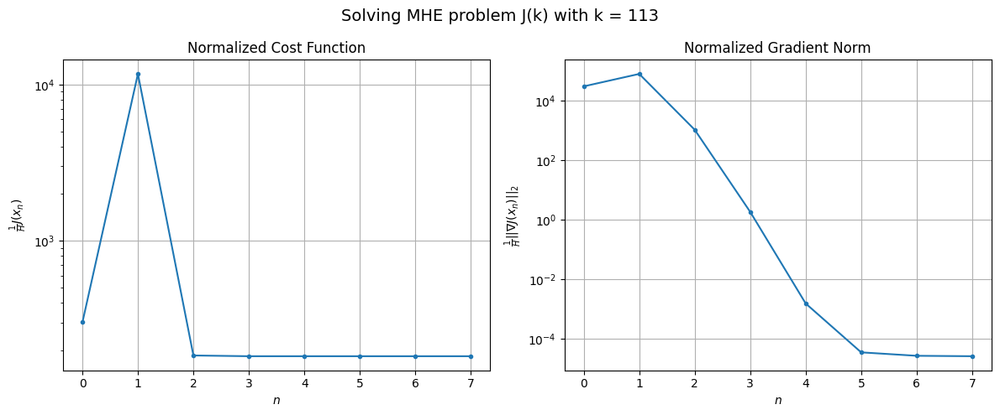

Windows:  27%|██▋       | 105/386 [05:55<12:31,  2.68s/it]

[Gauss-Newton] Before applying the algorithm
Cost function: 2756.6678135486363
Gradient norm: 293242.3325348273
Global estimation error: 201.51900285467647
Initial conditions estimation errors: 1.0472141763281984 m, 44.83618699877729 m, 34.82031919101965 m, 193.35468799025222 m
Position estimation errors: 5.459636316258919 m, 4.569577225398049 m, 10.567756135036136 m, 54.0744814300794 m

[Gauss-Newton] Iteration 1
Cost function: 1749.3168174314824 (-36.54%)
Gradient norm: 16745.957761418405 (-94.29%)
Global estimation error: 361.8103031680188 (79.54%)
Initial conditions estimation errors: 3.051841125441315 m, 105.25670582474696 m, 81.43361391430733 m, 336.4326890544009 m
Position estimation errors: 3.0214388215779855 m, 77.01194442304443 m, 61.18765868976613 m, 301.1766867581294 m

[Gauss-Newton] Iteration 2
Cost function: 1706.6710059054444 (-2.44%)
Gradient norm: 35.99505330493744 (-99.79%)
Global estimation error: 366.5048934696922 (1.30%)
Initial conditions estimation errors: 3.051

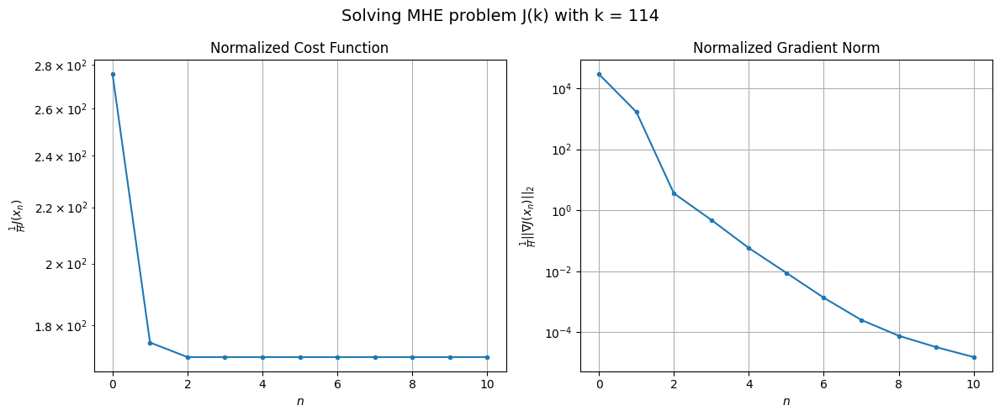

Windows:  27%|██▋       | 106/386 [05:59<13:35,  2.91s/it]

[Gauss-Newton] Before applying the algorithm
Cost function: 2846.386662763631
Gradient norm: 314315.7832800932
Global estimation error: 366.9024336506564
Initial conditions estimation errors: 0.893140336900597 m, 104.7263073205341 m, 75.4914161642932 m, 343.43854442651127 m
Position estimation errors: 5.547116232346531 m, 66.58358350765009 m, 57.525543887687746 m, 278.2237289895905 m

[Gauss-Newton] Iteration 1
Cost function: 3652.2157896265544 (28.31%)
Gradient norm: 102805.03506109446 (-67.29%)
Global estimation error: 191.29669190900094 (-47.86%)
Initial conditions estimation errors: 2.9377006944347017 m, 86.15115272288445 m, 96.40300503607693 m, 140.96142568418023 m
Position estimation errors: 2.9965771832212513 m, 87.36718486010774 m, 75.37951052825483 m, 297.53478365409205 m

[Gauss-Newton] Iteration 2
Cost function: 1706.1177822447805 (-53.29%)
Gradient norm: 284.8308294390507 (-99.72%)
Global estimation error: 217.53636268349584 (13.72%)
Initial conditions estimation errors: 2.

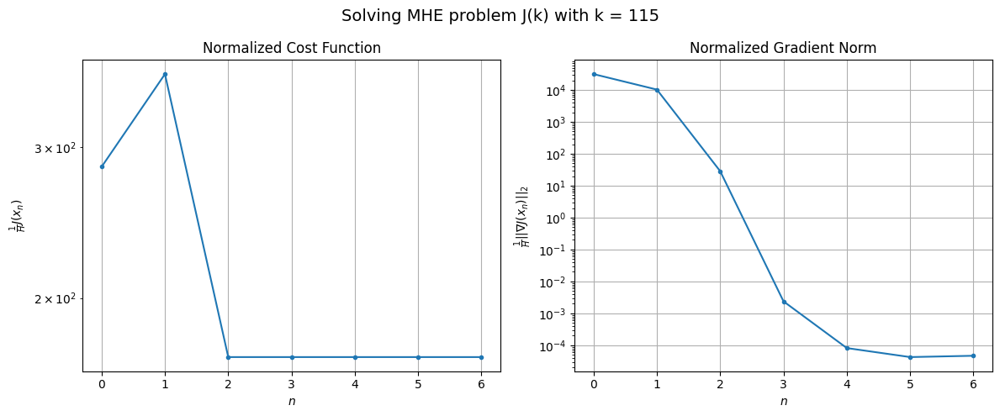

Windows:  28%|██▊       | 107/386 [06:01<13:23,  2.88s/it]

[Gauss-Newton] Before applying the algorithm
Cost function: 2913.634481846806
Gradient norm: 321587.378134021
Global estimation error: 232.5516792496396
Initial conditions estimation errors: 0.9415854952067663 m, 94.6330066044301 m, 104.34784438039057 m, 185.0280927706523 m
Position estimation errors: 5.746582787219202 m, 95.40280463290713 m, 78.16759534537825 m, 341.73975570290565 m

[Gauss-Newton] Iteration 1
Cost function: 2968.4799088181553 (1.88%)
Gradient norm: 90035.02582055885 (-72.00%)
Global estimation error: 110.15029833685755 (-52.63%)
Initial conditions estimation errors: 2.923875617321796 m, 42.409331510074686 m, 75.70240926553022 m, 67.78506965291895 m
Position estimation errors: 3.216317078061044 m, 74.56930511870924 m, 61.40497512299308 m, 283.95868968969256 m

[Gauss-Newton] Iteration 2
Cost function: 1802.0510938898972 (-39.29%)
Gradient norm: 511.4091773489313 (-99.43%)
Global estimation error: 141.21209709012584 (28.20%)
Initial conditions estimation errors: 2.9238

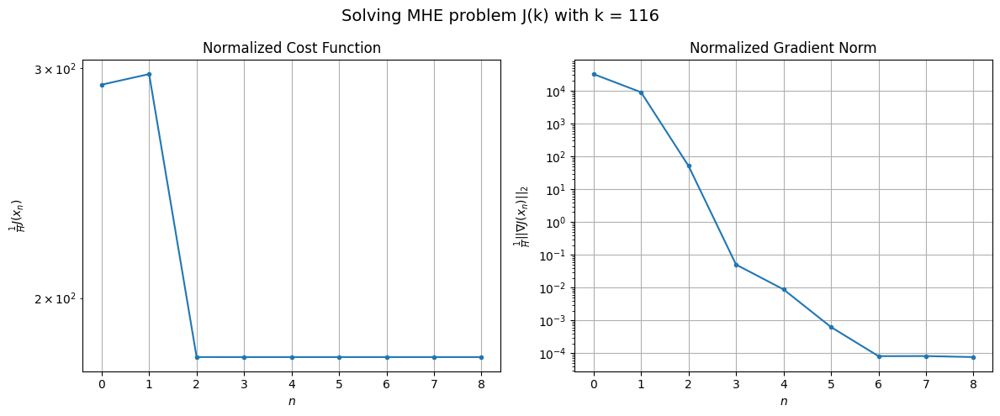

Windows:  28%|██▊       | 108/386 [06:05<13:53,  3.00s/it]

[Gauss-Newton] Before applying the algorithm
Cost function: 3170.185196900854
Gradient norm: 343534.7909800339
Global estimation error: 159.50225263241242
Initial conditions estimation errors: 1.022583760514827 m, 62.69385002881191 m, 81.44996546967771 m, 121.96315198569688 m
Position estimation errors: 6.224724808213432 m, 82.57648436987455 m, 71.54445412610809 m, 339.62414309249846 m

[Gauss-Newton] Iteration 1
Cost function: 1986.6966557882834 (-37.33%)
Gradient norm: 2297.19483560518 (-99.33%)
Global estimation error: 300.76727656190957 (88.57%)
Initial conditions estimation errors: 3.064987032962596 m, 84.72814182075358 m, 75.07843272114563 m, 278.6320312753432 m
Position estimation errors: 3.5793653943326618 m, 79.55691178978869 m, 56.38057291428224 m, 376.96276108559374 m

[Gauss-Newton] Iteration 2
Cost function: 1981.8420823739607 (-0.24%)
Gradient norm: 174.89249349767948 (-92.39%)
Global estimation error: 318.9489196825241 (6.05%)
Initial conditions estimation errors: 3.0649

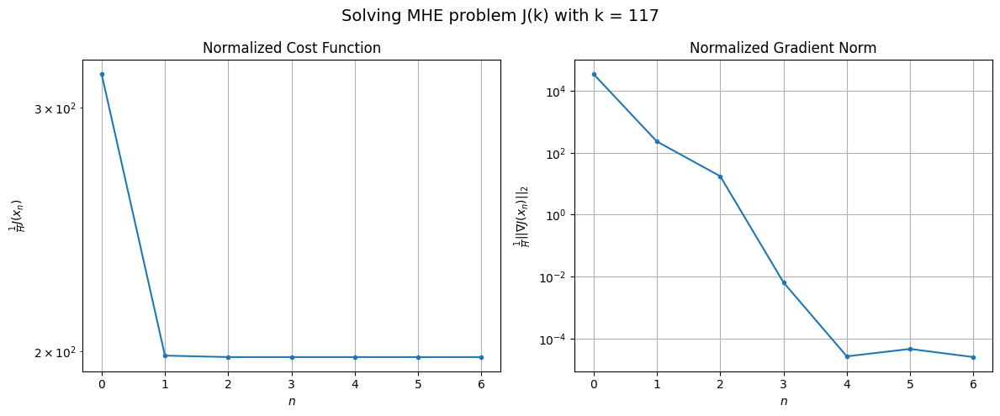

Windows:  28%|██▊       | 109/386 [06:07<12:56,  2.80s/it]

[Gauss-Newton] Before applying the algorithm
Cost function: 3756.484150262115
Gradient norm: 388313.46876583836
Global estimation error: 336.8110578981002
Initial conditions estimation errors: 1.1521544900232712 m, 93.8627889320256 m, 76.24215704922764 m, 314.3519559818142 m
Position estimation errors: 6.79560855402578 m, 81.27917564193525 m, 62.23776506684793 m, 405.81565052439447 m

[Gauss-Newton] Iteration 1
Cost function: 2388.4573567552907 (-36.42%)
Gradient norm: 8280.956316223692 (-97.87%)
Global estimation error: 145.77391398465434 (-56.72%)
Initial conditions estimation errors: 3.307155245190675 m, 44.67079938108699 m, 46.36338825050898 m, 130.74385036710717 m
Position estimation errors: 3.908650261249449 m, 46.35918448937161 m, 33.73166150287695 m, 239.112621292935 m

[Gauss-Newton] Iteration 2
Cost function: 2373.044485001946 (-0.65%)
Gradient norm: 14.728089035616073 (-99.82%)
Global estimation error: 147.39710629493482 (1.11%)
Initial conditions estimation errors: 3.307155

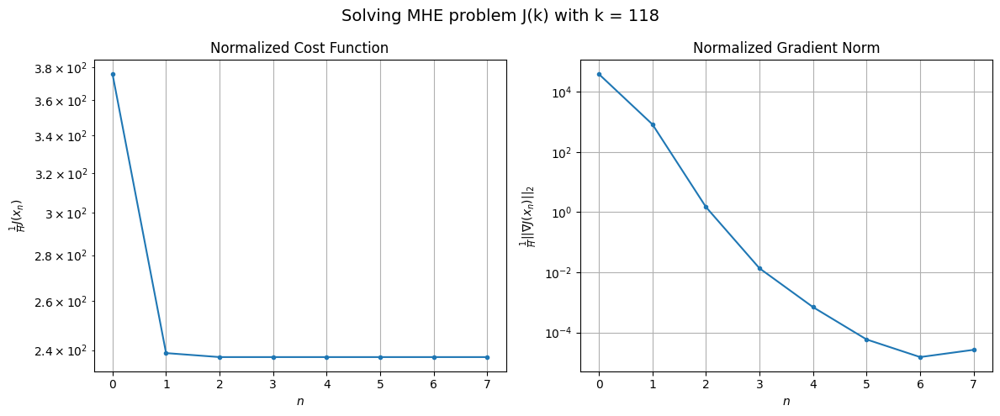

Windows:  28%|██▊       | 110/386 [06:10<12:58,  2.82s/it]

[Gauss-Newton] Before applying the algorithm
Cost function: 4527.293402412264
Gradient norm: 432411.255083902
Global estimation error: 162.31069170122524
Initial conditions estimation errors: 1.284663648621793 m, 48.66530972651942 m, 44.33848121408899 m, 148.35362777175243 m
Position estimation errors: 7.245868761903641 m, 46.60488786246492 m, 37.04507629131602 m, 256.0091303341447 m

[Gauss-Newton] Iteration 1
Cost function: 3070.8370802600784 (-32.17%)
Gradient norm: 23734.0525981209 (-94.51%)
Global estimation error: 215.28411610159566 (32.64%)
Initial conditions estimation errors: 3.5764029558636006 m, 32.060312060763614 m, 38.18759576721911 m, 209.399583076763 m
Position estimation errors: 4.116006818609772 m, 6.144967370973212 m, 10.202383024210778 m, 29.33571308541893 m

[Gauss-Newton] Iteration 2
Cost function: 2922.0928684881123 (-4.84%)
Gradient norm: 3.4965610358258847 (-99.99%)
Global estimation error: 217.24469062936305 (0.91%)
Initial conditions estimation errors: 3.57640

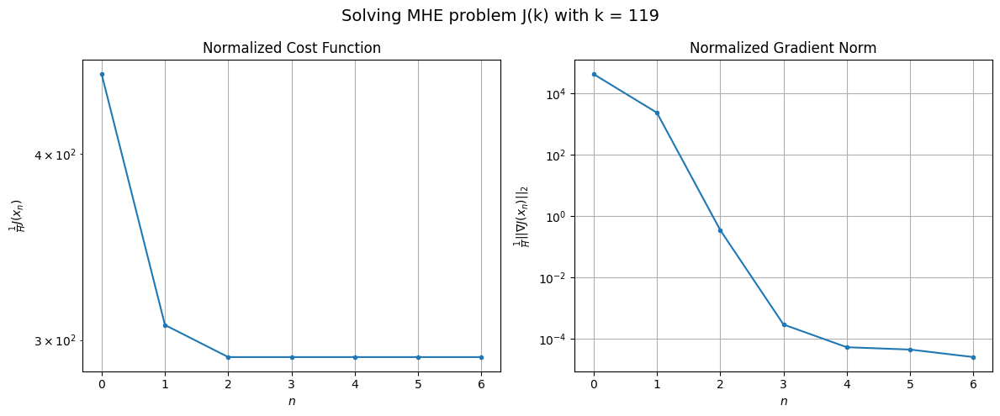

Windows:  29%|██▉       | 111/386 [06:12<12:27,  2.72s/it]

[Gauss-Newton] Before applying the algorithm
Cost function: 5019.0778805921
Gradient norm: 442408.3547848696
Global estimation error: 196.20332917635784
Initial conditions estimation errors: 1.4041551247298352 m, 26.82376208012666 m, 36.39757463517092 m, 190.9171249588881 m
Position estimation errors: 7.469831445458857 m, 10.075268768581347 m, 11.134322500086967 m, 20.00959179854929 m

[Gauss-Newton] Iteration 1
Cost function: 3657.806822836614 (-27.12%)
Gradient norm: 32517.46060277582 (-92.65%)
Global estimation error: 317.2652524821893 (61.70%)
Initial conditions estimation errors: 3.8612832873258993 m, 60.65416936291712 m, 52.5447647999577 m, 306.92410874891584 m
Position estimation errors: 4.230526352780627 m, 39.42272683850818 m, 57.545563254221335 m, 306.7558092844131 m

[Gauss-Newton] Iteration 2
Cost function: 3269.7890873619126 (-10.61%)
Gradient norm: 182.04920576685228 (-99.44%)
Global estimation error: 357.2941330626325 (12.62%)
Initial conditions estimation errors: 3.8612

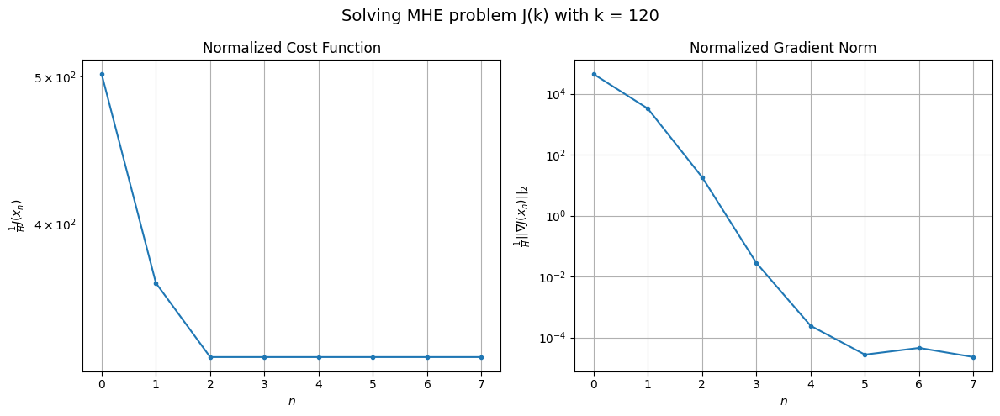

Windows:  29%|██▉       | 112/386 [06:15<12:23,  2.72s/it]

[Gauss-Newton] Before applying the algorithm
Cost function: 5148.8846478678415
Gradient norm: 447869.4215328852
Global estimation error: 364.3916362944221
Initial conditions estimation errors: 1.5167306881853944 m, 68.49285064145502 m, 53.794726962478265 m, 353.82734803356914 m
Position estimation errors: 7.485309964876456 m, 37.13397492073562 m, 64.66428394004872 m, 316.9790093909273 m

[Gauss-Newton] Iteration 1
Cost function: 3851.694582106117 (-25.19%)
Gradient norm: 51974.00619639331 (-88.40%)
Global estimation error: 129.2076595109211 (-64.54%)
Initial conditions estimation errors: 4.139870163898493 m, 35.80536496324124 m, 25.8476667823126 m, 121.35626156244702 m
Position estimation errors: 4.191664463855303 m, 34.48173414573408 m, 35.024977781966065 m, 153.08503722008098 m

[Gauss-Newton] Iteration 2
Cost function: 3280.1735001740626 (-14.84%)
Gradient norm: 65.42221503034162 (-99.87%)
Global estimation error: 142.29864613841332 (10.13%)
Initial conditions estimation errors: 4.1

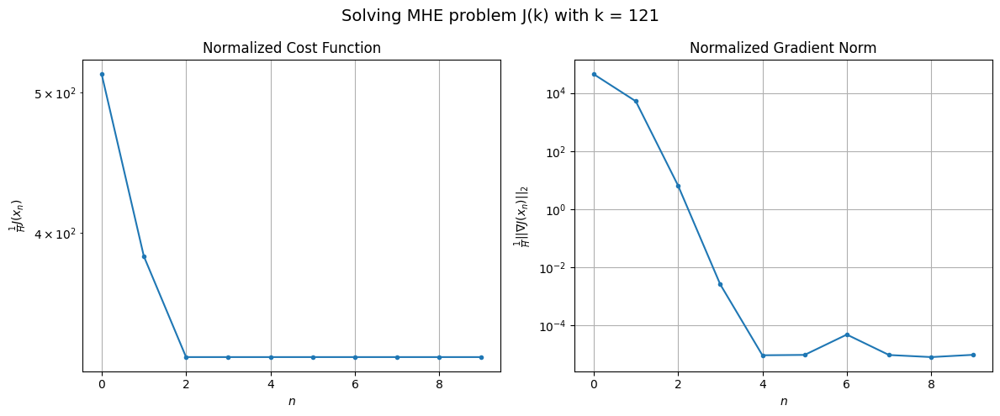

Windows:  29%|██▉       | 113/386 [06:18<12:58,  2.85s/it]

[Gauss-Newton] Before applying the algorithm
Cost function: 5075.498384287729
Gradient norm: 434819.9304672508
Global estimation error: 147.3008429272094
Initial conditions estimation errors: 1.6267275586834862 m, 37.502127312205 m, 29.42512170912258 m, 139.3651042709709 m
Position estimation errors: 7.200229810502865 m, 38.22630618326618 m, 42.24818811412514 m, 173.0433178456909 m

[Gauss-Newton] Iteration 1
Cost function: 3302.2721182028054 (-34.94%)
Gradient norm: 3728.077813053359 (-99.14%)
Global estimation error: 97.67734093134246 (-33.69%)
Initial conditions estimation errors: 4.178944571453065 m, 38.39246932525349 m, 59.57210272062629 m, 67.08365598850483 m
Position estimation errors: 4.009068244030053 m, 68.33608805310251 m, 63.004111280193015 m, 360.0842178751983 m

[Gauss-Newton] Iteration 2
Cost function: 3300.1303781299653 (-0.06%)
Gradient norm: 110.07842950520923 (-97.05%)
Global estimation error: 82.65602325545395 (-15.38%)
Initial conditions estimation errors: 4.178944

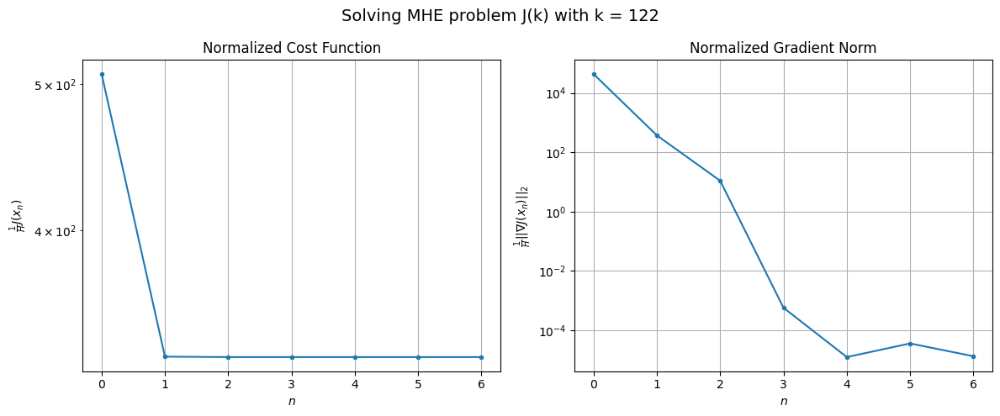

Windows:  30%|██▉       | 114/386 [06:21<12:47,  2.82s/it]

[Gauss-Newton] Before applying the algorithm
Cost function: 4636.713831849842
Gradient norm: 396779.7731817551
Global estimation error: 101.08587732362204
Initial conditions estimation errors: 1.5700836553855186 m, 35.83404486850834 m, 53.13075696218493 m, 78.15733712146725 m
Position estimation errors: 6.663288899325827 m, 68.4523237814703 m, 67.36109298588748 m, 368.22777427801 m

[Gauss-Newton] Iteration 1
Cost function: 3333.053679203463 (-28.12%)
Gradient norm: 25106.368680954456 (-93.67%)
Global estimation error: 587.5715677808927 (481.26%)
Initial conditions estimation errors: 4.038569660430086 m, 104.62308649728799 m, 84.14978707099075 m, 572.0111539812881 m
Position estimation errors: 3.7445165080465617 m, 75.38403333366058 m, 119.24346174197139 m, 613.6662495820949 m

[Gauss-Newton] Iteration 2
Cost function: 3058.8860712217966 (-8.23%)
Gradient norm: 330.18362874856604 (-98.68%)
Global estimation error: 574.4342300155296 (-2.24%)
Initial conditions estimation errors: 4.03856

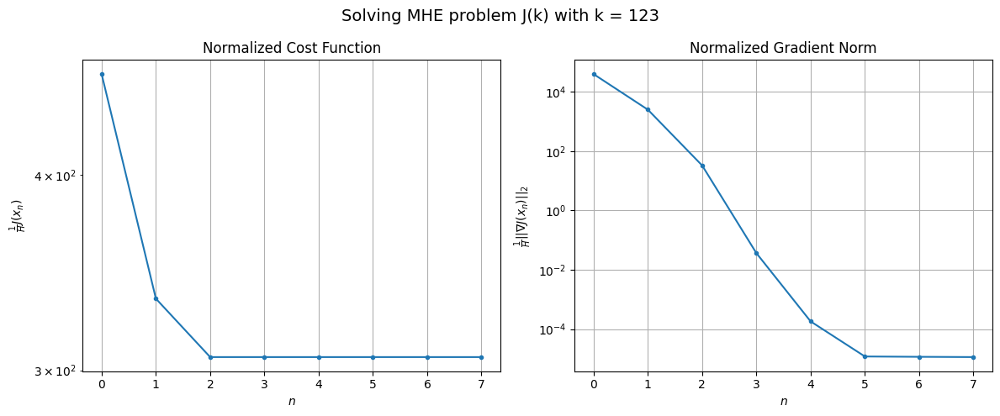

Windows:  30%|██▉       | 115/386 [06:24<12:41,  2.81s/it]

[Gauss-Newton] Before applying the algorithm
Cost function: 3984.830297021167
Gradient norm: 344815.9083239082
Global estimation error: 585.734292028806
Initial conditions estimation errors: 1.4353166812502574 m, 94.19309692750959 m, 88.24257005541214 m, 571.3348035888627 m
Position estimation errors: 6.006789279552304 m, 62.060570176589145 m, 118.21785603137066 m, 556.1814804084678 m

[Gauss-Newton] Iteration 1
Cost function: 2705.0654606393346 (-32.12%)
Gradient norm: 18296.675204108113 (-94.69%)
Global estimation error: 342.5134125127664 (-41.52%)
Initial conditions estimation errors: 3.7637792512812758 m, 47.525506381119705 m, 60.42090268585593 m, 333.7542194393746 m
Position estimation errors: 3.3990507967248917 m, 19.971757529461026 m, 60.72781687274833 m, 236.06416103869506 m

[Gauss-Newton] Iteration 2
Cost function: 2650.0283183712527 (-2.03%)
Gradient norm: 7.49435500087874 (-99.96%)
Global estimation error: 346.25190204081116 (1.09%)
Initial conditions estimation errors: 3.7

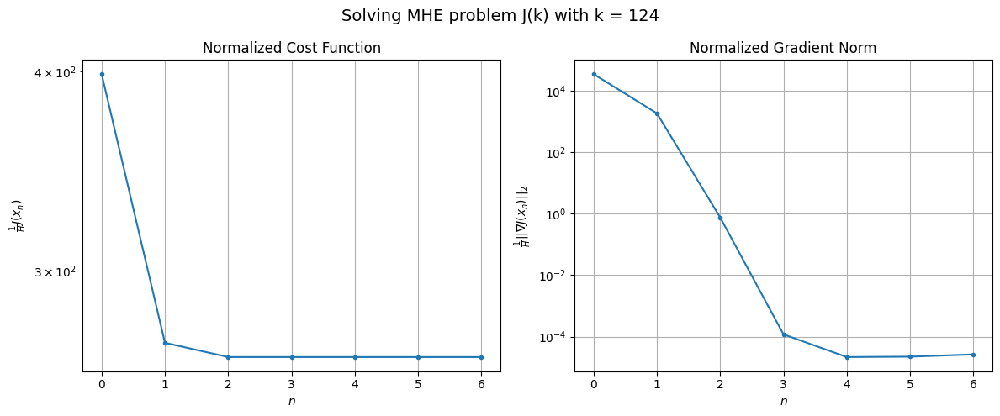

Windows:  30%|███       | 116/386 [06:26<12:34,  2.79s/it]

[Gauss-Newton] Before applying the algorithm
Cost function: 3421.6971004491124
Gradient norm: 299727.66837261594
Global estimation error: 339.28019136279727
Initial conditions estimation errors: 1.3156682826593 m, 44.75392399824216 m, 59.59637413185355 m, 330.9904004777531 m
Position estimation errors: 5.335307471324506 m, 17.401121554521907 m, 61.920065929166334 m, 225.96963436209825 m

[Gauss-Newton] Iteration 1
Cost function: 2540.126924217576 (-25.76%)
Gradient norm: 16205.46569433177 (-94.59%)
Global estimation error: 192.5700038407905 (-43.24%)
Initial conditions estimation errors: 3.3778449847252308 m, 7.6737131109425665 m, 66.28736383775403 m, 180.6064084233786 m
Position estimation errors: 3.034929483261364 m, 16.329466729219643 m, 31.910473622385513 m, 87.62162837782655 m

[Gauss-Newton] Iteration 2
Cost function: 2342.2947224398904 (-7.79%)
Gradient norm: 168.0973089569398 (-98.96%)
Global estimation error: 179.21035430941717 (-6.94%)
Initial conditions estimation errors: 3.

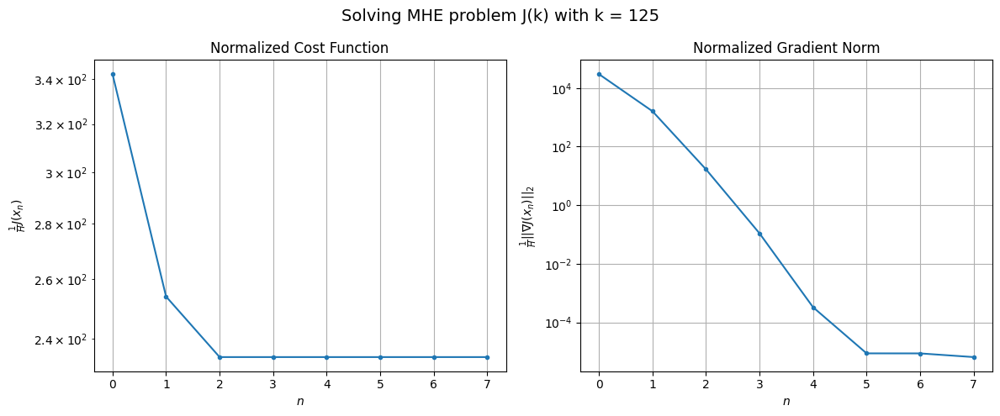

Windows:  30%|███       | 117/386 [06:29<12:32,  2.80s/it]

[Gauss-Newton] Before applying the algorithm
Cost function: 2983.048314787558
Gradient norm: 272571.0866855791
Global estimation error: 159.81895582461317
Initial conditions estimation errors: 1.1927498804570615 m, 7.71780233484699 m, 49.07239029977252 m, 151.8974964223168 m
Position estimation errors: 4.871271004954166 m, 10.925899253776965 m, 23.191868243424302 m, 77.59704064366639 m

[Gauss-Newton] Iteration 1
Cost function: 2027.0548080919089 (-32.05%)
Gradient norm: 710.7114438442956 (-99.74%)
Global estimation error: 127.48522584556619 (-20.23%)
Initial conditions estimation errors: 3.1222540128433907 m, 6.5971593521873215 m, 59.89568244117388 m, 112.30112626442292 m
Position estimation errors: 2.743859244663204 m, 23.182791790761573 m, 40.075590757127245 m, 128.39975559711425 m

[Gauss-Newton] Iteration 2
Cost function: 2026.9314845422605 (-0.01%)
Gradient norm: 0.6531209063394126 (-99.91%)
Global estimation error: 126.82998874146934 (-0.51%)
Initial conditions estimation errors

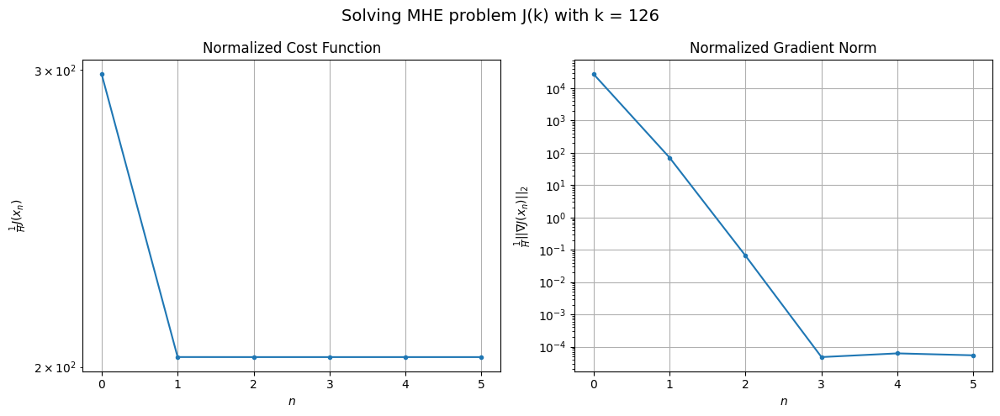

Windows:  31%|███       | 118/386 [06:32<12:23,  2.77s/it]

[Gauss-Newton] Before applying the algorithm
Cost function: 2608.384128545643
Gradient norm: 251299.61532544403
Global estimation error: 105.56092744579334
Initial conditions estimation errors: 1.1765439750657378 m, 8.201934323631408 m, 54.74390822313191 m, 89.87420052746793 m
Position estimation errors: 4.733277468693043 m, 23.698756622326623 m, 44.11869770417 m, 152.21726142540797 m

[Gauss-Newton] Iteration 1
Cost function: 2134.8705162322676 (-18.15%)
Gradient norm: 53294.98877331662 (-78.79%)
Global estimation error: 230.48808897099192 (118.35%)
Initial conditions estimation errors: 2.9647181564029594 m, 47.91014504817183 m, 37.687807535472636 m, 222.2605640141004 m
Position estimation errors: 2.768449273751676 m, 61.437947889983754 m, 103.1810897540365 m, 515.9424369886327 m

[Gauss-Newton] Iteration 2
Cost function: 1761.5400621363176 (-17.49%)
Gradient norm: 2428.5440827644506 (-95.44%)
Global estimation error: 344.5112538983778 (49.47%)
Initial conditions estimation errors: 2.

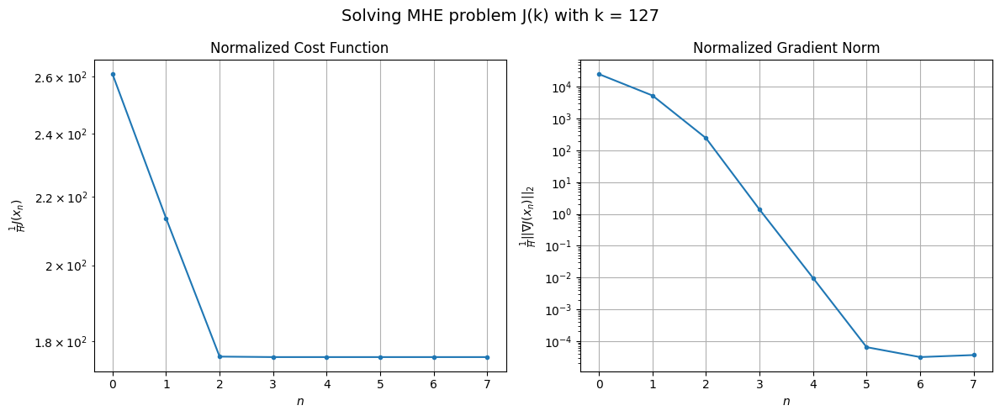

Windows:  31%|███       | 119/386 [06:35<13:03,  2.94s/it]

[Gauss-Newton] Before applying the algorithm
Cost function: 2503.567325981813
Gradient norm: 265874.6842209013
Global estimation error: 394.1197192101432
Initial conditions estimation errors: 1.191446687434883 m, 68.26587905425168 m, 61.87938634887987 m, 383.1959809286549 m
Position estimation errors: 4.992537783162177 m, 75.11929650641159 m, 143.38966860738176 m, 661.1280564912126 m

[Gauss-Newton] Iteration 1
Cost function: 2028.6503895927285 (-18.97%)
Gradient norm: 43071.838065419484 (-83.80%)
Global estimation error: 864.8003200830609 (119.43%)
Initial conditions estimation errors: 2.919085799074874 m, 129.08009188189408 m, 135.0156298621662 m, 844.3810184049728 m
Position estimation errors: 2.968013878755293 m, 121.9512166945901 m, 254.34800744956578 m, 1155.2758372926462 m

[Gauss-Newton] Iteration 2
Cost function: 1679.141380379911 (-17.23%)
Gradient norm: 135.8991498234779 (-99.68%)
Global estimation error: 895.1060743422239 (3.50%)
Initial conditions estimation errors: 2.9190

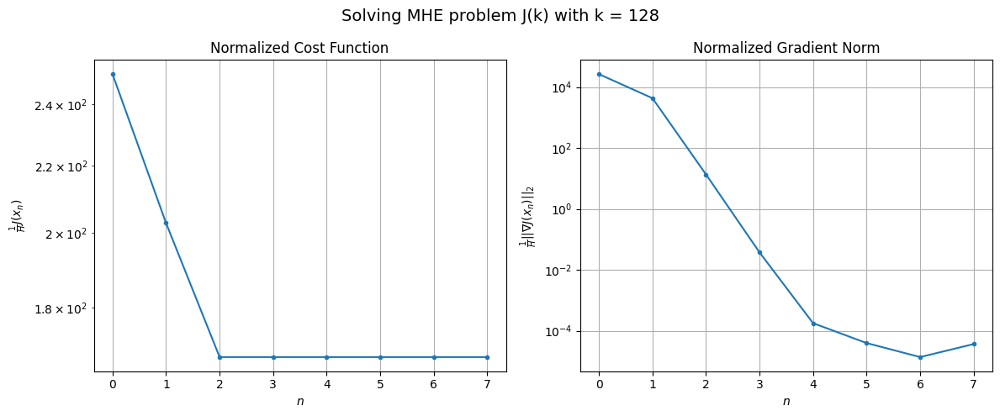

Windows:  31%|███       | 120/386 [06:38<12:58,  2.93s/it]

[Gauss-Newton] Before applying the algorithm
Cost function: 2662.7488856353984
Gradient norm: 284908.3193616763
Global estimation error: 948.5808943308898
Initial conditions estimation errors: 1.1726440028367828 m, 133.14171549376258 m, 155.92081131957457 m, 926.1563360752958 m
Position estimation errors: 5.272701306478884 m, 122.1385022267993 m, 272.3527808879249 m, 1194.849425824656 m

[Gauss-Newton] Iteration 1
Cost function: 8271.777865817747 (210.65%)
Gradient norm: 197397.46935898988 (-30.72%)
Global estimation error: 64.44636627512821 (-93.21%)
Initial conditions estimation errors: 2.901071152832562 m, 16.40898411593477 m, 22.854206994539876 m, 57.908011725129654 m
Position estimation errors: 3.0605218123644478 m, 16.043790658961367 m, 19.73572333912575 m, 81.21144115788964 m

[Gauss-Newton] Iteration 2
Cost function: 1787.3476319204276 (-78.39%)
Gradient norm: 48.47306454327694 (-99.98%)
Global estimation error: 75.07502843573903 (16.49%)
Initial conditions estimation errors: 2

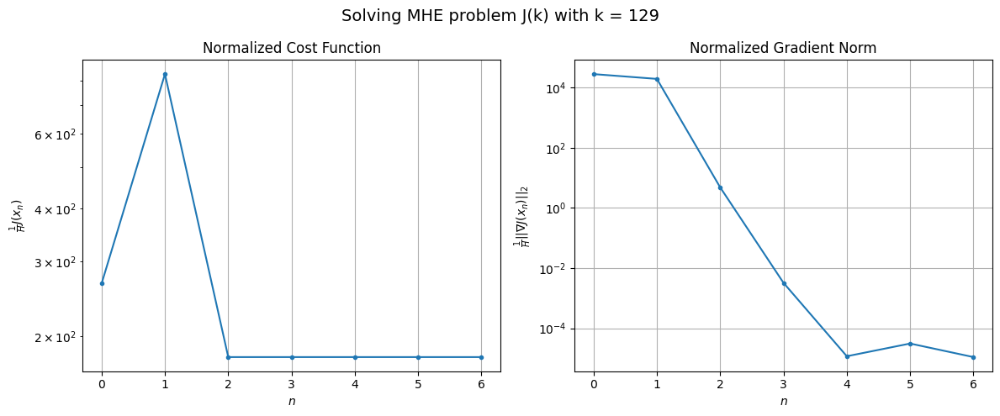

Windows:  31%|███▏      | 121/386 [06:41<12:23,  2.81s/it]

[Gauss-Newton] Before applying the algorithm
Cost function: 2725.2427043577873
Gradient norm: 292323.9169546427
Global estimation error: 76.36096545273615
Initial conditions estimation errors: 1.1203131212052546 m, 16.930681362191645 m, 16.868179356020317 m, 72.5158795348479 m
Position estimation errors: 5.253716729595918 m, 17.538516992615584 m, 22.275900584892682 m, 93.40437755189711 m

[Gauss-Newton] Iteration 1
Cost function: 1771.7459804166947 (-34.99%)
Gradient norm: 616.9423388694302 (-99.79%)
Global estimation error: 122.87206776530371 (60.91%)
Initial conditions estimation errors: 2.979429928240954 m, 13.185547446289863 m, 19.07923523735001 m, 120.62649586894155 m
Position estimation errors: 2.933245337410848 m, 10.905304494656761 m, 8.223301885332152 m, 57.029203935269926 m

[Gauss-Newton] Iteration 2
Cost function: 1771.6616854485778 (-0.00%)
Gradient norm: 88.69336085472435 (-85.62%)
Global estimation error: 142.06752772557226 (15.62%)
Initial conditions estimation errors: 

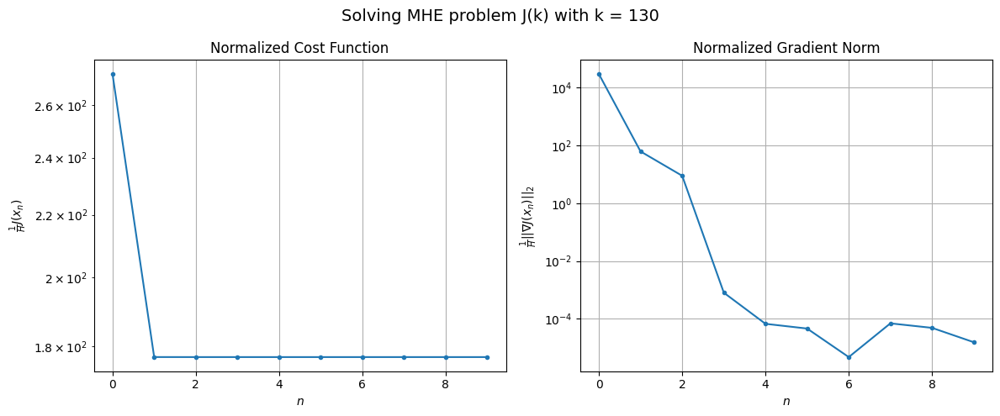

Windows:  32%|███▏      | 122/386 [06:44<13:11,  3.00s/it]

[Gauss-Newton] Before applying the algorithm
Cost function: 2452.3152082637753
Gradient norm: 277215.9913367001
Global estimation error: 130.9091098007345
Initial conditions estimation errors: 1.0468002728493582 m, 14.211940870158836 m, 20.868269803589577 m, 128.44686449793014 m
Position estimation errors: 4.953510891365463 m, 12.96145494740656 m, 10.36310087360413 m, 57.45722410892928 m

[Gauss-Newton] Iteration 1
Cost function: 86469.44330796044 (3426.03%)
Gradient norm: 704060.2902563594 (153.98%)
Global estimation error: 1731.1210509770372 (1222.38%)
Initial conditions estimation errors: 2.9573365244731553 m, 184.71452625625406 m, 347.8857504555005 m, 1685.7119728921305 m
Position estimation errors: 2.6859563105346473 m, 164.58789371387945 m, 523.2353943798198 m, 2132.903654254555 m

[Gauss-Newton] Iteration 2
Cost function: 1517.416806318321 (-98.25%)
Gradient norm: 6900.8241317637985 (-99.02%)
Global estimation error: 1504.454286741675 (-13.09%)
Initial conditions estimation erro

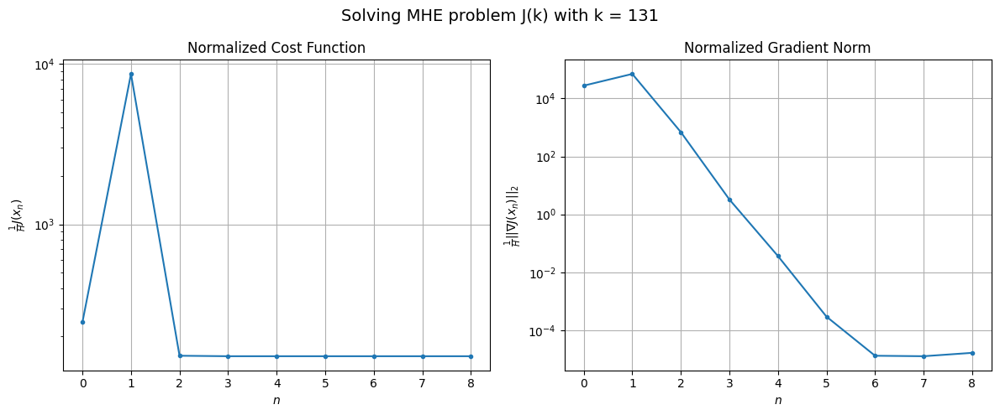

Windows:  32%|███▏      | 123/386 [06:47<13:19,  3.04s/it]

[Gauss-Newton] Before applying the algorithm
Cost function: 2137.720746643783
Gradient norm: 269230.70528157183
Global estimation error: 1600.7960730516138
Initial conditions estimation errors: 0.903484459674539 m, 168.99260398037578 m, 323.29734107474417 m, 1558.6742723685743 m
Position estimation errors: 4.622220093042098 m, 145.9007602569935 m, 486.05773463090253 m, 1959.4732474493796 m

[Gauss-Newton] Iteration 1
Cost function: 1439.442731415333 (-32.66%)
Gradient norm: 29069.525107376627 (-89.20%)
Global estimation error: 1189.388830217841 (-25.70%)
Initial conditions estimation errors: 2.736481025615554 m, 135.52747931424253 m, 223.4059583390472 m, 1160.327030978391 m
Position estimation errors: 2.449045731764754 m, 120.42322718288628 m, 381.1907073563889 m, 1537.0692689018042 m

[Gauss-Newton] Iteration 2
Cost function: 1282.3322196493366 (-10.91%)
Gradient norm: 1.395939696588903 (-100.00%)
Global estimation error: 1185.9017819555852 (-0.29%)
Initial conditions estimation error

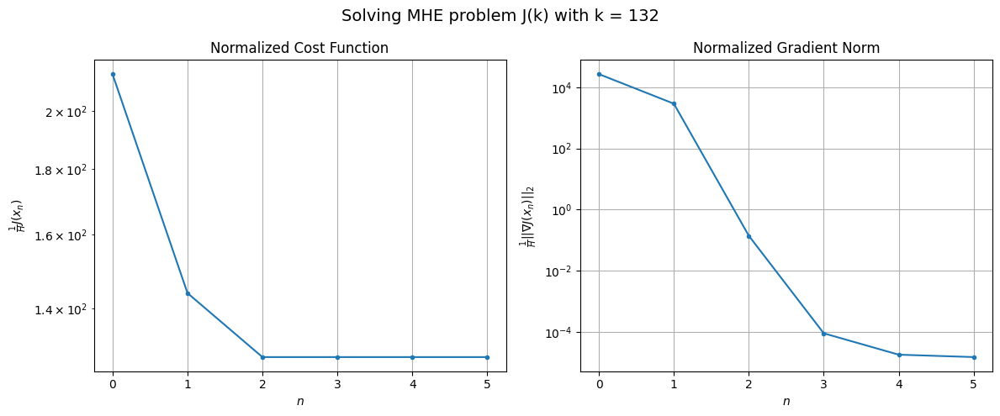

Windows:  32%|███▏      | 124/386 [06:50<12:11,  2.79s/it]

[Gauss-Newton] Before applying the algorithm
Cost function: 2022.942108793175
Gradient norm: 282772.6249992617
Global estimation error: 1255.205811656015
Initial conditions estimation errors: 0.7133744425305989 m, 137.43428319385967 m, 244.044596218086 m, 1223.5578583917013 m
Position estimation errors: 4.514876847777089 m, 115.13847455228863 m, 392.32286887574475 m, 1544.3343659853304 m

[Gauss-Newton] Iteration 1
Cost function: 3184.215722073249 (57.41%)
Gradient norm: 110899.69186481091 (-60.78%)
Global estimation error: 559.3788425393981 (-55.44%)
Initial conditions estimation errors: 2.4571695050629123 m, 55.60114468681577 m, 112.93867339530384 m, 545.0245705437769 m
Position estimation errors: 2.368238934880873 m, 47.38808478704131 m, 171.0581944433099 m, 660.5524921087185 m

[Gauss-Newton] Iteration 2
Cost function: 1198.724645962357 (-62.35%)
Gradient norm: 883.9058642119181 (-99.20%)
Global estimation error: 480.08456618903585 (-14.18%)
Initial conditions estimation errors: 2.

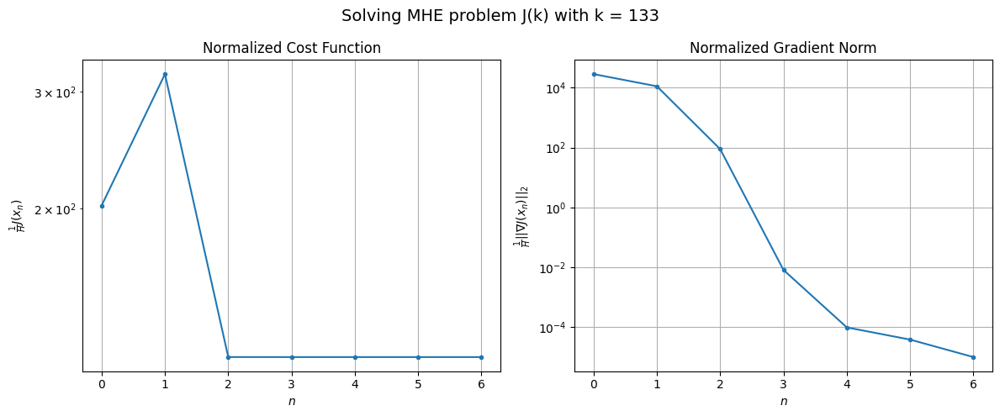

Windows:  32%|███▏      | 125/386 [06:52<11:52,  2.73s/it]

[Gauss-Newton] Before applying the algorithm
Cost function: 1992.7791252185077
Gradient norm: 281577.9077347665
Global estimation error: 504.42432214435314
Initial conditions estimation errors: 0.6104500762430624 m, 50.160160456835676 m, 103.42793782327104 m, 491.1516744632493 m
Position estimation errors: 4.6728286794963125 m, 39.978398259939574 m, 154.45870431661592 m, 587.5269698704253 m

[Gauss-Newton] Iteration 1
Cost function: 7078.539146381398 (255.21%)
Gradient norm: 187172.91788625906 (-33.53%)
Global estimation error: 452.42019543821084 (-10.31%)
Initial conditions estimation errors: 2.233002567376177 m, 56.85291478630564 m, 95.78124405799785 m, 438.48896617266155 m
Position estimation errors: 2.603883939907778 m, 37.28155550319905 m, 149.26884457092046 m, 562.1422540285786 m

[Gauss-Newton] Iteration 2
Cost function: 1313.4762719610324 (-81.44%)
Gradient norm: 17760.68998893146 (-90.51%)
Global estimation error: 789.1432756162386 (74.43%)
Initial conditions estimation errors

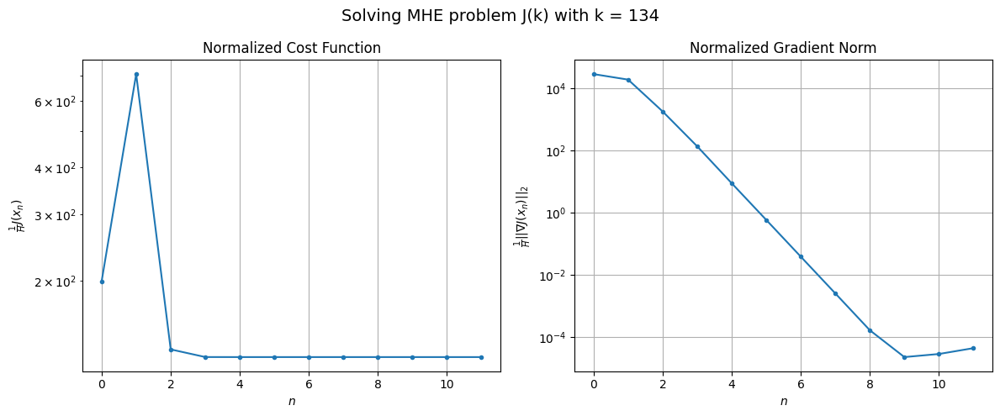

Windows:  33%|███▎      | 126/386 [06:56<13:24,  3.09s/it]

[Gauss-Newton] Before applying the algorithm
Cost function: 2287.7376960091833
Gradient norm: 317269.28211759333
Global estimation error: 939.3092193246802
Initial conditions estimation errors: 0.6973036536696235 m, 91.78465177270354 m, 207.82648634831358 m, 911.4190721823373 m
Position estimation errors: 5.160799158568969 m, 66.15200560521846 m, 273.8083023037485 m, 1021.9682042544046 m

[Gauss-Newton] Iteration 1
Cost function: 126164.80353870234 (5414.83%)
Gradient norm: 822190.7963242698 (159.15%)
Global estimation error: 3202.3651625837256 (240.93%)
Initial conditions estimation errors: 2.3460502238013725 m, 259.76331573710576 m, 750.5442054290382 m, 3102.3121379182307 m
Position estimation errors: 2.9286567892061997 m, 232.1555328999235 m, 882.7666412443565 m, 3370.1240048474806 m

[Gauss-Newton] Iteration 2
Cost function: 2790.332341902644 (-97.79%)
Gradient norm: 86454.27222611858 (-89.48%)
Global estimation error: 2488.1164213190295 (-22.30%)
Initial conditions estimation erro

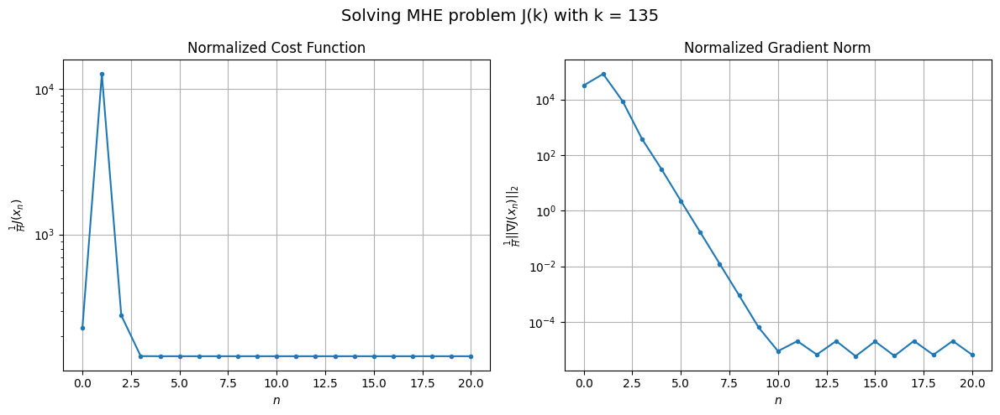

Windows:  33%|███▎      | 127/386 [07:02<17:34,  4.07s/it]

[Gauss-Newton] Before applying the algorithm
Cost function: 2797.81221094419
Gradient norm: 355757.73690592847
Global estimation error: 2670.271158637382
Initial conditions estimation errors: 0.9342307116536241 m, 209.6553714829872 m, 632.4261859867418 m, 2585.8127406293233 m
Position estimation errors: 5.665327089722552 m, 181.44878242269155 m, 709.010545848288 m, 2682.952223824475 m

[Gauss-Newton] Iteration 1
Cost function: 4977.42846476982 (77.90%)
Gradient norm: 126426.54560254353 (-64.46%)
Global estimation error: 1735.3812034239959 (-35.01%)
Initial conditions estimation errors: 2.711237081661629 m, 121.03350806622429 m, 442.1883755739763 m, 1673.7264269830087 m
Position estimation errors: 3.195409288872866 m, 121.84835260933748 m, 458.2799048632599 m, 1786.9833022432877 m

[Gauss-Newton] Iteration 2
Cost function: 1802.4934834199823 (-63.79%)
Gradient norm: 4411.734412995586 (-96.51%)
Global estimation error: 1903.0484771404963 (9.66%)
Initial conditions estimation errors: 2.71

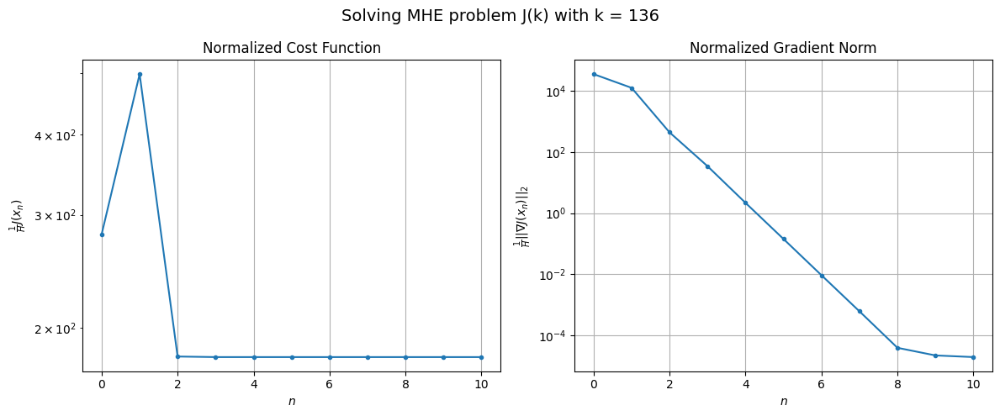

Windows:  33%|███▎      | 128/386 [07:06<16:50,  3.92s/it]

[Gauss-Newton] Before applying the algorithm
Cost function: 3266.0913124785293
Gradient norm: 377402.7794979804
Global estimation error: 1912.4191660105303
Initial conditions estimation errors: 1.136473465230047 m, 132.49725108596587 m, 485.0606466226976 m, 1845.1302841647046 m
Position estimation errors: 6.071049924565878 m, 128.79710190423154 m, 487.062195133947 m, 1893.4199962762875 m

[Gauss-Newton] Iteration 1
Cost function: 34927.36530108022 (969.39%)
Gradient norm: 421926.0302896699 (11.80%)
Global estimation error: 3564.720226557564 (86.40%)
Initial conditions estimation errors: 3.0486518807398904 m, 282.1879584820474 m, 852.1218617266924 m, 3449.851668434916 m
Position estimation errors: 3.4404420542987215 m, 229.39255006792533 m, 956.5982909081213 m, 3594.9052763039044 m

[Gauss-Newton] Iteration 2
Cost function: 2146.283067462792 (-93.86%)
Gradient norm: 404.02009908893166 (-99.90%)
Global estimation error: 3521.3526735699747 (-1.22%)
Initial conditions estimation errors: 3.

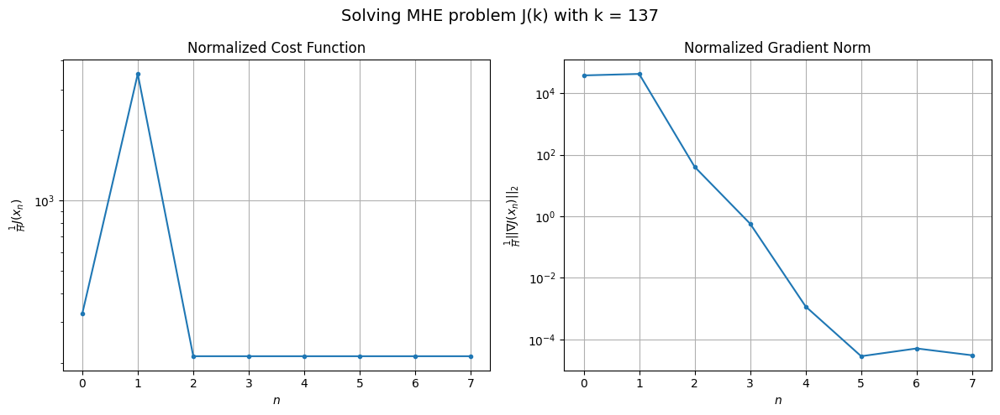

Windows:  33%|███▎      | 129/386 [07:09<15:14,  3.56s/it]

[Gauss-Newton] Before applying the algorithm
Cost function: 3857.110029912029
Gradient norm: 408947.24047798535
Global estimation error: 3604.8072159210046
Initial conditions estimation errors: 1.2475720569730095 m, 276.8183793875214 m, 870.7217112329052 m, 3487.0971973845894 m
Position estimation errors: 6.382754841265974 m, 216.52188345055754 m, 937.6552922571148 m, 3480.684081892255 m

[Gauss-Newton] Iteration 1
Cost function: 55930.375865674214 (1350.06%)
Gradient norm: 522213.76035960007 (27.70%)
Global estimation error: 5561.018633737918 (54.27%)
Initial conditions estimation errors: 3.339935935836687 m, 427.2049380258544 m, 1335.6419108156063 m, 5381.307380439445 m
Position estimation errors: 3.5389954498215386 m, 335.86450784744704 m, 1454.135833664128 m, 5349.306545870457 m

[Gauss-Newton] Iteration 2
Cost function: 2911.9760141370175 (-94.79%)
Gradient norm: 45536.70175300897 (-91.28%)
Global estimation error: 5020.314480130933 (-9.72%)
Initial conditions estimation errors: 3

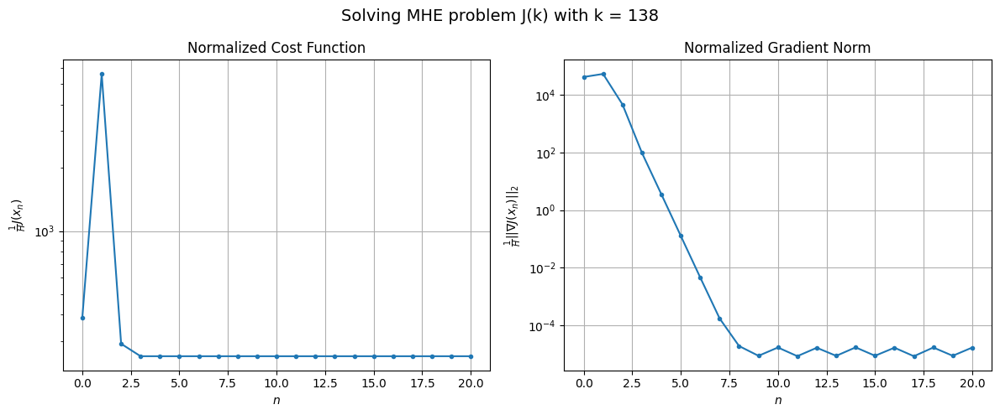

Windows:  34%|███▎      | 130/386 [07:16<19:29,  4.57s/it]

[Gauss-Newton] Before applying the algorithm
Cost function: 4102.679420867012
Gradient norm: 410962.9765988349
Global estimation error: 5164.760757826632
Initial conditions estimation errors: 1.2885955178259343 m, 388.8675076935045 m, 1250.149072701043 m, 4996.064338313814 m
Position estimation errors: 6.489121886420615 m, 285.9138808424292 m, 1309.7220507858353 m, 4732.230180900752 m

[Gauss-Newton] Iteration 1
Cost function: 123910.79696691693 (2920.24%)
Gradient norm: 799136.7939110119 (94.45%)
Global estimation error: 2790.7004266972194 (-45.97%)
Initial conditions estimation errors: 3.6099215039188675 m, 221.00435364367453 m, 669.3001783564421 m, 2700.2203122464043 m
Position estimation errors: 3.5466147384792612 m, 129.75109929382768 m, 686.4575779527845 m, 2393.4701227312166 m

[Gauss-Newton] STOP on Iteration 2 (gradient norm stagnated)
Cost function = 7087.544455461678 (-94.28%)
Gradient norm = 155237.7360575734 (-80.57%)
Global estimation error = 1755.423892639748 (-37.10%)
F

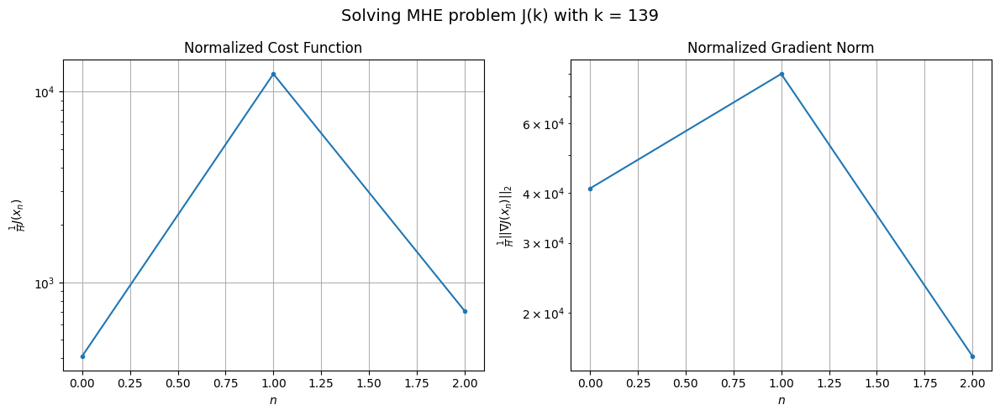

Windows:  34%|███▍      | 131/386 [07:17<15:30,  3.65s/it]

[Gauss-Newton] Before applying the algorithm
Cost function: 8582.661905225272
Gradient norm: 430671.297528404
Global estimation error: 1743.5288350850178
Initial conditions estimation errors: 1.3514745855032833 m, 140.11647379949673 m, 422.4541030833052 m, 1685.7611475203746 m
Position estimation errors: 6.413406858708315 m, 50.77471484488938 m, 407.8721988991047 m, 1273.7954507698907 m



/home/jgaspar/SpaceSim-Toolkit/test/new_newton_based_algorithms/gauss_newton.py:181: LinAlgWarning: Ill-conditioned matrix (rcond=4.89939e-17): result may not be accurate.
  delta_x = solve(HJ_x, -DJ_x)


[Gauss-Newton] Iteration 1
Cost function: 336797916.64228076 (3924066.19%)
Gradient norm: 42661441.36579265 (9805.80%)
Global estimation error: 16334.056670165775 (836.84%)
Initial conditions estimation errors: 3.706616540090154 m, 1105.0979136028097 m, 4093.8477880953537 m, 15774.044896133468 m
Position estimation errors: 3.4965163795757985 m, 1185.88519383027 m, 4319.388927517195 m, 16865.493964081983 m

[Gauss-Newton] Iteration 2
Cost function: 25046508.286635704 (-92.56%)
Gradient norm: 12079223.299290039 (-71.69%)
Global estimation error: 6232.022054195349 (-61.85%)
Initial conditions estimation errors: 3.706616563301252 m, 432.1363181021521 m, 1547.3035114692934 m, 6021.394306271496 m
Position estimation errors: 3.4965162109403254 m, 411.6714240985048 m, 1571.8555093923562 m, 6061.43072410183 m

[Gauss-Newton] Iteration 3
Cost function: 430878.0757002801 (-98.28%)
Gradient norm: 1471653.1046584079 (-87.82%)
Global estimation error: 2618.757743830457 (-57.98%)
Initial conditions e

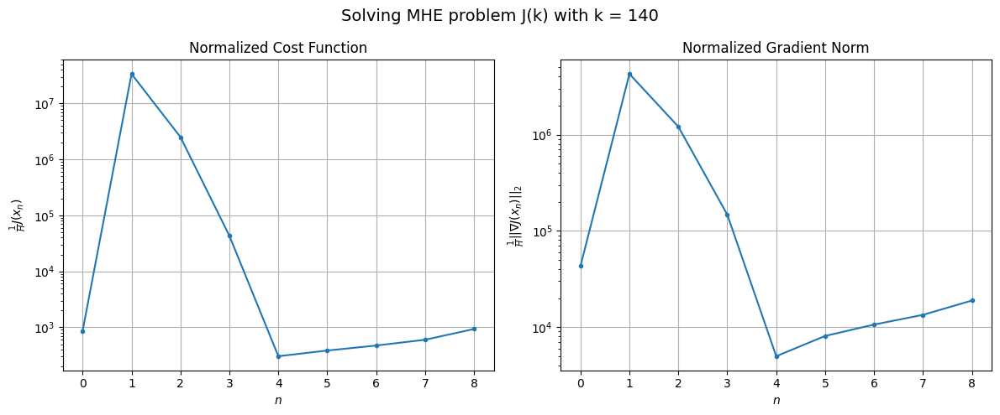

Windows:  34%|███▍      | 132/386 [07:21<15:20,  3.62s/it]

[Gauss-Newton] Before applying the algorithm
Cost function: 10330.033130762054
Gradient norm: 415853.69635566976
Global estimation error: 3543.457799806503
Initial conditions estimation errors: 1.329738829987483 m, 241.16487893179584 m, 884.3726708578218 m, 3422.8371416593654 m
Position estimation errors: 6.200070368402273 m, 243.65535231596922 m, 879.553939122111 m, 3445.239021076155 m

[Gauss-Newton] Iteration 1
Cost function: 3870056.2748316256 (37364.12%)
Gradient norm: 4130476.1772371125 (893.25%)
Global estimation error: 9856.98800251183 (178.17%)
Initial conditions estimation errors: 3.600479564111551 m, 688.7380979794448 m, 2428.50648768926 m, 9528.283790671003 m
Position estimation errors: 3.421850665314272 m, 541.650746980559 m, 2299.949626269087 m, 8510.459387004483 m

[Gauss-Newton] Iteration 2
Cost function: 95081.44516438042 (-97.54%)
Gradient norm: 686264.1854181308 (-83.39%)
Global estimation error: 7438.640559076439 (-24.53%)
Initial conditions estimation errors: 3.600

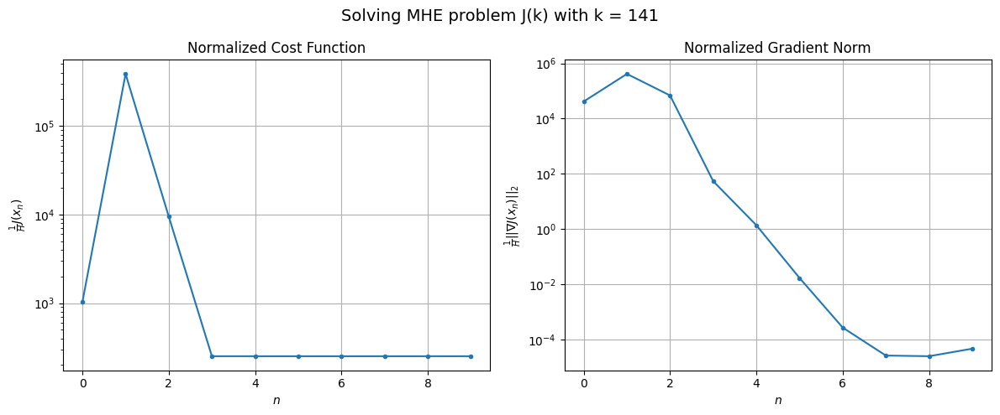

Windows:  34%|███▍      | 133/386 [07:24<14:44,  3.50s/it]

[Gauss-Newton] Before applying the algorithm
Cost function: 3540.049345523784
Gradient norm: 351153.4194103669
Global estimation error: 7418.978474426462
Initial conditions estimation errors: 1.2037544398676805 m, 513.6195449432352 m, 1829.7155778478382 m, 7171.44163614422 m
Position estimation errors: 5.9173216256992145 m, 365.0853702880223 m, 1650.8190993655878 m, 5980.493804086103 m

[Gauss-Newton] Iteration 1
Cost function: 372835.38083697663 (10431.93%)
Gradient norm: 1301605.9440742664 (270.67%)
Global estimation error: 10878.08837970634 (46.63%)
Initial conditions estimation errors: 3.520583593404252 m, 749.4258987280864 m, 2679.186564929328 m, 10516.326010509609 m
Position estimation errors: 3.1976083768295953 m, 546.7336521680638 m, 2440.452406233684 m, 8862.505471369337 m

[Gauss-Newton] Iteration 2
Cost function: 2272.450325301128 (-99.39%)
Gradient norm: 16672.1843793267 (-98.72%)
Global estimation error: 10426.3964401536 (-4.15%)
Initial conditions estimation errors: 3.520

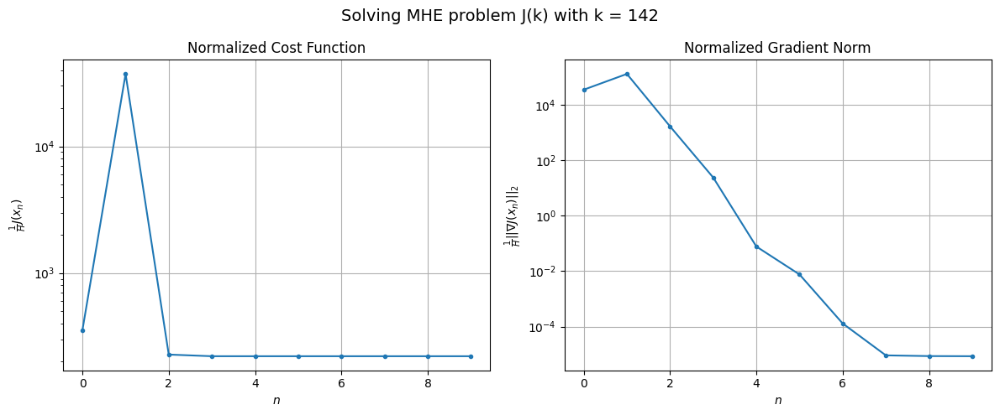

Windows:  35%|███▍      | 134/386 [07:28<14:50,  3.53s/it]

[Gauss-Newton] Before applying the algorithm
Cost function: 3030.0710170093053
Gradient norm: 317564.9818333292
Global estimation error: 10477.2185070331
Initial conditions estimation errors: 1.1959361863881868 m, 712.6736124404458 m, 2595.3714443674803 m, 10125.6233411987 m
Position estimation errors: 5.396379782573313 m, 497.1054780419276 m, 2282.157004630369 m, 8200.400777100942 m

[Gauss-Newton] Iteration 1
Cost function: 9873175.7682757 (325739.75%)
Gradient norm: 6867399.392331181 (2062.52%)
Global estimation error: 3049.619732458144 (-70.89%)
Initial conditions estimation errors: 3.361595188015881 m, 211.95717426363288 m, 765.1641127289744 m, 2944.4464625961496 m
Position estimation errors: 2.8962977171913695 m, 64.86539437122889 m, 577.9986228830337 m, 1712.688308085522 m



/home/jgaspar/SpaceSim-Toolkit/test/new_newton_based_algorithms/gauss_newton.py:181: LinAlgWarning: Ill-conditioned matrix (rcond=2.9738e-17): result may not be accurate.
  delta_x = solve(HJ_x, -DJ_x)


[Gauss-Newton] Iteration 2
Cost function: 143312776.61974227 (1351.54%)
Gradient norm: 28577401.747130733 (316.13%)
Global estimation error: 11350.134507141378 (272.18%)
Initial conditions estimation errors: 3.3615952355240277 m, 762.1922465435919 m, 2878.4456394057397 m, 10952.582806552735 m
Position estimation errors: 2.8962976964806146 m, 1145.1155640716083 m, 3092.978527391603 m, 13647.872188145759 m

[Gauss-Newton] Iteration 3
Cost function: 11236342.503762158 (-92.16%)
Gradient norm: 7852109.38017857 (-72.52%)
Global estimation error: 3197.099561467357 (-71.83%)
Initial conditions estimation errors: 3.3615952618303195 m, 211.89259561826827 m, 865.6313596643628 m, 3070.3727177908136 m
Position estimation errors: 2.896297664316327 m, 499.2110895976163 m, 1049.4630809563166 m, 5227.1212237422715 m



/home/jgaspar/SpaceSim-Toolkit/test/new_newton_based_algorithms/gauss_newton.py:181: LinAlgWarning: Ill-conditioned matrix (rcond=6.73898e-17): result may not be accurate.
  delta_x = solve(HJ_x, -DJ_x)


[Gauss-Newton] Iteration 4
Cost function: 5277.373328463434 (-99.95%)
Gradient norm: 133665.71708209204 (-98.30%)
Global estimation error: 4005.8871868935034 (25.30%)
Initial conditions estimation errors: 3.361595211743412 m, 264.4989367191011 m, 1040.8966708654682 m, 3859.23076905575 m
Position estimation errors: 2.896297718278848 m, 558.6234453722208 m, 1249.589408510978 m, 6043.80614916104 m

[Gauss-Newton] Iteration 5
Cost function: 8005.594602985099 (51.70%)
Gradient norm: 187898.4269611938 (40.57%)
Global estimation error: 2897.7633687768903 (-27.66%)
Initial conditions estimation errors: 3.3615952126502773 m, 189.6213675563186 m, 769.4143598897302 m, 2787.29981186495 m
Position estimation errors: 2.896297720153653 m, 463.8142355775898 m, 965.0269835039787 m, 4847.520971150972 m



/home/jgaspar/SpaceSim-Toolkit/test/new_newton_based_algorithms/gauss_newton.py:181: LinAlgWarning: Ill-conditioned matrix (rcond=7.4269e-17): result may not be accurate.
  delta_x = solve(HJ_x, -DJ_x)


[Gauss-Newton] STOP on Iteration 6 (gradient norm stagnated)
Cost function = 3882.9984693149927 (-51.50%)
Gradient norm = 106363.94900574155 (-43.39%)
Global estimation error = 3756.174887822268 (29.62%)
Final initial conditions estimation errors: 3.3615952139867504 m, 247.70593978496746 m, 978.4408917862283 m, 3618.024739555186 m
Final position estimation errors: 2.896297720669199 m, 532.1282607306391 m, 1180.5527384220786 m, 5736.21148038119 m



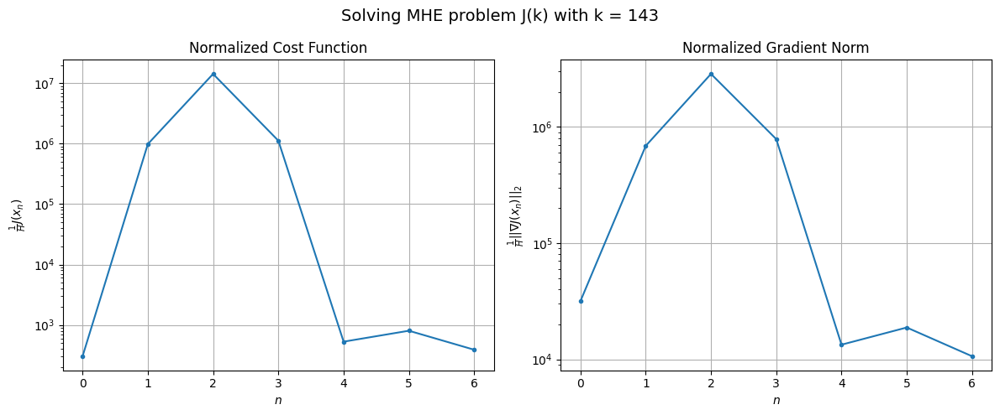

Windows:  35%|███▍      | 135/386 [07:30<13:46,  3.29s/it]

[Gauss-Newton] Before applying the algorithm
Cost function: 4613.40309219375
Gradient norm: 275365.8602784629
Global estimation error: 4067.707906664192
Initial conditions estimation errors: 1.1249817001989524 m, 284.6264748542329 m, 1012.5634922648055 m, 3929.3665723427503 m
Position estimation errors: 4.789346370828632 m, 555.0347298824215 m, 1184.7757816645121 m, 5860.083410456267 m

[Gauss-Newton] Iteration 1
Cost function: 4891675.130729909 (105931.82%)
Gradient norm: 5431376.5990008265 (1872.42%)
Global estimation error: 1693.1160348763322 (-58.38%)
Initial conditions estimation errors: 3.0577964433375526 m, 111.58297680060069 m, 441.68924069817336 m, 1630.6719500173692 m
Position estimation errors: 2.5458460500477145 m, 64.49706049723835 m, 323.5712338741017 m, 979.8263524310727 m



/home/jgaspar/SpaceSim-Toolkit/test/new_newton_based_algorithms/gauss_newton.py:181: LinAlgWarning: Ill-conditioned matrix (rcond=1.49803e-17): result may not be accurate.
  delta_x = solve(HJ_x, -DJ_x)


[Gauss-Newton] Iteration 2
Cost function: 501243049.8404665 (10146.86%)
Gradient norm: 52653604.034153335 (869.43%)
Global estimation error: 18794.8253837663 (1010.07%)
Initial conditions estimation errors: 3.0577964210756297 m, 1295.2922658971586 m, 4655.331623779799 m, 18163.024202765977 m
Position estimation errors: 2.545846101654817 m, 1646.0523718332108 m, 4675.824110838472 m, 20157.143219330574 m

[Gauss-Newton] Iteration 3
Cost function: 104092745.34850258 (-79.23%)
Gradient norm: 24609021.591494568 (-53.26%)
Global estimation error: 5072.914663165573 (-73.01%)
Initial conditions estimation errors: 3.0577964758398233 m, 350.2348820322647 m, 1249.1459381208756 m, 4904.2241568190875 m
Position estimation errors: 2.5458460322243397 m, 452.20978943666137 m, 1267.548036174476 m, 5537.609676517585 m



/home/jgaspar/SpaceSim-Toolkit/test/new_newton_based_algorithms/gauss_newton.py:181: LinAlgWarning: Ill-conditioned matrix (rcond=5.29084e-17): result may not be accurate.
  delta_x = solve(HJ_x, -DJ_x)


[Gauss-Newton] Iteration 4
Cost function: 64844.0536244079 (-99.94%)
Gradient norm: 447985.29533674294 (-98.18%)
Global estimation error: 1674.117031250791 (-67.00%)
Initial conditions estimation errors: 3.0577964452184667 m, 122.78244831723968 m, 421.95011246630537 m, 1615.403848737367 m
Position estimation errors: 2.5458460881883136 m, 311.2149079506095 m, 546.3423889437652 m, 3004.8588942624547 m



/home/jgaspar/SpaceSim-Toolkit/test/new_newton_based_algorithms/gauss_newton.py:181: LinAlgWarning: Ill-conditioned matrix (rcond=3.51723e-17): result may not be accurate.
  delta_x = solve(HJ_x, -DJ_x)


[Gauss-Newton] Iteration 5
Cost function: 343629.66350064223 (429.93%)
Gradient norm: 1381244.2737742986 (208.32%)
Global estimation error: 1471.5844842242343 (-12.10%)
Initial conditions estimation errors: 3.05779645165593 m, 92.15442578721527 m, 388.0054630780576 m, 1416.512388571912 m
Position estimation errors: 2.5458460727634593 m, 50.51182972209835 m, 217.06029231238864 m, 275.861362979073 m



/home/jgaspar/SpaceSim-Toolkit/test/new_newton_based_algorithms/gauss_newton.py:181: LinAlgWarning: Ill-conditioned matrix (rcond=1.40403e-17): result may not be accurate.
  delta_x = solve(HJ_x, -DJ_x)


[Gauss-Newton] Iteration 6
Cost function: 447270289.25846434 (130060.56%)
Gradient norm: 49374760.86090483 (3474.66%)
Global estimation error: 18511.191872110514 (1157.91%)
Initial conditions estimation errors: 3.057796424934196 m, 1275.8281018667456 m, 4588.6320887041875 m, 17888.008021715323 m
Position estimation errors: 2.545846099041735 m, 1613.6412430075359 m, 4595.236531284056 m, 19781.5295233453 m

[Gauss-Newton] Iteration 7
Cost function: 92444033.25851314 (-79.33%)
Gradient norm: 23178838.6422149 (-53.06%)
Global estimation error: 5137.739790107732 (-72.25%)
Initial conditions estimation errors: 3.0577964622829 m, 355.075025866379 m, 1266.0709112332665 m, 4966.622287908269 m
Position estimation errors: 2.5458460456488683 m, 465.483802440722 m, 1287.0115609591946 m, 5652.005621037121 m



/home/jgaspar/SpaceSim-Toolkit/test/new_newton_based_algorithms/gauss_newton.py:181: LinAlgWarning: Ill-conditioned matrix (rcond=5.94321e-17): result may not be accurate.
  delta_x = solve(HJ_x, -DJ_x)


[Gauss-Newton] Iteration 8
Cost function: 201465.14690636526 (-99.78%)
Gradient norm: 878297.4232419184 (-96.21%)
Global estimation error: 1152.27792890612 (-77.57%)
Initial conditions estimation errors: 3.0577964487469207 m, 86.9282029270959 m, 307.3215785279064 m, 1107.1232926724888 m
Position estimation errors: 2.545846080505823 m, 268.58826535759886 m, 420.7925793516765 m, 2475.3798636269453 m



/home/jgaspar/SpaceSim-Toolkit/test/new_newton_based_algorithms/gauss_newton.py:181: LinAlgWarning: Ill-conditioned matrix (rcond=2.56942e-17): result may not be accurate.
  delta_x = solve(HJ_x, -DJ_x)


[Gauss-Newton] Iteration 9
Cost function: 3544.158788278833 (-98.24%)
Gradient norm: 103284.01174203891 (-88.24%)
Global estimation error: 306.82385238641024 (-73.37%)
Initial conditions estimation errors: 3.0577964518646157 m, 27.23823694667065 m, 140.38796231442194 m, 271.42791929407906 m
Position estimation errors: 2.5458460756550703 m, 196.53277710335544 m, 210.8428898322438 m, 1593.8764265340972 m



/home/jgaspar/SpaceSim-Toolkit/test/new_newton_based_algorithms/gauss_newton.py:181: LinAlgWarning: Ill-conditioned matrix (rcond=1.62646e-17): result may not be accurate.
  delta_x = solve(HJ_x, -DJ_x)


[Gauss-Newton] Iteration 10
Cost function: 3488272.049830328 (98323.13%)
Gradient norm: 4401469.153551966 (4161.52%)
Global estimation error: 5869.8283468010595 (1813.09%)
Initial conditions estimation errors: 3.0577964470590664 m, 412.20667396445197 m, 1456.8141448151762 m, 5671.210132153761 m
Position estimation errors: 2.545846082540223 m, 659.9320285898017 m, 1579.7778666283982 m, 7378.652284037415 m

[Gauss-Newton] Iteration 11
Cost function: 5718966.986641885 (63.95%)
Gradient norm: 5755070.84969118 (30.75%)
Global estimation error: 695.446503393248 (-88.15%)
Initial conditions estimation errors: 3.057796443182129 m, 48.90061395309857 m, 217.37430650964492 m, 658.779483215428 m
Position estimation errors: 2.54584607616108 m, 119.36387587510755 m, 167.72560803273137 m, 988.6714652840606 m



/home/jgaspar/SpaceSim-Toolkit/test/new_newton_based_algorithms/gauss_newton.py:181: LinAlgWarning: Ill-conditioned matrix (rcond=1.11003e-17): result may not be accurate.
  delta_x = solve(HJ_x, -DJ_x)


[Gauss-Newton] Iteration 12
Cost function: 358464813.0183194 (6168.00%)
Gradient norm: 44723441.61120554 (677.11%)
Global estimation error: 18204.034531780708 (2517.60%)
Initial conditions estimation errors: 3.057796433380716 m, 1257.570920071077 m, 4505.668748352181 m, 17592.73180324223 m
Position estimation errors: 2.545846100790532 m, 1643.5158034052279 m, 4561.117603093524 m, 19843.302163826538 m

[Gauss-Newton] Iteration 13
Cost function: 89128781.0540485 (-75.14%)
Gradient norm: 22756500.68263466 (-49.12%)
Global estimation error: 5321.11937122179 (-70.77%)
Initial conditions estimation errors: 3.057796458467687 m, 368.9430175221993 m, 1312.2135293376205 m, 5143.565558974274 m
Position estimation errors: 2.5458460524919246 m, 498.6641873930076 m, 1349.3060964883464 m, 5979.330429105423 m



/home/jgaspar/SpaceSim-Toolkit/test/new_newton_based_algorithms/gauss_newton.py:181: LinAlgWarning: Ill-conditioned matrix (rcond=6.53862e-17): result may not be accurate.
  delta_x = solve(HJ_x, -DJ_x)


[Gauss-Newton] Iteration 14
Cost function: 442026.1220706761 (-99.50%)
Gradient norm: 1381058.3750358748 (-93.93%)
Global estimation error: 852.2882358395492 (-83.98%)
Initial conditions estimation errors: 3.057796444384001 m, 66.28462253113655 m, 248.90608778024153 m, 812.4215398448067 m
Position estimation errors: 2.545846084134757 m, 242.88852239243548 m, 345.40082308625153 m, 2160.5961147821645 m



/home/jgaspar/SpaceSim-Toolkit/test/new_newton_based_algorithms/gauss_newton.py:181: LinAlgWarning: Ill-conditioned matrix (rcond=2.12859e-17): result may not be accurate.
  delta_x = solve(HJ_x, -DJ_x)


[Gauss-Newton] Iteration 15
Cost function: 9301.397685197404 (-97.90%)
Gradient norm: 207538.23238171186 (-84.97%)
Global estimation error: 2012.3517721858234 (136.11%)
Initial conditions estimation errors: 3.0577964511263183 m, 146.98296428961999 m, 509.58654866498415 m, 1941.1993123794784 m
Position estimation errors: 2.545846076938674 m, 342.3478305727172 m, 638.1236221165503 m, 3406.0254323170498 m



/home/jgaspar/SpaceSim-Toolkit/test/new_newton_based_algorithms/gauss_newton.py:181: LinAlgWarning: Ill-conditioned matrix (rcond=4.28201e-17): result may not be accurate.
  delta_x = solve(HJ_x, -DJ_x)


[Gauss-Newton] Iteration 16
Cost function: 789450.898779998 (8387.44%)
Gradient norm: 2106252.837437935 (914.87%)
Global estimation error: 1827.5574883319493 (-9.18%)
Initial conditions estimation errors: 3.0577964490055716 m, 116.8508284126509 m, 473.68737890312775 m, 1761.226925952584 m
Position estimation errors: 2.545846074998522 m, 28.66014545746226 m, 305.478583825414 m, 640.2960835462485 m



/home/jgaspar/SpaceSim-Toolkit/test/new_newton_based_algorithms/gauss_newton.py:181: LinAlgWarning: Ill-conditioned matrix (rcond=1.60392e-17): result may not be accurate.
  delta_x = solve(HJ_x, -DJ_x)


[Gauss-Newton] Iteration 17
Cost function: 401428893.12212664 (50749.13%)
Gradient norm: 46732092.87069932 (2118.73%)
Global estimation error: 17612.87146306943 (863.74%)
Initial conditions estimation errors: 3.0577964228570784 m, 1213.8685599906858 m, 4367.104780796624 m, 17019.637437904858 m
Position estimation errors: 2.5458460965354552 m, 1532.6705909883385 m, 4371.689568218637 m, 18813.025604369246 m

[Gauss-Newton] Iteration 18
Cost function: 76768613.25709309 (-80.88%)
Gradient norm: 21093797.708663896 (-54.86%)
Global estimation error: 4794.82491064797 (-72.78%)
Initial conditions estimation errors: 3.0577964603800236 m, 331.5450786080251 m, 1182.7843489831691 m, 4634.806009275461 m
Position estimation errors: 2.545846048457071 m, 436.036419349571 m, 1203.5648495872726 m, 5295.801577047597 m



/home/jgaspar/SpaceSim-Toolkit/test/new_newton_based_algorithms/gauss_newton.py:181: LinAlgWarning: Ill-conditioned matrix (rcond=5.49824e-17): result may not be accurate.
  delta_x = solve(HJ_x, -DJ_x)


[Gauss-Newton] Iteration 19
Cost function: 141295.82493550912 (-99.82%)
Gradient norm: 719200.2315693703 (-96.59%)
Global estimation error: 1138.885501693956 (-76.25%)
Initial conditions estimation errors: 3.05779644659173 m, 86.1230882398746 m, 303.51004047234835 m, 1094.3057192547062 m
Position estimation errors: 2.5458460824558404 m, 271.28678166816445 m, 420.2905060001051 m, 2487.329607645515 m



/home/jgaspar/SpaceSim-Toolkit/test/new_newton_based_algorithms/gauss_newton.py:181: LinAlgWarning: Ill-conditioned matrix (rcond=2.60611e-17): result may not be accurate.
  delta_x = solve(HJ_x, -DJ_x)


[Gauss-Newton] STOP on Iteration 20 (max iteration reached)
Cost function = 5541.5683238014135 (-96.08%)
Gradient norm = 149090.7539929137 (-79.27%)
Global estimation error = 191.91149515077052 (-83.15%)
Final initial conditions estimation errors: 3.057796452699082 m, 16.54330233698975 m, 127.36105813369389 m, 142.5446586720057 m
Final position estimation errors: 2.545846075171358 m, 181.82494945173156 m, 170.86817200272898 m, 1418.552359635654 m



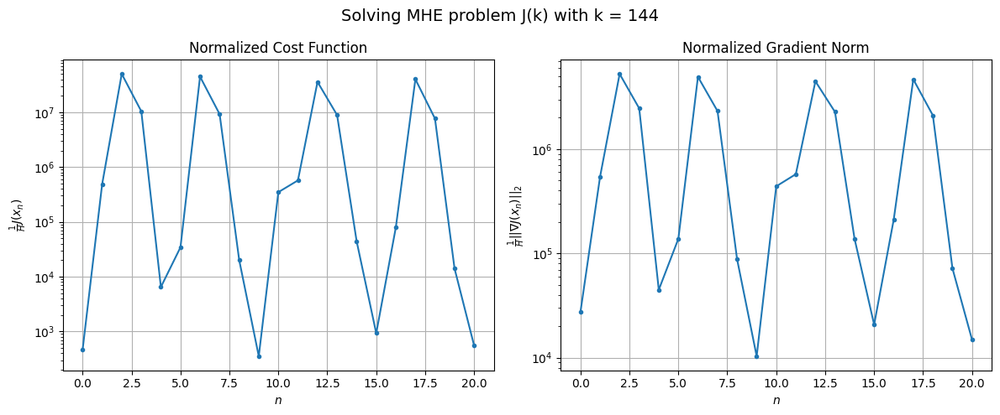

Windows:  35%|███▌      | 136/386 [07:37<18:09,  4.36s/it]

[Gauss-Newton] Before applying the algorithm
Cost function: 5869.079152745212
Gradient norm: 244851.64341282417
Global estimation error: 293.08260705921975
Initial conditions estimation errors: 0.9966203517003939 m, 34.90648886059527 m, 115.3702476384301 m, 267.13396807073883 m
Position estimation errors: 4.141281320414675 m, 198.6239747854764 m, 187.59598891375683 m, 1544.2342801698314 m



/home/jgaspar/SpaceSim-Toolkit/test/new_newton_based_algorithms/gauss_newton.py:181: LinAlgWarning: Ill-conditioned matrix (rcond=1.81391e-17): result may not be accurate.
  delta_x = solve(HJ_x, -DJ_x)


[Gauss-Newton] Iteration 1
Cost function: 3044558959.251396 (51874459.54%)
Gradient norm: 128762164.39878339 (52487.83%)
Global estimation error: 34953.9459177466 (11826.31%)
Initial conditions estimation errors: 2.7959778432793896 m, 2450.535895800278 m, 8544.853877019761 m, 33804.70974689962 m
Position estimation errors: 2.180912393049856 m, 3020.016381156356 m, 8289.970241362646 m, 36033.55053137402 m

[Gauss-Newton] Iteration 2
Cost function: 922666842.1573111 (-69.69%)
Gradient norm: 73523739.50864029 (-42.90%)
Global estimation error: 10574.296993659242 (-69.75%)
Initial conditions estimation errors: 2.795977897992402 m, 751.6729993000384 m, 2561.784983416335 m, 10231.712663101132 m
Position estimation errors: 2.1809123956634484 m, 1041.4367811479906 m, 2570.599037529806 m, 11616.528361934754 m

[Gauss-Newton] Iteration 3
Cost function: 2810205.0948942313 (-99.70%)
Gradient norm: 4359783.949035484 (-94.07%)
Global estimation error: 10668.221353186183 (0.89%)
Initial conditions es

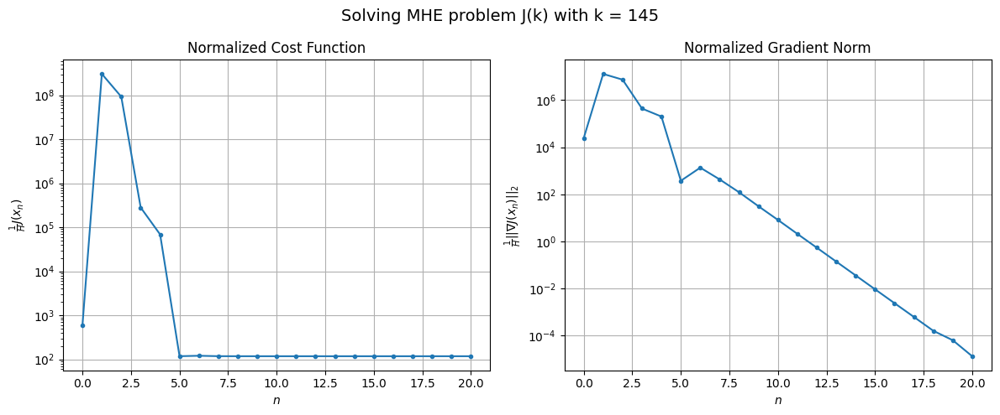

Windows:  35%|███▌      | 137/386 [07:44<20:47,  5.01s/it]

[Gauss-Newton] Before applying the algorithm
Cost function: 1466.6521662523678
Gradient norm: 191452.68191528888
Global estimation error: 7200.6781193465995
Initial conditions estimation errors: 0.9128500490187292 m, 532.7422538783311 m, 1700.6489681566466 m, 6976.655378679428 m
Position estimation errors: 3.5123536631782026 m, 765.944090303177 m, 1714.9231569983265 m, 8129.1896570164145 m

[Gauss-Newton] Iteration 1
Cost function: 370654.68072423124 (25172.16%)
Gradient norm: 1561906.6675222332 (715.82%)
Global estimation error: 4511.267733887742 (-37.35%)
Initial conditions estimation errors: 2.367087145085423 m, 319.80801833658774 m, 1077.8595282452497 m, 4368.9208093363695 m
Position estimation errors: 1.8886639807637855 m, 390.02353519053463 m, 1020.3113981429109 m, 4476.624001412779 m

[Gauss-Newton] Iteration 2
Cost function: 1066.7136551082117 (-99.71%)
Gradient norm: 26774.71298085541 (-98.29%)
Global estimation error: 4936.7684790756875 (9.43%)
Initial conditions estimation e

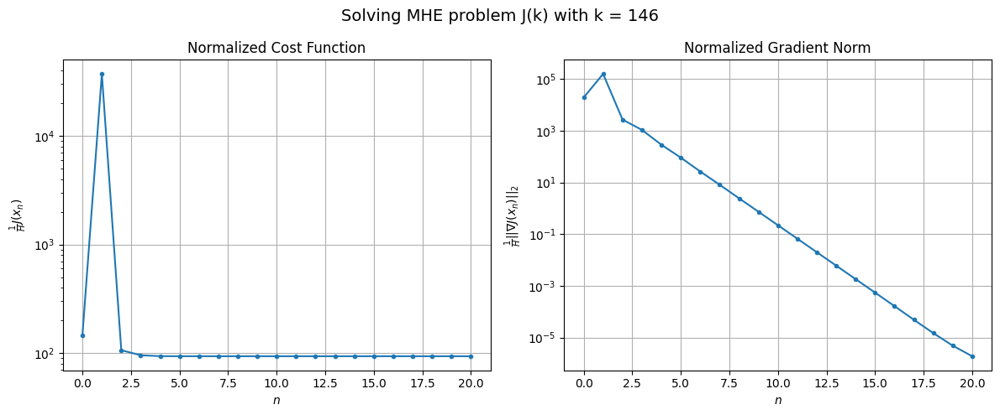

Windows:  36%|███▌      | 138/386 [07:50<22:23,  5.42s/it]

[Gauss-Newton] Before applying the algorithm
Cost function: 1103.057465573795
Gradient norm: 168841.39644264887
Global estimation error: 4849.05297389732
Initial conditions estimation errors: 0.7233972344657987 m, 351.259910421274 m, 1150.4331465666846 m, 4697.492060737747 m
Position estimation errors: 3.0310487338639374 m, 407.2103665204519 m, 1047.5825653440415 m, 4621.798729948715 m

[Gauss-Newton] Iteration 1
Cost function: 1063808.7771468898 (96341.83%)
Gradient norm: 2553216.078278723 (1412.20%)
Global estimation error: 1028.6781743206134 (-78.79%)
Initial conditions estimation errors: 2.0639826290801313 m, 51.517430505045574 m, 281.5770993216834 m, 988.0446438994139 m
Position estimation errors: 1.5959987430643197 m, 85.94645525485286 m, 183.62826075220505 m, 370.7844070544206 m



/home/jgaspar/SpaceSim-Toolkit/test/new_newton_based_algorithms/gauss_newton.py:181: LinAlgWarning: Ill-conditioned matrix (rcond=5.09083e-17): result may not be accurate.
  delta_x = solve(HJ_x, -DJ_x)


[Gauss-Newton] Iteration 2
Cost function: 2288555.548088451 (115.13%)
Gradient norm: 3578380.340334865 (40.15%)
Global estimation error: 6086.49785950092 (491.68%)
Initial conditions estimation errors: 2.0639826479819687 m, 429.8028269197562 m, 1466.6853263842713 m, 5891.48144960163 m
Position estimation errors: 1.5959987391983657 m, 414.9745824075737 m, 1287.6569621114108 m, 5314.4518518915675 m

[Gauss-Newton] STOP on Iteration 3 (gradient norm stagnated)
Cost function = 1491523.4249702345 (-34.83%)
Gradient norm = 2892718.031604987 (-19.16%)
Global estimation error = 1556.5114053574068 (-74.43%)
Final initial conditions estimation errors: 2.06398262628975 m, 89.81244468952845 m, 407.4939387746071 m, 1499.5345487384136 m
Final position estimation errors: 1.5959987488509535 m, 49.38710565041414 m, 298.1782894200989 m, 687.5437027531801 m



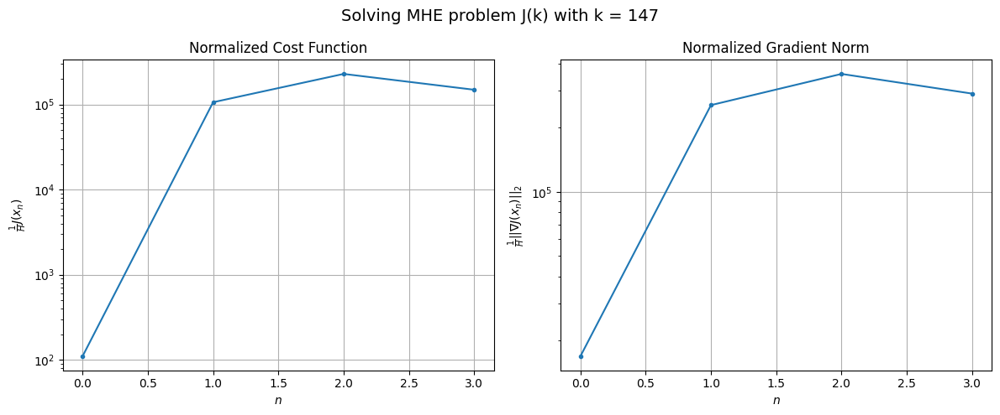

Windows:  36%|███▌      | 139/386 [07:52<18:00,  4.38s/it]

[Gauss-Newton] Before applying the algorithm
Cost function: 1503660.7742889689
Gradient norm: 2858233.5949383196
Global estimation error: 1478.323917538542
Initial conditions estimation errors: 0.616918033044941 m, 77.34675142291515 m, 399.57513143712697 m, 1421.1953107704514 m
Position estimation errors: 2.614879986206515 m, 58.47494273988183 m, 281.6686393009596 m, 602.9665464109002 m



/home/jgaspar/SpaceSim-Toolkit/test/new_newton_based_algorithms/gauss_newton.py:181: LinAlgWarning: Ill-conditioned matrix (rcond=9.05428e-17): result may not be accurate.
  delta_x = solve(HJ_x, -DJ_x)


[Gauss-Newton] Iteration 1
Cost function: 625341626.3965461 (41487.95%)
Gradient norm: 58710260.001387335 (1954.07%)
Global estimation error: 20688.664211226336 (1299.47%)
Initial conditions estimation errors: 1.6501976892858006 m, 1627.779175477796 m, 4685.441154522668 m, 20085.260155123193 m
Position estimation errors: 1.4457673707781948 m, 2198.1048424109053 m, 4339.700895838036 m, 21799.3103310038 m

[Gauss-Newton] Iteration 2
Cost function: 60438664.050581925 (-90.34%)
Gradient norm: 18151493.796428103 (-69.08%)
Global estimation error: 6984.362225787262 (-66.24%)
Initial conditions estimation errors: 1.6501977238278607 m, 588.3015453136154 m, 1534.0902896761977 m, 6788.35416253675 m
Position estimation errors: 1.4457673675807885 m, 873.991158440184 m, 1472.8566916198688 m, 8118.753705754129 m

[Gauss-Newton] Iteration 3
Cost function: 289944.38662649953 (-99.52%)
Gradient norm: 1343778.143267986 (-92.60%)
Global estimation error: 3663.6011937081043 (-47.55%)
Initial conditions es

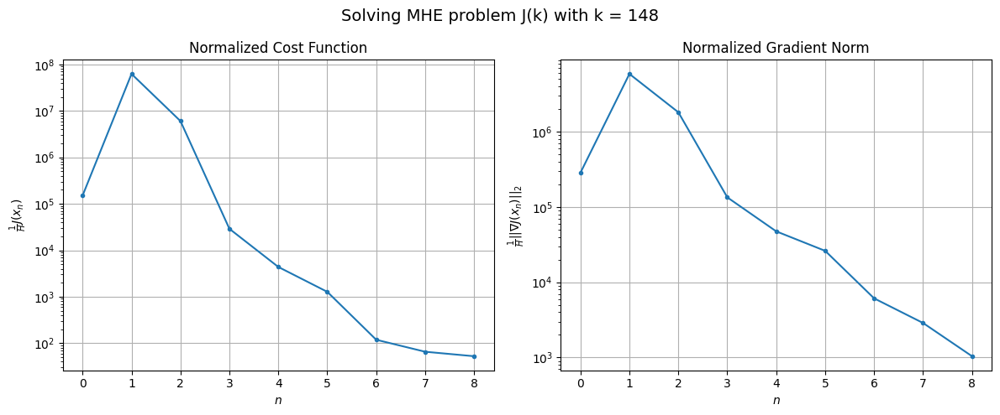

Windows:  36%|███▋      | 140/386 [07:55<16:35,  4.05s/it]

[Gauss-Newton] Before applying the algorithm
Cost function: 640.5814603165788
Gradient norm: 124189.9233495354
Global estimation error: 4893.584045924067
Initial conditions estimation errors: 0.42823548524996463 m, 407.336292508446 m, 1077.4945645492007 m, 4756.0740913419195 m
Position estimation errors: 2.404335412177776 m, 547.9273977798593 m, 977.5271055551765 m, 5143.871166555704 m

[Gauss-Newton] Iteration 1
Cost function: 1985551.0904224874 (309860.75%)
Gradient norm: 3394020.5810534586 (2632.93%)
Global estimation error: 401.6563924560179 (-91.79%)
Initial conditions estimation errors: 1.3516446284511088 m, 43.356455812311566 m, 92.86555066166451 m, 388.3583034021614 m
Position estimation errors: 1.3835662906431987 m, 46.14603159575737 m, 77.04611131938314 m, 418.5749917908816 m



/home/jgaspar/SpaceSim-Toolkit/test/new_newton_based_algorithms/gauss_newton.py:181: LinAlgWarning: Ill-conditioned matrix (rcond=6.62958e-17): result may not be accurate.
  delta_x = solve(HJ_x, -DJ_x)


[Gauss-Newton] Iteration 2
Cost function: 15689584.743438635 (690.19%)
Gradient norm: 9357729.784923691 (175.71%)
Global estimation error: 8496.998322318816 (2015.49%)
Initial conditions estimation errors: 1.351644632408357 m, 708.7788142249613 m, 1903.4994647241194 m, 8250.653776559948 m
Position estimation errors: 1.3835662974857983 m, 870.217004612795 m, 1688.9394842290176 m, 8546.302279783686 m

[Gauss-Newton] STOP on Iteration 3 (gradient norm stagnated)
Cost function = 4848033.973669688 (-69.10%)
Gradient norm = 5184190.247160716 (-44.60%)
Global estimation error = 2255.997404475257 (-73.45%)
Final initial conditions estimation errors: 1.3516446152744546 m, 205.3456022807243 m, 509.17576276881533 m, 2188.171585522815 m
Final position estimation errors: 1.3835662863692109 m, 229.95100776718974 m, 438.1915085050636 m, 2216.7878366382706 m



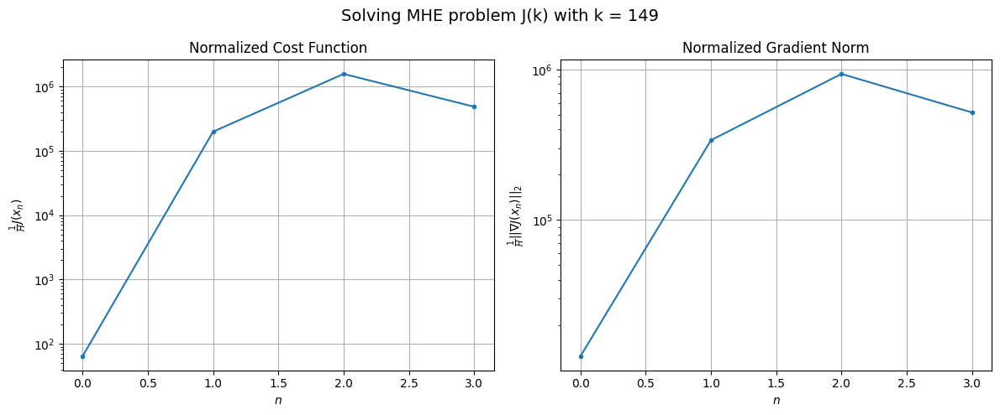

Windows:  37%|███▋      | 141/386 [07:57<13:57,  3.42s/it]

[Gauss-Newton] Before applying the algorithm
Cost function: 4861411.798670427
Gradient norm: 5141637.794419365
Global estimation error: 2298.179008707185
Initial conditions estimation errors: 0.3767649525440098 m, 212.738827967484 m, 509.5619496271872 m, 2230.8551891636284 m
Position estimation errors: 2.364504706200167 m, 226.77852605712113 m, 420.9424835918341 m, 2170.328903943389 m

[Gauss-Newton] Iteration 1
Cost function: 3093.9966069348975 (-99.94%)
Gradient norm: 117099.70457639427 (-97.72%)
Global estimation error: 3198.057362575848 (39.16%)
Initial conditions estimation errors: 1.2670063855721219 m, 279.68426893228593 m, 697.5599882131629 m, 3108.4972594939204 m
Position estimation errors: 1.310373600740126 m, 310.19284807062786 m, 581.3581310771007 m, 2961.408545602605 m

[Gauss-Newton] Iteration 2
Cost function: 2390.8040576416665 (-22.73%)
Gradient norm: 107251.10945854413 (-8.41%)
Global estimation error: 2313.9528476331307 (-27.65%)
Initial conditions estimation errors: 1

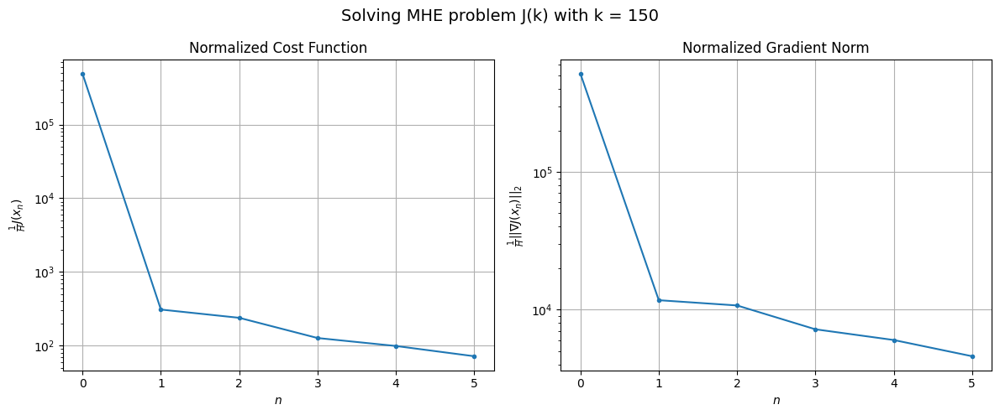

Windows:  37%|███▋      | 142/386 [08:00<12:41,  3.12s/it]

[Gauss-Newton] Before applying the algorithm
Cost function: 949.5147278807242
Gradient norm: 146771.83565670514
Global estimation error: 2990.2159639538827
Initial conditions estimation errors: 0.47670614496782465 m, 266.82580305123764 m, 644.4044426645602 m, 2907.7375715944468 m
Position estimation errors: 2.339335577874576 m, 278.2686662022923 m, 513.2584273867697 m, 2629.3837037622784 m

[Gauss-Newton] Iteration 1
Cost function: 151767.74056239825 (15883.72%)
Gradient norm: 930456.4366660464 (533.95%)
Global estimation error: 448.2612993520727 (-85.01%)
Initial conditions estimation errors: 1.2413758515311792 m, 39.35371367929904 m, 120.82865284052946 m, 429.8694590666866 m
Position estimation errors: 1.330820255346649 m, 56.968965876390136 m, 97.01548524082895 m, 130.92509846028778 m



/home/jgaspar/SpaceSim-Toolkit/test/new_newton_based_algorithms/gauss_newton.py:181: LinAlgWarning: Ill-conditioned matrix (rcond=1.03986e-16): result may not be accurate.
  delta_x = solve(HJ_x, -DJ_x)


[Gauss-Newton] Iteration 2
Cost function: 3340647.498097857 (2101.16%)
Gradient norm: 4349521.95919146 (367.46%)
Global estimation error: 5178.6592061556275 (1055.28%)
Initial conditions estimation errors: 1.2413758434964945 m, 462.1852270662883 m, 1046.4263160951368 m, 5050.730096235797 m
Position estimation errors: 1.3308203024111678 m, 736.4286027836561 m, 888.4763579402577 m, 5879.428645601355 m

[Gauss-Newton] Iteration 3
Cost function: 12861.901993563091 (-99.61%)
Gradient norm: 264123.0221559692 (-93.93%)
Global estimation error: 3725.896960525759 (-28.05%)
Initial conditions estimation errors: 1.2413758324199147 m, 332.75958687894195 m, 742.6292300811344 m, 3635.941638146822 m
Position estimation errors: 1.3308203140814145 m, 567.8692474470732 m, 633.3342457506621 m, 4396.334659001328 m

[Gauss-Newton] Iteration 4
Cost function: 372.93490986245365 (-97.10%)
Gradient norm: 15.131900634624934 (-99.99%)
Global estimation error: 3711.5529985559015 (-0.38%)
Initial conditions estima

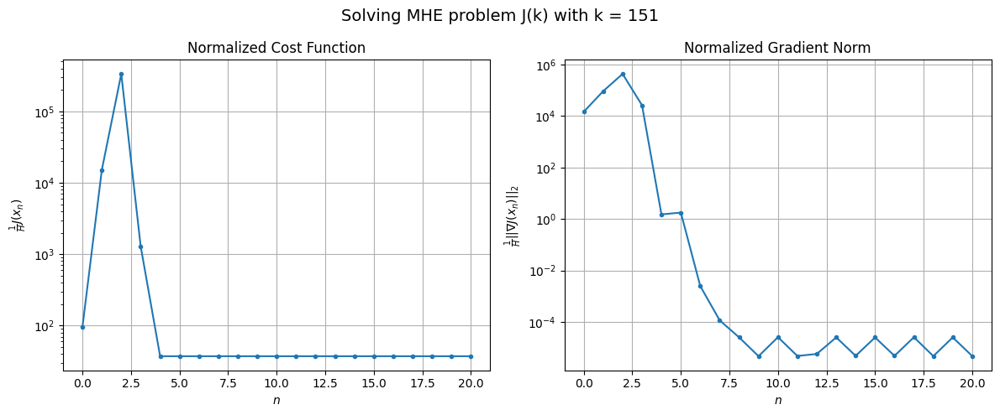

Windows:  37%|███▋      | 143/386 [08:06<16:33,  4.09s/it]

[Gauss-Newton] Before applying the algorithm
Cost function: 569.4161773877672
Gradient norm: 127031.84677731691
Global estimation error: 3875.473576507982
Initial conditions estimation errors: 0.5466972042818703 m, 364.7267913601976 m, 737.4939109393936 m, 3787.131586714826 m
Position estimation errors: 2.4297478851562344 m, 584.4301892223086 m, 609.7405562939476 m, 4392.820833709774 m

[Gauss-Newton] Iteration 1
Cost function: 554.0154771514674 (-2.70%)
Gradient norm: 22337.164745462942 (-82.42%)
Global estimation error: 4490.27535304844 (15.86%)
Initial conditions estimation errors: 1.312551525501369 m, 413.9589554415988 m, 887.4482050649187 m, 4382.195787998493 m
Position estimation errors: 1.448485544037762 m, 582.3660537002127 m, 732.4015810588452 m, 4676.468917931953 m

[Gauss-Newton] Iteration 2
Cost function: 380.5294479256641 (-31.31%)
Gradient norm: 30.717686786878687 (-99.86%)
Global estimation error: 4465.533009417207 (-0.55%)
Initial conditions estimation errors: 1.3125515

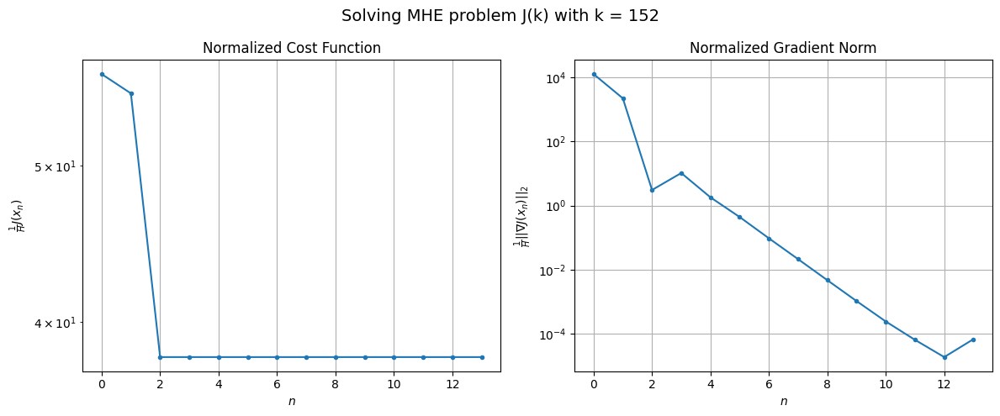

Windows:  37%|███▋      | 144/386 [08:10<16:55,  4.20s/it]

[Gauss-Newton] Before applying the algorithm
Cost function: 619.4104780964419
Gradient norm: 143103.26918672392
Global estimation error: 4558.785023227858
Initial conditions estimation errors: 0.5812725214297263 m, 438.70760283844396 m, 872.0257641359547 m, 4453.046556299742 m
Position estimation errors: 2.637330853724497 m, 588.2580722577744 m, 695.3130994817167 m, 4583.926286031846 m

[Gauss-Newton] Iteration 1
Cost function: 215145.1507536892 (34633.86%)
Gradient norm: 1117765.012891124 (681.09%)
Global estimation error: 1808.2869012253004 (-60.33%)
Initial conditions estimation errors: 1.4157908785276616 m, 173.91671178019803 m, 322.88998640541473 m, 1770.7044654771526 m
Position estimation errors: 1.5538392005760537 m, 219.51938307135032 m, 252.5567618225795 m, 1648.1230868151513 m

[Gauss-Newton] Iteration 2
Cost function: 6718.12751583881 (-96.88%)
Gradient norm: 190954.05342843404 (-82.92%)
Global estimation error: 2947.9604751329566 (63.03%)
Initial conditions estimation error

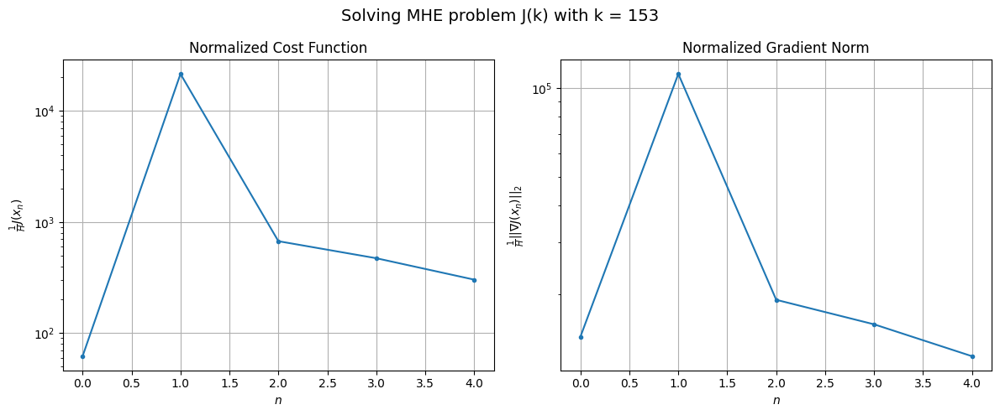

Windows:  38%|███▊      | 145/386 [08:12<14:14,  3.55s/it]

[Gauss-Newton] Before applying the algorithm
Cost function: 3323.61637702245
Gradient norm: 219126.25663273386
Global estimation error: 2868.1325020152194
Initial conditions estimation errors: 0.6044482148784339 m, 286.7297153032465 m, 512.2958107329392 m, 2807.404866959363 m
Position estimation errors: 2.8271123038451225 m, 367.77019865823337 m, 383.72067724814576 m, 2661.013714656743 m

[Gauss-Newton] Iteration 1
Cost function: 1319634.1064659702 (39604.77%)
Gradient norm: 2756162.6705702394 (1157.80%)
Global estimation error: 1527.9481099680072 (-46.73%)
Initial conditions estimation errors: 1.5700525080558174 m, 154.5867913806556 m, 307.47105439929857 m, 1488.68569949463 m
Position estimation errors: 1.5745831407622615 m, 285.56893132441036 m, 212.36288056194468 m, 1965.5344524809032 m

[Gauss-Newton] Iteration 2
Cost function: 201777.14834745863 (-84.71%)
Gradient norm: 1078527.8713323905 (-60.87%)
Global estimation error: 4220.587825873666 (176.23%)
Initial conditions estimation 

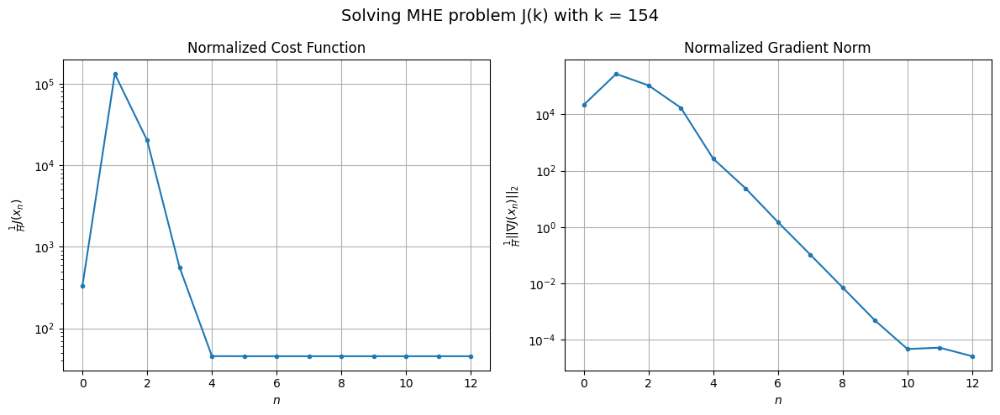

Windows:  38%|███▊      | 146/386 [08:17<14:54,  3.73s/it]

[Gauss-Newton] Before applying the algorithm
Cost function: 848.5270585160172
Gradient norm: 187427.4428679802
Global estimation error: 3353.493401764467
Initial conditions estimation errors: 0.6522845201700838 m, 360.16265207492336 m, 607.1438783415937 m, 3278.3489884750206 m
Position estimation errors: 2.9090499171820094 m, 545.2084275952578 m, 423.12612599368407 m, 3740.329857414204 m

[Gauss-Newton] Iteration 1
Cost function: 560.3997126916727 (-33.96%)
Gradient norm: 11790.273709664441 (-93.71%)
Global estimation error: 2946.636032085102 (-12.13%)
Initial conditions estimation errors: 1.7150652664860992 m, 318.78152394160935 m, 534.6464490046674 m, 2880.136651007372 m
Position estimation errors: 1.5078109636335657 m, 520.0551693408873 m, 377.8993192928963 m, 3499.413118488409 m

[Gauss-Newton] Iteration 2
Cost function: 533.8163037885722 (-4.74%)
Gradient norm: 9099.492255047133 (-22.82%)
Global estimation error: 2701.149904877099 (-8.33%)
Initial conditions estimation errors: 1.7

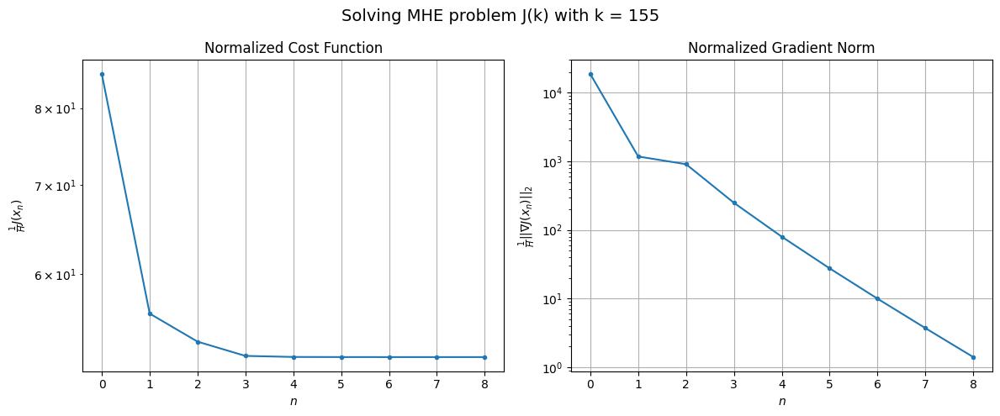

Windows:  38%|███▊      | 147/386 [08:20<14:23,  3.61s/it]

[Gauss-Newton] Before applying the algorithm
Cost function: 831.5190345767787
Gradient norm: 173083.49182834502
Global estimation error: 2511.9211573595194
Initial conditions estimation errors: 0.7005876231947513 m, 286.71141401474864 m, 428.6369073723013 m, 2458.4163570131172 m
Position estimation errors: 2.8727792208556333 m, 443.7107170882581 m, 292.7529380149894 m, 2918.7999277415724 m

[Gauss-Newton] Iteration 1
Cost function: 198536.27587509662 (23776.34%)
Gradient norm: 1104962.2366396957 (538.40%)
Global estimation error: 111.43629193045199 (-95.56%)
Initial conditions estimation errors: 1.723650584669225 m, 13.670942975099747 m, 27.14879261889931 m, 107.19655890392711 m
Position estimation errors: 1.5630211986139877 m, 32.129468875944184 m, 10.543173723250261 m, 149.01022454991707 m

[Gauss-Newton] Iteration 2
Cost function: 1616252.5002324395 (714.08%)
Gradient norm: 3114732.1682866593 (181.89%)
Global estimation error: 4487.617842758222 (3927.07%)
Initial conditions estimati

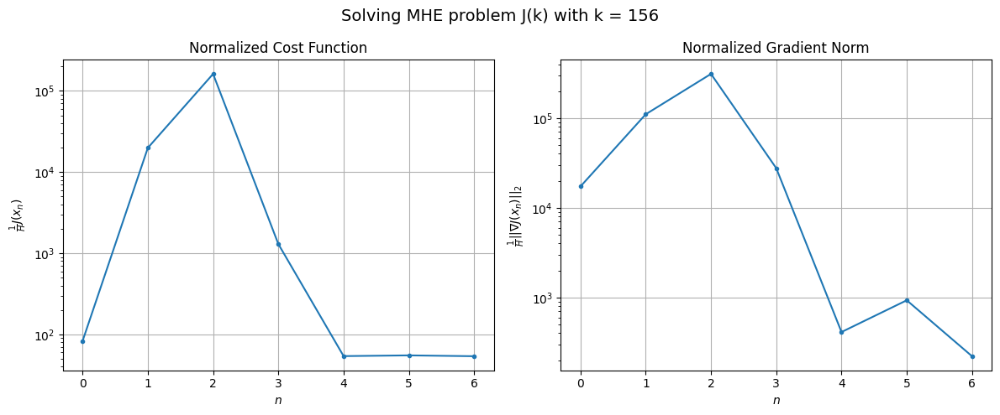

Windows:  38%|███▊      | 148/386 [08:23<13:10,  3.32s/it]

[Gauss-Newton] Before applying the algorithm
Cost function: 897.3511876849707
Gradient norm: 187569.06073495338
Global estimation error: 3287.247463956972
Initial conditions estimation errors: 0.6646783674140329 m, 357.78425018027343 m, 556.154895020712 m, 3220.0426168731224 m
Position estimation errors: 2.980455642881391 m, 575.8082443289367 m, 349.89506361359525 m, 3480.1013012662706 m

[Gauss-Newton] Iteration 1
Cost function: 723942.9989614617 (80575.55%)
Gradient norm: 2101170.3410521406 (1020.21%)
Global estimation error: 354.61046740039967 (-89.21%)
Initial conditions estimation errors: 1.7674361338618487 m, 25.059733426556424 m, 90.92586676777213 m, 341.8323884014618 m
Position estimation errors: 1.573220593198607 m, 91.6056972116356 m, 57.52950484924872 m, 623.9771047321238 m

[Gauss-Newton] Iteration 2
Cost function: 560.1426894539646 (-99.92%)
Gradient norm: 716.4135081628265 (-99.97%)
Global estimation error: 336.73049357359093 (-5.04%)
Initial conditions estimation errors:

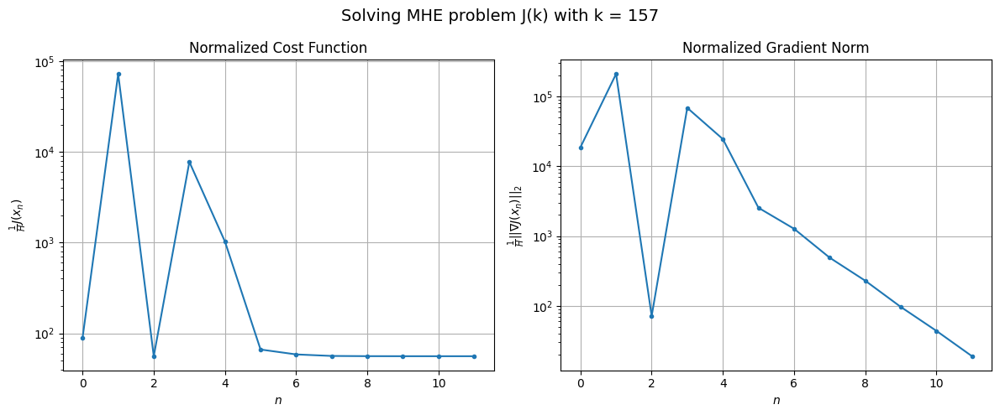

Windows:  39%|███▊      | 149/386 [08:27<13:54,  3.52s/it]

[Gauss-Newton] Before applying the algorithm
Cost function: 915.8744070474102
Gradient norm: 188447.70185477968
Global estimation error: 1449.8808397378723
Initial conditions estimation errors: 0.671148411800317 m, 176.70512854024042 m, 226.62696590346965 m, 1421.1152104155583 m
Position estimation errors: 3.062667384599313 m, 266.2874278879018 m, 145.99841607659283 m, 1661.8997656206823 m

[Gauss-Newton] Iteration 1
Cost function: 2652625.9261057 (289527.69%)
Gradient norm: 4060363.411644793 (2054.64%)
Global estimation error: 3399.350034082572 (134.46%)
Initial conditions estimation errors: 1.8132012563033726 m, 394.21742872296295 m, 556.0223995505165 m, 3330.31561099098 m
Position estimation errors: 1.6438615550701827 m, 698.9787696123418 m, 338.20235829108896 m, 4000.648950988327 m

[Gauss-Newton] Iteration 2
Cost function: 1064296.449704069 (-59.88%)
Gradient norm: 2584234.621302577 (-36.35%)
Global estimation error: 499.30655286832365 (-85.31%)
Initial conditions estimation error

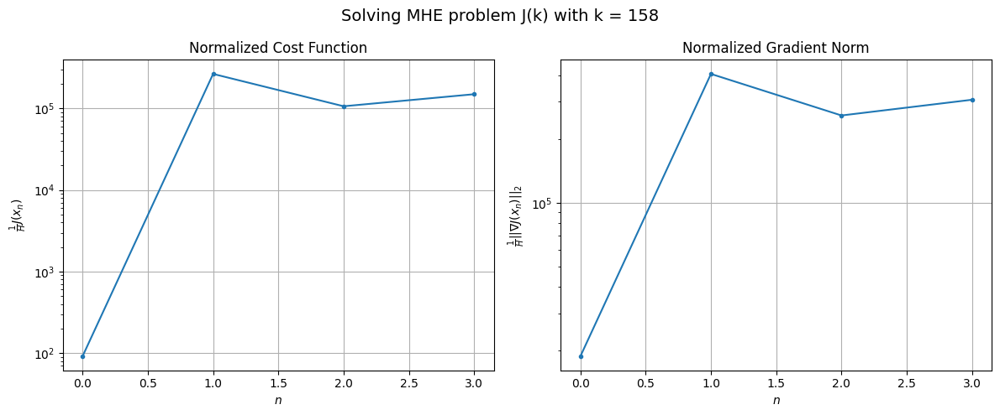

Windows:  39%|███▉      | 150/386 [08:28<11:45,  2.99s/it]

[Gauss-Newton] Before applying the algorithm
Cost function: 1628702.994971827
Gradient norm: 3207716.081784437
Global estimation error: 3863.3639579340297
Initial conditions estimation errors: 0.6826350786590087 m, 476.834244348458 m, 578.8595712236298 m, 3789.871269745305 m
Position estimation errors: 3.3078273401035787 m, 785.5552023260775 m, 356.32613973567203 m, 4370.154524168737 m

[Gauss-Newton] Iteration 1
Cost function: 538679.246247771 (-66.93%)
Gradient norm: 1763796.52002635 (-45.01%)
Global estimation error: 446.0125372572339 (-88.46%)
Initial conditions estimation errors: 1.8188624932368649 m, 46.35739600838471 m, 106.3399055337328 m, 430.65751958534713 m
Position estimation errors: 1.7972606633638184 m, 149.0745308997151 m, 55.80835357847554 m, 785.7252326539796 m

[Gauss-Newton] Iteration 2
Cost function: 1270.9173853162981 (-99.76%)
Gradient norm: 62772.42245980656 (-96.44%)
Global estimation error: 184.5234750820557 (-58.63%)
Initial conditions estimation errors: 1.818

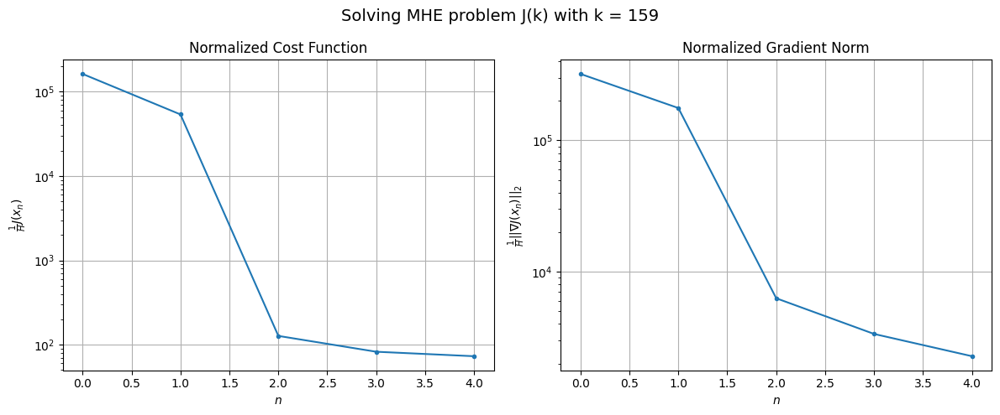

Windows:  39%|███▉      | 151/386 [08:31<10:48,  2.76s/it]

[Gauss-Newton] Before applying the algorithm
Cost function: 1251.4644257618281
Gradient norm: 223970.86682865612
Global estimation error: 88.33031601369542
Initial conditions estimation errors: 0.6646295250949799 m, 16.309239025834223 m, 19.9200158885348 m, 84.49129062487157 m
Position estimation errors: 3.7307372057704127 m, 38.9518087750587 m, 22.72558330342875 m, 168.47586175562753 m

[Gauss-Newton] Iteration 1
Cost function: 665307.9882507476 (53062.36%)
Gradient norm: 2047523.1242877436 (814.19%)
Global estimation error: 3275.9854901442927 (3608.79%)
Initial conditions estimation errors: 1.862809716705323 m, 392.10193260360927 m, 537.6980963277678 m, 3207.678921450884 m
Position estimation errors: 2.1467509583057995 m, 776.9837158193056 m, 329.1679956994845 m, 4153.706096776973 m

[Gauss-Newton] Iteration 2
Cost function: 16187.053476743204 (-97.57%)
Gradient norm: 314124.6610976347 (-84.66%)
Global estimation error: 1981.3383882383773 (-39.52%)
Initial conditions estimation error

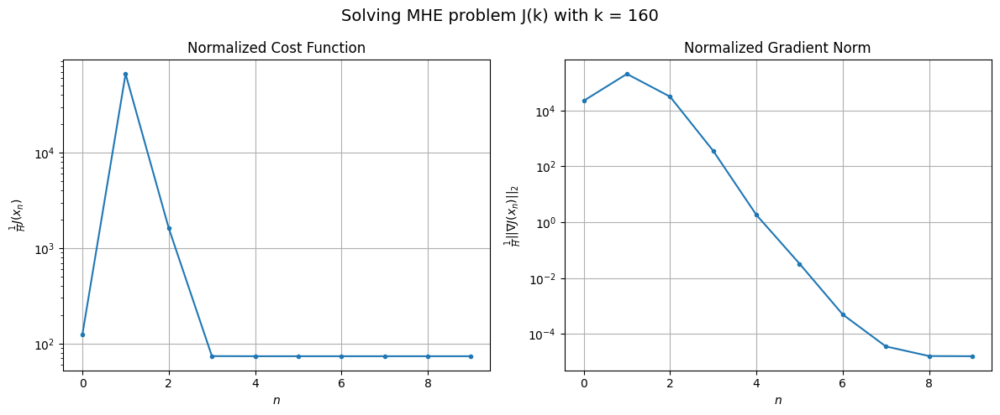

Windows:  39%|███▉      | 152/386 [08:35<12:14,  3.14s/it]

[Gauss-Newton] Before applying the algorithm
Cost function: 1574.030800212885
Gradient norm: 274837.4486653438
Global estimation error: 1966.5704603964625
Initial conditions estimation errors: 0.6702293596462171 m, 251.74826894471784 m, 301.296546872664 m, 1926.9766439189953 m
Position estimation errors: 4.467965859576085 m, 464.34032530056686 m, 200.31346489129123 m, 2414.9211187324477 m

[Gauss-Newton] Iteration 1
Cost function: 2803.808484856385 (78.13%)
Gradient norm: 102443.29605444295 (-62.73%)
Global estimation error: 1123.745234384763 (-42.86%)
Initial conditions estimation errors: 2.104859714114294 m, 132.91036928993447 m, 201.6453122073248 m, 1097.483905363217 m
Position estimation errors: 2.507184223071744 m, 295.6455970467297 m, 131.90881449968452 m, 1584.211762089014 m

[Gauss-Newton] Iteration 2
Cost function: 946.6147791312212 (-66.24%)
Gradient norm: 215.9235918598427 (-99.79%)
Global estimation error: 1156.6135883099848 (2.92%)
Initial conditions estimation errors: 2.1

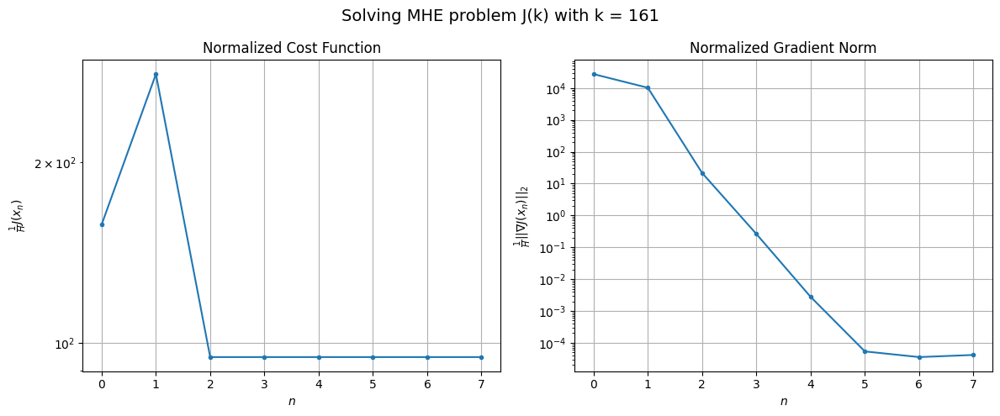

Windows:  40%|███▉      | 153/386 [08:38<12:07,  3.12s/it]

[Gauss-Newton] Before applying the algorithm
Cost function: 2203.2284965842246
Gradient norm: 329135.21750035003
Global estimation error: 1230.0891905007488
Initial conditions estimation errors: 0.8038905280234315 m, 157.89989318125666 m, 193.24013822326398 m, 1204.5093529220553 m
Position estimation errors: 5.225927912333884 m, 315.21080382766553 m, 138.7430418596296 m, 1643.0162714921257 m

[Gauss-Newton] Iteration 1
Cost function: 1403.7900008580846 (-36.28%)
Gradient norm: 11555.577022123922 (-96.49%)
Global estimation error: 938.8302024665717 (-23.68%)
Initial conditions estimation errors: 2.384887118432337 m, 116.00206967475664 m, 152.8084651168194 m, 919.0146548057302 m
Position estimation errors: 2.9403029510047096 m, 270.6992777762308 m, 114.15041534815352 m, 1366.158848811892 m

[Gauss-Newton] Iteration 2
Cost function: 1379.6610264088358 (-1.72%)
Gradient norm: 282.4648104137301 (-97.56%)
Global estimation error: 901.5813994559953 (-3.97%)
Initial conditions estimation error

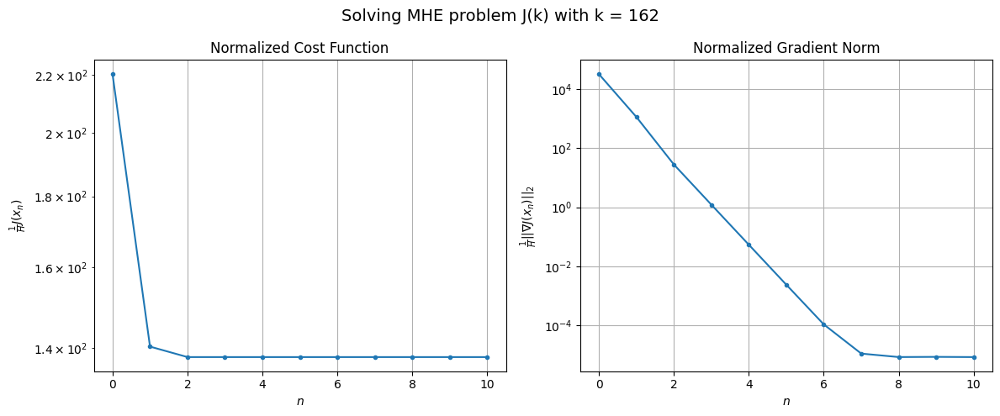

Windows:  40%|███▉      | 154/386 [08:41<12:40,  3.28s/it]

[Gauss-Newton] Before applying the algorithm
Cost function: 2889.3602011137236
Gradient norm: 363195.9758368522
Global estimation error: 957.9967059553879
Initial conditions estimation errors: 0.9351160683295675 m, 129.372012540831 m, 136.00974748136926 m, 939.4251880538478 m
Position estimation errors: 6.020636307939853 m, 270.51633651269816 m, 115.55363059736221 m, 1329.1453137333538 m

[Gauss-Newton] Iteration 1
Cost function: 295709.14799277874 (10134.42%)
Gradient norm: 1392997.7614268 (283.54%)
Global estimation error: 1588.8448023732483 (65.85%)
Initial conditions estimation errors: 2.6782406022505594 m, 189.09735633487176 m, 254.78300680372126 m, 1556.838517171084 m
Position estimation errors: 3.5055607619936335 m, 406.7609570081881 m, 193.79660548263584 m, 1945.5970349542818 m

[Gauss-Newton] Iteration 2
Cost function: 5873.255883141121 (-98.01%)
Gradient norm: 155610.3133814883 (-88.83%)
Global estimation error: 2515.8261758769668 (58.34%)
Initial conditions estimation errors

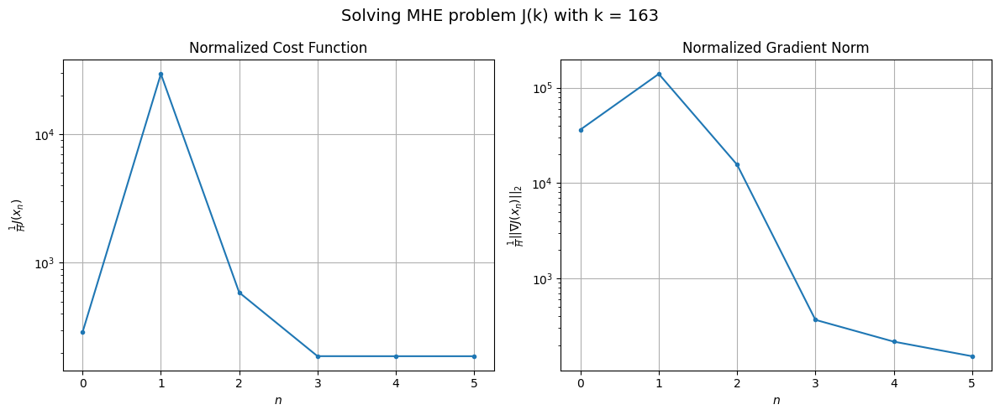

Windows:  40%|████      | 155/386 [08:44<11:31,  2.99s/it]

[Gauss-Newton] Before applying the algorithm
Cost function: 3879.5298649928154
Gradient norm: 424023.21971531154
Global estimation error: 2502.5178692022723
Initial conditions estimation errors: 1.0500160331117705 m, 376.5623549633277 m, 258.16646957391964 m, 2460.516643765939 m
Position estimation errors: 6.871369852428796 m, 631.1413200862748 m, 301.6148675826971 m, 2803.275886621811 m

[Gauss-Newton] Iteration 1
Cost function: 123417.29394046718 (3081.24%)
Gradient norm: 877093.1348327602 (106.85%)
Global estimation error: 397.916410009491 (-84.10%)
Initial conditions estimation errors: 3.041880464289436 m, 60.58968456536136 m, 43.3480983531154 m, 390.8682890569684 m
Position estimation errors: 3.9745281993693977 m, 71.76189805761561 m, 54.732254623573056 m, 323.37883212414374 m

[Gauss-Newton] STOP on Iteration 2 (gradient norm stagnated)
Cost function = 4492.9653470319545 (-96.36%)
Gradient norm = 116883.36157087538 (-86.67%)
Global estimation error = 1016.739897221215 (155.52%)
F

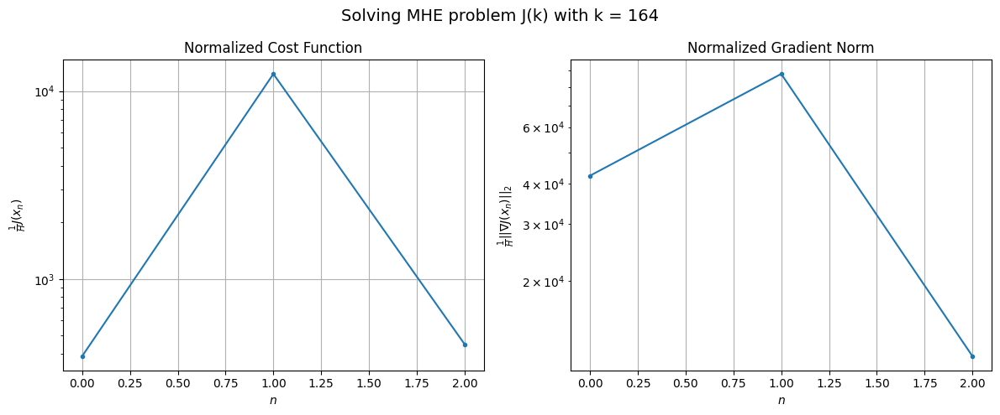

Windows:  40%|████      | 156/386 [08:45<09:44,  2.54s/it]

[Gauss-Newton] Before applying the algorithm
Cost function: 7219.050636580579
Gradient norm: 489888.42211012094
Global estimation error: 1067.0678254277302
Initial conditions estimation errors: 1.1798722571756655 m, 161.9778347922942 m, 109.37360878307335 m, 1049.0147943292477 m
Position estimation errors: 7.511772737501516 m, 296.93954329495364 m, 160.7479130578693 m, 1278.770847504895 m

[Gauss-Newton] Iteration 1
Cost function: 244603.2814472887 (3288.30%)
Gradient norm: 1268465.6226911182 (158.93%)
Global estimation error: 1282.5815794952948 (20.20%)
Initial conditions estimation errors: 3.5367835417749 m, 194.65330819480147 m, 132.57879987539604 m, 1260.7669692045322 m
Position estimation errors: 4.272005458412036 m, 409.9729399753401 m, 176.3919983863552 m, 1786.0880482376997 m

[Gauss-Newton] Iteration 2
Cost function: 7310.208289783625 (-97.01%)
Gradient norm: 170169.85115497402 (-86.58%)
Global estimation error: 477.4900762006927 (-62.77%)
Initial conditions estimation errors:

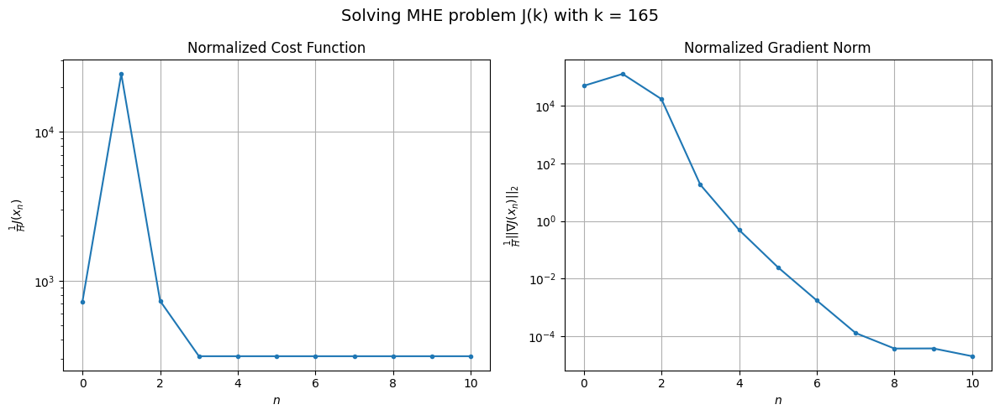

Windows:  41%|████      | 157/386 [08:49<10:46,  2.82s/it]

[Gauss-Newton] Before applying the algorithm
Cost function: 5430.5617407122445
Gradient norm: 482383.46557431464
Global estimation error: 542.1542634721219
Initial conditions estimation errors: 1.393097791664042 m, 92.75448203289848 m, 44.317048511195374 m, 532.3172722772886 m
Position estimation errors: 7.847669997724441 m, 150.5115488117763 m, 59.76195168108776 m, 658.9757728586587 m

[Gauss-Newton] Iteration 1
Cost function: 5749.376273112037 (5.87%)
Gradient norm: 118759.31400227774 (-75.38%)
Global estimation error: 206.9069104969103 (-61.84%)
Initial conditions estimation errors: 3.9087401504342867 m, 40.61732287399096 m, 15.302966491602097 m, 202.26517890631797 m
Position estimation errors: 4.486812826840458 m, 54.2313272039012 m, 30.229388877821446 m, 261.56692897847205 m

[Gauss-Newton] Iteration 2
Cost function: 3563.5515698336453 (-38.02%)
Gradient norm: 107.4701825894648 (-99.91%)
Global estimation error: 160.03978152374688 (-22.65%)
Initial conditions estimation errors: 3.

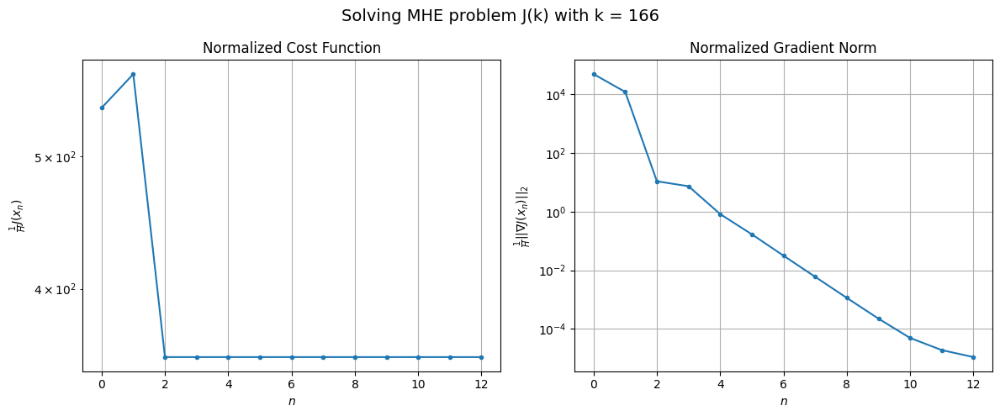

Windows:  41%|████      | 158/386 [08:53<12:43,  3.35s/it]

[Gauss-Newton] Before applying the algorithm
Cost function: 6065.363468373518
Gradient norm: 504331.0810381414
Global estimation error: 196.16979167302298
Initial conditions estimation errors: 1.511319948959215 m, 35.138939975763485 m, 15.0221778116702 m, 192.405340525837 m
Position estimation errors: 7.970802889463064 m, 62.38844227875124 m, 35.729946276860076 m, 294.69959298378495 m

[Gauss-Newton] Iteration 1
Cost function: 4063.835727715848 (-33.00%)
Gradient norm: 33491.4850232416 (-93.36%)
Global estimation error: 109.29644899703734 (-44.28%)
Initial conditions estimation errors: 4.261418812295616 m, 43.582122541398235 m, 68.38546651598648 m, 73.15117317353499 m
Position estimation errors: 4.3929032418011715 m, 66.83147449218762 m, 30.28383641150961 m, 279.91204131733224 m

[Gauss-Newton] Iteration 2
Cost function: 3912.8294362348906 (-3.72%)
Gradient norm: 1926.0319596536947 (-94.25%)
Global estimation error: 195.6912713586463 (79.05%)
Initial conditions estimation errors: 4.261

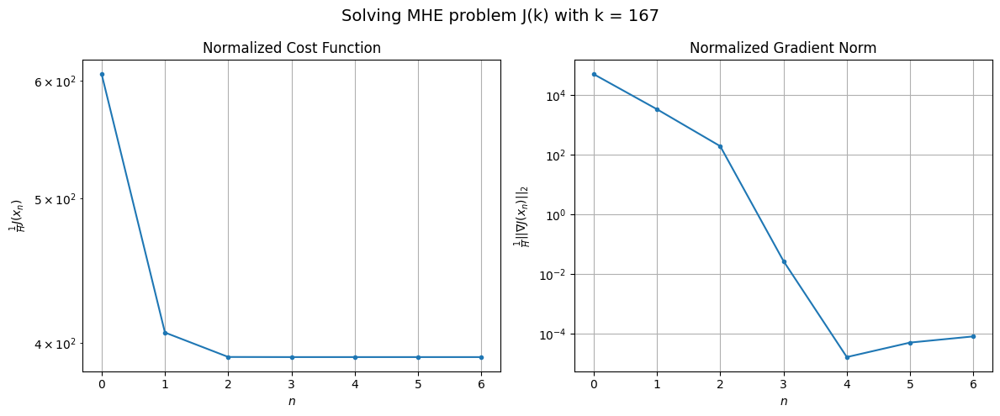

Windows:  41%|████      | 159/386 [08:55<11:29,  3.04s/it]

[Gauss-Newton] Before applying the algorithm
Cost function: 6021.659450022544
Gradient norm: 469184.61210794497
Global estimation error: 156.84827407571248
Initial conditions estimation errors: 1.6200017910028084 m, 55.80386707434042 m, 69.85210237453417 m, 128.86009560986292 m
Position estimation errors: 7.605757185577268 m, 49.31144319789541 m, 23.622639897838827 m, 214.40124958614533 m

[Gauss-Newton] Iteration 1
Cost function: 10779.986220676667 (79.02%)
Gradient norm: 154028.54501853342 (-67.17%)
Global estimation error: 1199.8916943696684 (665.00%)
Initial conditions estimation errors: 4.358939608646014 m, 265.9839233523066 m, 107.62844788938484 m, 1165.070673724889 m
Position estimation errors: 4.185083005919411 m, 272.0988087045063 m, 187.3342226977425 m, 960.6588608316564 m

[Gauss-Newton] Iteration 2
Cost function: 3983.2126217172863 (-63.05%)
Gradient norm: 2923.265859346801 (-98.10%)
Global estimation error: 1284.9605748852707 (7.09%)
Initial conditions estimation errors: 4

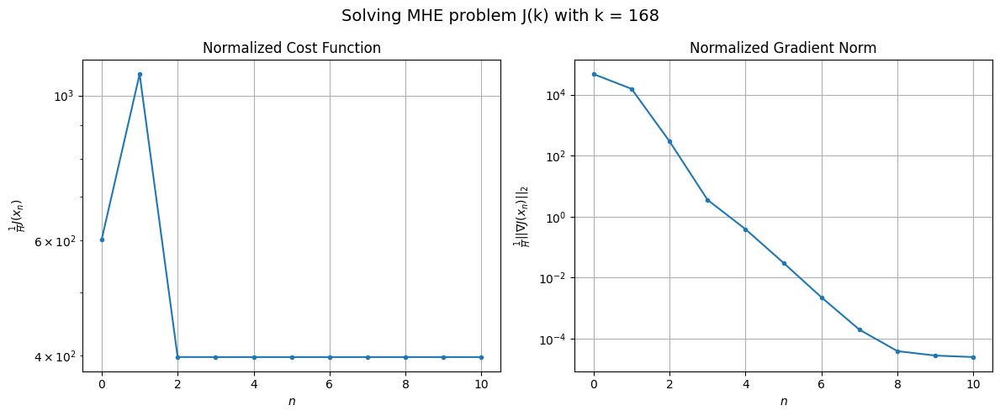

Windows:  41%|████▏     | 160/386 [08:59<11:53,  3.16s/it]

[Gauss-Newton] Before applying the algorithm
Cost function: 5526.124222001479
Gradient norm: 423665.41521949554
Global estimation error: 1294.5645049608754
Initial conditions estimation errors: 1.5942890757769905 m, 285.8419959874915 m, 112.1724109464191 m, 1257.6193078244062 m
Position estimation errors: 7.025551457324691 m, 299.1212665984638 m, 211.3111266633012 m, 1053.4358318678096 m

[Gauss-Newton] Iteration 1
Cost function: 56294.97392484039 (918.71%)
Gradient norm: 565612.9235703291 (33.50%)
Global estimation error: 454.8718827579728 (-64.86%)
Initial conditions estimation errors: 4.326678144786145 m, 73.35620242515245 m, 42.097472278066924 m, 446.9178445200012 m
Position estimation errors: 3.8482302244752735 m, 204.4177817819203 m, 124.34368760363195 m, 790.1037560499111 m

[Gauss-Newton] Iteration 2
Cost function: 3623.905568537599 (-93.56%)
Gradient norm: 184.44572512939854 (-99.97%)
Global estimation error: 462.15307789943563 (1.60%)
Initial conditions estimation errors: 4.3

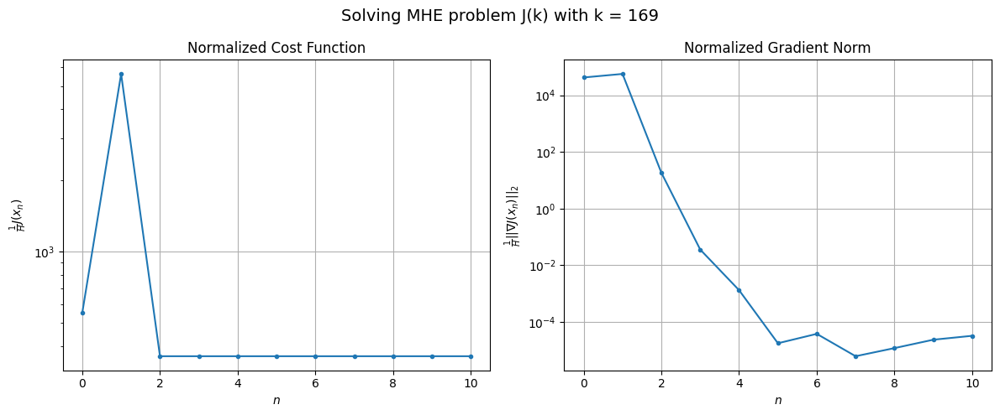

Windows:  42%|████▏     | 161/386 [09:02<12:16,  3.27s/it]

[Gauss-Newton] Before applying the algorithm
Cost function: 4789.17250352607
Gradient norm: 372602.7953315733
Global estimation error: 515.192209729559
Initial conditions estimation errors: 1.5423763407461248 m, 90.77495435503957 m, 43.034411176648725 m, 505.299642276483 m
Position estimation errors: 6.347333426546652 m, 225.98932004552753 m, 142.46086060350973 m, 847.5335001240436 m

[Gauss-Newton] Iteration 1
Cost function: 3179.6890238048827 (-33.61%)
Gradient norm: 18273.311388382797 (-95.10%)
Global estimation error: 214.33156172512432 (-58.40%)
Initial conditions estimation errors: 4.139985068699622 m, 47.0180736300755 m, 43.87715599881535 m, 204.4125226003585 m
Position estimation errors: 3.4610765798449195 m, 144.14200448489223 m, 96.29941751799231 m, 507.2818588546626 m

[Gauss-Newton] Iteration 2
Cost function: 3125.8320693786427 (-1.69%)
Gradient norm: 82.48488682469781 (-99.55%)
Global estimation error: 219.0512548142559 (2.20%)
Initial conditions estimation errors: 4.13998

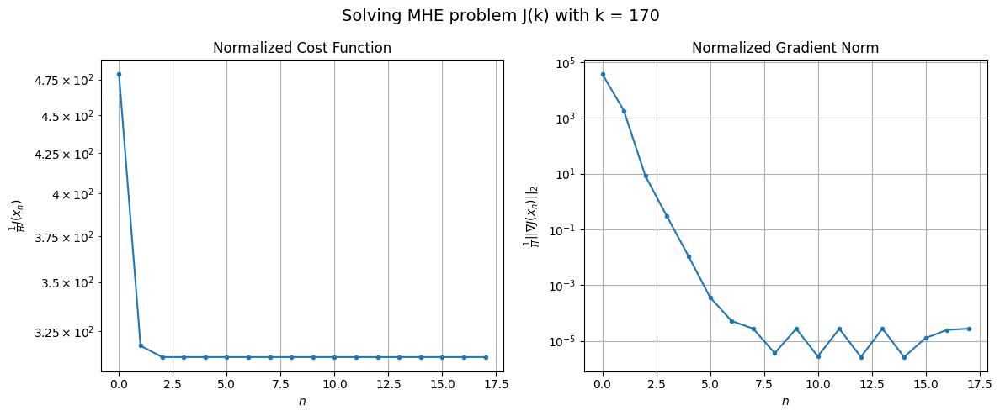

Windows:  42%|████▏     | 162/386 [09:08<14:42,  3.94s/it]

[Gauss-Newton] Before applying the algorithm
Cost function: 3908.8914452227855
Gradient norm: 311987.01868628
Global estimation error: 260.8990525272803
Initial conditions estimation errors: 1.5079088991769316 m, 58.881866839428035 m, 48.66244177066553 m, 249.46022052558175 m
Position estimation errors: 5.754075972752484 m, 160.38775100934387 m, 105.16592863765536 m, 557.9661559773051 m

[Gauss-Newton] Iteration 1
Cost function: 2705.1291737889737 (-30.80%)
Gradient norm: 27590.11516513238 (-91.16%)
Global estimation error: 141.60060082809102 (-45.73%)
Initial conditions estimation errors: 3.8092716970442413 m, 47.513722311704356 m, 73.5168316339167 m, 111.23814483445727 m
Position estimation errors: 3.2997760115265757 m, 31.62351587077649 m, 33.853998895263494 m, 64.57987227025822 m

[Gauss-Newton] Iteration 2
Cost function: 2602.8961129613253 (-3.78%)
Gradient norm: 918.1326906367594 (-96.67%)
Global estimation error: 216.38404597304148 (52.81%)
Initial conditions estimation errors: 

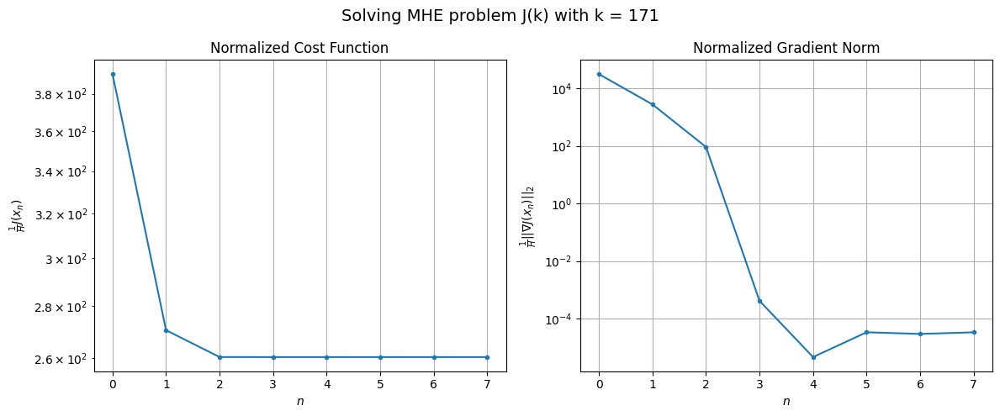

Windows:  42%|████▏     | 163/386 [09:11<13:17,  3.58s/it]

[Gauss-Newton] Before applying the algorithm
Cost function: 3475.22369214084
Gradient norm: 300316.4777779318
Global estimation error: 211.69737258390148
Initial conditions estimation errors: 1.417946567896232 m, 66.93759396577973 m, 85.40292499746833 m, 181.76757619227746 m
Position estimation errors: 5.592636941046724 m, 52.100958535851525 m, 48.961371476770424 m, 118.9946688620012 m

[Gauss-Newton] Iteration 1
Cost function: 3077.7570930571023 (-11.44%)
Gradient norm: 71167.12762073711 (-76.30%)
Global estimation error: 261.85828924782237 (23.69%)
Initial conditions estimation errors: 3.4489250597598615 m, 97.0382879335771 m, 156.46610571300928 m, 186.16297683454715 m
Position estimation errors: 3.303183189650269 m, 169.54485083166952 m, 115.85893882655955 m, 711.3753944176594 m

[Gauss-Newton] Iteration 2
Cost function: 2872.7797683247154 (-6.66%)
Gradient norm: 50602.51547854713 (-28.90%)
Global estimation error: 804.7632222307598 (207.33%)
Initial conditions estimation errors: 3.

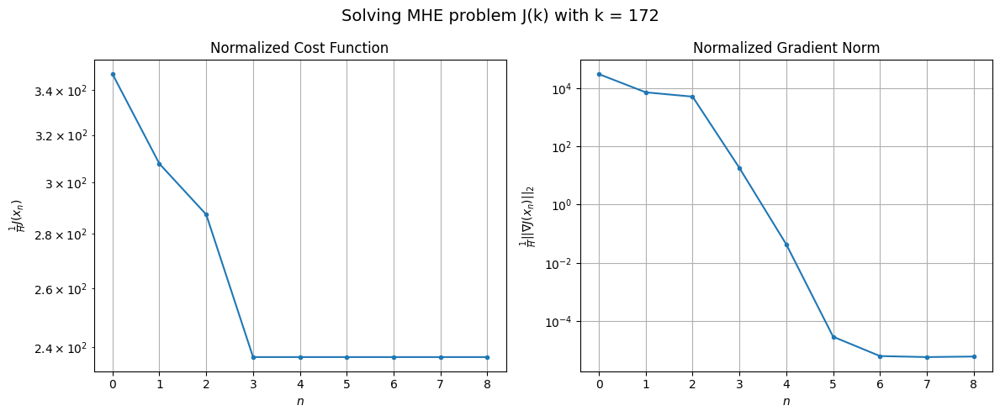

Windows:  42%|████▏     | 164/386 [09:14<12:32,  3.39s/it]

[Gauss-Newton] Before applying the algorithm
Cost function: 3396.2844888883324
Gradient norm: 316926.4346055338
Global estimation error: 674.1515906918729
Initial conditions estimation errors: 1.3195739582980819 m, 221.06539849103237 m, 241.78873332923422 m, 589.1890176957291 m
Position estimation errors: 5.698446554650802 m, 43.14579080328585 m, 112.54921395549495 m, 396.5829925909496 m

[Gauss-Newton] Iteration 1
Cost function: 2461.9780677228846 (-27.51%)
Gradient norm: 13349.957621410684 (-95.79%)
Global estimation error: 103.97810049389697 (-84.58%)
Initial conditions estimation errors: 3.306892692704346 m, 35.931031387716196 m, 39.840221978133265 m, 89.00454006397584 m
Position estimation errors: 3.3232587257479898 m, 68.279444999202 m, 45.27710394617405 m, 229.05373400744608 m

[Gauss-Newton] Iteration 2
Cost function: 2303.5560126560076 (-6.43%)
Gradient norm: 10639.931175427853 (-20.30%)
Global estimation error: 269.6810259679857 (159.36%)
Initial conditions estimation errors:

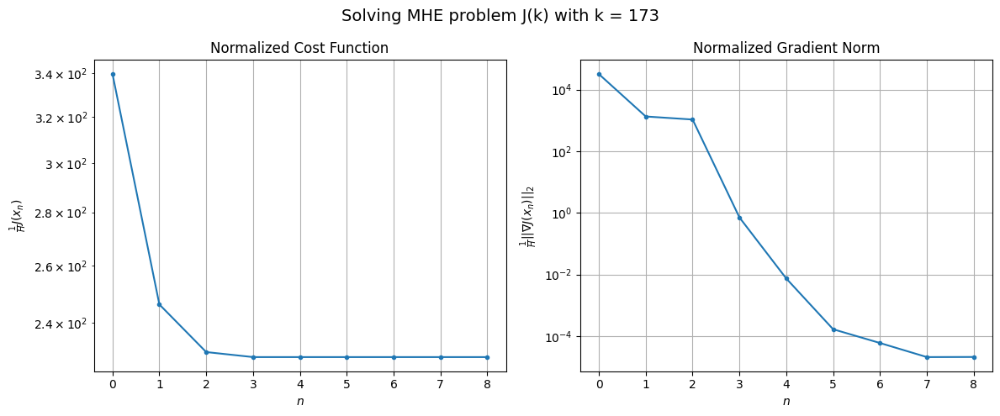

Windows:  43%|████▎     | 165/386 [09:17<12:01,  3.27s/it]

[Gauss-Newton] Before applying the algorithm
Cost function: 3423.0840423469504
Gradient norm: 334355.11593043024
Global estimation error: 232.81048179781482
Initial conditions estimation errors: 1.3479689035186233 m, 64.87491003851605 m, 49.84306133243593 m, 217.95796664837846 m
Position estimation errors: 5.837169069151588 m, 10.86023506556283 m, 29.782333832427284 m, 16.944483425607398 m

[Gauss-Newton] Iteration 1
Cost function: 2309.3004260667417 (-32.54%)
Gradient norm: 259.421710412337 (-99.92%)
Global estimation error: 309.85454161175153 (33.09%)
Initial conditions estimation errors: 3.314373004819676 m, 87.09639111854233 m, 58.80649957619892 m, 291.4697761738694 m
Position estimation errors: 3.3817975679080967 m, 16.291434927961028 m, 26.7311860148025 m, 40.560096504385804 m

[Gauss-Newton] Iteration 2
Cost function: 2309.254886698731 (-0.00%)
Gradient norm: 8.162270424118477 (-96.85%)
Global estimation error: 322.30024288346306 (4.02%)
Initial conditions estimation errors: 3.3

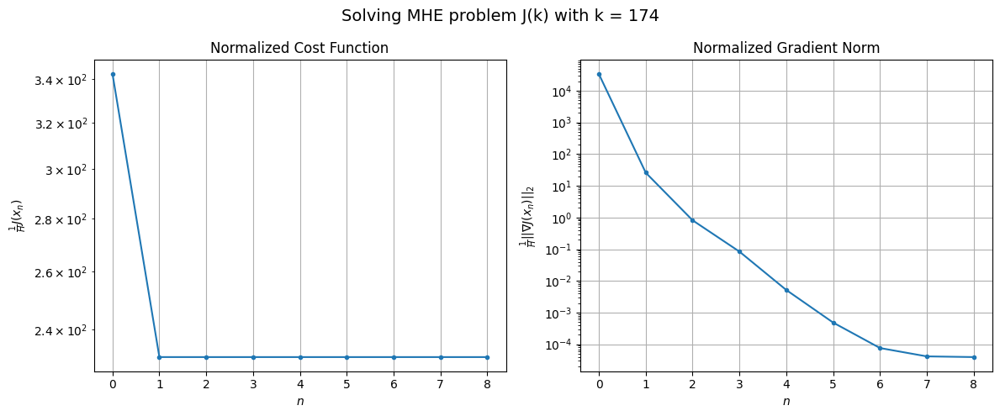

Windows:  43%|████▎     | 166/386 [09:20<12:13,  3.33s/it]

[Gauss-Newton] Before applying the algorithm
Cost function: 3668.8149044305337
Gradient norm: 370475.9529552456
Global estimation error: 297.2754233467991
Initial conditions estimation errors: 1.3534038673381708 m, 84.4211124198635 m, 62.096524218717555 m, 278.18636887788716 m
Position estimation errors: 6.025445041827969 m, 16.57820074987166 m, 30.90392413822947 m, 45.712684992718366 m

[Gauss-Newton] Iteration 1
Cost function: 10827.846607531526 (195.13%)
Gradient norm: 185318.9546632372 (-49.98%)
Global estimation error: 987.6504698644873 (232.23%)
Initial conditions estimation errors: 3.414908158665152 m, 281.5578931473213 m, 224.03763049361982 m, 919.7684333417358 m
Position estimation errors: 3.3599678641145485 m, 315.6019358859799 m, 315.948961635431 m, 782.8532309593459 m

[Gauss-Newton] Iteration 2
Cost function: 2432.0594076117077 (-77.54%)
Gradient norm: 2329.3297615763013 (-98.74%)
Global estimation error: 1129.974586704144 (14.41%)
Initial conditions estimation errors: 3.4

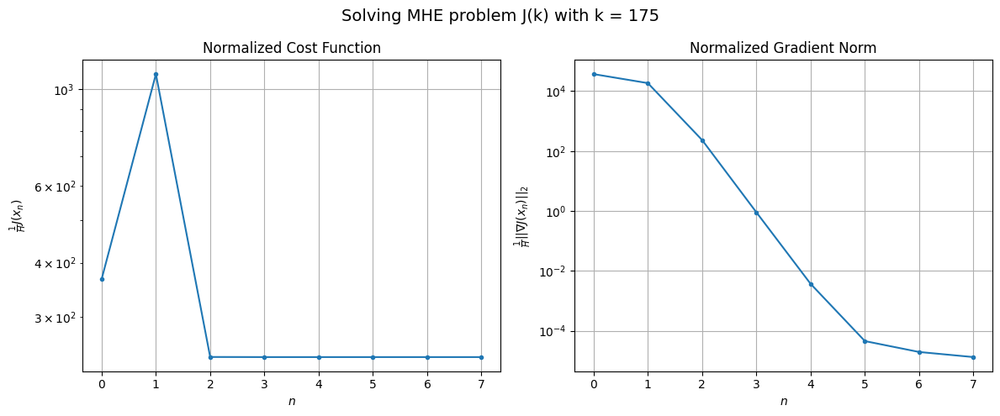

Windows:  43%|████▎     | 167/386 [09:23<11:29,  3.15s/it]

[Gauss-Newton] Before applying the algorithm
Cost function: 3661.540246013883
Gradient norm: 376192.12947647355
Global estimation error: 1144.4363973203544
Initial conditions estimation errors: 1.344057894665946 m, 338.88445918200705 m, 283.25722630548364 m, 1055.7724314786751 m
Position estimation errors: 6.111561523650756 m, 347.3107803972331 m, 361.7618629092572 m, 824.0029757590883 m

[Gauss-Newton] Iteration 1
Cost function: 6638.128649764913 (81.29%)
Gradient norm: 174360.43102288802 (-53.65%)
Global estimation error: 501.76371900490045 (-56.16%)
Initial conditions estimation errors: 3.566915362875887 m, 194.42997044884896 m, 253.10183303441613 m, 387.15555067029374 m
Position estimation errors: 3.3617286386113236 m, 9.69196864052554 m, 91.60103546753002 m, 204.82115740202096 m

[Gauss-Newton] Iteration 2
Cost function: 2419.042766347727 (-63.56%)
Gradient norm: 21845.05524108584 (-87.47%)
Global estimation error: 200.25075049194555 (-60.09%)
Initial conditions estimation errors:

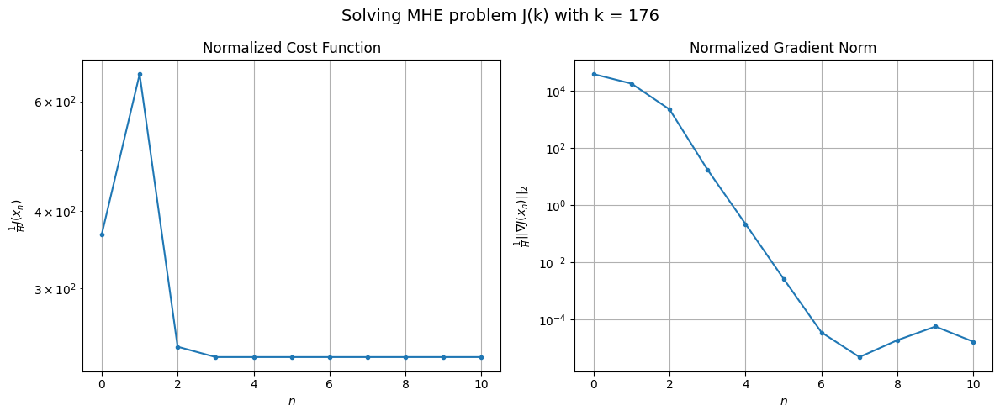

Windows:  44%|████▎     | 168/386 [09:26<11:53,  3.27s/it]

[Gauss-Newton] Before applying the algorithm
Cost function: 3727.1078666128615
Gradient norm: 393057.7212993491
Global estimation error: 166.11387636294447
Initial conditions estimation errors: 1.346404268958223 m, 53.3318189846222 m, 134.66538801575763 m, 81.31197895222803 m
Position estimation errors: 6.230652539318566 m, 146.59216554962845 m, 109.8173728721093 m, 562.4853920281304 m

[Gauss-Newton] Iteration 1
Cost function: 2512.1297465377856 (-32.60%)
Gradient norm: 24371.010966644324 (-93.80%)
Global estimation error: 460.2173043754676 (177.05%)
Initial conditions estimation errors: 3.5923682960822756 m, 114.43897356586986 m, 66.83923671317562 m, 440.70681584744983 m
Position estimation errors: 3.3770238629202094 m, 265.7554390234353 m, 257.130021673934 m, 736.2174125267917 m

[Gauss-Newton] Iteration 2
Cost function: 2339.7972272444013 (-6.86%)
Gradient norm: 577.7488580707272 (-97.63%)
Global estimation error: 510.9571599022468 (11.03%)
Initial conditions estimation errors: 3.5

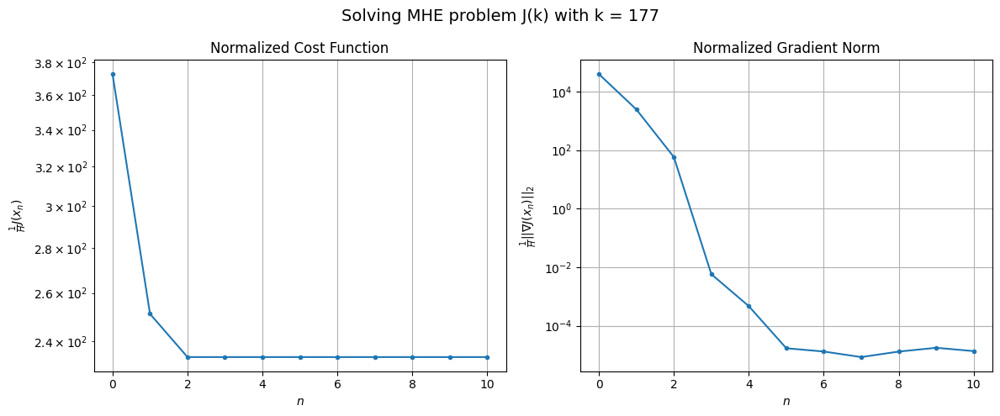

Windows:  44%|████▍     | 169/386 [09:30<11:55,  3.30s/it]

[Gauss-Newton] Before applying the algorithm
Cost function: 3702.9897617789734
Gradient norm: 397911.1816850917
Global estimation error: 562.429459769708
Initial conditions estimation errors: 1.2631049302690622 m, 150.18509152984134 m, 104.03611052899461 m, 531.9261560562558 m
Position estimation errors: 6.352703602873504 m, 297.971192691447 m, 295.16211373316196 m, 804.1581461960042 m

[Gauss-Newton] Iteration 1
Cost function: 2290.0480003860584 (-38.16%)
Gradient norm: 5028.755711927663 (-98.74%)
Global estimation error: 810.0908907286786 (44.03%)
Initial conditions estimation errors: 3.581427828655262 m, 269.03485635649236 m, 294.0445542170635 m, 705.2605044071768 m
Position estimation errors: 3.454566268553261 m, 297.8978642303413 m, 343.6850135418956 m, 648.4335603249986 m

[Gauss-Newton] Iteration 2
Cost function: 2265.4426112370215 (-1.07%)
Gradient norm: 2780.76226915824 (-44.70%)
Global estimation error: 906.3150702306406 (11.88%)
Initial conditions estimation errors: 3.581427

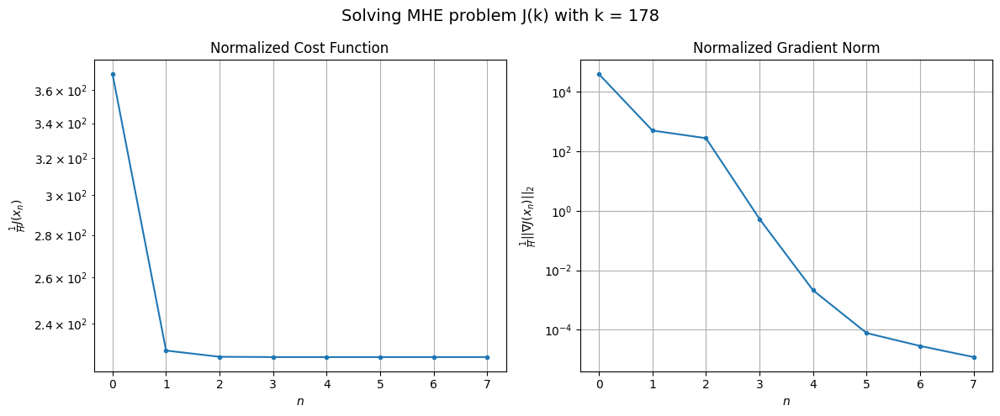

Windows:  44%|████▍     | 170/386 [09:32<11:12,  3.11s/it]

[Gauss-Newton] Before applying the algorithm
Cost function: 3751.8888236440953
Gradient norm: 410321.167128613
Global estimation error: 932.1474224861865
Initial conditions estimation errors: 1.2014342089214824 m, 310.97809046051293 m, 333.993859791122 m, 812.7964016985 m
Position estimation errors: 6.497367320306992 m, 343.4014898106786 m, 392.8528138339524 m, 744.3071684073361 m

[Gauss-Newton] Iteration 1
Cost function: 2557.1843552576984 (-31.84%)
Gradient norm: 47267.64306802015 (-88.48%)
Global estimation error: 708.5215149042469 (-23.99%)
Initial conditions estimation errors: 3.5631579464340986 m, 256.69931039110776 m, 309.26624775088527 m, 583.4805335674002 m
Position estimation errors: 3.5319690629740066 m, 151.87651686218092 m, 238.44265013180896 m, 203.82290028131848 m

[Gauss-Newton] Iteration 2
Cost function: 2310.4127432614087 (-9.65%)
Gradient norm: 15187.174509252472 (-67.87%)
Global estimation error: 1047.2096843732452 (47.80%)
Initial conditions estimation errors: 3.5

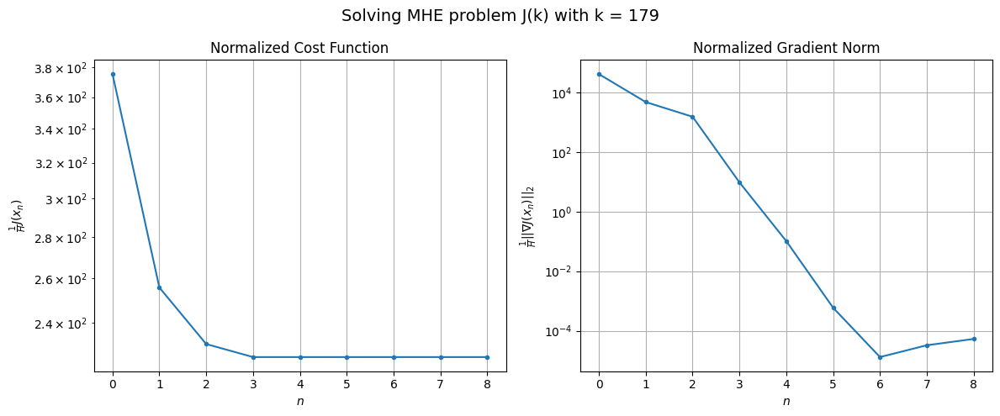

Windows:  44%|████▍     | 171/386 [09:35<11:00,  3.07s/it]

[Gauss-Newton] Before applying the algorithm
Cost function: 3848.248519178705
Gradient norm: 414903.6091649908
Global estimation error: 990.0470040251738
Initial conditions estimation errors: 1.1834957535808015 m, 356.63719587387374 m, 417.1907798351471 m, 823.9859523827754 m
Position estimation errors: 6.571369736463385 m, 222.17965666808558 m, 334.20732470996273 m, 318.53548561681623 m

[Gauss-Newton] Iteration 1
Cost function: 40808.68739946873 (960.45%)
Gradient norm: 421413.76163304696 (1.57%)
Global estimation error: 683.2228558486694 (-30.99%)
Initial conditions estimation errors: 3.4840096918286636 m, 250.5344538887115 m, 267.68858760120105 m, 576.5035246110851 m
Position estimation errors: 3.6096251086659863 m, 312.168633768055 m, 375.6156594067797 m, 685.4405854632612 m

[Gauss-Newton] Iteration 2
Cost function: 2389.157220435647 (-94.15%)
Gradient norm: 5389.5593824675925 (-98.72%)
Global estimation error: 523.3995645007351 (-23.39%)
Initial conditions estimation errors: 3.4

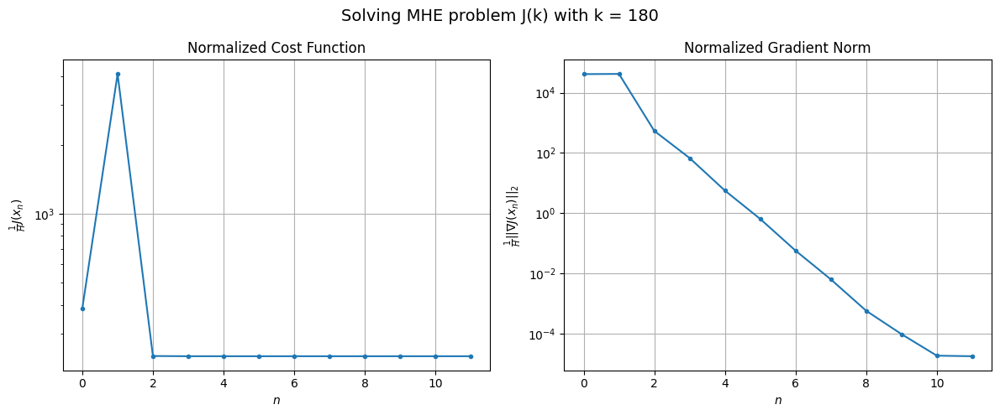

Windows:  45%|████▍     | 172/386 [09:39<11:47,  3.31s/it]

[Gauss-Newton] Before applying the algorithm
Cost function: 3892.485569676812
Gradient norm: 408198.5605349188
Global estimation error: 606.6973661120319
Initial conditions estimation errors: 1.141549745962072 m, 226.86884018168155 m, 250.20678758024346 m, 503.99137393138784 m
Position estimation errors: 6.551758437665187 m, 264.73578632690993 m, 328.00319912501493 m, 569.771330570745 m

[Gauss-Newton] Iteration 1
Cost function: 17120.11999514319 (339.82%)
Gradient norm: 260148.38798102594 (-36.27%)
Global estimation error: 721.1513725923428 (18.87%)
Initial conditions estimation errors: 3.4411823999024387 m, 242.6936908175458 m, 264.6317459605912 m, 625.3934523872924 m
Position estimation errors: 3.623519250691273 m, 151.8602023069255 m, 195.67333655127584 m, 257.846887114164 m

[Gauss-Newton] Iteration 2
Cost function: 2454.90504001171 (-85.66%)
Gradient norm: 2025.590089694507 (-99.22%)
Global estimation error: 622.9642949313453 (-13.62%)
Initial conditions estimation errors: 3.4411

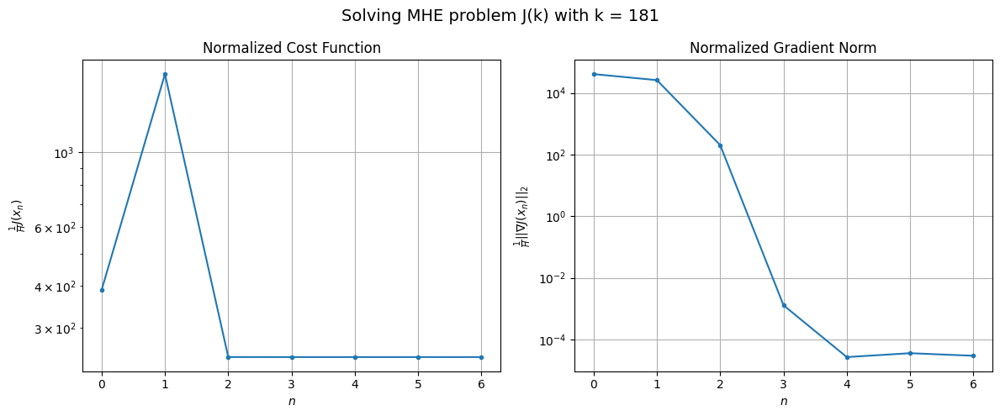

Windows:  45%|████▍     | 173/386 [09:42<11:02,  3.11s/it]

[Gauss-Newton] Before applying the algorithm
Cost function: 3811.0374432149674
Gradient norm: 395903.6599347866
Global estimation error: 589.253301468639
Initial conditions estimation errors: 1.1337732788710897 m, 200.24918005957187 m, 220.20687561366228 m, 508.55381508620405 m
Position estimation errors: 6.364575181290525 m, 98.06693718099196 m, 136.92584918074164 m, 131.39929706554398 m

[Gauss-Newton] Iteration 1
Cost function: 39806.364797719914 (944.50%)
Gradient norm: 473447.74058963155 (19.59%)
Global estimation error: 846.8703860952626 (43.72%)
Initial conditions estimation errors: 3.456130931461228 m, 307.05090652752745 m, 322.6187164138849 m, 720.2864044420471 m
Position estimation errors: 3.4858171865381005 m, 510.26101342209665 m, 609.3540655552965 m, 1150.0348049704403 m

[Gauss-Newton] Iteration 2
Cost function: 2735.340869310301 (-93.13%)
Gradient norm: 41919.63363913862 (-91.15%)
Global estimation error: 1337.3086225261434 (57.91%)
Initial conditions estimation errors: 

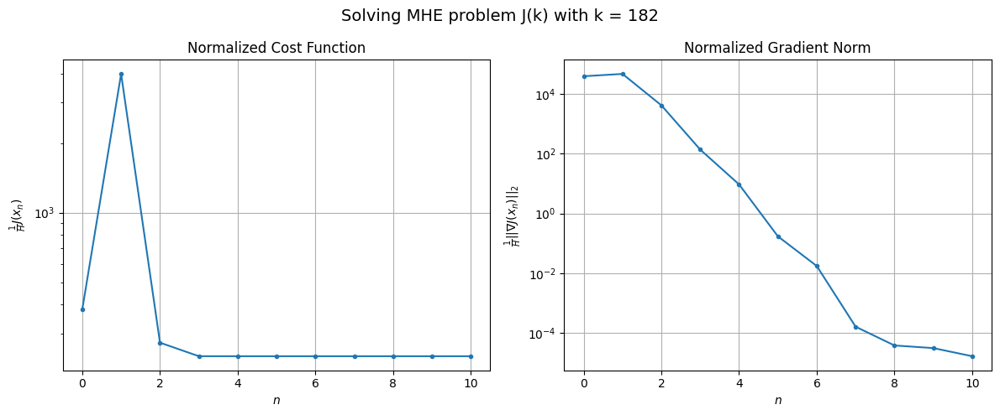

Windows:  45%|████▌     | 174/386 [09:46<11:34,  3.27s/it]

[Gauss-Newton] Before applying the algorithm
Cost function: 3458.1595517640826
Gradient norm: 361743.8198707731
Global estimation error: 1531.538657966831
Initial conditions estimation errors: 1.1609191369726166 m, 559.3332755726201 m, 618.2714830764969 m, 1284.7155716174125 m
Position estimation errors: 5.943740497369329 m, 732.5126063266567 m, 900.9279324109164 m, 1567.4377680050582 m

[Gauss-Newton] Iteration 1
Cost function: 267803.9680727526 (7644.12%)
Gradient norm: 988763.888470657 (173.33%)
Global estimation error: 4429.964470774069 (189.25%)
Initial conditions estimation errors: 3.3977874308961304 m, 1642.1528393929577 m, 1910.0660633227963 m, 3644.112237129888 m
Position estimation errors: 3.262879841897411 m, 1520.7230033941605 m, 2007.1800771543428 m, 2797.165315811152 m

[Gauss-Newton] STOP on Iteration 2 (gradient norm stagnated)
Cost function = 4141.740916147438 (-98.45%)
Gradient norm = 116976.91977677135 (-88.17%)
Global estimation error = 4947.742907358843 (11.69%)
Fi

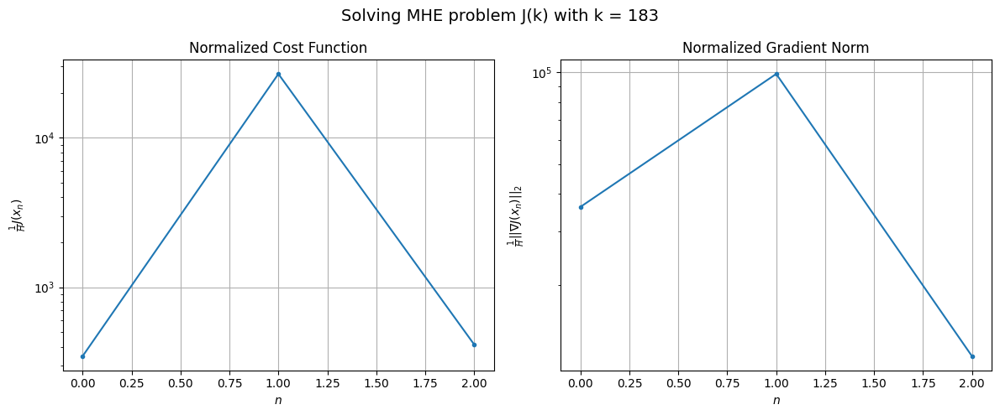

Windows:  45%|████▌     | 175/386 [09:47<09:38,  2.74s/it]

[Gauss-Newton] Before applying the algorithm
Cost function: 5414.835636651978
Gradient norm: 371359.4539307505
Global estimation error: 4992.942411760818
Initial conditions estimation errors: 1.1333399739023513 m, 1870.1952180551837 m, 2206.7980294106214 m, 4069.629377102946 m
Position estimation errors: 5.429083198084416 m, 1801.7785070983027 m, 2362.591045847964 m, 3336.906582246757 m

[Gauss-Newton] Iteration 1
Cost function: 3127.8351419045566 (-42.24%)
Gradient norm: 71613.98303921026 (-80.72%)
Global estimation error: 4296.474056169982 (-13.95%)
Initial conditions estimation errors: 3.2290205881447562 m, 1613.630029676778 m, 1926.9426611270162 m, 3484.647429400539 m
Position estimation errors: 2.9152808540550588 m, 1579.0839392621351 m, 2040.7472569926379 m, 2968.819292306294 m

[Gauss-Newton] Iteration 2
Cost function: 19217.354971771878 (514.40%)
Gradient norm: 312855.8426113192 (336.86%)
Global estimation error: 3096.3148723089453 (-27.93%)
Initial conditions estimation errors

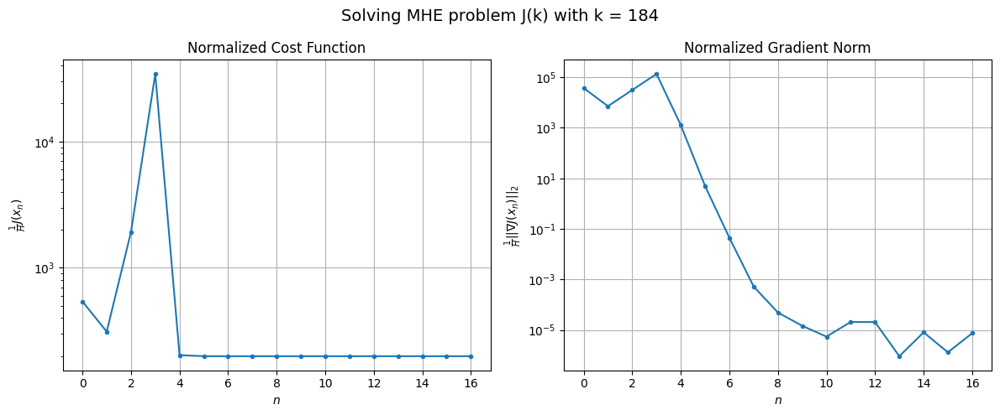

Windows:  46%|████▌     | 176/386 [09:52<12:10,  3.48s/it]

[Gauss-Newton] Before applying the algorithm
Cost function: 2521.4006578108324
Gradient norm: 281309.79047380004
Global estimation error: 105.27089281378086
Initial conditions estimation errors: 1.0472885913300765 m, 36.729423242820175 m, 50.386055523830734 m, 84.81115942380265 m
Position estimation errors: 4.833254169173879 m, 45.46598116852807 m, 61.57897831730289 m, 54.667145482777514 m

[Gauss-Newton] Iteration 1
Cost function: 1592.6735142135653 (-36.83%)
Gradient norm: 4614.501387302437 (-98.36%)
Global estimation error: 275.74645867163736 (161.94%)
Initial conditions estimation errors: 3.0198580018491756 m, 113.55040116216078 m, 159.16932229843462 m, 194.41553617756296 m
Position estimation errors: 2.6340143963247646 m, 106.1140751619014 m, 93.84719608126453 m, 257.1567764494363 m

[Gauss-Newton] Iteration 2
Cost function: 1612.8255755271898 (1.27%)
Gradient norm: 10259.597472849126 (122.33%)
Global estimation error: 48.81114734285596 (-82.30%)
Initial conditions estimation erro

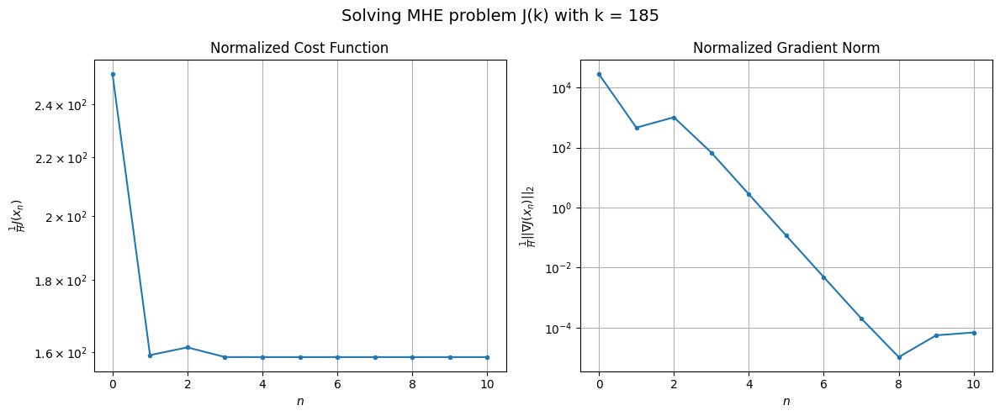

Windows:  46%|████▌     | 177/386 [09:56<12:15,  3.52s/it]

[Gauss-Newton] Before applying the algorithm
Cost function: 2082.7141369960354
Gradient norm: 250569.90410511452
Global estimation error: 142.86475675310072
Initial conditions estimation errors: 0.9987929669214816 m, 47.57703974970829 m, 34.14837103664094 m, 130.302526220536 m
Position estimation errors: 4.388419691882068 m, 236.8820055406052 m, 265.335279238981 m, 478.28157906593617 m

[Gauss-Newton] Iteration 1
Cost function: 34597.65154419706 (1561.18%)
Gradient norm: 449109.80404341756 (79.24%)
Global estimation error: 1465.1700172161507 (925.56%)
Initial conditions estimation errors: 2.7370819108690703 m, 559.4697368095756 m, 669.8407866136793 m, 1176.8684348801612 m
Position estimation errors: 2.424306287592287 m, 853.4917402463053 m, 1048.6508494877337 m, 1650.107600660481 m

[Gauss-Newton] Iteration 2
Cost function: 1336.5961977651596 (-96.14%)
Gradient norm: 9644.115101706828 (-97.85%)
Global estimation error: 1276.1572779653509 (-12.90%)
Initial conditions estimation errors: 

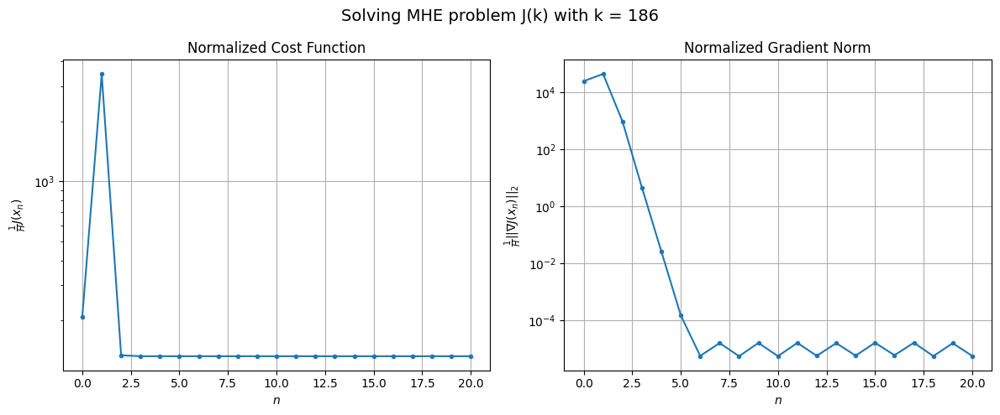

Windows:  46%|████▌     | 178/386 [10:02<15:08,  4.37s/it]

[Gauss-Newton] Before applying the algorithm
Cost function: 1811.3554965190306
Gradient norm: 227492.07261207837
Global estimation error: 1388.0457568872175
Initial conditions estimation errors: 0.9464964096635973 m, 532.8006773798163 m, 637.4986491674746 m, 1111.9292038361802 m
Position estimation errors: 4.143433579462045 m, 782.9559209183849 m, 957.9262568082644 m, 1505.866137801957 m

[Gauss-Newton] Iteration 1
Cost function: 1552310.279302821 (85598.82%)
Gradient norm: 2898779.3206163566 (1174.23%)
Global estimation error: 2412.7887132124324 (73.83%)
Initial conditions estimation errors: 2.51616652312837 m, 939.3379910171379 m, 1189.3556256126321 m, 1877.397128098205 m
Position estimation errors: 2.344380479705388 m, 756.9792984907322 m, 1028.2905715981499 m, 1254.0094122552396 m

[Gauss-Newton] Iteration 2
Cost function: 73851.25627024424 (-95.24%)
Gradient norm: 593081.395743784 (-79.54%)
Global estimation error: 523.1484755106527 (-78.32%)
Initial conditions estimation errors: 

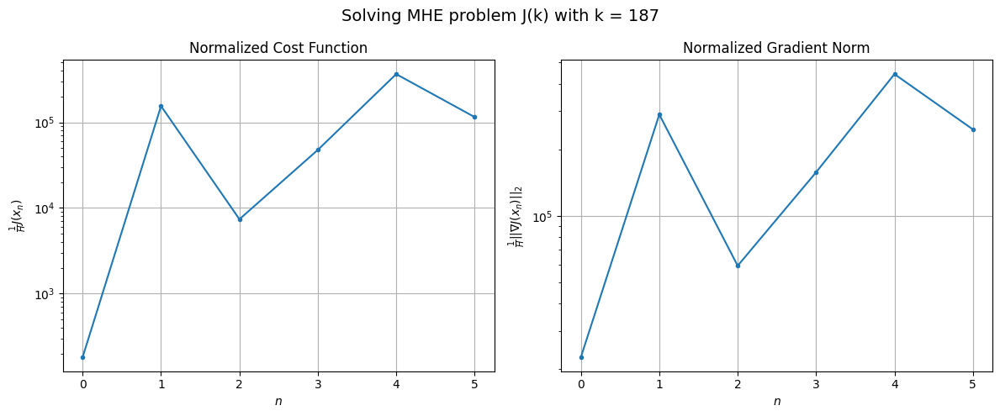

Windows:  46%|████▋     | 179/386 [10:05<12:57,  3.76s/it]

[Gauss-Newton] Before applying the algorithm
Cost function: 1137338.8624168674
Gradient norm: 2460654.564578514
Global estimation error: 2224.2154559373057
Initial conditions estimation errors: 0.9354236378199821 m, 872.9238815072184 m, 1110.4442221915776 m, 1718.1532822083068 m
Position estimation errors: 4.105724633029435 m, 697.068409499306 m, 955.5875407159507 m, 1149.7547907534336 m

[Gauss-Newton] Iteration 1
Cost function: 5724205.3555463515 (403.30%)
Gradient norm: 5406429.314714039 (119.72%)
Global estimation error: 3233.901617013406 (45.40%)
Initial conditions estimation errors: 2.433102212473102 m, 1287.8531527739392 m, 1646.9049280541644 m, 2467.2353593185994 m
Position estimation errors: 2.333154833425181 m, 1372.3313970518404 m, 1837.2105412918088 m, 2409.690804611383 m

[Gauss-Newton] STOP on Iteration 2 (gradient norm stagnated)
Cost function = 1810946.3833839989 (-68.36%)
Gradient norm = 3081593.1982244267 (-43.00%)
Global estimation error = 880.5984072993356 (-72.77%)

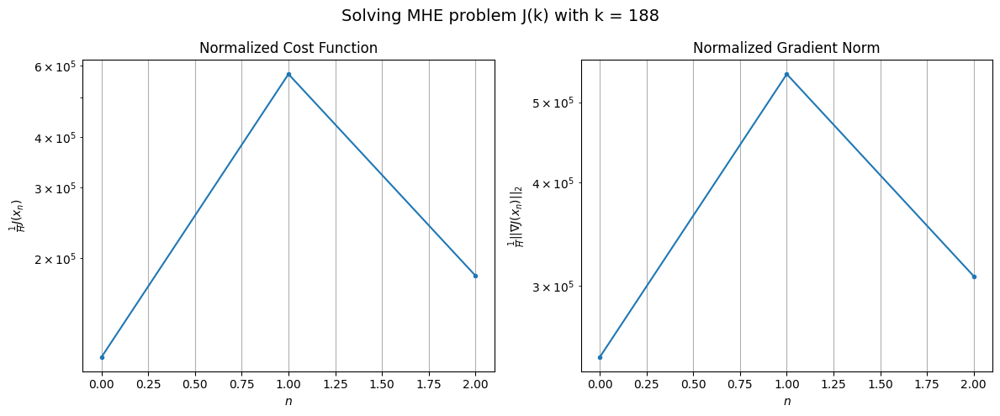

Windows:  47%|████▋     | 180/386 [10:06<10:27,  3.05s/it]

[Gauss-Newton] Before applying the algorithm
Cost function: 1768945.531586672
Gradient norm: 3026260.8710609796
Global estimation error: 858.5051826288125
Initial conditions estimation errors: 0.9664695144230662 m, 341.9527748305313 m, 453.7253793382556 m, 643.6082525159861 m
Position estimation errors: 4.1325915655685606 m, 230.94546233829203 m, 339.83935847589674 m, 316.9288818631365 m

[Gauss-Newton] Iteration 1
Cost function: 87586.28934389855 (-95.05%)
Gradient norm: 606305.3495908999 (-79.97%)
Global estimation error: 1271.8471767016363 (48.15%)
Initial conditions estimation errors: 2.417992807648103 m, 509.735835820716 m, 599.3639670566404 m, 999.2604573150022 m
Position estimation errors: 2.344296749299794 m, 434.3452576383741 m, 640.6491630473358 m, 769.8949982428826 m

[Gauss-Newton] Iteration 2
Cost function: 2578.911546054606 (-97.06%)
Gradient norm: 82141.84452699436 (-86.45%)
Global estimation error: 554.8635190021683 (-56.37%)
Initial conditions estimation errors: 2.4179

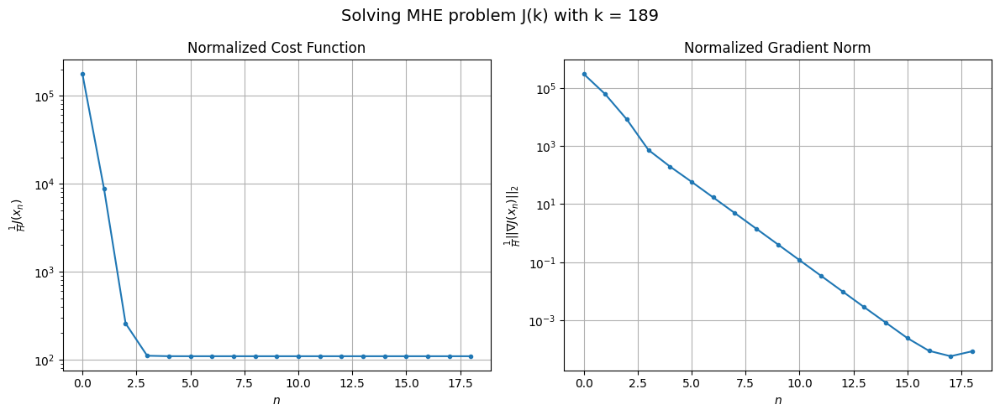

Windows:  47%|████▋     | 181/386 [10:12<13:22,  3.91s/it]

[Gauss-Newton] Before applying the algorithm
Cost function: 1664.6157941811184
Gradient norm: 223339.87855867145
Global estimation error: 712.978593476445
Initial conditions estimation errors: 0.960680613795716 m, 281.6318903265283 m, 314.00462382473785 m, 574.8234939547739 m
Position estimation errors: 4.098898357820037 m, 232.18561838239833 m, 350.8016868771588 m, 429.41789550543325 m

[Gauss-Newton] Iteration 1
Cost function: 3960480.2928006733 (237821.59%)
Gradient norm: 4623058.184157421 (1969.97%)
Global estimation error: 4035.128519622491 (465.95%)
Initial conditions estimation errors: 2.435896727238487 m, 1629.674777676488 m, 2210.9568518089586 m, 2956.0249392940314 m
Position estimation errors: 2.2970171158992354 m, 1741.7300538075565 m, 2285.9756615160477 m, 2889.1131346795933 m

[Gauss-Newton] Iteration 2
Cost function: 4678608.16846022 (18.13%)
Gradient norm: 4964290.772624372 (7.38%)
Global estimation error: 1100.3896710390661 (-72.73%)
Initial conditions estimation errors

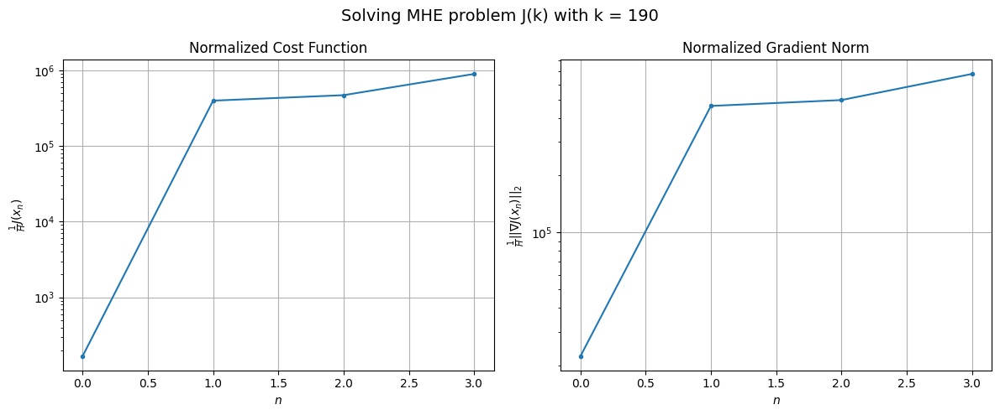

Windows:  47%|████▋     | 182/386 [10:14<11:14,  3.31s/it]

[Gauss-Newton] Before applying the algorithm
Cost function: 8689274.575889947
Gradient norm: 6628365.417837765
Global estimation error: 5063.707716564288
Initial conditions estimation errors: 0.9199478631544731 m, 2060.1182037665067 m, 2764.4641812887007 m, 3708.7441898601087 m
Position estimation errors: 3.9026703117028276 m, 2031.2558744300113 m, 2714.221974847023 m, 3334.744770517633 m

[Gauss-Newton] Iteration 1
Cost function: 7339770.775764948 (-15.53%)
Gradient norm: 6393354.469355651 (-3.55%)
Global estimation error: 707.8541022835071 (-86.02%)
Initial conditions estimation errors: 2.399079666491918 m, 322.84501430320006 m, 462.7689244338162 m, 427.39527570562416 m
Position estimation errors: 2.081703267736712 m, 373.4304345332416 m, 645.9556901465852 m, 692.7939196246555 m



/home/jgaspar/SpaceSim-Toolkit/test/new_newton_based_algorithms/gauss_newton.py:181: LinAlgWarning: Ill-conditioned matrix (rcond=8.35917e-17): result may not be accurate.
  delta_x = solve(HJ_x, -DJ_x)


[Gauss-Newton] STOP on Iteration 2 (gradient norm stagnated)
Cost function = 1746772.9818191922 (-76.20%)
Gradient norm = 3076805.268125168 (-51.87%)
Global estimation error = 3480.835910000434 (391.74%)
Final initial conditions estimation errors: 2.3990796283694835 m, 1384.4289838043007 m, 1832.5987739611344 m, 2615.5593128656697 m
Final position estimation errors: 2.0817033151927227 m, 1324.136231109825 m, 1685.7697403411653 m, 2117.0524286963728 m



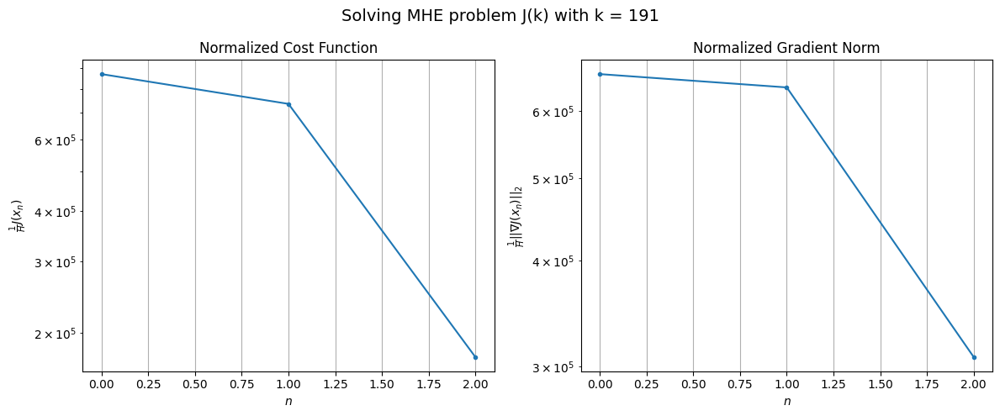

Windows:  47%|████▋     | 183/386 [10:15<09:12,  2.72s/it]

[Gauss-Newton] Before applying the algorithm
Cost function: 1736309.2303332668
Gradient norm: 3037554.849241996
Global estimation error: 3487.4795621257535
Initial conditions estimation errors: 0.8447093631619182 m, 1403.5647571341046 m, 1846.4141603992334 m, 2604.471785175746 m
Position estimation errors: 3.469794161177121 m, 1285.9065732881934 m, 1632.942108646155 m, 2010.8808356511786 m

[Gauss-Newton] Iteration 1
Cost function: 48383.10470531739 (-97.21%)
Gradient norm: 370876.21107313456 (-87.79%)
Global estimation error: 1522.0734351007625 (-56.36%)
Initial conditions estimation errors: 2.237839335967554 m, 627.4465642236571 m, 873.6175451273064 m, 1076.9420732983533 m
Position estimation errors: 1.8849666635702607 m, 806.7216936862735 m, 1008.8456827656265 m, 1301.733280555731 m



/home/jgaspar/SpaceSim-Toolkit/test/new_newton_based_algorithms/gauss_newton.py:181: LinAlgWarning: Ill-conditioned matrix (rcond=4.74206e-17): result may not be accurate.
  delta_x = solve(HJ_x, -DJ_x)


[Gauss-Newton] Iteration 2
Cost function: 2235.7204562614907 (-95.38%)
Gradient norm: 78356.4854745154 (-78.87%)
Global estimation error: 2220.1050475749853 (45.86%)
Initial conditions estimation errors: 2.2378393335484406 m, 912.8861513428079 m, 1249.3485146009984 m, 1592.0512535904836 m
Position estimation errors: 1.8849666824368447 m, 1034.9905703565305 m, 1354.865791766069 m, 1668.7647169117017 m



/home/jgaspar/SpaceSim-Toolkit/test/new_newton_based_algorithms/gauss_newton.py:181: LinAlgWarning: Ill-conditioned matrix (rcond=9.07191e-17): result may not be accurate.
  delta_x = solve(HJ_x, -DJ_x)


[Gauss-Newton] Iteration 3
Cost function: 868.8095746244209 (-61.14%)
Gradient norm: 389.73671151430796 (-99.50%)
Global estimation error: 2172.521496585012 (-2.14%)
Initial conditions estimation errors: 2.237839335945894 m, 893.9619546232874 m, 1220.984532468949 m, 1558.8046971112935 m
Position estimation errors: 1.8849666817535207 m, 1012.9030204062097 m, 1338.9928339151677 m, 1634.3248878088496 m



/home/jgaspar/SpaceSim-Toolkit/test/new_newton_based_algorithms/gauss_newton.py:181: LinAlgWarning: Ill-conditioned matrix (rcond=8.73522e-17): result may not be accurate.
  delta_x = solve(HJ_x, -DJ_x)


[Gauss-Newton] Iteration 4
Cost function: 870.9733808461094 (0.25%)
Gradient norm: 3370.386094961283 (764.79%)
Global estimation error: 2304.1457074383216 (6.06%)
Initial conditions estimation errors: 2.2378393361211915 m, 948.6456847511308 m, 1293.65845225678 m, 1653.964987561829 m
Position estimation errors: 1.8849666819040518 m, 1061.0463370052846 m, 1416.0669558532948 m, 1713.824942996099 m



/home/jgaspar/SpaceSim-Toolkit/test/new_newton_based_algorithms/gauss_newton.py:181: LinAlgWarning: Ill-conditioned matrix (rcond=9.859e-17): result may not be accurate.
  delta_x = solve(HJ_x, -DJ_x)


[Gauss-Newton] Iteration 5
Cost function: 868.7907507725322 (-0.25%)
Gradient norm: 342.509401946064 (-89.84%)
Global estimation error: 2346.301273114691 (1.83%)
Initial conditions estimation errors: 2.237839336611076 m, 966.2398326280431 m, 1316.5224046947064 m, 1684.717351241421 m
Position estimation errors: 1.8849666823648208 m, 1075.4412743002372 m, 1441.890067984449 m, 1737.7907212112848 m



/home/jgaspar/SpaceSim-Toolkit/test/new_newton_based_algorithms/gauss_newton.py:181: LinAlgWarning: Ill-conditioned matrix (rcond=1.02405e-16): result may not be accurate.
  delta_x = solve(HJ_x, -DJ_x)


[Gauss-Newton] Iteration 6
Cost function: 868.775110644695 (-0.00%)
Gradient norm: 204.1809868762942 (-40.39%)
Global estimation error: 2378.7462877275693 (1.38%)
Initial conditions estimation errors: 2.2378393367863736 m, 979.7538455045974 m, 1334.2807162642696 m, 1708.2753883464857 m
Position estimation errors: 1.8849666823149616 m, 1086.901656420426 m, 1461.3886992098774 m, 1756.8083264001214 m



/home/jgaspar/SpaceSim-Toolkit/test/new_newton_based_algorithms/gauss_newton.py:181: LinAlgWarning: Ill-conditioned matrix (rcond=1.05401e-16): result may not be accurate.
  delta_x = solve(HJ_x, -DJ_x)


[Gauss-Newton] Iteration 7
Cost function: 868.7674251754497 (-0.00%)
Gradient norm: 61.592108190117095 (-69.83%)
Global estimation error: 2396.6017702108193 (0.75%)
Initial conditions estimation errors: 2.2378393370100538 m, 987.195574260185 m, 1344.022571966503 m, 1721.2616851445014 m
Position estimation errors: 1.8849666824368447 m, 1093.1250785643308 m, 1472.1845500734644 m, 1767.14569732189 m



/home/jgaspar/SpaceSim-Toolkit/test/new_newton_based_algorithms/gauss_newton.py:181: LinAlgWarning: Ill-conditioned matrix (rcond=1.07074e-16): result may not be accurate.
  delta_x = solve(HJ_x, -DJ_x)


[Gauss-Newton] Iteration 8
Cost function: 868.7666722431061 (-0.00%)
Gradient norm: 23.540132316745126 (-61.78%)
Global estimation error: 2407.631737509307 (0.46%)
Initial conditions estimation errors: 2.2378393370100538 m, 991.7920821931809 m, 1350.046221389379 m, 1729.2795503115283 m
Position estimation errors: 1.8849666820273174 m, 1096.982557966818 m, 1478.8471462250245 m, 1773.5530263513926 m



/home/jgaspar/SpaceSim-Toolkit/test/new_newton_based_algorithms/gauss_newton.py:181: LinAlgWarning: Ill-conditioned matrix (rcond=1.08116e-16): result may not be accurate.
  delta_x = solve(HJ_x, -DJ_x)


[Gauss-Newton] Iteration 9
Cost function: 868.7665329562503 (-0.00%)
Gradient norm: 8.396148018736923 (-64.33%)
Global estimation error: 2414.2217154880304 (0.27%)
Initial conditions estimation errors: 2.2378393370100538 m, 994.5385292692516 m, 1353.6434262025398 m, 1734.0711030643681 m
Position estimation errors: 1.8849666824008326 m, 1099.28214111314 m, 1482.8309181724399 m, 1777.3730819195134 m



/home/jgaspar/SpaceSim-Toolkit/test/new_newton_based_algorithms/gauss_newton.py:181: LinAlgWarning: Ill-conditioned matrix (rcond=1.08742e-16): result may not be accurate.
  delta_x = solve(HJ_x, -DJ_x)


[Gauss-Newton] Iteration 10
Cost function: 868.7665045063168 (-0.00%)
Gradient norm: 3.087640119593219 (-63.23%)
Global estimation error: 2418.2173287297073 (0.17%)
Initial conditions estimation errors: 2.2378393370100538 m, 996.2037533762458 m, 1355.8246779973047 m, 1736.9761315694877 m
Position estimation errors: 1.884966681728591 m, 1100.6767281204636 m, 1485.2465520654769 m, 1779.689898369311 m



/home/jgaspar/SpaceSim-Toolkit/test/new_newton_based_algorithms/gauss_newton.py:181: LinAlgWarning: Ill-conditioned matrix (rcond=1.09122e-16): result may not be accurate.
  delta_x = solve(HJ_x, -DJ_x)


[Gauss-Newton] STOP on Iteration 11 (gradient norm stagnated)
Cost function = 868.7664967508681 (-0.00%)
Gradient norm = 1.1279772422964598 (-63.47%)
Global estimation error = 2420.63225232487 (0.10%)
Final initial conditions estimation errors: 2.2378393370100538 m, 997.2102202436662 m, 1357.142903692539 m, 1738.7319873181611 m
Final position estimation errors: 1.8849666824008326 m, 1101.5192261070983 m, 1486.706793243886 m, 1781.0895733936661 m



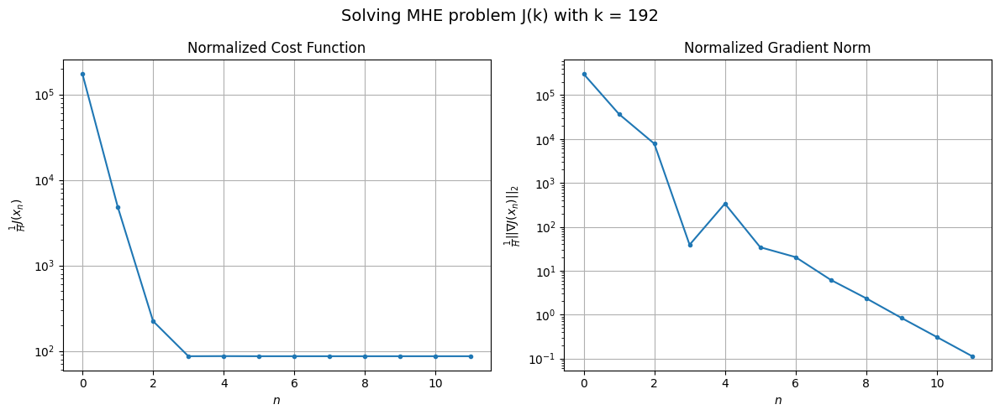

Windows:  48%|████▊     | 184/386 [10:19<10:35,  3.14s/it]

[Gauss-Newton] Before applying the algorithm
Cost function: 1101.869870333693
Gradient norm: 172737.41104184653
Global estimation error: 2481.0214283151727
Initial conditions estimation errors: 0.7207831207815306 m, 1028.7545169677296 m, 1394.8864945138507 m, 1775.2243516934284 m
Position estimation errors: 3.1074982768554436 m, 1087.8137394587907 m, 1470.7479288981035 m, 1746.362658101535 m

[Gauss-Newton] Iteration 1
Cost function: 1921839.0909138569 (174316.16%)
Gradient norm: 3366424.2539172494 (1848.87%)
Global estimation error: 1168.8846464336038 (-52.89%)
Initial conditions estimation errors: 2.017577466775142 m, 500.9676887179715 m, 773.1201764416106 m, 719.4457343635904 m
Position estimation errors: 1.6555929564700331 m, 627.7680002359962 m, 909.0389784930067 m, 1145.4357440808817 m



/home/jgaspar/SpaceSim-Toolkit/test/new_newton_based_algorithms/gauss_newton.py:181: LinAlgWarning: Ill-conditioned matrix (rcond=3.14528e-17): result may not be accurate.
  delta_x = solve(HJ_x, -DJ_x)


[Gauss-Newton] Iteration 2
Cost function: 5304289.089546921 (176.00%)
Gradient norm: 5150699.892445567 (53.00%)
Global estimation error: 4166.866960423173 (256.48%)
Initial conditions estimation errors: 2.0175774783382208 m, 1704.0517934781387 m, 2239.640832051313 m, 3072.94509871235 m
Position estimation errors: 1.6555929642433185 m, 1381.7015962612456 m, 1966.4753946909204 m, 2117.372091132367 m

[Gauss-Newton] STOP on Iteration 3 (gradient norm stagnated)
Cost function = 1300798.4320701119 (-75.48%)
Gradient norm = 2565903.0070486506 (-50.18%)
Global estimation error = 543.2922863893946 (-86.96%)
Final initial conditions estimation errors: 2.0175774791448666 m, 199.77740961323386 m, 197.20758281821404 m, 465.14432018041344 m
Final position estimation errors: 1.6555929637826485 m, 112.9177931089193 m, 147.3600985624231 m, 267.2306811631539 m



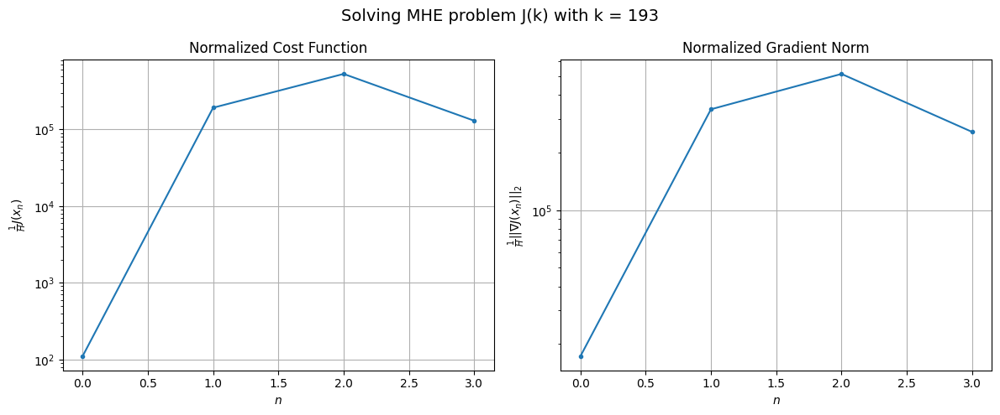

Windows:  48%|████▊     | 185/386 [10:21<09:21,  2.79s/it]

[Gauss-Newton] Before applying the algorithm
Cost function: 1251829.9984606302
Gradient norm: 2476073.6961993263
Global estimation error: 484.2581802477524
Initial conditions estimation errors: 0.5964507838530296 m, 183.6086647381703 m, 187.45091864491954 m, 407.00638740381055 m
Position estimation errors: 2.8090140518610975 m, 123.16634526919793 m, 147.76048494130345 m, 322.01578140137417 m



/home/jgaspar/SpaceSim-Toolkit/test/new_newton_based_algorithms/gauss_newton.py:181: LinAlgWarning: Ill-conditioned matrix (rcond=1.71102e-17): result may not be accurate.
  delta_x = solve(HJ_x, -DJ_x)


[Gauss-Newton] Iteration 1
Cost function: 4926119.847636998 (293.51%)
Gradient norm: 5090792.750688405 (105.60%)
Global estimation error: 4661.331481353527 (862.57%)
Initial conditions estimation errors: 1.744463704162419 m, 1945.2734176495119 m, 2802.860770196185 m, 3176.143067244167 m
Position estimation errors: 1.5159275281670008 m, 2094.2493367012557 m, 2956.287764444262 m, 3543.36236713387 m

[Gauss-Newton] Iteration 2
Cost function: 38108515.784558035 (673.60%)
Gradient norm: 12955015.26765046 (154.48%)
Global estimation error: 4738.052895459274 (1.65%)
Initial conditions estimation errors: 1.7444637576834474 m, 1926.1277803212529 m, 2451.4496577644413 m, 3567.8503760779845 m
Position estimation errors: 1.5159275307052682 m, 1051.4256614966382 m, 1505.6331777204455 m, 1379.2713359338484 m

[Gauss-Newton] Iteration 3
Cost function: 41955667.81373505 (10.10%)
Gradient norm: 14506983.626983164 (11.98%)
Global estimation error: 4701.110283950453 (-0.78%)
Initial conditions estimation

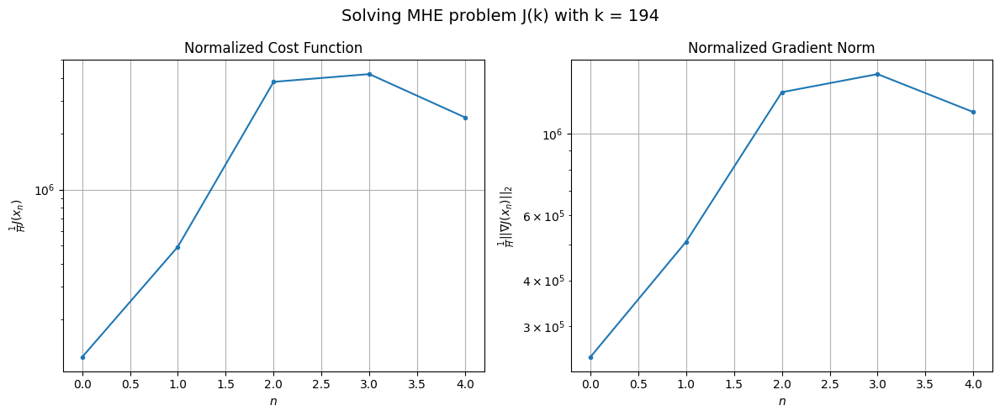

Windows:  48%|████▊     | 186/386 [10:23<08:29,  2.55s/it]

[Gauss-Newton] Before applying the algorithm
Cost function: 24175079.517257255
Gradient norm: 11184914.617637394
Global estimation error: 3114.485223390189
Initial conditions estimation errors: 0.4931404164557166 m, 1284.635641030578 m, 1643.256854650813 m, 2312.883444716864 m
Position estimation errors: 2.6821631358806948 m, 721.0764593475734 m, 1018.048963196963 m, 948.3864212021421 m



/home/jgaspar/SpaceSim-Toolkit/test/new_newton_based_algorithms/gauss_newton.py:181: LinAlgWarning: Ill-conditioned matrix (rcond=9.54649e-17): result may not be accurate.
  delta_x = solve(HJ_x, -DJ_x)


[Gauss-Newton] Iteration 1
Cost function: 28734201.53183026 (18.86%)
Gradient norm: 12444505.483362602 (11.26%)
Global estimation error: 10534.962364637964 (238.26%)
Initial conditions estimation errors: 1.5746564371102352 m, 4407.094876047372 m, 5989.068937978085 m, 7462.841005090179 m
Position estimation errors: 1.4659608488720566 m, 3706.349124475084 m, 5262.752109537278 m, 5934.168023757115 m

[Gauss-Newton] Iteration 2
Cost function: 1117873.0350318106 (-96.11%)
Gradient norm: 2618410.9424962634 (-78.96%)
Global estimation error: 7277.770181759359 (-30.92%)
Initial conditions estimation errors: 1.5746564226513882 m, 3026.7211422826485 m, 4010.540428955879 m, 5265.021756473625 m
Position estimation errors: 1.4659608691362087 m, 2131.3645301317542 m, 3053.8542708698856 m, 3161.1443836136136 m

[Gauss-Newton] Iteration 3
Cost function: 448.67188760365536 (-99.96%)
Gradient norm: 1492.2044358148862 (-99.94%)
Global estimation error: 7116.591205371265 (-2.21%)
Initial conditions estima

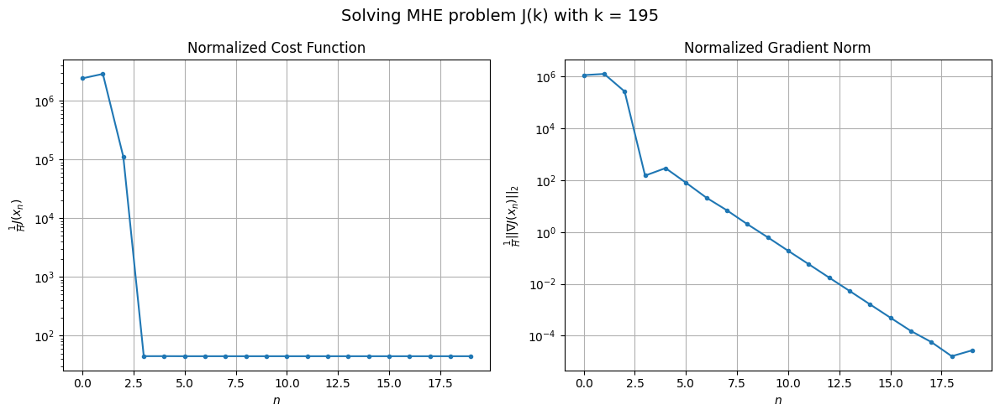

Windows:  48%|████▊     | 187/386 [10:29<12:07,  3.66s/it]

[Gauss-Newton] Before applying the algorithm
Cost function: 709.2821580000291
Gradient norm: 147584.5359862419
Global estimation error: 6960.755218047313
Initial conditions estimation errors: 0.4769285438565901 m, 2909.795546688397 m, 3881.6121789327276 m, 4991.821457414566 m
Position estimation errors: 2.6729245858475332 m, 1958.637481183783 m, 2846.737743980217 m, 2856.6221939020434 m

[Gauss-Newton] Iteration 1
Cost function: 7043909.409503334 (993003.99%)
Gradient norm: 2980726.7098750924 (1919.67%)
Global estimation error: 1254.2705938622223 (-81.98%)
Initial conditions estimation errors: 1.4637538710684392 m, 455.17665466282574 m, 580.1148562610219 m, 1014.6020174309845 m
Position estimation errors: 1.4733040984352248 m, 1074.091158518094 m, 1363.3668086374475 m, 2684.2093461519416 m



/home/jgaspar/SpaceSim-Toolkit/test/new_newton_based_algorithms/gauss_newton.py:181: LinAlgWarning: Ill-conditioned matrix (rcond=3.64364e-17): result may not be accurate.
  delta_x = solve(HJ_x, -DJ_x)


[Gauss-Newton] Iteration 2
Cost function: 17223746.13911178 (144.52%)
Gradient norm: 10898663.984774577 (265.64%)
Global estimation error: 5464.823508166078 (335.70%)
Initial conditions estimation errors: 1.4637538564687245 m, 2220.668533496082 m, 3257.7350991080575 m, 3784.1880352567655 m
Position estimation errors: 1.4733040968605342 m, 2106.329673787554 m, 2994.118922341738 m, 3510.6761907523464 m

[Gauss-Newton] Iteration 3
Cost function: 677407.9394733681 (-96.07%)
Gradient norm: 1668041.040512022 (-84.69%)
Global estimation error: 2024.5796723817202 (-62.95%)
Initial conditions estimation errors: 1.463753850543338 m, 808.3031996701903 m, 1292.5142052843146 m, 1332.2808120978104 m
Position estimation errors: 1.4733041091372663 m, 939.1929485801982 m, 1346.6998755188495 m, 1592.6001225906066 m



/home/jgaspar/SpaceSim-Toolkit/test/new_newton_based_algorithms/gauss_newton.py:181: LinAlgWarning: Ill-conditioned matrix (rcond=9.32372e-17): result may not be accurate.
  delta_x = solve(HJ_x, -DJ_x)


[Gauss-Newton] Iteration 4
Cost function: 189820.91605486715 (-71.98%)
Gradient norm: 1036056.8992646094 (-37.89%)
Global estimation error: 185.38314802771265 (-90.84%)
Initial conditions estimation errors: 1.4637538500577718 m, 97.01965055225747 m, 75.20592987964802 m, 138.9099221545564 m
Position estimation errors: 1.473304110547102 m, 55.31273851410185 m, 87.51210610550633 m, 76.30757821620277 m



/home/jgaspar/SpaceSim-Toolkit/test/new_newton_based_algorithms/gauss_newton.py:181: LinAlgWarning: Ill-conditioned matrix (rcond=8.89557e-18): result may not be accurate.
  delta_x = solve(HJ_x, -DJ_x)


[Gauss-Newton] Iteration 5
Cost function: 331866654.6236897 (174731.45%)
Gradient norm: 43639129.83151926 (4112.04%)
Global estimation error: 14038.239635614793 (7472.55%)
Initial conditions estimation errors: 1.463753853351179 m, 5933.10685094494 m, 8325.188368913592 m, 9620.893611287624 m
Position estimation errors: 1.473304108611155 m, 6178.798070586218 m, 8638.432264800664 m, 10826.515400113505 m

[Gauss-Newton] Iteration 6
Cost function: 56540841.16138278 (-82.96%)
Gradient norm: 17691371.9513834 (-59.46%)
Global estimation error: 4579.306894610524 (-67.38%)
Initial conditions estimation errors: 1.4637538328235005 m, 1955.615314823198 m, 2693.1692174206805 m, 3145.2263316510953 m
Position estimation errors: 1.4733041218617253 m, 2075.1715272740284 m, 2874.5252343633474 m, 3664.1704338807367 m

[Gauss-Newton] Iteration 7
Cost function: 132708.4671775458 (-99.77%)
Gradient norm: 869810.5387579852 (-95.08%)
Global estimation error: 2264.330635648258 (-50.55%)
Initial conditions estim

/home/jgaspar/SpaceSim-Toolkit/test/new_newton_based_algorithms/gauss_newton.py:181: LinAlgWarning: Ill-conditioned matrix (rcond=1.01732e-16): result may not be accurate.
  delta_x = solve(HJ_x, -DJ_x)


[Gauss-Newton] Iteration 8
Cost function: 595.8646556236952 (-99.55%)
Gradient norm: 29142.20782688543 (-96.65%)
Global estimation error: 2656.661285661778 (17.33%)
Initial conditions estimation errors: 1.463753852525076 m, 1156.4625345367751 m, 1521.4852123617063 m, 1845.4055518612888 m
Position estimation errors: 1.4733041069147852 m, 1183.6848357495728 m, 1623.5116454277759 m, 2120.964498382561 m

[Gauss-Newton] Iteration 9
Cost function: 425.47153962458793 (-28.60%)
Gradient norm: 4063.027003685862 (-86.06%)
Global estimation error: 2535.1944580829613 (-4.57%)
Initial conditions estimation errors: 1.4637538522074418 m, 1105.2831483826558 m, 1446.8778690851332 m, 1764.1145448412428 m
Position estimation errors: 1.4733041074902595 m, 1125.2314250500312 m, 1541.6510852561728 m, 2018.2607196418498 m

[Gauss-Newton] Iteration 10
Cost function: 422.7394078681168 (-0.64%)
Gradient norm: 15.45733874216249 (-99.62%)
Global estimation error: 2541.618036627342 (0.25%)
Initial conditions estim

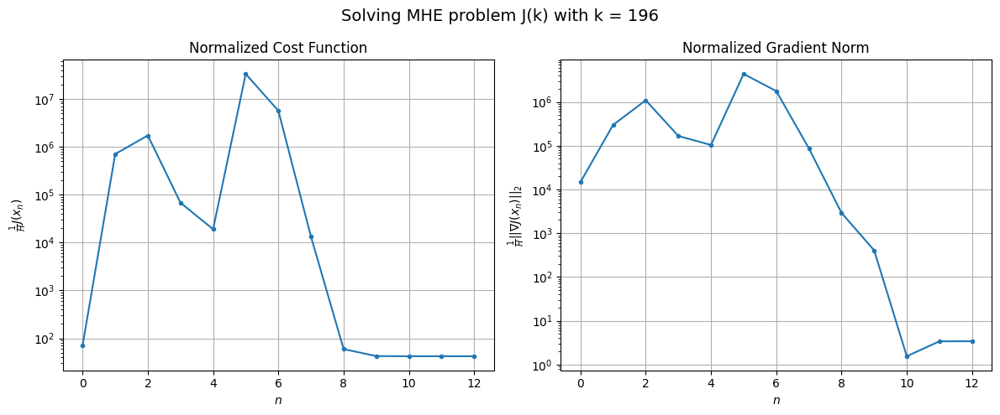

Windows:  49%|████▊     | 188/386 [10:34<13:00,  3.94s/it]

[Gauss-Newton] Before applying the algorithm
Cost function: 717.0102251683875
Gradient norm: 152245.8244564596
Global estimation error: 2614.487682174256
Initial conditions estimation errors: 0.5107925007587732 m, 1131.5603116792363 m, 1486.6349986825257 m, 1828.9427024093895 m
Position estimation errors: 2.723481386444161 m, 1105.1721640916658 m, 1525.9570975591234 m, 2011.1325341332122 m

[Gauss-Newton] Iteration 1
Cost function: 8502428.815182349 (1185716.95%)
Gradient norm: 7137852.347889126 (4588.37%)
Global estimation error: 2601.456231422329 (-0.50%)
Initial conditions estimation errors: 1.4660581157148491 m, 1067.7637673616255 m, 1633.8185236039008 m, 1719.9081617738261 m
Position estimation errors: 1.5015821587380356 m, 1323.7127218618298 m, 1842.9818668208588 m, 2430.7380531294766 m

[Gauss-Newton] Iteration 2
Cost function: 19853864.22437531 (133.51%)
Gradient norm: 10545687.700107448 (47.74%)
Global estimation error: 4321.755879171718 (66.13%)
Initial conditions estimation 

/home/jgaspar/SpaceSim-Toolkit/test/new_newton_based_algorithms/gauss_newton.py:181: LinAlgWarning: Ill-conditioned matrix (rcond=2.98791e-17): result may not be accurate.
  delta_x = solve(HJ_x, -DJ_x)


[Gauss-Newton] Iteration 4
Cost function: 123577162.72224168 (1438.66%)
Gradient norm: 26424775.764647994 (293.44%)
Global estimation error: 9682.272200917536 (616.49%)
Initial conditions estimation errors: 1.4660581187935842 m, 4073.6350553288826 m, 5696.811492363915 m, 6685.67238021171 m
Position estimation errors: 1.5015821528143254 m, 3974.688838582608 m, 5571.145471795852 m, 6941.784305509466 m

[Gauss-Newton] Iteration 5
Cost function: 26237567.588949863 (-78.77%)
Gradient norm: 12039731.975097995 (-54.44%)
Global estimation error: 2202.205180118472 (-77.26%)
Initial conditions estimation errors: 1.4660581149153469 m, 938.4387700030027 m, 1253.9784492359852 m, 1548.0878813546249 m
Position estimation errors: 1.5015821537253942 m, 827.2926082769651 m, 1157.3807418115998 m, 1405.874102837645 m

[Gauss-Newton] STOP on Iteration 6 (gradient norm stagnated)
Cost function = 21684512.590587746 (-17.35%)
Gradient norm = 11136685.56050005 (-7.50%)
Global estimation error = 5035.1092548321

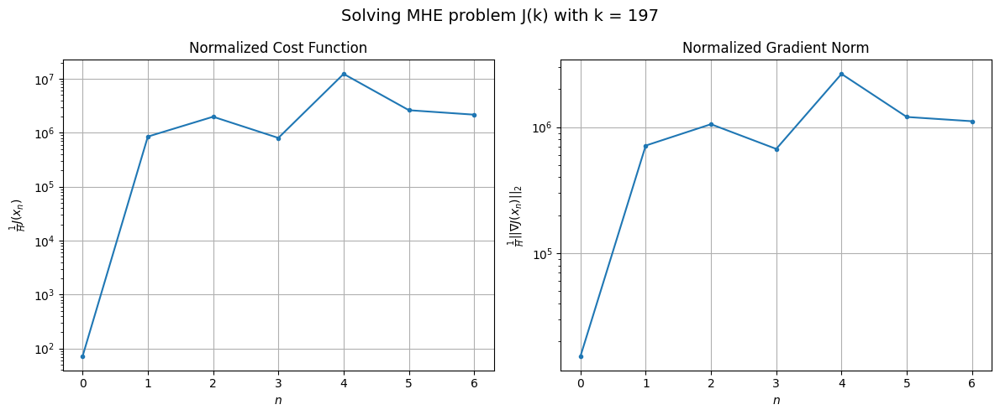

Windows:  49%|████▉     | 189/386 [10:37<11:38,  3.55s/it]

[Gauss-Newton] Before applying the algorithm
Cost function: 22163911.69737012
Gradient norm: 11091739.856317911
Global estimation error: 5220.44767549153
Initial conditions estimation errors: 0.56301921298644 m, 2160.046710669057 m, 3157.8180798951053 m, 3551.8229985165403 m
Position estimation errors: 2.771042710750175 m, 2336.615213920785 m, 3245.367005420181 m, 4263.944145497741 m

[Gauss-Newton] Iteration 1
Cost function: 132492.85181860984 (-99.40%)
Gradient norm: 900907.292484724 (-91.88%)
Global estimation error: 3243.5310026189522 (-37.87%)
Initial conditions estimation errors: 1.4528276297390836 m, 1324.962547484224 m, 2016.5656883946579 m, 2167.5851341586667 m
Position estimation errors: 1.6317531463423445 m, 1400.9638994635523 m, 1948.3040570747612 m, 2503.868994176138 m

[Gauss-Newton] Iteration 2
Cost function: 520.263358107744 (-99.61%)
Gradient norm: 16712.908773162024 (-98.14%)
Global estimation error: 3510.5429814179706 (8.23%)
Initial conditions estimation errors: 1.4

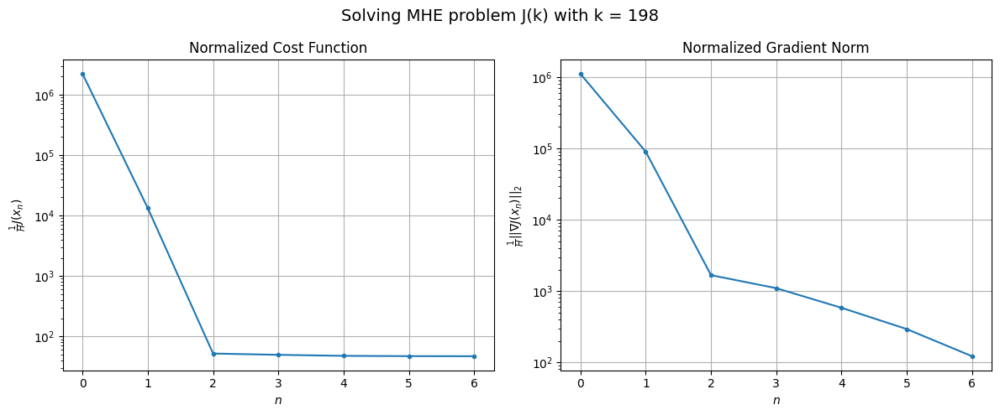

Windows:  49%|████▉     | 190/386 [10:39<10:49,  3.31s/it]

[Gauss-Newton] Before applying the algorithm
Cost function: 809.3801855258766
Gradient norm: 162262.55104980696
Global estimation error: 3480.129039549114
Initial conditions estimation errors: 0.5481944942052297 m, 1414.8179684031252 m, 2135.6673211701054 m, 2355.527630269781 m
Position estimation errors: 2.964456206673057 m, 1448.4684480840563 m, 1986.646307404164 m, 2625.386477295975 m

[Gauss-Newton] Iteration 1
Cost function: 16312.59039740822 (1915.44%)
Gradient norm: 330793.643292356 (103.86%)
Global estimation error: 4339.137005615507 (24.68%)
Initial conditions estimation errors: 1.5327682144562023 m, 1810.4317918878028 m, 2684.5790381192683 m, 2888.5066038616787 m
Position estimation errors: 1.6810578441466026 m, 1977.1874200955908 m, 2704.662894597134 m, 3719.261375417316 m

[Gauss-Newton] STOP on Iteration 2 (gradient norm stagnated)
Cost function = 7545.06933687669 (-53.75%)
Gradient norm = 164753.15657707577 (-50.19%)
Global estimation error = 5433.939433444744 (25.23%)
Fi

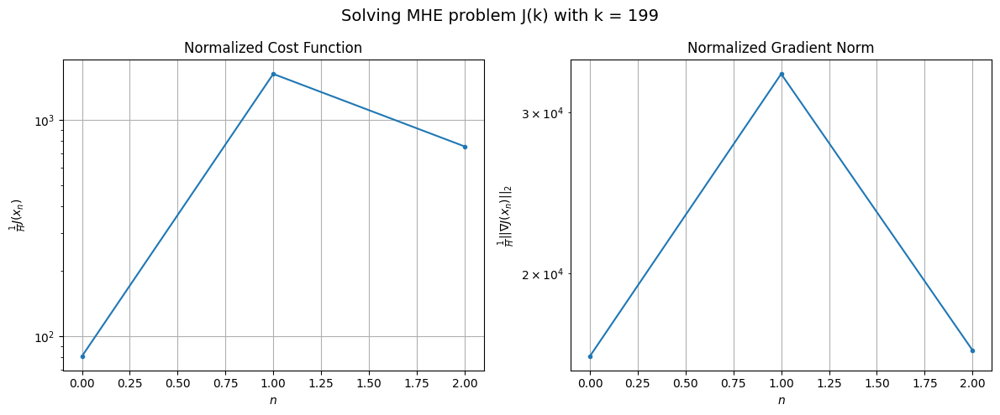

Windows:  49%|████▉     | 191/386 [10:41<08:52,  2.73s/it]

[Gauss-Newton] Before applying the algorithm
Cost function: 6908.764045318489
Gradient norm: 210833.19146679612
Global estimation error: 5565.859209355033
Initial conditions estimation errors: 0.5767751377122988 m, 2291.1332116849476 m, 3326.355800349294 m, 3829.4709942025847 m
Position estimation errors: 3.091525940413653 m, 2244.0238178604286 m, 3065.419026423784 m, 4220.880231085545 m

[Gauss-Newton] Iteration 1
Cost function: 568.6716941630538 (-91.77%)
Gradient norm: 6237.1228207744725 (-97.04%)
Global estimation error: 5429.778465358769 (-2.44%)
Initial conditions estimation errors: 1.6261952794777628 m, 2232.0249877681035 m, 3215.0872067170562 m, 3763.4777866158693 m
Position estimation errors: 1.7436891337130214 m, 2174.7784885878214 m, 2983.8711656535056 m, 4063.7615170341487 m

[Gauss-Newton] Iteration 2
Cost function: 577.2555438579626 (1.51%)
Gradient norm: 7547.238402305319 (21.01%)
Global estimation error: 5667.42111792292 (4.38%)
Initial conditions estimation errors: 1.6

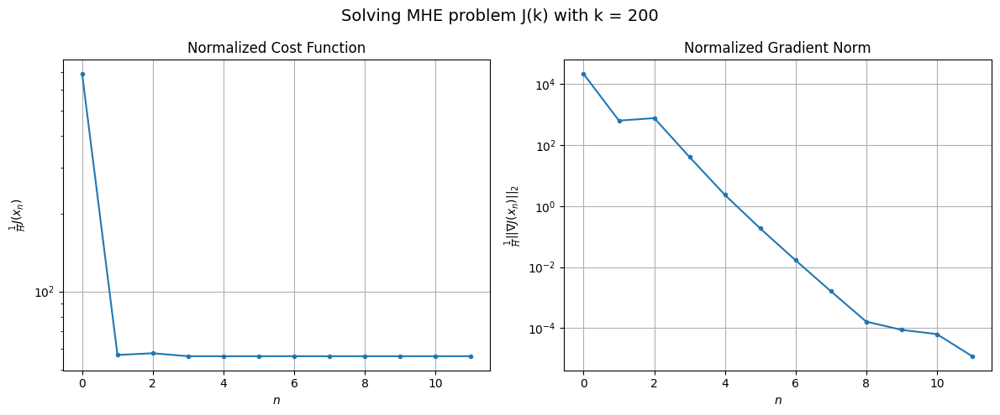

Windows:  50%|████▉     | 192/386 [10:45<09:49,  3.04s/it]

[Gauss-Newton] Before applying the algorithm
Cost function: 942.3673674069346
Gradient norm: 185787.65436391142
Global estimation error: 5833.2522443050775
Initial conditions estimation errors: 0.5873975184674314 m, 2388.12312192766 m, 3400.366482291761 m, 4094.0448885914457 m
Position estimation errors: 3.298554325275084 m, 2200.4358341217735 m, 3011.1279593320573 m, 4147.318023861168 m

[Gauss-Newton] Iteration 1
Cost function: 719607.5620279831 (76261.68%)
Gradient norm: 1756532.7575349147 (845.45%)
Global estimation error: 2502.2828603465136 (-57.10%)
Initial conditions estimation errors: 1.7567257929880817 m, 1050.6992311424394 m, 1506.4577190165173 m, 1699.4202316938195 m
Position estimation errors: 1.8282591359574834 m, 1161.769395293187 m, 1572.425978536807 m, 2260.059475199953 m

[Gauss-Newton] Iteration 2
Cost function: 17853533.717940606 (2381.01%)
Gradient norm: 9561094.347880106 (444.32%)
Global estimation error: 4596.7587093482725 (83.70%)
Initial conditions estimation er

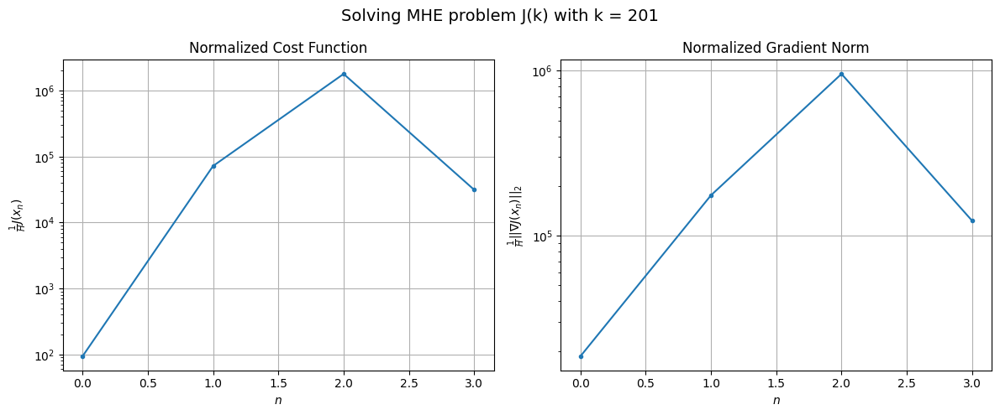

Windows:  50%|█████     | 193/386 [10:46<08:39,  2.69s/it]

[Gauss-Newton] Before applying the algorithm
Cost function: 296816.47424413194
Gradient norm: 1174996.8732867707
Global estimation error: 1770.512270049793
Initial conditions estimation errors: 0.6277152046067845 m, 677.172833222307 m, 893.0375897409454 m, 1370.6325478485203 m
Position estimation errors: 3.574513541558991 m, 410.5457956673058 m, 549.9560553367951 m, 884.2824652869717 m

[Gauss-Newton] Iteration 1
Cost function: 567966.1790469682 (91.35%)
Gradient norm: 1769822.626011071 (50.62%)
Global estimation error: 1085.1545306129074 (-38.71%)
Initial conditions estimation errors: 1.7505919946075523 m, 466.90288862932874 m, 687.394968765353 m, 697.8850664996273 m
Position estimation errors: 2.077902229343081 m, 698.6657994352487 m, 933.8988975625049 m, 1413.8070479171924 m

[Gauss-Newton] Iteration 2
Cost function: 904.7020492897732 (-99.84%)
Gradient norm: 34030.94978649388 (-98.08%)
Global estimation error: 1513.7094746901919 (39.49%)
Initial conditions estimation errors: 1.7505

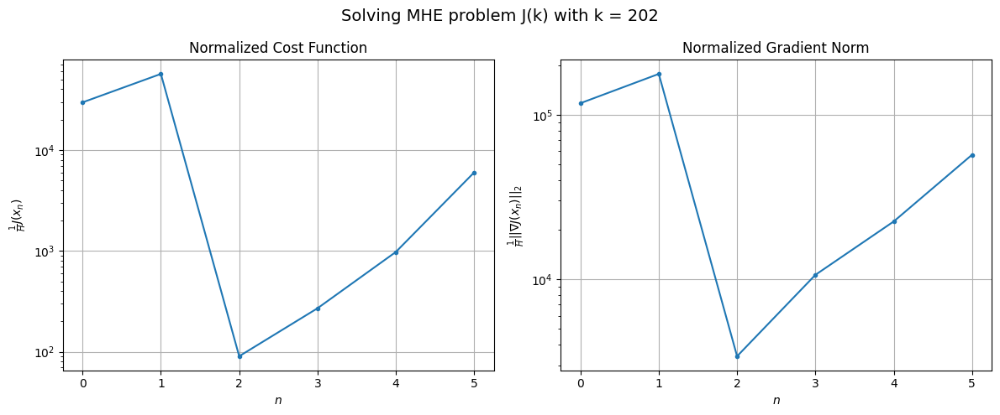

Windows:  50%|█████     | 194/386 [10:49<08:14,  2.58s/it]

[Gauss-Newton] Before applying the algorithm
Cost function: 60706.58451930275
Gradient norm: 583146.2600765504
Global estimation error: 312.30920354810104
Initial conditions estimation errors: 0.567355593508368 m, 142.04073647322073 m, 225.63416620392542 m, 162.6301152458398 m
Position estimation errors: 4.077013228113979 m, 351.5194997640861 m, 462.27024492726173 m, 719.0407885699951 m

[Gauss-Newton] Iteration 1
Cost function: 773680.8007970632 (1174.46%)
Gradient norm: 1951250.0580650351 (234.61%)
Global estimation error: 3563.767635879422 (1041.10%)
Initial conditions estimation errors: 1.8445858291318096 m, 1414.9099681091934 m, 1994.6961096240718 m, 2592.2286660357254 m
Position estimation errors: 2.3324619481065674 m, 1456.1968303263923 m, 1878.7907510912933 m, 3097.4671467298563 m

[Gauss-Newton] Iteration 2
Cost function: 13166.420734159632 (-98.30%)
Gradient norm: 271314.234255268 (-86.10%)
Global estimation error: 2527.492361093973 (-29.08%)
Initial conditions estimation err

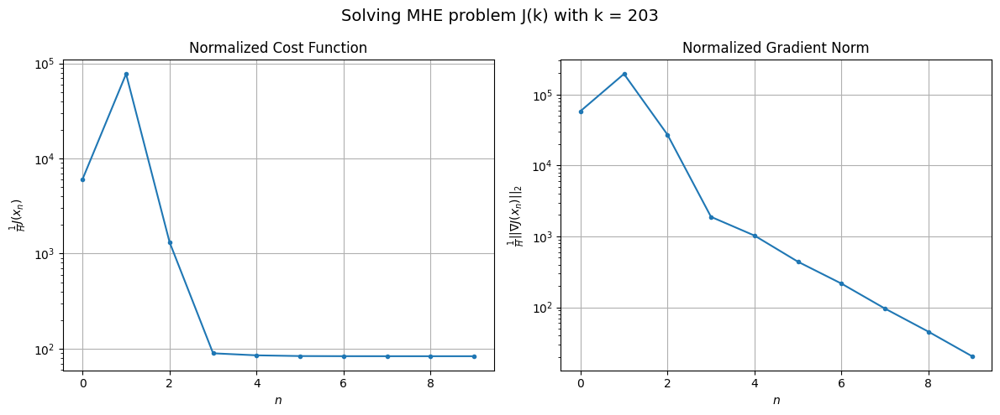

Windows:  51%|█████     | 195/386 [10:53<09:28,  2.97s/it]

[Gauss-Newton] Before applying the algorithm
Cost function: 1644.5129692762368
Gradient norm: 259398.1515540383
Global estimation error: 2753.9601700912485
Initial conditions estimation errors: 0.6115939301439274 m, 1076.3245734921572 m, 1510.046223107052 m, 2036.0698714638384 m
Position estimation errors: 4.548451248129395 m, 1057.5773577425227 m, 1341.4512891249985 m, 2262.9761773252876 m

[Gauss-Newton] Iteration 1
Cost function: 17819889.03609861 (1083496.75%)
Gradient norm: 10118839.693058597 (3800.89%)
Global estimation error: 3803.57457297227 (38.11%)
Initial conditions estimation errors: 1.9784075222139361 m, 1552.9556589433396 m, 2202.790193624551 m, 2683.8799090572843 m
Position estimation errors: 2.6505050333868714 m, 1630.4194322822223 m, 2129.7331673115 m, 3553.403350141064 m

[Gauss-Newton] Iteration 2
Cost function: 8446470.003501298 (-52.60%)
Gradient norm: 7062619.698475108 (-30.20%)
Global estimation error: 1711.3633187452056 (-55.01%)
Initial conditions estimation er

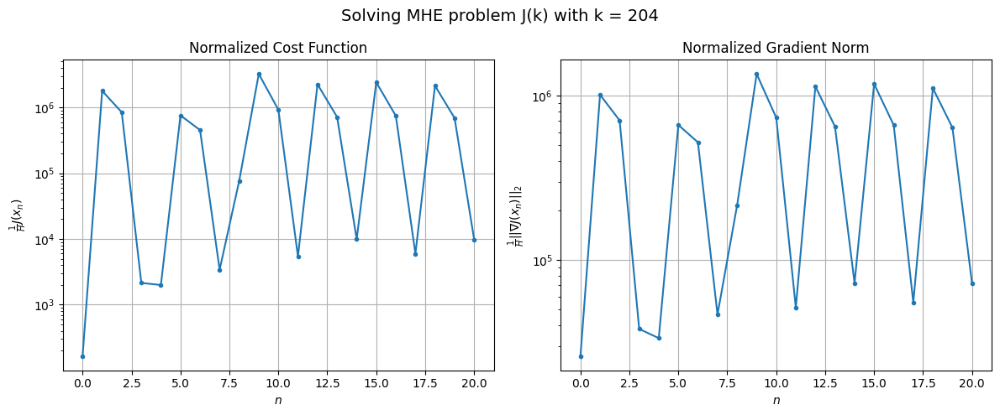

Windows:  51%|█████     | 196/386 [10:59<12:49,  4.05s/it]

[Gauss-Newton] Before applying the algorithm
Cost function: 98090.84654416678
Gradient norm: 735874.4842457457
Global estimation error: 2516.639133176341
Initial conditions estimation errors: 0.7030890110570023 m, 975.8693159375608 m, 1323.5388898723088 m, 1905.0972731485463 m
Position estimation errors: 5.017155747329479 m, 840.9089331598991 m, 1093.0035499970743 m, 1787.751560580604 m

[Gauss-Newton] Iteration 1
Cost function: 930846.6483688247 (848.96%)
Gradient norm: 2430797.2727420717 (230.33%)
Global estimation error: 5323.307342554885 (111.52%)
Initial conditions estimation errors: 2.24406816081161 m, 2118.502775245214 m, 2925.2609237357674 m, 3910.5471367596942 m
Position estimation errors: 2.8900967792360093 m, 2164.665366775482 m, 2777.5550493073 m, 4832.402383768629 m

[Gauss-Newton] Iteration 2
Cost function: 1327.1709718251657 (-99.86%)
Gradient norm: 1638.763053315029 (-99.93%)
Global estimation error: 5454.913212575259 (2.47%)
Initial conditions estimation errors: 2.2440

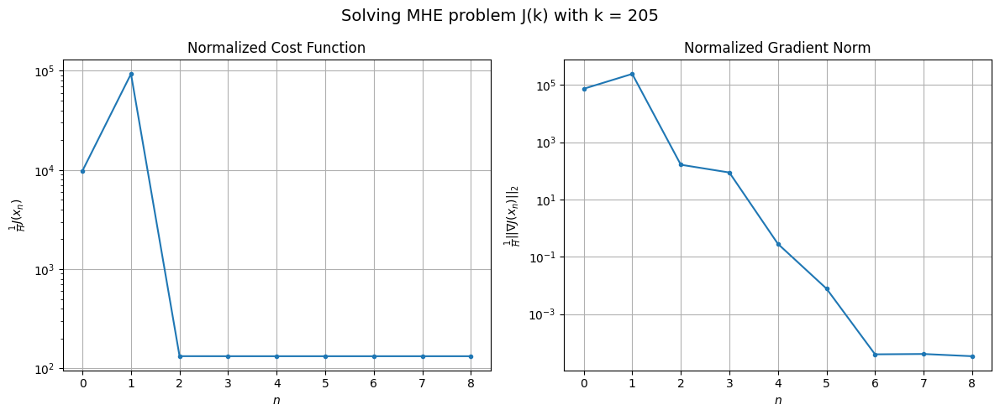

Windows:  51%|█████     | 197/386 [11:03<12:07,  3.85s/it]

[Gauss-Newton] Before applying the algorithm
Cost function: 2527.527026437669
Gradient norm: 317985.0013497922
Global estimation error: 5674.220456781513
Initial conditions estimation errors: 0.8831525782412016 m, 2222.8024862757525 m, 3032.3809214551648 m, 4249.774774160842 m
Position estimation errors: 5.356647722572819 m, 2088.6126232074744 m, 2664.9529415612783 m, 4719.751842619437 m

[Gauss-Newton] Iteration 1
Cost function: 1658.31350240091 (-34.39%)
Gradient norm: 4145.2306352927135 (-98.70%)
Global estimation error: 5542.559040475591 (-2.32%)
Initial conditions estimation errors: 2.5495053785110353 m, 2173.4680190645463 m, 2958.9531539537597 m, 4152.177455803234 m
Position estimation errors: 3.044908725750135 m, 2114.640347674675 m, 2657.95217638357 m, 4924.703824426351 m

[Gauss-Newton] Iteration 2
Cost function: 1680.1804357185083 (1.32%)
Gradient norm: 11249.267485060038 (171.38%)
Global estimation error: 5786.379330877352 (4.40%)
Initial conditions estimation errors: 2.5495

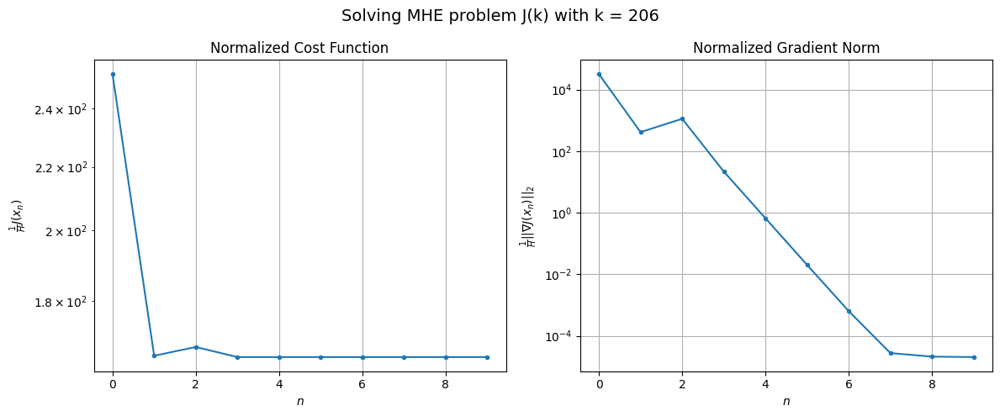

Windows:  51%|█████▏    | 198/386 [11:06<11:22,  3.63s/it]

[Gauss-Newton] Before applying the algorithm
Cost function: 2871.9196137424433
Gradient norm: 337767.5222947987
Global estimation error: 5974.465201544513
Initial conditions estimation errors: 1.029870042715316 m, 2314.75625697665 m, 3124.114462034083 m, 4536.081754072869 m
Position estimation errors: 5.629518960531924 m, 2152.989375525978 m, 2679.114401883567 m, 5121.3842294760125 m

[Gauss-Newton] Iteration 1
Cost function: 1812.0318324400512 (-36.91%)
Gradient norm: 1813.4220284345224 (-99.46%)
Global estimation error: 6087.61333188307 (1.89%)
Initial conditions estimation errors: 2.9735086586400974 m, 2325.4693790618635 m, 3102.951327476046 m, 4692.856866349833 m
Position estimation errors: 3.1121311218892935 m, 2138.1093319419047 m, 2635.2331103324364 m, 5148.972001534526 m

[Gauss-Newton] Iteration 2
Cost function: 1808.7270179181633 (-0.18%)
Gradient norm: 376.586231427481 (-79.23%)
Global estimation error: 6072.676480407329 (-0.25%)
Initial conditions estimation errors: 2.97350

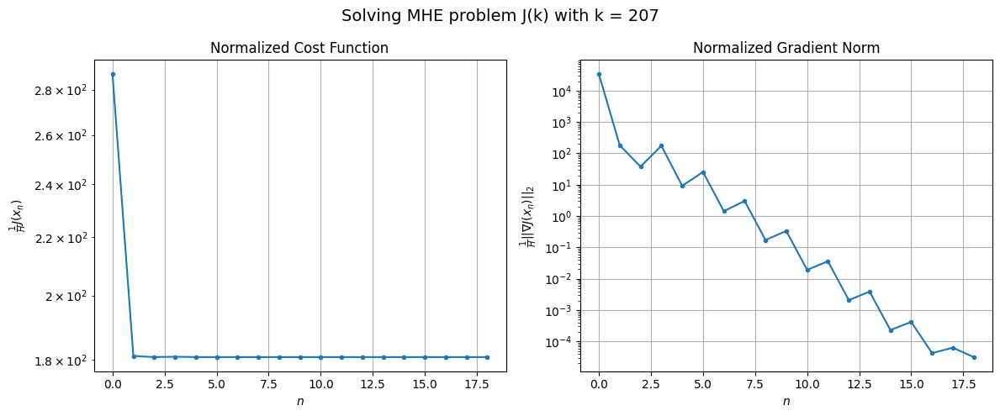

Windows:  52%|█████▏    | 199/386 [11:12<13:45,  4.41s/it]

[Gauss-Newton] Before applying the algorithm
Cost function: 3113.637242647903
Gradient norm: 343664.2802222967
Global estimation error: 6395.290879662124
Initial conditions estimation errors: 1.1984897581510057 m, 2421.0622929320457 m, 3208.7626605540986 m, 4974.136883294044 m
Position estimation errors: 5.883784050383496 m, 2147.2978380553204 m, 2619.534407230227 m, 5273.825053500448 m

[Gauss-Newton] Iteration 1
Cost function: 286479.27020515467 (9100.79%)
Gradient norm: 1230738.044645437 (258.12%)
Global estimation error: 3986.4885330422167 (-37.67%)
Initial conditions estimation errors: 3.1745513350402517 m, 1478.856730799837 m, 1917.510806840703 m, 3166.7355545701325 m
Position estimation errors: 3.3132219988263047 m, 1289.8319810309804 m, 1546.7915914238101 m, 3255.825735167744 m

[Gauss-Newton] Iteration 2
Cost function: 84981947.38894743 (29564.26%)
Gradient norm: 21324801.505314536 (1632.68%)
Global estimation error: 6550.127818762437 (64.31%)
Initial conditions estimation err

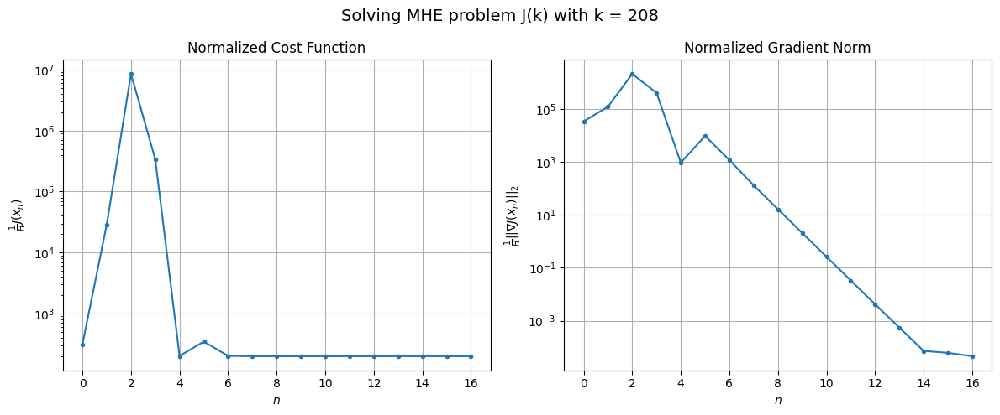

Windows:  52%|█████▏    | 200/386 [11:17<14:34,  4.70s/it]

[Gauss-Newton] Before applying the algorithm
Cost function: 3411.897770314892
Gradient norm: 367173.90364152985
Global estimation error: 1668.5923103380824
Initial conditions estimation errors: 1.156429311387267 m, 652.3206152620738 m, 914.1468576692623 m, 1234.1005697521148 m
Position estimation errors: 6.392418513885244 m, 893.8639387676541 m, 1058.4868345820223 m, 2356.2671866918636 m

[Gauss-Newton] Iteration 1
Cost function: 17928.873767135137 (425.48%)
Gradient norm: 344275.16981520003 (-6.24%)
Global estimation error: 1059.5419700737637 (-36.50%)
Initial conditions estimation errors: 3.3528569826239876 m, 377.95450086418134 m, 496.2197579303584 m, 856.4659586157345 m
Position estimation errors: 3.5985384724972844 m, 361.46807424541197 m, 414.9472092896057 m, 989.1447152954478 m

[Gauss-Newton] STOP on Iteration 2 (gradient norm stagnated)
Cost function = 5111.1268433387195 (-71.49%)
Gradient norm = 128447.40655099439 (-62.69%)
Global estimation error = 1849.4442975942295 (74.55%

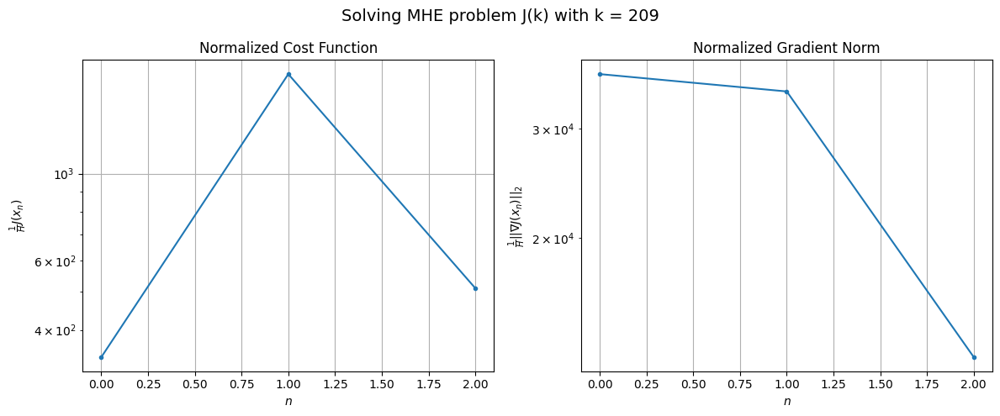

Windows:  52%|█████▏    | 201/386 [11:19<11:24,  3.70s/it]

[Gauss-Newton] Before applying the algorithm
Cost function: 7181.429863846747
Gradient norm: 428139.67930939415
Global estimation error: 1895.336611351915
Initial conditions estimation errors: 1.139068317788233 m, 668.0728006862812 m, 846.2853086384191 m, 1558.7747401336644 m
Position estimation errors: 7.0090028436220475 m, 600.6303158010278 m, 672.9107380949591 m, 1712.8510429644841 m

[Gauss-Newton] Iteration 1
Cost function: 40271.72925235222 (460.78%)
Gradient norm: 448442.21047772904 (4.74%)
Global estimation error: 386.64680065989035 (-79.60%)
Initial conditions estimation errors: 3.474208538745268 m, 123.3729298712283 m, 162.13172267669077 m, 328.5970911309369 m
Position estimation errors: 3.873440189029806 m, 119.41357123021744 m, 119.36366440478571 m, 362.33212531390205 m

[Gauss-Newton] Iteration 2
Cost function: 2537.6020371811487 (-93.70%)
Gradient norm: 11117.227221600591 (-97.52%)
Global estimation error: 155.4286392844841 (-59.80%)
Initial conditions estimation errors: 

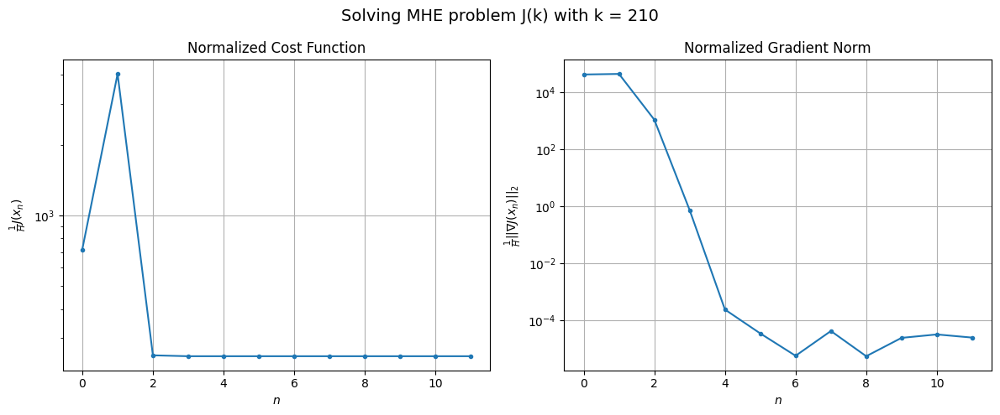

Windows:  52%|█████▏    | 202/386 [11:23<11:37,  3.79s/it]

[Gauss-Newton] Before applying the algorithm
Cost function: 4677.3385443732
Gradient norm: 445975.99046209094
Global estimation error: 152.0502191833777
Initial conditions estimation errors: 1.153151543012992 m, 38.44822637176323 m, 47.440993285829904 m, 139.24443733162346 m
Position estimation errors: 7.556324655144101 m, 37.64527835622025 m, 27.709394567713655 m, 134.94763972986993 m

[Gauss-Newton] Iteration 1
Cost function: 2858.3085119126854 (-38.89%)
Gradient norm: 8217.12508979563 (-98.16%)
Global estimation error: 309.4944555837295 (103.55%)
Initial conditions estimation errors: 3.679538604349309 m, 105.98973568729396 m, 163.81408887709733 m, 240.21722828413743 m
Position estimation errors: 4.223256908158495 m, 115.26407579221265 m, 112.01691642582104 m, 313.2127264247804 m

[Gauss-Newton] Iteration 2
Cost function: 2846.816540782417 (-0.40%)
Gradient norm: 26.48733865531915 (-99.68%)
Global estimation error: 312.720297606941 (1.04%)
Initial conditions estimation errors: 3.6795

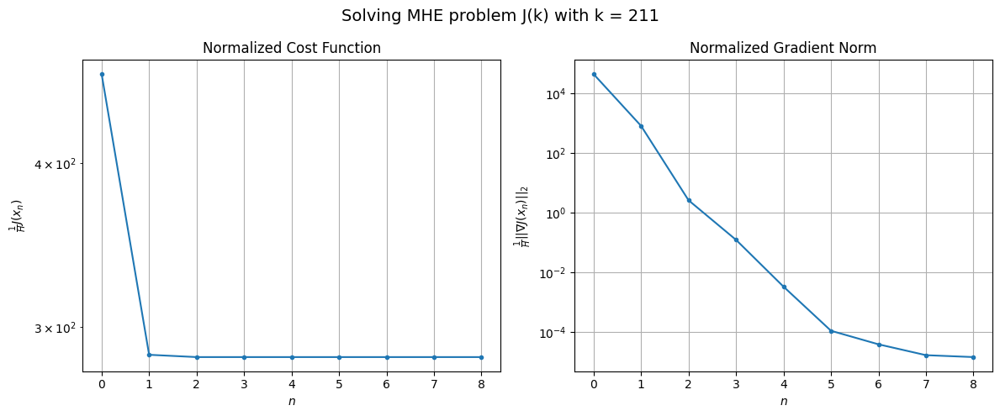

Windows:  53%|█████▎    | 203/386 [11:26<10:47,  3.54s/it]

[Gauss-Newton] Before applying the algorithm
Cost function: 5397.103456453937
Gradient norm: 481910.7597123237
Global estimation error: 321.34626330021854
Initial conditions estimation errors: 1.304583663234451 m, 110.2441156253748 m, 157.00312602313366 m, 257.7943304845423 m
Position estimation errors: 8.08489145005591 m, 107.13755268972457 m, 100.09282100272178 m, 300.143154745242 m

[Gauss-Newton] Iteration 1
Cost function: 3391.1022356792937 (-37.17%)
Gradient norm: 8222.414322695071 (-98.29%)
Global estimation error: 453.5226811449387 (41.13%)
Initial conditions estimation errors: 3.9014565286017953 m, 176.61757320832848 m, 275.44916331976725 m, 314.0086988567078 m
Position estimation errors: 4.5598424126513875 m, 181.4560471250579 m, 219.81725421140857 m, 410.06253612198606 m

[Gauss-Newton] Iteration 2
Cost function: 3379.7726755249537 (-0.33%)
Gradient norm: 23.420025662935792 (-99.72%)
Global estimation error: 444.1014396951323 (-2.08%)
Initial conditions estimation errors: 3.

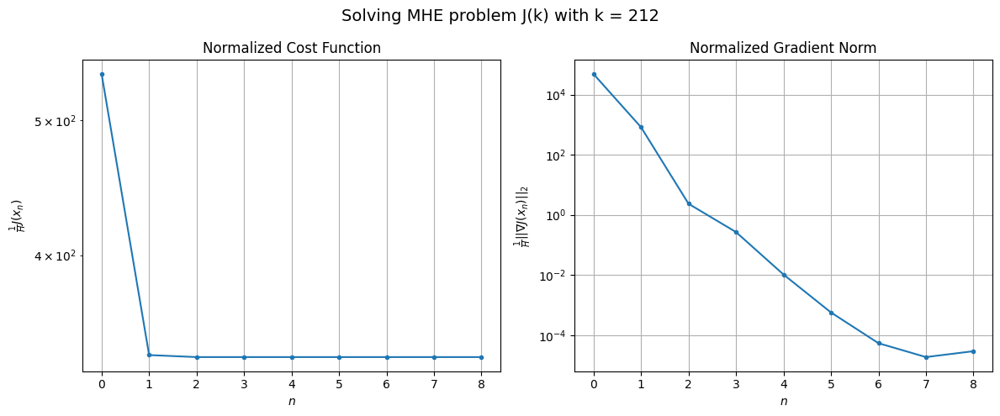

Windows:  53%|█████▎    | 204/386 [11:29<10:20,  3.41s/it]

[Gauss-Newton] Before applying the algorithm
Cost function: 6215.982041556999
Gradient norm: 515203.71394316433
Global estimation error: 459.233733503346
Initial conditions estimation errors: 1.4565815256313688 m, 181.17418987616452 m, 273.4390274315406 m, 321.40373353735816 m
Position estimation errors: 8.493357975185504 m, 184.94071477036897 m, 220.5846074294476 m, 434.0365740841534 m

[Gauss-Newton] Iteration 1
Cost function: 37230.580805949074 (498.95%)
Gradient norm: 425842.2910646265 (-17.34%)
Global estimation error: 1026.990356270174 (123.63%)
Initial conditions estimation errors: 4.197524908790891 m, 321.2268722594514 m, 350.9433474170368 m, 910.1337471597052 m
Position estimation errors: 4.7775292898724375 m, 274.4482900779821 m, 249.18030649560995 m, 989.5522667489579 m

[Gauss-Newton] Iteration 2
Cost function: 4405.515032657342 (-88.17%)
Gradient norm: 48575.952148266806 (-88.59%)
Global estimation error: 1533.0690776630574 (49.28%)
Initial conditions estimation errors: 4.

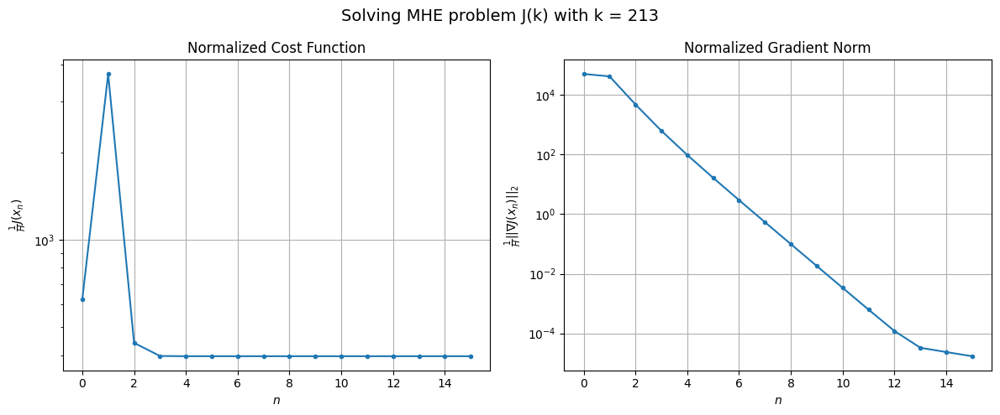

Windows:  53%|█████▎    | 205/386 [11:34<11:35,  3.84s/it]

[Gauss-Newton] Before applying the algorithm
Cost function: 6730.736408214635
Gradient norm: 526447.3382846062
Global estimation error: 1873.4035226017936
Initial conditions estimation errors: 1.6071260940099767 m, 589.3607121984941 m, 657.5402056304749 m, 1652.250730432175 m
Position estimation errors: 8.676657507543165 m, 497.74549259678247 m, 461.3123506830579 m, 1741.081648602512 m

[Gauss-Newton] Iteration 1
Cost function: 4642.338372833714 (-31.03%)
Gradient norm: 40901.86105574221 (-92.23%)
Global estimation error: 1452.1025252439545 (-22.49%)
Initial conditions estimation errors: 4.483924917900379 m, 493.3103789489912 m, 578.5793460559642 m, 1237.1225787117444 m
Position estimation errors: 4.884465007423239 m, 386.173824761863 m, 419.56605057386014 m, 1229.9072639698886 m

[Gauss-Newton] Iteration 2
Cost function: 4352.073652796755 (-6.25%)
Gradient norm: 32.996787531887726 (-99.92%)
Global estimation error: 1435.730463384582 (-1.13%)
Initial conditions estimation errors: 4.483

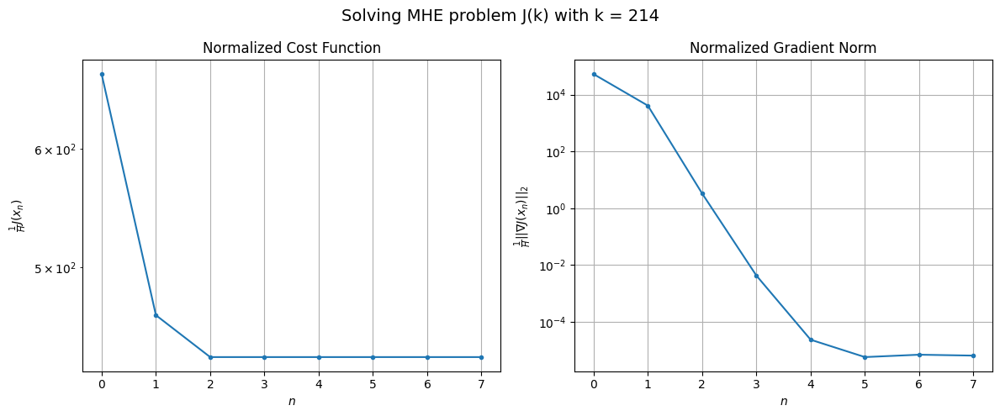

Windows:  53%|█████▎    | 206/386 [11:36<10:26,  3.48s/it]

[Gauss-Newton] Before applying the algorithm
Cost function: 7107.049162352128
Gradient norm: 534349.4895250226
Global estimation error: 1447.7584730678611
Initial conditions estimation errors: 1.6937541162232208 m, 481.3009675388043 m, 563.9079322971023 m, 1243.5267647989942 m
Position estimation errors: 8.639526330983445 m, 362.60286473823675 m, 386.9583412663028 m, 1195.471127294122 m

[Gauss-Newton] Iteration 1
Cost function: 28890.296095039164 (306.50%)
Gradient norm: 365136.2225304506 (-31.67%)
Global estimation error: 95.8759772984424 (-93.38%)
Initial conditions estimation errors: 4.701279646000886 m, 43.421765679999865 m, 54.16187860191428 m, 65.96141548167027 m
Position estimation errors: 4.76445500102972 m, 49.49027624115417 m, 31.221199515930163 m, 160.536033910557 m

[Gauss-Newton] Iteration 2
Cost function: 4593.264341617141 (-84.10%)
Gradient norm: 7223.1003051005 (-98.02%)
Global estimation error: 274.98181730246887 (186.81%)
Initial conditions estimation errors: 4.70127

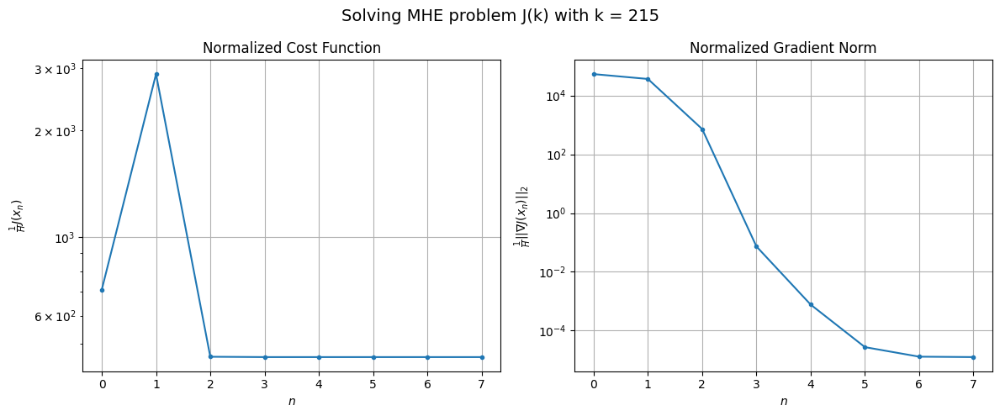

Windows:  54%|█████▎    | 207/386 [11:39<09:42,  3.25s/it]

[Gauss-Newton] Before applying the algorithm
Cost function: 6768.531589621494
Gradient norm: 503223.27815918956
Global estimation error: 249.2760020925415
Initial conditions estimation errors: 1.7006346125332086 m, 86.6230999927689 m, 110.7997309262923 m, 205.80408312006298 m
Position estimation errors: 8.239274632871098 m, 16.081063852457003 m, 16.23345378113744 m, 28.156780562287153 m

[Gauss-Newton] Iteration 1
Cost function: 21190.081308173656 (213.07%)
Gradient norm: 264555.0336462775 (-47.43%)
Global estimation error: 1197.406635735406 (380.35%)
Initial conditions estimation errors: 4.75420206375075 m, 368.49791340527753 m, 400.4019263089375 m, 1066.6055759614737 m
Position estimation errors: 4.522535575627808 m, 311.13409378533595 m, 273.318814275801 m, 1062.2105986749882 m

[Gauss-Newton] Iteration 2
Cost function: 4340.423532162438 (-79.52%)
Gradient norm: 3115.558862966731 (-98.82%)
Global estimation error: 1072.543497440981 (-10.43%)
Initial conditions estimation errors: 4.7

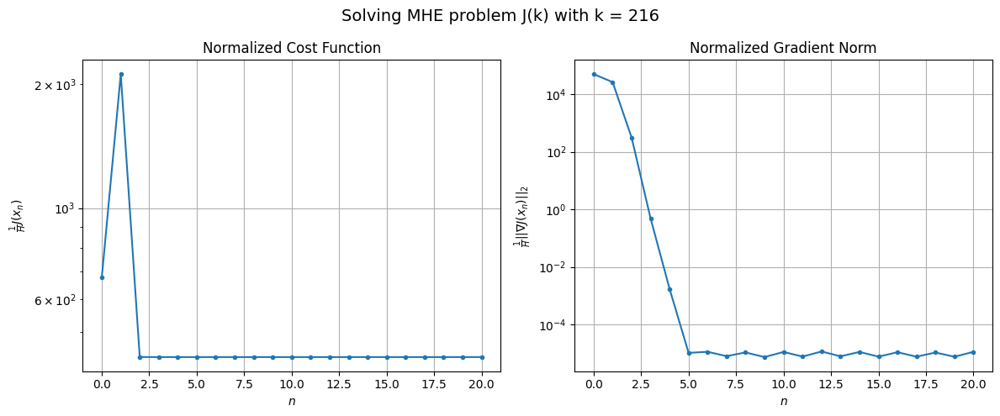

Windows:  54%|█████▍    | 208/386 [11:45<12:31,  4.22s/it]

[Gauss-Newton] Before applying the algorithm
Cost function: 6079.413919959802
Gradient norm: 469342.49051984266
Global estimation error: 1088.8070294927825
Initial conditions estimation errors: 1.6244061530051044 m, 332.7873663918684 m, 352.4125155227382 m, 974.9646204828966 m
Position estimation errors: 7.608497035867724 m, 262.6334723878997 m, 222.78930180990034 m, 908.7322013929436 m

[Gauss-Newton] Iteration 1
Cost function: 3878.533295369594 (-36.20%)
Gradient norm: 10770.101940032931 (-97.71%)
Global estimation error: 1135.158808686047 (4.26%)
Initial conditions estimation errors: 4.593065061592334 m, 317.555525023608 m, 294.08322401158114 m, 1049.3987251334534 m
Position estimation errors: 4.10721673824718 m, 159.97593861794886 m, 106.59360156918451 m, 674.1128647569516 m

[Gauss-Newton] Iteration 2
Cost function: 3862.3615982258043 (-0.42%)
Gradient norm: 729.306271191109 (-93.23%)
Global estimation error: 1200.142388539105 (5.72%)
Initial conditions estimation errors: 4.593065

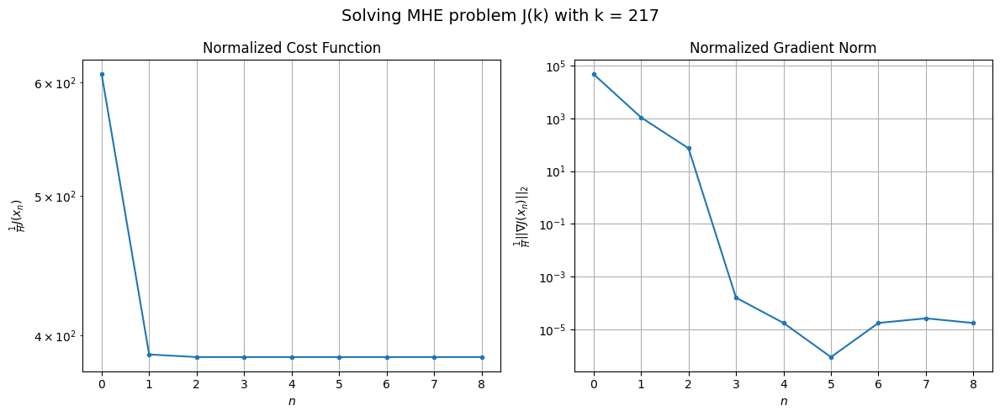

Windows:  54%|█████▍    | 209/386 [11:48<11:17,  3.83s/it]

[Gauss-Newton] Before applying the algorithm
Cost function: 5107.921574950673
Gradient norm: 415257.33459167904
Global estimation error: 1170.7481502764024
Initial conditions estimation errors: 1.4802858477724854 m, 325.1387489600968 m, 294.797727708618 m, 1085.369883614181 m
Position estimation errors: 6.728830102448128 m, 154.55155477105208 m, 95.55685097712201 m, 678.6860049013505 m

[Gauss-Newton] Iteration 1
Cost function: 39377.31453542448 (670.91%)
Gradient norm: 343733.5028439984 (-17.22%)
Global estimation error: 759.0935603094355 (-35.16%)
Initial conditions estimation errors: 4.260250210301226 m, 201.99455565117853 m, 207.78460489227732 m, 701.5900464149822 m
Position estimation errors: 3.5584500720662176 m, 139.7534501643248 m, 120.83493591275109 m, 520.1870157293347 m

[Gauss-Newton] Iteration 2
Cost function: 3232.4146561791413 (-91.79%)
Gradient norm: 7373.248951735413 (-97.85%)
Global estimation error: 561.8411858450679 (-25.99%)
Initial conditions estimation errors: 4.

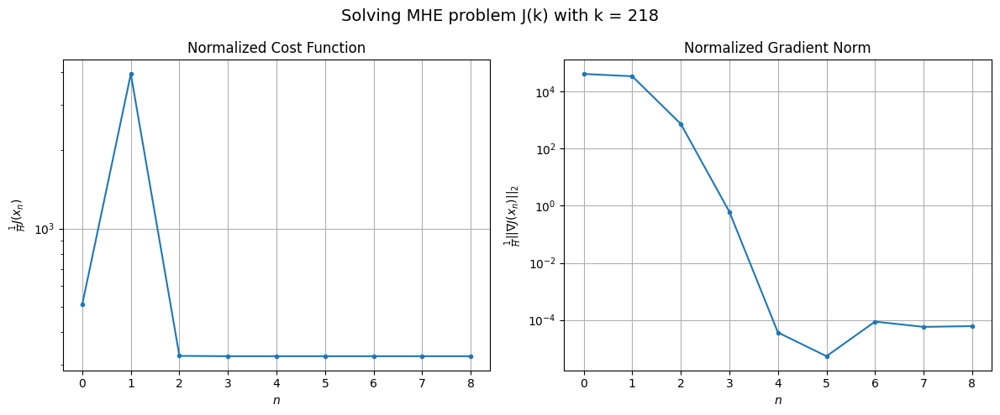

Windows:  54%|█████▍    | 210/386 [11:51<10:37,  3.62s/it]

[Gauss-Newton] Before applying the algorithm
Cost function: 3944.237021018715
Gradient norm: 347244.30832198035
Global estimation error: 549.0849185670951
Initial conditions estimation errors: 1.330743393245209 m, 139.2747618768943 m, 142.4568169644119 m, 511.6648985421339 m
Position estimation errors: 5.742914240254867 m, 77.3386796855979 m, 69.05508886120579 m, 282.35301733850105 m

[Gauss-Newton] Iteration 1
Cost function: 2478.6771970676473 (-37.16%)
Gradient norm: 626.150229886126 (-99.82%)
Global estimation error: 440.0916011710167 (-19.85%)
Initial conditions estimation errors: 3.833837062462209 m, 97.95668786551171 m, 99.62579904911136 m, 417.306945142848 m
Position estimation errors: 3.002046321027817 m, 76.3411490446495 m, 43.738714170572116 m, 331.1173643893899 m

[Gauss-Newton] Iteration 2
Cost function: 2478.3994364132673 (-0.01%)
Gradient norm: 9.060366999078054 (-98.55%)
Global estimation error: 445.23167358786975 (1.17%)
Initial conditions estimation errors: 3.833837075

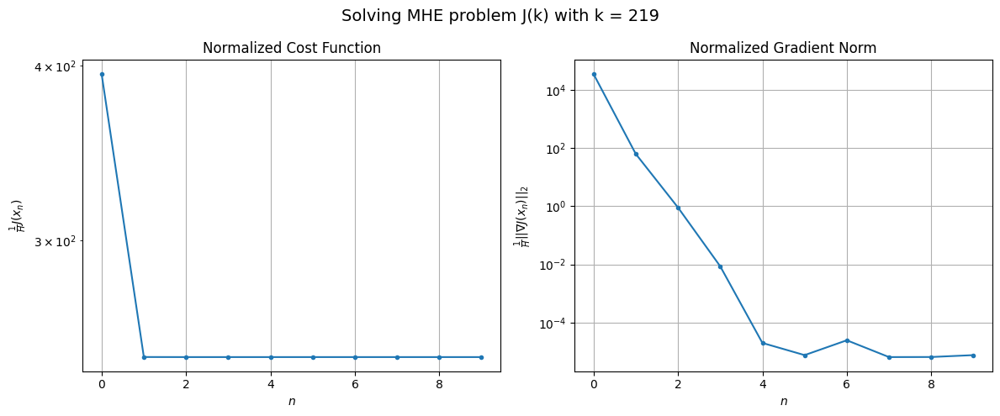

Windows:  55%|█████▍    | 211/386 [11:55<10:16,  3.52s/it]

[Gauss-Newton] Before applying the algorithm
Cost function: 2904.025832373868
Gradient norm: 287256.0812865761
Global estimation error: 439.8373788142384
Initial conditions estimation errors: 1.1984264009360486 m, 96.77845459017155 m, 93.25496789645291 m, 418.7993576120627 m
Position estimation errors: 4.903465642083921 m, 68.19217538488533 m, 34.55745113459072 m, 305.0828386919459 m

[Gauss-Newton] Iteration 1
Cost function: 1881.209347641766 (-35.22%)
Gradient norm: 17456.94160397621 (-93.92%)
Global estimation error: 145.0763152153768 (-67.02%)
Initial conditions estimation errors: 3.327656276361895 m, 6.625665963682552 m, 35.88489501767136 m, 140.37228080549224 m
Position estimation errors: 2.6181520691821274 m, 24.865982709703985 m, 61.12645627588457 m, 29.899786493390895 m

[Gauss-Newton] Iteration 2
Cost function: 1823.1443350886952 (-3.09%)
Gradient norm: 89.64366503373044 (-99.49%)
Global estimation error: 119.69657916429969 (-17.49%)
Initial conditions estimation errors: 3.32

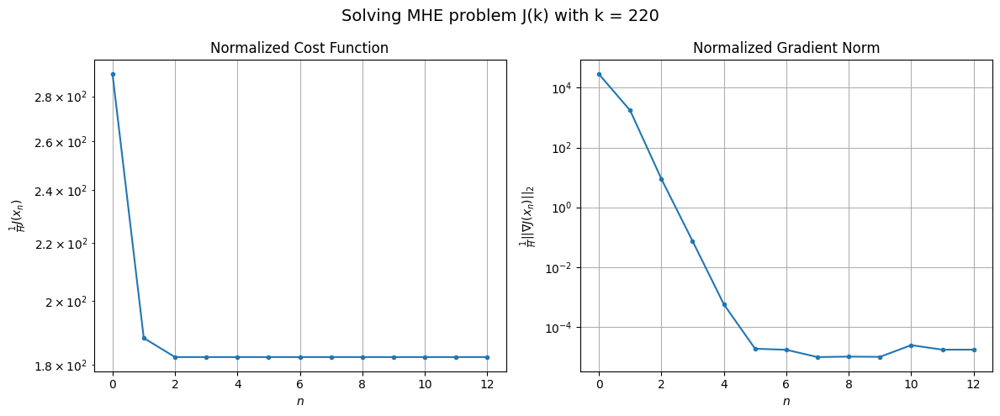

Windows:  55%|█████▍    | 212/386 [11:59<10:39,  3.68s/it]

[Gauss-Newton] Before applying the algorithm
Cost function: 2196.8577813046027
Gradient norm: 254336.29366426368
Global estimation error: 107.6420679227108
Initial conditions estimation errors: 0.9733165546064502 m, 13.312740199311241 m, 40.24726382141393 m, 98.93806039814513 m
Position estimation errors: 4.442322116542159 m, 32.487944011063256 m, 63.66542970644884 m, 41.091210361013275 m

[Gauss-Newton] Iteration 1
Cost function: 6352.33991622788 (189.16%)
Gradient norm: 180356.37857324988 (-29.09%)
Global estimation error: 905.6200785863858 (741.33%)
Initial conditions estimation errors: 2.87458559943121 m, 243.1567356917663 m, 238.10963796786726 m, 839.236202958089 m
Position estimation errors: 2.368491329907315 m, 248.38692752838077 m, 173.25414527477773 m, 1096.1890804161844 m

[Gauss-Newton] Iteration 2
Cost function: 1331.4332189537884 (-79.04%)
Gradient norm: 752.3688754612443 (-99.58%)
Global estimation error: 981.8168405185404 (8.41%)
Initial conditions estimation errors: 2.8

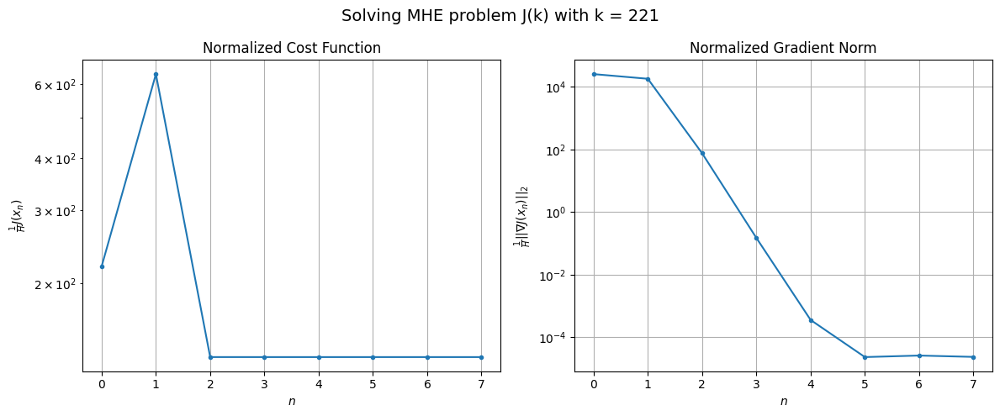

Windows:  55%|█████▌    | 213/386 [12:02<09:53,  3.43s/it]

[Gauss-Newton] Before applying the algorithm
Cost function: 1797.967701726311
Gradient norm: 242381.14401194805
Global estimation error: 1028.3060092549763
Initial conditions estimation errors: 0.8125799709246415 m, 266.56121957889246 m, 244.80429099725268 m, 962.5112923231754 m
Position estimation errors: 4.261841836063356 m, 255.30371091029212 m, 168.63411394503248 m, 1168.5247853408944 m

[Gauss-Newton] Iteration 1
Cost function: 136912.65649601616 (7514.86%)
Gradient norm: 888561.6485265112 (266.60%)
Global estimation error: 1183.447907384059 (15.09%)
Initial conditions estimation errors: 2.5183907047592444 m, 289.11830253724787 m, 206.58190123083386 m, 1128.8385557603742 m
Position estimation errors: 2.2865697323863325 m, 288.5159079168796 m, 143.21748370159682 m, 1346.3234108169388 m

[Gauss-Newton] Iteration 2
Cost function: 1206.4055054190426 (-99.12%)
Gradient norm: 29561.93058858449 (-96.67%)
Global estimation error: 771.1247135124173 (-34.84%)
Initial conditions estimation e

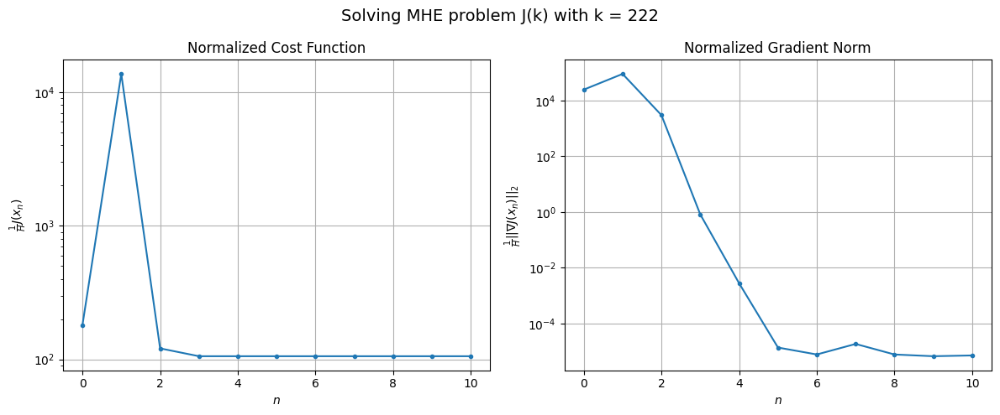

Windows:  55%|█████▌    | 214/386 [12:05<09:56,  3.47s/it]

[Gauss-Newton] Before applying the algorithm
Cost function: 1657.908762834346
Gradient norm: 249142.88514944073
Global estimation error: 807.1195536155421
Initial conditions estimation errors: 0.6828165556756477 m, 190.0406184331602 m, 122.83168476808936 m, 774.7504240962821 m
Position estimation errors: 4.285412430624635 m, 186.55287188247965 m, 78.2365668841503 m, 893.2518399654992 m

[Gauss-Newton] Iteration 1
Cost function: 965.7804145951692 (-41.75%)
Gradient norm: 1839.9491151484929 (-99.26%)
Global estimation error: 684.932078230711 (-15.14%)
Initial conditions estimation errors: 2.2775333932698913 m, 178.85065032631175 m, 132.0078794614405 m, 647.852512832122 m
Position estimation errors: 2.3082286715043048 m, 186.71672360894408 m, 122.29782208977159 m, 795.9254420264194 m

[Gauss-Newton] Iteration 2
Cost function: 964.832835664045 (-0.10%)
Gradient norm: 59.636554711685385 (-96.76%)
Global estimation error: 713.4588030363942 (4.16%)
Initial conditions estimation errors: 2.2775

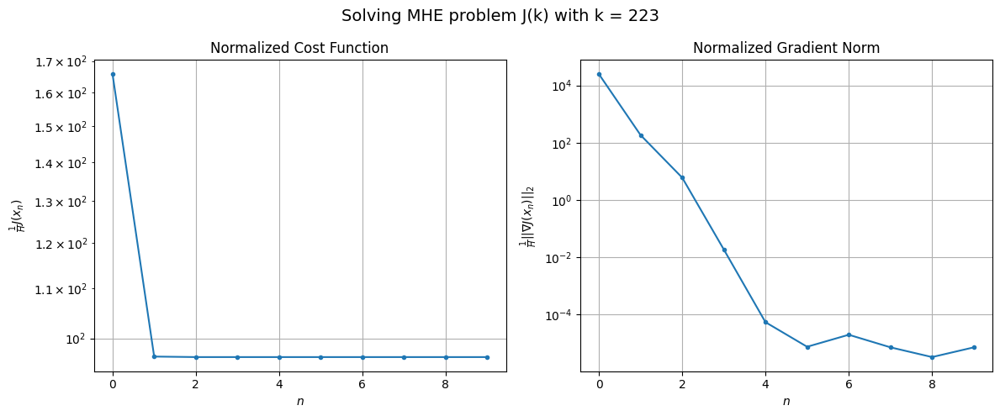

Windows:  56%|█████▌    | 215/386 [12:09<09:53,  3.47s/it]

[Gauss-Newton] Before applying the algorithm
Cost function: 1651.3153129745697
Gradient norm: 248421.82045733594
Global estimation error: 738.7818707852547
Initial conditions estimation errors: 0.6289531679618596 m, 187.87769256107688 m, 138.1360349700221 m, 701.0124643991425 m
Position estimation errors: 4.354697448130041 m, 187.43945825611382 m, 117.17941739918871 m, 811.5633779216205 m

[Gauss-Newton] Iteration 1
Cost function: 1316.4363742889643 (-20.28%)
Gradient norm: 50730.85884884673 (-79.58%)
Global estimation error: 589.877679912485 (-20.16%)
Initial conditions estimation errors: 2.191872700143962 m, 107.06118915298335 m, 53.62907156591343 m, 577.591709523467 m
Position estimation errors: 2.3753685225851657 m, 20.633030499679098 m, 47.27796401530578 m, 147.20183808747993 m

[Gauss-Newton] Iteration 2
Cost function: 977.1973100683326 (-25.77%)
Gradient norm: 5612.361415520406 (-88.94%)
Global estimation error: 764.7770237402927 (29.65%)
Initial conditions estimation errors: 2.

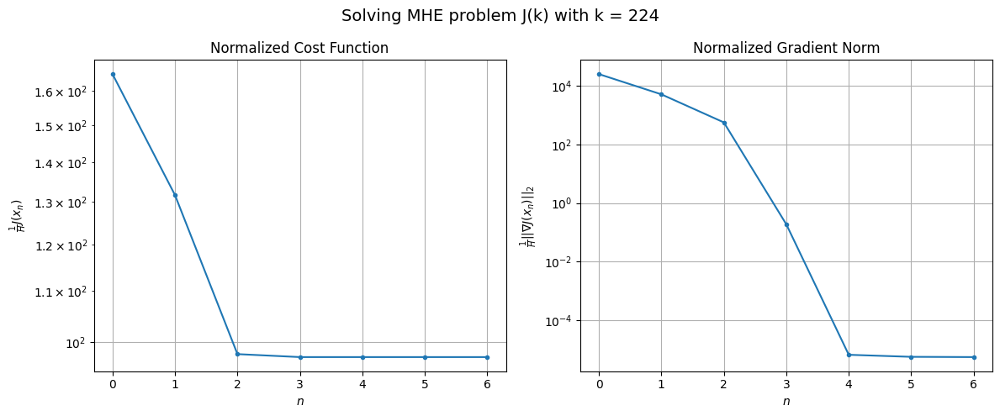

Windows:  56%|█████▌    | 216/386 [12:11<08:54,  3.14s/it]

[Gauss-Newton] Before applying the algorithm
Cost function: 1666.626152798433
Gradient norm: 242295.83613741756
Global estimation error: 725.1608607793886
Initial conditions estimation errors: 0.7238384100542965 m, 141.37697129561053 m, 71.62917277532958 m, 707.6292437901621 m
Position estimation errors: 4.4121004258154715 m, 51.93978128442124 m, 40.824007859046645 m, 293.4213177247888 m

[Gauss-Newton] Iteration 1
Cost function: 16682.08185691285 (900.95%)
Gradient norm: 296857.0979403087 (22.52%)
Global estimation error: 644.4286481059543 (-11.13%)
Initial conditions estimation errors: 2.1864353962098724 m, 150.8531503804434 m, 116.9378957867906 m, 615.5081528091636 m
Position estimation errors: 2.4921032230437565 m, 240.5949753098385 m, 117.50221723872505 m, 1218.2330889640552 m

[Gauss-Newton] Iteration 2
Cost function: 1047.3876646817262 (-93.72%)
Gradient norm: 3498.759084629653 (-98.82%)
Global estimation error: 784.880009753802 (21.79%)
Initial conditions estimation errors: 2.1

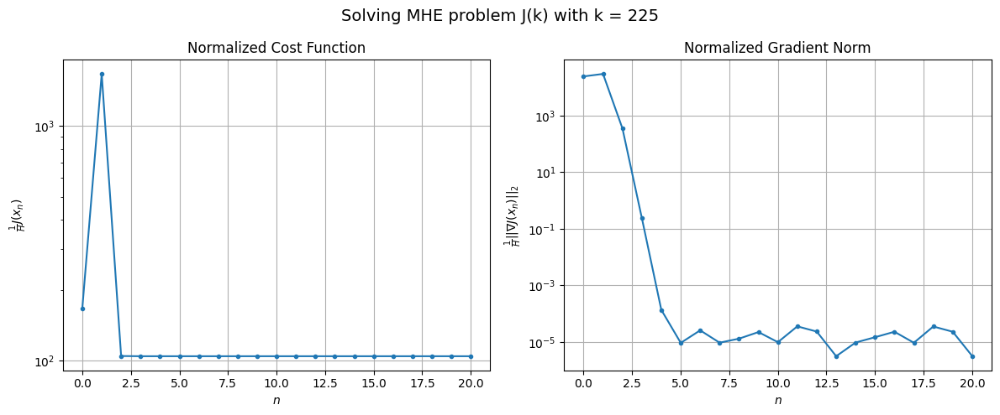

Windows:  56%|█████▌    | 217/386 [12:17<11:36,  4.12s/it]

[Gauss-Newton] Before applying the algorithm
Cost function: 1825.5958304280462
Gradient norm: 248554.72133853857
Global estimation error: 877.636721823358
Initial conditions estimation errors: 0.7926491918753129 m, 199.03999655532033 m, 140.7973279021419 m, 843.0911019267086 m
Position estimation errors: 4.475952434228742 m, 277.5463791719141 m, 132.7247502318479 m, 1426.1446054598011 m

[Gauss-Newton] Iteration 1
Cost function: 4070.031656187893 (122.94%)
Gradient norm: 141198.2336790167 (-43.19%)
Global estimation error: 168.59795676315233 (-80.79%)
Initial conditions estimation errors: 2.2536318120469376 m, 38.016753516465386 m, 30.694246963534617 m, 161.3463594148617 m
Position estimation errors: 2.540592354434704 m, 52.625985519251614 m, 28.481010981500486 m, 301.04840953246037 m

[Gauss-Newton] Iteration 2
Cost function: 1183.0192765951194 (-70.93%)
Gradient norm: 404.79113887355925 (-99.71%)
Global estimation error: 122.38239835794151 (-27.41%)
Initial conditions estimation erro

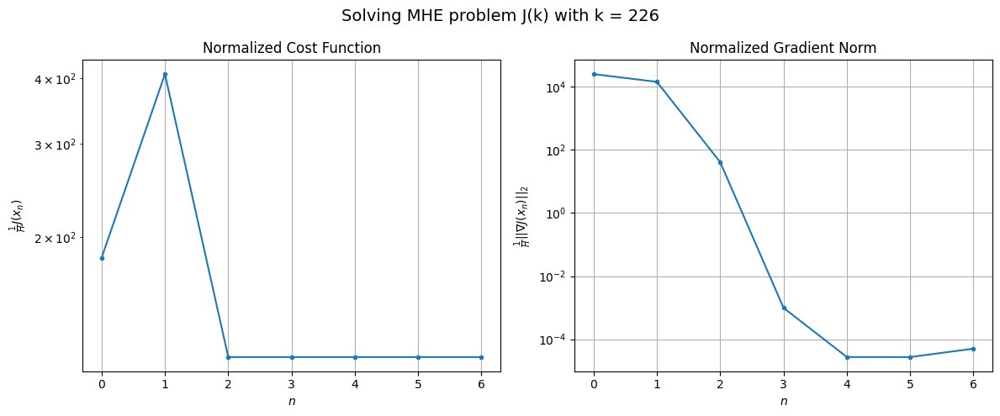

Windows:  56%|█████▋    | 218/386 [12:20<10:09,  3.63s/it]

[Gauss-Newton] Before applying the algorithm
Cost function: 1879.089911042418
Gradient norm: 240065.4144036235
Global estimation error: 140.03214761618597
Initial conditions estimation errors: 0.850649589992334 m, 29.76583697435232 m, 20.752893765356024 m, 135.2460497274796 m
Position estimation errors: 4.453725385733628 m, 40.07719237591452 m, 23.26457137353344 m, 252.35986291551905 m

[Gauss-Newton] Iteration 1
Cost function: 2948.1891868937723 (56.89%)
Gradient norm: 105996.4137976549 (-55.85%)
Global estimation error: 557.0344034834043 (297.79%)
Initial conditions estimation errors: 2.3863388282921076 m, 129.79249925459453 m, 79.89568480730144 m, 535.7723116455928 m
Position estimation errors: 2.5303118433208094 m, 144.61647874984334 m, 57.84334501788472 m, 707.0294974957058 m

[Gauss-Newton] Iteration 2
Cost function: 1224.3375112108383 (-58.47%)
Gradient norm: 611.4486146309264 (-99.42%)
Global estimation error: 613.0701858867615 (10.06%)
Initial conditions estimation errors: 2.3

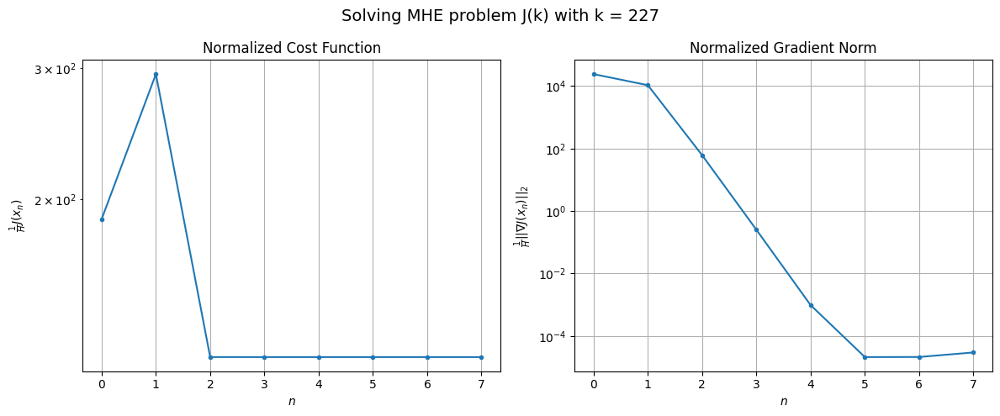

Windows:  57%|█████▋    | 219/386 [12:23<09:27,  3.40s/it]

[Gauss-Newton] Before applying the algorithm
Cost function: 1746.8328231430692
Gradient norm: 220597.0261817292
Global estimation error: 648.0434732783165
Initial conditions estimation errors: 0.9468537337656173 m, 146.72216592316485 m, 89.2456086014372 m, 624.8735937086509 m
Position estimation errors: 4.350427296679057 m, 159.69612264560044 m, 59.23382277309518 m, 789.7937067459686 m

[Gauss-Newton] Iteration 1
Cost function: 1143.5949186503328 (-34.53%)
Gradient norm: 396.3474171216541 (-99.82%)
Global estimation error: 565.4994979669312 (-12.74%)
Initial conditions estimation errors: 2.466743586993033 m, 132.56807039419763 m, 80.92617171856907 m, 543.7462038999571 m
Position estimation errors: 2.5518444121576573 m, 150.15625444081692 m, 54.767223309571506 m, 750.2191196361625 m

[Gauss-Newton] Iteration 2
Cost function: 1143.5282978187984 (-0.01%)
Gradient norm: 0.008062494277537148 (-100.00%)
Global estimation error: 565.8893920771579 (0.07%)
Initial conditions estimation errors: 

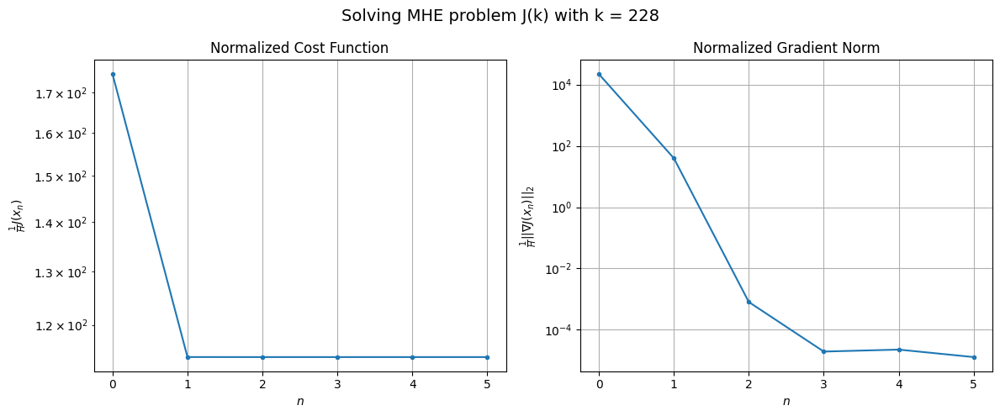

Windows:  57%|█████▋    | 220/386 [12:25<08:27,  3.06s/it]

[Gauss-Newton] Before applying the algorithm
Cost function: 1778.410275043334
Gradient norm: 232209.0994407932
Global estimation error: 598.0060914367111
Initial conditions estimation errors: 1.0156729863465528 m, 135.81177594733506 m, 80.37023346446811 m, 576.8065156534715 m
Position estimation errors: 4.29812265996884 m, 150.39162976963289 m, 50.49741772079018 m, 759.4178579408085 m

[Gauss-Newton] Iteration 1
Cost function: 2374.9711892812484 (33.54%)
Gradient norm: 87948.97844067436 (-62.13%)
Global estimation error: 60.72195036804398 (-89.85%)
Initial conditions estimation errors: 2.4905575859051945 m, 4.554850687243841 m, 8.585595431864773 m, 59.88700708711634 m
Position estimation errors: 2.485167953551773 m, 23.81242441470818 m, 10.350700751672914 m, 127.95721820179459 m

[Gauss-Newton] Iteration 2
Cost function: 1166.392871122 (-50.89%)
Gradient norm: 56.41536773796289 (-99.94%)
Global estimation error: 77.28042301697208 (27.27%)
Initial conditions estimation errors: 2.4905575

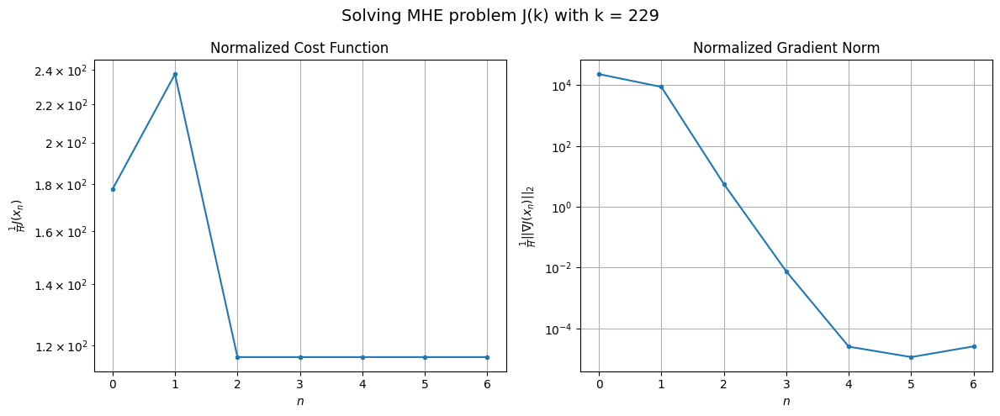

Windows:  57%|█████▋    | 221/386 [12:28<07:56,  2.89s/it]

[Gauss-Newton] Before applying the algorithm
Cost function: 1724.103719328751
Gradient norm: 224749.79155876877
Global estimation error: 89.33218403255542
Initial conditions estimation errors: 1.0170906498660197 m, 8.573294967886866 m, 8.516415448932358 m, 88.50499171566318 m
Position estimation errors: 4.183136486820065 m, 28.926067176926683 m, 12.240102207002998 m, 154.51405961228218 m

[Gauss-Newton] Iteration 1
Cost function: 1171.3477170052308 (-32.06%)
Gradient norm: 3666.908323851325 (-98.37%)
Global estimation error: 128.347615819884 (43.67%)
Initial conditions estimation errors: 2.41293060210797 m, 19.225836199984165 m, 14.535107763657308 m, 126.04069858546418 m
Position estimation errors: 2.44882861178724 m, 15.382352992176386 m, 12.880021775630096 m, 88.29155271273797 m

[Gauss-Newton] Iteration 2
Cost function: 1169.4453615822317 (-0.16%)
Gradient norm: 11.819882453589278 (-99.68%)
Global estimation error: 115.13441981513354 (-10.29%)
Initial conditions estimation errors: 2

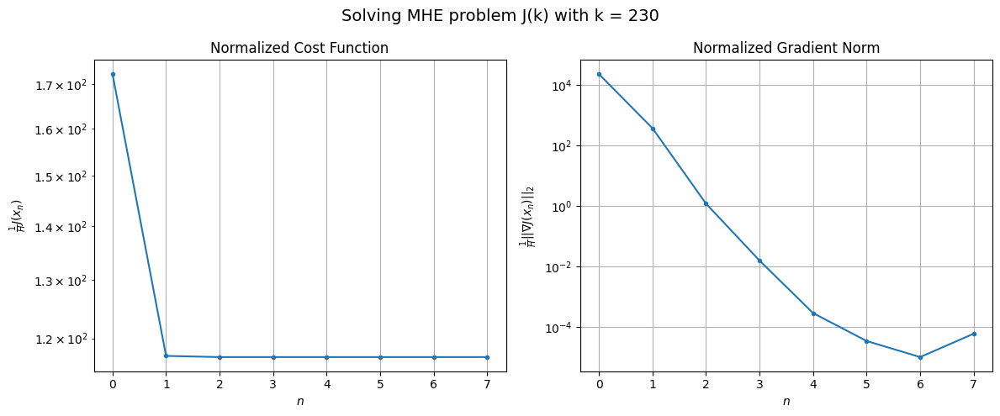

Windows:  58%|█████▊    | 222/386 [12:30<07:54,  2.89s/it]

[Gauss-Newton] Before applying the algorithm
Cost function: 1697.0033503792529
Gradient norm: 230649.65779420608
Global estimation error: 93.04474111529031
Initial conditions estimation errors: 0.9464638054581396 m, 14.138854729943956 m, 11.79243201159493 m, 91.19937573434379 m
Position estimation errors: 4.102890925065895 m, 22.004007640030316 m, 12.997994794104008 m, 120.73487389472558 m

[Gauss-Newton] Iteration 1
Cost function: 664647.3749676528 (39065.94%)
Gradient norm: 1953115.823191209 (746.79%)
Global estimation error: 3547.0724320536506 (3712.22%)
Initial conditions estimation errors: 2.3838107915816997 m, 705.9869803511463 m, 331.16594193173086 m, 3460.29209499219 m
Position estimation errors: 2.341478341787081 m, 741.7685116402532 m, 156.55403688156622 m, 4213.107157492123 m

[Gauss-Newton] Iteration 2
Cost function: 1286.519820509837 (-99.81%)
Gradient norm: 30633.1821202783 (-98.43%)
Global estimation error: 3079.053190943608 (-13.19%)
Initial conditions estimation errors

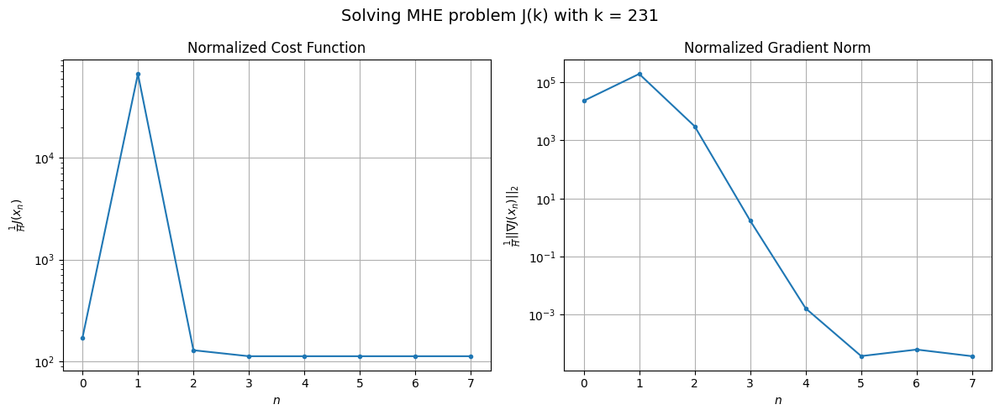

Windows:  58%|█████▊    | 223/386 [12:33<07:56,  2.92s/it]

[Gauss-Newton] Before applying the algorithm
Cost function: 1712.6551727163242
Gradient norm: 244592.26526840645
Global estimation error: 3195.550457475327
Initial conditions estimation errors: 0.9272109572597244 m, 626.4979672818197 m, 280.424531879632 m, 3120.9613062050057 m
Position estimation errors: 3.940654252764349 m, 638.6587748817175 m, 123.52919188077155 m, 3672.889889111497 m

[Gauss-Newton] Iteration 1
Cost function: 4819.854352644024 (181.43%)
Gradient norm: 149425.5196678867 (-38.91%)
Global estimation error: 2244.5655498897922 (-29.76%)
Initial conditions estimation errors: 2.3848910002910912 m, 437.0474572698375 m, 183.80999499258544 m, 2193.9166386457823 m
Position estimation errors: 2.140660184678598 m, 430.30688618854 m, 76.48541049918401 m, 2515.819693554906 m

[Gauss-Newton] Iteration 2
Cost function: 1114.1662961905658 (-76.88%)
Gradient norm: 219.9872327213083 (-99.85%)
Global estimation error: 2295.56696395335 (2.27%)
Initial conditions estimation errors: 2.3848

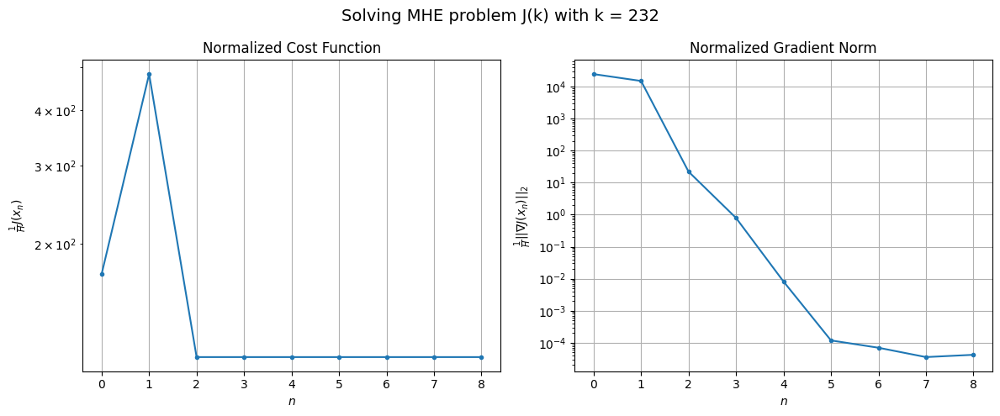

Windows:  58%|█████▊    | 224/386 [12:37<08:21,  3.10s/it]

[Gauss-Newton] Before applying the algorithm
Cost function: 1543.429940655902
Gradient norm: 210611.1695972658
Global estimation error: 2361.2640310159754
Initial conditions estimation errors: 0.9213971681675152 m, 450.407734533699 m, 177.50723221040886 m, 2311.101353178518 m
Position estimation errors: 3.6976060536337814 m, 426.31424709043597 m, 68.06697791626834 m, 2527.437412393689 m

[Gauss-Newton] Iteration 1
Cost function: 129849.22295205973 (8313.03%)
Gradient norm: 847714.081338964 (302.50%)
Global estimation error: 182.21127797038474 (-92.28%)
Initial conditions estimation errors: 2.2904365297027467 m, 18.818765482644803 m, 32.275172080489575 m, 178.32509655693397 m
Position estimation errors: 2.0854680375504855 m, 46.66727364349584 m, 12.23094740735725 m, 201.22438445504915 m

[Gauss-Newton] STOP on Iteration 2 (gradient norm stagnated)
Cost function = 3025.428377268734 (-97.67%)
Gradient norm = 103266.61312579612 (-87.82%)
Global estimation error = 760.7900763006737 (317.53%

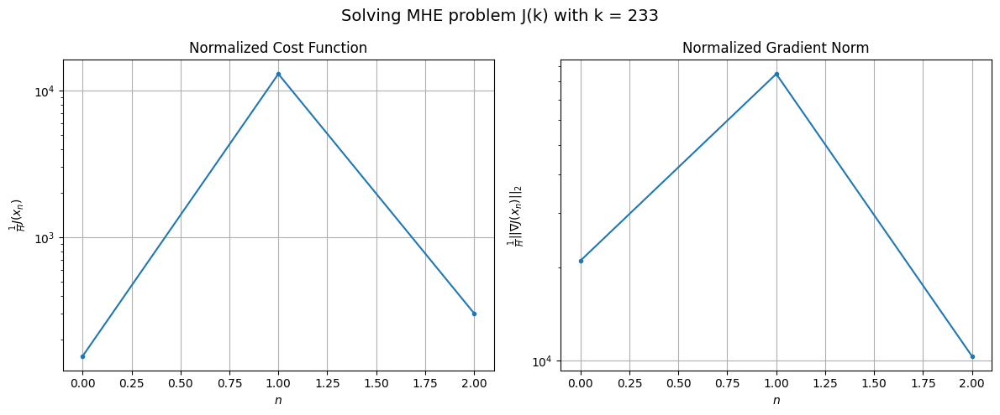

Windows:  58%|█████▊    | 225/386 [12:38<07:01,  2.62s/it]

[Gauss-Newton] Before applying the algorithm
Cost function: 3451.4294750061176
Gradient norm: 216439.3895294443
Global estimation error: 773.0975488403386
Initial conditions estimation errors: 0.8610006287907969 m, 155.26698370340196 m, 63.5466077678639 m, 754.6741106525313 m
Position estimation errors: 3.6180132969626664 m, 112.71815184206788 m, 27.434874622144132 m, 740.4491165258294 m

[Gauss-Newton] Iteration 1
Cost function: 1131445.7273767306 (32681.95%)
Gradient norm: 2486247.662487352 (1048.70%)
Global estimation error: 3664.679857875485 (374.03%)
Initial conditions estimation errors: 2.221191920737549 m, 653.2025058103692 m, 217.91055810847232 m, 3599.404303623684 m
Position estimation errors: 2.0069928203115746 m, 677.1903012824208 m, 64.51613897132054 m, 3892.0875212918954 m

[Gauss-Newton] Iteration 2
Cost function: 1006.4095214024553 (-99.91%)
Gradient norm: 8260.198228243231 (-99.67%)
Global estimation error: 3906.791517275853 (6.61%)
Initial conditions estimation errors:

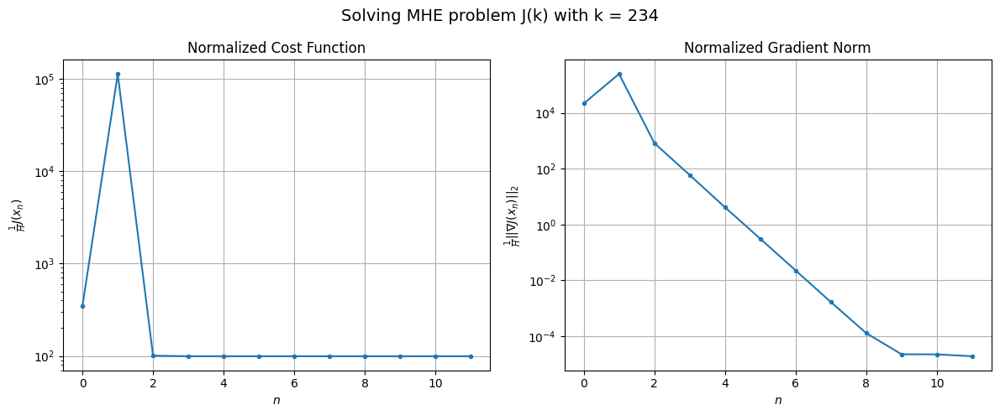

Windows:  59%|█████▊    | 226/386 [12:42<07:53,  2.96s/it]

[Gauss-Newton] Before applying the algorithm
Cost function: 1304.1691656050366
Gradient norm: 182325.72051174927
Global estimation error: 3952.548191251862
Initial conditions estimation errors: 0.844825400621886 m, 701.496098031125 m, 206.74036219899315 m, 3884.30114174848 m
Position estimation errors: 3.5209959708795187 m, 691.8923400749853 m, 51.75002277414346 m, 4006.083251095395 m

[Gauss-Newton] Iteration 1
Cost function: 880.425995184454 (-32.49%)
Gradient norm: 454.4221453032055 (-99.75%)
Global estimation error: 3860.0289642023695 (-2.34%)
Initial conditions estimation errors: 2.1364422992190018 m, 685.0269422656902 m, 201.33734239408878 m, 3793.4176402383123 m
Position estimation errors: 2.0565337622297295 m, 685.0296258302551 m, 53.87329005487562 m, 3971.177919058033 m

[Gauss-Newton] Iteration 2
Cost function: 880.4220197414696 (-0.00%)
Gradient norm: 646.5791820867976 (42.29%)
Global estimation error: 3933.570155877995 (1.91%)
Initial conditions estimation errors: 2.1364423

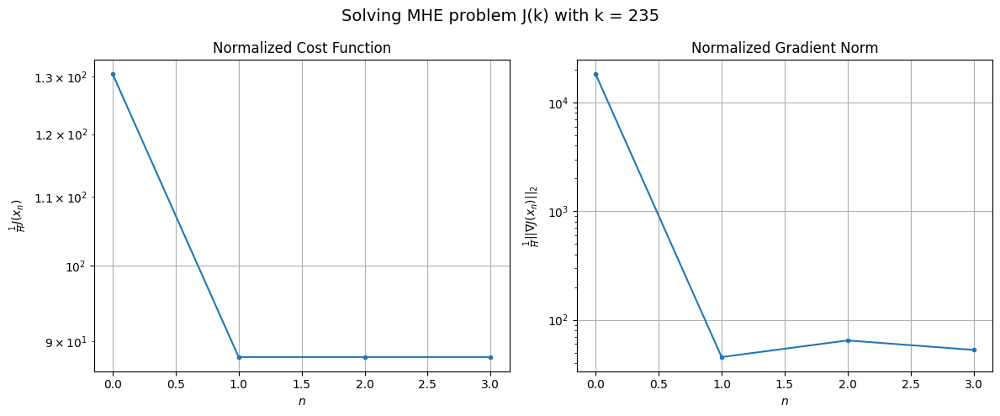

Windows:  59%|█████▉    | 227/386 [12:44<06:50,  2.58s/it]

[Gauss-Newton] Before applying the algorithm
Cost function: 1316.1447052754268
Gradient norm: 195234.34952361227
Global estimation error: 3956.2220248164476
Initial conditions estimation errors: 0.8084440631360761 m, 699.5561484505058 m, 186.59902594372264 m, 3889.4076539944176 m
Position estimation errors: 3.5946045789296006 m, 669.8114825460513 m, 41.868215649270894 m, 3910.414134264983 m

[Gauss-Newton] Iteration 1
Cost function: 46592.096539082144 (3440.04%)
Gradient norm: 507079.55358847394 (159.73%)
Global estimation error: 1979.3803062137654 (-49.97%)
Initial conditions estimation errors: 2.1147133104537006 m, 350.9606106702102 m, 95.77150215354372 m, 1945.6608654813003 m
Position estimation errors: 2.0317598968083677 m, 312.18171344256297 m, 23.838608417843215 m, 1789.215246447682 m

[Gauss-Newton] STOP on Iteration 2 (gradient norm stagnated)
Cost function = 83377.53971277968 (78.95%)
Gradient norm = 660196.6232792679 (30.20%)
Global estimation error = 418.7632642575487 (-78.8

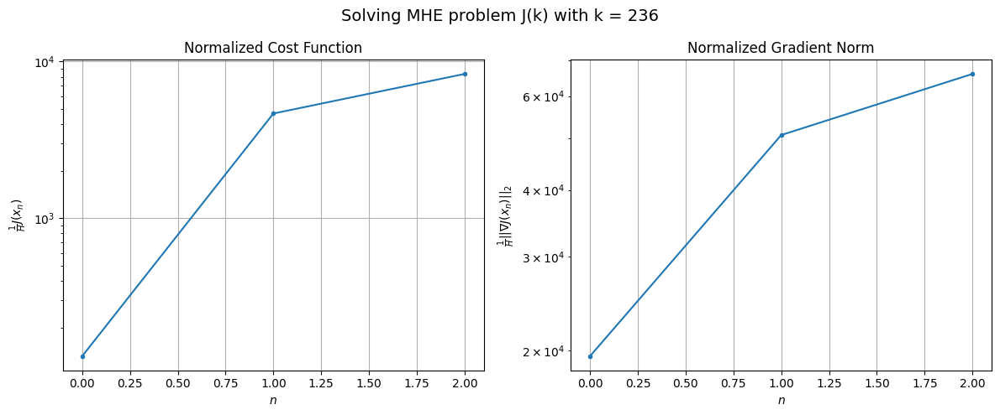

Windows:  59%|█████▉    | 228/386 [12:45<05:53,  2.24s/it]

[Gauss-Newton] Before applying the algorithm
Cost function: 81887.29715129624
Gradient norm: 615588.2958738622
Global estimation error: 445.88011525038223
Initial conditions estimation errors: 0.8360048099888545 m, 71.49226885465706 m, 24.92502349889349 m, 439.4038809527386 m
Position estimation errors: 3.5896593186988444 m, 97.72556727203646 m, 10.792584661467897 m, 598.1264489713172 m



/home/jgaspar/SpaceSim-Toolkit/test/new_newton_based_algorithms/gauss_newton.py:181: LinAlgWarning: Ill-conditioned matrix (rcond=8.37681e-17): result may not be accurate.
  delta_x = solve(HJ_x, -DJ_x)


[Gauss-Newton] Iteration 1
Cost function: 140744.24106527222 (71.88%)
Gradient norm: 840884.6875115273 (36.60%)
Global estimation error: 2372.93864253308 (432.19%)
Initial conditions estimation errors: 2.1224444897244212 m, 416.1706631958639 m, 103.79471560817844 m, 2333.8512723778013 m
Position estimation errors: 1.9767800963088775 m, 357.7544066098423 m, 30.530420728240756 m, 2057.252716664913 m



/home/jgaspar/SpaceSim-Toolkit/test/new_newton_based_algorithms/gauss_newton.py:181: LinAlgWarning: Ill-conditioned matrix (rcond=9.43184e-17): result may not be accurate.
  delta_x = solve(HJ_x, -DJ_x)


[Gauss-Newton] Iteration 2
Cost function: 261797.79874486703 (86.01%)
Gradient norm: 1171805.9904983141 (39.35%)
Global estimation error: 5583.482082001256 (135.30%)
Initial conditions estimation errors: 2.1224444959966826 m, 971.0461845098057 m, 229.02777577585852 m, 5493.621850530346 m
Position estimation errors: 1.9767800802928874 m, 901.3184409799622 m, 46.74929136837087 m, 5222.875321651192 m

[Gauss-Newton] Iteration 3
Cost function: 963.0090615695874 (-99.63%)
Gradient norm: 19588.928569910466 (-98.33%)
Global estimation error: 5985.947151209944 (7.21%)
Initial conditions estimation errors: 2.1224445016707367 m, 1039.9541154929002 m, 244.4252191858071 m, 5889.847868537919 m
Position estimation errors: 1.976780070752875 m, 969.7950579341012 m, 48.24024873880662 m, 5619.75659655115 m

[Gauss-Newton] Iteration 4
Cost function: 889.6556740513379 (-7.62%)
Gradient norm: 40.55124361529539 (-99.79%)
Global estimation error: 6004.573824933438 (0.31%)
Initial conditions estimation errors

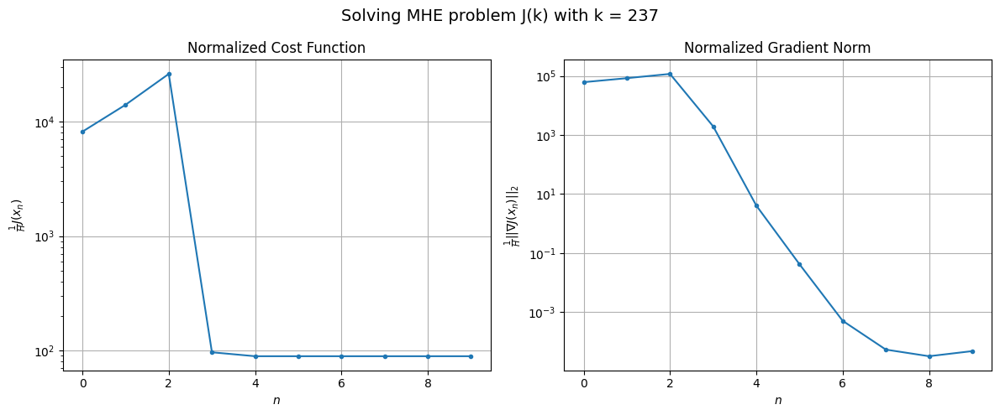

Windows:  59%|█████▉    | 229/386 [12:49<06:45,  2.58s/it]

[Gauss-Newton] Before applying the algorithm
Cost function: 1333.085652875574
Gradient norm: 198469.92344208082
Global estimation error: 6081.419838065918
Initial conditions estimation errors: 0.83805803867973 m, 1054.9945807717666 m, 223.03635796188024 m, 5985.056909962922 m
Position estimation errors: 3.5297752358995096 m, 942.4453144338007 m, 51.994519228768134 m, 5482.409658856555 m

[Gauss-Newton] Iteration 1
Cost function: 447765.4501995683 (33488.65%)
Gradient norm: 1491458.9929606058 (651.48%)
Global estimation error: 2299.235785067378 (-62.19%)
Initial conditions estimation errors: 2.0836607192456142 m, 403.2926498124031 m, 86.7089736264276 m, 2261.927784270034 m
Position estimation errors: 1.9820708587384357 m, 343.0920929521496 m, 29.32868875022764 m, 1988.5289582821572 m



/home/jgaspar/SpaceSim-Toolkit/test/new_newton_based_algorithms/gauss_newton.py:181: LinAlgWarning: Ill-conditioned matrix (rcond=4.90568e-17): result may not be accurate.
  delta_x = solve(HJ_x, -DJ_x)


[Gauss-Newton] Iteration 2
Cost function: 175483.40868966473 (-60.81%)
Gradient norm: 956400.9480724048 (-35.87%)
Global estimation error: 657.0641134206783 (-71.42%)
Initial conditions estimation errors: 2.083660719353354 m, 106.03775161265159 m, 34.28995177092314 m, 647.5404288341448 m
Position estimation errors: 1.9820708463084629 m, 153.6806258811551 m, 20.93009344033979 m, 892.8330356533569 m



/home/jgaspar/SpaceSim-Toolkit/test/new_newton_based_algorithms/gauss_newton.py:181: LinAlgWarning: Ill-conditioned matrix (rcond=3.47422e-17): result may not be accurate.
  delta_x = solve(HJ_x, -DJ_x)


[Gauss-Newton] Iteration 3
Cost function: 18167.615690889314 (-89.65%)
Gradient norm: 300922.7504980645 (-68.54%)
Global estimation error: 2290.748399665592 (248.63%)
Initial conditions estimation errors: 2.0836607261129134 m, 387.0175849140882 m, 88.22371723270255 m, 2256.0931399385895 m
Position estimation errors: 1.9820708425724043 m, 429.23211437722034 m, 15.626525467693119 m, 2493.9710976339065 m



/home/jgaspar/SpaceSim-Toolkit/test/new_newton_based_algorithms/gauss_newton.py:181: LinAlgWarning: Ill-conditioned matrix (rcond=5.45564e-17): result may not be accurate.
  delta_x = solve(HJ_x, -DJ_x)


[Gauss-Newton] Iteration 4
Cost function: 893.8892488895775 (-95.08%)
Gradient norm: 4121.319365494243 (-98.63%)
Global estimation error: 2098.006962971447 (-8.41%)
Initial conditions estimation errors: 2.083660727153853 m, 353.88259541154883 m, 81.89239519173755 m, 2066.3223807463955 m
Position estimation errors: 1.9820708395413582 m, 396.4033062258287 m, 15.94823818301363 m, 2304.3071667146764 m



/home/jgaspar/SpaceSim-Toolkit/test/new_newton_based_algorithms/gauss_newton.py:181: LinAlgWarning: Ill-conditioned matrix (rcond=5.13319e-17): result may not be accurate.
  delta_x = solve(HJ_x, -DJ_x)


[Gauss-Newton] Iteration 5
Cost function: 890.6669406308167 (-0.36%)
Gradient norm: 0.7710135072951056 (-99.98%)
Global estimation error: 2095.3218440673295 (-0.13%)
Initial conditions estimation errors: 2.0836607275326 m, 353.418609346327 m, 81.8055194980603 m, 2063.678995339676 m
Position estimation errors: 1.9820708397840143 m, 395.9651918537386 m, 15.958268952833127 m, 2301.7401280807007 m



/home/jgaspar/SpaceSim-Toolkit/test/new_newton_based_algorithms/gauss_newton.py:181: LinAlgWarning: Ill-conditioned matrix (rcond=5.12905e-17): result may not be accurate.
  delta_x = solve(HJ_x, -DJ_x)


[Gauss-Newton] Iteration 6
Cost function: 890.6669405480457 (-0.00%)
Gradient norm: 0.00014467360756085127 (-99.98%)
Global estimation error: 2095.2907818701765 (-0.00%)
Initial conditions estimation errors: 2.0836607275326 m, 353.41325275137183 m, 81.80447618068158 m, 2063.648415573292 m
Position estimation errors: 1.9820708408289867 m, 395.96023490424506 m, 15.95845333437981 m, 2301.711205160735 m



/home/jgaspar/SpaceSim-Toolkit/test/new_newton_based_algorithms/gauss_newton.py:181: LinAlgWarning: Ill-conditioned matrix (rcond=5.129e-17): result may not be accurate.
  delta_x = solve(HJ_x, -DJ_x)


[Gauss-Newton] Iteration 7
Cost function: 890.666940545582 (-0.00%)
Gradient norm: 8.185614203901888e-05 (-43.42%)
Global estimation error: 2095.2917233681856 (0.00%)
Initial conditions estimation errors: 2.0836607275326 m, 353.41341422844505 m, 81.8045088899626 m, 2063.6493425566855 m
Position estimation errors: 1.9820708405797638 m, 395.9603955722268 m, 15.958450848241178 m, 2301.712126383352 m

[Gauss-Newton] Iteration 8
Cost function: 890.6669404626298 (-0.00%)
Gradient norm: 0.0003543427165134715 (332.88%)
Global estimation error: 2095.2916648700475 (-0.00%)
Initial conditions estimation errors: 2.0836607275326 m, 353.4134041852121 m, 81.80450685477832 m, 2063.649284962239 m
Position estimation errors: 1.9820708395347915 m, 395.9603855945186 m, 15.958450993571098 m, 2301.7120689257526 m

[Gauss-Newton] Iteration 9
Cost function: 890.6669405469522 (0.00%)
Gradient norm: 0.0001257755748872545 (-64.50%)
Global estimation error: 2095.2916703363594 (0.00%)
Initial conditions estimation

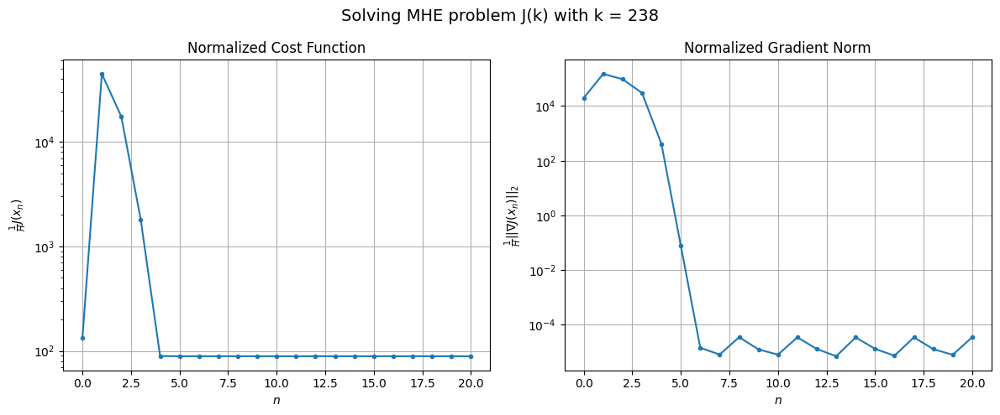

Windows:  60%|█████▉    | 230/386 [12:55<09:43,  3.74s/it]

[Gauss-Newton] Before applying the algorithm
Cost function: 1241.058594344583
Gradient norm: 200147.02400159807
Global estimation error: 2159.7768160455007
Initial conditions estimation errors: 0.7583598422330149 m, 364.00468841814194 m, 72.18709483466182 m, 2127.6568856402596 m
Position estimation errors: 3.5425606496618496 m, 392.8207720460269 m, 19.352719800067298 m, 2279.4512043508903 m



/home/jgaspar/SpaceSim-Toolkit/test/new_newton_based_algorithms/gauss_newton.py:181: LinAlgWarning: Ill-conditioned matrix (rcond=1.97168e-17): result may not be accurate.
  delta_x = solve(HJ_x, -DJ_x)


[Gauss-Newton] Iteration 1
Cost function: 252610748.00201228 (20354357.81%)
Gradient norm: 36341824.59580763 (18057.56%)
Global estimation error: 16612.502139134227 (669.18%)
Initial conditions estimation errors: 2.0715636792076855 m, 2861.0087278962624 m, 531.4966566534164 m, 16355.651585594014 m
Position estimation errors: 1.9911894699087795 m, 2726.0560216056847 m, 74.6380114012428 m, 15841.915844270667 m

[Gauss-Newton] Iteration 2
Cost function: 43706503.76030967 (-82.70%)
Gradient norm: 15338697.111352958 (-57.79%)
Global estimation error: 4371.010440045846 (-73.69%)
Initial conditions estimation errors: 2.071563600444235 m, 769.9259057284418 m, 132.43959033559298 m, 4300.62803784489 m
Position estimation errors: 1.9911895302411389 m, 615.2458458653358 m, 50.56985723170526 m, 3798.414669171856 m



/home/jgaspar/SpaceSim-Toolkit/test/new_newton_based_algorithms/gauss_newton.py:181: LinAlgWarning: Ill-conditioned matrix (rcond=4.9552e-17): result may not be accurate.
  delta_x = solve(HJ_x, -DJ_x)


[Gauss-Newton] STOP on Iteration 3 (gradient norm stagnated)
Cost function = 41782830.46889719 (-4.40%)
Gradient norm = 14619277.682746233 (-4.69%)
Global estimation error = 8014.951273082122 (83.37%)
Final initial conditions estimation errors: 2.07156367542072 m, 1357.920015410583 m, 250.51273730547786 m, 7895.107847667653 m
Final position estimation errors: 1.991189467675563 m, 1420.9356118399733 m, 12.435152145726263 m, 7956.236850011124 m



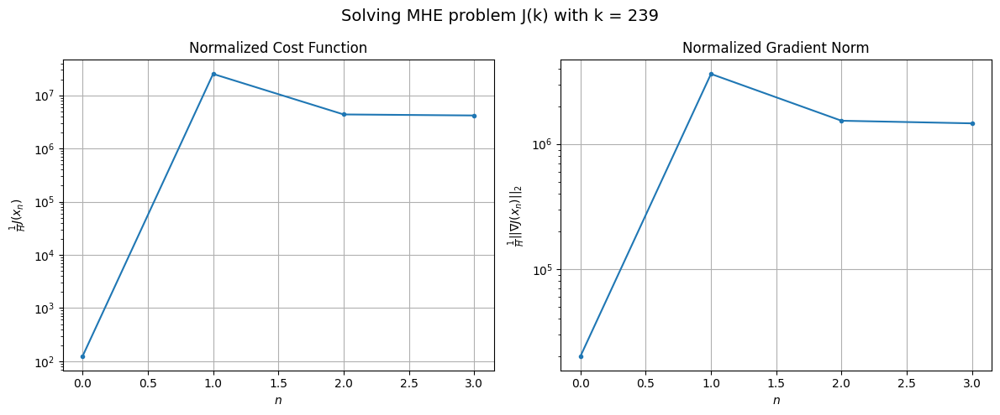

Windows:  60%|█████▉    | 231/386 [12:57<08:21,  3.23s/it]

[Gauss-Newton] Before applying the algorithm
Cost function: 40259157.32396946
Gradient norm: 14075050.643314168
Global estimation error: 8165.290383925372
Initial conditions estimation errors: 0.7361560012187099 m, 1388.742554095858 m, 223.25252548767608 m, 8043.227807294444 m
Position estimation errors: 3.5151556905578647 m, 1397.5104859290761 m, 41.64852845940675 m, 7786.653693737364 m

[Gauss-Newton] Iteration 1
Cost function: 664076.4384742476 (-98.35%)
Gradient norm: 1729375.3409940791 (-87.71%)
Global estimation error: 3370.8269054373027 (-58.72%)
Initial conditions estimation errors: 2.007356677804755 m, 560.1706877705875 m, 102.63334536032039 m, 3322.3696826179976 m
Position estimation errors: 2.0022460744067545 m, 699.1113268165893 m, 74.3530655911037 m, 3838.244597908871 m



/home/jgaspar/SpaceSim-Toolkit/test/new_newton_based_algorithms/gauss_newton.py:181: LinAlgWarning: Ill-conditioned matrix (rcond=5.5432e-17): result may not be accurate.
  delta_x = solve(HJ_x, -DJ_x)


[Gauss-Newton] Iteration 2
Cost function: 9822.69082642857 (-98.52%)
Gradient norm: 246810.55980035386 (-85.73%)
Global estimation error: 2220.2103534387743 (-34.13%)
Initial conditions estimation errors: 2.007356689033486 m, 367.7245504896613 m, 64.32774511286594 m, 2188.5999640073564 m
Position estimation errors: 2.0022460509184627 m, 383.3614877207075 m, 25.277442117105274 m, 2228.2753496956198 m



/home/jgaspar/SpaceSim-Toolkit/test/new_newton_based_algorithms/gauss_newton.py:181: LinAlgWarning: Ill-conditioned matrix (rcond=5.10975e-17): result may not be accurate.
  delta_x = solve(HJ_x, -DJ_x)


[Gauss-Newton] Iteration 3
Cost function: 1415805.2168223127 (14313.62%)
Gradient norm: 2701698.4762702417 (994.64%)
Global estimation error: 2844.2624806545473 (28.11%)
Initial conditions estimation errors: 2.0073566736458077 m, 499.94545398535297 m, 79.0929357464781 m, 2798.861101248536 m
Position estimation errors: 2.0022460894731715 m, 456.92592228663705 m, 24.333852977784677 m, 2596.780330386996 m



/home/jgaspar/SpaceSim-Toolkit/test/new_newton_based_algorithms/gauss_newton.py:181: LinAlgWarning: Ill-conditioned matrix (rcond=6.39928e-17): result may not be accurate.
  delta_x = solve(HJ_x, -DJ_x)


[Gauss-Newton] Iteration 4
Cost function: 264066.60538407293 (-81.35%)
Gradient norm: 1229362.3038218198 (-54.50%)
Global estimation error: 5910.643382223039 (107.81%)
Initial conditions estimation errors: 2.0073566713247306 m, 1021.1193803013417 m, 166.1114116797593 m, 5819.4001356004455 m
Position estimation errors: 2.0022461084852288 m, 1066.9355423626364 m, 60.50397153536401 m, 5937.797987769666 m

[Gauss-Newton] Iteration 5
Cost function: 718.1225990656908 (-99.73%)
Gradient norm: 677.3594318368133 (-99.94%)
Global estimation error: 5948.7730462730115 (0.65%)
Initial conditions estimation errors: 2.0073566649092855 m, 1027.307775194879 m, 168.03876693154297 m, 5856.986649599376 m
Position estimation errors: 2.0022461157522855 m, 1080.5943269625063 m, 64.75936801702558 m, 6006.696533661107 m

[Gauss-Newton] Iteration 6
Cost function: 718.0916662341141 (-0.00%)
Gradient norm: 407.5186142064929 (-39.84%)
Global estimation error: 6015.173035378486 (1.12%)
Initial conditions estimation

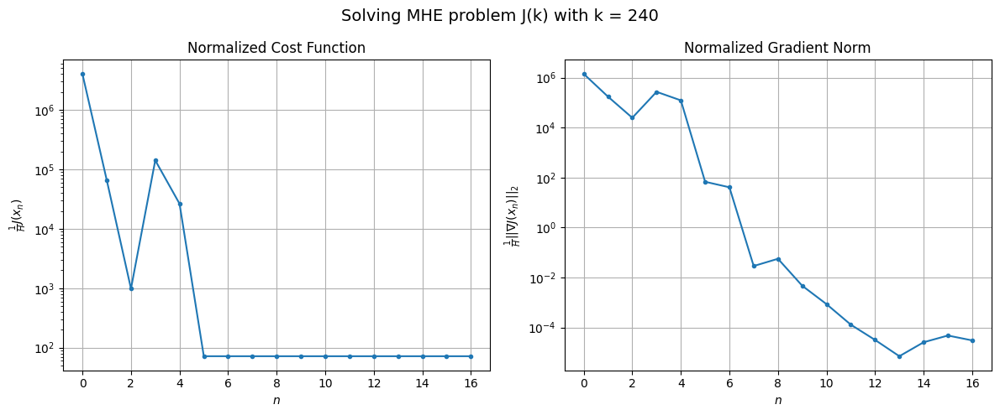

Windows:  60%|██████    | 232/386 [13:03<09:54,  3.86s/it]

[Gauss-Newton] Before applying the algorithm
Cost function: 1167.973566911955
Gradient norm: 218674.1817709413
Global estimation error: 6140.424636567093
Initial conditions estimation errors: 0.6997149883245516 m, 1064.2778206534176 m, 148.296086774646 m, 6045.670450822014 m
Position estimation errors: 3.4796440306617105 m, 1071.9136510247165 m, 86.97530206754274 m, 5948.113023053026 m

[Gauss-Newton] Iteration 1
Cost function: 129686.93743734964 (11003.58%)
Gradient norm: 791474.5123845071 (261.94%)
Global estimation error: 3279.4983002758468 (-46.59%)
Initial conditions estimation errors: 2.0013231773206774 m, 566.6763373787282 m, 81.24498663528375 m, 3229.145365648501 m
Position estimation errors: 1.8602713920552698 m, 654.4299383379059 m, 66.74956578623608 m, 3412.293986772474 m



/home/jgaspar/SpaceSim-Toolkit/test/new_newton_based_algorithms/gauss_newton.py:181: LinAlgWarning: Ill-conditioned matrix (rcond=6.32711e-17): result may not be accurate.
  delta_x = solve(HJ_x, -DJ_x)


[Gauss-Newton] STOP on Iteration 2 (gradient norm stagnated)
Cost function = 43163.0123146433 (-66.72%)
Gradient norm = 496276.3546228487 (-37.30%)
Global estimation error = 1321.5325898616813 (-59.70%)
Final initial conditions estimation errors: 2.0013231821202178 m, 231.5564429725078 m, 31.57269529206616 m, 1300.7032632953594 m
Final position estimation errors: 1.8602714018097406 m, 254.92280968064313 m, 14.919562894370252 m, 1263.3946334480083 m



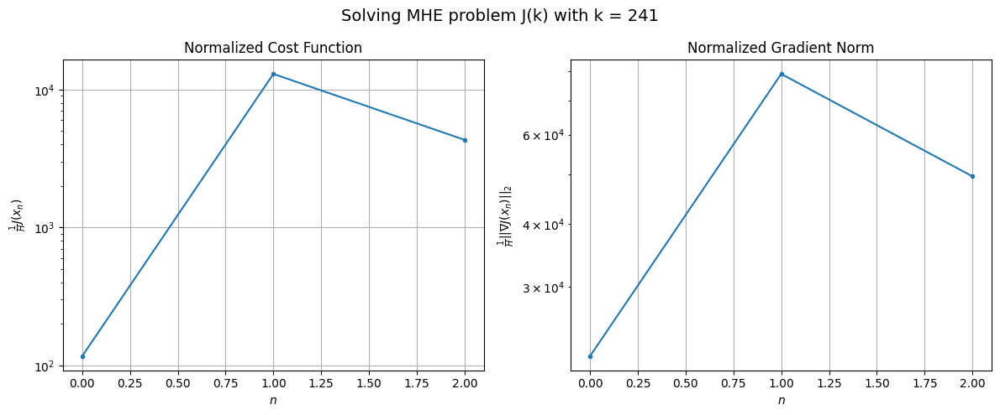

Windows:  60%|██████    | 233/386 [13:04<08:00,  3.14s/it]

[Gauss-Newton] Before applying the algorithm
Cost function: 44527.131000540154
Gradient norm: 508922.9753632837
Global estimation error: 1341.9869020891367
Initial conditions estimation errors: 0.7145648339567654 m, 239.1050438368358 m, 27.375799524007203 m, 1320.2301195155696 m
Position estimation errors: 3.2811159651972166 m, 251.11741799941535 m, 20.058743376833043 m, 1230.02699373004 m



/home/jgaspar/SpaceSim-Toolkit/test/new_newton_based_algorithms/gauss_newton.py:181: LinAlgWarning: Ill-conditioned matrix (rcond=4.18522e-17): result may not be accurate.
  delta_x = solve(HJ_x, -DJ_x)


[Gauss-Newton] Iteration 1
Cost function: 113034.77766442 (153.86%)
Gradient norm: 744142.4354288497 (46.22%)
Global estimation error: 1434.111204896222 (6.86%)
Initial conditions estimation errors: 1.844210556597583 m, 241.33121522860074 m, 28.40048624261191 m, 1413.3733213994685 m
Position estimation errors: 1.8295590211690635 m, 221.1323915326413 m, 18.56429707968755 m, 1271.179065418343 m



/home/jgaspar/SpaceSim-Toolkit/test/new_newton_based_algorithms/gauss_newton.py:181: LinAlgWarning: Ill-conditioned matrix (rcond=2.45045e-17): result may not be accurate.
  delta_x = solve(HJ_x, -DJ_x)


[Gauss-Newton] Iteration 2
Cost function: 8440027.608806161 (7366.75%)
Gradient norm: 6860293.570681177 (821.91%)
Global estimation error: 9052.676931087712 (531.24%)
Initial conditions estimation errors: 1.8442105450795299 m, 1556.4652915337065 m, 186.9388850420315 m, 8915.907777574655 m
Position estimation errors: 1.829559038882364 m, 1686.9018033020266 m, 230.1825923497218 m, 9186.169252337942 m

[Gauss-Newton] Iteration 3
Cost function: 49257.90114077121 (-99.42%)
Gradient norm: 523495.36824033514 (-92.37%)
Global estimation error: 6882.155647980806 (-23.98%)
Initial conditions estimation errors: 1.8442105205696024 m, 1182.1200451378452 m, 141.40964896195382 m, 6778.395913489582 m
Position estimation errors: 1.8295590563301998 m, 1258.8215309362195 m, 165.3332235437597 m, 6896.300705659406 m

[Gauss-Newton] Iteration 4
Cost function: 744.1768138217402 (-98.49%)
Gradient norm: 291.8968548873034 (-99.94%)
Global estimation error: 6928.135349314097 (0.67%)
Initial conditions estimatio

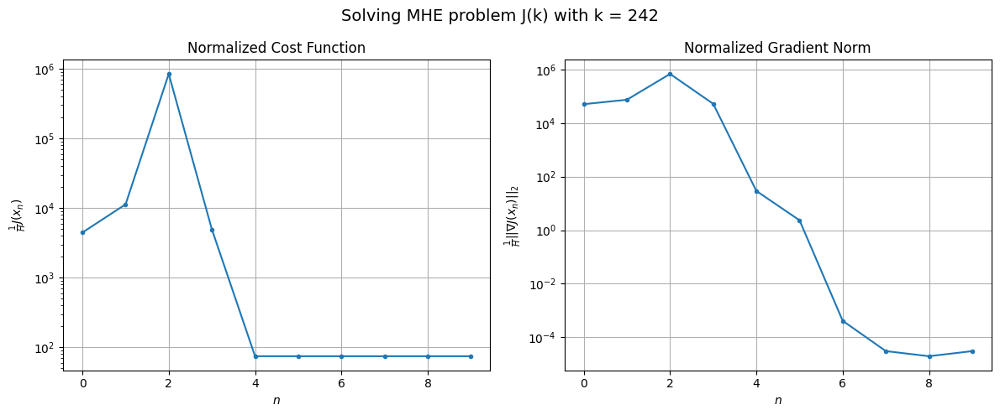

Windows:  61%|██████    | 234/386 [13:07<08:12,  3.24s/it]

[Gauss-Newton] Before applying the algorithm
Cost function: 1127.8861906857933
Gradient norm: 202935.71472550844
Global estimation error: 7080.593540797485
Initial conditions estimation errors: 0.5990929617152339 m, 1222.5203985301441 m, 117.14561369883843 m, 6973.271846284221 m
Position estimation errors: 3.2605224329038873 m, 1251.226044410072 m, 191.5657177889067 m, 6815.343305753946 m

[Gauss-Newton] Iteration 1
Cost function: 56332.459912216946 (4894.52%)
Gradient norm: 533244.5653234777 (162.77%)
Global estimation error: 4807.58250089928 (-32.10%)
Initial conditions estimation errors: 1.8535891990515607 m, 837.4975955993815 m, 81.06823016881016 m, 4733.378189346891 m
Position estimation errors: 1.7238740364408578 m, 868.9561899462217 m, 136.5968300807115 m, 4693.69878485397 m



/home/jgaspar/SpaceSim-Toolkit/test/new_newton_based_algorithms/gauss_newton.py:181: LinAlgWarning: Ill-conditioned matrix (rcond=1.10481e-16): result may not be accurate.
  delta_x = solve(HJ_x, -DJ_x)


[Gauss-Newton] Iteration 2
Cost function: 1126.5430843903612 (-98.00%)
Gradient norm: 47890.13730037771 (-91.02%)
Global estimation error: 4163.5164402971495 (-13.40%)
Initial conditions estimation errors: 1.853589202423238 m, 725.5367082285233 m, 69.78031868073074 m, 4099.218344469466 m
Position estimation errors: 1.7238740449707248 m, 744.4253781939653 m, 115.22916620916213 m, 4035.1520455167 m



/home/jgaspar/SpaceSim-Toolkit/test/new_newton_based_algorithms/gauss_newton.py:181: LinAlgWarning: Ill-conditioned matrix (rcond=9.08338e-17): result may not be accurate.
  delta_x = solve(HJ_x, -DJ_x)


[Gauss-Newton] Iteration 3
Cost function: 714.6662382378559 (-36.56%)
Gradient norm: 3826.008556563647 (-92.01%)
Global estimation error: 3982.712038783631 (-4.34%)
Initial conditions estimation errors: 1.8535892032522712 m, 694.0187401584005 m, 66.65414885027158 m, 3921.209673753069 m
Position estimation errors: 1.7238740421127245 m, 709.3467157338218 m, 108.87210516627492 m, 3849.527306832984 m



/home/jgaspar/SpaceSim-Toolkit/test/new_newton_based_algorithms/gauss_newton.py:181: LinAlgWarning: Ill-conditioned matrix (rcond=8.59109e-17): result may not be accurate.
  delta_x = solve(HJ_x, -DJ_x)


[Gauss-Newton] Iteration 4
Cost function: 712.0442498884443 (-0.37%)
Gradient norm: 317.8359426865804 (-91.69%)
Global estimation error: 3930.5371250562744 (-1.31%)
Initial conditions estimation errors: 1.8535892032522712 m, 684.9242318969832 m, 65.75321787253381 m, 3869.84138819073 m
Position estimation errors: 1.7238740419127694 m, 699.2689187279601 m, 107.06251469672935 m, 3796.1209467141157 m



/home/jgaspar/SpaceSim-Toolkit/test/new_newton_based_algorithms/gauss_newton.py:181: LinAlgWarning: Ill-conditioned matrix (rcond=8.45453e-17): result may not be accurate.
  delta_x = solve(HJ_x, -DJ_x)


[Gauss-Newton] Iteration 5
Cost function: 712.0261109254373 (-0.00%)
Gradient norm: 26.663403392621337 (-91.61%)
Global estimation error: 3915.4241724113363 (-0.38%)
Initial conditions estimation errors: 1.8535892032522712 m, 682.2897811215378 m, 65.49223251856579 m, 3854.962108254219 m
Position estimation errors: 1.7238740419794212 m, 696.3514144531853 m, 106.53967345413486 m, 3780.658057037022 m



/home/jgaspar/SpaceSim-Toolkit/test/new_newton_based_algorithms/gauss_newton.py:181: LinAlgWarning: Ill-conditioned matrix (rcond=8.41544e-17): result may not be accurate.
  delta_x = solve(HJ_x, -DJ_x)


[Gauss-Newton] Iteration 6
Cost function: 712.0259829632614 (-0.00%)
Gradient norm: 2.2510703939744334 (-91.56%)
Global estimation error: 3911.032793754496 (-0.11%)
Initial conditions estimation errors: 1.8535892032242252 m, 681.5242777442656 m, 65.41639799930054 m, 3850.638629693975 m
Position estimation errors: 1.7238740412154785 m, 695.503842353527 m, 106.38786895638383 m, 3776.165651362471 m



/home/jgaspar/SpaceSim-Toolkit/test/new_newton_based_algorithms/gauss_newton.py:181: LinAlgWarning: Ill-conditioned matrix (rcond=8.40412e-17): result may not be accurate.
  delta_x = solve(HJ_x, -DJ_x)


[Gauss-Newton] Iteration 7
Cost function: 712.0259821413664 (-0.00%)
Gradient norm: 0.19040491808246246 (-91.54%)
Global estimation error: 3909.7556427323843 (-0.03%)
Initial conditions estimation errors: 1.8535892032242252 m, 681.301644412503 m, 65.39434292902331 m, 3849.38122630978 m
Position estimation errors: 1.7238740419794212 m, 695.2573552408302 m, 106.34372904546007 m, 3774.8591712549264 m



/home/jgaspar/SpaceSim-Toolkit/test/new_newton_based_algorithms/gauss_newton.py:181: LinAlgWarning: Ill-conditioned matrix (rcond=8.40083e-17): result may not be accurate.
  delta_x = solve(HJ_x, -DJ_x)


[Gauss-Newton] Iteration 8
Cost function: 712.0259820302931 (-0.00%)
Gradient norm: 0.016125444079892717 (-91.53%)
Global estimation error: 3909.3840995628907 (-0.01%)
Initial conditions estimation errors: 1.8535892032242252 m, 681.2368768263332 m, 65.3879267626298 m, 3849.0154280496076 m
Position estimation errors: 1.7238740412154785 m, 695.1856494196022 m, 106.3308888566295 m, 3774.4791001966087 m



/home/jgaspar/SpaceSim-Toolkit/test/new_newton_based_algorithms/gauss_newton.py:181: LinAlgWarning: Ill-conditioned matrix (rcond=8.39987e-17): result may not be accurate.
  delta_x = solve(HJ_x, -DJ_x)


[Gauss-Newton] Iteration 9
Cost function: 712.0259821217344 (0.00%)
Gradient norm: 0.0013955083881960883 (-91.35%)
Global estimation error: 3909.2760121135652 (-0.00%)
Initial conditions estimation errors: 1.8535892032242252 m, 681.2180349672493 m, 65.38606020740943 m, 3848.909011880433 m
Position estimation errors: 1.7238740435073066 m, 695.1647892638233 m, 106.32715354355369 m, 3774.368532376151 m



/home/jgaspar/SpaceSim-Toolkit/test/new_newton_based_algorithms/gauss_newton.py:181: LinAlgWarning: Ill-conditioned matrix (rcond=8.39959e-17): result may not be accurate.
  delta_x = solve(HJ_x, -DJ_x)


[Gauss-Newton] Iteration 10
Cost function: 712.0259822686705 (0.00%)
Gradient norm: 0.0006827784498671137 (-51.07%)
Global estimation error: 3909.244560486168 (-0.00%)
Initial conditions estimation errors: 1.8535892032242252 m, 681.2125523044728 m, 65.38551707106788 m, 3848.8780465672585 m
Position estimation errors: 1.7238740396875931 m, 695.1587193386563 m, 106.32606664537393 m, 3774.336359118438 m



/home/jgaspar/SpaceSim-Toolkit/test/new_newton_based_algorithms/gauss_newton.py:181: LinAlgWarning: Ill-conditioned matrix (rcond=8.39951e-17): result may not be accurate.
  delta_x = solve(HJ_x, -DJ_x)


[Gauss-Newton] Iteration 11
Cost function: 712.0259821218409 (-0.00%)
Gradient norm: 0.0003991988556780061 (-41.53%)
Global estimation error: 3909.2354171384163 (-0.00%)
Initial conditions estimation errors: 1.8535892032242252 m, 681.2109584282383 m, 65.3853591733367 m, 3848.8690445972566 m
Position estimation errors: 1.7238740435073066 m, 695.1569546981062 m, 106.3257506511886 m, 3774.327005816384 m



/home/jgaspar/SpaceSim-Toolkit/test/new_newton_based_algorithms/gauss_newton.py:181: LinAlgWarning: Ill-conditioned matrix (rcond=8.39949e-17): result may not be accurate.
  delta_x = solve(HJ_x, -DJ_x)


[Gauss-Newton] STOP on Iteration 12 (gradient norm stagnated)
Cost function = 712.0259822688495 (0.00%)
Gradient norm = 0.0006625580178158068 (65.97%)
Global estimation error = 3909.2327486221693 (-0.00%)
Final initial conditions estimation errors: 1.8535892032242252 m, 681.2104932504777 m, 65.38531309066701 m, 3848.8664173425173 m
Final position estimation errors: 1.7238740396875931 m, 695.1564396911743 m, 106.3256584322892 m, 3774.324276058263 m



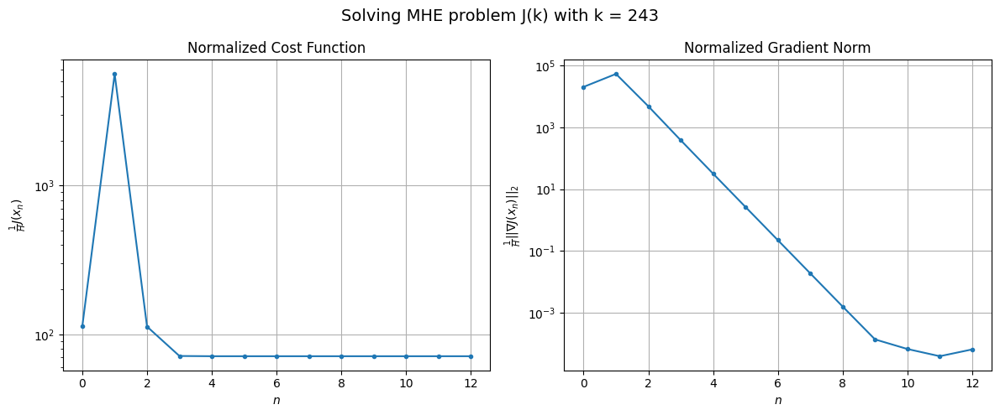

Windows:  61%|██████    | 235/386 [13:12<08:49,  3.50s/it]

[Gauss-Newton] Before applying the algorithm
Cost function: 1043.8362071277434
Gradient norm: 192871.12460450822
Global estimation error: 3969.9747024335766
Initial conditions estimation errors: 0.6276496047092885 m, 694.5817203741295 m, 53.102598290273264 m, 3908.379983189391 m
Position estimation errors: 3.193078343660731 m, 682.4562944221057 m, 120.29050380752302 m, 3682.918793165898 m



/home/jgaspar/SpaceSim-Toolkit/test/new_newton_based_algorithms/gauss_newton.py:181: LinAlgWarning: Ill-conditioned matrix (rcond=1.09792e-16): result may not be accurate.
  delta_x = solve(HJ_x, -DJ_x)


[Gauss-Newton] Iteration 1
Cost function: 14559893.27880354 (1394744.63%)
Gradient norm: 8889755.8711779 (4509.17%)
Global estimation error: 5018.141565849739 (26.40%)
Initial conditions estimation errors: 1.8478890992112642 m, 892.9119726674157 m, 80.88217369085577 m, 4937.398232660418 m
Position estimation errors: 1.7350283932270167 m, 1030.600933313985 m, 253.69076779617058 m, 5248.664924078273 m

[Gauss-Newton] Iteration 2
Cost function: 6218607.25754948 (-57.29%)
Gradient norm: 5890357.643687897 (-33.74%)
Global estimation error: 2290.157879279907 (-54.36%)
Initial conditions estimation errors: 1.8478890984241416 m, 396.38725291181026 m, 30.438685313845053 m, 2255.386800593466 m
Position estimation errors: 1.735028392487856 m, 421.3788282121992 m, 89.10350854439852 m, 2261.6053427876636 m



/home/jgaspar/SpaceSim-Toolkit/test/new_newton_based_algorithms/gauss_newton.py:181: LinAlgWarning: Ill-conditioned matrix (rcond=7.28765e-17): result may not be accurate.
  delta_x = solve(HJ_x, -DJ_x)


[Gauss-Newton] STOP on Iteration 3 (gradient norm stagnated)
Cost function = 4939725.462610415 (-20.57%)
Gradient norm = 5259495.2680729795 (-10.71%)
Global estimation error = 4509.597068206179 (96.91%)
Final initial conditions estimation errors: 1.8478890551777627 m, 802.2431147954231 m, 75.5200121767383 m, 4437.021463991389 m
Final position estimation errors: 1.7350284366278597 m, 944.476394465071 m, 232.26283210526435 m, 4780.174051454813 m



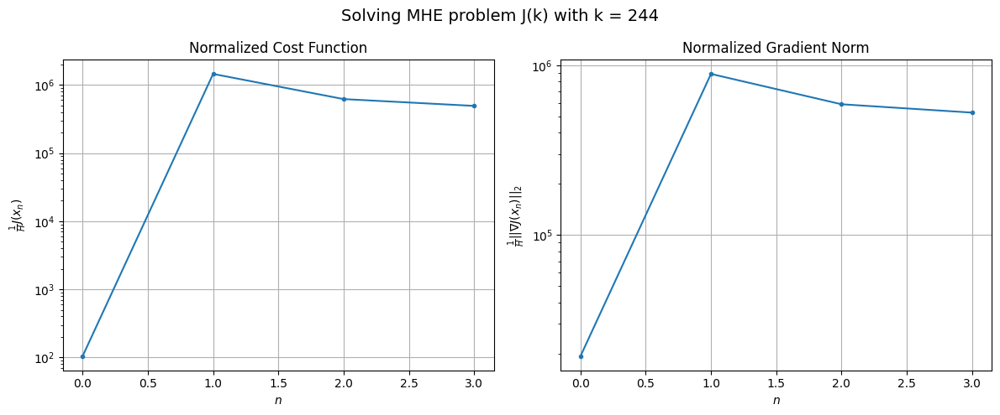

Windows:  61%|██████    | 236/386 [13:13<07:29,  3.00s/it]

[Gauss-Newton] Before applying the algorithm
Cost function: 4981222.399744785
Gradient norm: 5218425.575666753
Global estimation error: 4633.461743194099
Initial conditions estimation errors: 0.6300357816001759 m, 834.0672869077401 m, 77.75887142818512 m, 4557.109665375475 m
Position estimation errors: 3.3448020299464076 m, 938.6743332165153 m, 253.9915914383054 m, 4713.181738182988 m

[Gauss-Newton] Iteration 1
Cost function: 152317.72644381432 (-96.94%)
Gradient norm: 857097.5031409448 (-83.58%)
Global estimation error: 1543.903907877302 (-66.68%)
Initial conditions estimation errors: 1.824705310448112 m, 313.1631392982028 m, 39.71095947558193 m, 1511.285991475554 m
Position estimation errors: 1.8938869692174367 m, 406.1469911417374 m, 160.35881254367126 m, 2002.0145664061072 m

[Gauss-Newton] Iteration 2
Cost function: 643.3629048651476 (-99.58%)
Gradient norm: 2038.9924561488745 (-99.76%)
Global estimation error: 1663.8311724529035 (7.77%)
Initial conditions estimation errors: 1.82

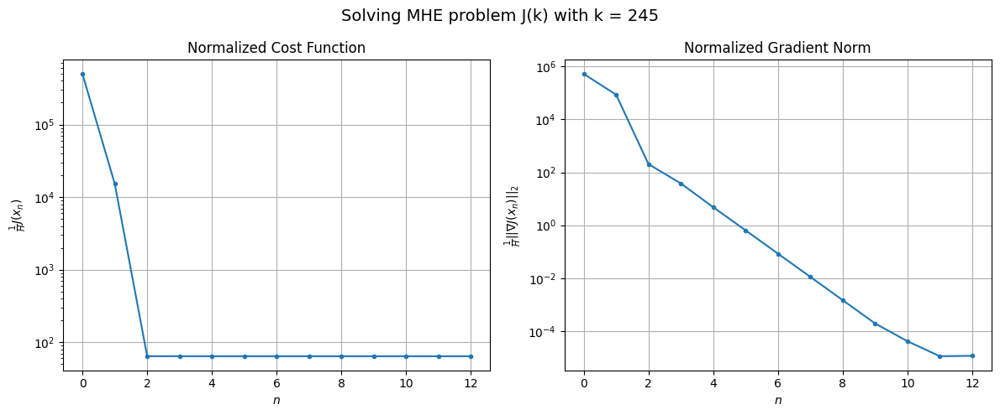

Windows:  61%|██████▏   | 237/386 [13:18<08:35,  3.46s/it]

[Gauss-Newton] Before applying the algorithm
Cost function: 1199.8842342641697
Gradient norm: 205868.09816964684
Global estimation error: 1711.8491063380914
Initial conditions estimation errors: 0.6292448287284887 m, 344.53531955680154 m, 52.21694542000195 m, 1676.00523799874 m
Position estimation errors: 3.682584899313338 m, 423.59072706182434 m, 175.07197500796624 m, 2101.434686539032 m

[Gauss-Newton] Iteration 1
Cost function: 1233360.0350974428 (102689.92%)
Gradient norm: 2562977.7591702943 (1144.96%)
Global estimation error: 6593.282261212932 (285.16%)
Initial conditions estimation errors: 1.8162806098265574 m, 1189.1742099958815 m, 134.17420088282844 m, 6483.765867215438 m
Position estimation errors: 2.125702102229425 m, 1353.2503015436353 m, 400.9716656246721 m, 6840.099752798812 m

[Gauss-Newton] Iteration 2
Cost function: 17096.42418215648 (-98.61%)
Gradient norm: 304253.86638575356 (-88.13%)
Global estimation error: 4979.1629692586 (-24.48%)
Initial conditions estimation err

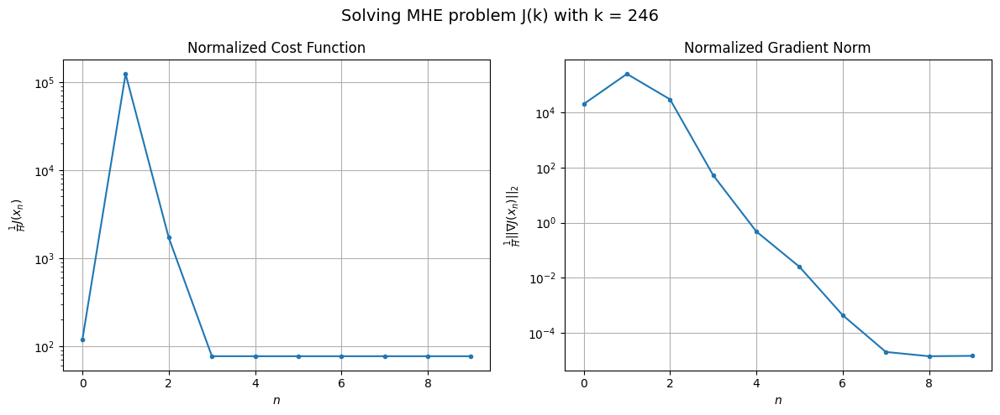

Windows:  62%|██████▏   | 238/386 [13:22<08:40,  3.51s/it]

[Gauss-Newton] Before applying the algorithm
Cost function: 1377.4373084450488
Gradient norm: 218310.81053596333
Global estimation error: 5158.773812264422
Initial conditions estimation errors: 0.6469175156964786 m, 934.8838424769518 m, 117.64492467224967 m, 5071.991184757488 m
Position estimation errors: 4.070350779845458 m, 1012.7314084836266 m, 307.94563771184164 m, 5139.995835639439 m

[Gauss-Newton] Iteration 1
Cost function: 57004.27415738056 (4038.43%)
Gradient norm: 538454.7259678206 (146.65%)
Global estimation error: 2875.0923565507046 (-44.27%)
Initial conditions estimation errors: 1.975851783286952 m, 548.3161225920982 m, 66.70768215068078 m, 2821.533202097882 m
Position estimation errors: 2.3606511841074393 m, 574.3712731595471 m, 163.42108792903363 m, 3021.58125928021 m

[Gauss-Newton] Iteration 2
Cost function: 1606.150379572456 (-97.18%)
Gradient norm: 64662.8109130647 (-87.99%)
Global estimation error: 2137.759380041875 (-25.65%)
Initial conditions estimation errors: 1.

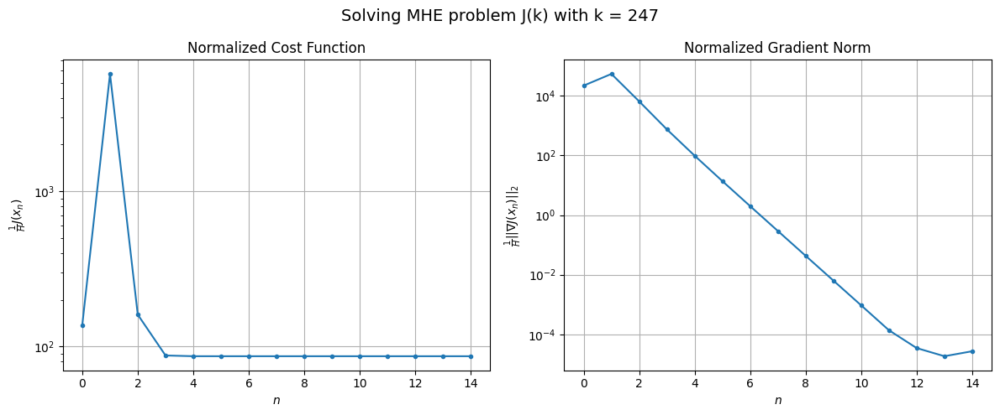

Windows:  62%|██████▏   | 239/386 [13:27<09:52,  4.03s/it]

[Gauss-Newton] Before applying the algorithm
Cost function: 1652.8306930550166
Gradient norm: 236769.17778760474
Global estimation error: 1795.5101068712238
Initial conditions estimation errors: 0.7394624385880837 m, 346.8550514995674 m, 38.74087353307039 m, 1761.2626511741971 m
Position estimation errors: 4.41022967817458 m, 316.89111328915186 m, 81.08842227271599 m, 1823.5983797999297 m

[Gauss-Newton] Iteration 1
Cost function: 3455.3259704497054 (109.06%)
Gradient norm: 112659.75979849767 (-52.42%)
Global estimation error: 2821.280191612133 (57.13%)
Initial conditions estimation errors: 2.131229415079206 m, 519.8382467665721 m, 70.31993353214396 m, 2772.0821733578837 m
Position estimation errors: 2.557769119794607 m, 577.333368280751 m, 237.42252110461712 m, 2751.608606583642 m

[Gauss-Newton] Iteration 2
Cost function: 1094.703053264764 (-68.32%)
Gradient norm: 13531.049276918338 (-87.99%)
Global estimation error: 3129.357563350091 (10.92%)
Initial conditions estimation errors: 2.

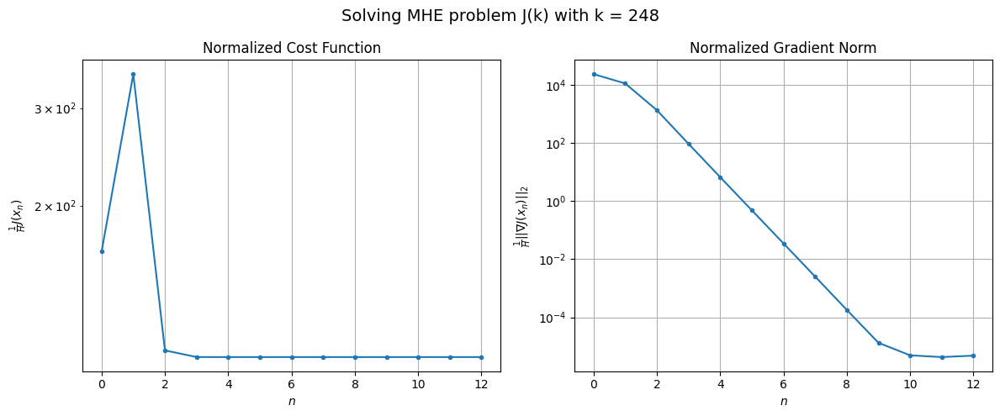

Windows:  62%|██████▏   | 240/386 [13:31<09:51,  4.05s/it]

[Gauss-Newton] Before applying the algorithm
Cost function: 1902.6549513728326
Gradient norm: 248982.5106258568
Global estimation error: 3313.5776138464635
Initial conditions estimation errors: 0.7848415992582825 m, 623.8526058195821 m, 108.54393922638891 m, 3252.5099341534465 m
Position estimation errors: 4.676128996556895 m, 675.0914521251199 m, 304.23354518100035 m, 3164.1472310324707 m

[Gauss-Newton] Iteration 1
Cost function: 7647497.682587823 (401838.23%)
Gradient norm: 6581856.294901437 (2543.50%)
Global estimation error: 4148.878258458999 (25.21%)
Initial conditions estimation errors: 2.3051742006626093 m, 786.2120960924788 m, 169.40578489822568 m, 4070.1783836801555 m
Position estimation errors: 2.683630635179463 m, 1020.9389169991772 m, 471.0181382909213 m, 4476.801268403961 m

[Gauss-Newton] Iteration 2
Cost function: 1264625.2165801774 (-83.46%)
Gradient norm: 2729782.7118683984 (-58.53%)
Global estimation error: 584.6923895190795 (-85.91%)
Initial conditions estimation er

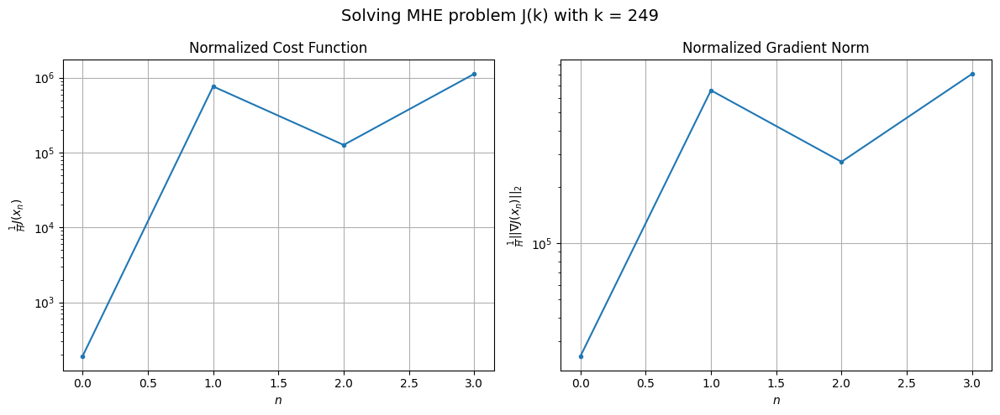

Windows:  62%|██████▏   | 241/386 [13:33<08:24,  3.48s/it]

[Gauss-Newton] Before applying the algorithm
Cost function: 11526765.498423034
Gradient norm: 8085780.389747214
Global estimation error: 7784.068431988373
Initial conditions estimation errors: 0.8403552151288108 m, 1508.4752675432478 m, 371.7688103048156 m, 7627.450395513091 m
Position estimation errors: 4.835150415800079 m, 1787.7780060222997 m, 864.2434125263334 m, 7827.650854545536 m

[Gauss-Newton] Iteration 1
Cost function: 2639193.2094240477 (-77.10%)
Gradient norm: 3835803.5170465303 (-52.56%)
Global estimation error: 1997.3098213816222 (-74.34%)
Initial conditions estimation errors: 2.503471064733289 m, 403.35070265248044 m, 104.52177942971566 m, 1953.3619396225647 m
Position estimation errors: 2.6977391264423676 m, 466.13079315137094 m, 223.2871714060533 m, 2034.8461243736808 m

[Gauss-Newton] Iteration 2
Cost function: 5033.764196515909 (-99.81%)
Gradient norm: 138634.40483548073 (-96.39%)
Global estimation error: 3098.7439721169917 (55.15%)
Initial conditions estimation erro

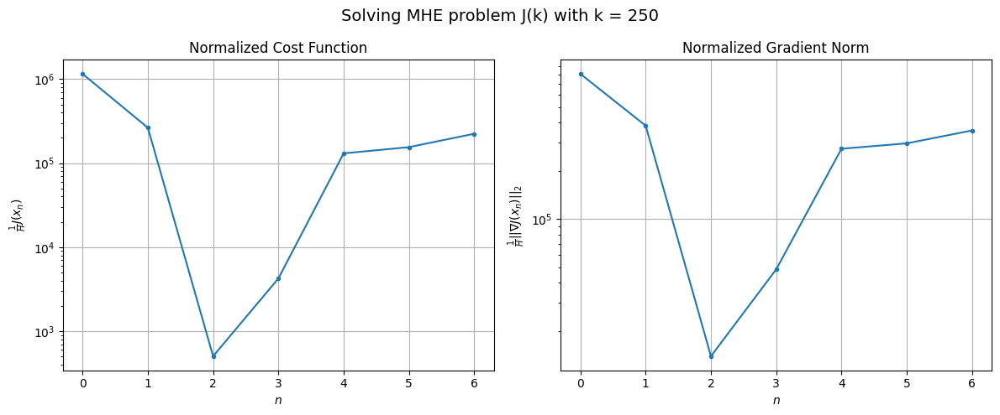

Windows:  63%|██████▎   | 242/386 [13:36<07:46,  3.24s/it]

[Gauss-Newton] Before applying the algorithm
Cost function: 2286052.9061014834
Gradient norm: 3620904.8423595573
Global estimation error: 6415.922472531146
Initial conditions estimation errors: 0.9426779700328883 m, 1282.7026284156102 m, 363.3538553051695 m, 6275.882537623734 m
Position estimation errors: 4.854266982739389 m, 1469.4681597411297 m, 767.9192772629742 m, 6329.395030501347 m

[Gauss-Newton] Iteration 1
Cost function: 3526087.567828938 (54.24%)
Gradient norm: 4264526.257653181 (17.78%)
Global estimation error: 525.1019971624324 (-91.82%)
Initial conditions estimation errors: 2.686980806141836 m, 102.5801223926597 m, 32.64113247533638 m, 513.9413957369384 m
Position estimation errors: 2.6607514514618624 m, 171.94697842905185 m, 107.15260014923585 m, 640.6039314533282 m



/home/jgaspar/SpaceSim-Toolkit/test/new_newton_based_algorithms/gauss_newton.py:181: LinAlgWarning: Ill-conditioned matrix (rcond=9.57667e-17): result may not be accurate.
  delta_x = solve(HJ_x, -DJ_x)


[Gauss-Newton] Iteration 2
Cost function: 28882071.726871625 (719.10%)
Gradient norm: 13385044.033564793 (213.87%)
Global estimation error: 9713.735013603304 (1749.88%)
Initial conditions estimation errors: 2.686980727924126 m, 1860.0327899042097 m, 441.7045405126067 m, 9523.747964657176 m
Position estimation errors: 2.6607515340179266 m, 2549.9185705170826 m, 1437.9946817029552 m, 10744.784124717915 m

[Gauss-Newton] Iteration 3
Cost function: 4615835.136622461 (-84.02%)
Gradient norm: 5324176.195760793 (-60.22%)
Global estimation error: 3500.276371939055 (-63.97%)
Initial conditions estimation errors: 2.686980774966622 m, 657.9604715132923 m, 149.2872218051903 m, 3434.636169430788 m
Position estimation errors: 2.6607514905284506 m, 842.2485512544802 m, 453.73169561912573 m, 3620.8372452674244 m

[Gauss-Newton] Iteration 4
Cost function: 99473.53707943465 (-97.84%)
Gradient norm: 765859.7841986186 (-85.62%)
Global estimation error: 1061.8587650117593 (-69.66%)
Initial conditions estim

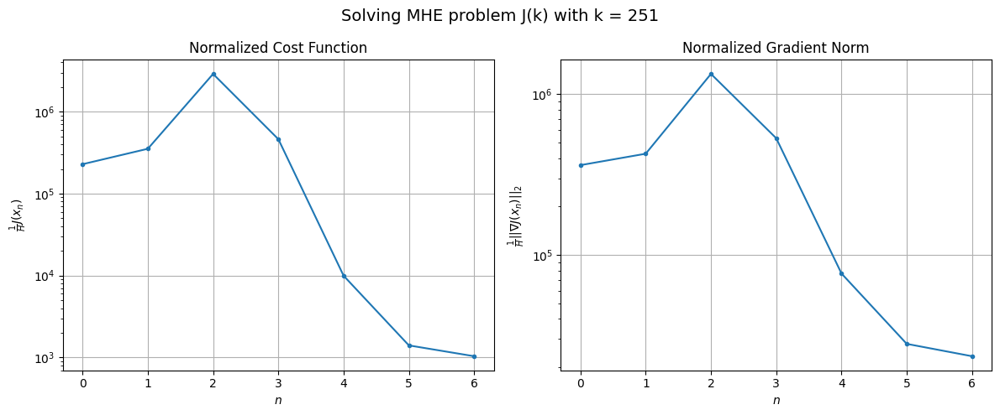

Windows:  63%|██████▎   | 243/386 [13:38<07:20,  3.08s/it]

[Gauss-Newton] Before applying the algorithm
Cost function: 11652.154257552553
Gradient norm: 392196.6091145793
Global estimation error: 1176.5644790510717
Initial conditions estimation errors: 1.0304085507225085 m, 211.733715036176 m, 48.723231008731844 m, 1156.3294132096348 m
Position estimation errors: 4.881757339548654 m, 236.81185543524057 m, 131.64912649032928 m, 1031.4559435301865 m

[Gauss-Newton] Iteration 1
Cost function: 755241.9631243323 (6381.57%)
Gradient norm: 2145847.089544518 (447.14%)
Global estimation error: 5084.032844622813 (332.11%)
Initial conditions estimation errors: 2.720727143519202 m, 988.4596891882564 m, 277.9168213590969 m, 4979.2653384384685 m
Position estimation errors: 2.7746051654069728 m, 1324.897411307176 m, 812.146482490975 m, 5408.1979398182175 m

[Gauss-Newton] Iteration 2
Cost function: 46414.38853846875 (-93.85%)
Gradient norm: 529170.2379332513 (-75.34%)
Global estimation error: 3180.912081292328 (-37.43%)
Initial conditions estimation errors: 

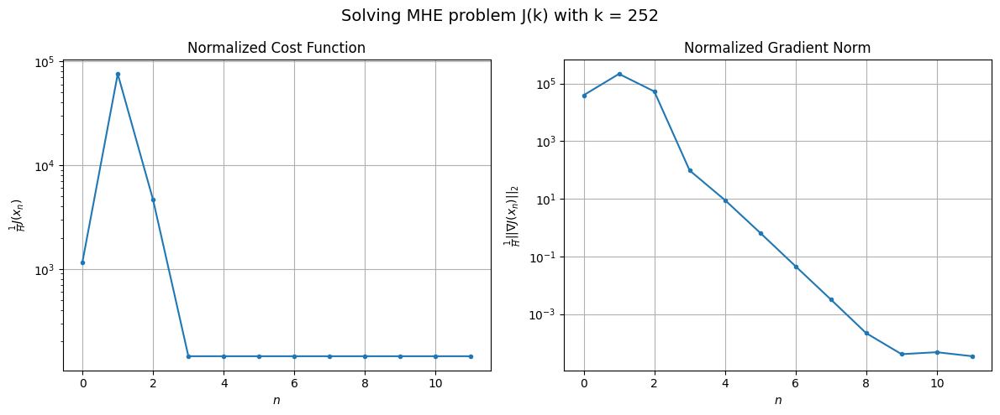

Windows:  63%|██████▎   | 244/386 [13:42<07:51,  3.32s/it]

[Gauss-Newton] Before applying the algorithm
Cost function: 2395.494579120758
Gradient norm: 285935.6218235315
Global estimation error: 3183.3395007709673
Initial conditions estimation errors: 1.0509598554351904 m, 630.165353394712 m, 205.79706184603629 m, 3113.5489085624995 m
Position estimation errors: 5.124558235911182 m, 766.1861049680657 m, 495.0622224766145 m, 3068.0519098004224 m

[Gauss-Newton] Iteration 1
Cost function: 3976.8293847023424 (66.01%)
Gradient norm: 114264.5305235714 (-60.04%)
Global estimation error: 4221.200523585185 (32.60%)
Initial conditions estimation errors: 2.8617141925236873 m, 855.6034889351499 m, 307.37784036904185 m, 4122.133525489591 m
Position estimation errors: 2.8675466964902636 m, 987.2111829493323 m, 613.0229027078186 m, 4028.9942858447835 m

[Gauss-Newton] STOP on Iteration 2 (gradient norm stagnated)
Cost function = 3141.598936652834 (-21.00%)
Gradient norm = 105958.7880658974 (-7.27%)
Global estimation error = 4961.291849472209 (17.53%)
Final 

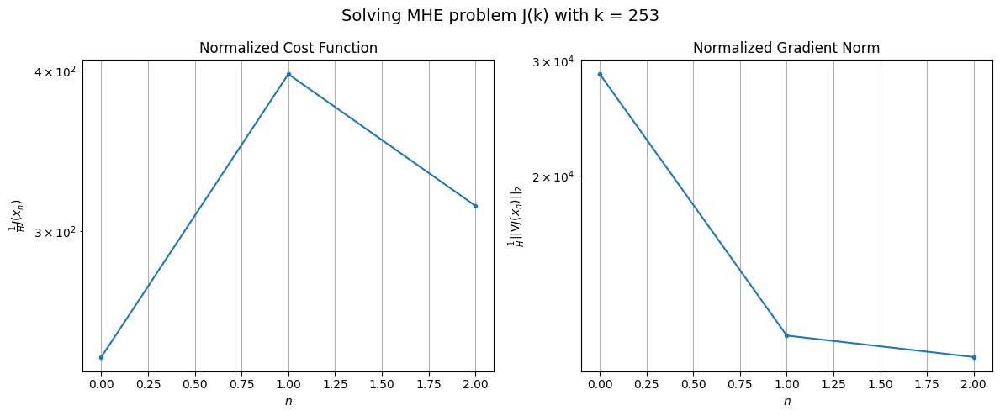

Windows:  63%|██████▎   | 245/386 [13:44<06:25,  2.74s/it]

[Gauss-Newton] Before applying the algorithm
Cost function: 4519.404423447508
Gradient norm: 342696.3299857808
Global estimation error: 5083.40802600508
Initial conditions estimation errors: 1.1624839968335103 m, 1047.999216170088 m, 401.29724514019404 m, 4957.992490371933 m
Position estimation errors: 5.4064580813474015 m, 1247.0313677702009 m, 822.6594970994355 m, 4948.991259388826 m

[Gauss-Newton] Iteration 1
Cost function: 365577.58696190704 (7989.07%)
Gradient norm: 1461585.4909939808 (326.50%)
Global estimation error: 1718.1390704809533 (-66.20%)
Initial conditions estimation errors: 2.8812606953506137 m, 367.1102112520077 m, 202.74704766881044 m, 1666.168425268445 m
Position estimation errors: 3.1640134785282914 m, 369.5063998416529 m, 241.20253340592927 m, 1446.1803683706974 m

[Gauss-Newton] Iteration 2
Cost function: 1637294.6560385597 (347.87%)
Gradient norm: 3333471.1000686637 (128.07%)
Global estimation error: 2450.9701064849396 (42.65%)
Initial conditions estimation erro

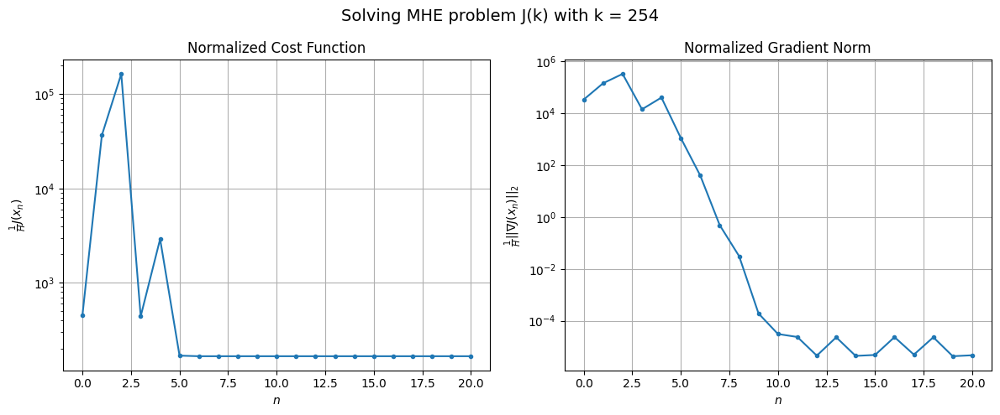

Windows:  64%|██████▎   | 246/386 [13:50<08:55,  3.83s/it]

[Gauss-Newton] Before applying the algorithm
Cost function: 2999.3366633852547
Gradient norm: 337950.8179768105
Global estimation error: 141.95087990066853
Initial conditions estimation errors: 1.1784396815261045 m, 43.25555647553499 m, 131.11015248470676 m, 32.946123866748565 m
Position estimation errors: 5.963170700565314 m, 182.79366745245167 m, 132.82514479047188 m, 724.3763672398128 m

[Gauss-Newton] Iteration 1
Cost function: 1285979.4231074846 (42775.46%)
Gradient norm: 2631028.996106759 (678.52%)
Global estimation error: 4898.608203006552 (3350.92%)
Initial conditions estimation errors: 3.0334049475896316 m, 1011.5827677755705 m, 358.2097791043453 m, 4779.616080552148 m
Position estimation errors: 3.4830800907090818 m, 1366.6722826147932 m, 964.2001467421594 m, 5256.834326884667 m

[Gauss-Newton] Iteration 2
Cost function: 7146.997589815892 (-99.44%)
Gradient norm: 163070.9433057207 (-93.80%)
Global estimation error: 6130.703040484325 (25.15%)
Initial conditions estimation erro

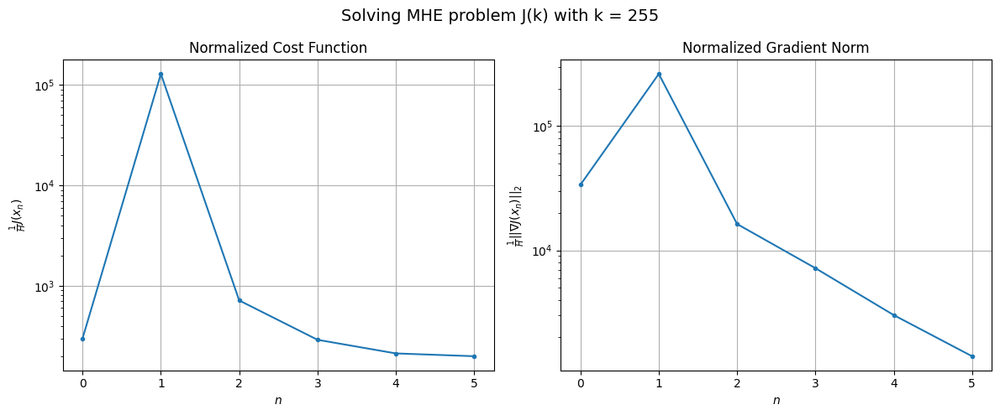

Windows:  64%|██████▍   | 247/386 [13:52<07:45,  3.35s/it]

[Gauss-Newton] Before applying the algorithm
Cost function: 3682.529558691677
Gradient norm: 385517.9454454813
Global estimation error: 5656.504689817762
Initial conditions estimation errors: 1.2688582183552974 m, 1210.0340835974214 m, 511.8549008837922 m, 5501.805011803629 m
Position estimation errors: 6.55271906427025 m, 1498.5422907361553 m, 1102.4758911693843 m, 5646.214590428519 m

[Gauss-Newton] Iteration 1
Cost function: 2826.355781884933 (-23.25%)
Gradient norm: 29065.152569813647 (-92.46%)
Global estimation error: 4811.483747018842 (-14.94%)
Initial conditions estimation errors: 3.2682855478484627 m, 1006.0289232026983 m, 393.2206225135184 m, 4688.671122152384 m
Position estimation errors: 3.816875942999915 m, 1418.1097271885812 m, 1042.055939890872 m, 5345.5243992280975 m

[Gauss-Newton] Iteration 2
Cost function: 2414.052910144599 (-14.59%)
Gradient norm: 9650.649758558478 (-66.80%)
Global estimation error: 5086.6608026918175 (5.72%)
Initial conditions estimation errors: 3.2

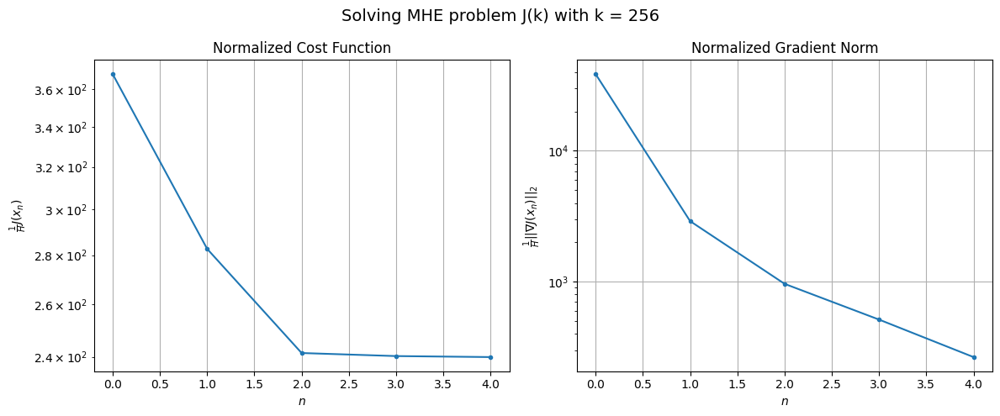

Windows:  64%|██████▍   | 248/386 [13:54<06:44,  2.93s/it]

[Gauss-Newton] Before applying the algorithm
Cost function: 4397.701512498026
Gradient norm: 430705.42459295964
Global estimation error: 5208.703074225304
Initial conditions estimation errors: 1.3627494425245252 m, 1120.1025034069485 m, 498.59116758261524 m, 5062.346576387186 m
Position estimation errors: 7.133843904302574 m, 1495.2941416460549 m, 1141.1889516151086 m, 5526.2644436218825 m

[Gauss-Newton] Iteration 1
Cost function: 1856953.446240634 (42125.55%)
Gradient norm: 3201708.6614710805 (643.36%)
Global estimation error: 355.75654935198224 (-93.17%)
Initial conditions estimation errors: 3.6076904216464665 m, 78.60516676306513 m, 83.4336998590233 m, 336.7612679759278 m
Position estimation errors: 4.095594640218451 m, 173.4765326270417 m, 126.28818415881966 m, 681.7970347109648 m

[Gauss-Newton] Iteration 2
Cost function: 79571.00917520383 (-95.71%)
Gradient norm: 592107.028994155 (-81.51%)
Global estimation error: 2543.520107564249 (614.96%)
Initial conditions estimation errors:

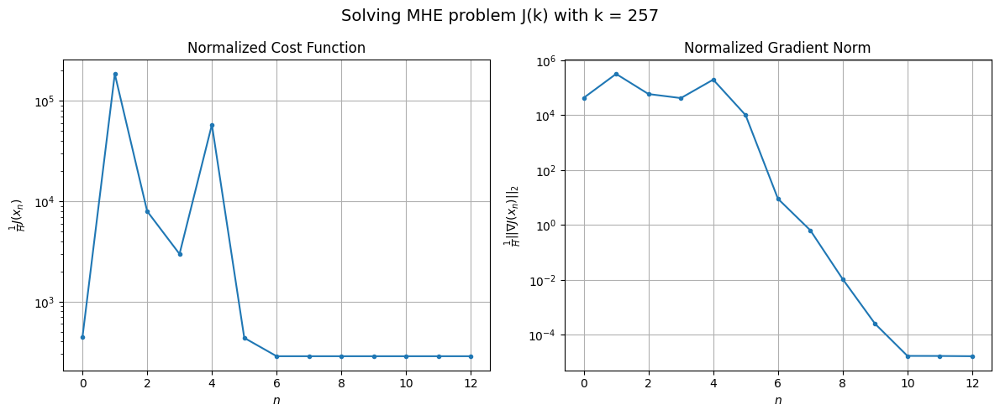

Windows:  65%|██████▍   | 249/386 [13:59<07:35,  3.33s/it]

[Gauss-Newton] Before applying the algorithm
Cost function: 5037.833983334903
Gradient norm: 460479.9376158081
Global estimation error: 1633.8033619825871
Initial conditions estimation errors: 1.482110638650433 m, 320.3597609106179 m, 106.22107290296819 m, 1598.558038266296 m
Position estimation errors: 7.601945525340939 m, 799.842351213635 m, 666.7173749319854 m, 2723.389765528189 m

[Gauss-Newton] Iteration 1
Cost function: 3349.4197196896057 (-33.51%)
Gradient norm: 11560.423001011295 (-97.49%)
Global estimation error: 2019.8739428904435 (23.63%)
Initial conditions estimation errors: 3.8839393856688313 m, 426.4416478483731 m, 188.42598341117804 m, 1965.3267802245525 m
Position estimation errors: 4.366948007076432 m, 872.2389967951228 m, 730.7217983923017 m, 2975.5785696890225 m

[Gauss-Newton] Iteration 2
Cost function: 3324.7664784342314 (-0.74%)
Gradient norm: 8529.83897073763 (-26.22%)
Global estimation error: 2223.644031176424 (10.09%)
Initial conditions estimation errors: 3.883

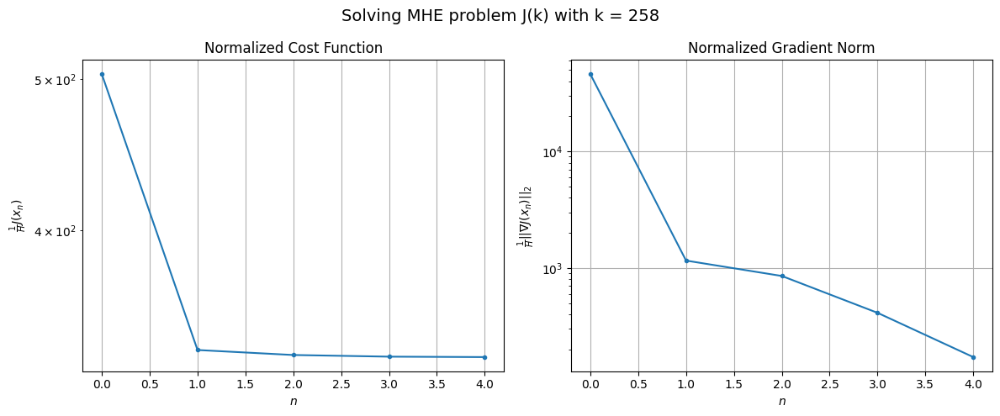

Windows:  65%|██████▍   | 250/386 [14:00<06:35,  2.91s/it]

[Gauss-Newton] Before applying the algorithm
Cost function: 5709.335659126118
Gradient norm: 497443.53508921317
Global estimation error: 2353.4543794827196
Initial conditions estimation errors: 1.5219353739018058 m, 524.569750451682 m, 274.3552229942905 m, 2277.782095531068 m
Position estimation errors: 7.9883243605956 m, 967.783838485151 m, 833.5454287647515 m, 3239.5434353437918 m

[Gauss-Newton] Iteration 1
Cost function: 53067.69386414279 (829.49%)
Gradient norm: 585390.3160294048 (17.68%)
Global estimation error: 724.9529336848675 (-69.20%)
Initial conditions estimation errors: 4.202078176672466 m, 194.865865306943 m, 152.60567727327708 m, 681.378909502772 m
Position estimation errors: 4.480180652198908 m, 290.99462505114633 m, 276.0667095597252 m, 927.3326455729615 m

[Gauss-Newton] STOP on Iteration 2 (gradient norm stagnated)
Cost function = 5837.9453446540465 (-89.00%)
Gradient norm = 123265.456752834 (-78.94%)
Global estimation error = 1465.7029225382917 (102.18%)
Final initi

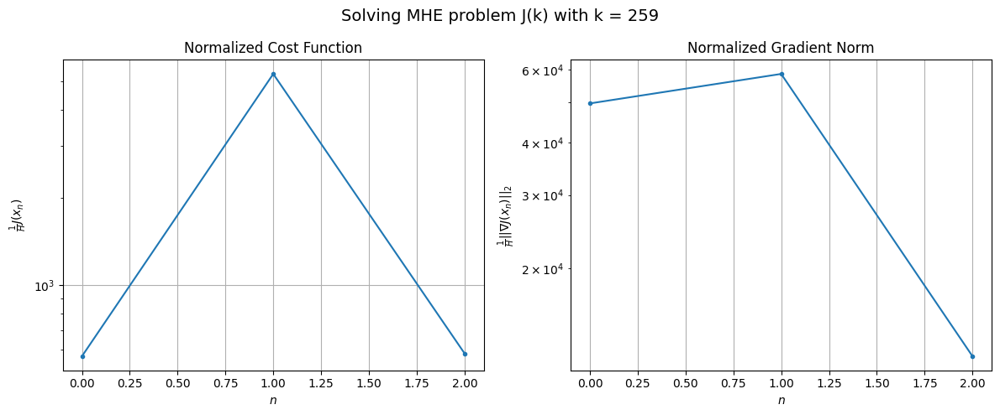

Windows:  65%|██████▌   | 251/386 [14:02<05:31,  2.46s/it]

[Gauss-Newton] Before applying the algorithm
Cost function: 8600.806489937024
Gradient norm: 528776.13919561
Global estimation error: 1570.3890058242791
Initial conditions estimation errors: 1.5959279545841607 m, 396.83182924818357 m, 278.02615733811297 m, 1493.7677070732375 m
Position estimation errors: 8.106956918211397 m, 620.8070053326593 m, 573.1753498587902 m, 2000.661201040142 m

[Gauss-Newton] Iteration 1
Cost function: 3926.281470829589 (-54.35%)
Gradient norm: 28556.379840574195 (-94.60%)
Global estimation error: 1790.885962714656 (14.04%)
Initial conditions estimation errors: 4.415193520460367 m, 406.91301470112137 m, 232.00033251736386 m, 1728.5380626353258 m
Position estimation errors: 4.5040320294726275 m, 788.9934103806958 m, 692.6155736605634 m, 2567.9411714892485 m

[Gauss-Newton] Iteration 2
Cost function: 3952.528604927434 (0.67%)
Gradient norm: 31478.22909708187 (10.23%)
Global estimation error: 1474.278147073267 (-17.68%)
Initial conditions estimation errors: 4.415

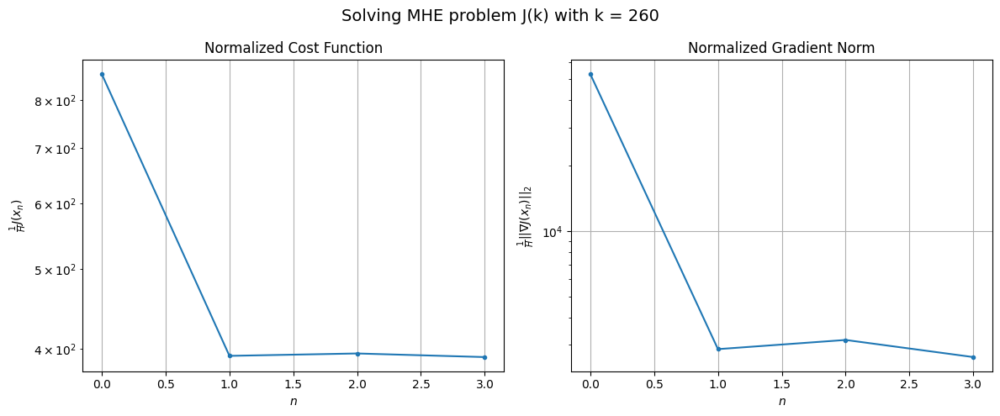

Windows:  65%|██████▌   | 252/386 [14:04<05:05,  2.28s/it]

[Gauss-Newton] Before applying the algorithm
Cost function: 6279.214747336541
Gradient norm: 507564.6347892566
Global estimation error: 1926.7306869210865
Initial conditions estimation errors: 1.6195733374647743 m, 462.65143918831427 m, 298.4410963649704 m, 1846.3936452424625 m
Position estimation errors: 8.004704987823706 m, 798.1061629529827 m, 718.0876335160344 m, 2545.371699551076 m

[Gauss-Newton] Iteration 1
Cost function: 3978.61316179862 (-36.64%)
Gradient norm: 18840.016188421767 (-96.29%)
Global estimation error: 1733.241758798307 (-10.04%)
Initial conditions estimation errors: 4.471952168733739 m, 418.0943588598043 m, 270.31307010575944 m, 1660.1903237312865 m
Position estimation errors: 4.389408288855669 m, 657.4599961351531 m, 583.2602097387238 m, 2116.52454461104 m

[Gauss-Newton] Iteration 2
Cost function: 3931.6383946057813 (-1.18%)
Gradient norm: 882.1833380831122 (-95.32%)
Global estimation error: 1794.925883490367 (3.56%)
Initial conditions estimation errors: 4.47195

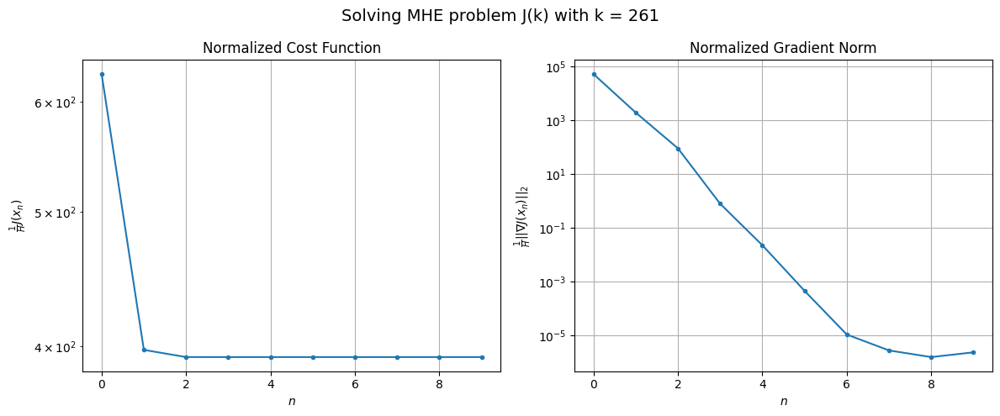

Windows:  66%|██████▌   | 253/386 [14:07<05:44,  2.59s/it]

[Gauss-Newton] Before applying the algorithm
Cost function: 6051.991421663605
Gradient norm: 483834.5215017931
Global estimation error: 1890.951848112879
Initial conditions estimation errors: 1.6081255889498955 m, 468.7890292020986 m, 320.76552541906665 m, 1803.6185175486837 m
Position estimation errors: 7.599520741638484 m, 696.7510546437529 m, 632.4685367518952 m, 2204.5059366485716 m

[Gauss-Newton] Iteration 1
Cost function: 57556.18309906245 (851.03%)
Gradient norm: 621869.0013436499 (28.53%)
Global estimation error: 452.83419188358897 (-76.05%)
Initial conditions estimation errors: 4.422692864631229 m, 164.35285727715467 m, 213.3716183803311 m, 364.00365146786856 m
Position estimation errors: 4.1086071345669435 m, 50.61171224643306 m, 40.453042864715165 m, 212.6406942187078 m

[Gauss-Newton] Iteration 2
Cost function: 4827.035194215458 (-91.61%)
Gradient norm: 79006.69266866679 (-87.30%)
Global estimation error: 1023.0430403168582 (125.92%)
Initial conditions estimation errors: 4

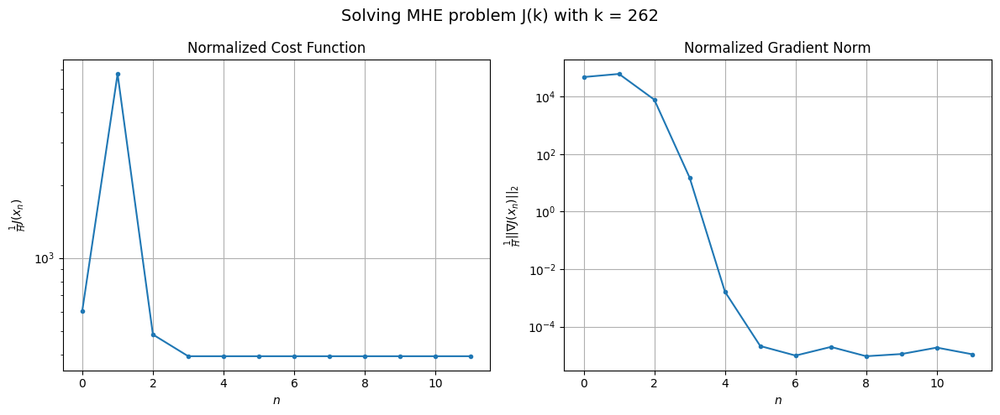

Windows:  66%|██████▌   | 254/386 [14:11<06:30,  2.96s/it]

[Gauss-Newton] Before applying the algorithm
Cost function: 5350.036984013339
Gradient norm: 418094.36412431946
Global estimation error: 1037.720601444895
Initial conditions estimation errors: 1.571849128206121 m, 311.2046554413629 m, 302.9645640745403 m, 942.4572007604133 m
Position estimation errors: 6.923748715410794 m, 215.09289272642502 m, 213.92573442007966 m, 606.9036807058753 m

[Gauss-Newton] Iteration 1
Cost function: 3729.9673918290764 (-30.28%)
Gradient norm: 35877.49740946409 (-91.42%)
Global estimation error: 682.4602120264381 (-34.23%)
Initial conditions estimation errors: 4.251852147948986 m, 213.93693840458616 m, 212.7125638671522 m, 612.141529774612 m
Position estimation errors: 3.8289044318155936 m, 29.868713788724932 m, 31.834569994534114 m, 68.69699004650133 m

[Gauss-Newton] Iteration 2
Cost function: 3549.888001503122 (-4.83%)
Gradient norm: 1020.7529072135987 (-97.15%)
Global estimation error: 787.5920582971245 (15.40%)
Initial conditions estimation errors: 4.25

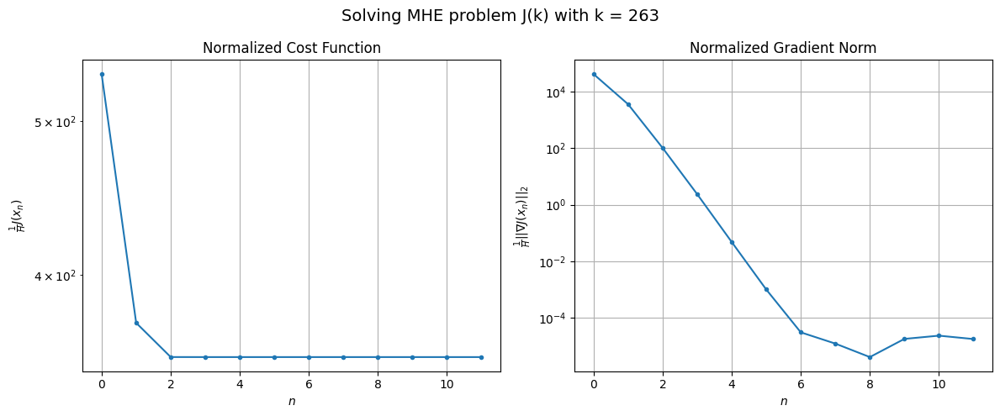

Windows:  66%|██████▌   | 255/386 [14:15<07:01,  3.22s/it]

[Gauss-Newton] Before applying the algorithm
Cost function: 4534.7468546861965
Gradient norm: 359804.1390105844
Global estimation error: 715.0164681946802
Initial conditions estimation errors: 1.4923811978151313 m, 222.92339242992927 m, 220.082018780535 m, 642.7396811182108 m
Position estimation errors: 6.284850834090297 m, 30.04803286573774 m, 33.323267755888416 m, 64.01250543441765 m

[Gauss-Newton] Iteration 1
Cost function: 3182.4037742998794 (-29.82%)
Gradient norm: 36443.444867593265 (-89.87%)
Global estimation error: 773.0834304079744 (8.12%)
Initial conditions estimation errors: 4.014383603626552 m, 183.711252875547 m, 112.09307836264547 m, 742.5140331905932 m
Position estimation errors: 3.5324926864296544 m, 213.95804968988745 m, 174.79003669800045 m, 721.9077821038669 m

[Gauss-Newton] Iteration 2
Cost function: 3045.9304795567605 (-4.29%)
Gradient norm: 16817.64839861976 (-53.85%)
Global estimation error: 1107.7956208986661 (43.30%)
Initial conditions estimation errors: 4.01

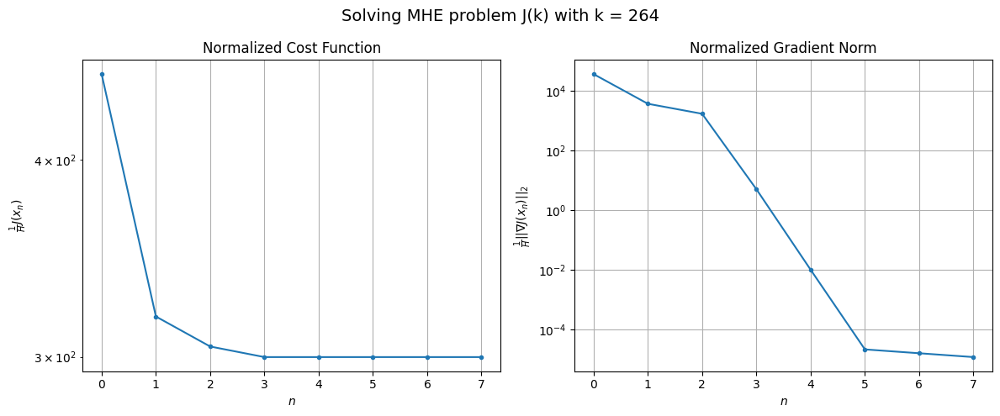

Windows:  66%|██████▋   | 256/386 [14:18<06:47,  3.13s/it]

[Gauss-Newton] Before applying the algorithm
Cost function: 3844.255278535822
Gradient norm: 318851.8756771939
Global estimation error: 1114.129472348704
Initial conditions estimation errors: 1.431130274400429 m, 281.74323124213487 m, 196.85708327021607 m, 1059.7878473122382 m
Position estimation errors: 5.732376614863545 m, 325.24279250809195 m, 294.97069170438056 m, 1022.0519658465053 m

[Gauss-Newton] Iteration 1
Cost function: 170726.05991041195 (4341.07%)
Gradient norm: 871493.8342157417 (173.32%)
Global estimation error: 1957.0067020598879 (75.65%)
Initial conditions estimation errors: 3.732712243523435 m, 624.1134788195164 m, 672.9499832270834 m, 1728.4332433080951 m
Position estimation errors: 3.244649445714217 m, 461.01455514541226 m, 592.112694355924 m, 1088.4436795579536 m

[Gauss-Newton] Iteration 2
Cost function: 3265.284136999371 (-98.09%)
Gradient norm: 61230.1720705079 (-92.97%)
Global estimation error: 2676.930479265982 (36.79%)
Initial conditions estimation errors: 3.

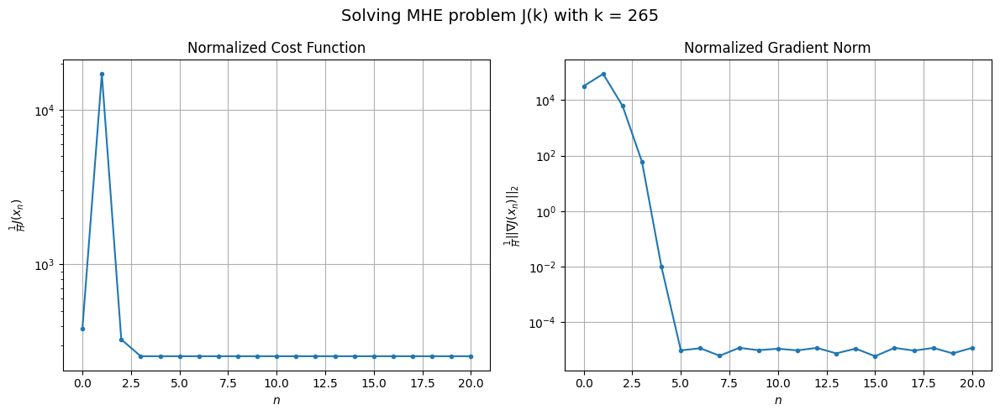

Windows:  67%|██████▋   | 257/386 [14:24<08:54,  4.14s/it]

[Gauss-Newton] Before applying the algorithm
Cost function: 3192.308314605637
Gradient norm: 279275.7170858176
Global estimation error: 2714.797812148452
Initial conditions estimation errors: 1.3809346231668052 m, 855.7205913519998 m, 911.5772208988345 m, 2409.7497498683 m
Position estimation errors: 5.335014297218555 m, 669.1665397842061 m, 838.6420875841171 m, 1610.2183391903993 m

[Gauss-Newton] Iteration 1
Cost function: 58250.40483515039 (1724.71%)
Gradient norm: 628340.1428839037 (124.99%)
Global estimation error: 4273.571803683805 (57.42%)
Initial conditions estimation errors: 3.4425926706629877 m, 1300.207014317102 m, 1318.0547785551846 m, 3851.700123269502 m
Position estimation errors: 3.119903399719025 m, 1484.3032424666903 m, 1719.7305964236068 m, 3793.633839726804 m

[Gauss-Newton] Iteration 2
Cost function: 243935.53956160464 (318.77%)
Gradient norm: 1137857.228373126 (81.09%)
Global estimation error: 7329.793599236073 (71.51%)
Initial conditions estimation errors: 3.44259

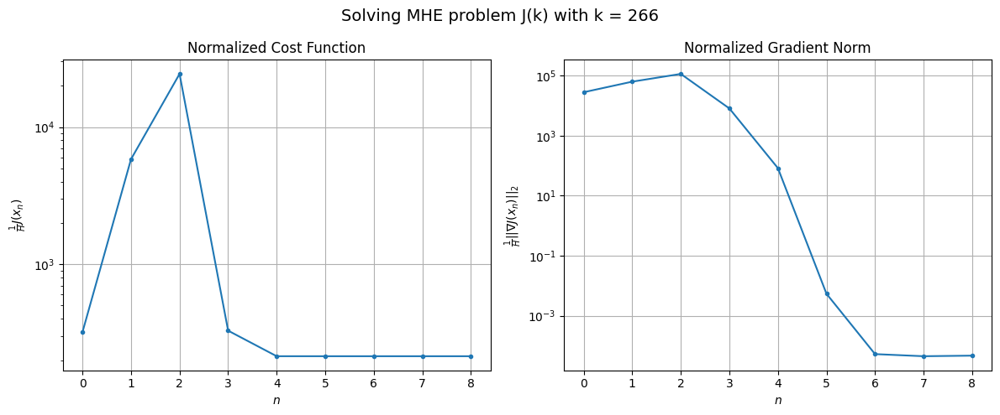

Windows:  67%|██████▋   | 258/386 [14:27<08:06,  3.80s/it]

[Gauss-Newton] Before applying the algorithm
Cost function: 2938.022735730558
Gradient norm: 281438.8844873802
Global estimation error: 8148.980192843953
Initial conditions estimation errors: 1.3468073288889746 m, 2501.198201746534 m, 2560.5170427255803 m, 7320.767002537616 m
Position estimation errors: 5.210680048289267 m, 2665.0910783940103 m, 3108.2629448043176 m, 6734.668325090967 m

[Gauss-Newton] Iteration 1
Cost function: 780366.7815884146 (26460.95%)
Gradient norm: 2181432.637960135 (675.10%)
Global estimation error: 11834.789859808916 (45.23%)
Initial conditions estimation errors: 3.202685279919438 m, 3617.9707508508445 m, 3678.8135059702995 m, 10650.766825817469 m
Position estimation errors: 3.0567101712161273 m, 4092.819789377161 m, 4748.479568316164 m, 10411.910385412255 m

[Gauss-Newton] Iteration 2
Cost function: 2521.4550113517757 (-99.68%)
Gradient norm: 53973.970215567526 (-97.53%)
Global estimation error: 11172.264583303542 (-5.60%)
Initial conditions estimation error

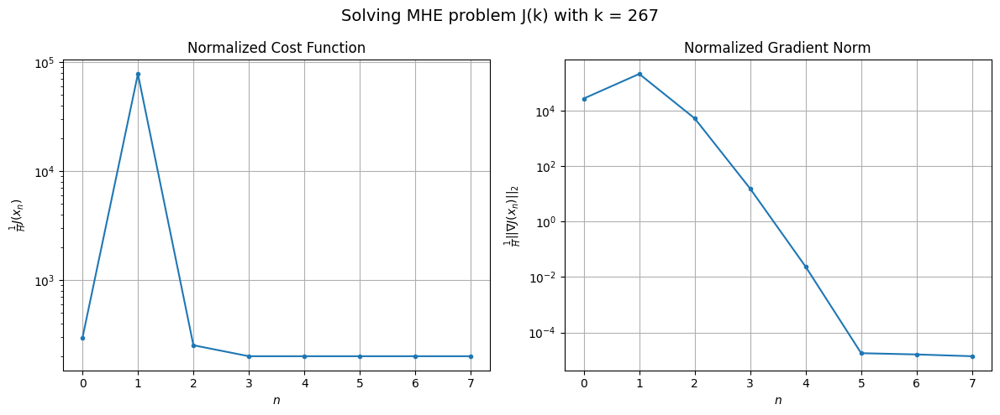

Windows:  67%|██████▋   | 259/386 [14:30<07:25,  3.51s/it]

[Gauss-Newton] Before applying the algorithm
Cost function: 2772.807903984575
Gradient norm: 289247.24575054605
Global estimation error: 11364.21374885925
Initial conditions estimation errors: 1.302879448415757 m, 3519.616778248302 m, 3648.25919355888 m, 10170.93105699364 m
Position estimation errors: 5.181990010432343 m, 3819.895000981472 m, 4491.528235164411 m, 9551.140277036398 m

[Gauss-Newton] Iteration 1
Cost function: 16159.545735019261 (482.79%)
Gradient norm: 285562.4368669586 (-1.27%)
Global estimation error: 9926.622423532663 (-12.65%)
Initial conditions estimation errors: 3.1347910987748695 m, 3113.2645947637016 m, 3290.3247996389555 m, 8832.845387559399 m
Position estimation errors: 3.0053308869700723 m, 3339.4146066406133 m, 3968.871262809934 m, 8241.173688957584 m

[Gauss-Newton] Iteration 2
Cost function: 1875.633586234546 (-88.39%)
Gradient norm: 10951.467616463584 (-96.16%)
Global estimation error: 9628.166081906696 (-3.01%)
Initial conditions estimation errors: 3.134

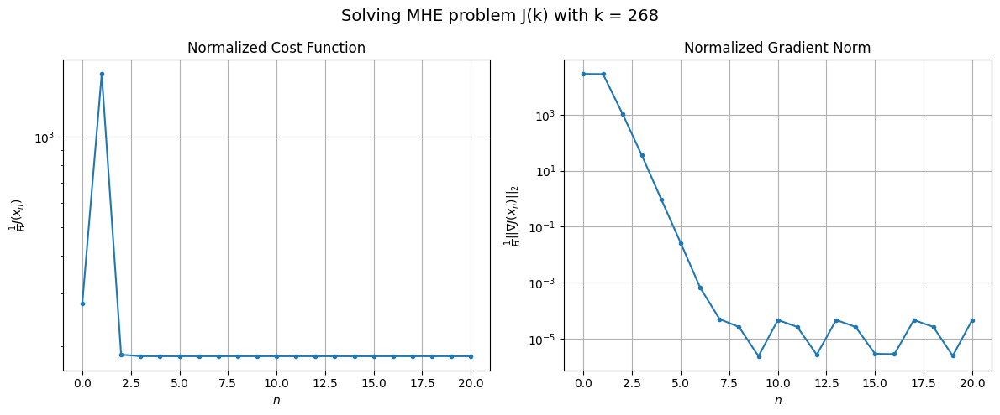

Windows:  67%|██████▋   | 260/386 [14:36<09:01,  4.30s/it]

[Gauss-Newton] Before applying the algorithm
Cost function: 2671.089982749222
Gradient norm: 295333.90403788484
Global estimation error: 9713.161954853553
Initial conditions estimation errors: 1.285179895154241 m, 3081.071507051708 m, 3310.3785212522503 m, 8596.156035813701 m
Position estimation errors: 5.137097578798015 m, 3174.513563979318 m, 3821.041544942578 m, 7699.144891445954 m

[Gauss-Newton] Iteration 1
Cost function: 19635.530936883417 (635.11%)
Gradient norm: 222208.79061982964 (-24.76%)
Global estimation error: 7780.668168269756 (-19.90%)
Initial conditions estimation errors: 3.099616636180061 m, 2459.4910126884174 m, 2643.056899002774 m, 6892.3093472133005 m
Position estimation errors: 2.915777411801372 m, 2831.2905121729536 m, 3395.644725501456 m, 6896.136108844551 m

[Gauss-Newton] Iteration 2
Cost function: 2061.5325558706836 (-89.50%)
Gradient norm: 44212.24424422718 (-80.10%)
Global estimation error: 7312.422422930967 (-6.02%)
Initial conditions estimation errors: 3.0

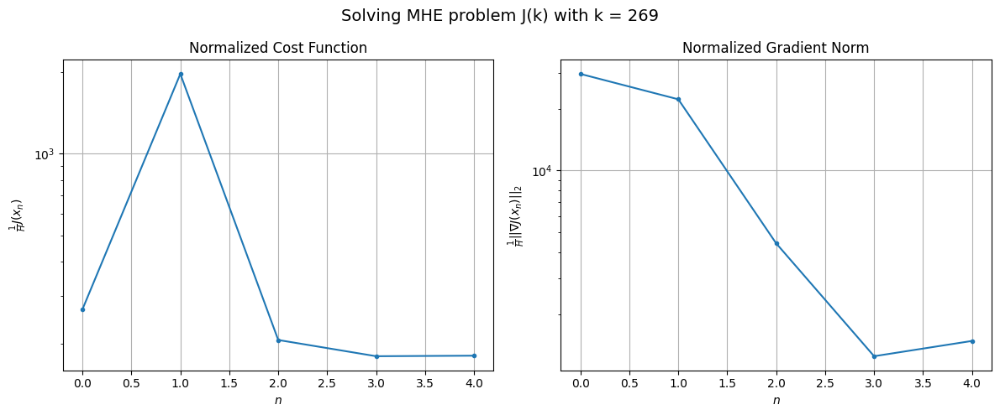

Windows:  68%|██████▊   | 261/386 [14:38<07:26,  3.57s/it]

[Gauss-Newton] Before applying the algorithm
Cost function: 2632.457350731826
Gradient norm: 305680.61897842464
Global estimation error: 6811.639992212697
Initial conditions estimation errors: 1.2024868999300005 m, 2176.7375995241473 m, 2376.065538187972 m, 6001.212992346956 m
Position estimation errors: 5.0394216006343555 m, 2375.87964016528 m, 2877.021959934171 m, 5700.0562473044965 m

[Gauss-Newton] Iteration 1
Cost function: 91463.05643869207 (3374.44%)
Gradient norm: 729799.2908617381 (138.75%)
Global estimation error: 4631.6565707944 (-32.00%)
Initial conditions estimation errors: 3.0936757606595524 m, 1498.6066314675334 m, 1647.3341723768874 m, 4061.1204720582464 m
Position estimation errors: 2.7314205971481207 m, 1545.2328969516323 m, 1901.2321142488615 m, 3656.7532506814528 m

[Gauss-Newton] Iteration 2
Cost function: 55994886.37123404 (61121.32%)
Gradient norm: 17472202.0036761 (2294.11%)
Global estimation error: 7095.5443054046 (53.20%)
Initial conditions estimation errors: 

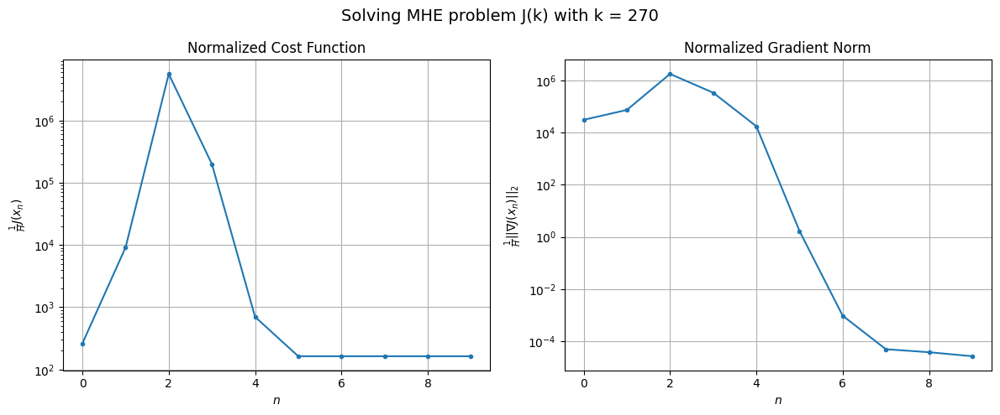

Windows:  68%|██████▊   | 262/386 [14:41<07:15,  3.52s/it]

[Gauss-Newton] Before applying the algorithm
Cost function: 2485.684729194246
Gradient norm: 311888.2138377643
Global estimation error: 661.0094936523769
Initial conditions estimation errors: 1.097838574767717 m, 244.55725322254355 m, 313.44871716446056 m, 528.0851786902497 m
Position estimation errors: 4.835351587911983 m, 249.16076790500168 m, 342.55228997651136 m, 441.8671406621145 m

[Gauss-Newton] Iteration 1
Cost function: 94351.30082598556 (3695.79%)
Gradient norm: 644459.6310316238 (106.63%)
Global estimation error: 1867.1812824567817 (182.47%)
Initial conditions estimation errors: 2.9885603697730367 m, 643.2233331096381 m, 766.412345594049 m, 1576.462042488037 m
Position estimation errors: 2.5136172987571563 m, 509.14438499169455 m, 710.0630172612011 m, 1058.9935138159929 m

[Gauss-Newton] Iteration 2
Cost function: 1531.8999671981576 (-98.38%)
Gradient norm: 1291.3295717718752 (-99.80%)
Global estimation error: 1710.8831389232776 (-8.37%)
Initial conditions estimation errors:

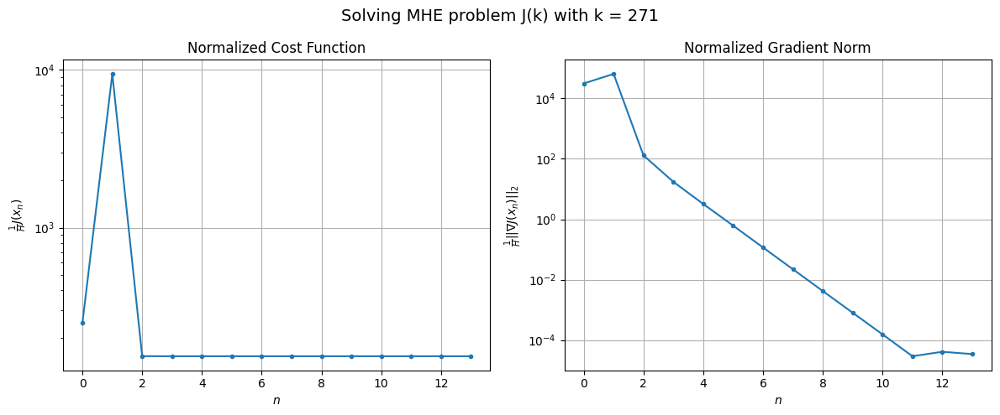

Windows:  68%|██████▊   | 263/386 [14:46<07:42,  3.76s/it]

[Gauss-Newton] Before applying the algorithm
Cost function: 2166.9077969528626
Gradient norm: 282480.53342539497
Global estimation error: 1715.6703127968094
Initial conditions estimation errors: 0.9575214735426484 m, 595.041595747213 m, 723.3112900228919 m, 1437.4525091824798 m
Position estimation errors: 4.57567662451128 m, 468.4785183064923 m, 663.9226109905915 m, 953.0319925963455 m

[Gauss-Newton] Iteration 1
Cost function: 8993.875934433856 (315.06%)
Gradient norm: 208493.60265755586 (-26.19%)
Global estimation error: 2876.2414623400887 (67.65%)
Initial conditions estimation errors: 2.731742375168486 m, 1020.969852883135 m, 1283.6414916694814 m, 2362.7615581842406 m
Position estimation errors: 2.4476100551047337 m, 950.4116758342169 m, 1329.7995141856984 m, 1871.4311929873434 m

[Gauss-Newton] Iteration 2
Cost function: 1706.3843016211567 (-81.03%)
Gradient norm: 43135.43939554015 (-79.31%)
Global estimation error: 2305.7155060471537 (-19.84%)
Initial conditions estimation errors:

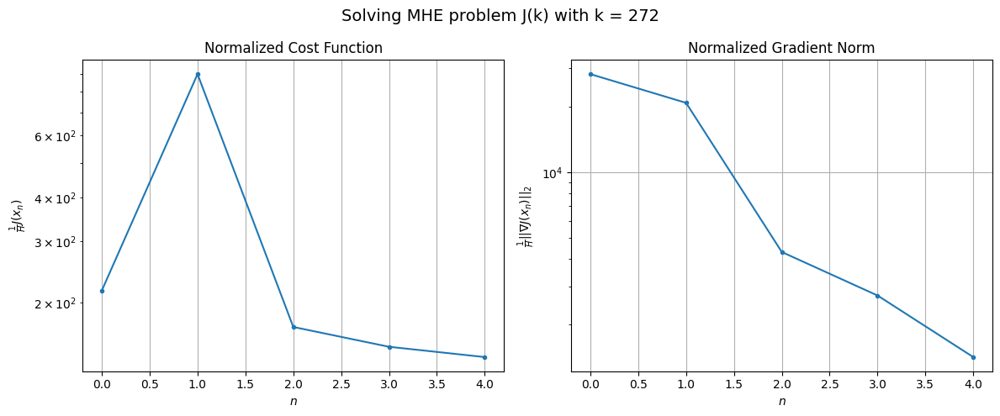

Windows:  68%|██████▊   | 264/386 [14:48<06:31,  3.21s/it]

[Gauss-Newton] Before applying the algorithm
Cost function: 1954.8518031084855
Gradient norm: 268740.8863389577
Global estimation error: 2425.940775121859
Initial conditions estimation errors: 0.7737524341812568 m, 872.6444673647953 m, 1122.7048717630573 m, 1965.5058276300922 m
Position estimation errors: 4.4527953050193005 m, 763.3214968693202 m, 1096.543522790982 m, 1438.6584426161392 m

[Gauss-Newton] Iteration 1
Cost function: 11663.883574429974 (496.66%)
Gradient norm: 185990.57459440397 (-30.79%)
Global estimation error: 862.3007035072246 (-64.45%)
Initial conditions estimation errors: 2.501857534348273 m, 289.49815444818535 m, 356.7650506911683 m, 729.7021753580427 m
Position estimation errors: 2.419633261984204 m, 387.13758790193873 m, 507.8946421364687 m, 852.2392478845784 m

[Gauss-Newton] STOP on Iteration 2 (gradient norm stagnated)
Cost function = 14778.523920653997 (26.70%)
Gradient norm = 270963.30092695216 (45.69%)
Global estimation error = 572.7838145750715 (-33.57%)
F

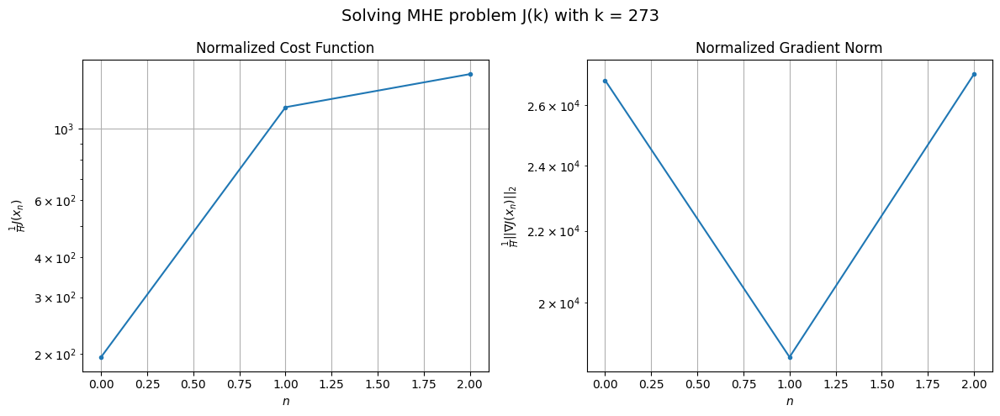

Windows:  69%|██████▊   | 265/386 [14:49<05:22,  2.67s/it]

[Gauss-Newton] Before applying the algorithm
Cost function: 15332.34102897704
Gradient norm: 385578.73132935405
Global estimation error: 555.1190776172053
Initial conditions estimation errors: 0.6702517837638241 m, 204.27839979985893 m, 241.56797360121934 m, 456.1489650381984 m
Position estimation errors: 4.338177824468602 m, 122.14974517385193 m, 168.89048251575488 m, 217.18629329307805 m

[Gauss-Newton] Iteration 1
Cost function: 36838.35638490006 (140.27%)
Gradient norm: 443983.9982286535 (15.15%)
Global estimation error: 2332.1784693962463 (320.12%)
Initial conditions estimation errors: 2.375166977641319 m, 845.056490901005 m, 1057.9652395164892 m, 1898.8521724824893 m
Position estimation errors: 2.273600290343771 m, 805.2508513953838 m, 1105.8586665379712 m, 1575.1028342549112 m

[Gauss-Newton] Iteration 2
Cost function: 1083.6322562646887 (-97.06%)
Gradient norm: 9947.572646740307 (-97.76%)
Global estimation error: 2068.7925889972107 (-11.29%)
Initial conditions estimation errors

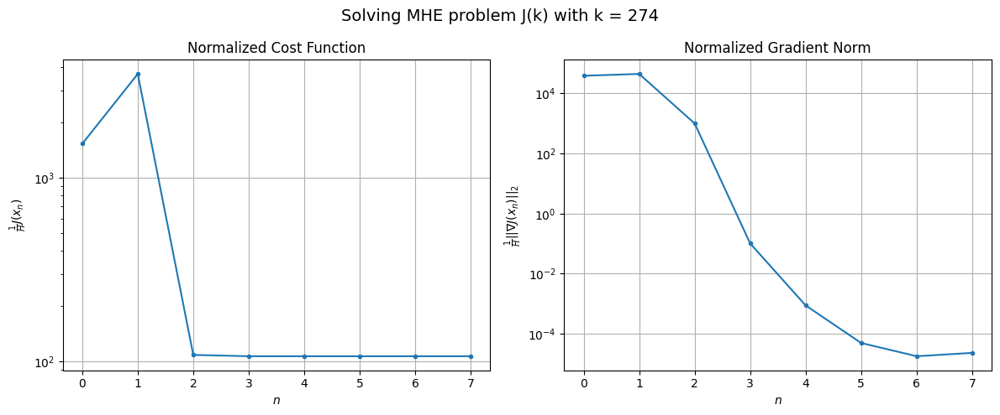

Windows:  69%|██████▉   | 266/386 [14:52<05:25,  2.72s/it]

[Gauss-Newton] Before applying the algorithm
Cost function: 1709.3753017852202
Gradient norm: 266685.45904697134
Global estimation error: 2080.259765067149
Initial conditions estimation errors: 0.661049596958856 m, 761.9768991677278 m, 963.378132661625 m, 1678.920450335859 m
Position estimation errors: 4.076662534930425 m, 680.3525187450736 m, 951.5228869854886 m, 1294.8712866403423 m

[Gauss-Newton] Iteration 1
Cost function: 16435.355987476505 (861.48%)
Gradient norm: 268459.1155373975 (0.67%)
Global estimation error: 498.824364363574 (-76.02%)
Initial conditions estimation errors: 2.261337592365555 m, 197.43062625244565 m, 281.677750976181 m, 361.2470244496842 m
Position estimation errors: 2.0942836252243517 m, 183.45940749717585 m, 261.98814149693777 m, 306.5663522795893 m

[Gauss-Newton] Iteration 2
Cost function: 1059.6405354860099 (-93.55%)
Gradient norm: 11011.762714595605 (-95.90%)
Global estimation error: 208.56919043478152 (-58.19%)
Initial conditions estimation errors: 2.26

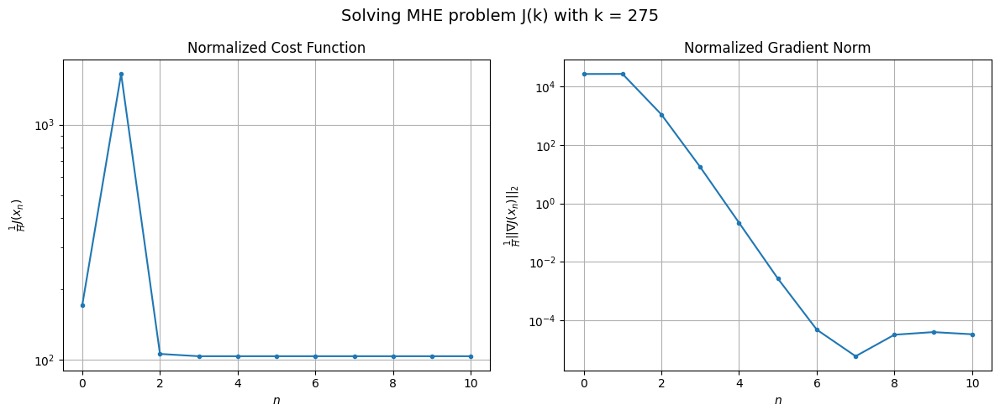

Windows:  69%|██████▉   | 267/386 [14:55<05:52,  2.96s/it]

[Gauss-Newton] Before applying the algorithm
Cost function: 1482.7241760118325
Gradient norm: 238923.44856286453
Global estimation error: 167.68676669097948
Initial conditions estimation errors: 0.6573720978949358 m, 75.24622204498515 m, 122.58365069562251 m, 86.19552855454037 m
Position estimation errors: 3.795798051156513 m, 60.79264648605806 m, 90.93459613438131 m, 66.64804554825865 m

[Gauss-Newton] Iteration 1
Cost function: 9842.249069808091 (563.80%)
Gradient norm: 213222.80405769122 (-10.76%)
Global estimation error: 1126.51527571505 (571.80%)
Initial conditions estimation errors: 2.1829452326693612 m, 410.04913600104476 m, 568.7031726218509 m, 881.7415723896434 m
Position estimation errors: 1.9811984798135527 m, 424.3662480631728 m, 593.3602022283752 m, 774.7667733319628 m

[Gauss-Newton] Iteration 2
Cost function: 987.3023588667656 (-89.97%)
Gradient norm: 21407.735812030678 (-89.96%)
Global estimation error: 729.8991594630553 (-35.21%)
Initial conditions estimation errors: 2

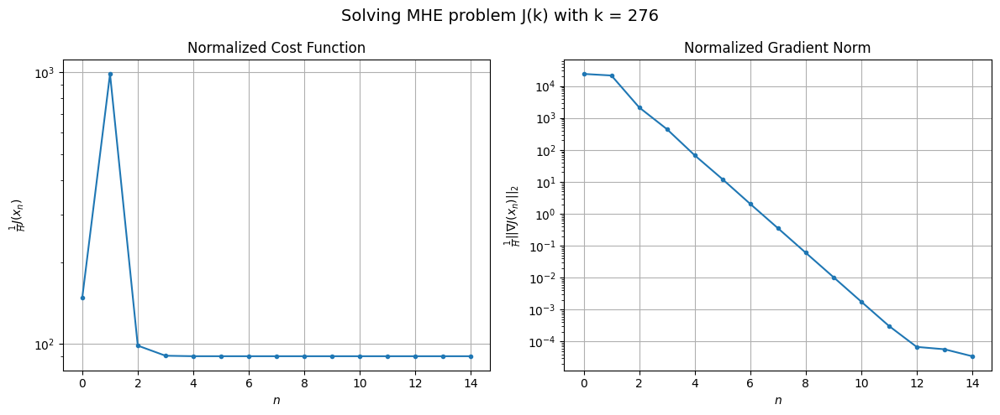

Windows:  69%|██████▉   | 268/386 [15:00<06:58,  3.55s/it]

[Gauss-Newton] Before applying the algorithm
Cost function: 1358.932911702247
Gradient norm: 230800.3330523322
Global estimation error: 871.0136534307993
Initial conditions estimation errors: 0.667604621776318 m, 320.0001211402935 m, 455.0617721568458 m, 670.2111658063324 m
Position estimation errors: 3.6211612079620292 m, 317.77373338113824 m, 444.2485063658066 m, 555.3845016316277 m

[Gauss-Newton] Iteration 1
Cost function: 4156785.008269216 (305785.96%)
Gradient norm: 4717296.089352031 (1943.89%)
Global estimation error: 5087.908958146831 (484.14%)
Initial conditions estimation errors: 2.0851337640137135 m, 1858.5303090440514 m, 2356.644188086711 m, 4108.394265177404 m
Position estimation errors: 1.891127341450393 m, 1921.7843397499284 m, 2631.502438985889 m, 3786.4617286815364 m

[Gauss-Newton] Iteration 2
Cost function: 41960.150356544305 (-98.99%)
Gradient norm: 479025.82183089474 (-89.85%)
Global estimation error: 3226.607875075201 (-36.58%)
Initial conditions estimation errors

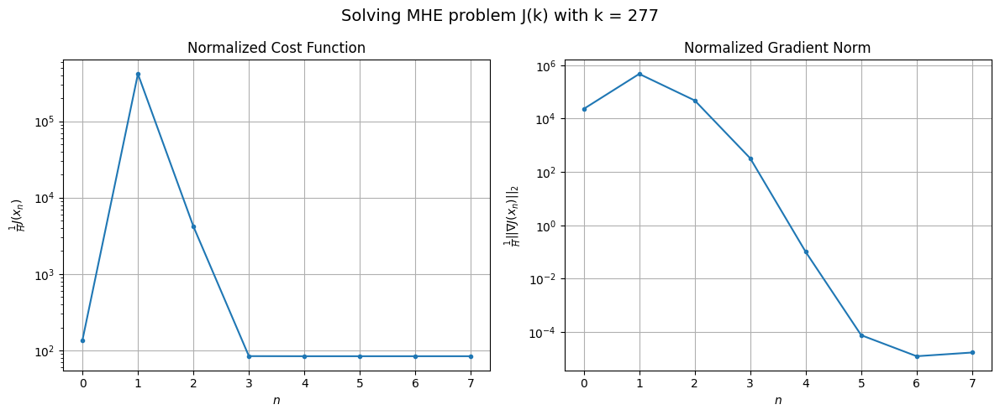

Windows:  70%|██████▉   | 269/386 [15:03<06:25,  3.29s/it]

[Gauss-Newton] Before applying the algorithm
Cost function: 1222.8856876407112
Gradient norm: 217764.58568932896
Global estimation error: 3109.922248263269
Initial conditions estimation errors: 0.6150616100532138 m, 1132.5341447404614 m, 1412.707284870915 m, 2528.4857055063767 m
Position estimation errors: 3.5329999199391677 m, 1097.42033445449 m, 1500.1163719627675 m, 2176.353052850013 m

[Gauss-Newton] Iteration 1
Cost function: 1336269.5234108511 (109171.83%)
Gradient norm: 2592361.1045681275 (1090.44%)
Global estimation error: 1547.5460711975056 (-50.24%)
Initial conditions estimation errors: 1.990673680845202 m, 569.952487669569 m, 767.663082736897 m, 1216.8575605785693 m
Position estimation errors: 1.888747023607541 m, 525.1028216778492 m, 741.7917975261864 m, 948.8105492908013 m

[Gauss-Newton] Iteration 2
Cost function: 686400.7866783898 (-48.63%)
Gradient norm: 1938771.840533499 (-25.21%)
Global estimation error: 5213.5327812035775 (236.89%)
Initial conditions estimation error

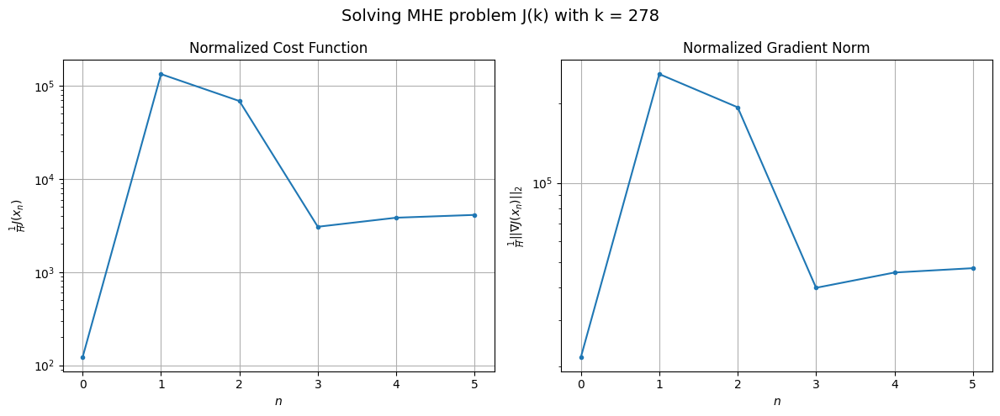

Windows:  70%|██████▉   | 270/386 [15:05<05:43,  2.96s/it]

[Gauss-Newton] Before applying the algorithm
Cost function: 41912.75820341982
Gradient norm: 529006.4297812927
Global estimation error: 3496.7482160738455
Initial conditions estimation errors: 0.5527353284401735 m, 1309.1519639574517 m, 1765.7918321771174 m, 2719.438808591678 m
Position estimation errors: 3.580516787953585 m, 1268.946731396526 m, 1799.3415927795772 m, 2316.7952110887472 m

[Gauss-Newton] Iteration 1
Cost function: 11429436.663066458 (27169.59%)
Gradient norm: 8308834.433297931 (1470.65%)
Global estimation error: 10431.983384599585 (198.33%)
Initial conditions estimation errors: 1.8978415407374272 m, 3923.324698856359 m, 5279.142366067006 m, 8097.186219429714 m
Position estimation errors: 1.8825230149921135 m, 4407.871619318574 m, 6200.060858117061 m, 8264.501170263751 m

[Gauss-Newton] Iteration 2
Cost function: 2361826.5031762053 (-79.34%)
Gradient norm: 3795240.0197327887 (-54.32%)
Global estimation error: 5781.87906070598 (-44.58%)
Initial conditions estimation erro

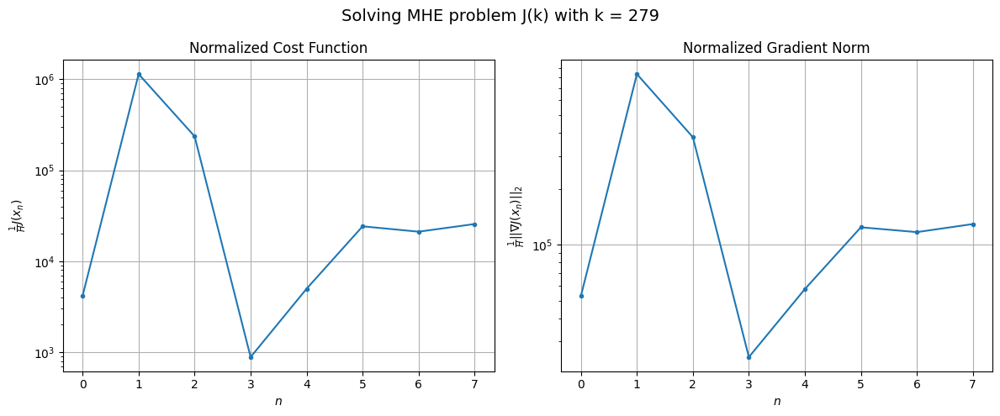

Windows:  70%|███████   | 271/386 [15:08<05:38,  2.94s/it]

[Gauss-Newton] Before applying the algorithm
Cost function: 284514.558063683
Gradient norm: 1364390.7558473677
Global estimation error: 7523.405198044524
Initial conditions estimation errors: 0.5051008162251431 m, 2838.010523580737 m, 3831.8289350319847 m, 5819.3117156756 m
Position estimation errors: 3.615516222939573 m, 3294.8811352616835 m, 4617.632297548863 m, 6231.060046001926 m

[Gauss-Newton] Iteration 1
Cost function: 13734.424837069486 (-95.17%)
Gradient norm: 311045.1663572007 (-77.20%)
Global estimation error: 6763.272348962392 (-10.10%)
Initial conditions estimation errors: 1.8385104379775612 m, 2559.2383080352333 m, 3487.494635081653 m, 5198.992663554368 m
Position estimation errors: 1.8769448670875348 m, 2641.342777610055 m, 3742.6613900351144 m, 4822.048253446694 m

[Gauss-Newton] Iteration 2
Cost function: 192529.9392305305 (1301.81%)
Gradient norm: 1172539.838153795 (276.97%)
Global estimation error: 8607.058495647078 (27.26%)
Initial conditions estimation errors: 1.83

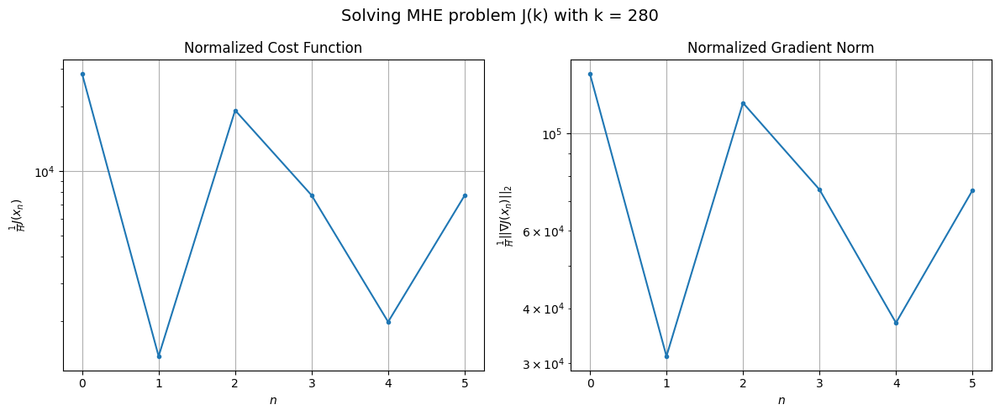

Windows:  70%|███████   | 272/386 [15:10<05:10,  2.72s/it]

[Gauss-Newton] Before applying the algorithm
Cost function: 94969.40234691746
Gradient norm: 845411.7651348042
Global estimation error: 6866.87426489487
Initial conditions estimation errors: 0.5067016014755588 m, 2616.3097901910915 m, 3587.3724799186425 m, 5238.286076834538 m
Position estimation errors: 3.627778943044904 m, 2541.1084129714986 m, 3629.5888525977275 m, 4559.51397870466 m

[Gauss-Newton] Iteration 1
Cost function: 340623.8642368187 (258.67%)
Gradient norm: 1139924.5600469816 (34.84%)
Global estimation error: 3283.3401860757263 (-52.19%)
Initial conditions estimation errors: 1.8348438451787472 m, 1262.9598445175543 m, 1722.0666753496441 m, 2493.93911758627 m
Position estimation errors: 1.9792339624678916 m, 1531.2668477507423 m, 2192.7169572190173 m, 2842.179178075795 m

[Gauss-Newton] Iteration 2
Cost function: 53583028.92430289 (15630.85%)
Gradient norm: 17562759.127360795 (1440.69%)
Global estimation error: 7364.607934518185 (124.30%)
Initial conditions estimation error

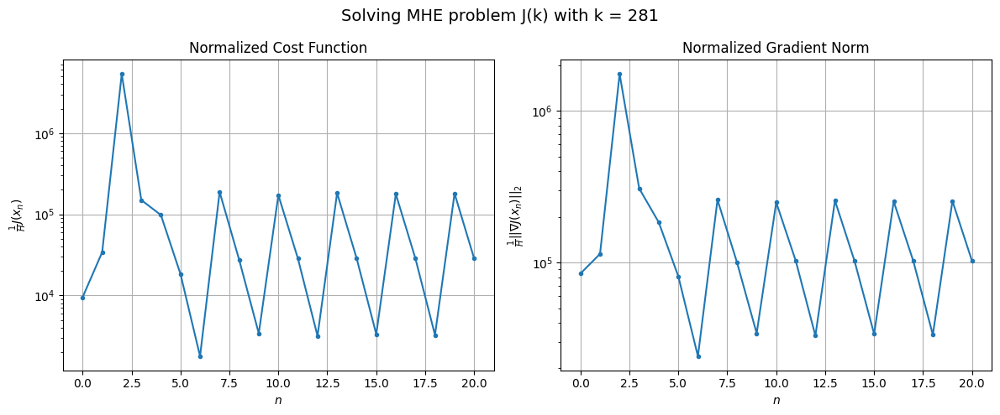

Windows:  71%|███████   | 273/386 [15:17<07:19,  3.89s/it]

[Gauss-Newton] Before applying the algorithm
Cost function: 243996.51695343378
Gradient norm: 950362.864217653
Global estimation error: 5089.260424125488
Initial conditions estimation errors: 0.5673855840952895 m, 1989.3286693922296 m, 2818.7322914837096 m, 3741.3748524182115 m
Position estimation errors: 3.745460844833497 m, 1336.8567947100967 m, 2058.08575289983 m, 2065.1719590119196 m

[Gauss-Newton] Iteration 1
Cost function: 61883.06872595476 (-74.64%)
Gradient norm: 464480.59075698897 (-51.13%)
Global estimation error: 2711.8836320789073 (-46.71%)
Initial conditions estimation errors: 1.8779106014117577 m, 1044.3517162786509 m, 1467.3177040262885 m, 2027.4654322108613 m
Position estimation errors: 2.0606619646399635 m, 722.1868660367077 m, 1068.1668209281722 m, 1123.6726868986484 m



/home/jgaspar/SpaceSim-Toolkit/test/new_newton_based_algorithms/gauss_newton.py:181: LinAlgWarning: Ill-conditioned matrix (rcond=8.23677e-17): result may not be accurate.
  delta_x = solve(HJ_x, -DJ_x)


[Gauss-Newton] Iteration 2
Cost function: 10106398.029643891 (16231.44%)
Gradient norm: 6127144.009707565 (1219.14%)
Global estimation error: 5799.990819310201 (113.87%)
Initial conditions estimation errors: 1.8779106838083954 m, 2279.487172139795 m, 3208.9554593849966 m, 4259.862407762383 m
Position estimation errors: 2.060661911356106 m, 1585.5114952518006 m, 2523.2724702596033 m, 2505.2126438310775 m

[Gauss-Newton] Iteration 3
Cost function: 2353546.329333205 (-76.71%)
Gradient norm: 3185879.946934234 (-48.00%)
Global estimation error: 434.94479766386917 (-92.50%)
Initial conditions estimation errors: 1.8779106792131213 m, 174.65579227708375 m, 249.38033593439943 m, 310.6079550419264 m
Position estimation errors: 2.0606619353822047 m, 208.58185580368942 m, 245.9367303036063 m, 393.6440476109225 m

[Gauss-Newton] Iteration 4
Cost function: 3213.082845577044 (-99.86%)
Gradient norm: 78800.3246581482 (-97.53%)
Global estimation error: 1071.3563018454583 (146.32%)
Initial conditions es

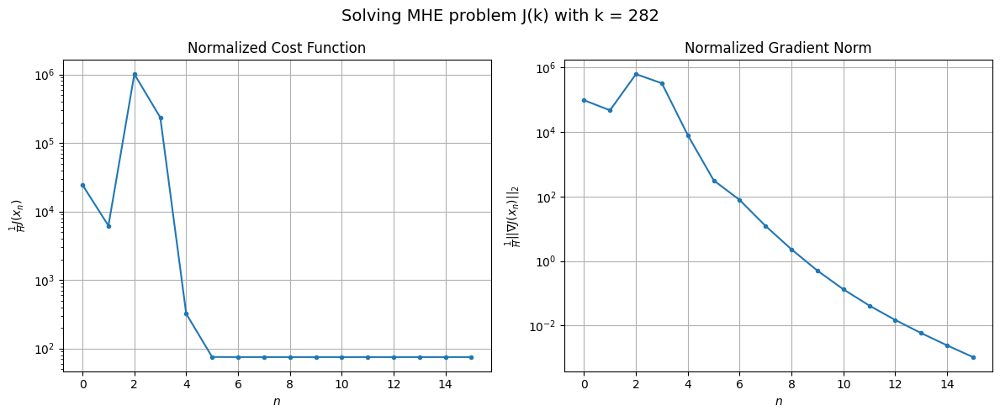

Windows:  71%|███████   | 274/386 [15:22<07:53,  4.23s/it]

[Gauss-Newton] Before applying the algorithm
Cost function: 1302.510513145859
Gradient norm: 234362.47049959016
Global estimation error: 1202.9472200897471
Initial conditions estimation errors: 0.627225615588857 m, 455.18386065589414 m, 622.6224852821823 m, 923.1632835981649 m
Position estimation errors: 3.7798034967409992 m, 418.9240156907879 m, 562.9381972209143 m, 690.1142593800821 m

[Gauss-Newton] Iteration 1
Cost function: 3327313.8148403764 (255353.89%)
Gradient norm: 4302531.422294284 (1735.84%)
Global estimation error: 6571.070012024754 (446.25%)
Initial conditions estimation errors: 1.898827633993642 m, 2553.7045849389037 m, 3615.2123363549113 m, 4856.725721231682 m
Position estimation errors: 2.0973704331325322 m, 2648.9525328487402 m, 3760.5370177641466 m, 4630.513326080904 m

[Gauss-Newton] Iteration 2
Cost function: 28730.333596439967 (-99.14%)
Gradient norm: 406939.75070679263 (-90.54%)
Global estimation error: 4988.355297013393 (-24.09%)
Initial conditions estimation er

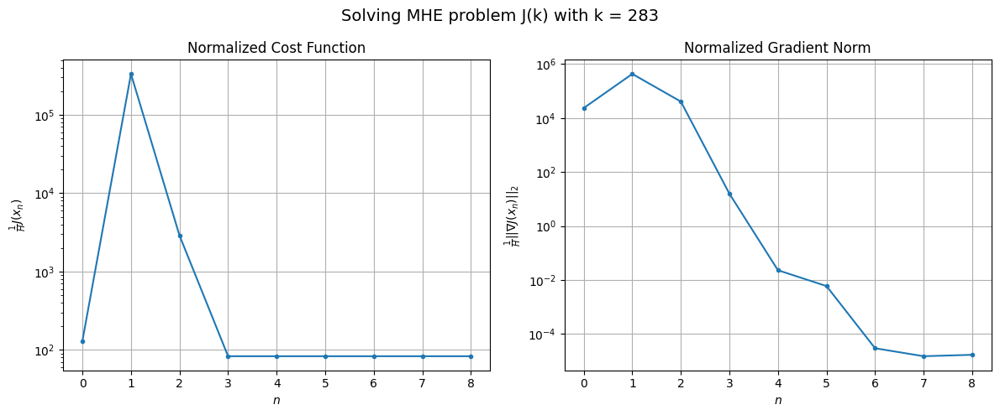

Windows:  71%|███████   | 275/386 [15:25<07:06,  3.84s/it]

[Gauss-Newton] Before applying the algorithm
Cost function: 1362.1258888002326
Gradient norm: 238974.65169745023
Global estimation error: 5038.069100629912
Initial conditions estimation errors: 0.6357793027624111 m, 1964.96354066574 m, 2780.649658009371 m, 3713.360281172684 m
Position estimation errors: 3.686608303593891 m, 1871.3547139794005 m, 2640.660117154319 m, 3202.144634568137 m

[Gauss-Newton] Iteration 1
Cost function: 895.9743310526992 (-34.22%)
Gradient norm: 14641.476250795115 (-93.87%)
Global estimation error: 4923.895003192873 (-2.27%)
Initial conditions estimation errors: 1.9726898865314648 m, 1934.650503074984 m, 2762.3789365505168 m, 3587.6349366587738 m
Position estimation errors: 1.9569936581665592 m, 2043.5668479470187 m, 2919.512409649123 m, 3510.1235261165957 m

[Gauss-Newton] Iteration 2
Cost function: 878.2910190556933 (-1.97%)
Gradient norm: 8293.584113459243 (-43.36%)
Global estimation error: 5186.95469923539 (5.34%)
Initial conditions estimation errors: 1.972

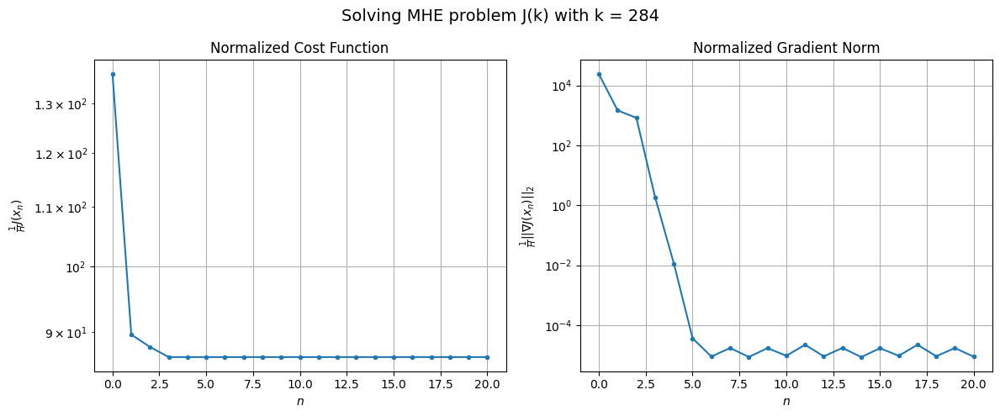

Windows:  72%|███████▏  | 276/386 [15:31<08:15,  4.50s/it]

[Gauss-Newton] Before applying the algorithm
Cost function: 1296.0119229327374
Gradient norm: 227564.69485976105
Global estimation error: 5272.77120068918
Initial conditions estimation errors: 0.6634797102170183 m, 2082.109322136644 m, 2970.820401654613 m, 3826.3768793379463 m
Position estimation errors: 3.355572696697798 m, 2096.1770611776706 m, 3000.9750707845824 m, 3565.7394779903875 m

[Gauss-Newton] Iteration 1
Cost function: 426844.05533991277 (32835.20%)
Gradient norm: 1562993.5769516393 (586.83%)
Global estimation error: 2153.2603707584904 (-59.16%)
Initial conditions estimation errors: 2.018955910313529 m, 862.9428209690308 m, 1272.6007077041063 m, 1507.4293218367627 m
Position estimation errors: 1.6824174060242159 m, 754.9279208735729 m, 1010.7495551602098 m, 1250.1793005070206 m



/home/jgaspar/SpaceSim-Toolkit/test/new_newton_based_algorithms/gauss_newton.py:181: LinAlgWarning: Ill-conditioned matrix (rcond=9.54169e-17): result may not be accurate.
  delta_x = solve(HJ_x, -DJ_x)


[Gauss-Newton] Iteration 2
Cost function: 7033.114504558978 (-98.35%)
Gradient norm: 185660.82267627725 (-88.12%)
Global estimation error: 1035.54866528522 (-51.91%)
Initial conditions estimation errors: 2.0189558624508885 m, 419.50650157538655 m, 616.9419404263947 m, 718.1599062327109 m
Position estimation errors: 1.682417455676372 m, 283.2771954088065 m, 339.1560990332052 m, 437.24661552437124 m



/home/jgaspar/SpaceSim-Toolkit/test/new_newton_based_algorithms/gauss_newton.py:181: LinAlgWarning: Ill-conditioned matrix (rcond=4.81747e-17): result may not be accurate.
  delta_x = solve(HJ_x, -DJ_x)


[Gauss-Newton] Iteration 3
Cost function: 13340.67474794576 (89.68%)
Gradient norm: 261481.42362047615 (40.84%)
Global estimation error: 321.86661790214424 (-68.92%)
Initial conditions estimation errors: 2.0189558521110955 m, 121.76484443106182 m, 158.37481170854596 m, 252.3566051533071 m
Position estimation errors: 1.6824174548180701 m, 270.4410291899711 m, 456.95727313485173 m, 502.8369206096555 m



/home/jgaspar/SpaceSim-Toolkit/test/new_newton_based_algorithms/gauss_newton.py:181: LinAlgWarning: Ill-conditioned matrix (rcond=1.99661e-17): result may not be accurate.
  delta_x = solve(HJ_x, -DJ_x)


[Gauss-Newton] Iteration 4
Cost function: 4601230.136349123 (34390.24%)
Gradient norm: 4897078.892575931 (1772.82%)
Global estimation error: 6356.205277457638 (1874.79%)
Initial conditions estimation errors: 2.018955855018203 m, 2519.2544124692995 m, 3644.6272156699374 m, 4557.563424631159 m
Position estimation errors: 1.6824174493182078 m, 2599.1283641434475 m, 3920.2294165084404 m, 4431.621748093659 m

[Gauss-Newton] Iteration 5
Cost function: 851.7124471603032 (-99.98%)
Gradient norm: 5808.597281456451 (-99.88%)
Global estimation error: 5802.3173055579555 (-8.71%)
Initial conditions estimation errors: 2.0189559233201417 m, 2305.884195426446 m, 3358.3134710801564 m, 4131.767152744306 m
Position estimation errors: 1.6824173947652827 m, 2575.6644260275634 m, 3852.668361070675 m, 4434.54138269863 m

[Gauss-Newton] Iteration 6
Cost function: 32933.79888740556 (3766.77%)
Gradient norm: 484067.5850910157 (8233.64%)
Global estimation error: 6883.723382972309 (18.64%)
Initial conditions esti

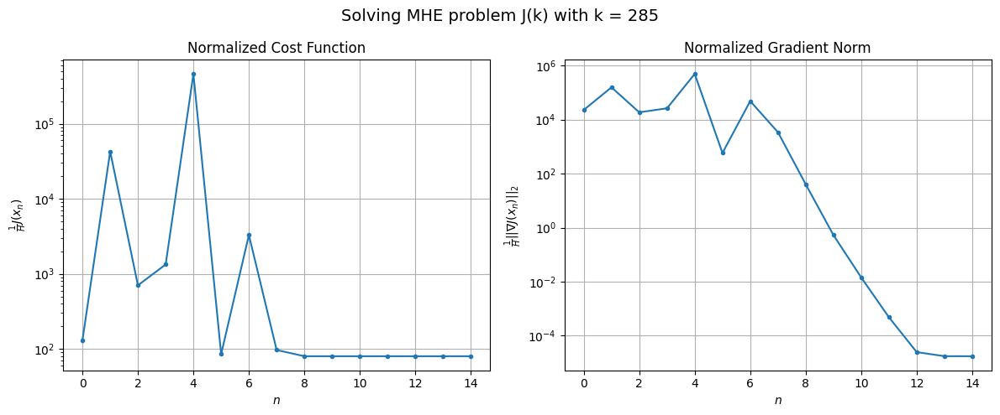

Windows:  72%|███████▏  | 277/386 [15:35<08:12,  4.52s/it]

[Gauss-Newton] Before applying the algorithm
Cost function: 1071.604403115637
Gradient norm: 194691.5320712174
Global estimation error: 6866.991232435618
Initial conditions estimation errors: 0.6446379922275648 m, 2733.0996942058296 m, 3987.121813470471 m, 4877.352814113053 m
Position estimation errors: 2.9916218881364425 m, 3226.600251030488 m, 4713.051329161463 m, 5685.028159648218 m

[Gauss-Newton] Iteration 1
Cost function: 502486.32379349845 (46791.03%)
Gradient norm: 1564934.7590761194 (703.80%)
Global estimation error: 3303.8094437487 (-51.89%)
Initial conditions estimation errors: 1.907971239922931 m, 1311.7507545461747 m, 1967.2648286687474 m, 2307.4470942062608 m
Position estimation errors: 1.5157033630956471 m, 1967.3159157410062 m, 2815.9246294662335 m, 3575.229795205596 m



/home/jgaspar/SpaceSim-Toolkit/test/new_newton_based_algorithms/gauss_newton.py:181: LinAlgWarning: Ill-conditioned matrix (rcond=9.9136e-17): result may not be accurate.
  delta_x = solve(HJ_x, -DJ_x)


[Gauss-Newton] Iteration 2
Cost function: 673.6302774759401 (-99.87%)
Gradient norm: 262.0330306382362 (-99.98%)
Global estimation error: 3186.314300944967 (-3.56%)
Initial conditions estimation errors: 1.9079712485629248 m, 1268.7957601526134 m, 1914.1507431054529 m, 2208.791075650425 m
Position estimation errors: 1.5157033769103254 m, 1959.7347268386536 m, 2812.53556020973 m, 3567.204965185848 m



/home/jgaspar/SpaceSim-Toolkit/test/new_newton_based_algorithms/gauss_newton.py:181: LinAlgWarning: Ill-conditioned matrix (rcond=9.85842e-17): result may not be accurate.
  delta_x = solve(HJ_x, -DJ_x)


[Gauss-Newton] Iteration 3
Cost function: 673.5326064194187 (-0.01%)
Gradient norm: 371.4255010595274 (41.75%)
Global estimation error: 3131.930382193611 (-1.71%)
Initial conditions estimation errors: 1.907971246669615 m, 1247.0931052761525 m, 1882.079221096202 m, 2170.598885916286 m
Position estimation errors: 1.5157033814547227 m, 1939.2292594093444 m, 2783.7433825668577 m, 3533.5610619821186 m



/home/jgaspar/SpaceSim-Toolkit/test/new_newton_based_algorithms/gauss_newton.py:181: LinAlgWarning: Ill-conditioned matrix (rcond=9.58503e-17): result may not be accurate.
  delta_x = solve(HJ_x, -DJ_x)


[Gauss-Newton] STOP on Iteration 4 (gradient norm stagnated)
Cost function = 673.5199287207818 (-0.00%)
Gradient norm = 287.2714474452427 (-22.66%)
Global estimation error = 3176.3161885509257 (1.42%)
Final initial conditions estimation errors: 1.907971246669615 m, 1264.9660607867781 m, 1908.446279457656 m, 2201.5115411266747 m
Final position estimation errors: 1.5157033814287433 m, 1957.0077745541673 m, 2810.851254078013 m, 3563.576797977073 m



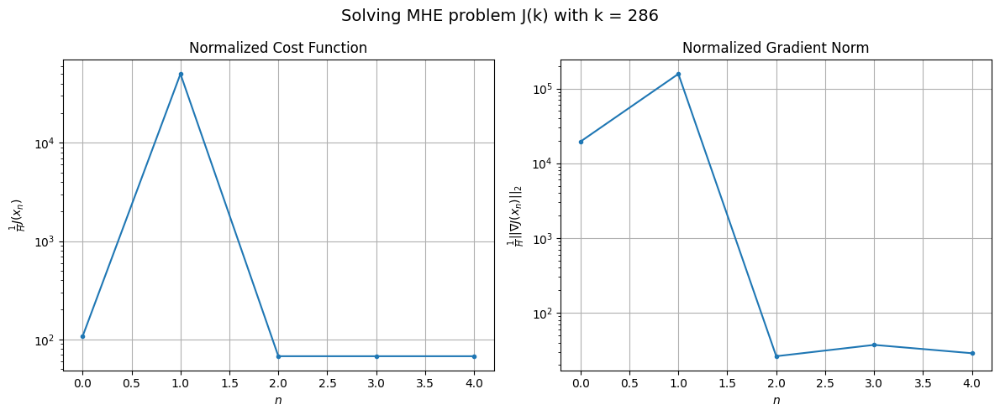

Windows:  72%|███████▏  | 278/386 [15:38<06:52,  3.82s/it]

[Gauss-Newton] Before applying the algorithm
Cost function: 925.416862887721
Gradient norm: 185080.89900513086
Global estimation error: 3438.385608821883
Initial conditions estimation errors: 0.5459783661499863 m, 1369.2101251781232 m, 2048.0461154024547 m, 2398.592648116015 m
Position estimation errors: 2.92288752142027 m, 1994.235386864674 m, 2855.8027106397476 m, 3646.2106558190603 m



/home/jgaspar/SpaceSim-Toolkit/test/new_newton_based_algorithms/gauss_newton.py:181: LinAlgWarning: Ill-conditioned matrix (rcond=1.06004e-16): result may not be accurate.
  delta_x = solve(HJ_x, -DJ_x)


[Gauss-Newton] Iteration 1
Cost function: 2508348.834567934 (270950.69%)
Gradient norm: 3759966.0828488767 (1931.53%)
Global estimation error: 1519.4142540249034 (-55.81%)
Initial conditions estimation errors: 1.7374701800627057 m, 605.3740397416135 m, 821.1794078891019 m, 1125.9649735356388 m
Position estimation errors: 1.534634703582002 m, 167.79574990533595 m, 386.11427180332583 m, 360.8183384261689 m



/home/jgaspar/SpaceSim-Toolkit/test/new_newton_based_algorithms/gauss_newton.py:181: LinAlgWarning: Ill-conditioned matrix (rcond=1.04517e-17): result may not be accurate.
  delta_x = solve(HJ_x, -DJ_x)


[Gauss-Newton] Iteration 2
Cost function: 1365.7822988369826 (-99.95%)
Gradient norm: 69347.72399347126 (-98.16%)
Global estimation error: 854.2895185008427 (-43.78%)
Initial conditions estimation errors: 1.737470181956039 m, 330.9295718505126 m, 408.5917933659266 m, 673.304031823618 m
Position estimation errors: 1.5346347239033373 m, 210.11738940248122 m, 163.7297081623011 m, 657.3393960016911 m



/home/jgaspar/SpaceSim-Toolkit/test/new_newton_based_algorithms/gauss_newton.py:181: LinAlgWarning: Ill-conditioned matrix (rcond=5.87596e-18): result may not be accurate.
  delta_x = solve(HJ_x, -DJ_x)


[Gauss-Newton] Iteration 3
Cost function: 22610990.551861063 (1655434.02%)
Gradient norm: 10696154.423228592 (15323.94%)
Global estimation error: 10014.722277195693 (1072.29%)
Initial conditions estimation errors: 1.7374701792674034 m, 4009.7969552004533 m, 5810.216256485318 m, 7103.349085410896 m
Position estimation errors: 1.5346347285762858 m, 3196.1727079182315 m, 4984.765595971182 m, 5049.366102004096 m

[Gauss-Newton] Iteration 4
Cost function: 4627831.439329276 (-79.53%)
Gradient norm: 4761283.16909075 (-55.49%)
Global estimation error: 3703.3655875345607 (-63.02%)
Initial conditions estimation errors: 1.737470149226681 m, 1481.5875150601057 m, 2104.6649251218273 m, 2662.7416718040295 m
Position estimation errors: 1.5346347497039428 m, 931.1376864306357 m, 1569.1503427379616 m, 1301.5557809141685 m



/home/jgaspar/SpaceSim-Toolkit/test/new_newton_based_algorithms/gauss_newton.py:181: LinAlgWarning: Ill-conditioned matrix (rcond=4.90675e-17): result may not be accurate.
  delta_x = solve(HJ_x, -DJ_x)


[Gauss-Newton] Iteration 5
Cost function: 560759.572412986 (-87.88%)
Gradient norm: 1687141.1646594873 (-64.57%)
Global estimation error: 250.43418110462602 (-93.24%)
Initial conditions estimation errors: 1.7374701650772295 m, 84.075222926108 m, 128.5038680242639 m, 197.80303574705692 m
Position estimation errors: 1.5346347412341834 m, 440.0513284715055 m, 506.1494576723725 m, 1011.0148763431089 m



/home/jgaspar/SpaceSim-Toolkit/test/new_newton_based_algorithms/gauss_newton.py:181: LinAlgWarning: Ill-conditioned matrix (rcond=5.2778e-18): result may not be accurate.
  delta_x = solve(HJ_x, -DJ_x)


[Gauss-Newton] Iteration 6
Cost function: 452470414.54992497 (80588.84%)
Gradient norm: 48001522.135339215 (2745.14%)
Global estimation error: 19913.460379681455 (7851.57%)
Initial conditions estimation errors: 1.737470169043125 m, 7987.54002969059 m, 11668.928389132745 m, 14020.741718211522 m
Position estimation errors: 1.5346347350970109 m, 6963.849281434065 m, 10669.992186130763 m, 11356.264789137964 m

[Gauss-Newton] Iteration 7
Cost function: 74958694.20940067 (-83.43%)
Gradient norm: 19648156.81891772 (-59.07%)
Global estimation error: 6799.750915099894 (-65.85%)
Initial conditions estimation errors: 1.7374700921816273 m, 2724.0774288910484 m, 3929.4544612612326 m, 4834.810575942895 m
Position estimation errors: 1.53463479018692 m, 2069.297149576071 m, 3286.447129382668 m, 3219.6736282671473 m

[Gauss-Newton] Iteration 8
Cost function: 1374121.956282847 (-98.17%)
Gradient norm: 2643193.3951174496 (-86.55%)
Global estimation error: 1849.7899715054511 (-72.80%)
Initial conditions e

/home/jgaspar/SpaceSim-Toolkit/test/new_newton_based_algorithms/gauss_newton.py:181: LinAlgWarning: Ill-conditioned matrix (rcond=1.43366e-17): result may not be accurate.
  delta_x = solve(HJ_x, -DJ_x)


[Gauss-Newton] Iteration 9
Cost function: 858.6832974037175 (-99.94%)
Gradient norm: 41540.62486646873 (-98.43%)
Global estimation error: 1320.2788469505956 (-28.63%)
Initial conditions estimation errors: 1.7374701735373133 m, 519.1888572608827 m, 681.4624945207586 m, 1004.5787130598032 m
Position estimation errors: 1.5346347333819663 m, 13.593168840346094 m, 152.51002115063937 m, 328.3021961595103 m



/home/jgaspar/SpaceSim-Toolkit/test/new_newton_based_algorithms/gauss_newton.py:181: LinAlgWarning: Ill-conditioned matrix (rcond=8.79201e-18): result may not be accurate.
  delta_x = solve(HJ_x, -DJ_x)


[Gauss-Newton] Iteration 10
Cost function: 415648.48568170314 (48305.33%)
Gradient norm: 1437047.3397321464 (3359.38%)
Global estimation error: 4696.20322011058 (255.70%)
Initial conditions estimation errors: 1.7374701754728537 m, 1874.8363286301362 m, 2671.162477431177 m, 3377.009893757134 m
Position estimation errors: 1.5346347338757194 m, 1222.7313860763572 m, 2006.5544875868604 m, 1760.5989540574026 m



/home/jgaspar/SpaceSim-Toolkit/test/new_newton_based_algorithms/gauss_newton.py:181: LinAlgWarning: Ill-conditioned matrix (rcond=7.46159e-17): result may not be accurate.
  delta_x = solve(HJ_x, -DJ_x)


[Gauss-Newton] Iteration 11
Cost function: 754336.9328209903 (81.48%)
Gradient norm: 1910784.0407769678 (32.97%)
Global estimation error: 772.1275050574305 (-83.56%)
Initial conditions estimation errors: 1.7374701576262739 m, 300.53647557180517 m, 369.1169838718078 m, 607.9492641087978 m
Position estimation errors: 1.5346347455550302 m, 201.6617097292201 m, 176.7953667235771 m, 616.7007439979432 m



/home/jgaspar/SpaceSim-Toolkit/test/new_newton_based_algorithms/gauss_newton.py:181: LinAlgWarning: Ill-conditioned matrix (rcond=5.60765e-18): result may not be accurate.
  delta_x = solve(HJ_x, -DJ_x)


[Gauss-Newton] Iteration 12
Cost function: 42623954.48409116 (5550.52%)
Gradient norm: 14588877.323116276 (663.50%)
Global estimation error: 11577.61067180273 (1399.44%)
Initial conditions estimation errors: 1.7374701811475164 m, 4636.949235341261 m, 6730.750287607653 m, 8199.802511652364 m
Position estimation errors: 1.5346347266876041 m, 3783.229782095469 m, 5869.439737720944 m, 6030.897627490114 m

[Gauss-Newton] Iteration 13
Cost function: 7669033.658433265 (-82.01%)
Gradient norm: 6140642.52635989 (-57.91%)
Global estimation error: 4364.6606439543875 (-62.30%)
Initial conditions estimation errors: 1.7374701454926225 m, 1747.713954695056 m, 2496.474702425523 m, 3124.6384556735343 m
Position estimation errors: 1.534634754058842 m, 1190.8231732561849 m, 1960.7047168787358 m, 1737.3935011606552 m



/home/jgaspar/SpaceSim-Toolkit/test/new_newton_based_algorithms/gauss_newton.py:181: LinAlgWarning: Ill-conditioned matrix (rcond=6.60831e-17): result may not be accurate.
  delta_x = solve(HJ_x, -DJ_x)


[Gauss-Newton] Iteration 14
Cost function: 759094.2708278495 (-90.10%)
Gradient norm: 1965215.110344868 (-68.00%)
Global estimation error: 481.37253370358553 (-88.97%)
Initial conditions estimation errors: 1.7374701631971163 m, 182.32481187441417 m, 203.99484643553927 m, 396.0485660847057 m
Position estimation errors: 1.5346347396543316 m, 300.2471018286015 m, 304.7387460575338 m, 774.665269284193 m



/home/jgaspar/SpaceSim-Toolkit/test/new_newton_based_algorithms/gauss_newton.py:181: LinAlgWarning: Ill-conditioned matrix (rcond=4.91139e-18): result may not be accurate.
  delta_x = solve(HJ_x, -DJ_x)


[Gauss-Newton] Iteration 15
Cost function: 223230638.99727783 (29307.50%)
Gradient norm: 33539700.972423952 (1606.67%)
Global estimation error: 16979.3948537929 (3427.29%)
Initial conditions estimation errors: 1.737470178379257 m, 6806.607924058599 m, 9924.124185358334 m, 11978.383950212192 m
Position estimation errors: 1.5346347307655415 m, 5820.600447849475 m, 8943.126882973038 m, 9436.653568611 m

[Gauss-Newton] Iteration 16
Cost function: 35891130.83655675 (-83.92%)
Gradient norm: 13442946.839024533 (-59.92%)
Global estimation error: 6145.095777182392 (-63.81%)
Initial conditions estimation errors: 1.7374701211749555 m, 2462.8602840615017 m, 3547.959495332965 m, 4371.3267282131155 m
Position estimation errors: 1.5346347720741367 m, 1851.8122275309224 m, 2958.222327003085 m, 2847.36909566326 m

[Gauss-Newton] Iteration 17
Cost function: 1325123.4570280958 (-96.31%)
Gradient norm: 2597905.6920647896 (-80.67%)
Global estimation error: 1452.1754876188756 (-76.37%)
Initial conditions es

/home/jgaspar/SpaceSim-Toolkit/test/new_newton_based_algorithms/gauss_newton.py:181: LinAlgWarning: Ill-conditioned matrix (rcond=1.04638e-17): result may not be accurate.
  delta_x = solve(HJ_x, -DJ_x)


[Gauss-Newton] Iteration 18
Cost function: 15960.835240622782 (-98.80%)
Gradient norm: 261667.277070186 (-89.93%)
Global estimation error: 2976.085567364714 (104.94%)
Initial conditions estimation errors: 1.737470177302603 m, 1184.6776640638966 m, 1657.7895953479874 m, 2169.181619045557 m
Position estimation errors: 1.5346347289829911 m, 595.9121342289061 m, 1062.4503142940841 m, 724.876000288549 m



/home/jgaspar/SpaceSim-Toolkit/test/new_newton_based_algorithms/gauss_newton.py:181: LinAlgWarning: Ill-conditioned matrix (rcond=3.22832e-17): result may not be accurate.
  delta_x = solve(HJ_x, -DJ_x)


[Gauss-Newton] Iteration 19
Cost function: 244135.47490624065 (1429.59%)
Gradient norm: 1093770.7118982675 (318.00%)
Global estimation error: 208.42446714567853 (-93.00%)
Initial conditions estimation errors: 1.7374701632404457 m, 61.89464771491519 m, 120.79768979087395 m, 158.13831356306594 m
Position estimation errors: 1.534634742929386 m, 477.5936657538025 m, 561.7552185574884 m, 1079.7692112386517 m



/home/jgaspar/SpaceSim-Toolkit/test/new_newton_based_algorithms/gauss_newton.py:181: LinAlgWarning: Ill-conditioned matrix (rcond=5.69382e-18): result may not be accurate.
  delta_x = solve(HJ_x, -DJ_x)


[Gauss-Newton] STOP on Iteration 20 (max iteration reached)
Cost function = 410800445.32135874 (168167.41%)
Gradient norm = 45818738.559443735 (4089.06%)
Global estimation error = 19323.954793651876 (9171.44%)
Final initial conditions estimation errors: 1.7374701653090663 m, 7751.282372489896 m, 11323.064473964256 m, 13605.919353984496 m
Final position estimation errors: 1.5346347377501541 m, 6751.408999733572 m, 10350.20007287405 m, 11003.935062472057 m



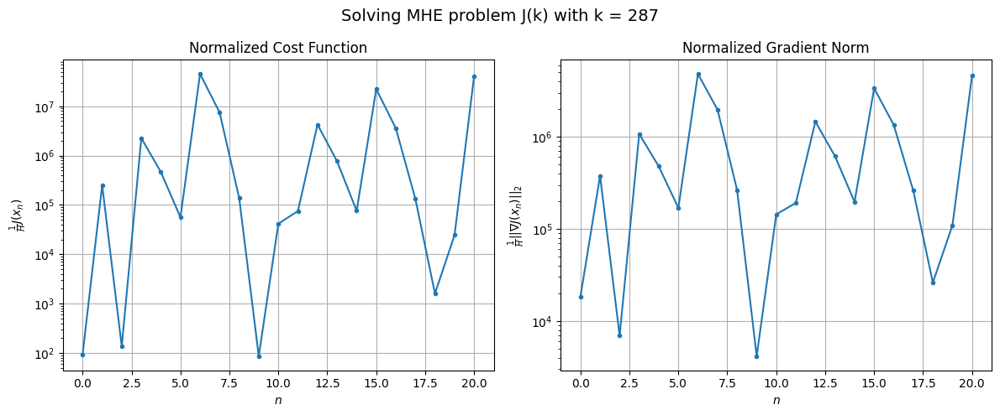

Windows:  72%|███████▏  | 279/386 [15:44<08:19,  4.66s/it]

[Gauss-Newton] Before applying the algorithm
Cost function: 396584595.511079
Gradient norm: 44269405.89279829
Global estimation error: 19333.13265909884
Initial conditions estimation errors: 0.44023128699733755 m, 7773.186630561778 m, 11409.278479315233 m, 13534.250476439363 m
Position estimation errors: 3.0889258758225755 m, 6482.9165854960975 m, 10008.368601401125 m, 10468.414151172636 m

[Gauss-Newton] Iteration 1
Cost function: 21796461.257032204 (-94.50%)
Gradient norm: 10650052.271675201 (-75.94%)
Global estimation error: 9139.878460825868 (-52.72%)
Initial conditions estimation errors: 1.5571367895394153 m, 3670.095261441801 m, 5304.310778473301 m, 6475.496348822953 m
Position estimation errors: 1.7062787707276086 m, 2678.5252929131825 m, 4258.762566322747 m, 4189.596863391928 m



/home/jgaspar/SpaceSim-Toolkit/test/new_newton_based_algorithms/gauss_newton.py:181: LinAlgWarning: Ill-conditioned matrix (rcond=9.17364e-17): result may not be accurate.
  delta_x = solve(HJ_x, -DJ_x)


[Gauss-Newton] Iteration 2
Cost function: 27938.10287969965 (-99.87%)
Gradient norm: 345365.65559308854 (-96.76%)
Global estimation error: 7133.991273302409 (-21.95%)
Initial conditions estimation errors: 1.557136793915876 m, 2864.9598124109943 m, 4097.6883540493545 m, 5088.691217856794 m
Position estimation errors: 1.7062787946371905 m, 2032.039712794938 m, 3286.2518897737723 m, 3174.468090121753 m



/home/jgaspar/SpaceSim-Toolkit/test/new_newton_based_algorithms/gauss_newton.py:181: LinAlgWarning: Ill-conditioned matrix (rcond=6.14951e-17): result may not be accurate.
  delta_x = solve(HJ_x, -DJ_x)


[Gauss-Newton] Iteration 3
Cost function: 48667.50841130471 (74.20%)
Gradient norm: 426576.40528914944 (23.51%)
Global estimation error: 4949.038449053922 (-30.63%)
Initial conditions estimation errors: 1.5571367839493293 m, 1993.550517605822 m, 2833.9064035940287 m, 3533.7950239033594 m
Position estimation errors: 1.7062788063373047 m, 1418.580356536177 m, 2337.7129290740836 m, 2217.298051089755 m



/home/jgaspar/SpaceSim-Toolkit/test/new_newton_based_algorithms/gauss_newton.py:181: LinAlgWarning: Ill-conditioned matrix (rcond=3.81116e-17): result may not be accurate.
  delta_x = solve(HJ_x, -DJ_x)


[Gauss-Newton] Iteration 4
Cost function: 782.7546061494226 (-98.39%)
Gradient norm: 32616.17824180514 (-92.35%)
Global estimation error: 4395.285296369481 (-11.19%)
Initial conditions estimation errors: 1.5571367884774021 m, 1771.2529322883452 m, 2511.263536641841 m, 3142.4109425579622 m
Position estimation errors: 1.7062788032339573 m, 1244.6916915722384 m, 2054.5029080742297 m, 1936.3542516762773 m



/home/jgaspar/SpaceSim-Toolkit/test/new_newton_based_algorithms/gauss_newton.py:181: LinAlgWarning: Ill-conditioned matrix (rcond=3.10606e-17): result may not be accurate.
  delta_x = solve(HJ_x, -DJ_x)


[Gauss-Newton] Iteration 5
Cost function: 599.8995879667807 (-23.36%)
Gradient norm: 15486.427278564137 (-52.52%)
Global estimation error: 4007.1829930107992 (-8.83%)
Initial conditions estimation errors: 1.5571367866645773 m, 1615.6557206311086 m, 2284.86026925023 m, 2868.201729107506 m
Position estimation errors: 1.7062788064574421 m, 1125.5417901581454 m, 1863.7703768686326 m, 1744.9239615389322 m



/home/jgaspar/SpaceSim-Toolkit/test/new_newton_based_algorithms/gauss_newton.py:181: LinAlgWarning: Ill-conditioned matrix (rcond=2.66699e-17): result may not be accurate.
  delta_x = solve(HJ_x, -DJ_x)


[Gauss-Newton] Iteration 6
Cost function: 556.5158236553093 (-7.23%)
Gradient norm: 7396.9810866000125 (-52.24%)
Global estimation error: 3741.324383886372 (-6.63%)
Initial conditions estimation errors: 1.5571367857477885 m, 1509.0399161896526 m, 2129.616140854165 m, 2680.4920090685996 m
Position estimation errors: 1.7062788081202311 m, 1042.6566960852626 m, 1731.7815432128643 m, 1611.262714881522 m



/home/jgaspar/SpaceSim-Toolkit/test/new_newton_based_algorithms/gauss_newton.py:181: LinAlgWarning: Ill-conditioned matrix (rcond=2.37477e-17): result may not be accurate.
  delta_x = solve(HJ_x, -DJ_x)


[Gauss-Newton] Iteration 7
Cost function: 550.8083104795411 (-1.03%)
Gradient norm: 5518.216452909652 (-25.40%)
Global estimation error: 3514.3524775081924 (-6.07%)
Initial conditions estimation errors: 1.5571367866565988 m, 1418.0035171155826 m, 1996.8113066283322 m, 2520.4522853903172 m
Position estimation errors: 1.7062788087435867 m, 970.2349287975251 m, 1617.9833800659535 m, 1493.940103225775 m



/home/jgaspar/SpaceSim-Toolkit/test/new_newton_based_algorithms/gauss_newton.py:181: LinAlgWarning: Ill-conditioned matrix (rcond=2.13085e-17): result may not be accurate.
  delta_x = solve(HJ_x, -DJ_x)


[Gauss-Newton] STOP on Iteration 8 (gradient norm stagnated)
Cost function = 552.4048541163363 (0.29%)
Gradient norm = 6191.238706559464 (12.20%)
Global estimation error = 3277.3691261237523 (-6.74%)
Final initial conditions estimation errors: 1.5571367857477885 m, 1322.9218962979694 m, 1857.7991778924727 m, 2353.636357905588 m
Final position estimation errors: 1.7062788081655578 m, 892.5198498795829 m, 1497.5898262611083 m, 1367.3680839307767 m



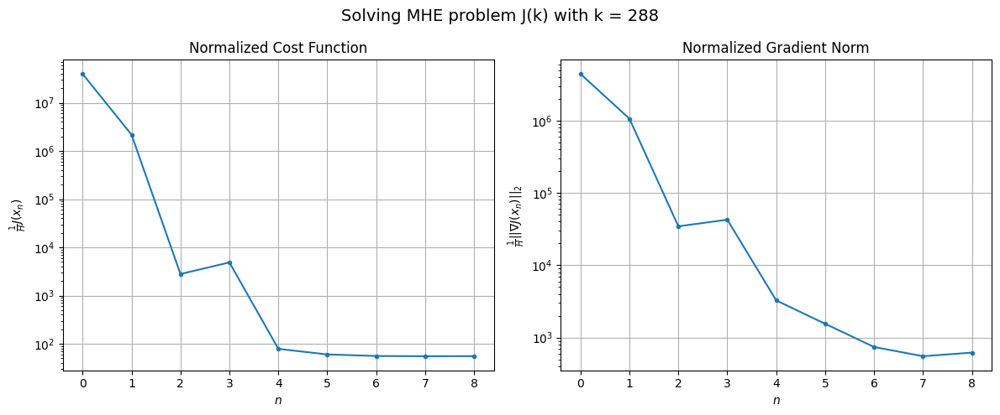

Windows:  73%|███████▎  | 280/386 [15:48<07:32,  4.27s/it]

[Gauss-Newton] Before applying the algorithm
Cost function: 955.8939886121364
Gradient norm: 202840.5347918918
Global estimation error: 3207.582415101469
Initial conditions estimation errors: 0.3822788141654235 m, 1295.8619109044548 m, 1848.757198423191 m, 2278.4690598145035 m
Position estimation errors: 3.3500675296732116 m, 822.4014569285036 m, 1421.6216987571718 m, 1223.7948778200678 m



/home/jgaspar/SpaceSim-Toolkit/test/new_newton_based_algorithms/gauss_newton.py:181: LinAlgWarning: Ill-conditioned matrix (rcond=1.8356e-17): result may not be accurate.
  delta_x = solve(HJ_x, -DJ_x)


[Gauss-Newton] Iteration 1
Cost function: 1480951508.7306013 (154928325.79%)
Gradient norm: 82771158.83764508 (40706.02%)
Global estimation error: 32066.19291655533 (899.70%)
Initial conditions estimation errors: 1.5352107002645183 m, 12894.707034965257 m, 18896.299297981335 m, 22469.915123649596 m
Position estimation errors: 1.8725541346250356 m, 10338.631569199948 m, 15956.74040478169 m, 16881.331040871693 m

[Gauss-Newton] Iteration 2
Cost function: 13231560.720227687 (-99.11%)
Gradient norm: 9384067.006720193 (-88.66%)
Global estimation error: 21504.67351904564 (-32.94%)
Initial conditions estimation errors: 1.5352102552987723 m, 8622.737074016808 m, 12459.85035971271 m, 15259.46839402923 m
Position estimation errors: 1.872554536226572 m, 5865.320255049122 m, 9269.789054949044 m, 9326.222580094392 m

[Gauss-Newton] Iteration 3
Cost function: 1064207.840629398 (-91.96%)
Gradient norm: 2332138.737054221 (-75.15%)
Global estimation error: 25377.45552182724 (18.01%)
Initial conditions 

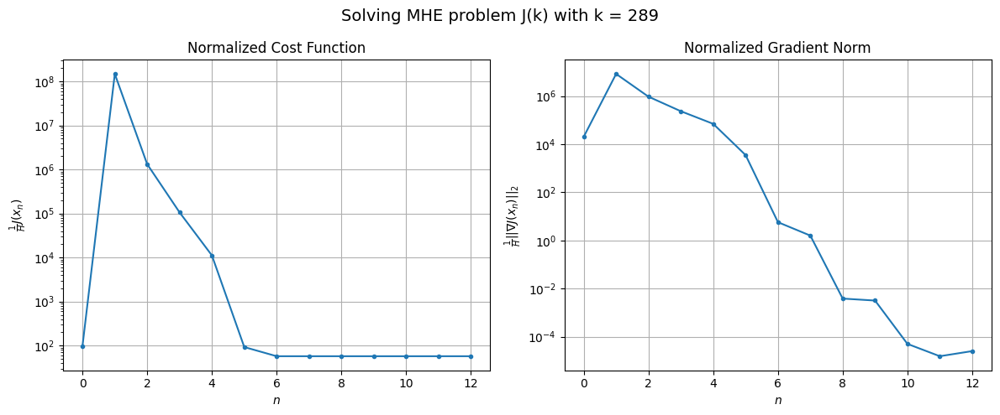

Windows:  73%|███████▎  | 281/386 [15:52<07:26,  4.25s/it]

[Gauss-Newton] Before applying the algorithm
Cost function: 1024.6350120135744
Gradient norm: 209079.66383209647
Global estimation error: 21717.413687955494
Initial conditions estimation errors: 0.44810450654084394 m, 8734.233378554636 m, 12695.788631395319 m, 15302.812046408946 m
Position estimation errors: 3.5643639639035163 m, 5756.046105192293 m, 9160.253845417506 m, 9057.93503971704 m

[Gauss-Newton] Iteration 1
Cost function: 40394186.08195098 (3942200.00%)
Gradient norm: 11675638.646815397 (5484.30%)
Global estimation error: 10552.406597435982 (-51.41%)
Initial conditions estimation errors: 1.663771328609748 m, 4249.517432657245 m, 6185.913544262519 m, 7418.17636927791 m
Position estimation errors: 2.0160936171914923 m, 2845.2077400213707 m, 4516.808008112089 m, 4306.768713972882 m

[Gauss-Newton] Iteration 2
Cost function: 247700.52508933743 (-99.39%)
Gradient norm: 828244.6047171698 (-92.91%)
Global estimation error: 6592.364915496261 (-37.53%)
Initial conditions estimation er

/home/jgaspar/SpaceSim-Toolkit/test/new_newton_based_algorithms/gauss_newton.py:181: LinAlgWarning: Ill-conditioned matrix (rcond=1.03018e-16): result may not be accurate.
  delta_x = solve(HJ_x, -DJ_x)


[Gauss-Newton] Iteration 3
Cost function: 14200.43702302332 (-94.27%)
Gradient norm: 278751.6381752641 (-66.34%)
Global estimation error: 5273.062693287941 (-20.01%)
Initial conditions estimation errors: 1.6637713232286173 m, 2141.6769197027334 m, 3124.417333952559 m, 3668.2992909357567 m
Position estimation errors: 2.016093635930658 m, 1487.817088261417 m, 2386.7210268073873 m, 2203.7142371937143 m



/home/jgaspar/SpaceSim-Toolkit/test/new_newton_based_algorithms/gauss_newton.py:181: LinAlgWarning: Ill-conditioned matrix (rcond=7.01868e-17): result may not be accurate.
  delta_x = solve(HJ_x, -DJ_x)


[Gauss-Newton] Iteration 4
Cost function: 2471.895742697202 (-82.59%)
Gradient norm: 91569.316450671 (-67.15%)
Global estimation error: 4356.334124301993 (-17.39%)
Initial conditions estimation errors: 1.6637713273509351 m, 1772.8129301814658 m, 2587.053400171042 m, 3023.562430316408 m
Position estimation errors: 2.016093628056048 m, 1190.3297079518147 m, 1934.6881204358156 m, 1704.9371360998243 m



/home/jgaspar/SpaceSim-Toolkit/test/new_newton_based_algorithms/gauss_newton.py:181: LinAlgWarning: Ill-conditioned matrix (rcond=5.46853e-17): result may not be accurate.
  delta_x = solve(HJ_x, -DJ_x)


[Gauss-Newton] Iteration 5
Cost function: 3248.4886864121017 (31.42%)
Gradient norm: 109382.63009980094 (19.45%)
Global estimation error: 3361.197222719098 (-22.84%)
Initial conditions estimation errors: 1.6637713298401142 m, 1372.6159859559768 m, 2002.3597418205823 m, 2324.676695109441 m
Position estimation errors: 2.016093621831539 m, 865.1147569421961 m, 1439.1663854625165 m, 1160.1794890158385 m



/home/jgaspar/SpaceSim-Toolkit/test/new_newton_based_algorithms/gauss_newton.py:181: LinAlgWarning: Ill-conditioned matrix (rcond=3.99796e-17): result may not be accurate.
  delta_x = solve(HJ_x, -DJ_x)


[Gauss-Newton] Iteration 6
Cost function: 8318.368433517117 (156.07%)
Gradient norm: 191419.88570483707 (75.00%)
Global estimation error: 2090.1051372597203 (-37.82%)
Initial conditions estimation errors: 1.6637713306674702 m, 860.9475398109802 m, 1249.3798122327196 m, 1437.481505662249 m
Position estimation errors: 2.016093618782954 m, 428.7399848735692 m, 773.0442873379649 m, 426.05147798127473 m



/home/jgaspar/SpaceSim-Toolkit/test/new_newton_based_algorithms/gauss_newton.py:181: LinAlgWarning: Ill-conditioned matrix (rcond=2.42632e-17): result may not be accurate.
  delta_x = solve(HJ_x, -DJ_x)


[Gauss-Newton] STOP on Iteration 7 (gradient norm stagnated)
Cost function = 46044.7064273954 (453.53%)
Gradient norm = 480845.5976497534 (151.20%)
Global estimation error = 226.69280258524088 (-89.15%)
Final initial conditions estimation errors: 1.6637713266169816 m, 109.40394459216225 m, 130.52271823052595 m, 149.590132890586 m
Final position estimation errors: 2.0160936124600832 m, 290.69529754196947 m, 307.2966061598949 m, 790.0851086752386 m



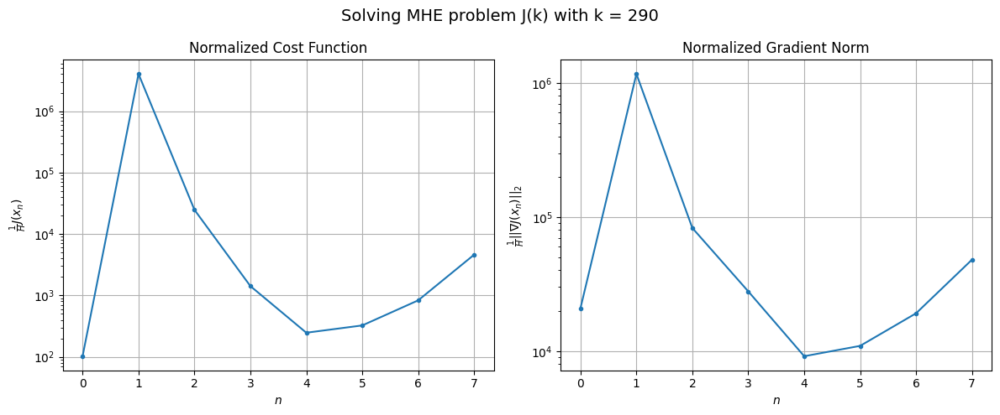

Windows:  73%|███████▎  | 282/386 [15:55<06:41,  3.86s/it]

[Gauss-Newton] Before applying the algorithm
Cost function: 45251.11650250321
Gradient norm: 508363.41893849464
Global estimation error: 143.96597469075766
Initial conditions estimation errors: 0.6006502933024663 m, 76.18889735257635 m, 91.81313184812552 m, 80.543008569112 m
Position estimation errors: 3.743438698161798 m, 327.4560086053239 m, 349.335626588144 m, 878.8174336371399 m



/home/jgaspar/SpaceSim-Toolkit/test/new_newton_based_algorithms/gauss_newton.py:181: LinAlgWarning: Ill-conditioned matrix (rcond=3.34838e-18): result may not be accurate.
  delta_x = solve(HJ_x, -DJ_x)


[Gauss-Newton] Iteration 1
Cost function: 15210493324.331184 (33613420.51%)
Gradient norm: 293320668.2926781 (57599.01%)
Global estimation error: 50389.47327577399 (34900.96%)
Initial conditions estimation errors: 1.803599944028993 m, 20431.346357977265 m, 30955.445891249576 m, 34108.92401231234 m
Position estimation errors: 2.1126239390856525 m, 21822.251497118596 m, 32747.14873847165 m, 38292.57315288021 m

[Gauss-Newton] Iteration 2
Cost function: 13285652192.719526 (-12.65%)
Gradient norm: 273935207.4663841 (-6.61%)
Global estimation error: 25252.898391515282 (-49.88%)
Initial conditions estimation errors: 1.8036009439850016 m, 10248.657552617733 m, 15485.744511990817 m, 17113.31169844849 m
Position estimation errors: 2.1126228484534426 m, 10766.625905878145 m, 16120.497373142554 m, 19065.144022230346 m



/home/jgaspar/SpaceSim-Toolkit/test/new_newton_based_algorithms/gauss_newton.py:181: LinAlgWarning: Ill-conditioned matrix (rcond=1.60239e-17): result may not be accurate.
  delta_x = solve(HJ_x, -DJ_x)


[Gauss-Newton] STOP on Iteration 3 (gradient norm stagnated)
Cost function = 17979055193.73696 (35.33%)
Gradient norm = 319122689.7010575 (16.50%)
Global estimation error = 53566.22755723916 (112.12%)
Final initial conditions estimation errors: 1.8036036635239086 m, 21761.364996921922 m, 33096.131514528875 m, 36061.45971537226 m
Final position estimation errors: 2.1126206463923736 m, 23419.361789485953 m, 35159.00981801578 m, 40919.52657088765 m



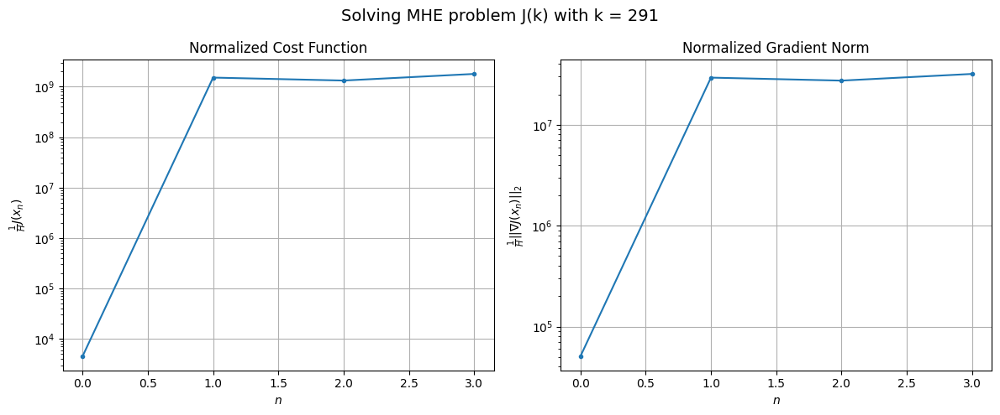

Windows:  73%|███████▎  | 283/386 [15:57<05:36,  3.27s/it]

[Gauss-Newton] Before applying the algorithm
Cost function: 18280855483.069298
Gradient norm: 318521792.08878064
Global estimation error: 55119.89153939003
Initial conditions estimation errors: 0.6810050498867526 m, 22349.39550044515 m, 33922.94611299326 m, 37255.06635591677 m
Position estimation errors: 3.847943634376151 m, 23089.888798752574 m, 34630.48224733206 m, 40609.98828378712 m

[Gauss-Newton] Iteration 1
Cost function: 5916428712.408967 (-67.64%)
Gradient norm: 176489058.87468132 (-44.59%)
Global estimation error: 19803.181092651157 (-64.07%)
Initial conditions estimation errors: 1.9265391054834584 m, 8009.984651898918 m, 12102.383630626182 m, 13473.615054535445 m
Position estimation errors: 2.1652698999126323 m, 7741.3698971247195 m, 11596.232186482712 m, 13680.022461825114 m

[Gauss-Newton] Iteration 2
Cost function: 344781108.1451036 (-94.17%)
Gradient norm: 44598212.87251024 (-74.73%)
Global estimation error: 22255.140368315115 (12.38%)
Initial conditions estimation error

/home/jgaspar/SpaceSim-Toolkit/test/new_newton_based_algorithms/gauss_newton.py:181: LinAlgWarning: Ill-conditioned matrix (rcond=4.29501e-17): result may not be accurate.
  delta_x = solve(HJ_x, -DJ_x)


[Gauss-Newton] Iteration 7
Cost function: 1195.4117732626623 (-99.58%)
Gradient norm: 45311.95955333883 (-96.74%)
Global estimation error: 2613.5074437518924 (23.93%)
Initial conditions estimation errors: 1.9265382790226193 m, 1038.5997573759366 m, 1317.0011232643096 m, 2004.304124106782 m
Position estimation errors: 2.1652708125779294 m, 655.874147108828 m, 985.5524730308565 m, 1220.203207584349 m



/home/jgaspar/SpaceSim-Toolkit/test/new_newton_based_algorithms/gauss_newton.py:181: LinAlgWarning: Ill-conditioned matrix (rcond=6.63531e-17): result may not be accurate.
  delta_x = solve(HJ_x, -DJ_x)


[Gauss-Newton] Iteration 8
Cost function: 2704.777436554936 (126.26%)
Gradient norm: 103818.74123685676 (129.12%)
Global estimation error: 1839.0287590135842 (-29.63%)
Initial conditions estimation errors: 1.9265382788041707 m, 719.3575562882344 m, 831.5662286383747 m, 1474.124633242422 m
Position estimation errors: 2.165270808421323 m, 314.3656364230645 m, 472.02589074827875 m, 612.5728738843861 m



/home/jgaspar/SpaceSim-Toolkit/test/new_newton_based_algorithms/gauss_newton.py:181: LinAlgWarning: Ill-conditioned matrix (rcond=3.28568e-17): result may not be accurate.
  delta_x = solve(HJ_x, -DJ_x)


[Gauss-Newton] Iteration 9
Cost function: 33103.10338701286 (1123.88%)
Gradient norm: 431713.2952535938 (315.83%)
Global estimation error: 3428.743529296398 (86.44%)
Initial conditions estimation errors: 1.9265382791099988 m, 1372.5857947015165 m, 1823.8469129838452 m, 2558.4895380777216 m
Position estimation errors: 2.1652708125426803 m, 1011.6485788253134 m, 1519.9774493329137 m, 1850.011976900557 m

[Gauss-Newton] STOP on Iteration 10 (gradient norm stagnated)
Cost function = 59422.9008156838 (79.51%)
Gradient norm = 584115.3246509345 (35.30%)
Global estimation error = 1601.283497373067 (-53.30%)
Final initial conditions estimation errors: 1.9265382802326525 m, 620.3067930572194 m, 679.6639542786533 m, 1310.488104713207 m
Final position estimation errors: 2.1652708068200344 m, 200.56171853869552 m, 301.19117685456905 m, 405.43782381735775 m



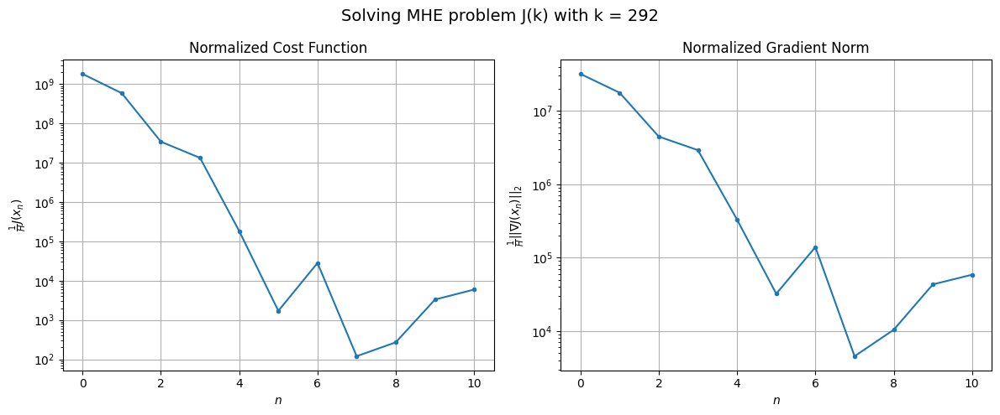

Windows:  74%|███████▎  | 284/386 [16:01<05:52,  3.45s/it]

[Gauss-Newton] Before applying the algorithm
Cost function: 61944.6790094319
Gradient norm: 620453.9118070042
Global estimation error: 1504.8063976961603
Initial conditions estimation errors: 0.6887799560451244 m, 582.230570670577 m, 646.5281204061054 m, 1227.7817233823291 m
Position estimation errors: 3.8697311773223237 m, 148.04828230148712 m, 250.70551600130938 m, 291.40241427871615 m



/home/jgaspar/SpaceSim-Toolkit/test/new_newton_based_algorithms/gauss_newton.py:181: LinAlgWarning: Ill-conditioned matrix (rcond=3.9287e-17): result may not be accurate.
  delta_x = solve(HJ_x, -DJ_x)


[Gauss-Newton] Iteration 1
Cost function: 72678700.11454187 (117228.40%)
Gradient norm: 20286637.54822486 (3169.64%)
Global estimation error: 12857.326848607203 (754.42%)
Initial conditions estimation errors: 2.0019105695944823 m, 5175.402980581025 m, 7713.498901606025 m, 8889.767857028613 m
Position estimation errors: 2.1160691913096845 m, 4969.899905361653 m, 7413.756826860438 m, 8871.219508357279 m

[Gauss-Newton] Iteration 2
Cost function: 3588257.3182285796 (-95.06%)
Gradient norm: 4393188.015723934 (-78.34%)
Global estimation error: 7056.714433042014 (-45.12%)
Initial conditions estimation errors: 2.0019105717602583 m, 2831.821331548301 m, 4164.04430576371 m, 4943.55477035718 m
Position estimation errors: 2.1160691995732814 m, 2657.1774772782687 m, 3946.618312884341 m, 4770.7524983609355 m

[Gauss-Newton] Iteration 3
Cost function: 1936.4164000697135 (-99.95%)
Gradient norm: 65277.498725907964 (-98.51%)
Global estimation error: 6223.21906597992 (-11.81%)
Initial conditions estima

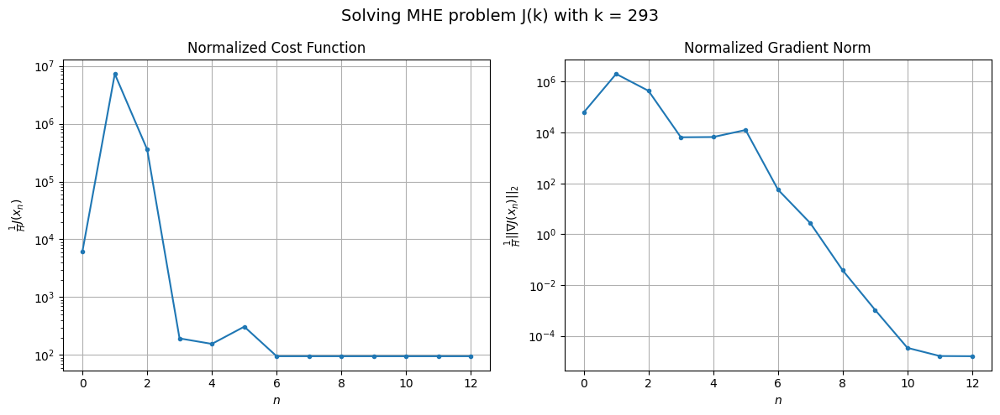

Windows:  74%|███████▍  | 285/386 [16:04<06:02,  3.59s/it]

[Gauss-Newton] Before applying the algorithm
Cost function: 1484.9329440251358
Gradient norm: 237811.32507795547
Global estimation error: 7190.386869606656
Initial conditions estimation errors: 0.6317609927835858 m, 2925.0273088285485 m, 4316.768136431366 m, 4950.896446125557 m
Position estimation errors: 3.840054183505262 m, 3065.8230171657156 m, 4548.893733760911 m, 5616.125312276099 m

[Gauss-Newton] Iteration 1
Cost function: 1834388.6293467665 (123433.43%)
Gradient norm: 3464526.89679136 (1356.84%)
Global estimation error: 3358.727373645462 (-53.29%)
Initial conditions estimation errors: 2.0588360339794383 m, 1358.6543778530643 m, 1950.4477606492383 m, 2372.942666129893 m
Position estimation errors: 2.0635968298294936 m, 1067.225365590396 m, 1582.998144030543 m, 1792.0300834109112 m

[Gauss-Newton] Iteration 2
Cost function: 615699.9379902742 (-66.44%)
Gradient norm: 2006118.1513173003 (-42.10%)
Global estimation error: 491.665456387463 (-85.36%)
Initial conditions estimation erro

/home/jgaspar/SpaceSim-Toolkit/test/new_newton_based_algorithms/gauss_newton.py:181: LinAlgWarning: Ill-conditioned matrix (rcond=1.35926e-17): result may not be accurate.
  delta_x = solve(HJ_x, -DJ_x)


[Gauss-Newton] STOP on Iteration 3 (gradient norm stagnated)
Cost function = 13775568.533848448 (2137.38%)
Gradient norm = 8705916.013811484 (333.97%)
Global estimation error = 8050.2574448692785 (1537.34%)
Final initial conditions estimation errors: 2.058836004939326 m, 3208.10326150187 m, 4759.265082100591 m, 5644.830336186127 m
Final position estimation errors: 2.063596921453794 m, 2556.750436109131 m, 3812.128374812871 m, 4423.977791397952 m



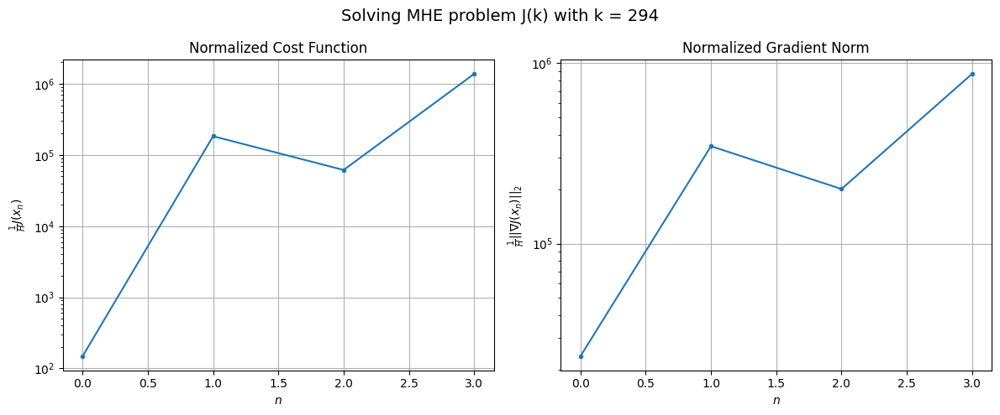

Windows:  74%|███████▍  | 286/386 [16:06<05:03,  3.03s/it]

[Gauss-Newton] Before applying the algorithm
Cost function: 13790437.456539474
Gradient norm: 8565226.20182557
Global estimation error: 7998.436397463285
Initial conditions estimation errors: 0.6124585529941396 m, 3189.6024491139146 m, 4733.08344627904 m, 5603.511418949586 m
Position estimation errors: 3.920566861501595 m, 2422.5551575300287 m, 3615.650650966382 m, 4180.4351998614575 m

[Gauss-Newton] Iteration 1
Cost function: 3340062.6272309273 (-75.78%)
Gradient norm: 3943971.188530528 (-53.95%)
Global estimation error: 2155.5788663612193 (-73.05%)
Initial conditions estimation errors: 2.110430143404093 m, 869.7772937177278 m, 1197.2166328869275 m, 1567.3779243327972 m
Position estimation errors: 2.094316103781771 m, 468.37495609360303 m, 706.7187714079663 m, 692.7790834108813 m

[Gauss-Newton] STOP on Iteration 2 (gradient norm stagnated)
Cost function = 2240370.886870735 (-32.92%)
Gradient norm = 3595307.642610611 (-8.84%)
Global estimation error = 2592.271546062434 (20.26%)
Final

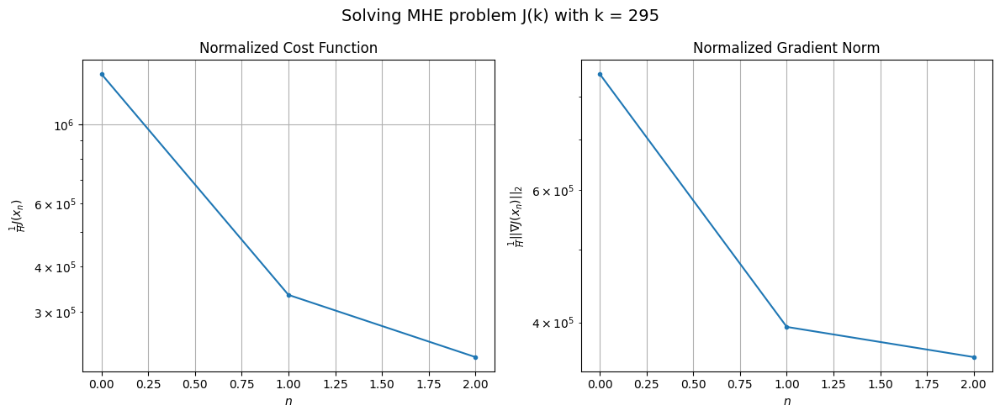

Windows:  74%|███████▍  | 287/386 [16:08<04:12,  2.55s/it]

[Gauss-Newton] Before applying the algorithm
Cost function: 2303110.943286772
Gradient norm: 3582961.109748674
Global estimation error: 2811.1323262666997
Initial conditions estimation errors: 0.6584995607244564 m, 1125.6268790652493 m, 1789.9669657348236 m, 1852.412795197993 m
Position estimation errors: 4.153657702263494 m, 1568.105925219107 m, 2306.9662841331246 m, 3107.356653413174 m



/home/jgaspar/SpaceSim-Toolkit/test/new_newton_based_algorithms/gauss_newton.py:181: LinAlgWarning: Ill-conditioned matrix (rcond=8.52855e-17): result may not be accurate.
  delta_x = solve(HJ_x, -DJ_x)


[Gauss-Newton] Iteration 1
Cost function: 831569.3283568233 (-63.89%)
Gradient norm: 2004961.7970490754 (-44.04%)
Global estimation error: 1339.2115947686068 (-52.36%)
Initial conditions estimation errors: 2.14355009809264 m, 451.70248523558126 m, 555.5658465777078 m, 1131.7173754435978 m
Position estimation errors: 2.2853917234477232 m, 229.02093737497233 m, 367.8126426602688 m, 405.6203421925573 m

[Gauss-Newton] Iteration 2
Cost function: 27504042.947862692 (3207.49%)
Gradient norm: 12228772.091034802 (509.93%)
Global estimation error: 7924.756994729055 (491.75%)
Initial conditions estimation errors: 2.143550180590914 m, 3226.127311013166 m, 4965.436109136509 m, 5266.713608896275 m
Position estimation errors: 2.285391678232551 m, 3794.566456254158 m, 5628.367065429705 m, 7123.1563711614235 m

[Gauss-Newton] Iteration 3
Cost function: 2992211.1206104057 (-89.12%)
Gradient norm: 4091182.3994149016 (-66.54%)
Global estimation error: 2673.4577187933705 (-66.26%)
Initial conditions estim

/home/jgaspar/SpaceSim-Toolkit/test/new_newton_based_algorithms/gauss_newton.py:181: LinAlgWarning: Ill-conditioned matrix (rcond=9.14635e-17): result may not be accurate.
  delta_x = solve(HJ_x, -DJ_x)


[Gauss-Newton] Iteration 4
Cost function: 22640.461754574604 (-99.24%)
Gradient norm: 343286.8650556839 (-91.61%)
Global estimation error: 1129.628502395588 (-57.75%)
Initial conditions estimation errors: 2.1435501110853235 m, 506.6025358960115 m, 850.3886251655334 m, 544.2753571333469 m
Position estimation errors: 2.2853917615235835 m, 1066.417491509195 m, 1621.7815683918125 m, 1926.8338522446593 m



/home/jgaspar/SpaceSim-Toolkit/test/new_newton_based_algorithms/gauss_newton.py:181: LinAlgWarning: Ill-conditioned matrix (rcond=4.00119e-17): result may not be accurate.
  delta_x = solve(HJ_x, -DJ_x)


[Gauss-Newton] Iteration 5
Cost function: 17206669.108766705 (75899.64%)
Gradient norm: 9745076.170751177 (2738.76%)
Global estimation error: 9158.069839983566 (710.72%)
Initial conditions estimation errors: 2.1435500748087764 m, 3729.336610407659 m, 5718.9170636312565 m, 6103.787846756724 m
Position estimation errors: 2.2853917964110733 m, 4274.465012254812 m, 6358.013235476882 m, 7958.528367239468 m

[Gauss-Newton] Iteration 6
Cost function: 4082932.470389354 (-76.27%)
Gradient norm: 4750300.9244681345 (-51.25%)
Global estimation error: 3521.108949174439 (-61.55%)
Initial conditions estimation errors: 2.1435501650803293 m, 1466.176404302432 m, 2307.6434090508315 m, 2218.8490070688886 m
Position estimation errors: 2.2853916999818673 m, 2018.9769119699945 m, 3019.062897844808 m, 3744.6694916218776 m

[Gauss-Newton] STOP on Iteration 7 (gradient norm stagnated)
Cost function = 349817.1586892599 (-91.43%)
Gradient norm = 1384480.6622373448 (-70.85%)
Global estimation error = 542.99866821

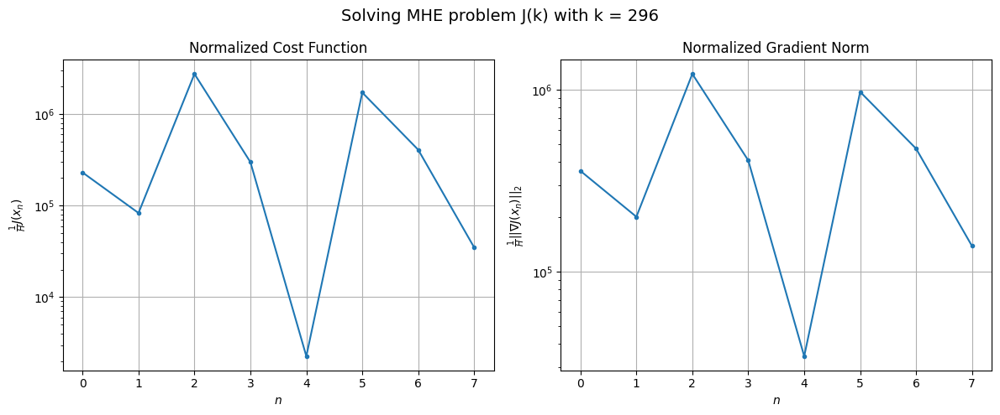

Windows:  75%|███████▍  | 288/386 [16:10<04:17,  2.63s/it]

[Gauss-Newton] Before applying the algorithm
Cost function: 350693.58353351156
Gradient norm: 1368329.8460133364
Global estimation error: 699.8005947360947
Initial conditions estimation errors: 0.7201362250464264 m, 321.769400866796 m, 559.5091559551531 m, 270.4127017084546 m
Position estimation errors: 4.540947344512647 m, 856.9264118055088 m, 1299.5050502026465 m, 1577.798445093963 m



/home/jgaspar/SpaceSim-Toolkit/test/new_newton_based_algorithms/gauss_newton.py:181: LinAlgWarning: Ill-conditioned matrix (rcond=6.34787e-17): result may not be accurate.
  delta_x = solve(HJ_x, -DJ_x)


[Gauss-Newton] Iteration 1
Cost function: 7838110.603093881 (2135.03%)
Gradient norm: 6680449.243036098 (388.22%)
Global estimation error: 5836.420716620516 (734.01%)
Initial conditions estimation errors: 2.2297513575424173 m, 2277.9172893104874 m, 3347.6633848578977 m, 4203.337284567394 m
Position estimation errors: 2.5625917859314633 m, 1828.3042681752772 m, 2641.7415450140243 m, 3511.7365984682583 m

[Gauss-Newton] Iteration 2
Cost function: 97588.8648374485 (-98.75%)
Gradient norm: 720833.0439565805 (-89.21%)
Global estimation error: 3542.2823731623116 (-39.31%)
Initial conditions estimation errors: 2.22975131981489 m, 1359.5280007417223 m, 1970.3236509881685 m, 2610.98961510434 m
Position estimation errors: 2.5625918636828513 m, 941.4780932313563 m, 1333.5478933945112 m, 1832.1044127592504 m

[Gauss-Newton] Iteration 3
Cost function: 1020.0870629790061 (-98.95%)
Gradient norm: 15656.035750304716 (-97.83%)
Global estimation error: 3226.5475829210322 (-8.91%)
Initial conditions esti

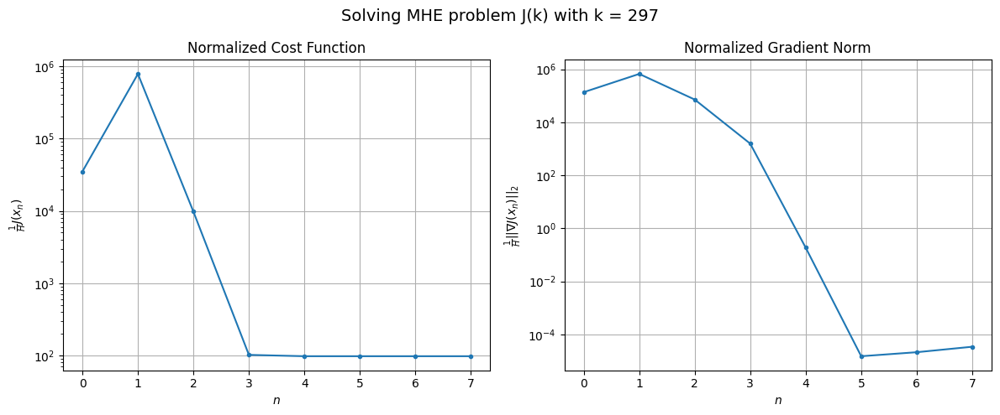

Windows:  75%|███████▍  | 289/386 [16:13<04:20,  2.68s/it]

[Gauss-Newton] Before applying the algorithm
Cost function: 1985.8389254222222
Gradient norm: 305066.0329300226
Global estimation error: 3150.297735490062
Initial conditions estimation errors: 0.7907525383253093 m, 1205.378555707317 m, 1736.3910768969015 m, 2335.8899569288515 m
Position estimation errors: 4.981824555355909 m, 743.1619686500777 m, 1044.4136393728809 m, 1447.720603823453 m

[Gauss-Newton] Iteration 1
Cost function: 3394767.305311557 (170848.77%)
Gradient norm: 4210155.404760511 (1280.08%)
Global estimation error: 2422.7760196115896 (-23.09%)
Initial conditions estimation errors: 2.398036236976511 m, 972.5336065192326 m, 1551.4347465745211 m, 1586.5238820775844 m
Position estimation errors: 2.802024899131442 m, 1285.1934533157087 m, 1857.68004784124 m, 2590.6845685091203 m



/home/jgaspar/SpaceSim-Toolkit/test/new_newton_based_algorithms/gauss_newton.py:181: LinAlgWarning: Ill-conditioned matrix (rcond=7.6208e-17): result may not be accurate.
  delta_x = solve(HJ_x, -DJ_x)


[Gauss-Newton] Iteration 2
Cost function: 66209.09767792985 (-98.05%)
Gradient norm: 583805.9251078379 (-86.13%)
Global estimation error: 4419.632185509886 (82.42%)
Initial conditions estimation errors: 2.3980361261818994 m, 1764.5071393783878 m, 2750.1595969638606 m, 2975.9481262773284 m
Position estimation errors: 2.802025075330593 m, 2028.4334151017558 m, 2950.872692312251 m, 4006.9556703583094 m

[Gauss-Newton] Iteration 3
Cost function: 546094.7779210322 (724.80%)
Gradient norm: 1714825.469280655 (193.73%)
Global estimation error: 1017.2131710957336 (-76.98%)
Initial conditions estimation errors: 2.3980361874047884 m, 414.7167120372351 m, 723.3721275719853 m, 582.6272856459135 m
Position estimation errors: 2.8020250002477862 m, 727.2983523596281 m, 1053.5979157681809 m, 1466.1226727236744 m



/home/jgaspar/SpaceSim-Toolkit/test/new_newton_based_algorithms/gauss_newton.py:181: LinAlgWarning: Ill-conditioned matrix (rcond=9.75084e-17): result may not be accurate.
  delta_x = solve(HJ_x, -DJ_x)


[Gauss-Newton] Iteration 4
Cost function: 15312523.913224336 (2704.00%)
Gradient norm: 9163495.615262147 (434.37%)
Global estimation error: 8866.765792997547 (771.67%)
Initial conditions estimation errors: 2.3980361745634466 m, 3521.1401022170417 m, 5379.644798548083 m, 6105.775469754753 m
Position estimation errors: 2.8020250155124105 m, 3777.7127613568014 m, 5488.623518029098 m, 7470.053911795813 m

[Gauss-Newton] STOP on Iteration 5 (gradient norm stagnated)
Cost function = 2731416.961668177 (-82.16%)
Gradient norm = 3868441.087917742 (-57.78%)
Global estimation error = 3709.2259554628877 (-58.17%)
Final initial conditions estimation errors: 2.3980362209217163 m, 1482.9124941621408 m, 2324.5409568921855 m, 2481.0924902592774 m
Final position estimation errors: 2.802024959226824 m, 1777.0153607300547 m, 2579.3742538219435 m, 3535.4580052924216 m



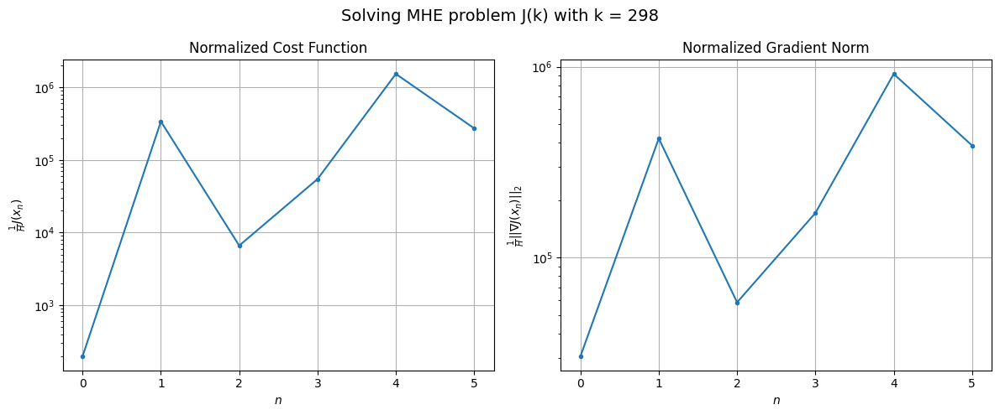

Windows:  75%|███████▌  | 290/386 [16:16<04:08,  2.59s/it]

[Gauss-Newton] Before applying the algorithm
Cost function: 2729413.43285196
Gradient norm: 3792709.848649105
Global estimation error: 3891.919425340485
Initial conditions estimation errors: 0.8905171876376132 m, 1543.8996605528364 m, 2396.6247365460426 m, 2649.4508944368504 m
Position estimation errors: 5.3754395091618346 m, 1772.460685513994 m, 2551.4690556933847 m, 3581.455106669766 m

[Gauss-Newton] Iteration 1
Cost function: 2108.6329829789465 (-99.92%)
Gradient norm: 64972.81975206636 (-98.29%)
Global estimation error: 4345.913017534071 (11.67%)
Initial conditions estimation errors: 2.6228485653609765 m, 1738.321865322981 m, 2640.8714332897093 m, 2981.773675914142 m
Position estimation errors: 3.0154977038361093 m, 2015.2688179360196 m, 2943.8140749537256 m, 4100.352149252054 m

[Gauss-Newton] Iteration 2
Cost function: 1489.1004857441108 (-29.38%)
Gradient norm: 1163.5233870321554 (-98.21%)
Global estimation error: 4444.0056519663 (2.26%)
Initial conditions estimation errors: 2.

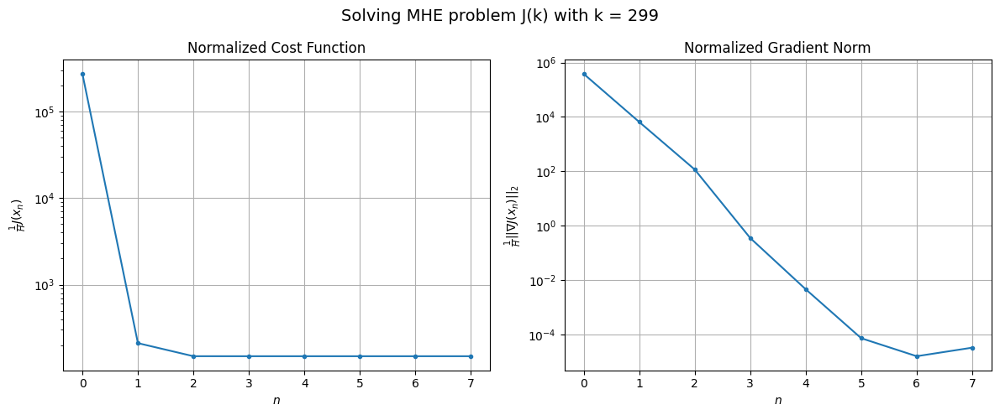

Windows:  75%|███████▌  | 291/386 [16:18<04:08,  2.62s/it]

[Gauss-Newton] Before applying the algorithm
Cost function: 2773.2196184727172
Gradient norm: 349991.79287016427
Global estimation error: 4654.777008153348
Initial conditions estimation errors: 1.0191977173432532 m, 1842.4170459704455 m, 2782.328287580821 m, 3245.1633103295035 m
Position estimation errors: 5.784742584382374 m, 2034.9094043473312 m, 2958.9735502053036 m, 4207.943925643992 m

[Gauss-Newton] Iteration 1
Cost function: 53204992.597688094 (1918427.92%)
Gradient norm: 17005471.655488383 (4758.82%)
Global estimation error: 6282.357798194687 (34.97%)
Initial conditions estimation errors: 2.83378338479957 m, 2440.33691583503 m, 3524.54803485409 m, 4592.420663587257 m
Position estimation errors: 3.3061888615287125 m, 2058.6360492354347 m, 2954.874325544426 m, 4243.718019233635 m

[Gauss-Newton] Iteration 2
Cost function: 7428711.050976696 (-86.04%)
Gradient norm: 6314579.643682358 (-62.87%)
Global estimation error: 925.6519257510362 (-85.27%)
Initial conditions estimation errors

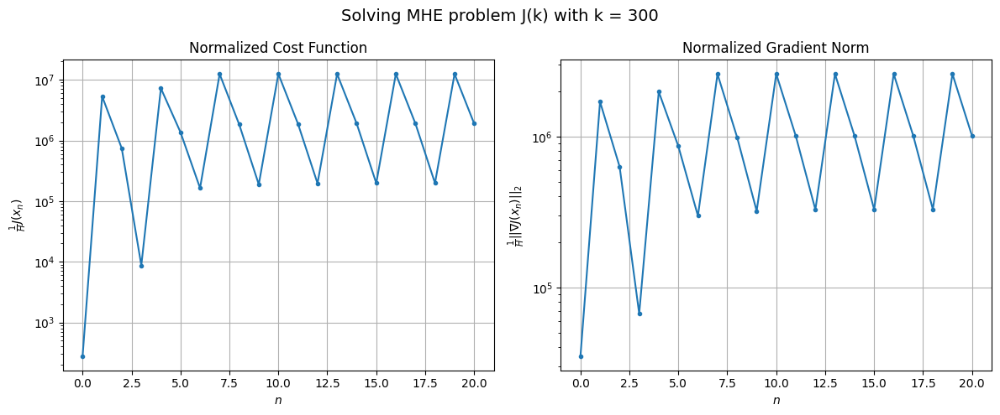

Windows:  76%|███████▌  | 292/386 [16:24<05:46,  3.69s/it]

[Gauss-Newton] Before applying the algorithm
Cost function: 18794503.22184779
Gradient norm: 9877551.746394543
Global estimation error: 1652.4960071086707
Initial conditions estimation errors: 1.1023503758135726 m, 629.313357279123 m, 851.8273156572026 m, 1268.5014987106215 m
Position estimation errors: 6.334590977747246 m, 420.8069238752792 m, 604.127290765166 m, 908.1482335502744 m

[Gauss-Newton] Iteration 1
Cost function: 189651.18065712132 (-98.99%)
Gradient norm: 994089.0289279817 (-89.94%)
Global estimation error: 1423.4503309544198 (-13.86%)
Initial conditions estimation errors: 3.098932736103437 m, 558.424686662722 m, 878.5525771545593 m, 970.827367581215 m
Position estimation errors: 3.6019611546312484 m, 726.1137194371297 m, 1052.7868451963125 m, 1527.3885558338889 m

[Gauss-Newton] Iteration 2
Cost function: 6037.95183584162 (-96.82%)
Gradient norm: 141095.34711485868 (-85.81%)
Global estimation error: 2450.637509033504 (72.16%)
Initial conditions estimation errors: 3.09893

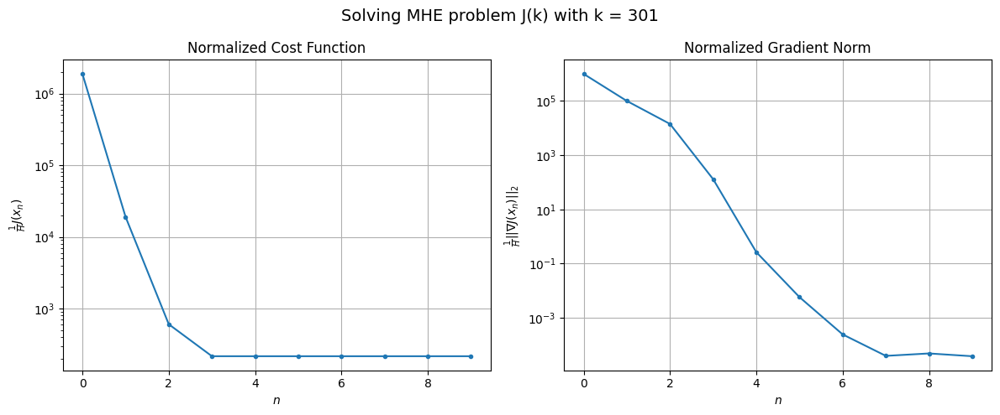

Windows:  76%|███████▌  | 293/386 [16:28<05:31,  3.56s/it]

[Gauss-Newton] Before applying the algorithm
Cost function: 4000.8252255203147
Gradient norm: 424671.5285098786
Global estimation error: 2658.860197110715
Initial conditions estimation errors: 1.1514785635696299 m, 1021.2038132666873 m, 1545.3728720350712 m, 1907.4849103597073 m
Position estimation errors: 6.953541415307827 m, 1100.2313793299934 m, 1565.0727831570766 m, 2366.664552104514 m

[Gauss-Newton] Iteration 1
Cost function: 264410.1611589466 (6508.89%)
Gradient norm: 1124313.7960715175 (164.75%)
Global estimation error: 5725.229837275756 (115.33%)
Initial conditions estimation errors: 3.414258354608597 m, 2182.4350805336703 m, 3233.092540080306 m, 4190.743373965995 m
Position estimation errors: 3.9243816988193463 m, 2078.434095964546 m, 2931.922465617726 m, 4494.712087086902 m

[Gauss-Newton] Iteration 2
Cost function: 20058.282251798166 (-92.41%)
Gradient norm: 308568.18943543604 (-72.55%)
Global estimation error: 4258.378433263322 (-25.62%)
Initial conditions estimation error

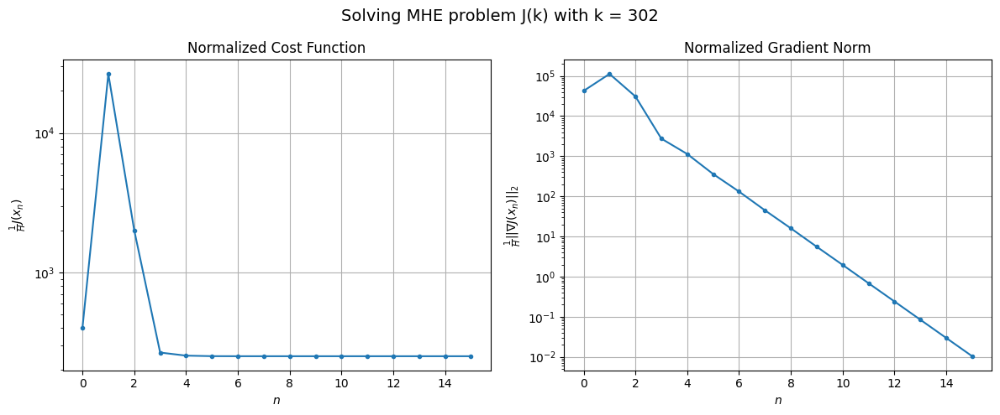

Windows:  76%|███████▌  | 294/386 [16:33<06:05,  3.97s/it]

[Gauss-Newton] Before applying the algorithm
Cost function: 4870.142375643757
Gradient norm: 479379.0684371741
Global estimation error: 4624.530512249587
Initial conditions estimation errors: 1.2178332675249246 m, 1751.4608111385471 m, 2590.899629568525 m, 3406.7438061251437 m
Position estimation errors: 7.642502512044619 m, 1580.8895540626036 m, 2223.4772123777957 m, 3448.356697112858 m

[Gauss-Newton] Iteration 1
Cost function: 139014.0287748353 (2754.41%)
Gradient norm: 804069.544777852 (67.73%)
Global estimation error: 2027.090357196487 (-56.17%)
Initial conditions estimation errors: 3.7380656423868652 m, 743.2443214479459 m, 1109.1442543549583 m, 1525.2761350922017 m
Position estimation errors: 4.2469735589299455 m, 760.2184938086426 m, 1030.8775494867773 m, 1726.9633330272727 m

[Gauss-Newton] Iteration 2
Cost function: 1706645.3696449494 (1127.68%)
Gradient norm: 3128528.0731498376 (289.09%)
Global estimation error: 2398.3057236616364 (18.31%)
Initial conditions estimation error

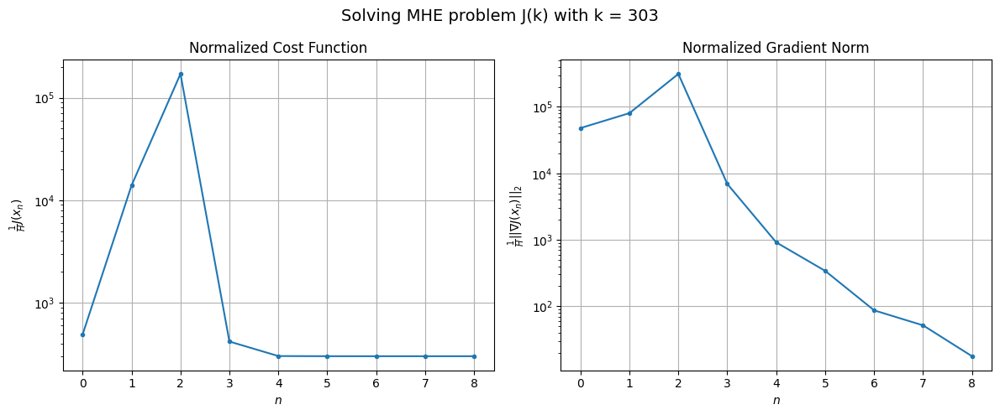

Windows:  76%|███████▋  | 295/386 [16:36<05:38,  3.72s/it]

[Gauss-Newton] Before applying the algorithm
Cost function: 5804.3624771477225
Gradient norm: 523989.62632453826
Global estimation error: 1521.4828551137086
Initial conditions estimation errors: 1.315491079964659 m, 601.835354860701 m, 853.9312053019237 m, 1106.1203804592456 m
Position estimation errors: 8.335066201128045 m, 664.904394700987 m, 926.8026592014724 m, 1516.7081193400188 m

[Gauss-Newton] Iteration 1
Cost function: 55505.520234259406 (856.27%)
Gradient norm: 462181.0320868839 (-11.80%)
Global estimation error: 3714.42409859961 (144.13%)
Initial conditions estimation errors: 4.040303817512488 m, 1391.3166270272793 m, 1958.5455323437898 m, 2832.8900738683005 m
Position estimation errors: 4.6310332002540555 m, 1233.095454476234 m, 1675.7432252682038 m, 2895.8259687339305 m

[Gauss-Newton] Iteration 2
Cost function: 3606.780512822542 (-93.50%)
Gradient norm: 228.15122655674872 (-99.95%)
Global estimation error: 3653.614622269449 (-1.64%)
Initial conditions estimation errors: 4

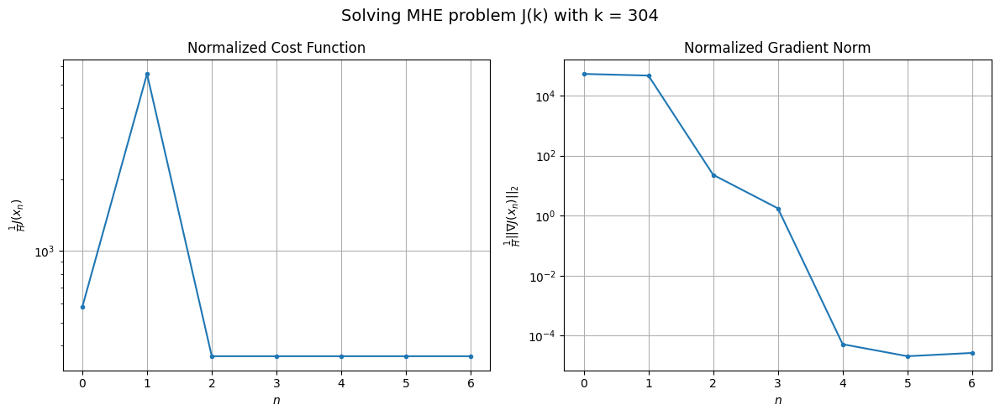

Windows:  77%|███████▋  | 296/386 [16:38<04:57,  3.31s/it]

[Gauss-Newton] Before applying the algorithm
Cost function: 6889.1962365049
Gradient norm: 567607.5353481832
Global estimation error: 3725.2296814854417
Initial conditions estimation errors: 1.4638873267239108 m, 1387.4931033139715 m, 1945.752266406332 m, 2857.664040675292 m
Position estimation errors: 9.026068905914371 m, 1215.1155970386271 m, 1643.415410228994 m, 2912.853770170835 m

[Gauss-Newton] Iteration 1
Cost function: 81379.0349597484 (1081.26%)
Gradient norm: 648706.57923699 (14.29%)
Global estimation error: 1607.6799286228927 (-56.84%)
Initial conditions estimation errors: 4.450959496835619 m, 599.0077517159253 m, 823.6968300984771 m, 1243.9164412825687 m
Position estimation errors: 4.993273470119933 m, 467.98496773927855 m, 632.8052544414866 m, 1129.2927367031602 m

[Gauss-Newton] Iteration 2
Cost function: 4355.802006994109 (-94.65%)
Gradient norm: 21834.946549401095 (-96.63%)
Global estimation error: 1185.0672991086687 (-26.29%)
Initial conditions estimation errors: 4.450

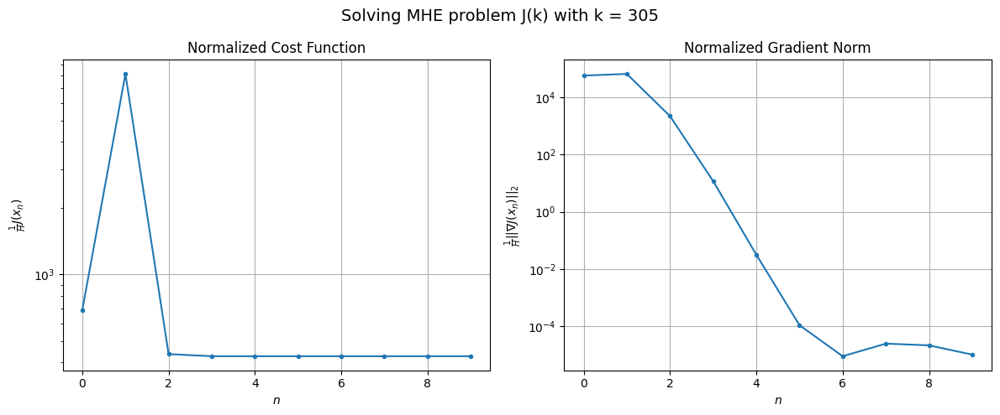

Windows:  77%|███████▋  | 297/386 [16:41<04:48,  3.24s/it]

[Gauss-Newton] Before applying the algorithm
Cost function: 7986.70754805618
Gradient norm: 606028.0532837727
Global estimation error: 1149.9710101135229
Initial conditions estimation errors: 1.7014126752461123 m, 428.6683118555619 m, 583.3593130265693 m, 893.5131642916856 m
Position estimation errors: 9.566035525764637 m, 303.86877666005034 m, 415.18544465921156 m, 750.8892516450185 m

[Gauss-Newton] Iteration 1
Cost function: 28069.240632355923 (251.45%)
Gradient norm: 390093.0346440455 (-35.63%)
Global estimation error: 171.09981207802977 (-85.12%)
Initial conditions estimation errors: 4.849592280793463 m, 67.60862769369116 m, 146.80394503311766 m, 55.91601633882778 m
Position estimation errors: 5.289677790336087 m, 326.71528890614115 m, 430.398100987983 m, 770.6121955094358 m

[Gauss-Newton] Iteration 2
Cost function: 5096.434097735654 (-81.84%)
Gradient norm: 15997.051912918227 (-95.90%)
Global estimation error: 202.25989869610243 (18.21%)
Initial conditions estimation errors: 4.8

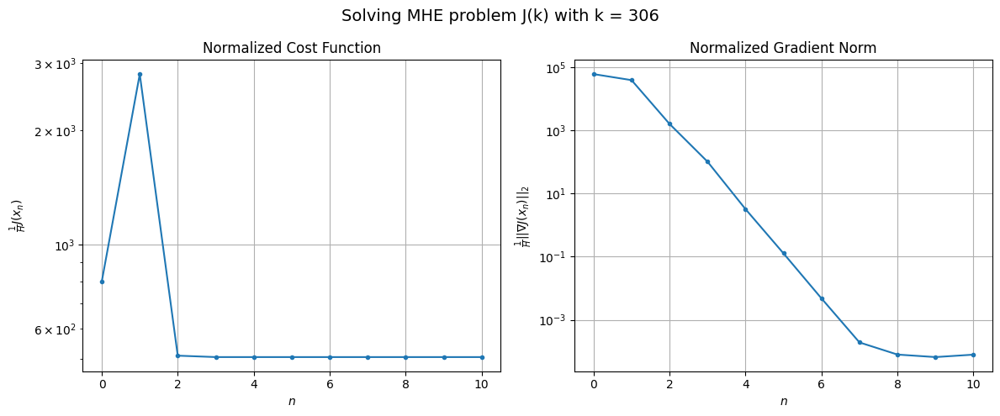

Windows:  77%|███████▋  | 298/386 [16:45<04:51,  3.32s/it]

[Gauss-Newton] Before applying the algorithm
Cost function: 8969.912219160604
Gradient norm: 630557.1513371991
Global estimation error: 87.34951207419665
Initial conditions estimation errors: 1.8724724387921203 m, 12.927911378369839 m, 62.097640230208654 m, 60.008585361541435 m
Position estimation errors: 9.910064578204368 m, 256.4212954637548 m, 333.3535102294703 m, 597.057081268726 m

[Gauss-Newton] Iteration 1
Cost function: 19807.590389735622 (120.82%)
Gradient norm: 212686.9207238659 (-66.27%)
Global estimation error: 1701.3585418194114 (1847.76%)
Initial conditions estimation errors: 5.221262796235218 m, 599.1286877544312 m, 834.3982203178539 m, 1356.2512411478388 m
Position estimation errors: 5.443323412149497 m, 581.9456972571414 m, 735.5242790097407 m, 1512.5592066277704 m

[Gauss-Newton] Iteration 2
Cost function: 5745.032772605127 (-71.00%)
Gradient norm: 9833.950093337082 (-95.38%)
Global estimation error: 1535.1610773787236 (-9.77%)
Initial conditions estimation errors: 5.

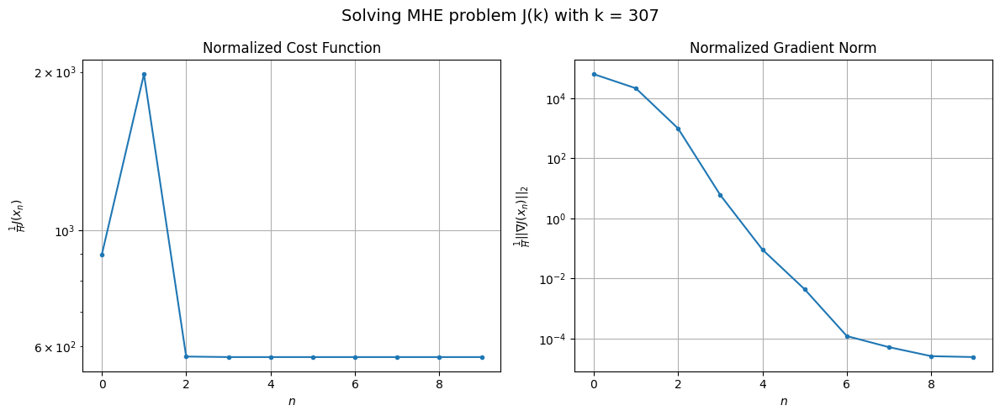

Windows:  77%|███████▋  | 299/386 [16:48<04:40,  3.22s/it]

[Gauss-Newton] Before applying the algorithm
Cost function: 9382.24818970911
Gradient norm: 629532.6351508352
Global estimation error: 1592.8142459521127
Initial conditions estimation errors: 1.9857205044614563 m, 550.3791428371278 m, 754.4950751491181 m, 1290.2996282064857 m
Position estimation errors: 9.98215718829771 m, 463.6935385864422 m, 574.7259611072767 m, 1236.1067230042286 m

[Gauss-Newton] Iteration 1
Cost function: 6525.6348689401875 (-30.45%)
Gradient norm: 53484.09732929242 (-91.50%)
Global estimation error: 2213.9126916676814 (38.99%)
Initial conditions estimation errors: 5.512224863024461 m, 791.2558608215053 m, 1124.2883307775178 m, 1735.300719819017 m
Position estimation errors: 5.460630287470072 m, 681.8485975518101 m, 867.9867922699082 m, 1721.624010062487 m

[Gauss-Newton] Iteration 2
Cost function: 6085.111799791833 (-6.75%)
Gradient norm: 24677.175792096445 (-53.86%)
Global estimation error: 2647.665438746504 (19.59%)
Initial conditions estimation errors: 5.51222

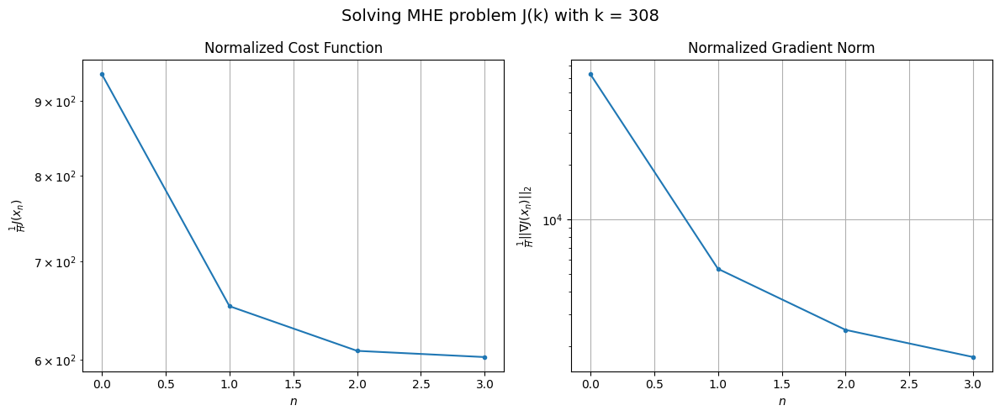

Windows:  78%|███████▊  | 300/386 [16:49<03:54,  2.73s/it]

[Gauss-Newton] Before applying the algorithm
Cost function: 9447.21901383607
Gradient norm: 619454.9559805173
Global estimation error: 3037.2830187149866
Initial conditions estimation errors: 2.041796911605653 m, 1070.1480898862228 m, 1488.2775063938 m, 2421.7548521456315 m
Position estimation errors: 9.806269352942529 m, 900.930248245221 m, 1124.2552925286843 m, 2354.9907330185597 m

[Gauss-Newton] Iteration 1
Cost function: 164615.6768831213 (1642.48%)
Gradient norm: 912521.7673177852 (47.31%)
Global estimation error: 5706.5776862708135 (87.88%)
Initial conditions estimation errors: 5.627715181093098 m, 1974.6110850984921 m, 2640.562901108252 m, 4657.610239843714 m
Position estimation errors: 5.310770345761608 m, 1706.0307258423782 m, 2101.1539124388974 m, 4679.957165730849 m

[Gauss-Newton] Iteration 2
Cost function: 291859.8181167886 (77.30%)
Gradient norm: 1230999.2749774037 (34.90%)
Global estimation error: 8748.976160508517 (53.31%)
Initial conditions estimation errors: 5.627715

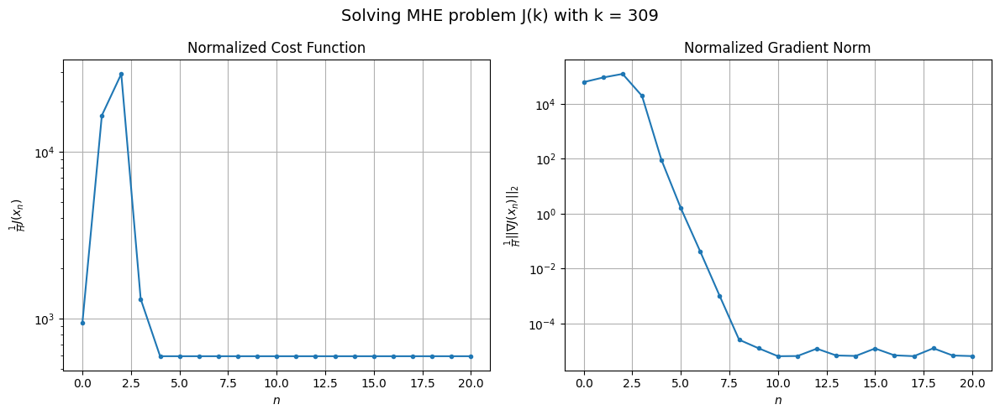

Windows:  78%|███████▊  | 301/386 [16:55<05:17,  3.73s/it]

[Gauss-Newton] Before applying the algorithm
Cost function: 8814.524256655888
Gradient norm: 586734.8559067904
Global estimation error: 7553.364488954749
Initial conditions estimation errors: 1.9861874304773317 m, 2592.6580202419077 m, 3448.333460386756 m, 6200.034543289867 m
Position estimation errors: 9.358801227135537 m, 2174.977729033625 m, 2653.0571473672826 m, 6058.569033585481 m

[Gauss-Newton] Iteration 1
Cost function: 1176787.6882475636 (13250.55%)
Gradient norm: 2308370.9134590733 (293.43%)
Global estimation error: 2906.374987222222 (-61.52%)
Initial conditions estimation errors: 5.583124002891155 m, 980.4593435418085 m, 1314.6518722796327 m, 2399.4525661281164 m
Position estimation errors: 5.0026739557268565 m, 948.1216959741621 m, 1133.4144496406157 m, 2634.1664821697846 m

[Gauss-Newton] Iteration 2
Cost function: 6317193.043430941 (436.82%)
Gradient norm: 5804570.432012707 (151.46%)
Global estimation error: 3790.3788580584546 (30.42%)
Initial conditions estimation errors

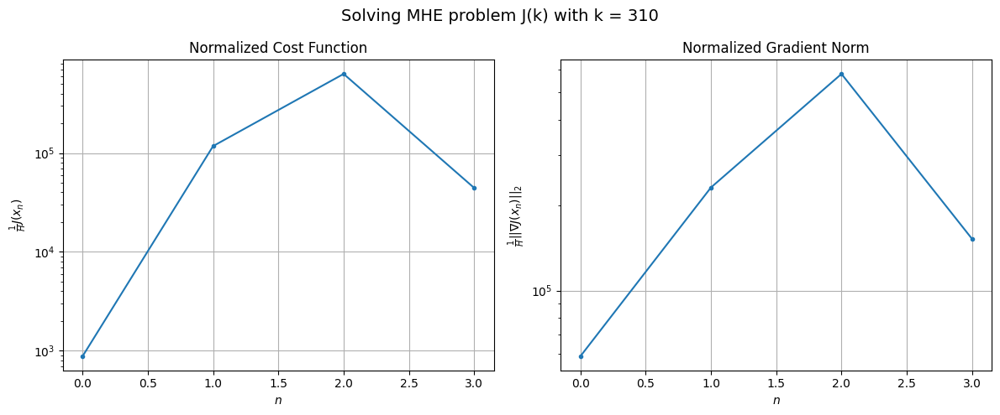

Windows:  78%|███████▊  | 302/386 [16:57<04:21,  3.11s/it]

[Gauss-Newton] Before applying the algorithm
Cost function: 436505.9968568376
Gradient norm: 1569470.2267894938
Global estimation error: 335.36011799102135
Initial conditions estimation errors: 1.888421864675524 m, 110.16904737068425 m, 122.27235002743765 m, 292.19013816677074 m
Position estimation errors: 8.641502496453219 m, 76.6248420772544 m, 98.4054492693986 m, 275.01875652754353 m

[Gauss-Newton] Iteration 1
Cost function: 217395.05263942378 (-50.20%)
Gradient norm: 1121387.7655795384 (-28.55%)
Global estimation error: 2926.083987375278 (772.52%)
Initial conditions estimation errors: 5.366666711393329 m, 992.4932723977371 m, 1315.3046651525726 m, 2418.0293432635385 m
Position estimation errors: 4.559353501326392 m, 1032.2495383019027 m, 1234.6338212632181 m, 2925.078239482265 m

[Gauss-Newton] Iteration 2
Cost function: 5175.714278900907 (-97.62%)
Gradient norm: 48468.82249261822 (-95.68%)
Global estimation error: 2314.959433654644 (-20.89%)
Initial conditions estimation errors: 

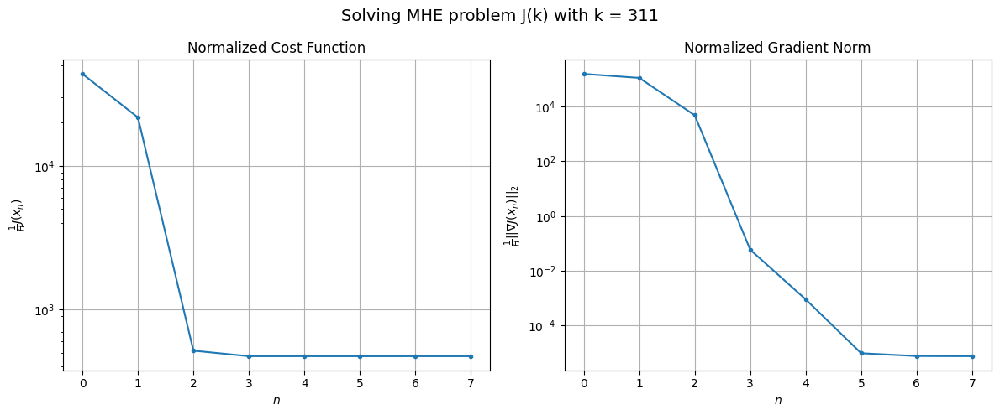

Windows:  78%|███████▊  | 303/386 [17:00<04:04,  2.94s/it]

[Gauss-Newton] Before applying the algorithm
Cost function: 6428.5073384118205
Gradient norm: 476813.16560973815
Global estimation error: 2402.4582311396807
Initial conditions estimation errors: 1.7334423778343764 m, 808.513753803543 m, 1063.967806767594 m, 1996.5165721329804 m
Position estimation errors: 7.725949443800823 m, 830.6818866879034 m, 982.0625570896275 m, 2376.764831168184 m

[Gauss-Newton] Iteration 1
Cost function: 11277.377531701037 (75.43%)
Gradient norm: 223101.29338110125 (-53.21%)
Global estimation error: 1458.7074302868282 (-39.28%)
Initial conditions estimation errors: 4.923027755051222 m, 471.2109821252511 m, 598.0488075718703 m, 1244.2270207615459 m
Position estimation errors: 4.0260975922454065 m, 362.73924006605034 m, 403.6786395935097 m, 1128.0855305359853 m

[Gauss-Newton] Iteration 2
Cost function: 3943.3393639349733 (-65.03%)
Gradient norm: 9.250801328585355 (-100.00%)
Global estimation error: 1466.1370548081122 (0.51%)
Initial conditions estimation errors:

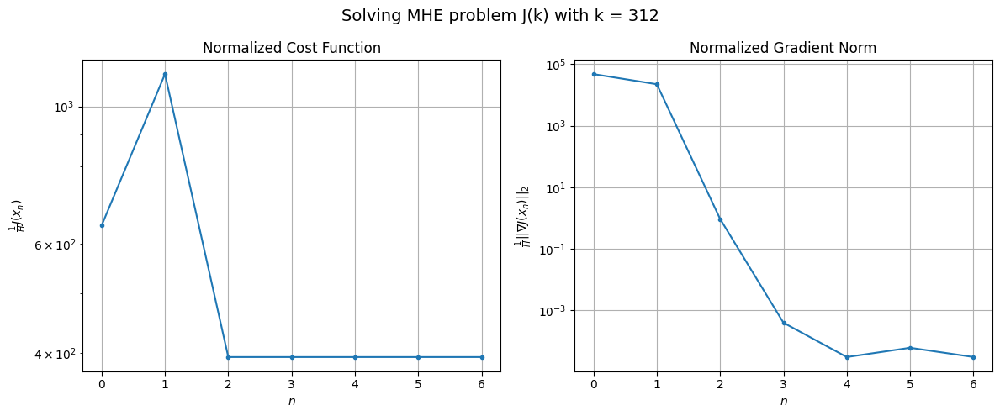

Windows:  79%|███████▉  | 304/386 [17:02<03:44,  2.73s/it]

[Gauss-Newton] Before applying the algorithm
Cost function: 5024.533488705889
Gradient norm: 408257.2438253687
Global estimation error: 1465.3654317017024
Initial conditions estimation errors: 1.5138430710328568 m, 466.4394948468409 m, 584.0115812117758 m, 1260.4198311109512 m
Position estimation errors: 6.693138099450428 m, 339.6777748160629 m, 362.46712812418383 m, 1087.4267192471962 m

[Gauss-Newton] Iteration 1
Cost function: 144878.80458494506 (2783.43%)
Gradient norm: 911365.219188544 (123.23%)
Global estimation error: 981.4220414575817 (-33.03%)
Initial conditions estimation errors: 4.363984229425066 m, 325.65826908121943 m, 413.6549112443563 m, 828.2534471557548 m
Position estimation errors: 3.4723962717626327 m, 481.4638137245356 m, 562.7635081885423 m, 1458.9917794556043 m

[Gauss-Newton] Iteration 2
Cost function: 4008.8957006195774 (-97.23%)
Gradient norm: 71475.00123799649 (-92.16%)
Global estimation error: 1719.1526827606301 (75.17%)
Initial conditions estimation errors: 

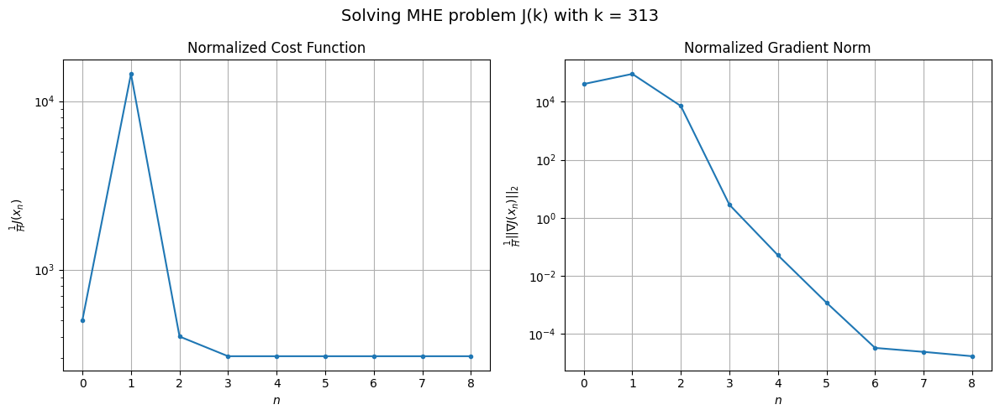

Windows:  79%|███████▉  | 305/386 [17:05<03:48,  2.82s/it]

[Gauss-Newton] Before applying the algorithm
Cost function: 3631.21749716035
Gradient norm: 336057.4098984208
Global estimation error: 1813.5167344030488
Initial conditions estimation errors: 1.2614007453520013 m, 585.4022447187218 m, 727.0827525032894 m, 1554.828897908682 m
Position estimation errors: 5.671818173001849 m, 700.1891813475477 m, 802.7831327914718 m, 2162.4328161095864 m

[Gauss-Newton] Iteration 1
Cost function: 18303.383571572052 (404.06%)
Gradient norm: 325684.3428333393 (-3.09%)
Global estimation error: 586.8605716193515 (-67.64%)
Initial conditions estimation errors: 3.787325384741323 m, 160.98467667456055 m, 168.43917264918002 m, 538.6121199509263 m
Position estimation errors: 2.9058766824996796 m, 166.44359975968246 m, 163.1714561235598 m, 620.5414817260191 m

[Gauss-Newton] Iteration 2
Cost function: 2155.4204999066 (-88.22%)
Gradient norm: 3818.60668705363 (-98.83%)
Global estimation error: 370.4534048550302 (-36.88%)
Initial conditions estimation errors: 3.78732

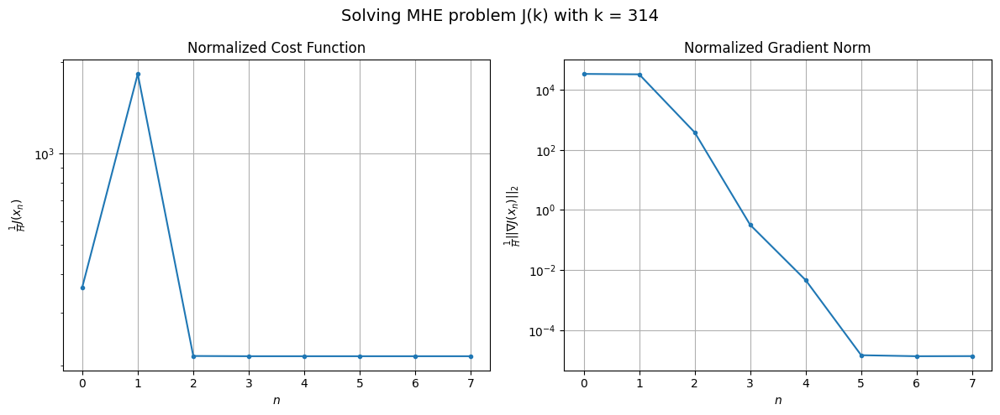

Windows:  79%|███████▉  | 306/386 [17:07<03:37,  2.72s/it]

[Gauss-Newton] Before applying the algorithm
Cost function: 2535.5124687011266
Gradient norm: 283001.8913665183
Global estimation error: 390.01188435407215
Initial conditions estimation errors: 1.0601326522800965 m, 99.18173016320122 m, 90.16858104241719 m, 366.25212496258195 m
Position estimation errors: 4.6885725154690014 m, 119.23910926089496 m, 117.05253161703413 m, 469.6131564841213 m

[Gauss-Newton] Iteration 1
Cost function: 89555.71425473454 (3432.06%)
Gradient norm: 647162.2555559508 (128.68%)
Global estimation error: 2119.4144642491133 (443.42%)
Initial conditions estimation errors: 3.194135716325127 m, 667.8835956559928 m, 815.7336885181408 m, 1838.591148440273 m
Position estimation errors: 2.3389729524446023 m, 502.42761022600234 m, 533.8133149460662 m, 1584.7777855261877 m

[Gauss-Newton] Iteration 2
Cost function: 1468.6033195358082 (-98.36%)
Gradient norm: 3351.481607504288 (-99.48%)
Global estimation error: 1949.4050743280495 (-8.02%)
Initial conditions estimation error

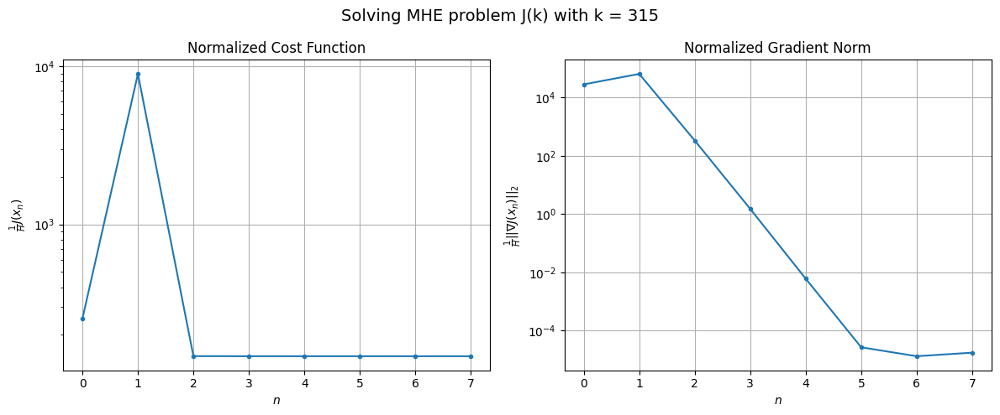

Windows:  80%|███████▉  | 307/386 [17:10<03:35,  2.73s/it]

[Gauss-Newton] Before applying the algorithm
Cost function: 1684.1443614982722
Gradient norm: 231111.08976223596
Global estimation error: 1926.7083978069709
Initial conditions estimation errors: 0.83876842148451 m, 603.3026898352982 m, 731.9567347751612 m, 1677.0419206143097 m
Position estimation errors: 3.800367829919599 m, 423.81160962044174 m, 437.63174126034147 m, 1358.133905426223 m

[Gauss-Newton] Iteration 1
Cost function: 54670.42517041753 (3146.18%)
Gradient norm: 485711.96085137915 (110.16%)
Global estimation error: 348.00741160848753 (-81.94%)
Initial conditions estimation errors: 2.6083321936983497 m, 126.14436111501087 m, 172.64304093273643 m, 274.56199547287804 m
Position estimation errors: 1.8569238133957935 m, 124.28834668844372 m, 181.29884854730307 m, 309.23039105464886 m

[Gauss-Newton] Iteration 2
Cost function: 963.2104826004396 (-98.24%)
Gradient norm: 9636.039522811036 (-98.02%)
Global estimation error: 619.8111501071159 (78.10%)
Initial conditions estimation err

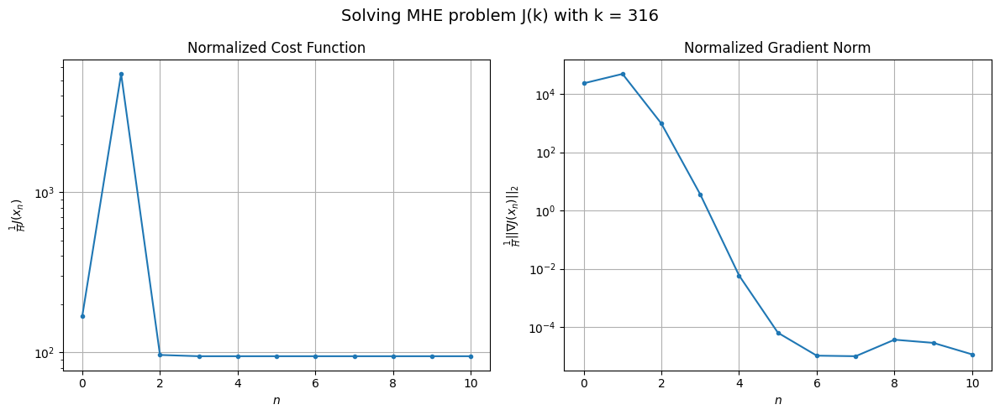

Windows:  80%|███████▉  | 308/386 [17:13<03:44,  2.88s/it]

[Gauss-Newton] Before applying the algorithm
Cost function: 1060.9424552367354
Gradient norm: 185335.29438398272
Global estimation error: 656.0860154434206
Initial conditions estimation errors: 0.6068355218199746 m, 215.0772462496918 m, 271.2716208719072 m, 557.3167003382188 m
Position estimation errors: 3.1119372175841815 m, 197.6971646299498 m, 251.86334941317625 m, 583.8017567823578 m

[Gauss-Newton] Iteration 1
Cost function: 2696.613935311987 (154.17%)
Gradient norm: 98783.92432707935 (-46.70%)
Global estimation error: 357.1974984232234 (-45.56%)
Initial conditions estimation errors: 2.033542757537702 m, 84.64052403671192 m, 81.03714582303684 m, 337.4238186250959 m
Position estimation errors: 1.5525753355772534 m, 42.09118719641848 m, 42.76560971851493 m, 242.23499228607042 m

[Gauss-Newton] Iteration 2
Cost function: 591.0675652869293 (-78.08%)
Gradient norm: 3896.812445966136 (-96.06%)
Global estimation error: 185.82211315780089 (-47.98%)
Initial conditions estimation errors: 2.

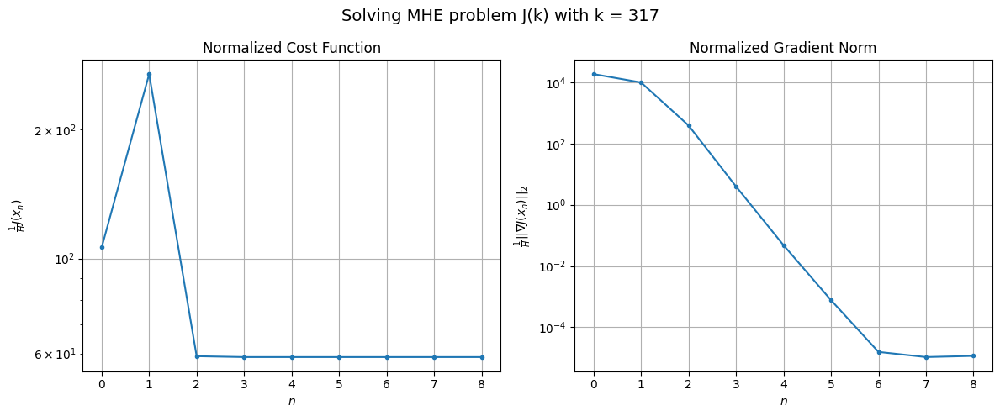

Windows:  80%|████████  | 309/386 [17:16<03:43,  2.90s/it]

[Gauss-Newton] Before applying the algorithm
Cost function: 775.7675073655726
Gradient norm: 167443.04002812537
Global estimation error: 190.8150049019933
Initial conditions estimation errors: 0.389227230072583 m, 33.4523605384556 m, 24.78688925252931 m, 186.21678205383702 m
Position estimation errors: 2.7015916541508767 m, 19.34181263471049 m, 93.96746301336161 m, 71.62750526454798 m

[Gauss-Newton] Iteration 1
Cost function: 546.2021037999662 (-29.59%)
Gradient norm: 12589.640044677728 (-92.48%)
Global estimation error: 449.73119273335493 (135.69%)
Initial conditions estimation errors: 1.5638518540664295 m, 79.12059718618892 m, 42.782765373438494 m, 440.64051067520114 m
Position estimation errors: 1.3520008554375997 m, 109.28330205411977 m, 173.63879735749904 m, 145.6237428451711 m

[Gauss-Newton] Iteration 2
Cost function: 612.6653062975944 (12.17%)
Gradient norm: 29193.965564768656 (131.89%)
Global estimation error: 190.9123552554882 (-57.55%)
Initial conditions estimation errors: 

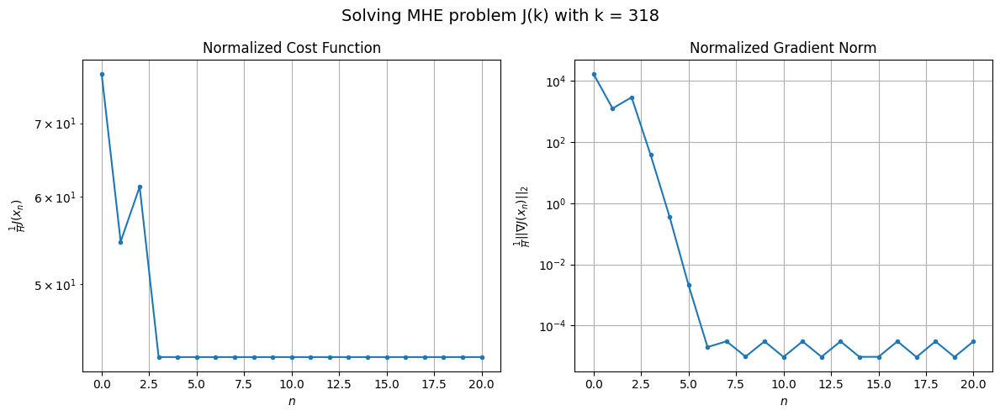

Windows:  80%|████████  | 310/386 [17:22<04:45,  3.76s/it]

[Gauss-Newton] Before applying the algorithm
Cost function: 595.4583077718213
Gradient norm: 147823.69482911882
Global estimation error: 202.05875595707994
Initial conditions estimation errors: 0.28857110461371605 m, 87.861303877054 m, 159.15384389494855 m, 88.18652724117122 m
Position estimation errors: 2.448584762581347 m, 231.10091889375977 m, 276.2801120138028 m, 598.922543845286 m

[Gauss-Newton] Iteration 1
Cost function: 24667.996431171014 (4042.69%)
Gradient norm: 343132.69791203074 (132.12%)
Global estimation error: 2008.3487546636438 (893.94%)
Initial conditions estimation errors: 1.2795667393874208 m, 601.1196350904344 m, 681.3483835612118 m, 1791.0557085438377 m
Position estimation errors: 1.3041170176367674 m, 635.1715929201829 m, 636.3033139025695 m, 2212.7439323687804 m

[Gauss-Newton] Iteration 2
Cost function: 346.3923291432866 (-98.60%)
Gradient norm: 304.49449270271583 (-99.91%)
Global estimation error: 2114.717026183264 (5.30%)
Initial conditions estimation errors: 

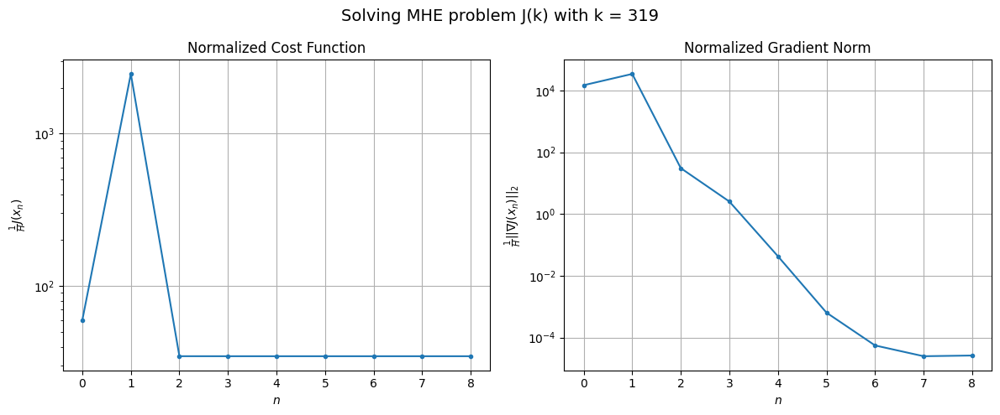

Windows:  81%|████████  | 311/386 [17:25<04:22,  3.50s/it]

[Gauss-Newton] Before applying the algorithm
Cost function: 546.8152344941989
Gradient norm: 145053.9533656288
Global estimation error: 2206.3659315422656
Initial conditions estimation errors: 0.3362883142201336 m, 646.8480226073506 m, 717.8107385792064 m, 1983.52830164077 m
Position estimation errors: 2.3496520758233688 m, 627.3992628920099 m, 614.0611054393509 m, 2237.238233823917 m

[Gauss-Newton] Iteration 1
Cost function: 425104.89182121656 (77641.96%)
Gradient norm: 1476720.1013910759 (918.05%)
Global estimation error: 1460.0937011682458 (-33.82%)
Initial conditions estimation errors: 1.1775875884371763 m, 420.07746674561133 m, 479.89264478390925 m, 1313.4344896171058 m
Position estimation errors: 1.2917955659333056 m, 320.9852435548915 m, 313.83648758901893 m, 1095.0643065154572 m

[Gauss-Newton] Iteration 2
Cost function: 16203.667237869882 (-96.19%)
Gradient norm: 296411.52564348705 (-79.93%)
Global estimation error: 2995.9959647937703 (105.19%)
Initial conditions estimation e

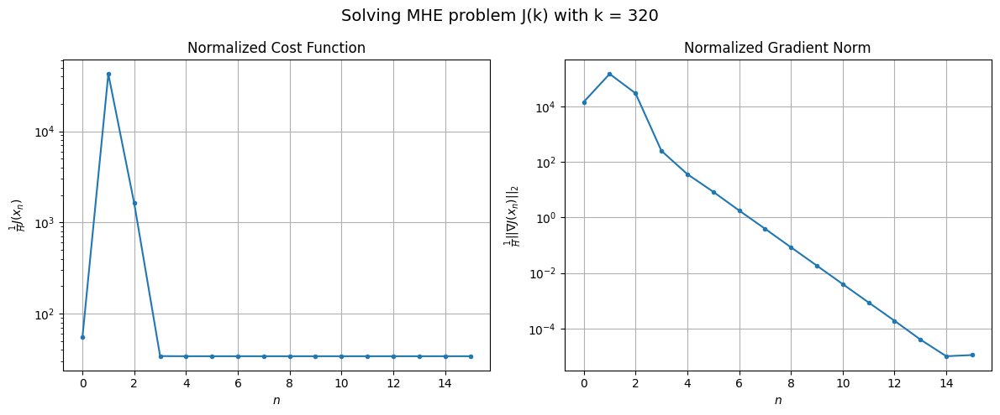

Windows:  81%|████████  | 312/386 [17:30<04:45,  3.86s/it]

[Gauss-Newton] Before applying the algorithm
Cost function: 546.9089210962874
Gradient norm: 137451.3194370184
Global estimation error: 3125.084447668386
Initial conditions estimation errors: 0.4064438045902877 m, 878.5998936406219 m, 948.26789747417 m, 2845.171762074768 m
Position estimation errors: 2.240980043412812 m, 745.5062694690125 m, 685.7195346426589 m, 2692.17922772412 m

[Gauss-Newton] Iteration 1
Cost function: 515.6458799080531 (-5.72%)
Gradient norm: 28036.394155862286 (-79.60%)
Global estimation error: 3593.4622321023908 (14.99%)
Initial conditions estimation errors: 1.1764524873402633 m, 957.719772253277 m, 960.5868987341643 m, 3327.6138907712866 m
Position estimation errors: 1.2341394647563526 m, 850.4072598439996 m, 720.3500676743975 m, 3213.6153784664357 m



/home/jgaspar/SpaceSim-Toolkit/test/new_newton_based_algorithms/gauss_newton.py:181: LinAlgWarning: Ill-conditioned matrix (rcond=8.63242e-17): result may not be accurate.
  delta_x = solve(HJ_x, -DJ_x)


[Gauss-Newton] Iteration 2
Cost function: 380.52098160334566 (-26.20%)
Gradient norm: 6746.263609788205 (-75.94%)
Global estimation error: 3366.0786804616305 (-6.33%)
Initial conditions estimation errors: 1.1764524947269006 m, 894.0884572357818 m, 895.306960863767 m, 3119.2170382694208 m
Position estimation errors: 1.234139455230141 m, 784.7140854370471 m, 661.8902771548404 m, 2973.0134297964196 m



/home/jgaspar/SpaceSim-Toolkit/test/new_newton_based_algorithms/gauss_newton.py:181: LinAlgWarning: Ill-conditioned matrix (rcond=1.01792e-16): result may not be accurate.
  delta_x = solve(HJ_x, -DJ_x)


[Gauss-Newton] Iteration 3
Cost function: 373.1702078562504 (-1.93%)
Gradient norm: 1777.311450098206 (-73.65%)
Global estimation error: 3490.4424176204943 (3.69%)
Initial conditions estimation errors: 1.1764524935960003 m, 928.0459859496428 m, 929.9302693552809 m, 3233.7511500298824 m
Position estimation errors: 1.234139455724107 m, 816.9833927185634 m, 690.067988588066 m, 3094.148308413331 m



/home/jgaspar/SpaceSim-Toolkit/test/new_newton_based_algorithms/gauss_newton.py:181: LinAlgWarning: Ill-conditioned matrix (rcond=9.33212e-17): result may not be accurate.
  delta_x = solve(HJ_x, -DJ_x)


[Gauss-Newton] Iteration 4
Cost function: 372.6064456555833 (-0.15%)
Gradient norm: 363.3363434191087 (-79.56%)
Global estimation error: 3434.072817932276 (-1.61%)
Initial conditions estimation errors: 1.1764524944824508 m, 912.6449232975882 m, 914.211558609671 m, 3181.847028849963 m
Position estimation errors: 1.234139456043177 m, 802.4050009239019 m, 677.3369659934601 m, 3039.4213108347208 m



/home/jgaspar/SpaceSim-Toolkit/test/new_newton_based_algorithms/gauss_newton.py:181: LinAlgWarning: Ill-conditioned matrix (rcond=9.70505e-17): result may not be accurate.
  delta_x = solve(HJ_x, -DJ_x)


[Gauss-Newton] Iteration 5
Cost function: 372.58319421610133 (-0.01%)
Gradient norm: 86.97352387074409 (-76.06%)
Global estimation error: 3461.5940239366664 (0.80%)
Initial conditions estimation errors: 1.176452494456092 m, 920.1641953488393 m, 921.8851475941076 m, 3207.188289129355 m
Position estimation errors: 1.2341394560654235 m, 809.5431640345076 m, 683.5718843439641 m, 3066.215338769183 m



/home/jgaspar/SpaceSim-Toolkit/test/new_newton_based_algorithms/gauss_newton.py:181: LinAlgWarning: Ill-conditioned matrix (rcond=9.52055e-17): result may not be accurate.
  delta_x = solve(HJ_x, -DJ_x)


[Gauss-Newton] Iteration 6
Cost function: 372.5818545007063 (-0.00%)
Gradient norm: 19.47070659008541 (-77.61%)
Global estimation error: 3448.559377629031 (-0.38%)
Initial conditions estimation errors: 1.176452494456092 m, 916.6030002905426 m, 918.2508277323807 m, 3195.1860750722203 m
Position estimation errors: 1.2341394540683726 m, 806.167083247871 m, 680.6233960633908 m, 3053.5419183906524 m



/home/jgaspar/SpaceSim-Toolkit/test/new_newton_based_algorithms/gauss_newton.py:181: LinAlgWarning: Ill-conditioned matrix (rcond=9.60735e-17): result may not be accurate.
  delta_x = solve(HJ_x, -DJ_x)


[Gauss-Newton] Iteration 7
Cost function: 372.5817872085629 (-0.00%)
Gradient norm: 4.507842688969396 (-76.85%)
Global estimation error: 3454.8281122074727 (0.18%)
Initial conditions estimation errors: 1.1764524942116423 m, 918.31570657997 m, 919.9986964791501 m, 3200.958271860564 m
Position estimation errors: 1.234139455450623 m, 807.7918699971418 m, 682.0424951173829 m, 3059.640967635232 m



/home/jgaspar/SpaceSim-Toolkit/test/new_newton_based_algorithms/gauss_newton.py:181: LinAlgWarning: Ill-conditioned matrix (rcond=9.56547e-17): result may not be accurate.
  delta_x = solve(HJ_x, -DJ_x)


[Gauss-Newton] Iteration 8
Cost function: 372.5817837059952 (-0.00%)
Gradient norm: 1.0274921833442812 (-77.21%)
Global estimation error: 3451.8346575368673 (-0.09%)
Initial conditions estimation errors: 1.1764524940392256 m, 917.4978584688644 m, 919.1640562845145 m, 3198.2019220393336 m
Position estimation errors: 1.2341394557696932 m, 807.0162534099203 m, 681.3650883212097 m, 3056.729446568794 m



/home/jgaspar/SpaceSim-Toolkit/test/new_newton_based_algorithms/gauss_newton.py:181: LinAlgWarning: Ill-conditioned matrix (rcond=9.58544e-17): result may not be accurate.
  delta_x = solve(HJ_x, -DJ_x)


[Gauss-Newton] Iteration 9
Cost function: 372.58178348189807 (-0.00%)
Gradient norm: 0.23596045992974093 (-77.04%)
Global estimation error: 3453.269038628021 (0.04%)
Initial conditions estimation errors: 1.1764524946285086 m, 917.889750117049 m, 919.5639939737348 m, 3199.5226884025415 m
Position estimation errors: 1.2341394560654235 m, 807.3879663670627 m, 681.6897394556322 m, 3058.1247770704313 m



/home/jgaspar/SpaceSim-Toolkit/test/new_newton_based_algorithms/gauss_newton.py:181: LinAlgWarning: Ill-conditioned matrix (rcond=9.57587e-17): result may not be accurate.
  delta_x = solve(HJ_x, -DJ_x)


[Gauss-Newton] Iteration 10
Cost function: 372.58178350545944 (0.00%)
Gradient norm: 0.053954179335827274 (-77.13%)
Global estimation error: 3452.5828455962614 (-0.02%)
Initial conditions estimation errors: 1.1764524946285086 m, 917.7022735397417 m, 919.372668214072 m, 3198.890847324482 m
Position estimation errors: 1.2341394551623084 m, 807.2101561761715 m, 681.5344426339484 m, 3057.4573132458518 m



/home/jgaspar/SpaceSim-Toolkit/test/new_newton_based_algorithms/gauss_newton.py:181: LinAlgWarning: Ill-conditioned matrix (rcond=9.58045e-17): result may not be accurate.
  delta_x = solve(HJ_x, -DJ_x)


[Gauss-Newton] Iteration 11
Cost function: 372.58178339461074 (-0.00%)
Gradient norm: 0.012407714137831457 (-77.00%)
Global estimation error: 3452.9113722212905 (0.01%)
Initial conditions estimation errors: 1.176452494456092 m, 917.7920312196017 m, 919.4642687397892 m, 3199.193351993581 m
Position estimation errors: 1.2341394557845242 m, 807.2952889097451 m, 681.6087965788977 m, 3057.7768839027153 m



/home/jgaspar/SpaceSim-Toolkit/test/new_newton_based_algorithms/gauss_newton.py:181: LinAlgWarning: Ill-conditioned matrix (rcond=9.57825e-17): result may not be accurate.
  delta_x = solve(HJ_x, -DJ_x)


[Gauss-Newton] Iteration 12
Cost function: 372.58178356880126 (0.00%)
Gradient norm: 0.0028230648909167346 (-77.25%)
Global estimation error: 3452.7541473107312 (-0.00%)
Initial conditions estimation errors: 1.176452494456092 m, 917.7490753925605 m, 919.4204309880059 m, 3199.048580541029 m
Position estimation errors: 1.2341394551548928 m, 807.254547272391 m, 681.5732133920693 m, 3057.6239480218 m



/home/jgaspar/SpaceSim-Toolkit/test/new_newton_based_algorithms/gauss_newton.py:181: LinAlgWarning: Ill-conditioned matrix (rcond=9.5793e-17): result may not be accurate.
  delta_x = solve(HJ_x, -DJ_x)


[Gauss-Newton] Iteration 13
Cost function: 372.5817834706226 (-0.00%)
Gradient norm: 0.0006548592197606247 (-76.80%)
Global estimation error: 3452.829398953054 (0.00%)
Initial conditions estimation errors: 1.1764524946285086 m, 917.7696350804009 m, 919.4414127683169 m, 3199.1178716680633 m
Position estimation errors: 1.2341394560654235 m, 807.2740472403515 m, 681.5902443828063 m, 3057.697147008537 m



/home/jgaspar/SpaceSim-Toolkit/test/new_newton_based_algorithms/gauss_newton.py:181: LinAlgWarning: Ill-conditioned matrix (rcond=9.5788e-17): result may not be accurate.
  delta_x = solve(HJ_x, -DJ_x)


[Gauss-Newton] Iteration 14
Cost function: 372.5817834645123 (-0.00%)
Gradient norm: 0.00042965571471779323 (-34.39%)
Global estimation error: 3452.793385906871 (-0.00%)
Initial conditions estimation errors: 1.1764524946285086 m, 917.7597958604846 m, 919.4313715392408 m, 3199.084711141464 m
Position estimation errors: 1.234139454349272 m, 807.2647151890592 m, 681.5820938936196 m, 3057.6621163775885 m



/home/jgaspar/SpaceSim-Toolkit/test/new_newton_based_algorithms/gauss_newton.py:181: LinAlgWarning: Ill-conditioned matrix (rcond=9.57904e-17): result may not be accurate.
  delta_x = solve(HJ_x, -DJ_x)


[Gauss-Newton] STOP on Iteration 15 (gradient norm stagnated)
Cost function = 372.5817833621273 (-0.00%)
Gradient norm = 0.00038205622116488017 (-11.08%)
Global estimation error = 3452.810624998845 (0.00%)
Final initial conditions estimation errors: 1.1764524946285086 m, 917.7645057879838 m, 919.4361781522487 m, 3199.1005847704814 m
Final position estimation errors: 1.234139456331492 m, 807.269182345955 m, 681.5859954349187 m, 3057.678885214545 m



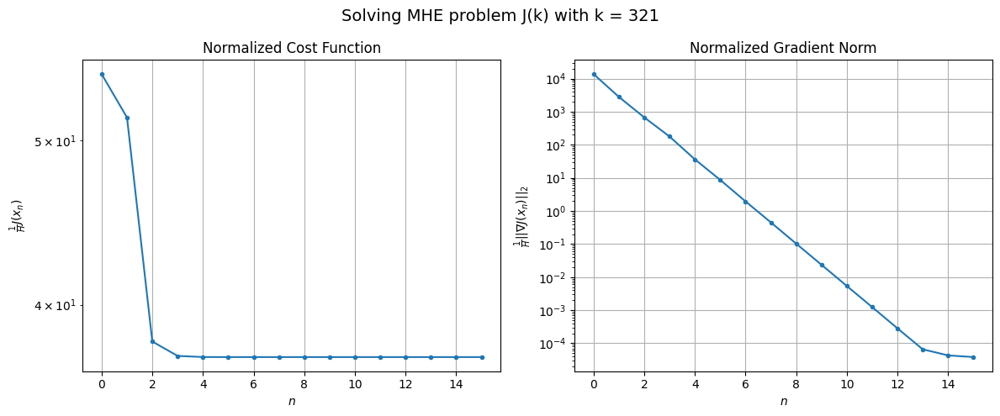

Windows:  81%|████████  | 313/386 [17:35<05:06,  4.19s/it]

[Gauss-Newton] Before applying the algorithm
Cost function: 522.6614417486927
Gradient norm: 124819.55234445243
Global estimation error: 3488.5072973262972
Initial conditions estimation errors: 0.45400215633271196 m, 921.3937498485385 m, 907.67385181548 m, 3239.883376959561 m
Position estimation errors: 2.013304148463618 m, 776.2041578219767 m, 638.5770446927148 m, 2972.952456041073 m



/home/jgaspar/SpaceSim-Toolkit/test/new_newton_based_algorithms/gauss_newton.py:181: LinAlgWarning: Ill-conditioned matrix (rcond=7.63551e-17): result may not be accurate.
  delta_x = solve(HJ_x, -DJ_x)


[Gauss-Newton] Iteration 1
Cost function: 850556.9577968137 (162635.74%)
Gradient norm: 2096552.2742767683 (1579.67%)
Global estimation error: 992.0448778373909 (-71.56%)
Initial conditions estimation errors: 1.2762469051657088 m, 266.37639361144574 m, 233.44639659602805 m, 926.6590695734807 m
Position estimation errors: 1.044590530263307 m, 302.1303058796327 m, 259.34895743970503 m, 1202.748057366934 m

[Gauss-Newton] Iteration 2
Cost function: 163888.315120061 (-80.73%)
Gradient norm: 930020.1580831292 (-55.64%)
Global estimation error: 1950.02778061104 (96.57%)
Initial conditions estimation errors: 1.2762468812765582 m, 520.06876221955 m, 543.4230704750854 m, 1799.1182477494106 m
Position estimation errors: 1.0445905040687455 m, 431.33799337087174 m, 357.6813319657209 m, 1610.282226125197 m

[Gauss-Newton] Iteration 3
Cost function: 356.9514548579103 (-99.78%)
Gradient norm: 8478.921569274025 (-99.09%)
Global estimation error: 2176.593535574391 (11.62%)
Initial conditions estimation

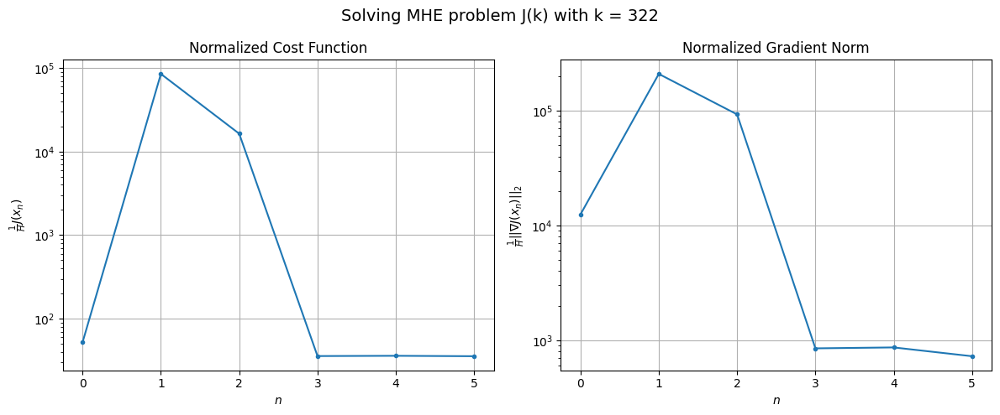

Windows:  81%|████████▏ | 314/386 [17:37<04:19,  3.61s/it]

[Gauss-Newton] Before applying the algorithm
Cost function: 410.47531597486335
Gradient norm: 90289.19318636048
Global estimation error: 2170.9265493908883
Initial conditions estimation errors: 0.5438734708571749 m, 576.7870790640737 m, 588.5302961333874 m, 2008.4497535348141 m
Position estimation errors: 1.6349158154185177 m, 478.9737417308878 m, 386.5104161625917 m, 1808.3606208201038 m

[Gauss-Newton] Iteration 1
Cost function: 81747.47405459177 (19815.32%)
Gradient norm: 589481.6645961823 (552.88%)
Global estimation error: 543.9857390720366 (-74.94%)
Initial conditions estimation errors: 1.2028836366620674 m, 139.20755940548773 m, 114.77620975987011 m, 513.1925459657556 m
Position estimation errors: 0.9646143322147417 m, 55.456675379658456 m, 46.03554953891519 m, 279.83020065943936 m

[Gauss-Newton] Iteration 2
Cost function: 946.247205595714 (-98.84%)
Gradient norm: 58107.967090053375 (-90.14%)
Global estimation error: 215.05968125050572 (-60.47%)
Initial conditions estimation err

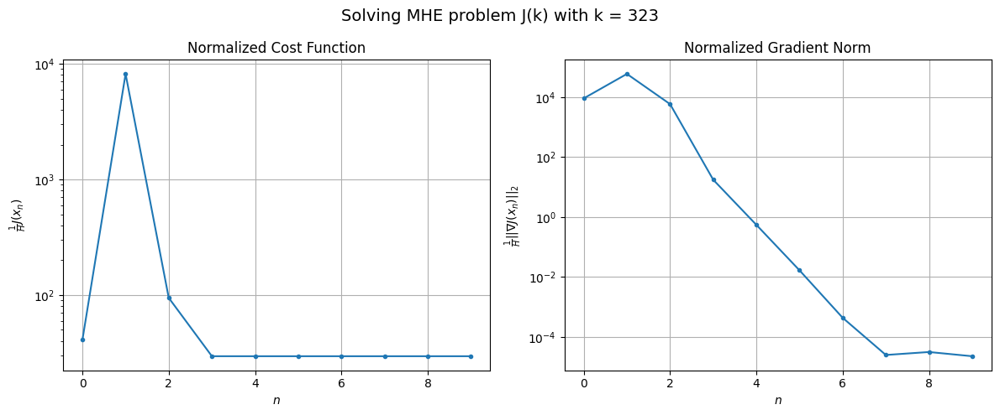

Windows:  82%|████████▏ | 315/386 [17:40<04:06,  3.47s/it]

[Gauss-Newton] Before applying the algorithm
Cost function: 358.6419647200389
Gradient norm: 83190.3112694555
Global estimation error: 208.93873362419862
Initial conditions estimation errors: 0.49154389751737143 m, 56.438007355938986 m, 67.99315345796565 m, 189.33175084899298 m
Position estimation errors: 1.5460611231441532 m, 126.57666750329837 m, 99.52148836208804 m, 430.3581683372828 m

[Gauss-Newton] Iteration 1
Cost function: 191770.36716959017 (53371.26%)
Gradient norm: 1056203.9740015205 (1169.62%)
Global estimation error: 3065.069388446017 (1366.97%)
Initial conditions estimation errors: 1.0652862786328363 m, 805.3750661755156 m, 785.0347250711654 m, 2851.2690026959785 m
Position estimation errors: 0.9523584999771015 m, 938.2479776433134 m, 769.9268176582025 m, 3546.5170219019046 m



/home/jgaspar/SpaceSim-Toolkit/test/new_newton_based_algorithms/gauss_newton.py:181: LinAlgWarning: Ill-conditioned matrix (rcond=4.39646e-17): result may not be accurate.
  delta_x = solve(HJ_x, -DJ_x)


[Gauss-Newton] Iteration 2
Cost function: 3045068.4746070844 (1487.87%)
Gradient norm: 4078523.1751900977 (286.15%)
Global estimation error: 9078.582905280595 (196.20%)
Initial conditions estimation errors: 1.065286282039937 m, 2360.6085391138818 m, 2232.470805925608 m, 8477.277943212357 m
Position estimation errors: 0.95235849253896 m, 2463.8263262618498 m, 1987.2533370591318 m, 9571.662159329151 m

[Gauss-Newton] Iteration 3
Cost function: 54136.531965648406 (-98.22%)
Gradient norm: 522440.61157779786 (-87.19%)
Global estimation error: 6751.579444013925 (-25.63%)
Initial conditions estimation errors: 1.0652862549184388 m, 1757.4174977040484 m, 1669.5819036986281 m, 6301.411250925389 m
Position estimation errors: 0.9523585193757045 m, 1925.0667095440397 m, 1560.9950556485524 m, 7434.058638582105 m

[Gauss-Newton] Iteration 4
Cost function: 273.6139729372596 (-99.49%)
Gradient norm: 4431.073385528319 (-99.15%)
Global estimation error: 6530.546176490753 (-3.27%)
Initial conditions estim

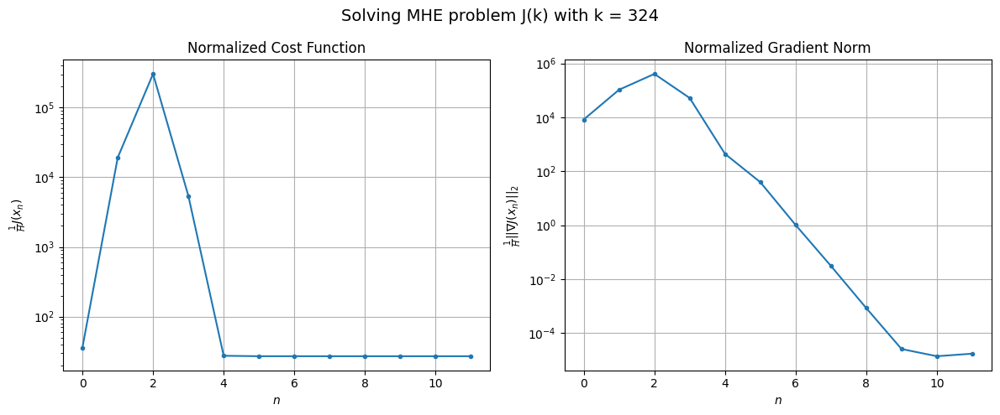

Windows:  82%|████████▏ | 316/386 [17:44<04:07,  3.53s/it]

[Gauss-Newton] Before applying the algorithm
Cost function: 363.4863587348377
Gradient norm: 94850.19056070434
Global estimation error: 6825.995539825533
Initial conditions estimation errors: 0.48636019232389643 m, 1764.437392437545 m, 1645.8977377424942 m, 6385.294063066613 m
Position estimation errors: 1.6825364101037863 m, 1867.841076010263 m, 1488.5876366990824 m, 7264.258508006824 m

[Gauss-Newton] Iteration 1
Cost function: 3166.329121431618 (771.10%)
Gradient norm: 110485.40100538758 (16.48%)
Global estimation error: 8034.15648492554 (17.70%)
Initial conditions estimation errors: 0.9639318339008078 m, 2035.9903438366296 m, 1839.2686649148225 m, 7551.124957299071 m
Position estimation errors: 1.1247582574775312 m, 2065.003021179942 m, 1586.3797741122314 m, 8200.774382192587 m

[Gauss-Newton] Iteration 2
Cost function: 715.9748962121737 (-77.39%)
Gradient norm: 52201.861874141694 (-52.75%)
Global estimation error: 8624.331894596757 (7.35%)
Initial conditions estimation errors: 0.9

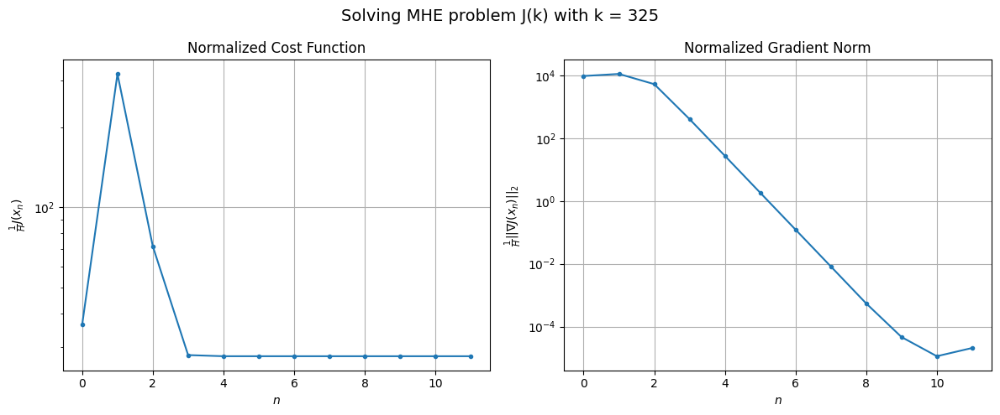

Windows:  82%|████████▏ | 317/386 [17:47<04:03,  3.53s/it]

[Gauss-Newton] Before applying the algorithm
Cost function: 453.8267535394157
Gradient norm: 123243.12688278513
Global estimation error: 9108.2341689421
Initial conditions estimation errors: 0.5007389769734346 m, 2295.523330731425 m, 2040.7452915700665 m, 8574.721266798468 m
Position estimation errors: 2.101165540375056 m, 2268.715046246551 m, 1717.5521091281569 m, 9074.996663477776 m

[Gauss-Newton] Iteration 1
Cost function: 4406.620362744188 (870.99%)
Gradient norm: 114674.00525454721 (-6.95%)
Global estimation error: 7701.463298709284 (-15.45%)
Initial conditions estimation errors: 0.9689545246001255 m, 1942.276183614183 m, 1734.0565403940425 m, 7247.973973534442 m
Position estimation errors: 1.3753499778799996 m, 2071.611603032983 m, 1580.746628778306 m, 8227.241245059979 m

[Gauss-Newton] Iteration 2
Cost function: 349.81279272955175 (-92.06%)
Gradient norm: 301.9964739529118 (-99.74%)
Global estimation error: 7674.32506758267 (-0.35%)
Initial conditions estimation errors: 0.9689

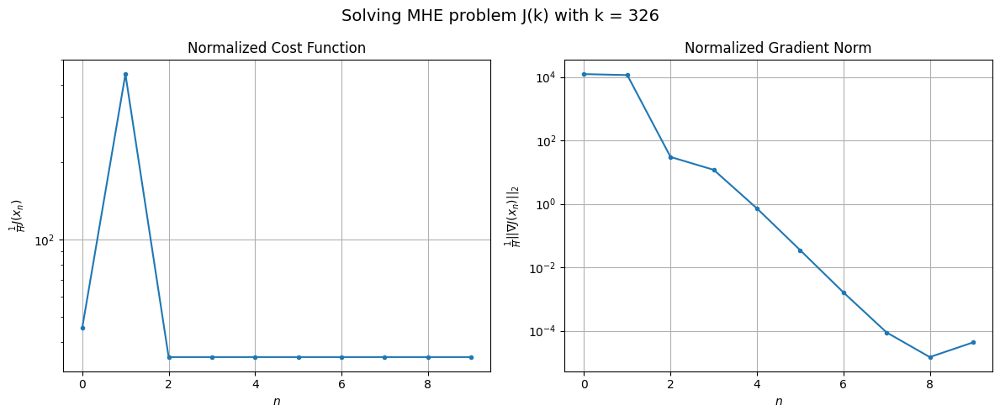

Windows:  82%|████████▏ | 318/386 [17:50<03:50,  3.39s/it]

[Gauss-Newton] Before applying the algorithm
Cost function: 586.454483797055
Gradient norm: 143591.75150243496
Global estimation error: 7938.756508321774
Initial conditions estimation errors: 0.5548253955739856 m, 1989.3405412578986 m, 1742.0857169296494 m, 7485.419220759657 m
Position estimation errors: 2.534247954248619 m, 2030.7001508986984 m, 1519.3801119128148 m, 8122.645238692921 m

[Gauss-Newton] Iteration 1
Cost function: 1051090.2888553492 (179127.94%)
Gradient norm: 2433824.4155570595 (1594.96%)
Global estimation error: 12528.125549784756 (57.81%)
Initial conditions estimation errors: 1.1280394360792056 m, 3137.2140279206174 m, 2713.7184662708846 m, 11821.485037133318 m
Position estimation errors: 1.6472455093896992 m, 3198.651918792883 m, 2402.9644154380667 m, 12927.81165716287 m

[Gauss-Newton] Iteration 2
Cost function: 1911.2899926555951 (-99.82%)
Gradient norm: 90117.46275218752 (-96.30%)
Global estimation error: 11603.435650582516 (-7.38%)
Initial conditions estimation 

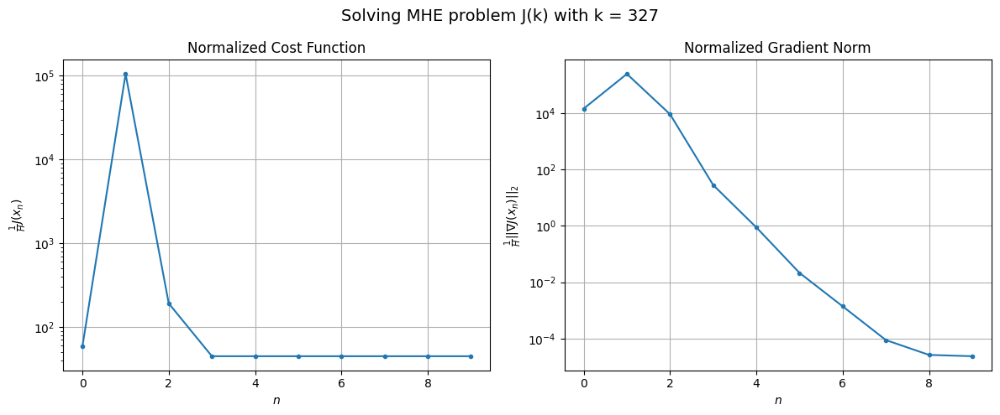

Windows:  83%|████████▎ | 319/386 [17:54<03:43,  3.34s/it]

[Gauss-Newton] Before applying the algorithm
Cost function: 796.8263998576768
Gradient norm: 167595.53491669407
Global estimation error: 11853.70546243615
Initial conditions estimation errors: 0.6263217017087777 m, 2950.8134345515823 m, 2513.9329086305984 m, 11201.926108317577 m
Position estimation errors: 2.930964861425594 m, 2892.9101978460917 m, 2139.0930352864534 m, 11777.48622916662 m

[Gauss-Newton] Iteration 1
Cost function: 335926.64488071896 (42058.07%)
Gradient norm: 1394194.331184524 (731.88%)
Global estimation error: 8543.18504933902 (-27.93%)
Initial conditions estimation errors: 1.3816002847329405 m, 2094.1430845380355 m, 1715.5475117854742 m, 8102.929208046479 m
Position estimation errors: 1.8113482763206672 m, 1992.3725123232346 m, 1426.9992832428823 m, 8152.320667552804 m

[Gauss-Newton] Iteration 2
Cost function: 2016.9283689825356 (-99.40%)
Gradient norm: 93183.46062993834 (-93.32%)
Global estimation error: 7699.308057782612 (-9.88%)
Initial conditions estimation err

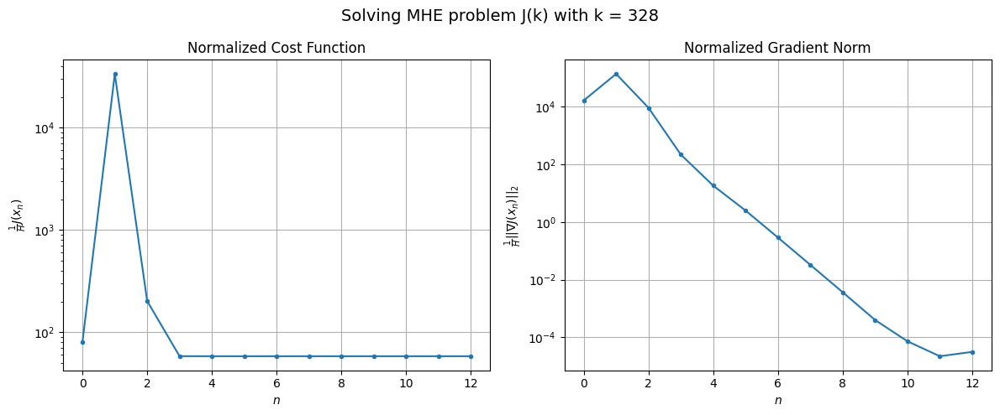

Windows:  83%|████████▎ | 320/386 [17:57<03:50,  3.50s/it]

[Gauss-Newton] Before applying the algorithm
Cost function: 954.8120509470252
Gradient norm: 179110.43170150014
Global estimation error: 7662.1946460351655
Initial conditions estimation errors: 0.715212810383405 m, 1861.7562477351237 m, 1487.477686926959 m, 7282.20418250795 m
Position estimation errors: 3.134173011229245 m, 1635.4737757831413 m, 1148.068157958582 m, 6745.340531563387 m

[Gauss-Newton] Iteration 1
Cost function: 21062.61722301349 (2105.94%)
Gradient norm: 278736.0683329827 (55.62%)
Global estimation error: 5617.84908181932 (-26.68%)
Initial conditions estimation errors: 1.6767962810832162 m, 1319.7767105064815 m, 1033.5349470824615 m, 5361.922879307994 m
Position estimation errors: 1.8543165684722678 m, 1317.518393988046 m, 913.5134551485937 m, 5316.706582069767 m



/home/jgaspar/SpaceSim-Toolkit/test/new_newton_based_algorithms/gauss_newton.py:181: LinAlgWarning: Ill-conditioned matrix (rcond=1.03753e-16): result may not be accurate.
  delta_x = solve(HJ_x, -DJ_x)


[Gauss-Newton] STOP on Iteration 2 (gradient norm stagnated)
Cost function = 6886.318651160545 (-67.31%)
Gradient norm = 189175.61111363198 (-32.13%)
Global estimation error = 4343.953322255699 (-22.68%)
Final initial conditions estimation errors: 1.6767962928967515 m, 1015.9006581163337 m, 792.8403355805827 m, 4148.406495575705 m
Final position estimation errors: 1.8543165612340116 m, 984.7440762393104 m, 679.4876893349696 m, 3947.287569641795 m



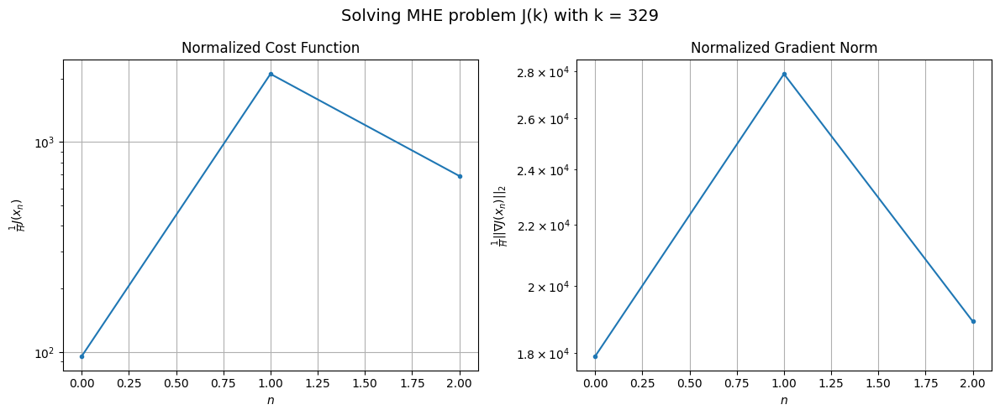

Windows:  83%|████████▎ | 321/386 [17:59<03:05,  2.85s/it]

[Gauss-Newton] Before applying the algorithm
Cost function: 7652.499709662947
Gradient norm: 247354.146571134
Global estimation error: 4395.5531846874965
Initial conditions estimation errors: 0.8026592103618445 m, 1030.6111242213951 m, 792.6132985639919 m, 4198.867861320186 m
Position estimation errors: 3.1735793287383114 m, 958.895338196657 m, 652.5239153897123 m, 3836.000019124314 m



/home/jgaspar/SpaceSim-Toolkit/test/new_newton_based_algorithms/gauss_newton.py:181: LinAlgWarning: Ill-conditioned matrix (rcond=3.97444e-17): result may not be accurate.
  delta_x = solve(HJ_x, -DJ_x)


[Gauss-Newton] Iteration 1
Cost function: 208418228.40336698 (2723431.35%)
Gradient norm: 32637583.70066894 (13094.68%)
Global estimation error: 14713.398022272791 (234.73%)
Initial conditions estimation errors: 1.9379509618237856 m, 3504.0150670746107 m, 2775.6221864662903 m, 14017.912043524828 m
Position estimation errors: 1.7416050271593 m, 3283.7558709006125 m, 2244.825569599034 m, 13785.81854116222 m

[Gauss-Newton] Iteration 2
Cost function: 19368591.302404094 (-90.71%)
Gradient norm: 10336798.047471587 (-68.33%)
Global estimation error: 4083.5393806320435 (-72.25%)
Initial conditions estimation errors: 1.9379509351232884 m, 985.9437865018531 m, 833.8287549975673 m, 3874.0074242636497 m
Position estimation errors: 1.741605042072123 m, 767.9011691970038 m, 504.5044655346872 m, 3304.579020806738 m



/home/jgaspar/SpaceSim-Toolkit/test/new_newton_based_algorithms/gauss_newton.py:181: LinAlgWarning: Ill-conditioned matrix (rcond=1.09221e-16): result may not be accurate.
  delta_x = solve(HJ_x, -DJ_x)


[Gauss-Newton] Iteration 3
Cost function: 931387.8678106248 (-95.19%)
Gradient norm: 2236920.373775978 (-78.36%)
Global estimation error: 851.9579933254497 (-79.14%)
Initial conditions estimation errors: 1.937950896386004 m, 183.2082290291647 m, 113.91558680697302 m, 824.1862461062516 m
Position estimation errors: 1.741605065415475 m, 400.0461502822377 m, 302.84170335475795 m, 1563.009977750381 m



/home/jgaspar/SpaceSim-Toolkit/test/new_newton_based_algorithms/gauss_newton.py:181: LinAlgWarning: Ill-conditioned matrix (rcond=1.14161e-17): result may not be accurate.
  delta_x = solve(HJ_x, -DJ_x)


[Gauss-Newton] Iteration 4
Cost function: 727856158.4717554 (78047.48%)
Gradient norm: 61698157.532120205 (2658.17%)
Global estimation error: 25430.691799498716 (2884.97%)
Initial conditions estimation errors: 1.937950843823125 m, 6079.222967919289 m, 4840.613868631373 m, 24214.28375247557 m
Position estimation errors: 1.741605065906496 m, 5543.677897019777 m, 3793.6767264114615 m, 23271.27387558949 m

[Gauss-Newton] Iteration 5
Cost function: 116108569.72112715 (-84.05%)
Gradient norm: 24727074.867306177 (-59.92%)
Global estimation error: 8162.011965390602 (-67.90%)
Initial conditions estimation errors: 1.93795098361504 m, 1960.9634655139566 m, 1602.7671507987877 m, 7759.136053841207 m
Position estimation errors: 1.7416050161233154 m, 1647.644358758829 m, 1107.9422781200026 m, 6983.301867328072 m

[Gauss-Newton] Iteration 6
Cost function: 3745634.249368581 (-96.77%)
Gradient norm: 4412712.833245304 (-82.15%)
Global estimation error: 871.59824517944 (-89.32%)
Initial conditions estimat

/home/jgaspar/SpaceSim-Toolkit/test/new_newton_based_algorithms/gauss_newton.py:181: LinAlgWarning: Ill-conditioned matrix (rcond=2.64197e-17): result may not be accurate.
  delta_x = solve(HJ_x, -DJ_x)


[Gauss-Newton] Iteration 7
Cost function: 122450.1245814837 (-96.73%)
Gradient norm: 760827.0389399967 (-82.76%)
Global estimation error: 3691.7883490094205 (323.57%)
Initial conditions estimation errors: 1.9379508530126308 m, 903.6063407157166 m, 786.1905053998036 m, 3492.0905481036925 m
Position estimation errors: 1.7416050755461534 m, 577.5995497855471 m, 366.078436129142 m, 2527.0626536486598 m



/home/jgaspar/SpaceSim-Toolkit/test/new_newton_based_algorithms/gauss_newton.py:181: LinAlgWarning: Ill-conditioned matrix (rcond=9.25369e-17): result may not be accurate.
  delta_x = solve(HJ_x, -DJ_x)


[Gauss-Newton] Iteration 8
Cost function: 523994.82219731645 (327.93%)
Gradient norm: 1619610.6615081744 (112.88%)
Global estimation error: 582.3023992722901 (-84.23%)
Initial conditions estimation errors: 1.9379508918853112 m, 119.1367346094127 m, 85.63693092582174 m, 563.5082614646923 m
Position estimation errors: 1.7416050625592383 m, 341.7980128852162 m, 263.14945443558753 m, 1318.942202229801 m



/home/jgaspar/SpaceSim-Toolkit/test/new_newton_based_algorithms/gauss_newton.py:181: LinAlgWarning: Ill-conditioned matrix (rcond=1.26501e-17): result may not be accurate.
  delta_x = solve(HJ_x, -DJ_x)


[Gauss-Newton] Iteration 9
Cost function: 317063311.3692136 (60408.86%)
Gradient norm: 40604976.64567835 (2407.08%)
Global estimation error: 20576.83763376679 (3433.70%)
Initial conditions estimation errors: 1.9379508375342474 m, 4925.808172654624 m, 3940.736847631302 m, 19586.046632962454 m
Position estimation errors: 1.7416050700863566 m, 4416.175548989326 m, 3014.252725376373 m, 18564.592646765777 m

[Gauss-Newton] Iteration 10
Cost function: 50214262.353037946 (-84.16%)
Gradient norm: 16125891.338175297 (-60.29%)
Global estimation error: 6809.290525389475 (-66.91%)
Initial conditions estimation errors: 1.9379509495449372 m, 1636.7228863005134 m, 1343.4448263527088 m, 6471.686522514148 m
Position estimation errors: 1.7416050342040403 m, 1348.5444621317681 m, 902.4814478189475 m, 5734.1877109618 m

[Gauss-Newton] Iteration 11
Cost function: 2535517.036115145 (-94.95%)
Gradient norm: 3639492.7063122033 (-77.43%)
Global estimation error: 537.2282983698557 (-92.11%)
Initial conditions e

/home/jgaspar/SpaceSim-Toolkit/test/new_newton_based_algorithms/gauss_newton.py:181: LinAlgWarning: Ill-conditioned matrix (rcond=2.09909e-17): result may not be accurate.
  delta_x = solve(HJ_x, -DJ_x)


[Gauss-Newton] Iteration 12
Cost function: 2591162.1468565124 (2.19%)
Gradient norm: 3591983.3277276526 (-1.31%)
Global estimation error: 6637.220209927569 (1135.46%)
Initial conditions estimation errors: 1.9379508440426527 m, 1606.3840482135101 m, 1338.4043129199183 m, 6299.27707044925 m
Position estimation errors: 1.7416050731846107 m, 1239.5399329730105 m, 822.3419200877036 m, 5294.803298339652 m

[Gauss-Newton] STOP on Iteration 13 (gradient norm stagnated)
Cost function = 2108747.822812418 (-18.62%)
Gradient norm = 3242244.4294982604 (-9.74%)
Global estimation error = 754.3831865595914 (-88.63%)
Final initial conditions estimation errors: 1.9379509067483731 m, 189.77845314600148 m, 217.5031641733307 m, 696.9683219351278 m
Final position estimation errors: 1.74160505780671 m, 102.21430308415992 m, 82.39900670540648 m, 364.1867272235722 m



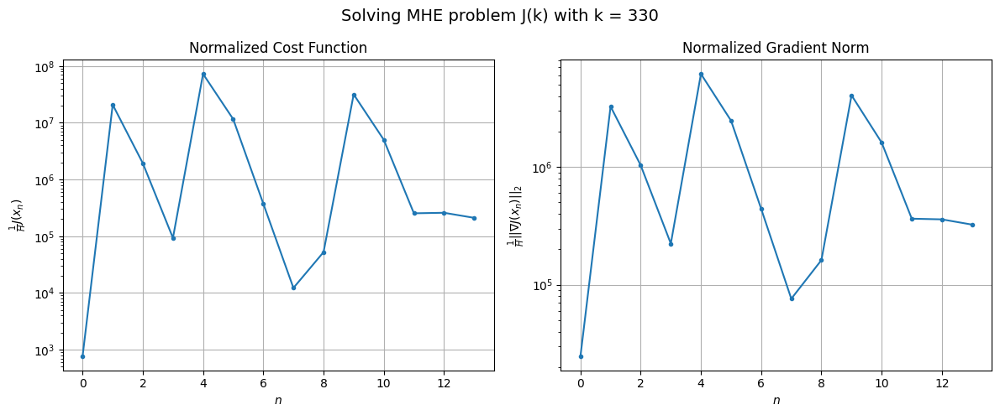

Windows:  83%|████████▎ | 322/386 [18:03<03:35,  3.37s/it]

[Gauss-Newton] Before applying the algorithm
Cost function: 2011243.63673278
Gradient norm: 3075584.752813592
Global estimation error: 684.5428048255873
Initial conditions estimation errors: 0.8718683506926711 m, 170.04131832472666 m, 190.41409123840288 m, 635.1570660286552 m
Position estimation errors: 3.0458345161173965 m, 116.71006722491673 m, 105.40444351525409 m, 395.6819708817582 m



/home/jgaspar/SpaceSim-Toolkit/test/new_newton_based_algorithms/gauss_newton.py:181: LinAlgWarning: Ill-conditioned matrix (rcond=1.37762e-17): result may not be accurate.
  delta_x = solve(HJ_x, -DJ_x)


[Gauss-Newton] Iteration 1
Cost function: 1532840882.8424153 (76113.59%)
Gradient norm: 88627878.01184765 (2781.66%)
Global estimation error: 32170.237508253085 (4599.52%)
Initial conditions estimation errors: 1.9668732693958644 m, 7590.881903207615 m, 5760.851579739623 m, 30726.45720676894 m
Position estimation errors: 1.7616757264431129 m, 7234.48590113563 m, 4961.017311209069 m, 30226.582757069325 m

[Gauss-Newton] Iteration 2
Cost function: 373549011.0452404 (-75.63%)
Gradient norm: 45456327.204024374 (-48.71%)
Global estimation error: 9516.159342285544 (-70.42%)
Initial conditions estimation errors: 1.9668734132160037 m, 2261.4732646554867 m, 1702.6035233084096 m, 9085.381581695976 m
Position estimation errors: 1.7616757102990157 m, 2054.260084643216 m, 1409.7141104326604 m, 8547.139736993726 m

[Gauss-Newton] STOP on Iteration 3 (gradient norm stagnated)
Cost function = 294817836.6291765 (-21.08%)
Gradient norm = 39695794.35969448 (-12.67%)
Global estimation error = 12710.5622402

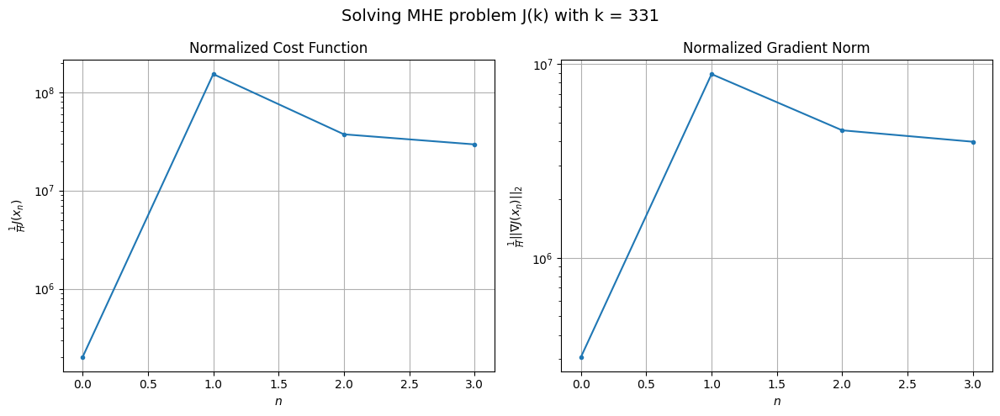

Windows:  84%|████████▎ | 323/386 [18:05<02:58,  2.83s/it]

[Gauss-Newton] Before applying the algorithm
Cost function: 290058334.20639527
Gradient norm: 38732739.08700817
Global estimation error: 13071.809747160554
Initial conditions estimation errors: 0.7883903968385279 m, 3052.1561976226617 m, 2276.9345794811375 m, 12504.88262339777 m
Position estimation errors: 3.1159456644348986 m, 3130.711539905744 m, 2120.837954638336 m, 13140.550262700724 m

[Gauss-Newton] Iteration 1
Cost function: 42830328.44885264 (-85.23%)
Gradient norm: 15472744.504217912 (-60.05%)
Global estimation error: 1592.798537382237 (-87.82%)
Initial conditions estimation errors: 1.8872941469741389 m, 374.3304166598468 m, 273.6221480262563 m, 1523.81439828188 m
Position estimation errors: 1.8151747461922918 m, 425.6473482204655 m, 289.6569944260508 m, 1754.0406319428957 m



/home/jgaspar/SpaceSim-Toolkit/test/new_newton_based_algorithms/gauss_newton.py:181: LinAlgWarning: Ill-conditioned matrix (rcond=5.87827e-18): result may not be accurate.
  delta_x = solve(HJ_x, -DJ_x)


[Gauss-Newton] STOP on Iteration 2 (gradient norm stagnated)
Cost function = 380312515.8059105 (787.95%)
Gradient norm = 45532385.78216934 (194.27%)
Global estimation error = 21916.247010540075 (1275.96%)
Final initial conditions estimation errors: 1.8872941158503496 m, 5123.406088655018 m, 3738.0888518076677 m, 20978.54136500706 m
Final position estimation errors: 1.815174747920916 m, 5229.658478147114 m, 3613.775319389715 m, 21779.20819649235 m



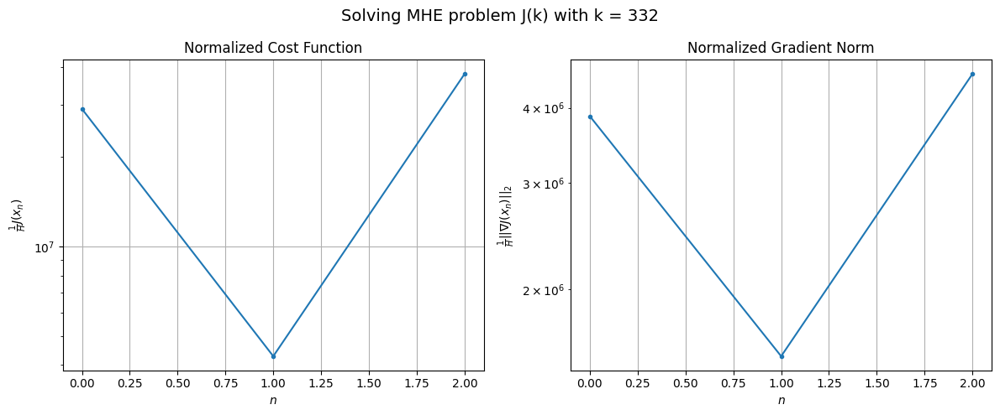

Windows:  84%|████████▍ | 324/386 [18:06<02:28,  2.39s/it]

[Gauss-Newton] Before applying the algorithm
Cost function: 377909741.97901225
Gradient norm: 44678120.34346633
Global estimation error: 22398.724206808925
Initial conditions estimation errors: 0.7033471512902043 m, 5228.329421210269 m, 3785.0666375832 m, 21448.557762068092 m
Position estimation errors: 3.2557774844179397 m, 5124.550265544919 m, 3526.257150532181 m, 21388.161317336097 m

[Gauss-Newton] Iteration 1
Cost function: 4541539.259498752 (-98.80%)
Gradient norm: 4858243.258481077 (-89.13%)
Global estimation error: 13729.434866067237 (-38.70%)
Initial conditions estimation errors: 1.8440706781728582 m, 3231.4389826137767 m, 2352.5399760173013 m, 13134.713898216789 m
Position estimation errors: 1.8857291211929437 m, 3166.4363274975804 m, 2169.549789748055 m, 13391.647701243395 m

[Gauss-Newton] Iteration 2
Cost function: 1226.936863182511 (-99.97%)
Gradient norm: 62513.54442070141 (-98.71%)
Global estimation error: 14202.651955501251 (3.45%)
Initial conditions estimation errors:

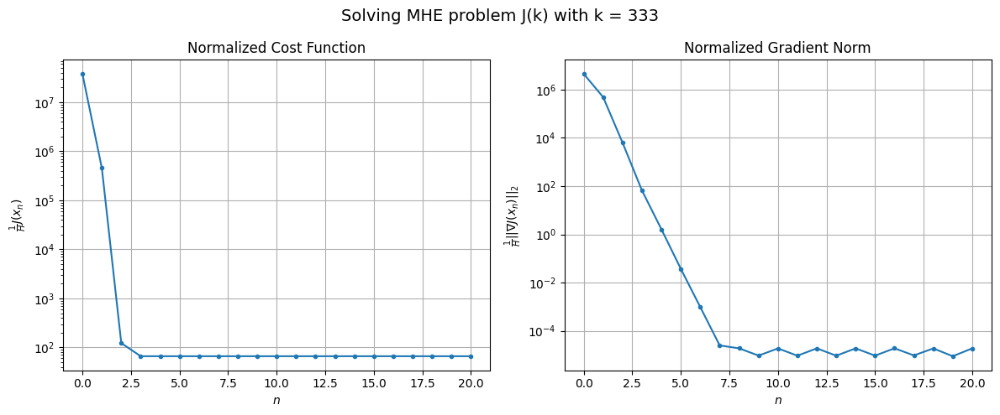

Windows:  84%|████████▍ | 325/386 [18:12<03:30,  3.45s/it]

[Gauss-Newton] Before applying the algorithm
Cost function: 1145.488393089105
Gradient norm: 193009.5605223927
Global estimation error: 14572.997144202047
Initial conditions estimation errors: 0.6843771917466425 m, 3408.5553110851797 m, 2449.0435576550008 m, 13955.50628801015 m
Position estimation errors: 3.4829615853010574 m, 3313.9913918078755 m, 2276.058305754343 m, 14013.202577666849 m

[Gauss-Newton] Iteration 1
Cost function: 81828.58083897311 (7043.55%)
Gradient norm: 260485.2969252046 (34.96%)
Global estimation error: 18138.181388676094 (24.46%)
Initial conditions estimation errors: 1.823578662609499 m, 4282.77714672469 m, 3213.487043789807 m, 17329.88571996988 m
Position estimation errors: 2.0212499206046166 m, 3382.5278662674837 m, 2132.0999808248444 m, 14553.587759417851 m

[Gauss-Newton] STOP on Iteration 2 (gradient norm stagnated)
Cost function = 2889.113364731714 (-96.47%)
Gradient norm = 113866.77087677934 (-56.29%)
Global estimation error = 19053.059127210894 (5.04%)
F

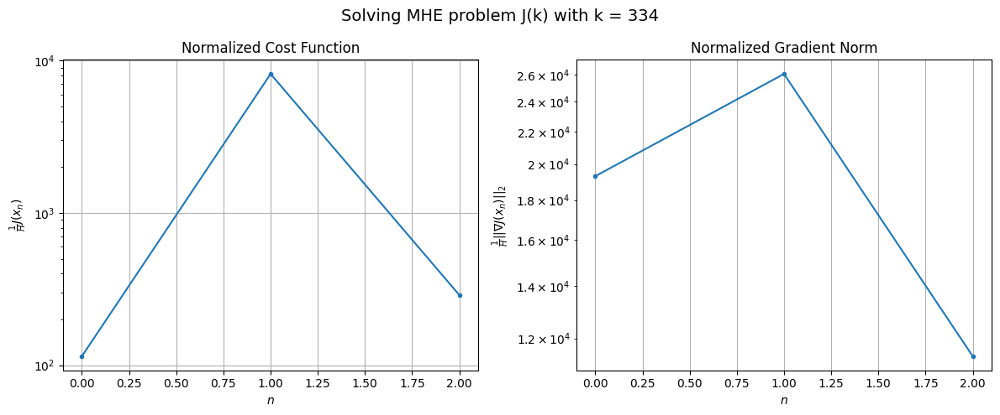

Windows:  84%|████████▍ | 326/386 [18:14<02:50,  2.83s/it]

[Gauss-Newton] Before applying the algorithm
Cost function: 3794.2719021194907
Gradient norm: 228168.3673639104
Global estimation error: 19061.37333454982
Initial conditions estimation errors: 0.6661875676151248 m, 4469.98191792013 m, 3291.745827848725 m, 18235.120560732616 m
Position estimation errors: 3.8814301285740602 m, 3453.865226726468 m, 2157.462306103926 m, 14989.480403012542 m

[Gauss-Newton] Iteration 1
Cost function: 3868830.355133617 (101865.03%)
Gradient norm: 4505238.371562388 (1874.52%)
Global estimation error: 12307.591536803944 (-35.43%)
Initial conditions estimation errors: 1.9212684923314096 m, 2910.0215925932516 m, 2167.8336441980714 m, 11760.487604589205 m
Position estimation errors: 2.2480502996731455 m, 1928.627707715827 m, 1141.0946738187608 m, 8504.067778521337 m

[Gauss-Newton] Iteration 2
Cost function: 97429.4163752148 (-97.48%)
Gradient norm: 691582.6296482079 (-84.65%)
Global estimation error: 9402.44116232032 (-23.60%)
Initial conditions estimation error

/home/jgaspar/SpaceSim-Toolkit/test/new_newton_based_algorithms/gauss_newton.py:181: LinAlgWarning: Ill-conditioned matrix (rcond=9.87477e-17): result may not be accurate.
  delta_x = solve(HJ_x, -DJ_x)


[Gauss-Newton] Iteration 4
Cost function: 876.0678894467965 (-18.73%)
Gradient norm: 189.0339063096801 (-99.41%)
Global estimation error: 8737.29390798696 (-0.60%)
Initial conditions estimation errors: 1.9212684828397804 m, 2081.7611909638595 m, 1577.7598555630325 m, 8337.69948773506 m
Position estimation errors: 2.248050288996665 m, 1167.886544621909 m, 632.6106381452034 m, 5344.652640626832 m



/home/jgaspar/SpaceSim-Toolkit/test/new_newton_based_algorithms/gauss_newton.py:181: LinAlgWarning: Ill-conditioned matrix (rcond=9.76398e-17): result may not be accurate.
  delta_x = solve(HJ_x, -DJ_x)


[Gauss-Newton] Iteration 5
Cost function: 876.0593884856405 (-0.00%)
Gradient norm: 8.783442144239418 (-95.35%)
Global estimation error: 8729.937445550222 (-0.08%)
Initial conditions estimation errors: 1.9212684827858315 m, 2080.043393863661 m, 1576.6725453818137 m, 8330.625105048599 m
Position estimation errors: 2.24805028891775 m, 1165.8041416649871 m, 630.8023278614909 m, 5334.594694128942 m



/home/jgaspar/SpaceSim-Toolkit/test/new_newton_based_algorithms/gauss_newton.py:181: LinAlgWarning: Ill-conditioned matrix (rcond=9.73211e-17): result may not be accurate.
  delta_x = solve(HJ_x, -DJ_x)


[Gauss-Newton] Iteration 6
Cost function: 876.0593741540882 (-0.00%)
Gradient norm: 0.7376313482993295 (-91.60%)
Global estimation error: 8731.503304255466 (0.02%)
Initial conditions estimation errors: 1.9212684827577964 m, 2080.408445269129 m, 1576.866615719709 m, 8332.138142667247 m
Position estimation errors: 2.2480502890280203 m, 1166.4212119062963 m, 631.400807699417 m, 5337.695856100133 m



/home/jgaspar/SpaceSim-Toolkit/test/new_newton_based_algorithms/gauss_newton.py:181: LinAlgWarning: Ill-conditioned matrix (rcond=9.74212e-17): result may not be accurate.
  delta_x = solve(HJ_x, -DJ_x)


[Gauss-Newton] Iteration 7
Cost function: 876.0593735699871 (-0.00%)
Gradient norm: 0.15261005574687864 (-79.31%)
Global estimation error: 8730.77664369192 (-0.01%)
Initial conditions estimation errors: 1.9212684828397804 m, 2080.2397253039862 m, 1576.7756379323964 m, 8331.435996427757 m
Position estimation errors: 2.248050289759074 m, 1166.135173984976 m, 631.1291510060586 m, 5336.290569359041 m



/home/jgaspar/SpaceSim-Toolkit/test/new_newton_based_algorithms/gauss_newton.py:181: LinAlgWarning: Ill-conditioned matrix (rcond=9.73761e-17): result may not be accurate.
  delta_x = solve(HJ_x, -DJ_x)


[Gauss-Newton] Iteration 8
Cost function: 876.0593735184975 (-0.00%)
Gradient norm: 0.027582028183363954 (-81.93%)
Global estimation error: 8731.080325832681 (0.00%)
Initial conditions estimation errors: 1.9212684828397804 m, 2080.310098909042 m, 1576.8131840423182 m, 8331.729557767045 m
Position estimation errors: 2.248050289385445 m, 1166.257616691288 m, 631.2452356718724 m, 5336.888122987393 m



/home/jgaspar/SpaceSim-Toolkit/test/new_newton_based_algorithms/gauss_newton.py:181: LinAlgWarning: Ill-conditioned matrix (rcond=9.73953e-17): result may not be accurate.
  delta_x = solve(HJ_x, -DJ_x)


[Gauss-Newton] Iteration 9
Cost function: 876.0593735228072 (0.00%)
Gradient norm: 0.0050409717342972575 (-81.72%)
Global estimation error: 8730.952837812558 (-0.00%)
Initial conditions estimation errors: 1.9212684827858315 m, 2080.2805840084884 m, 1576.7975038626998 m, 8331.606295920552 m
Position estimation errors: 2.2480502888550395 m, 1166.2056804341269 m, 631.1960670315913 m, 5336.635564360728 m



/home/jgaspar/SpaceSim-Toolkit/test/new_newton_based_algorithms/gauss_newton.py:181: LinAlgWarning: Ill-conditioned matrix (rcond=9.73872e-17): result may not be accurate.
  delta_x = solve(HJ_x, -DJ_x)


[Gauss-Newton] Iteration 10
Cost function: 876.0593734819146 (-0.00%)
Gradient norm: 0.0010273125991385626 (-79.62%)
Global estimation error: 8731.006290122026 (0.00%)
Initial conditions estimation errors: 1.9212684827858315 m, 2080.2929524606334 m, 1576.8040608652236 m, 8331.65798116613 m
Position estimation errors: 2.2480502890280203 m, 1166.2275691303767 m, 631.216773452312 m, 5336.741808440767 m



/home/jgaspar/SpaceSim-Toolkit/test/new_newton_based_algorithms/gauss_newton.py:181: LinAlgWarning: Ill-conditioned matrix (rcond=9.73906e-17): result may not be accurate.
  delta_x = solve(HJ_x, -DJ_x)


[Gauss-Newton] Iteration 11
Cost function: 876.0593734608483 (-0.00%)
Gradient norm: 0.0003579053126980086 (-65.16%)
Global estimation error: 8730.983907080014 (-0.00%)
Initial conditions estimation errors: 1.9212684828117452 m, 2080.287774545809 m, 1576.8013192465626 m, 8331.636336963502 m
Position estimation errors: 2.248050289806107 m, 1166.2183769938126 m, 631.2080807406929 m, 5336.697232447389 m



/home/jgaspar/SpaceSim-Toolkit/test/new_newton_based_algorithms/gauss_newton.py:181: LinAlgWarning: Ill-conditioned matrix (rcond=9.73891e-17): result may not be accurate.
  delta_x = solve(HJ_x, -DJ_x)


[Gauss-Newton] Iteration 12
Cost function: 876.0593735014158 (0.00%)
Gradient norm: 0.00011649623192960703 (-67.45%)
Global estimation error: 8730.993278182448 (0.00%)
Initial conditions estimation errors: 1.9212684828397804 m, 2080.2899420801637 m, 1576.8024662063492 m, 8331.645398976887 m
Position estimation errors: 2.248050289385445 m, 1166.2222310926084 m, 631.2117247550075 m, 5336.715913191807 m



/home/jgaspar/SpaceSim-Toolkit/test/new_newton_based_algorithms/gauss_newton.py:181: LinAlgWarning: Ill-conditioned matrix (rcond=9.73897e-17): result may not be accurate.
  delta_x = solve(HJ_x, -DJ_x)


[Gauss-Newton] STOP on Iteration 13 (gradient norm stagnated)
Cost function = 876.0593735198981 (0.00%)
Gradient norm = 0.00022718877172663585 (95.02%)
Global estimation error = 8730.989353620895 (-0.00%)
Final initial conditions estimation errors: 1.9212684827858315 m, 2080.2890343961576 m, 1576.8019859854996 m, 8331.641603820872 m
Final position estimation errors: 2.2480502888550395 m, 1166.2206161039037 m, 631.2101980598667 m, 5336.708087707928 m



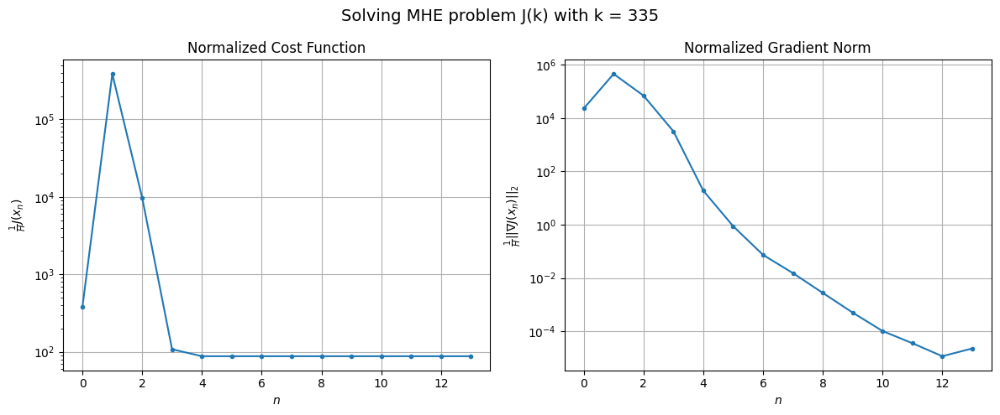

Windows:  85%|████████▍ | 327/386 [18:18<03:12,  3.27s/it]

[Gauss-Newton] Before applying the algorithm
Cost function: 1757.9433047842856
Gradient norm: 259359.35027999047
Global estimation error: 8505.880807212188
Initial conditions estimation errors: 0.7299426230029208 m, 2010.3967257483182 m, 1492.3673689690293 m, 8129.030391805022 m
Position estimation errors: 4.463382803604008 m, 1031.593352060528 m, 510.17371490442196 m, 4864.102033996325 m



/home/jgaspar/SpaceSim-Toolkit/test/new_newton_based_algorithms/gauss_newton.py:181: LinAlgWarning: Ill-conditioned matrix (rcond=7.8481e-17): result may not be accurate.
  delta_x = solve(HJ_x, -DJ_x)


[Gauss-Newton] Iteration 1
Cost function: 1375739628.0653398 (78258375.36%)
Gradient norm: 80371627.9194223 (30888.52%)
Global estimation error: 25502.889582747848 (199.83%)
Initial conditions estimation errors: 2.087935931531424 m, 5901.89312503893 m, 4129.81007874317 m, 24464.45708450206 m
Position estimation errors: 2.5662601045584057 m, 5516.944712495729 m, 3817.5138347294 m, 23036.40959706672 m

[Gauss-Newton] Iteration 2
Cost function: 106428346.2744993 (-92.26%)
Gradient norm: 24910178.87020581 (-69.01%)
Global estimation error: 6945.626183305444 (-72.77%)
Initial conditions estimation errors: 2.087935842825346 m, 1611.875427266629 m, 1133.9470178021147 m, 6660.15975806531 m
Position estimation errors: 2.566260119306255 m, 1320.0423488345245 m, 968.0351709310427 m, 5671.646438029873 m



/home/jgaspar/SpaceSim-Toolkit/test/new_newton_based_algorithms/gauss_newton.py:181: LinAlgWarning: Ill-conditioned matrix (rcond=2.44131e-17): result may not be accurate.
  delta_x = solve(HJ_x, -DJ_x)


[Gauss-Newton] Iteration 3
Cost function: 4055140380.278136 (3710.21%)
Gradient norm: 142139238.57897082 (470.61%)
Global estimation error: 38394.15015925233 (452.78%)
Initial conditions estimation errors: 2.087935919796821 m, 8900.4393934591 m, 6305.167095547274 m, 36812.19507550134 m
Position estimation errors: 2.5662601129945166 m, 8260.168802287944 m, 5589.914473193755 m, 34326.468185631384 m

[Gauss-Newton] Iteration 4
Cost function: 653685492.958776 (-83.88%)
Gradient norm: 69260066.45365596 (-51.27%)
Global estimation error: 15377.251642198435 (-59.95%)
Initial conditions estimation errors: 2.087935967087274 m, 3621.811853337023 m, 3102.7245486165343 m, 14618.97365375256 m
Position estimation errors: 2.5662599139605824 m, 2904.3565214885734 m, 2931.4726160854616 m, 9759.276692034726 m



/home/jgaspar/SpaceSim-Toolkit/test/new_newton_based_algorithms/gauss_newton.py:181: LinAlgWarning: Ill-conditioned matrix (rcond=7.94686e-17): result may not be accurate.
  delta_x = solve(HJ_x, -DJ_x)


[Gauss-Newton] Iteration 5
Cost function: 191905835.5666057 (-70.64%)
Gradient norm: 37870523.73150141 (-45.32%)
Global estimation error: 24916.470690508362 (62.03%)
Initial conditions estimation errors: 2.0879357557508156 m, 5873.17253393903 m, 3887.360255377523 m, 23900.30592593932 m
Position estimation errors: 2.5662604289477935 m, 5579.9806683874185 m, 3895.711307259469 m, 23021.447241472983 m

[Gauss-Newton] Iteration 6
Cost function: 15961619.783467487 (-91.68%)
Gradient norm: 8306968.283776416 (-78.06%)
Global estimation error: 14312.464913684926 (-42.56%)
Initial conditions estimation errors: 2.0879359902369723 m, 3329.5366504313733 m, 2302.8198088381873 m, 13727.994653256577 m
Position estimation errors: 2.5662600407412155 m, 3227.3430838379004 m, 2207.184672346199 m, 13171.561076464985 m

[Gauss-Newton] Iteration 7
Cost function: 75286252.83885568 (371.67%)
Gradient norm: 19419429.100534327 (133.77%)
Global estimation error: 2576.6113964867186 (-82.00%)
Initial conditions est

/home/jgaspar/SpaceSim-Toolkit/test/new_newton_based_algorithms/gauss_newton.py:181: LinAlgWarning: Ill-conditioned matrix (rcond=2.16948e-18): result may not be accurate.
  delta_x = solve(HJ_x, -DJ_x)


[Gauss-Newton] Iteration 8
Cost function: 4741813068.845442 (6198.38%)
Gradient norm: 165008701.47009408 (749.71%)
Global estimation error: 41732.40397278408 (1519.66%)
Initial conditions estimation errors: 2.0879360107217746 m, 9611.972779320098 m, 6633.535379726447 m, 40064.93639964367 m
Position estimation errors: 2.566260001713235 m, 11111.966544419021 m, 8012.539918016825 m, 44615.542583703966 m

[Gauss-Newton] Iteration 9
Cost function: 2948586922.2276425 (-37.82%)
Gradient norm: 125663684.58013012 (-23.84%)
Global estimation error: 14811.719262450913 (-64.51%)
Initial conditions estimation errors: 2.087935858331636 m, 3415.962517254554 m, 2448.9674162809692 m, 14202.840711371658 m
Position estimation errors: 2.566260115150292 m, 3362.9531861927935 m, 2409.455969824871 m, 13725.356553356329 m



/home/jgaspar/SpaceSim-Toolkit/test/new_newton_based_algorithms/gauss_newton.py:181: LinAlgWarning: Ill-conditioned matrix (rcond=2.9079e-17): result may not be accurate.
  delta_x = solve(HJ_x, -DJ_x)


[Gauss-Newton] Iteration 10
Cost function: 205872285.5680306 (-93.02%)
Gradient norm: 36374483.89640089 (-71.05%)
Global estimation error: 17018.584656068553 (14.90%)
Initial conditions estimation errors: 2.0879367069732337 m, 3857.0602316894638 m, 2597.337597073984 m, 16370.967088310297 m
Position estimation errors: 2.5662592149859975 m, 6433.837336823985 m, 4919.12893108925 m, 24876.485651365634 m

[Gauss-Newton] Iteration 11
Cost function: 509303105.9254275 (147.39%)
Gradient norm: 59622481.30119915 (63.91%)
Global estimation error: 3259.328917036939 (-80.85%)
Initial conditions estimation errors: 2.087935930492898 m, 685.7282444731549 m, 502.48549611893327 m, 3146.4864657715793 m
Position estimation errors: 2.566260112178487 m, 2072.7866290913257 m, 1700.5412878856812 m, 7689.31369849059 m



/home/jgaspar/SpaceSim-Toolkit/test/new_newton_based_algorithms/gauss_newton.py:181: LinAlgWarning: Ill-conditioned matrix (rcond=1.85326e-18): result may not be accurate.
  delta_x = solve(HJ_x, -DJ_x)


[Gauss-Newton] Iteration 12
Cost function: 24703709031.670883 (4750.49%)
Gradient norm: 365630073.65910643 (513.24%)
Global estimation error: 72950.03333865495 (2138.19%)
Initial conditions estimation errors: 2.0879362144723803 m, 16839.367366142014 m, 11901.336537796495 m, 69975.00038620745 m
Position estimation errors: 2.5662597585621603 m, 16866.86442359657 m, 11660.013160629223 m, 69404.90376845912 m

[Gauss-Newton] Iteration 13
Cost function: 12788827268.412666 (-48.23%)
Gradient norm: 307326191.2674583 (-15.95%)
Global estimation error: 23026.81799605816 (-68.43%)
Initial conditions estimation errors: 2.087935798136611 m, 5413.154971169563 m, 5237.9415155358865 m, 21759.763515215025 m
Position estimation errors: 2.5662598803099326 m, 12099.19586092633 m, 11379.611927390379 m, 42138.99857128297 m

[Gauss-Newton] Iteration 14
Cost function: 1986204249093.6284 (15430.78%)
Gradient norm: 3647729388.201483 (1086.92%)
Global estimation error: 298954.89949762647 (1198.29%)
Initial condi

/home/jgaspar/SpaceSim-Toolkit/test/new_newton_based_algorithms/gauss_newton.py:181: LinAlgWarning: Ill-conditioned matrix (rcond=5.81057e-17): result may not be accurate.
  delta_x = solve(HJ_x, -DJ_x)


[Gauss-Newton] STOP on Iteration 16 (gradient norm stagnated)
Cost function = 540596426943.5326 (-89.99%)
Gradient norm = 1941937725.2196362 (-66.99%)
Global estimation error = 159618.91859710374 (-66.32%)
Final initial conditions estimation errors: 2.0879250104447977 m, 38797.725749527555 m, 23551.25648396418 m, 153029.83163870894 m
Final position estimation errors: 2.5662795969317 m, 67216.04020475557 m, 48503.86446169612 m, 289564.0344531296 m



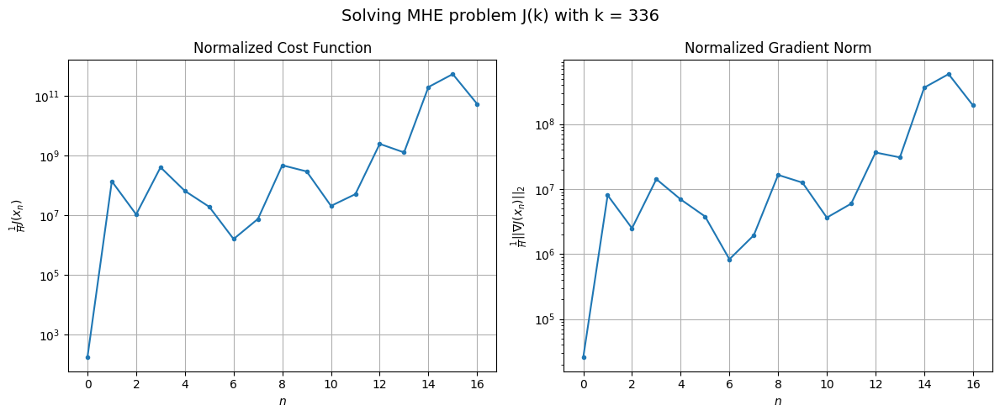

Windows:  85%|████████▍ | 328/386 [18:23<03:38,  3.78s/it]

[Gauss-Newton] Before applying the algorithm
Cost function: 636731647731.1919
Gradient norm: 2091306275.388278
Global estimation error: 176042.6611164817
Initial conditions estimation errors: 0.7989827941555234 m, 42044.319750288596 m, 26315.757679571372 m, 168910.14913567505 m
Position estimation errors: 5.179755356341898 m, 69647.57070753965 m, 50748.13499609754 m, 301509.32407738327 m

[Gauss-Newton] Iteration 1
Cost function: 173048543533.0056 (-72.82%)
Gradient norm: 1000925848.9843924 (-52.14%)
Global estimation error: 106817.8565679851 (-39.32%)
Initial conditions estimation errors: 2.382286584002302 m, 25957.166958265734 m, 13999.912228103256 m, 102665.77936852895 m
Position estimation errors: 3.021606748430966 m, 36356.61676825732 m, 39983.20210295084 m, 98778.9420266725 m

[Gauss-Newton] Iteration 2
Cost function: 63631941540.21765 (-63.23%)
Gradient norm: 593277735.7684901 (-40.73%)
Global estimation error: 88382.05840267031 (-17.26%)
Initial conditions estimation errors: 2.

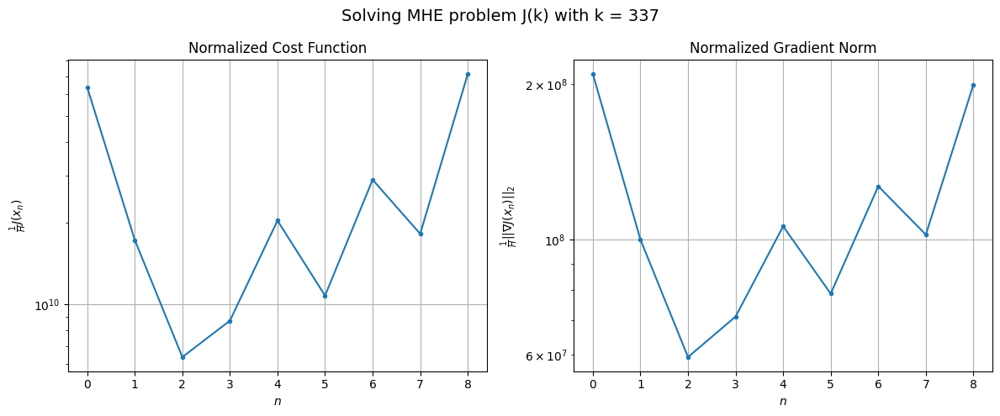

Windows:  85%|████████▌ | 329/386 [18:26<03:19,  3.50s/it]

[Gauss-Newton] Before applying the algorithm
Cost function: 719706704850.2449
Gradient norm: 1988971781.3406398
Global estimation error: 252879.07391083453
Initial conditions estimation errors: 0.9456127323842206 m, 61726.871036222234 m, 36602.16912237609 m, 242482.74036826237 m
Position estimation errors: 6.022980691266669 m, 71671.5954496906 m, 66132.8154076503 m, 242801.12435719406 m

[Gauss-Newton] Iteration 1
Cost function: 299751584304.42993 (-58.35%)
Gradient norm: 1306946463.4475126 (-34.29%)
Global estimation error: 134573.0277227346 (-46.78%)
Initial conditions estimation errors: 2.8114188802254008 m, 32955.118301949224 m, 19822.651131501105 m, 128960.89049194568 m
Position estimation errors: 3.423694256415877 m, 40872.77177364128 m, 39586.21101265819 m, 133078.006341654 m



/home/jgaspar/SpaceSim-Toolkit/test/new_newton_based_algorithms/gauss_newton.py:181: LinAlgWarning: Ill-conditioned matrix (rcond=7.73869e-17): result may not be accurate.
  delta_x = solve(HJ_x, -DJ_x)


[Gauss-Newton] STOP on Iteration 2 (gradient norm stagnated)
Cost function = 924114244942.8267 (208.29%)
Gradient norm = 2261128364.159703 (73.01%)
Global estimation error = 283268.66416674055 (110.49%)
Final initial conditions estimation errors: 2.8114605891567903 m, 68701.21369983608 m, 40873.820560060696 m, 271754.64141146664 m
Final position estimation errors: 3.42365717923469 m, 80138.21237924416 m, 72038.9078491425 m, 276324.86141432857 m



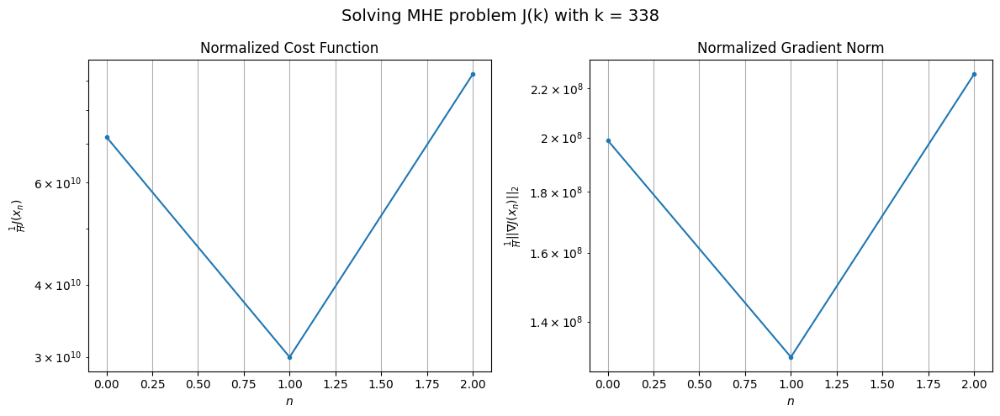

Windows:  85%|████████▌ | 330/386 [18:27<02:40,  2.87s/it]

[Gauss-Newton] Before applying the algorithm
Cost function: 928004300011.1519
Gradient norm: 2248771936.8047805
Global estimation error: 289356.12411533634
Initial conditions estimation errors: 1.1554057727195128 m, 71005.92153880575 m, 44803.14606704533 m, 276907.5351150795 m
Position estimation errors: 6.740397677049887 m, 80012.98807137091 m, 74471.67054904824 m, 271067.7244051582 m

[Gauss-Newton] Iteration 1
Cost function: 266820856952.66702 (-71.25%)
Gradient norm: 1222458059.1610157 (-45.64%)
Global estimation error: 129430.00895844067 (-55.27%)
Initial conditions estimation errors: 3.2226145572301133 m, 32167.443661608944 m, 20812.31100891389 m, 123629.3731791499 m
Position estimation errors: 3.8735697221707235 m, 38335.80327973858 m, 37705.17504713759 m, 123741.15954818018 m



/home/jgaspar/SpaceSim-Toolkit/test/new_newton_based_algorithms/gauss_newton.py:181: LinAlgWarning: Ill-conditioned matrix (rcond=5.69316e-17): result may not be accurate.
  delta_x = solve(HJ_x, -DJ_x)


[Gauss-Newton] Iteration 2
Cost function: 969171572.7944249 (-99.64%)
Gradient norm: 75972405.35346772 (-93.79%)
Global estimation error: 24278.55665119647 (-81.24%)
Initial conditions estimation errors: 3.2226645509255367 m, 5969.068446987272 m, 3722.419739203696 m, 23237.011003434927 m
Position estimation errors: 3.8735309540899037 m, 6162.070837398263 m, 6730.8685468787935 m, 20568.81818569564 m

[Gauss-Newton] Iteration 3
Cost function: 8218739629.495021 (748.02%)
Gradient norm: 232688596.32499388 (206.28%)
Global estimation error: 42208.168259228645 (73.85%)
Initial conditions estimation errors: 3.22261520642141 m, 10313.025842881243 m, 9870.873814439476 m, 39720.63997974188 m
Position estimation errors: 3.87356628432578 m, 22092.730113839258 m, 21092.465088039884 m, 71133.84587415928 m

[Gauss-Newton] Iteration 4
Cost function: 29047214884.41262 (253.43%)
Gradient norm: 451148012.8779797 (93.88%)
Global estimation error: 25161.17258178252 (-40.39%)
Initial conditions estimation e

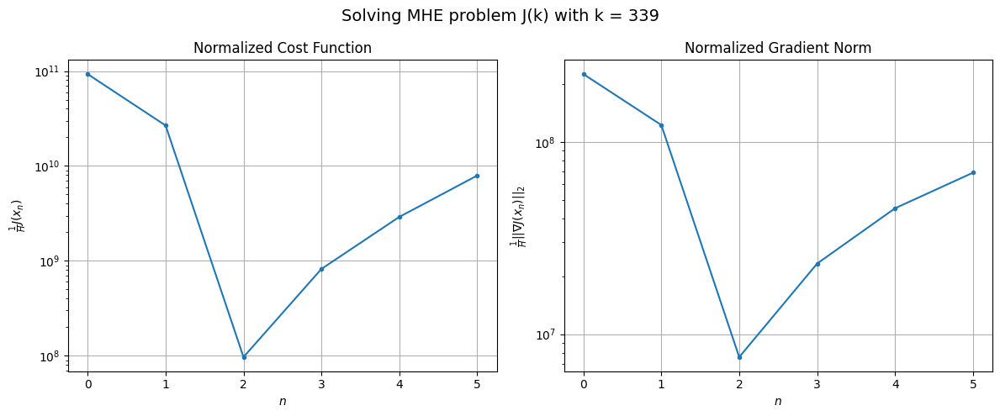

Windows:  86%|████████▌ | 331/386 [18:29<02:26,  2.66s/it]

[Gauss-Newton] Before applying the algorithm
Cost function: 84041692566.46875
Gradient norm: 707803743.723858
Global estimation error: 97583.50609193362
Initial conditions estimation errors: 1.3432331724410518 m, 23658.63421120635 m, 19366.289995356667 m, 92670.08722728126 m
Position estimation errors: 7.406104361350059 m, 34887.48385291499 m, 30762.57576113694 m, 119452.22645231422 m

[Gauss-Newton] Iteration 1
Cost function: 6919736749.866435 (-91.77%)
Gradient norm: 201963502.558206 (-71.47%)
Global estimation error: 27043.79841291852 (-72.29%)
Initial conditions estimation errors: 3.545870904622747 m, 6874.830401031024 m, 6422.033499598848 m, 25354.676479542926 m
Position estimation errors: 4.315609105551434 m, 10369.383256857061 m, 9360.385389641242 m, 34314.73199491556 m

[Gauss-Newton] STOP on Iteration 2 (gradient norm stagnated)
Cost function = 19529437116.937664 (182.23%)
Gradient norm = 331717159.26470107 (64.25%)
Global estimation error = 53859.56599148172 (99.16%)
Final in

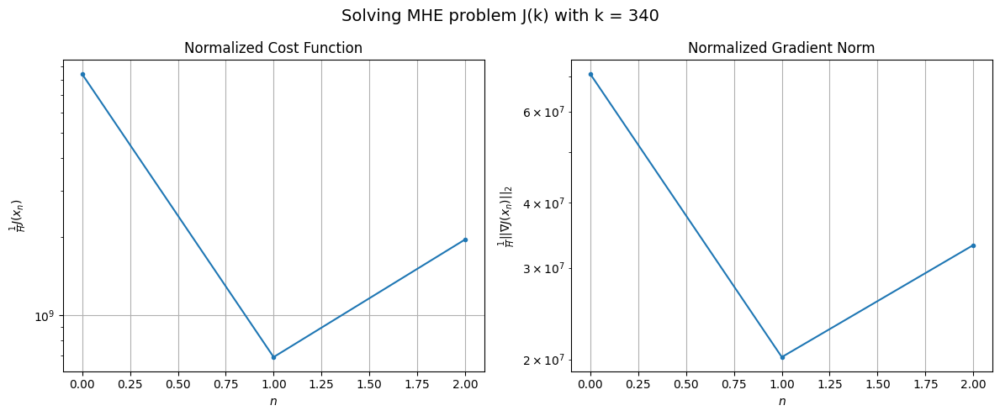

Windows:  86%|████████▌ | 332/386 [18:31<02:02,  2.27s/it]

[Gauss-Newton] Before applying the algorithm
Cost function: 19657959231.112392
Gradient norm: 328992325.1249603
Global estimation error: 53474.78776349676
Initial conditions estimation errors: 1.4446966603380211 m, 14105.810557162526 m, 11178.086269139114 m, 50355.02543963509 m
Position estimation errors: 7.982256370323882 m, 12616.942045066902 m, 12512.732950807487 m, 40189.76721083988 m

[Gauss-Newton] Iteration 1
Cost function: 4652026670.199878 (-76.34%)
Gradient norm: 167095717.99679008 (-49.21%)
Global estimation error: 17840.971686437697 (-66.64%)
Initial conditions estimation errors: 3.9406845722017767 m, 3733.0338737387274 m, 2061.7843459635033 m, 17323.740149765923 m
Position estimation errors: 4.511397725563632 m, 7129.865336254193 m, 4500.573568881343 m, 27781.221120836002 m



/home/jgaspar/SpaceSim-Toolkit/test/new_newton_based_algorithms/gauss_newton.py:181: LinAlgWarning: Ill-conditioned matrix (rcond=8.75928e-17): result may not be accurate.
  delta_x = solve(HJ_x, -DJ_x)


[Gauss-Newton] STOP on Iteration 2 (gradient norm stagnated)
Cost function = 22452713238.108383 (382.64%)
Gradient norm = 362217489.8787948 (116.77%)
Global estimation error = 72456.08160761592 (306.12%)
Final initial conditions estimation errors: 3.940683252720377 m, 14792.147853759796 m, 9148.793494462589 m, 70337.53335912694 m
Final position estimation errors: 4.511398735969845 m, 22746.382009350833 m, 16673.582942462363 m, 89620.29024478687 m



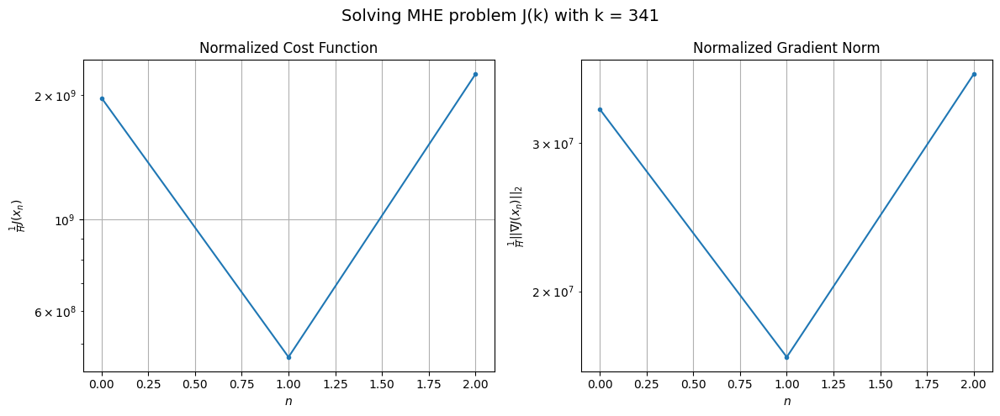

Windows:  86%|████████▋ | 333/386 [18:32<01:46,  2.02s/it]

[Gauss-Newton] Before applying the algorithm
Cost function: 23341849523.16639
Gradient norm: 367309314.45115113
Global estimation error: 75739.37348571491
Initial conditions estimation errors: 1.6078968812384253 m, 15880.985385050577 m, 9978.491163661893 m, 73380.31281298846 m
Position estimation errors: 8.160363385464905 m, 23271.795402848933 m, 17344.056629626284 m, 90390.86945617628 m

[Gauss-Newton] Iteration 1
Cost function: 5300590362.464719 (-77.29%)
Gradient norm: 175447058.84443656 (-52.23%)
Global estimation error: 26522.546829581057 (-64.98%)
Initial conditions estimation errors: 4.312056760377026 m, 5041.594738628031 m, 2760.581909810495 m, 25892.18291169063 m
Position estimation errors: 4.5911183155813 m, 9251.28516444894 m, 6094.665582279015 m, 38032.96806890483 m

[Gauss-Newton] Iteration 2
Cost function: 31688823.212614384 (-99.40%)
Gradient norm: 12062565.043093223 (-93.12%)
Global estimation error: 27284.15911922614 (2.87%)
Initial conditions estimation errors: 4.3120

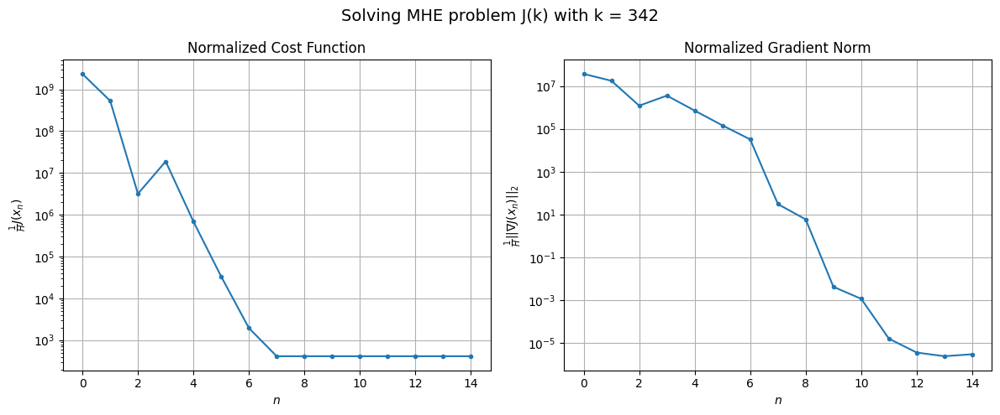

Windows:  87%|████████▋ | 334/386 [18:37<02:34,  2.96s/it]

[Gauss-Newton] Before applying the algorithm
Cost function: 6530.438083416727
Gradient norm: 506134.5931444201
Global estimation error: 5727.878342093835
Initial conditions estimation errors: 1.7352207988202362 m, 1437.4048128995191 m, 1119.3747640664492 m, 5430.41892619902 m
Position estimation errors: 8.118381568870038 m, 1486.5710844760574 m, 1283.483451598155 m, 5514.195543301831 m

[Gauss-Newton] Iteration 1
Cost function: 99437.917093558 (1422.68%)
Gradient norm: 834839.2123257748 (64.94%)
Global estimation error: 7506.357256063739 (31.05%)
Initial conditions estimation errors: 4.610679110975461 m, 1820.5526719488435 m, 1403.4609982632176 m, 7145.713791322661 m
Position estimation errors: 4.470772758758362 m, 2463.543152529836 m, 2204.659969625443 m, 8661.539385635708 m

[Gauss-Newton] Iteration 2
Cost function: 4648.449226181248 (-95.33%)
Gradient norm: 53080.27056450329 (-93.64%)
Global estimation error: 7032.015930256134 (-6.32%)
Initial conditions estimation errors: 4.6106791

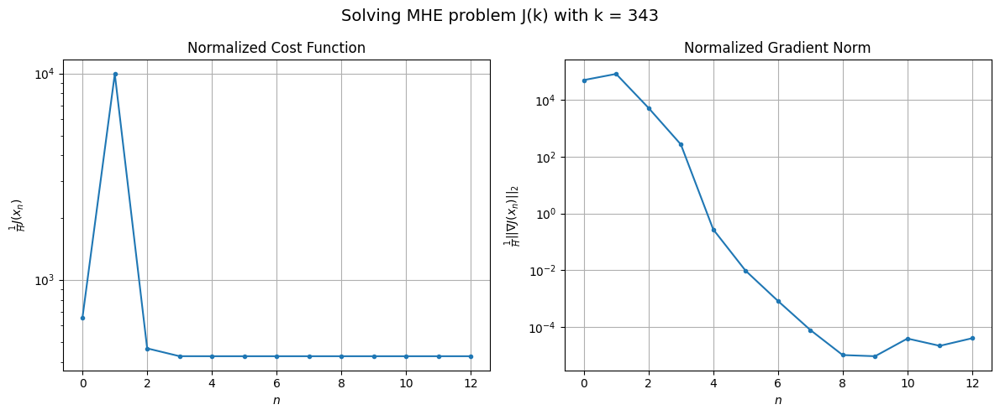

Windows:  87%|████████▋ | 335/386 [18:42<02:59,  3.51s/it]

[Gauss-Newton] Before applying the algorithm
Cost function: 6167.826424076684
Gradient norm: 468318.4724021319
Global estimation error: 7483.815613787527
Initial conditions estimation errors: 1.7977145154211223 m, 1858.5713968215782 m, 1475.951884935309 m, 7097.517061650972 m
Position estimation errors: 7.7590808318208335 m, 2276.357382455613 m, 2047.048722987358 m, 7999.185252606966 m

[Gauss-Newton] Iteration 1
Cost function: 121690.47928420082 (1872.99%)
Gradient norm: 752085.1330774969 (60.59%)
Global estimation error: 4384.543028131411 (-41.41%)
Initial conditions estimation errors: 4.664820216393104 m, 1085.2545575735357 m, 897.2526798860204 m, 4152.268753835015 m
Position estimation errors: 4.29333914577716 m, 1608.151093573361 m, 1502.0312085615594 m, 5434.334558037316 m

[Gauss-Newton] Iteration 2
Cost function: 4123.4871508137385 (-96.61%)
Gradient norm: 23291.36161053568 (-96.90%)
Global estimation error: 3880.375370137588 (-11.50%)
Initial conditions estimation errors: 4.66

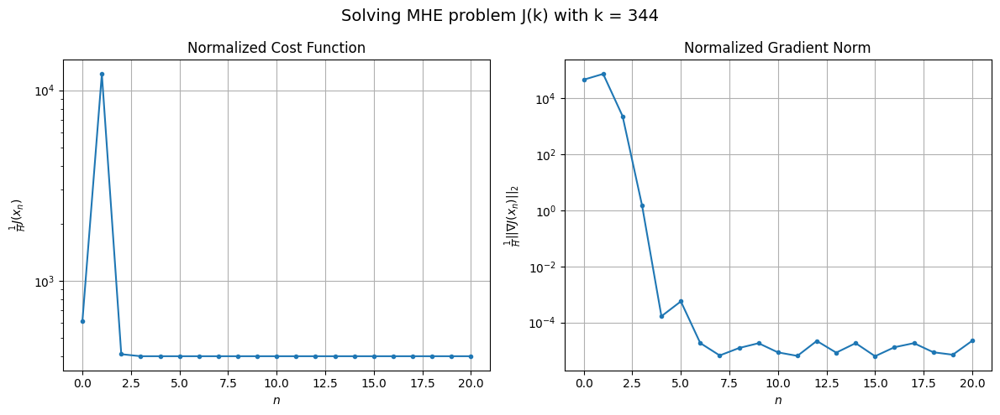

Windows:  87%|████████▋ | 336/386 [18:49<03:47,  4.54s/it]

[Gauss-Newton] Before applying the algorithm
Cost function: 5615.097777111068
Gradient norm: 434114.45567137736
Global estimation error: 4130.998275544035
Initial conditions estimation errors: 1.7050079222548329 m, 1046.0853039066346 m, 892.237556389318 m, 3895.4775433715777 m
Position estimation errors: 7.305845079460578 m, 1510.26271978952 m, 1432.5337589451958 m, 5017.015236791357 m

[Gauss-Newton] Iteration 1
Cost function: 4661.434114566481 (-16.98%)
Gradient norm: 48386.85467013913 (-88.85%)
Global estimation error: 2985.2725059828826 (-27.73%)
Initial conditions estimation errors: 4.493804711793473 m, 764.3485876723763 m, 696.1723869655958 m, 2800.5218650641327 m
Position estimation errors: 4.020848218303489 m, 1411.6072051529316 m, 1381.9081121725294 m, 4517.461212528172 m

[Gauss-Newton] Iteration 2
Cost function: 4334.0274731453255 (-7.02%)
Gradient norm: 65340.56103604402 (35.04%)
Global estimation error: 3721.2472100368395 (24.65%)
Initial conditions estimation errors: 4.49

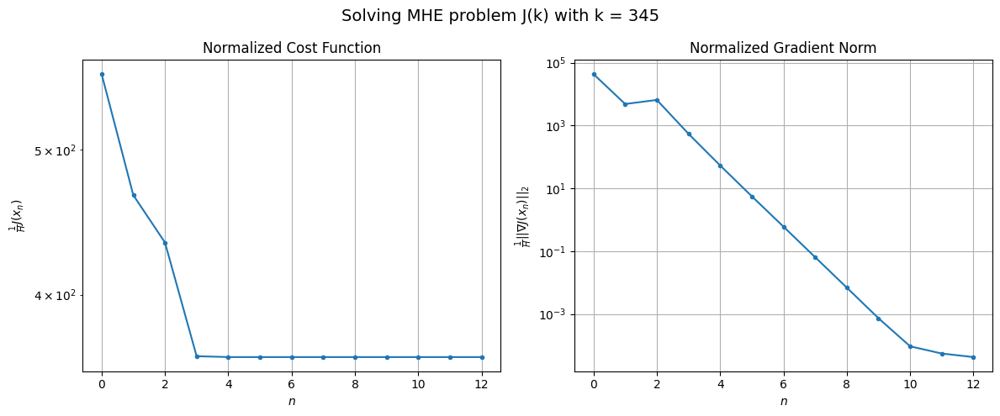

Windows:  87%|████████▋ | 337/386 [18:53<03:38,  4.45s/it]

[Gauss-Newton] Before applying the algorithm
Cost function: 4835.975058318405
Gradient norm: 390375.5642110018
Global estimation error: 3857.222522703767
Initial conditions estimation errors: 1.5532280008476287 m, 1004.4096046033004 m, 909.3938695984249 m, 3611.4126845178093 m
Position estimation errors: 6.751954724553426 m, 1642.118720952963 m, 1604.5292797745626 m, 5250.357259417979 m

[Gauss-Newton] Iteration 1
Cost function: 620757.0858850324 (12736.23%)
Gradient norm: 1997578.7342285689 (411.71%)
Global estimation error: 237.46410791146718 (-93.84%)
Initial conditions estimation errors: 4.234208508183896 m, 67.83643849719364 m, 130.32055660244663 m, 186.50416643490914 m
Position estimation errors: 3.7098364088618214 m, 269.17830934055183 m, 282.24050745906464 m, 763.2390919144173 m



/home/jgaspar/SpaceSim-Toolkit/test/new_newton_based_algorithms/gauss_newton.py:181: LinAlgWarning: Ill-conditioned matrix (rcond=3.67292e-17): result may not be accurate.
  delta_x = solve(HJ_x, -DJ_x)


[Gauss-Newton] Iteration 2
Cost function: 777196.9979527366 (25.20%)
Gradient norm: 2169042.9002480046 (8.58%)
Global estimation error: 4207.4048054596915 (1671.81%)
Initial conditions estimation errors: 4.234208449139329 m, 1008.8674364861212 m, 677.8946807840985 m, 4028.0119176749968 m
Position estimation errors: 3.709836429308593 m, 1105.1378075176767 m, 994.0335584763777 m, 3939.105552485304 m



/home/jgaspar/SpaceSim-Toolkit/test/new_newton_based_algorithms/gauss_newton.py:181: LinAlgWarning: Ill-conditioned matrix (rcond=4.57316e-17): result may not be accurate.
  delta_x = solve(HJ_x, -DJ_x)


[Gauss-Newton] STOP on Iteration 3 (gradient norm stagnated)
Cost function = 1091709.6665480402 (40.47%)
Gradient norm = 2476142.131619726 (14.16%)
Global estimation error = 825.696964039607 (-80.38%)
Final initial conditions estimation errors: 4.234208395852102 m, 251.13454379677543 m, 329.8743421222382 m, 714.052726223988 m
Final position estimation errors: 3.7098364830270754 m, 310.00680451007554 m, 310.6172468236442 m, 939.8147109875116 m



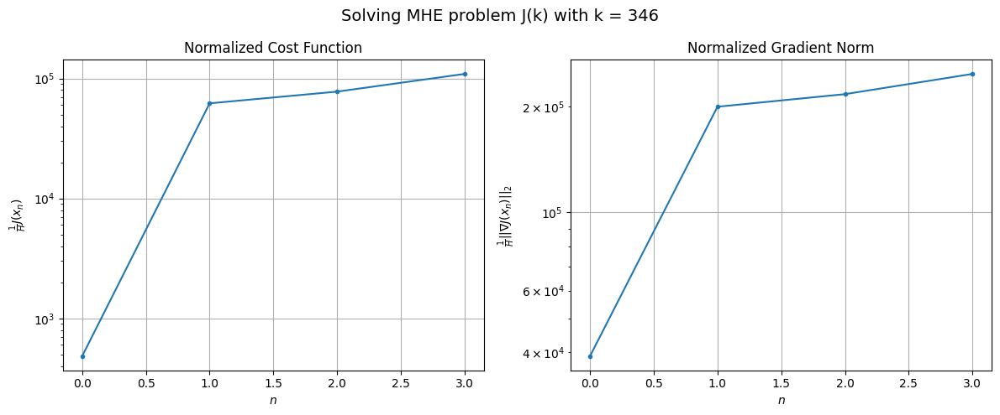

Windows:  88%|████████▊ | 338/386 [18:55<02:58,  3.72s/it]

[Gauss-Newton] Before applying the algorithm
Cost function: 1106321.8795321146
Gradient norm: 2560971.301883124
Global estimation error: 863.6512617373305
Initial conditions estimation errors: 1.4125294451227028 m, 262.4224648720356 m, 333.1124153969099 m, 752.3706301998066 m
Position estimation errors: 6.1855665686284755 m, 309.9559954575245 m, 301.6291593548652 m, 946.213061337782 m

[Gauss-Newton] Iteration 1
Cost function: 32685.636559548417 (-97.05%)
Gradient norm: 469147.56646575785 (-81.68%)
Global estimation error: 847.7717022387154 (-1.84%)
Initial conditions estimation errors: 3.8878582494232505 m, 302.4501326277251 m, 439.8011672193221 m, 658.614900857061 m
Position estimation errors: 3.4189902445831533 m, 593.7085136221773 m, 644.6550173711207 m, 1754.327109063864 m

[Gauss-Newton] Iteration 2
Cost function: 6135431.1601482965 (18671.03%)
Gradient norm: 6000775.02309846 (1179.08%)
Global estimation error: 8200.373911577073 (867.29%)
Initial conditions estimation errors: 3.8

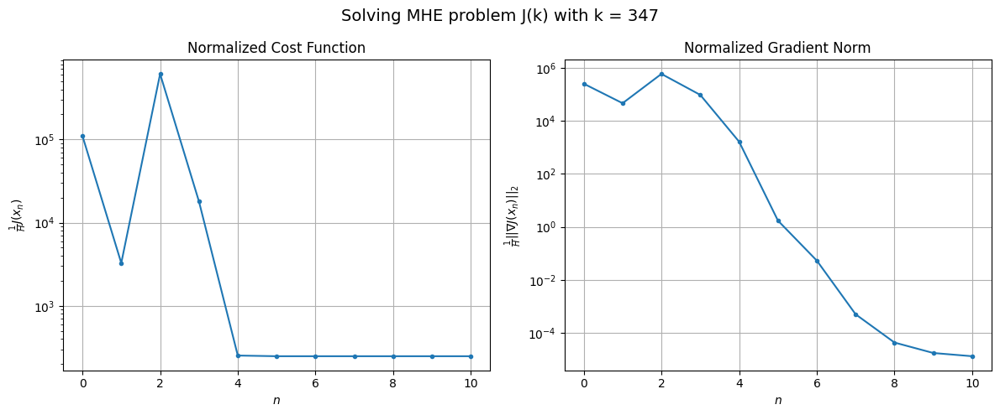

Windows:  88%|████████▊ | 339/386 [18:59<02:59,  3.82s/it]

[Gauss-Newton] Before applying the algorithm
Cost function: 3348.955476585024
Gradient norm: 305025.739837017
Global estimation error: 4352.9307320954595
Initial conditions estimation errors: 1.3170785410889103 m, 1172.8085452244973 m, 1085.45930077205 m, 4048.987078968177 m
Position estimation errors: 5.678777026791803 m, 595.5191478537803 m, 474.3072008438336 m, 2244.4408242622003 m

[Gauss-Newton] Iteration 1
Cost function: 6325.6156255007545 (88.88%)
Gradient norm: 129378.29072399838 (-57.58%)
Global estimation error: 2912.581551017217 (-33.09%)
Initial conditions estimation errors: 3.5116203547551503 m, 792.5068592408113 m, 746.8104596436064 m, 2701.35544444267 m
Position estimation errors: 3.1771937593134614 m, 318.3583049696077 m, 223.39710135200662 m, 1268.114901167109 m

[Gauss-Newton] Iteration 2
Cost function: 2126.353423109884 (-66.39%)
Gradient norm: 1591.05281085288 (-98.77%)
Global estimation error: 3013.143454004188 (3.45%)
Initial conditions estimation errors: 3.511620

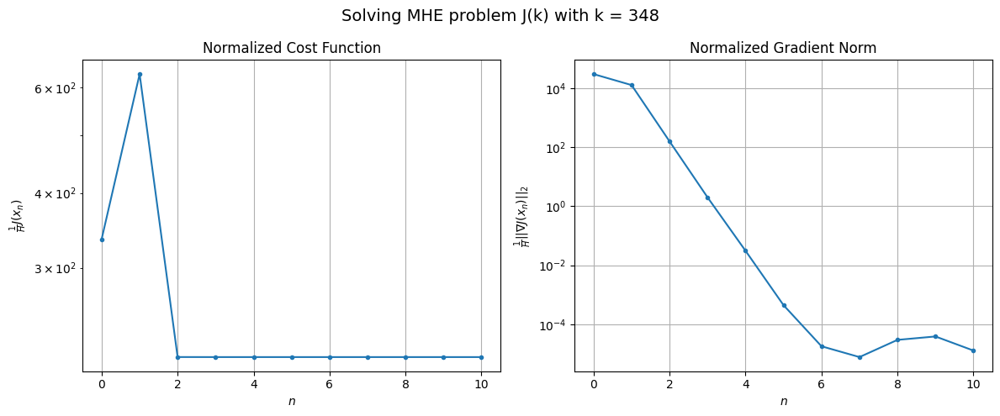

Windows:  88%|████████▊ | 340/386 [19:03<02:57,  3.85s/it]

[Gauss-Newton] Before applying the algorithm
Cost function: 2961.2236824204783
Gradient norm: 288195.4773928485
Global estimation error: 2869.6072993264943
Initial conditions estimation errors: 1.1943337062704547 m, 773.6667135214327 m, 717.0302071251032 m, 2668.6976151712893 m
Position estimation errors: 5.323325838904582 m, 293.3536563005745 m, 195.36511822570108 m, 1190.8328014846813 m

[Gauss-Newton] Iteration 1
Cost function: 287221.6294572841 (9599.42%)
Gradient norm: 1163335.490087062 (303.66%)
Global estimation error: 1027.0133371016257 (-64.21%)
Initial conditions estimation errors: 3.2066028259629937 m, 263.5592079228964 m, 206.52415589556693 m, 970.8883404853358 m
Position estimation errors: 3.0001029045023033 m, 641.431756951816 m, 721.9207178537993 m, 1864.65281552337 m



/home/jgaspar/SpaceSim-Toolkit/test/new_newton_based_algorithms/gauss_newton.py:181: LinAlgWarning: Ill-conditioned matrix (rcond=1.02014e-16): result may not be accurate.
  delta_x = solve(HJ_x, -DJ_x)


[Gauss-Newton] Iteration 2
Cost function: 32951.68973805847 (-88.53%)
Gradient norm: 405424.17632757674 (-65.15%)
Global estimation error: 3127.213122125119 (204.50%)
Initial conditions estimation errors: 3.206602815900668 m, 820.0057715772267 m, 694.7025146853457 m, 2936.736439335794 m
Position estimation errors: 3.0001029200431018 m, 1217.8446563328362 m, 1291.2270179461545 m, 3733.6118129789047 m



/home/jgaspar/SpaceSim-Toolkit/test/new_newton_based_algorithms/gauss_newton.py:181: LinAlgWarning: Ill-conditioned matrix (rcond=3.5748e-17): result may not be accurate.
  delta_x = solve(HJ_x, -DJ_x)


[Gauss-Newton] Iteration 3
Cost function: 5832.692897397348 (-82.30%)
Gradient norm: 147845.77612722933 (-63.53%)
Global estimation error: 1905.9374113487686 (-39.05%)
Initial conditions estimation errors: 3.206602800696997 m, 497.3903669722492 m, 411.38533768521665 m, 1793.3056752556895 m
Position estimation errors: 3.00010293752665 m, 859.9578151569208 m, 935.8766433689266 m, 2582.632559445471 m



/home/jgaspar/SpaceSim-Toolkit/test/new_newton_based_algorithms/gauss_newton.py:181: LinAlgWarning: Ill-conditioned matrix (rcond=5.55946e-17): result may not be accurate.
  delta_x = solve(HJ_x, -DJ_x)


[Gauss-Newton] STOP on Iteration 4 (gradient norm stagnated)
Cost function = 10551.985916752337 (80.91%)
Gradient norm = 218476.28082486335 (47.77%)
Global estimation error = 3400.8720674079323 (78.44%)
Final initial conditions estimation errors: 3.2066028074690514 m, 892.2551546318621 m, 757.7373662500174 m, 3193.0589073931224 m
Final position estimation errors: 3.0001029295509554 m, 1292.6411503347083 m, 1364.8615836600222 m, 3977.003521000049 m



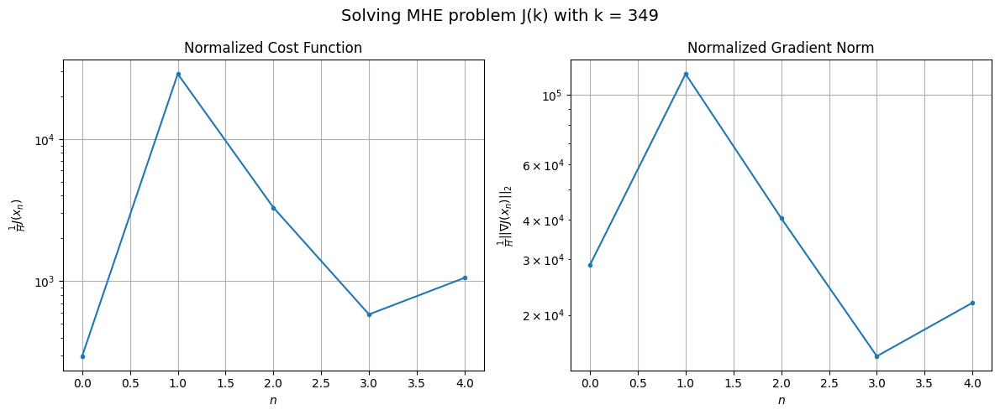

Windows:  88%|████████▊ | 341/386 [19:05<02:31,  3.37s/it]

[Gauss-Newton] Before applying the algorithm
Cost function: 11237.827425861386
Gradient norm: 391640.9000306246
Global estimation error: 3577.517577726308
Initial conditions estimation errors: 1.0989813234710557 m, 955.5222598208253 m, 842.6305182721427 m, 3342.9886556961887 m
Position estimation errors: 5.183231975851858 m, 1311.4319629448576 m, 1405.7247507747165 m, 3980.8376619704995 m



/home/jgaspar/SpaceSim-Toolkit/test/new_newton_based_algorithms/gauss_newton.py:181: LinAlgWarning: Ill-conditioned matrix (rcond=4.25711e-17): result may not be accurate.
  delta_x = solve(HJ_x, -DJ_x)


[Gauss-Newton] Iteration 1
Cost function: 6781402.595597612 (60244.43%)
Gradient norm: 6070106.563328914 (1449.92%)
Global estimation error: 11571.827163446076 (223.46%)
Initial conditions estimation errors: 2.997993252638369 m, 3128.2020368174753 m, 2822.6931942917354 m, 10777.471750678893 m
Position estimation errors: 2.956858513332764 m, 3608.042060236714 m, 3736.9490418510545 m, 11257.6584400158 m

[Gauss-Newton] Iteration 2
Cost function: 220389.150188227 (-96.75%)
Gradient norm: 1106701.191644592 (-81.77%)
Global estimation error: 8196.759926727509 (-29.17%)
Initial conditions estimation errors: 2.9979932206906272 m, 2217.051465446951 m, 1993.7131620176142 m, 7635.223404161374 m
Position estimation errors: 2.9568585589415424 m, 2591.980308057966 m, 2696.05827613871 m, 8081.35430695905 m

[Gauss-Newton] Iteration 3
Cost function: 2409.624582593988 (-98.91%)
Gradient norm: 62077.822796427485 (-94.39%)
Global estimation error: 7387.026871946446 (-9.88%)
Initial conditions estimation

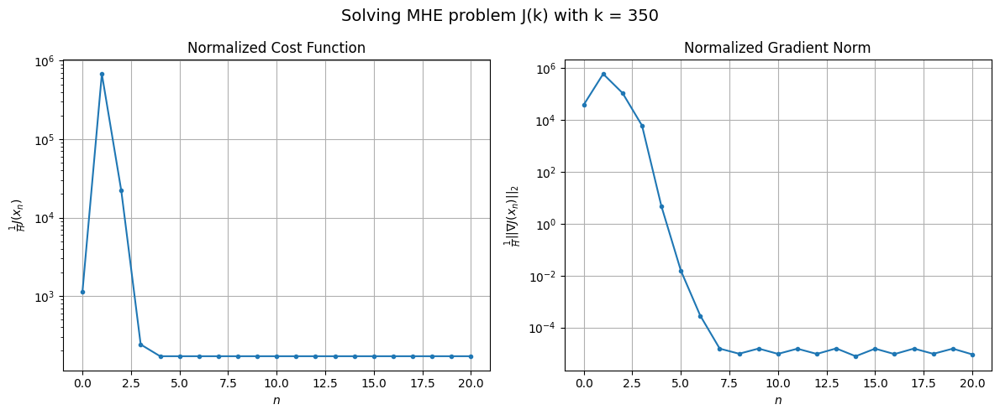

Windows:  89%|████████▊ | 342/386 [19:12<03:15,  4.44s/it]

[Gauss-Newton] Before applying the algorithm
Cost function: 2542.425172990279
Gradient norm: 287337.07168979436
Global estimation error: 7570.12155344795
Initial conditions estimation errors: 1.0770414889907922 m, 2071.9987143167646 m, 1906.137588888002 m, 7027.103799347477 m
Position estimation errors: 5.258541733689727 m, 2342.1830556831724 m, 2476.6395891789707 m, 7208.835864665536 m

[Gauss-Newton] Iteration 1
Cost function: 501093.7254193369 (19609.28%)
Gradient norm: 1837786.1286981183 (539.59%)
Global estimation error: 4232.681440784923 (-44.09%)
Initial conditions estimation errors: 2.858501105944397 m, 1249.7570869885676 m, 1303.3407630853462 m, 3828.184074612881 m
Position estimation errors: 3.088311136402649 m, 964.0013751396853 m, 1064.244313632579 m, 2842.7153613683586 m



/home/jgaspar/SpaceSim-Toolkit/test/new_newton_based_algorithms/gauss_newton.py:181: LinAlgWarning: Ill-conditioned matrix (rcond=4.52902e-17): result may not be accurate.
  delta_x = solve(HJ_x, -DJ_x)


[Gauss-Newton] Iteration 2
Cost function: 10328502.265213154 (1961.19%)
Gradient norm: 7624306.987962935 (314.86%)
Global estimation error: 12924.461325968072 (205.35%)
Initial conditions estimation errors: 2.8585013529231587 m, 3582.3058064139937 m, 3408.0614653823754 m, 11941.268065741864 m
Position estimation errors: 3.0883107030871346 m, 3608.5771151187573 m, 3795.3298601641723 m, 11049.916011929972 m

[Gauss-Newton] STOP on Iteration 3 (gradient norm stagnated)
Cost function = 3676674.6284114914 (-64.40%)
Gradient norm = 4269309.379752374 (-44.00%)
Global estimation error = 5738.359916572979 (-55.60%)
Final initial conditions estimation errors: 2.858501386566195 m, 1600.450582656679 m, 1540.2677909727431 m, 5291.020240114163 m
Final position estimation errors: 3.0883107268978205 m, 1710.0901918140198 m, 1821.8877954987245 m, 5190.293014640829 m



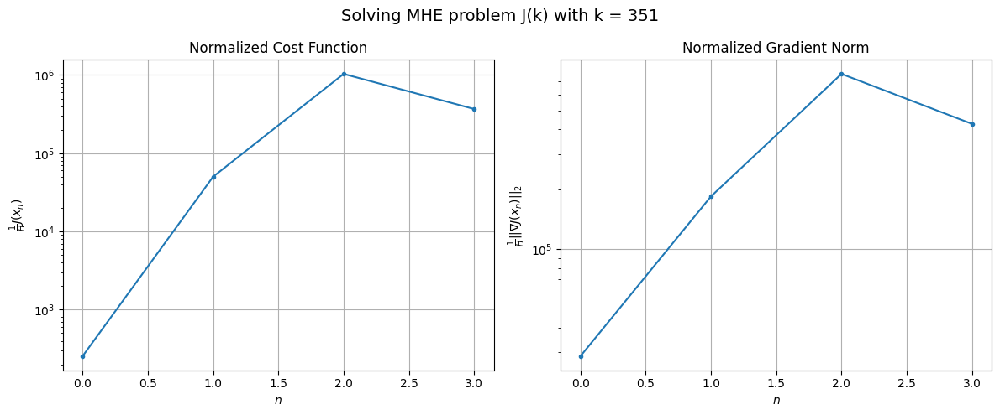

Windows:  89%|████████▉ | 343/386 [19:14<02:39,  3.72s/it]

[Gauss-Newton] Before applying the algorithm
Cost function: 3501371.7699314766
Gradient norm: 4154267.200601417
Global estimation error: 5843.388187457638
Initial conditions estimation errors: 1.0282786324034043 m, 1642.1473757054325 m, 1600.8860600925038 m, 5374.54160833567 m
Position estimation errors: 5.615973518630521 m, 1685.5963437664257 m, 1813.8132321304774 m, 5063.023686403926 m



/home/jgaspar/SpaceSim-Toolkit/test/new_newton_based_algorithms/gauss_newton.py:181: LinAlgWarning: Ill-conditioned matrix (rcond=6.81846e-17): result may not be accurate.
  delta_x = solve(HJ_x, -DJ_x)


[Gauss-Newton] Iteration 1
Cost function: 2216305.7887324435 (-36.70%)
Gradient norm: 3534119.399381629 (-14.93%)
Global estimation error: 11678.308154578348 (99.86%)
Initial conditions estimation errors: 2.830077770725147 m, 3228.3362312963886 m, 3072.2681410838313 m, 10794.529556101961 m
Position estimation errors: 3.2378618797175593 m, 3503.839496581352 m, 3716.9141204752077 m, 10575.483558642707 m

[Gauss-Newton] STOP on Iteration 2 (gradient norm stagnated)
Cost function = 424791.2345856486 (-80.83%)
Gradient norm = 1403679.0994641818 (-60.28%)
Global estimation error = 7394.395846304407 (-36.68%)
Final initial conditions estimation errors: 2.8300781003880777 m, 2006.537030586751 m, 1863.7842578854243 m, 6868.564813770696 m
Final position estimation errors: 3.237861502406577 m, 2421.4469783557743 m, 2553.765964749879 m, 7341.123700542302 m



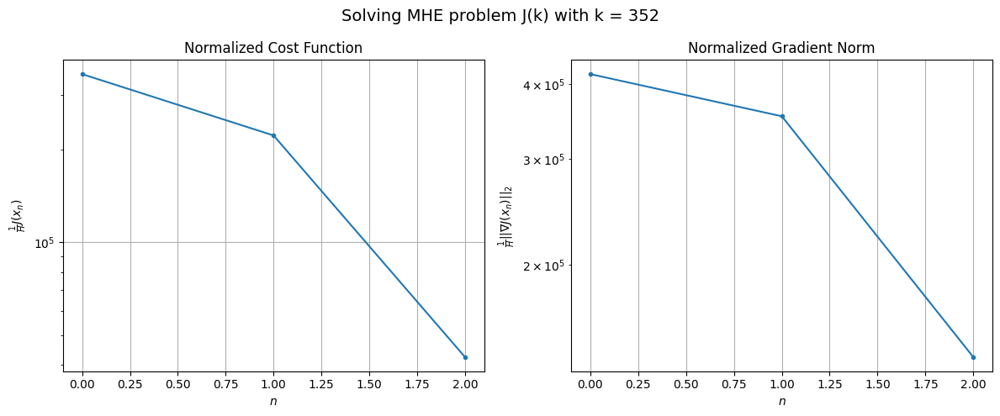

Windows:  89%|████████▉ | 344/386 [19:16<02:08,  3.07s/it]

[Gauss-Newton] Before applying the algorithm
Cost function: 395019.2057358758
Gradient norm: 1399140.741997529
Global estimation error: 7613.091926009281
Initial conditions estimation errors: 1.0421175783637961 m, 2091.1578236218893 m, 1978.7695093138468 m, 7047.743259264095 m
Position estimation errors: 5.9891781657432475 m, 2417.3020244222284 m, 2577.1089807507933 m, 7233.568517737794 m

[Gauss-Newton] Iteration 1
Cost function: 16776.493300988088 (-95.75%)
Gradient norm: 273968.37308295665 (-80.42%)
Global estimation error: 9347.825980406165 (22.79%)
Initial conditions estimation errors: 2.94955750519446 m, 2594.13291215721 m, 2493.2410604376523 m, 8627.632903904081 m
Position estimation errors: 3.4610197654504273 m, 2922.2615736193684 m, 3154.059217190886 m, 8652.808236720917 m

[Gauss-Newton] Iteration 2
Cost function: 2146.4236707065784 (-87.21%)
Gradient norm: 342.7944243489166 (-99.87%)
Global estimation error: 9289.542184205531 (-0.62%)
Initial conditions estimation errors: 2.

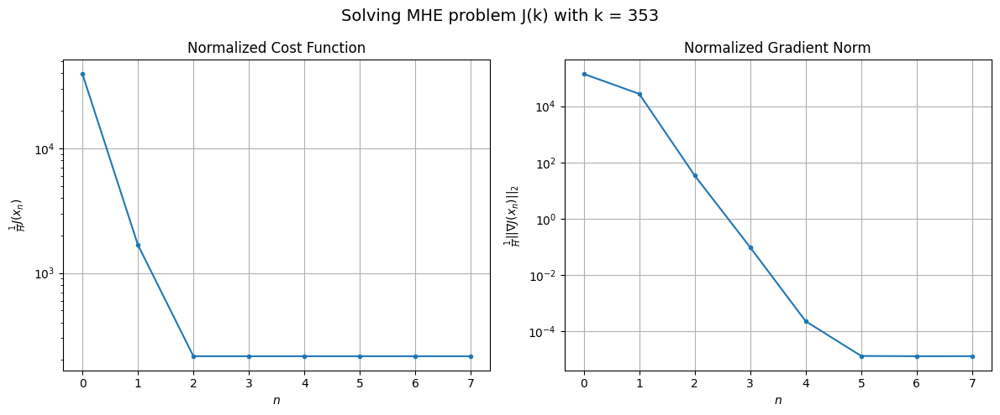

Windows:  89%|████████▉ | 345/386 [19:19<02:06,  3.08s/it]

[Gauss-Newton] Before applying the algorithm
Cost function: 3808.1822728115803
Gradient norm: 404695.52302092535
Global estimation error: 9487.051350786762
Initial conditions estimation errors: 1.0970872462118846 m, 2661.509522201907 m, 2599.8757291389416 m, 8727.0352600512 m
Position estimation errors: 6.419825449083095 m, 2876.766292649252 m, 3138.346754668327 m, 8404.595306133813 m

[Gauss-Newton] Iteration 1
Cost function: 3930.8095661618904 (3.22%)
Gradient norm: 92810.96409753291 (-77.07%)
Global estimation error: 8597.215605189409 (-9.38%)
Initial conditions estimation errors: 3.220723998618321 m, 2495.1541101541916 m, 2571.6716795357042 m, 7814.909402262435 m
Position estimation errors: 3.609015220276624 m, 2636.898855587916 m, 2940.106851056791 m, 7443.933291641939 m

[Gauss-Newton] Iteration 2
Cost function: 8308.640832101188 (111.37%)
Gradient norm: 142089.18789526177 (53.10%)
Global estimation error: 10191.705675973242 (18.55%)
Initial conditions estimation errors: 3.220724

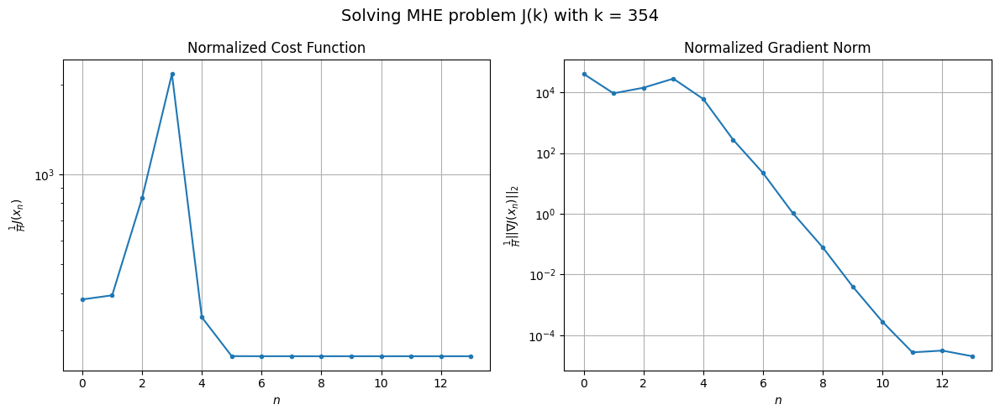

Windows:  90%|████████▉ | 346/386 [19:24<02:24,  3.61s/it]

[Gauss-Newton] Before applying the algorithm
Cost function: 4085.7729765541344
Gradient norm: 406774.55732266075
Global estimation error: 13463.661760849947
Initial conditions estimation errors: 1.2142718405136483 m, 3980.867750416639 m, 4192.686188782593 m, 12159.122426047277 m
Position estimation errors: 6.678631908787117 m, 3614.5069810018094 m, 4099.175178363996 m, 10041.219245993476 m

[Gauss-Newton] Iteration 1
Cost function: 2730.939378648608 (-33.16%)
Gradient norm: 15889.118559600567 (-96.09%)
Global estimation error: 13494.989059358715 (0.23%)
Initial conditions estimation errors: 3.41829211628167 m, 4064.5026285170857 m, 4395.132627337544 m, 12094.517019771118 m
Position estimation errors: 3.8203252933333913 m, 3770.5586342767915 m, 4363.518851233486 m, 10199.480166249594 m

[Gauss-Newton] Iteration 2
Cost function: 5915.850605394414 (116.62%)
Gradient norm: 111535.04459673229 (601.96%)
Global estimation error: 14825.769530131967 (9.86%)
Initial conditions estimation errors:

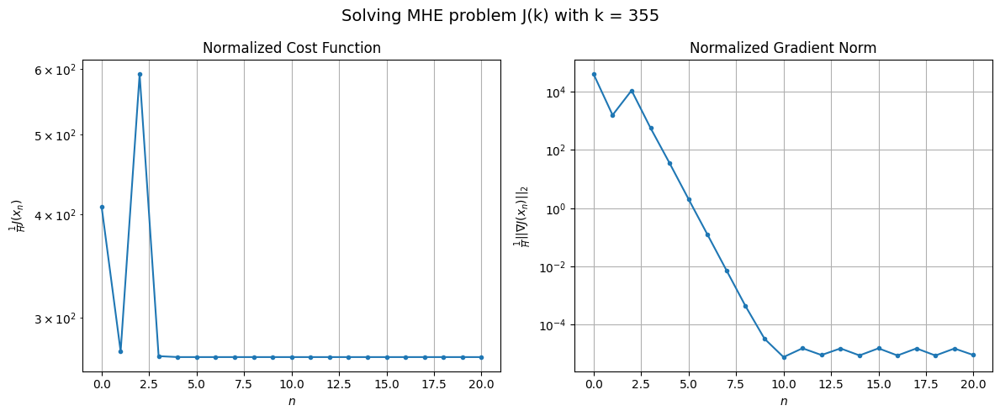

Windows:  90%|████████▉ | 347/386 [19:31<03:00,  4.62s/it]

[Gauss-Newton] Before applying the algorithm
Cost function: 4408.054527612057
Gradient norm: 414157.75864255236
Global estimation error: 15190.870752121793
Initial conditions estimation errors: 1.2761173138082202 m, 4604.985643354934 m, 5017.670725932337 m, 13578.64634294944 m
Position estimation errors: 6.867405649206383 m, 4018.489096892543 m, 4692.442413628634 m, 10735.238359668001 m

[Gauss-Newton] Iteration 1
Cost function: 1016701.4688808473 (22964.63%)
Gradient norm: 2100871.589442354 (407.26%)
Global estimation error: 9826.486501449135 (-35.31%)
Initial conditions estimation errors: 3.589712560214363 m, 3016.411786172395 m, 3343.6311771247556 m, 8733.91169230532 m
Position estimation errors: 3.912140385222852 m, 2682.6238269704277 m, 3173.7749146738115 m, 7058.613872941236 m

[Gauss-Newton] Iteration 2
Cost function: 4226432.159090672 (315.70%)
Gradient norm: 4365930.0292306645 (107.82%)
Global estimation error: 2328.412483764417 (-76.30%)
Initial conditions estimation errors: 

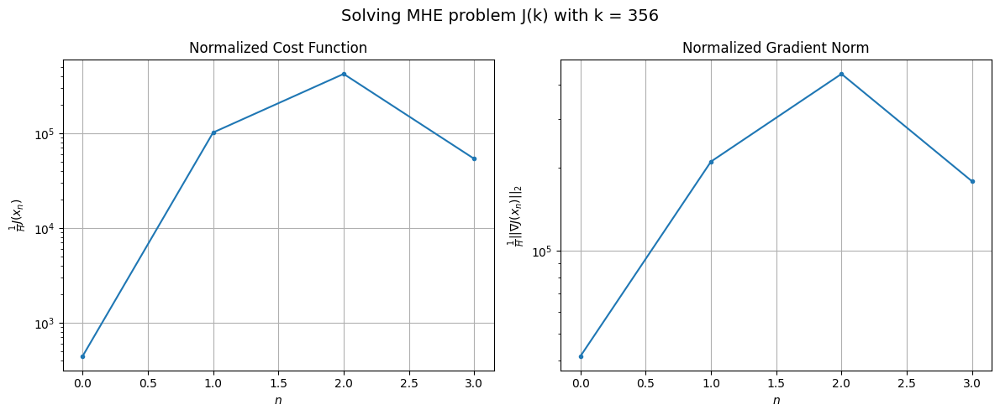

Windows:  90%|█████████ | 348/386 [19:33<02:23,  3.78s/it]

[Gauss-Newton] Before applying the algorithm
Cost function: 560461.877787047
Gradient norm: 1793850.2486682832
Global estimation error: 6291.073219297128
Initial conditions estimation errors: 1.3376787055828752 m, 1886.4804771793226 m, 2024.4291671669016 m, 5649.820598037363 m
Position estimation errors: 6.796944657108188 m, 2066.397663062602 m, 2411.888080118793 m, 5493.501993462941 m

[Gauss-Newton] Iteration 1
Cost function: 226096.81230996345 (-59.66%)
Gradient norm: 1203932.7998939932 (-32.89%)
Global estimation error: 9128.938881590519 (45.11%)
Initial conditions estimation errors: 3.711416542952686 m, 2731.673260892279 m, 2928.006317399863 m, 8203.793371643156 m
Position estimation errors: 3.8538368893425505 m, 3293.806687335297 m, 3915.406439558459 m, 8647.98309758983 m

[Gauss-Newton] Iteration 2
Cost function: 3281.7215275978583 (-98.55%)
Gradient norm: 37700.230168097754 (-96.87%)
Global estimation error: 9823.91426303388 (7.61%)
Initial conditions estimation errors: 3.71141

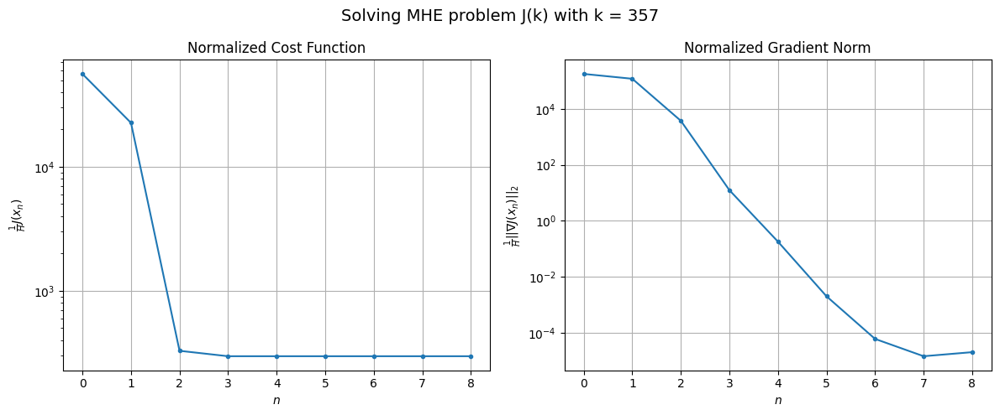

Windows:  90%|█████████ | 349/386 [19:36<02:14,  3.63s/it]

[Gauss-Newton] Before applying the algorithm
Cost function: 4426.676714957593
Gradient norm: 377990.60717170214
Global estimation error: 10123.98230750606
Initial conditions estimation errors: 1.3954714573212101 m, 3072.8806760605667 m, 3353.9555239495267 m, 9044.522271166117 m
Position estimation errors: 6.514421731391381 m, 3475.813611019085 m, 4173.112514292503 m, 8986.11887717875 m

[Gauss-Newton] Iteration 1
Cost function: 35391.3254171005 (699.50%)
Gradient norm: 418836.5445384647 (10.81%)
Global estimation error: 8053.795147766914 (-20.45%)
Initial conditions estimation errors: 3.770200696067333 m, 2464.5353152827493 m, 2703.728097716571 m, 7174.922180207175 m
Position estimation errors: 3.6600065043213936 m, 2813.2435618379004 m, 3403.313838153829 m, 7227.379553727372 m

[Gauss-Newton] Iteration 2
Cost function: 2967.0037790035212 (-91.62%)
Gradient norm: 13838.81940560745 (-96.70%)
Global estimation error: 7657.997569189266 (-4.91%)
Initial conditions estimation errors: 3.7702

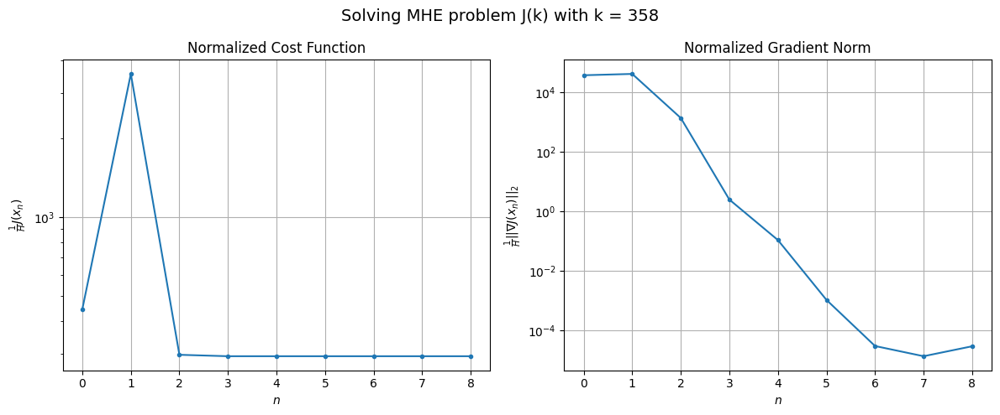

Windows:  91%|█████████ | 350/386 [19:39<02:07,  3.54s/it]

[Gauss-Newton] Before applying the algorithm
Cost function: 4094.395001723714
Gradient norm: 333459.2492060484
Global estimation error: 7857.165391184018
Initial conditions estimation errors: 1.4228388080900127 m, 2430.39192399264 m, 2706.151646519421 m, 6964.551284892667 m
Position estimation errors: 6.137727298961189 m, 2680.505097935828 m, 3272.627447063581 m, 6779.97099026548 m

[Gauss-Newton] Iteration 1
Cost function: 321691.68359823275 (7756.88%)
Gradient norm: 1406400.846178313 (321.76%)
Global estimation error: 11064.5115457121 (40.82%)
Initial conditions estimation errors: 3.6509476662348166 m, 3489.3124280206202 m, 3973.850314839449 m, 9718.877711985224 m
Position estimation errors: 3.5192907959418127 m, 4028.462517304854 m, 5006.443950109916 m, 9998.833576551158 m

[Gauss-Newton] Iteration 2
Cost function: 2892.537746032929 (-99.10%)
Gradient norm: 22159.561389879593 (-98.42%)
Global estimation error: 10571.978754009835 (-4.45%)
Initial conditions estimation errors: 3.65094

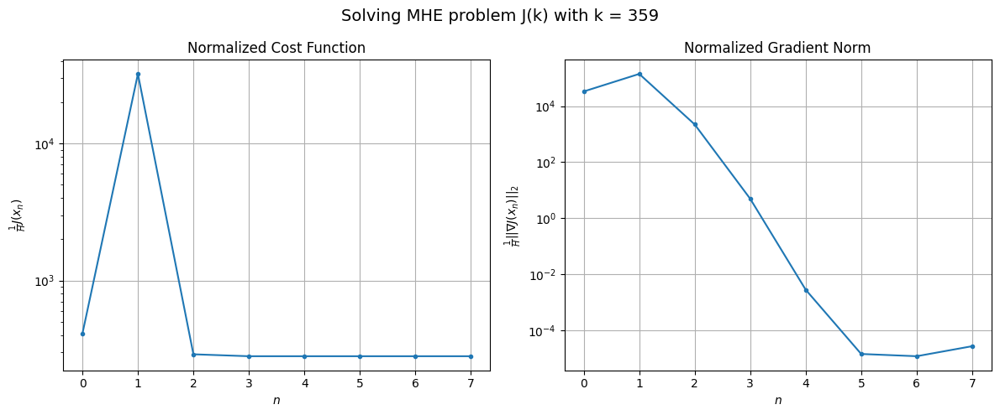

Windows:  91%|█████████ | 351/386 [19:43<02:01,  3.46s/it]

[Gauss-Newton] Before applying the algorithm
Cost function: 3764.2268588269453
Gradient norm: 315375.1203267955
Global estimation error: 10831.809655443682
Initial conditions estimation errors: 1.3678373396034949 m, 3450.3431823943315 m, 3984.2387249693575 m, 9463.036007069728 m
Position estimation errors: 5.884267881419284 m, 3839.966071765612 m, 4811.833661104958 m, 9394.016512789303 m

[Gauss-Newton] Iteration 1
Cost function: 5354.1003414558445 (42.24%)
Gradient norm: 113742.39852060965 (-63.93%)
Global estimation error: 12056.16358133522 (11.30%)
Initial conditions estimation errors: 3.5798650202135085 m, 3840.4739955228383 m, 4403.4671272939095 m, 10545.67601160365 m
Position estimation errors: 3.3529574703929814 m, 4151.764280250854 m, 5215.82703481915 m, 10231.891405583205 m

[Gauss-Newton] Iteration 2
Cost function: 2511.350146009485 (-53.09%)
Gradient norm: 1.945093621955869 (-100.00%)
Global estimation error: 12048.975549992494 (-0.06%)
Initial conditions estimation errors: 

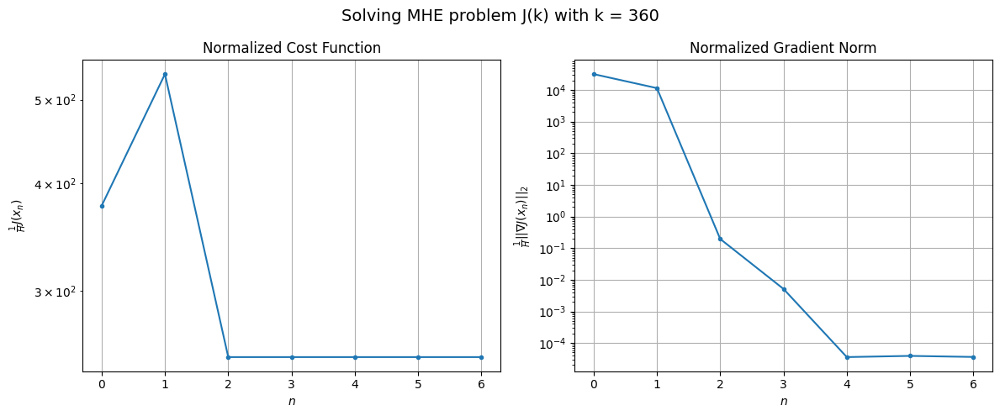

Windows:  91%|█████████ | 352/386 [19:46<01:52,  3.32s/it]

[Gauss-Newton] Before applying the algorithm
Cost function: 3442.777509271883
Gradient norm: 303429.23199521727
Global estimation error: 12279.925869538443
Initial conditions estimation errors: 1.360539358974446 m, 3941.98660163937 m, 4575.299585240445 m, 10692.237273409915 m
Position estimation errors: 5.6288084414557655 m, 4095.9534494137706 m, 5190.935771841578 m, 9966.17132086685 m

[Gauss-Newton] Iteration 1
Cost function: 1780184.6120295958 (51607.80%)
Gradient norm: 3271487.870849646 (978.17%)
Global estimation error: 7165.237378688435 (-41.65%)
Initial conditions estimation errors: 3.479012224152584 m, 2358.576466719109 m, 2797.238417904911 m, 6160.615866631699 m
Position estimation errors: 3.1770859770696824 m, 2138.4678995462605 m, 2747.264912856032 m, 5043.3610277968055 m

[Gauss-Newton] Iteration 2
Cost function: 830804.4612870164 (-53.33%)
Gradient norm: 2160017.3309089416 (-33.97%)
Global estimation error: 2685.3578407171085 (-62.52%)
Initial conditions estimation errors:

/home/jgaspar/SpaceSim-Toolkit/test/new_newton_based_algorithms/gauss_newton.py:181: LinAlgWarning: Ill-conditioned matrix (rcond=1.07056e-16): result may not be accurate.
  delta_x = solve(HJ_x, -DJ_x)


[Gauss-Newton] Iteration 4
Cost function: 8546.99501375728 (-9.48%)
Gradient norm: 190060.63878821186 (-2.03%)
Global estimation error: 2793.7571380493896 (-31.82%)
Initial conditions estimation errors: 3.4790123125047834 m, 956.5629880254365 m, 1158.6178184820149 m, 2355.3461597671267 m
Position estimation errors: 3.177085868850004 m, 512.7601325970635 m, 679.7470194285079 m, 1131.0683244430604 m

[Gauss-Newton] STOP on Iteration 5 (gradient norm stagnated)
Cost function = 8843.219527863457 (3.47%)
Gradient norm = 193284.70605226207 (1.70%)
Global estimation error = 4123.998575732744 (47.61%)
Final initial conditions estimation errors: 3.4790122984676275 m, 1384.8052759246289 m, 1661.4324173484413 m, 3511.311310774981 m
Final position estimation errors: 3.177085895748089 m, 994.6440784452931 m, 1295.5749817542362 m, 2288.1411995993217 m



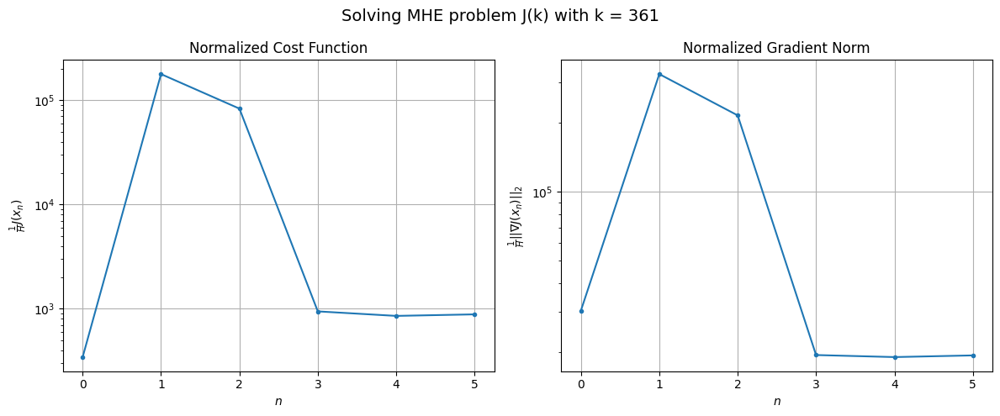

Windows:  91%|█████████▏| 353/386 [19:48<01:39,  3.02s/it]

[Gauss-Newton] Before applying the algorithm
Cost function: 9875.765895847968
Gradient norm: 330852.50340605696
Global estimation error: 4041.664491134737
Initial conditions estimation errors: 1.3435347155847326 m, 1362.4478925582625 m, 1649.6432570299612 m, 3428.9153425774243 m
Position estimation errors: 5.351625635097772 m, 927.9755646886246 m, 1221.882678453575 m, 2094.491377721387 m

[Gauss-Newton] Iteration 1
Cost function: 38315962.2156539 (387879.65%)
Gradient norm: 14035997.561090613 (4142.37%)
Global estimation error: 8378.920112201473 (107.31%)
Initial conditions estimation errors: 3.330742764102859 m, 2741.7668602148606 m, 3344.889588721537 m, 7176.399001300394 m
Position estimation errors: 2.9910277324672205 m, 3126.5951908910324 m, 4072.982592133693 m, 7261.143704127158 m

[Gauss-Newton] Iteration 2
Cost function: 3446290.260455401 (-91.01%)
Gradient norm: 4461678.953987859 (-68.21%)
Global estimation error: 1921.4700488452838 (-77.07%)
Initial conditions estimation error

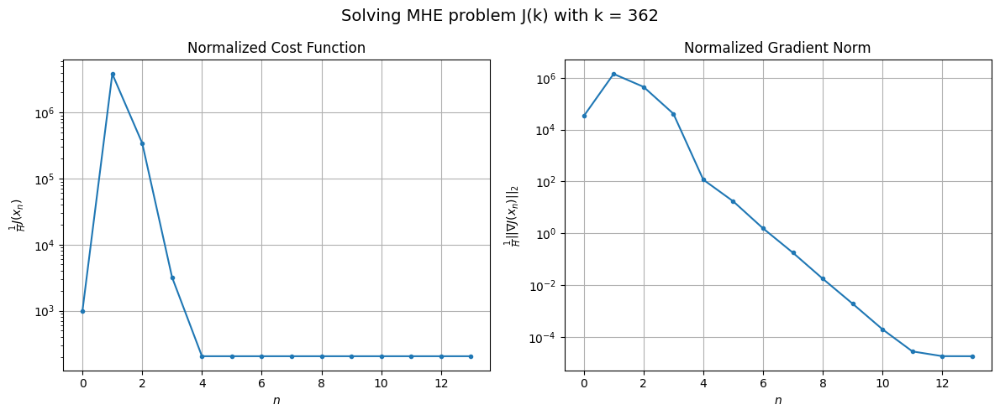

Windows:  92%|█████████▏| 354/386 [19:53<01:53,  3.56s/it]

[Gauss-Newton] Before applying the algorithm
Cost function: 2704.4960271417717
Gradient norm: 289193.4487928413
Global estimation error: 52.197726462825
Initial conditions estimation errors: 1.2441441667204642 m, 13.400877997244987 m, 44.89702258376346 m, 22.971974131504762 m
Position estimation errors: 5.022850119154732 m, 23.221928844141257 m, 29.75101628148157 m, 11.560762955763863 m

[Gauss-Newton] Iteration 1
Cost function: 47155.64918781199 (1643.60%)
Gradient norm: 506430.5450424135 (75.12%)
Global estimation error: 2149.9348745503653 (4018.83%)
Initial conditions estimation errors: 3.205468641759921 m, 734.0752564567651 m, 844.6681002358051 m, 1835.7227875454655 m
Position estimation errors: 2.7444008365074852 m, 763.9125065350522 m, 1072.4730297169606 m, 1760.6097871591035 m

[Gauss-Newton] Iteration 2
Cost function: 2154.1621850809 (-95.43%)
Gradient norm: 49049.21471459216 (-90.31%)
Global estimation error: 2835.6961670490005 (31.90%)
Initial conditions estimation errors: 3.

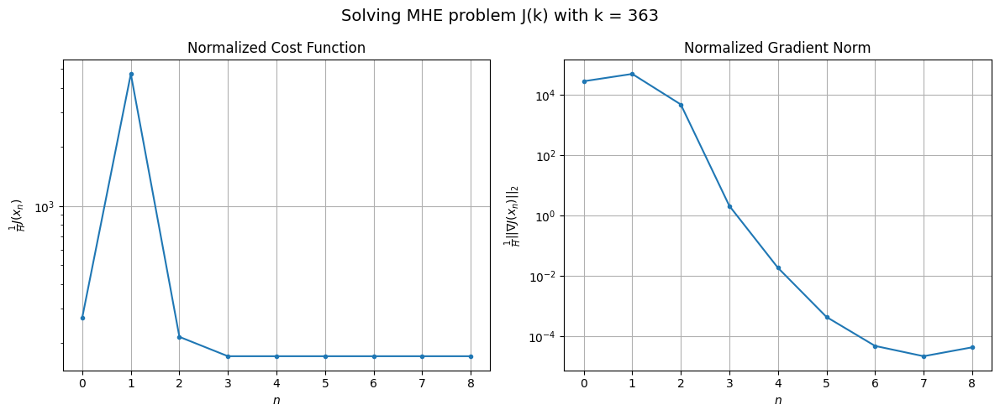

Windows:  92%|█████████▏| 355/386 [19:56<01:49,  3.54s/it]

[Gauss-Newton] Before applying the algorithm
Cost function: 2410.078030199389
Gradient norm: 282532.6373631282
Global estimation error: 2902.074899824044
Initial conditions estimation errors: 1.1252554195984146 m, 988.0567906200538 m, 1184.235243010683 m, 2458.326079358988 m
Position estimation errors: 4.609911484657226 m, 996.9774977915456 m, 1402.026616685875 m, 2264.2674247741716 m

[Gauss-Newton] Iteration 1
Cost function: 8439.4334388198 (250.17%)
Gradient norm: 157031.57704239167 (-44.42%)
Global estimation error: 4485.7313755659525 (54.57%)
Initial conditions estimation errors: 2.9482827869655646 m, 1553.3139739855708 m, 1954.8881765853248 m, 3726.580826622321 m
Position estimation errors: 2.4322048616803555 m, 1399.733545831946 m, 1957.637096827657 m, 3032.7616908702616 m



/home/jgaspar/SpaceSim-Toolkit/test/new_newton_based_algorithms/gauss_newton.py:181: LinAlgWarning: Ill-conditioned matrix (rcond=9.69151e-17): result may not be accurate.
  delta_x = solve(HJ_x, -DJ_x)


[Gauss-Newton] STOP on Iteration 2 (gradient norm stagnated)
Cost function = 37680.72620475349 (346.48%)
Gradient norm = 452714.19928605895 (188.30%)
Global estimation error = 2469.522811194053 (-44.95%)
Final initial conditions estimation errors: 2.948282785655652 m, 870.9272715761364 m, 1100.5143178527096 m, 2031.9664411318183 m
Final position estimation errors: 2.4322048524498574 m, 639.0038416089296 m, 936.0615664417224 m, 1343.168802141556 m



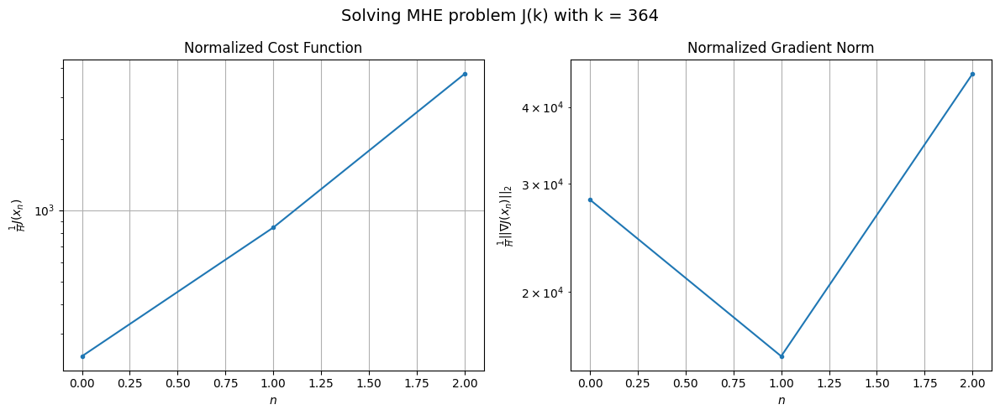

Windows:  92%|█████████▏| 356/386 [19:58<01:28,  2.96s/it]

[Gauss-Newton] Before applying the algorithm
Cost function: 38691.07039390563
Gradient norm: 501434.88089538465
Global estimation error: 2428.0498882045003
Initial conditions estimation errors: 0.91204096023508 m, 857.9712620981077 m, 1102.3614917626753 m, 1985.9781272391172 m
Position estimation errors: 4.141541451556692 m, 598.5058176239332 m, 894.6576015103412 m, 1233.0726415466809 m

[Gauss-Newton] Iteration 1
Cost function: 1147960.877847807 (2866.99%)
Gradient norm: 2594593.9429861293 (417.43%)
Global estimation error: 2253.7683722226375 (-7.18%)
Initial conditions estimation errors: 2.650374369873817 m, 738.7501632041217 m, 882.8344756304593 m, 1937.6030536010023 m
Position estimation errors: 2.1907528255648705 m, 1252.9958243792998 m, 1653.082095552856 m, 2826.484712759976 m

[Gauss-Newton] Iteration 2
Cost function: 1749.4523054169913 (-99.85%)
Gradient norm: 49261.38423792393 (-98.10%)
Global estimation error: 1459.9918243183633 (-35.22%)
Initial conditions estimation errors:

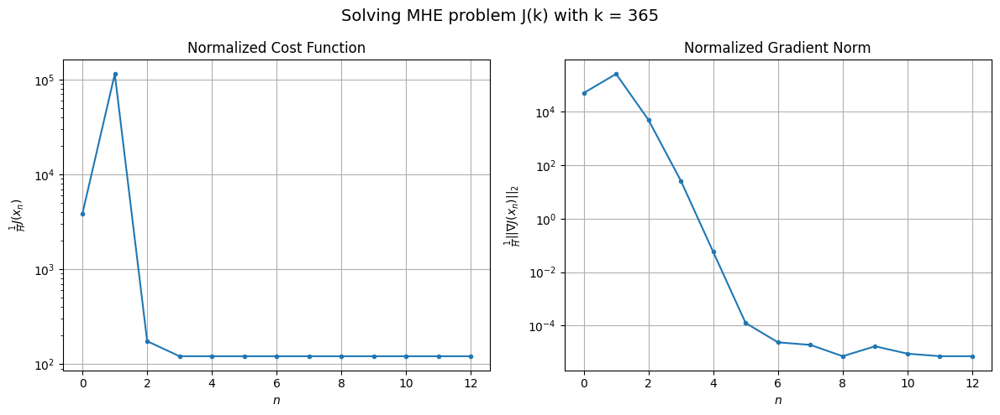

Windows:  92%|█████████▏| 357/386 [20:02<01:39,  3.44s/it]

[Gauss-Newton] Before applying the algorithm
Cost function: 1571.0372561954266
Gradient norm: 232469.00072173795
Global estimation error: 1600.916995584976
Initial conditions estimation errors: 0.736029321358735 m, 514.757531921861 m, 590.7602429605115 m, 1396.0486529755503 m
Position estimation errors: 3.769326611106338 m, 1031.1281153615744 m, 1348.8888904052149 m, 2351.3779167245198 m

[Gauss-Newton] Iteration 1
Cost function: 3497.063225163545 (122.60%)
Gradient norm: 134926.3600913958 (-41.96%)
Global estimation error: 889.197057028754 (-44.46%)
Initial conditions estimation errors: 2.361017934580985 m, 328.1173111116459 m, 479.26626510769984 m, 673.2797909573825 m
Position estimation errors: 1.93403793332222 m, 618.9705519067466 m, 865.5485562008894 m, 1212.8377786323763 m

[Gauss-Newton] Iteration 2
Cost function: 956.5255454465599 (-72.65%)
Gradient norm: 12477.215811606186 (-90.75%)
Global estimation error: 1095.3963643229863 (23.19%)
Initial conditions estimation errors: 2.36

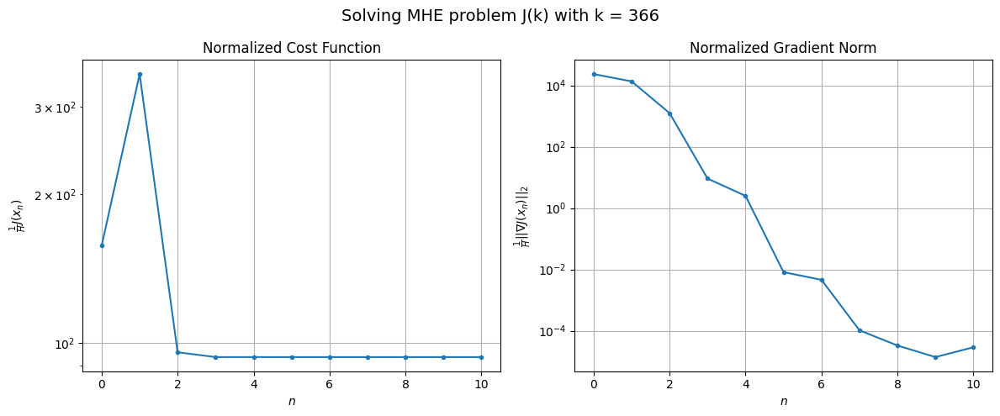

Windows:  93%|█████████▎| 358/386 [20:06<01:38,  3.53s/it]

[Gauss-Newton] Before applying the algorithm
Cost function: 1198.5413494002587
Gradient norm: 204516.40471781927
Global estimation error: 1288.8811143452797
Initial conditions estimation errors: 0.6228578993241787 m, 475.1129019166096 m, 667.8065756063761 m, 994.7422219041727 m
Position estimation errors: 3.387522936784545 m, 801.4545973439883 m, 1119.5257450325892 m, 1582.9864184354203 m

[Gauss-Newton] Iteration 1
Cost function: 5385.116470427171 (349.31%)
Gradient norm: 184656.22142493975 (-9.71%)
Global estimation error: 2069.742595754332 (60.58%)
Initial conditions estimation errors: 2.0507430791888988 m, 692.3206851405666 m, 862.41725089111 m, 1749.4982379989233 m
Position estimation errors: 1.7721999904011376 m, 1329.0987268156227 m, 1772.578727809787 m, 2894.2985678191526 m

[Gauss-Newton] Iteration 2
Cost function: 703.0573873566598 (-86.94%)
Gradient norm: 2838.2578730291893 (-98.46%)
Global estimation error: 2273.7936608899668 (9.86%)
Initial conditions estimation errors: 2.

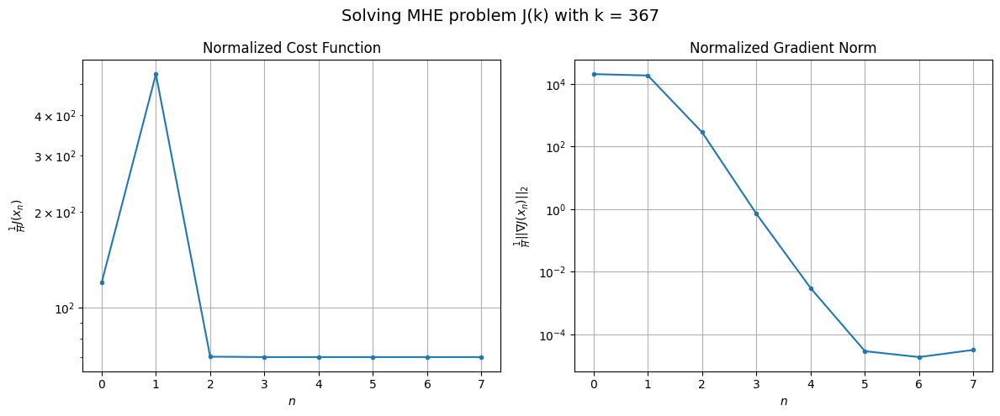

Windows:  93%|█████████▎| 359/386 [20:09<01:31,  3.39s/it]

[Gauss-Newton] Before applying the algorithm
Cost function: 964.4054017520914
Gradient norm: 194118.9808295126
Global estimation error: 2499.3727360045687
Initial conditions estimation errors: 0.5019223337579402 m, 855.0062277715136 m, 1082.5422794767865 m, 2084.2066395153656 m
Position estimation errors: 3.1210853141058115 m, 1429.626471576405 m, 1916.0912894071391 m, 3071.536604654659 m

[Gauss-Newton] Iteration 1
Cost function: 5715.483402004944 (492.64%)
Gradient norm: 193293.71493359993 (-0.43%)
Global estimation error: 1650.5522295733722 (-33.96%)
Initial conditions estimation errors: 1.779621799844055 m, 558.6280947573147 m, 696.2477047744159 m, 1388.3405813203813 m
Position estimation errors: 1.6256424179130902 m, 850.2666379103382 m, 1124.4098306314472 m, 1858.1077940813157 m

[Gauss-Newton] Iteration 2
Cost function: 560.7128708371537 (-90.19%)
Gradient norm: 3456.407952978395 (-98.21%)
Global estimation error: 1862.3076115267252 (12.83%)
Initial conditions estimation errors:

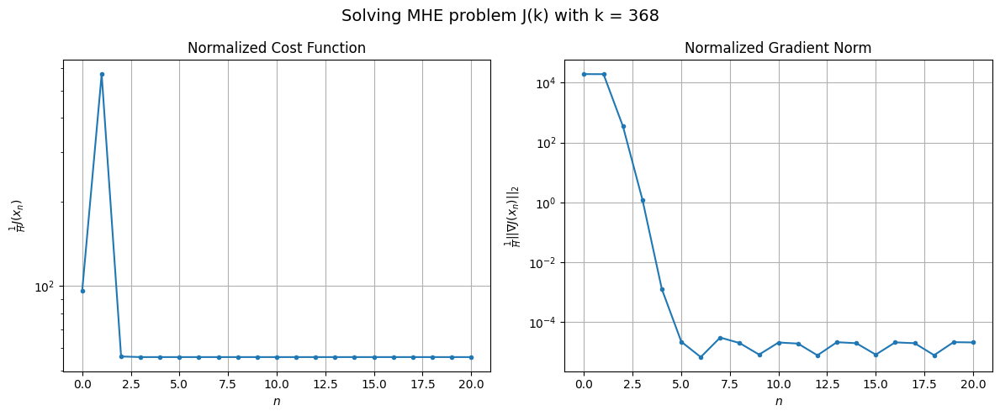

Windows:  93%|█████████▎| 360/386 [20:16<01:51,  4.30s/it]

[Gauss-Newton] Before applying the algorithm
Cost function: 817.2872706494198
Gradient norm: 183387.19280646776
Global estimation error: 1961.3961266453432
Initial conditions estimation errors: 0.4386463715195098 m, 676.0806131502006 m, 856.9572348468824 m, 1629.6044851831202 m
Position estimation errors: 2.8599499446216945 m, 920.894544456638 m, 1228.721289854857 m, 1979.798953119667 m

[Gauss-Newton] Iteration 1
Cost function: 117834.53979637363 (14317.76%)
Gradient norm: 779975.7614325661 (325.32%)
Global estimation error: 888.5746652774505 (-54.70%)
Initial conditions estimation errors: 1.5585614186435472 m, 320.4640700062401 m, 490.5228104639252 m, 668.0205240587834 m
Position estimation errors: 1.486451175741437 m, 93.86561933482776 m, 122.74481999666925 m, 117.80686991619753 m

[Gauss-Newton] Iteration 2
Cost function: 633.2661849423998 (-99.46%)
Gradient norm: 29026.415764900095 (-96.28%)
Global estimation error: 1410.9761017011112 (58.79%)
Initial conditions estimation errors:

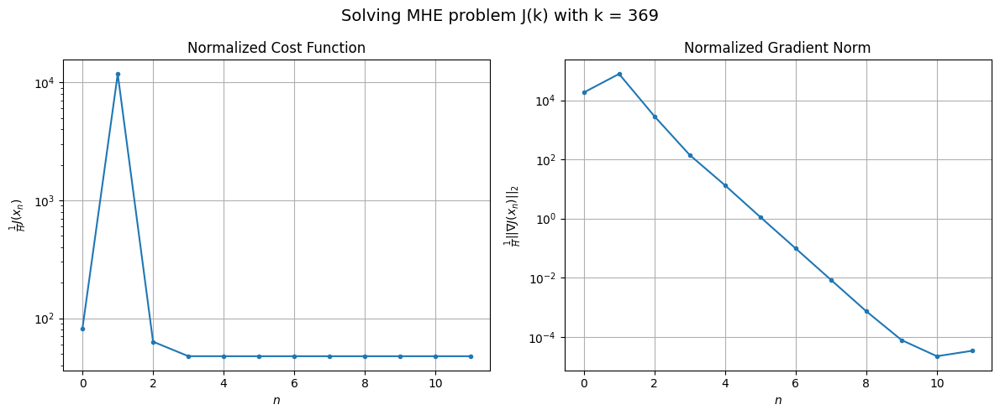

Windows:  94%|█████████▎| 361/386 [20:20<01:46,  4.26s/it]

[Gauss-Newton] Before applying the algorithm
Cost function: 677.4524877817435
Gradient norm: 160707.58813991398
Global estimation error: 1263.0465102517571
Initial conditions estimation errors: 0.39162528547053077 m, 460.5340170096396 m, 678.7696484049864 m, 960.4505945896893 m
Position estimation errors: 2.6007552401475724 m, 217.5294323198571 m, 304.20792158062244 m, 342.9671731210868 m

[Gauss-Newton] Iteration 1
Cost function: 1060.8107016407123 (56.59%)
Gradient norm: 53666.254099922415 (-66.61%)
Global estimation error: 453.47808824004676 (-64.10%)
Initial conditions estimation errors: 1.372715383568536 m, 129.45836307195808 m, 154.18202543703603 m, 406.3286468525705 m
Position estimation errors: 1.399818506970831 m, 592.9544779077469 m, 787.7032484062897 m, 1272.4609063911928 m

[Gauss-Newton] Iteration 2
Cost function: 247695.8359997175 (23249.67%)
Gradient norm: 1153934.2109982127 (2050.20%)
Global estimation error: 2888.2253579291128 (536.91%)
Initial conditions estimation er

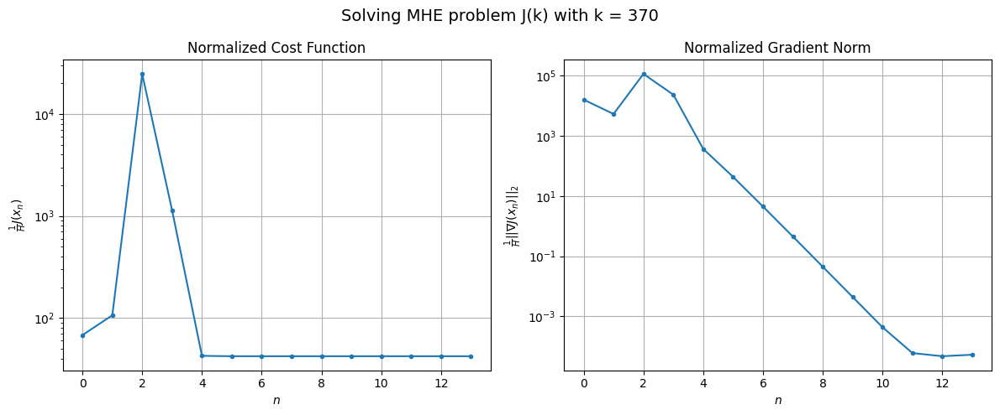

Windows:  94%|█████████▍| 362/386 [20:24<01:45,  4.38s/it]

[Gauss-Newton] Before applying the algorithm
Cost function: 599.2998255415453
Gradient norm: 145083.07262543164
Global estimation error: 1380.693894989175
Initial conditions estimation errors: 0.3803126758419323 m, 533.2952064480079 m, 754.0216968786186 m, 1026.3330105390594 m
Position estimation errors: 2.393548934461751 m, 95.02498186246045 m, 210.80545502662446 m, 85.28321700543857 m

[Gauss-Newton] Iteration 1
Cost function: 1449775.1610020166 (241811.49%)
Gradient norm: 2803618.6194297737 (1832.42%)
Global estimation error: 3743.3123025569157 (171.12%)
Initial conditions estimation errors: 1.2368977238575316 m, 1364.8338037020646 m, 1959.6485798226872 m, 2882.5992947066425 m
Position estimation errors: 1.321980229018349 m, 1890.3194052843446 m, 2720.0674453936563 m, 3609.6038558227583 m



/home/jgaspar/SpaceSim-Toolkit/test/new_newton_based_algorithms/gauss_newton.py:181: LinAlgWarning: Ill-conditioned matrix (rcond=9.64424e-17): result may not be accurate.
  delta_x = solve(HJ_x, -DJ_x)


[Gauss-Newton] Iteration 2
Cost function: 536.0346124898979 (-99.96%)
Gradient norm: 12737.72361696224 (-99.55%)
Global estimation error: 3023.9236210037798 (-19.22%)
Initial conditions estimation errors: 1.2368976037883725 m, 1094.6505925733659 m, 1578.5407314953943 m, 2335.3890780686856 m
Position estimation errors: 1.3219803432007318 m, 1821.6648945152026 m, 2598.014722702392 m, 3525.273176166596 m



/home/jgaspar/SpaceSim-Toolkit/test/new_newton_based_algorithms/gauss_newton.py:181: LinAlgWarning: Ill-conditioned matrix (rcond=1.00275e-16): result may not be accurate.
  delta_x = solve(HJ_x, -DJ_x)


[Gauss-Newton] Iteration 3
Cost function: 1420.0005162746409 (164.91%)
Gradient norm: 74696.85047081237 (486.42%)
Global estimation error: 3854.9724399585466 (27.48%)
Initial conditions estimation errors: 1.2368976266652711 m, 1402.9072550823553 m, 2010.216923652048 m, 2975.1752529698924 m
Position estimation errors: 1.3219803226571378 m, 2142.742639297567 m, 3067.6824714739955 m, 4135.771216399334 m



/home/jgaspar/SpaceSim-Toolkit/test/new_newton_based_algorithms/gauss_newton.py:181: LinAlgWarning: Ill-conditioned matrix (rcond=1.07814e-16): result may not be accurate.
  delta_x = solve(HJ_x, -DJ_x)


[Gauss-Newton] STOP on Iteration 4 (gradient norm stagnated)
Cost function = 1737.7631637432473 (22.38%)
Gradient norm = 85690.74088832583 (14.72%)
Global estimation error = 2967.826490630181 (-23.01%)
Final initial conditions estimation errors: 1.236897609769584 m, 1074.088514611747 m, 1550.119828055826 m, 2291.6010861342183 m
Final position estimation errors: 1.321980337214303 m, 1798.4311950303004 m, 2564.1299197416715 m, 3481.4511653594814 m



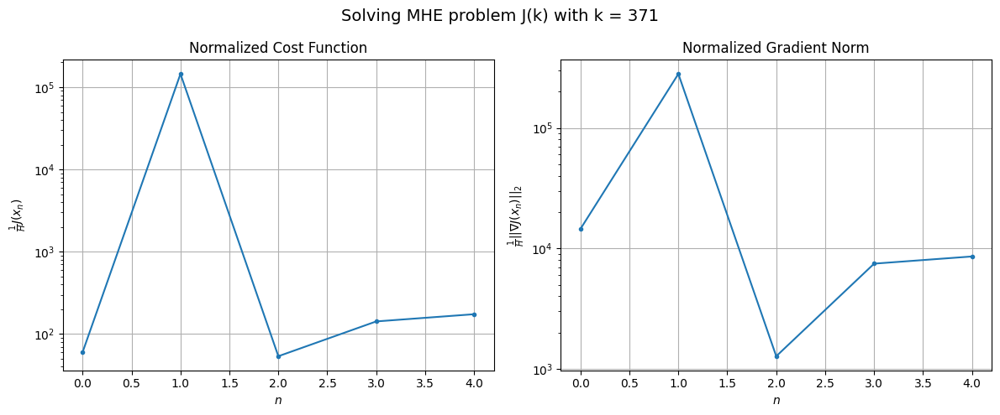

Windows:  94%|█████████▍| 363/386 [20:27<01:26,  3.75s/it]

[Gauss-Newton] Before applying the algorithm
Cost function: 1902.7046719111702
Gradient norm: 170977.27902654902
Global estimation error: 3221.8800297380803
Initial conditions estimation errors: 0.37782390626990986 m, 1178.319587249854 m, 1697.3496267950877 m, 2472.0559251946993 m
Position estimation errors: 2.2223735993105724 m, 1843.7541709469579 m, 2626.449020169646 m, 3544.374794914651 m



/home/jgaspar/SpaceSim-Toolkit/test/new_newton_based_algorithms/gauss_newton.py:181: LinAlgWarning: Ill-conditioned matrix (rcond=9.21249e-17): result may not be accurate.
  delta_x = solve(HJ_x, -DJ_x)


[Gauss-Newton] Iteration 1
Cost function: 59748.200705168005 (3040.17%)
Gradient norm: 297212.4274227563 (73.83%)
Global estimation error: 6347.178983121959 (97.00%)
Initial conditions estimation errors: 1.2590218717578887 m, 2359.99850483774 m, 3367.174502255223 m, 4835.206423347482 m
Position estimation errors: 1.1430099882889144 m, 2190.947691511308 m, 3234.2828431969424 m, 4042.679338008409 m

[Gauss-Newton] Iteration 2
Cost function: 5449632.566879015 (9021.00%)
Gradient norm: 6064640.342240594 (1940.51%)
Global estimation error: 12048.983779568238 (89.83%)
Initial conditions estimation errors: 1.2590209960072372 m, 4458.978301507276 m, 6291.886719204459 m, 9257.841009394362 m
Position estimation errors: 1.1430106990701527 m, 5364.10101516021 m, 7775.495269208342 m, 10253.566606859129 m

[Gauss-Newton] Iteration 3
Cost function: 645697.462837677 (-88.15%)
Gradient norm: 2174952.5676435702 (-64.14%)
Global estimation error: 9374.74523835121 (-22.19%)
Initial conditions estimation e

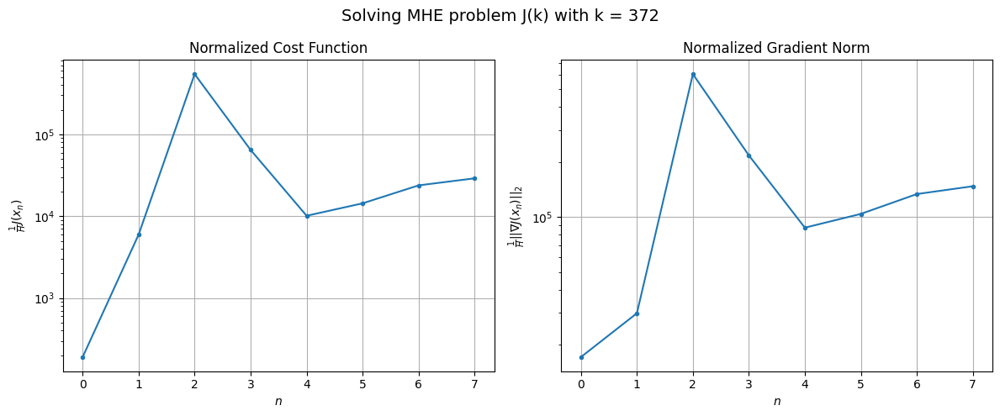

Windows:  94%|█████████▍| 364/386 [20:30<01:17,  3.54s/it]

[Gauss-Newton] Before applying the algorithm
Cost function: 379696.0517871056
Gradient norm: 1684778.2961888763
Global estimation error: 8965.55084329589
Initial conditions estimation errors: 0.423460067811331 m, 3352.2895652663165 m, 4788.626626646769 m, 6797.963617350483 m
Position estimation errors: 1.9596982079891359 m, 3107.1451575000556 m, 4596.533225688731 m, 5659.402612705567 m

[Gauss-Newton] Iteration 1
Cost function: 272107.75676359195 (-28.34%)
Gradient norm: 1380111.6529812748 (-18.08%)
Global estimation error: 11420.695223271516 (27.38%)
Initial conditions estimation errors: 1.2667202542224352 m, 4308.85393810592 m, 6145.664487168492 m, 8607.952037662932 m
Position estimation errors: 0.9976956299231894 m, 4643.5886487073385 m, 6875.011911315741 m, 8571.846870500469 m

[Gauss-Newton] Iteration 2
Cost function: 306.0873078512641 (-99.89%)
Gradient norm: 8315.220308709453 (-99.40%)
Global estimation error: 11392.56208654131 (-0.25%)
Initial conditions estimation errors: 1.26

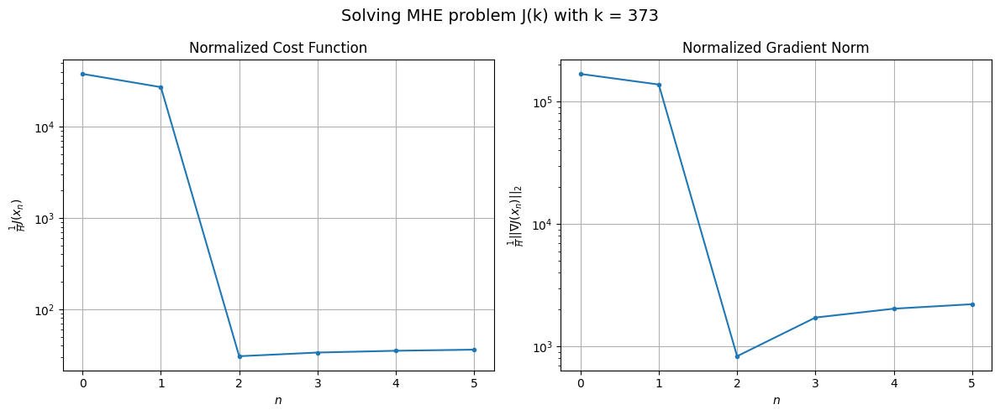

Windows:  95%|█████████▍| 365/386 [20:32<01:08,  3.26s/it]

[Gauss-Newton] Before applying the algorithm
Cost function: 508.1666022212354
Gradient norm: 119195.40906456074
Global estimation error: 11827.895818024741
Initial conditions estimation errors: 0.4232391217096409 m, 4483.461300301061 m, 6431.389573799824 m, 8856.348236717504 m
Position estimation errors: 1.754834761135973 m, 4625.0121882164185 m, 6880.956334753758 m, 8457.511474885816 m

[Gauss-Newton] Iteration 1
Cost function: 4389917.207753054 (863773.62%)
Gradient norm: 5125011.898928966 (4199.67%)
Global estimation error: 5658.493235732995 (-52.16%)
Initial conditions estimation errors: 1.199936362401518 m, 2166.5340310011206 m, 3126.9628850958266 m, 4188.887329806851 m
Position estimation errors: 0.8846164106567788 m, 1901.6111442251417 m, 2910.8400690188523 m, 3293.599506328144 m

[Gauss-Newton] Iteration 2
Cost function: 30123454.382078 (586.20%)
Gradient norm: 11792753.892505325 (130.10%)
Global estimation error: 6314.528216912896 (11.59%)
Initial conditions estimation errors:

/home/jgaspar/SpaceSim-Toolkit/test/new_newton_based_algorithms/gauss_newton.py:181: LinAlgWarning: Ill-conditioned matrix (rcond=8.41971e-17): result may not be accurate.
  delta_x = solve(HJ_x, -DJ_x)


[Gauss-Newton] Iteration 4
Cost function: 4400068.817327912 (20794.17%)
Gradient norm: 3903687.929300601 (886.32%)
Global estimation error: 2904.874950110181 (-43.92%)
Initial conditions estimation errors: 1.1999360788558613 m, 1110.951614848763 m, 1582.1046262596808 m, 2168.185296110357 m
Position estimation errors: 0.884616627776964 m, 951.5783697213108 m, 1499.04135114023 m, 1597.0653450500208 m



/home/jgaspar/SpaceSim-Toolkit/test/new_newton_based_algorithms/gauss_newton.py:181: LinAlgWarning: Ill-conditioned matrix (rcond=5.88566e-17): result may not be accurate.
  delta_x = solve(HJ_x, -DJ_x)


[Gauss-Newton] Iteration 5
Cost function: 97513359.68411109 (2116.18%)
Gradient norm: 21760220.294415686 (457.43%)
Global estimation error: 12925.932212356356 (344.97%)
Initial conditions estimation errors: 1.199935847562051 m, 4920.105584557274 m, 7145.312847480683 m, 9582.10750152615 m
Position estimation errors: 0.8846167923818117 m, 4442.866252011959 m, 6704.846900282845 m, 7938.897884413206 m

[Gauss-Newton] Iteration 6
Cost function: 3506953.5074534775 (-96.40%)
Gradient norm: 4637452.765926407 (-78.69%)
Global estimation error: 6684.241881510648 (-48.29%)
Initial conditions estimation errors: 1.199935992712997 m, 2541.70039451468 m, 3701.307310244959 m, 4951.682683684714 m
Position estimation errors: 0.8846166879956134 m, 1651.907996999263 m, 2565.6679082152605 m, 2810.0356370646114 m



/home/jgaspar/SpaceSim-Toolkit/test/new_newton_based_algorithms/gauss_newton.py:181: LinAlgWarning: Ill-conditioned matrix (rcond=1.03907e-16): result may not be accurate.
  delta_x = solve(HJ_x, -DJ_x)


[Gauss-Newton] Iteration 7
Cost function: 8160663.470075236 (132.70%)
Gradient norm: 5420359.927643203 (16.88%)
Global estimation error: 2736.1771653524893 (-59.07%)
Initial conditions estimation errors: 1.1999360827746561 m, 1046.7085981213006 m, 1489.8872417284124 m, 2042.375981428157 m
Position estimation errors: 0.8846166201931829 m, 776.5809458050553 m, 1249.153457099281 m, 1256.6482728214282 m



/home/jgaspar/SpaceSim-Toolkit/test/new_newton_based_algorithms/gauss_newton.py:181: LinAlgWarning: Ill-conditioned matrix (rcond=6.37346e-17): result may not be accurate.
  delta_x = solve(HJ_x, -DJ_x)


[Gauss-Newton] Iteration 8
Cost function: 39940978.11902368 (389.43%)
Gradient norm: 13664903.871610558 (152.10%)
Global estimation error: 10188.097252288866 (272.35%)
Initial conditions estimation errors: 1.1999359058569212 m, 3876.825596053001 m, 5631.512382084857 m, 7553.384295103822 m
Position estimation errors: 0.8846167600198912 m, 3436.297178367734 m, 5187.987437529966 m, 6141.478343674155 m

[Gauss-Newton] Iteration 9
Cost function: 992276.5001570673 (-97.52%)
Gradient norm: 2516299.933045357 (-81.59%)
Global estimation error: 5901.404230800813 (-42.08%)
Initial conditions estimation errors: 1.199935973572137 m, 2245.9216101973893 m, 3276.779232224109 m, 4364.070887064274 m
Position estimation errors: 0.8846166988658897 m, 1376.9910491254302 m, 2152.7431419858085 m, 2311.166057055295 m



/home/jgaspar/SpaceSim-Toolkit/test/new_newton_based_algorithms/gauss_newton.py:181: LinAlgWarning: Ill-conditioned matrix (rcond=9.02347e-17): result may not be accurate.
  delta_x = solve(HJ_x, -DJ_x)


[Gauss-Newton] Iteration 10
Cost function: 6038394.048260417 (508.54%)
Gradient norm: 4627093.437155093 (83.88%)
Global estimation error: 2825.896802437796 (-52.11%)
Initial conditions estimation errors: 1.1999361304482787 m, 1082.30784782916 m, 1542.2198741942932 m, 2106.1475822938455 m
Position estimation errors: 0.8846165885057723 m, 841.7073248072937 m, 1345.1026003922725 m, 1379.9106157448734 m



/home/jgaspar/SpaceSim-Toolkit/test/new_newton_based_algorithms/gauss_newton.py:181: LinAlgWarning: Ill-conditioned matrix (rcond=6.11889e-17): result may not be accurate.
  delta_x = solve(HJ_x, -DJ_x)


[Gauss-Newton] Iteration 11
Cost function: 58799233.57740629 (873.76%)
Gradient norm: 16715699.176788095 (261.26%)
Global estimation error: 11269.418607004634 (298.79%)
Initial conditions estimation errors: 1.1999358874685366 m, 4288.690428017016 m, 6228.659765401286 m, 8355.2812101555 m
Position estimation errors: 0.8846167713853508 m, 3843.6354006659126 m, 5800.57766852934 m, 6871.70970221652 m

[Gauss-Newton] Iteration 12
Cost function: 1774583.1348045557 (-96.98%)
Gradient norm: 3335437.7050524894 (-80.05%)
Global estimation error: 6177.824308482544 (-45.18%)
Initial conditions estimation errors: 1.1999359756189165 m, 2350.5803011821463 m, 3427.204829853695 m, 4571.054728530743 m
Position estimation errors: 0.8846166980599024 m, 1477.6174689469478 m, 2304.1605988323836 m, 2494.571302008782 m



/home/jgaspar/SpaceSim-Toolkit/test/new_newton_based_algorithms/gauss_newton.py:181: LinAlgWarning: Ill-conditioned matrix (rcond=9.45892e-17): result may not be accurate.
  delta_x = solve(HJ_x, -DJ_x)


[Gauss-Newton] Iteration 13
Cost function: 6791043.044881058 (282.68%)
Gradient norm: 4922141.387855793 (47.57%)
Global estimation error: 2810.5273355128224 (-54.51%)
Initial conditions estimation errors: 1.1999361185982214 m, 1076.1001074119358 m, 1533.0686615571874 m, 2095.4164617778383 m
Position estimation errors: 0.8846165976588981 m, 820.387374263831 m, 1314.472387710852 m, 1338.1146837487731 m



/home/jgaspar/SpaceSim-Toolkit/test/new_newton_based_algorithms/gauss_newton.py:181: LinAlgWarning: Ill-conditioned matrix (rcond=6.17678e-17): result may not be accurate.
  delta_x = solve(HJ_x, -DJ_x)


[Gauss-Newton] Iteration 14
Cost function: 52066709.57784167 (666.70%)
Gradient norm: 15687588.846432475 (218.71%)
Global estimation error: 10906.754156168332 (288.07%)
Initial conditions estimation errors: 1.199935894720168 m, 4150.524558003342 m, 6028.223606760246 m, 8086.4670229830635 m
Position estimation errors: 0.8846167662481106 m, 3710.086403547581 m, 5599.349247555983 m, 6633.229832307098 m

[Gauss-Newton] Iteration 15
Cost function: 1489998.2512250207 (-97.14%)
Gradient norm: 3065048.7465648865 (-80.46%)
Global estimation error: 6074.118437921292 (-44.31%)
Initial conditions estimation errors: 1.1999359726895682 m, 2311.3845386521457 m, 3370.9199238341084 m, 4493.250943486939 m
Position estimation errors: 0.8846166990416213 m, 1440.8675977392604 m, 2248.9453014069077 m, 2427.9117178119586 m



/home/jgaspar/SpaceSim-Toolkit/test/new_newton_based_algorithms/gauss_newton.py:181: LinAlgWarning: Ill-conditioned matrix (rcond=9.28237e-17): result may not be accurate.
  delta_x = solve(HJ_x, -DJ_x)


[Gauss-Newton] Iteration 16
Cost function: 6484997.070251583 (335.24%)
Gradient norm: 4804759.957338248 (56.76%)
Global estimation error: 2810.6256614166027 (-53.73%)
Initial conditions estimation errors: 1.1999361245246247 m, 1076.3301228725786 m, 1533.5319603970136 m, 2095.09118023319 m
Position estimation errors: 0.8846165935348964 m, 826.1869147613484 m, 1322.722584277857 m, 1349.817545940363 m



/home/jgaspar/SpaceSim-Toolkit/test/new_newton_based_algorithms/gauss_newton.py:181: LinAlgWarning: Ill-conditioned matrix (rcond=6.16566e-17): result may not be accurate.
  delta_x = solve(HJ_x, -DJ_x)


[Gauss-Newton] Iteration 17
Cost function: 53941588.43523804 (731.79%)
Gradient norm: 15980782.834140897 (232.60%)
Global estimation error: 11013.233052733825 (291.84%)
Initial conditions estimation errors: 1.1999358925745787 m, 4191.088234467531 m, 6087.071892104051 m, 8165.392461640827 m
Position estimation errors: 0.8846167666796034 m, 3748.8492902776306 m, 5657.828568549804 m, 6702.295422528509 m

[Gauss-Newton] Iteration 18
Cost function: 1567941.3865222482 (-97.09%)
Gradient norm: 3141348.3226292497 (-80.34%)
Global estimation error: 6105.686117189921 (-44.56%)
Initial conditions estimation errors: 1.1999359739498394 m, 2323.3021921467916 m, 3388.0233716619337 m, 4516.9631807225005 m
Position estimation errors: 0.8846167006276243 m, 1452.0361230322294 m, 2265.700131533899 m, 2448.1446614549036 m



/home/jgaspar/SpaceSim-Toolkit/test/new_newton_based_algorithms/gauss_newton.py:181: LinAlgWarning: Ill-conditioned matrix (rcond=9.3368e-17): result may not be accurate.
  delta_x = solve(HJ_x, -DJ_x)


[Gauss-Newton] Iteration 19
Cost function: 6583023.220972918 (319.85%)
Gradient norm: 4842538.300261805 (54.15%)
Global estimation error: 2812.550847844211 (-53.94%)
Initial conditions estimation errors: 1.1999361224128882 m, 1076.9995296993923 m, 1534.4529572312326 m, 2096.6558237993618 m
Position estimation errors: 0.8846165926861205 m, 824.9231452590471 m, 1320.9925889050278 m, 1347.0908869057946 m



/home/jgaspar/SpaceSim-Toolkit/test/new_newton_based_algorithms/gauss_newton.py:181: LinAlgWarning: Ill-conditioned matrix (rcond=6.16559e-17): result may not be accurate.
  delta_x = solve(HJ_x, -DJ_x)


[Gauss-Newton] STOP on Iteration 20 (max iteration reached)
Cost function = 53499086.7333788 (712.68%)
Gradient norm = 15911699.913505075 (228.58%)
Global estimation error = 10987.131908488518 (290.65%)
Final initial conditions estimation errors: 1.1999358930172377 m, 4181.143705447146 m, 6072.638439643169 m, 8146.052042033516 m
Final position estimation errors: 0.8846167666570648 m, 3739.638084933678 m, 5643.890866493966 m, 6685.975557801636 m



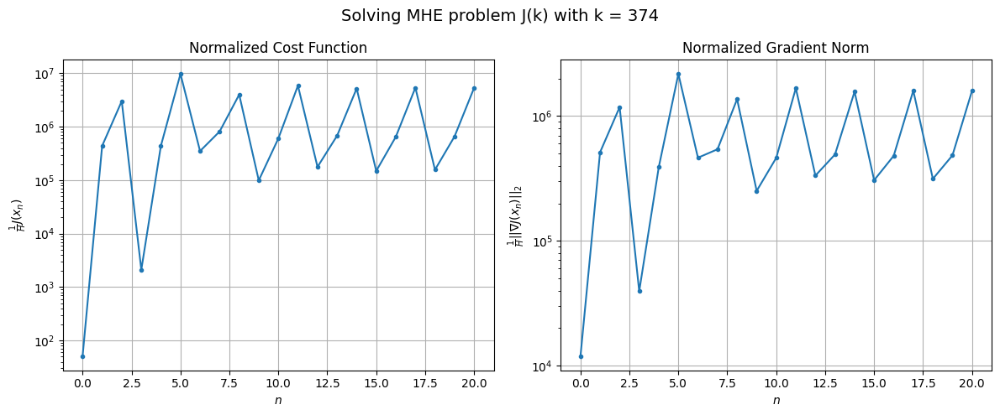

Windows:  95%|█████████▍| 366/386 [20:39<01:27,  4.36s/it]

[Gauss-Newton] Before applying the algorithm
Cost function: 49938933.5549189
Gradient norm: 15072369.481863257
Global estimation error: 11010.364494428617
Initial conditions estimation errors: 0.348479732810956 m, 4204.581673183756 m, 6131.531974387733 m, 8121.202709016429 m
Position estimation errors: 1.6068879094034842 m, 3603.397516770052 m, 5467.285903635827 m, 6363.45686818369 m

[Gauss-Newton] Iteration 1
Cost function: 7427790.530603298 (-85.13%)
Gradient norm: 6106329.238417767 (-59.49%)
Global estimation error: 2798.1866599562763 (-74.59%)
Initial conditions estimation errors: 1.0623506768604356 m, 1073.4246860360754 m, 1554.9811116554922 m, 2063.889343900414 m
Position estimation errors: 0.7512440991126315 m, 715.8230245597543 m, 1129.1026214912547 m, 1218.217812602262 m

[Gauss-Newton] Iteration 2
Cost function: 1968894.3784067037 (-73.49%)
Gradient norm: 2965479.727483874 (-51.44%)
Global estimation error: 3371.892902043208 (20.50%)
Initial conditions estimation errors: 1.0

/home/jgaspar/SpaceSim-Toolkit/test/new_newton_based_algorithms/gauss_newton.py:181: LinAlgWarning: Ill-conditioned matrix (rcond=5.07609e-17): result may not be accurate.
  delta_x = solve(HJ_x, -DJ_x)


[Gauss-Newton] Iteration 3
Cost function: 82030120.93718404 (4066.30%)
Gradient norm: 20619867.29876029 (595.33%)
Global estimation error: 11182.031669994903 (231.62%)
Initial conditions estimation errors: 1.0623506639205669 m, 4281.952411896515 m, 6225.658211475609 m, 8242.808180736822 m
Position estimation errors: 0.7512441078915989 m, 4141.366372437092 m, 6275.004093153748 m, 7374.372960875181 m

[Gauss-Newton] Iteration 4
Cost function: 11085522.18262125 (-86.49%)
Gradient norm: 7721375.004499253 (-62.55%)
Global estimation error: 2443.6145820181937 (-78.15%)
Initial conditions estimation errors: 1.062350647130848 m, 932.1806845874985 m, 1333.180014764191 m, 1823.4366081499454 m
Position estimation errors: 0.7512441129999821 m, 779.2589674934251 m, 1198.314463356415 m, 1392.436043154017 m

[Gauss-Newton] Iteration 5
Cost function: 739812.3081097578 (-93.33%)
Gradient norm: 1989663.1399854936 (-74.23%)
Global estimation error: 2050.205525684249 (-16.10%)
Initial conditions estimatio

/home/jgaspar/SpaceSim-Toolkit/test/new_newton_based_algorithms/gauss_newton.py:181: LinAlgWarning: Ill-conditioned matrix (rcond=5.18577e-17): result may not be accurate.
  delta_x = solve(HJ_x, -DJ_x)


[Gauss-Newton] STOP on Iteration 6 (gradient norm stagnated)
Cost function = 14005871.148502685 (1793.17%)
Gradient norm = 8509844.516078657 (327.70%)
Global estimation error = 7249.053969130759 (253.58%)
Final initial conditions estimation errors: 1.0623507240900925 m, 2772.701907655585 m, 4018.971857750378 m, 5358.056584894871 m
Final position estimation errors: 0.7512440699896027 m, 2480.549325723775 m, 3777.541049533473 m, 4390.657711302072 m



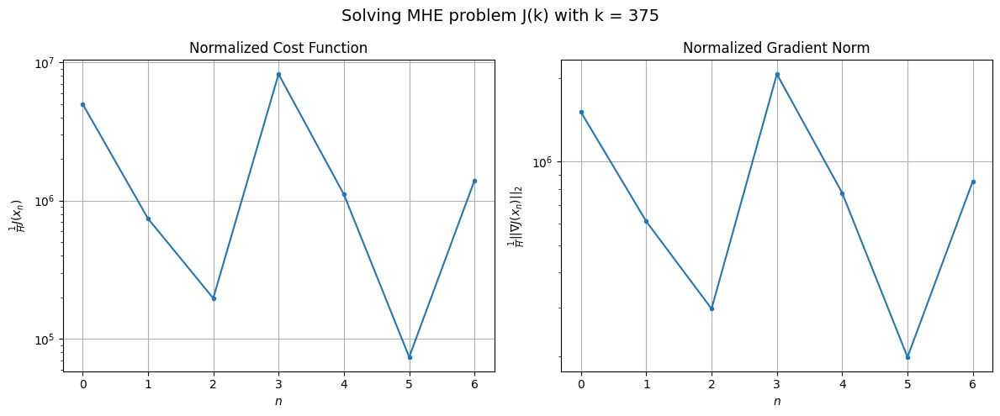

Windows:  95%|█████████▌| 367/386 [20:42<01:14,  3.93s/it]

[Gauss-Newton] Before applying the algorithm
Cost function: 13591161.022466047
Gradient norm: 8244611.229469238
Global estimation error: 7266.264018737875
Initial conditions estimation errors: 0.2870247538207184 m, 2788.4144055372544 m, 4062.566789678324 m, 5340.307847238087 m
Position estimation errors: 1.4761824210728753 m, 2389.954116419297 m, 3665.4160957321897 m, 4178.52811741255 m

[Gauss-Newton] Iteration 1
Cost function: 10839.65766208679 (-99.92%)
Gradient norm: 196548.48078335737 (-97.62%)
Global estimation error: 9015.530689366853 (24.07%)
Initial conditions estimation errors: 0.8919241929320029 m, 3496.4795757836405 m, 5224.130149737728 m, 6462.4171009854745 m
Position estimation errors: 0.7820999871945533 m, 1629.781728551541 m, 2709.29122737298 m, 2378.04115408884 m

[Gauss-Newton] Iteration 2
Cost function: 134121.97179984185 (1137.33%)
Gradient norm: 516953.9012166997 (163.02%)
Global estimation error: 5347.731430498583 (-40.68%)
Initial conditions estimation errors: 0.

/home/jgaspar/SpaceSim-Toolkit/test/new_newton_based_algorithms/gauss_newton.py:181: LinAlgWarning: Ill-conditioned matrix (rcond=3.57703e-17): result may not be accurate.
  delta_x = solve(HJ_x, -DJ_x)


[Gauss-Newton] Iteration 4
Cost function: 1947749.681575965 (-64.72%)
Gradient norm: 3626955.479831661 (-18.60%)
Global estimation error: 7355.339682645379 (135.95%)
Initial conditions estimation errors: 0.8919238977187106 m, 2821.223066983389 m, 4082.250239783347 m, 5429.264681778091 m
Position estimation errors: 0.7821001208668362 m, 3613.631293440369 m, 5425.259768542662 m, 6557.231449485263 m

[Gauss-Newton] STOP on Iteration 5 (gradient norm stagnated)
Cost function = 1855963.9360624673 (-4.71%)
Gradient norm = 3573563.584699074 (-1.47%)
Global estimation error = 3205.3803576998653 (-56.42%)
Final initial conditions estimation errors: 0.8919243250095059 m, 1236.9264742809441 m, 1760.680335802044 m, 2375.8113275514434 m
Final position estimation errors: 0.7820999171478806 m, 1132.262854901301 m, 1800.948287644977 m, 1921.9666459740033 m



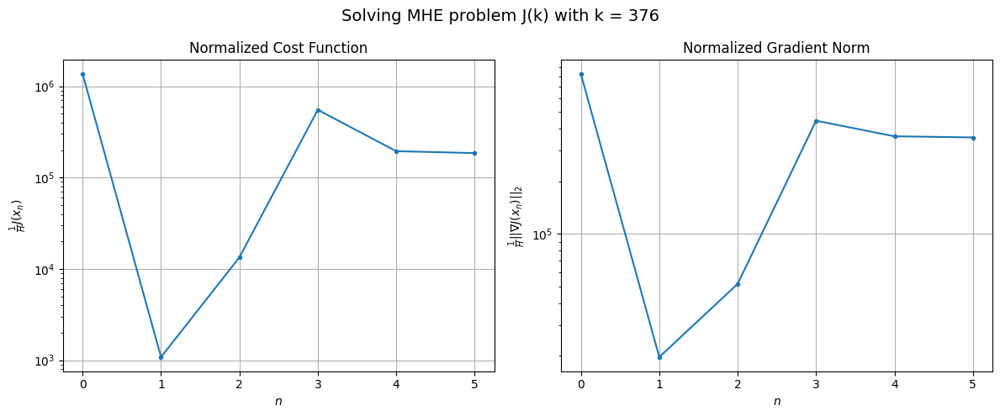

Windows:  95%|█████████▌| 368/386 [20:44<01:01,  3.42s/it]

[Gauss-Newton] Before applying the algorithm
Cost function: 2157898.653670934
Gradient norm: 3814934.789172359
Global estimation error: 3220.880848426315
Initial conditions estimation errors: 0.24975223966468812 m, 1246.2982493913987 m, 1797.2848758189768 m, 2364.440865734763 m
Position estimation errors: 1.5662923783338571 m, 1095.7942773264508 m, 1764.7511989083323 m, 1827.0450230338217 m



/home/jgaspar/SpaceSim-Toolkit/test/new_newton_based_algorithms/gauss_newton.py:181: LinAlgWarning: Ill-conditioned matrix (rcond=3.16596e-17): result may not be accurate.
  delta_x = solve(HJ_x, -DJ_x)


[Gauss-Newton] Iteration 1
Cost function: 4004230.95423234 (85.56%)
Gradient norm: 3922818.1542056133 (2.83%)
Global estimation error: 4416.2851821395325 (37.11%)
Initial conditions estimation errors: 0.7926874927524705 m, 1709.7742315818582 m, 2576.8304332580315 m, 3152.8060158751787 m
Position estimation errors: 0.9169772574916635 m, 1027.5312195773022 m, 1595.0053683055933 m, 1650.7752327783148 m



/home/jgaspar/SpaceSim-Toolkit/test/new_newton_based_algorithms/gauss_newton.py:181: LinAlgWarning: Ill-conditioned matrix (rcond=3.92826e-17): result may not be accurate.
  delta_x = solve(HJ_x, -DJ_x)


[Gauss-Newton] Iteration 2
Cost function: 154964.66632632152 (-96.13%)
Gradient norm: 408499.0408965274 (-89.59%)
Global estimation error: 8423.186527362142 (90.73%)
Initial conditions estimation errors: 0.7926876133730287 m, 3258.5783112717613 m, 4864.8202867395785 m, 6055.179587933968 m
Position estimation errors: 0.9169772217331505 m, 1335.1949506175094 m, 2269.091303807727 m, 1807.3091289763436 m

[Gauss-Newton] Iteration 3
Cost function: 5152496.026318484 (3224.95%)
Gradient norm: 4436598.262542963 (986.07%)
Global estimation error: 817.0327384886303 (-90.30%)
Initial conditions estimation errors: 0.792687405014553 m, 320.716446485961 m, 487.1002360876502 m, 572.1770442660587 m
Position estimation errors: 0.9169773020468818 m, 913.4350578501637 m, 1297.5673437852242 m, 1880.252189077403 m



/home/jgaspar/SpaceSim-Toolkit/test/new_newton_based_algorithms/gauss_newton.py:181: LinAlgWarning: Ill-conditioned matrix (rcond=2.67018e-17): result may not be accurate.
  delta_x = solve(HJ_x, -DJ_x)


[Gauss-Newton] Iteration 4
Cost function: 5868315.740278082 (13.89%)
Gradient norm: 5131983.0347064 (15.67%)
Global estimation error: 7583.22310695542 (828.14%)
Initial conditions estimation errors: 0.7926876943843364 m, 2956.8615256892977 m, 4365.841507828993 m, 5449.9214819081035 m
Position estimation errors: 0.916977169818539 m, 3435.383693435141 m, 5264.205992374852 m, 6087.71177363127 m

[Gauss-Newton] STOP on Iteration 5 (gradient norm stagnated)
Cost function = 595412.4446192636 (-89.85%)
Gradient norm = 1336357.6386339294 (-73.96%)
Global estimation error = 2555.516807546262 (-66.30%)
Final initial conditions estimation errors: 0.7926875670776766 m, 995.4610161112552 m, 1440.4418405416388 m, 1861.394361166836 m
Final position estimation errors: 0.9169772385332297 m, 2304.8142887281565 m, 3381.094770475099 m, 4419.172338812844 m



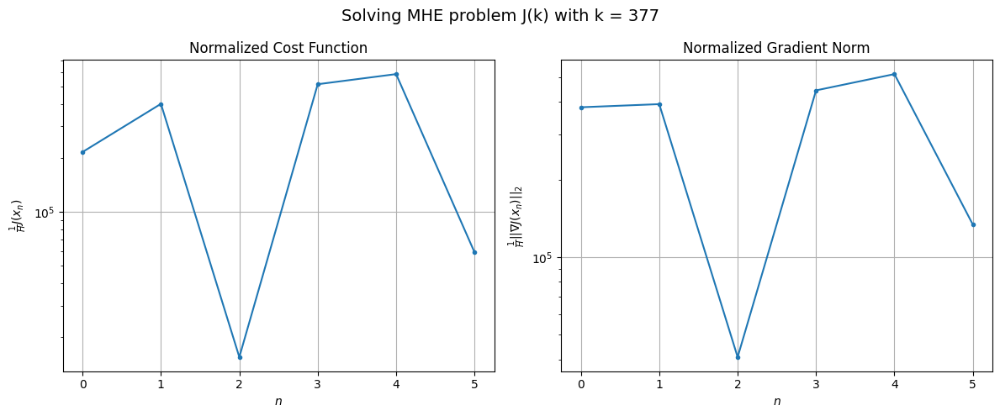

Windows:  96%|█████████▌| 369/386 [20:47<00:51,  3.02s/it]

[Gauss-Newton] Before applying the algorithm
Cost function: 479111.50791473256
Gradient norm: 1143795.6674979709
Global estimation error: 2998.3376676114212
Initial conditions estimation errors: 0.27372133188666226 m, 1164.651804020419 m, 1689.5440607953353 m, 2186.091855137956 m
Position estimation errors: 1.8279201028480654 m, 2409.6862856545986 m, 3536.779770851827 m, 4628.057906332766 m



/home/jgaspar/SpaceSim-Toolkit/test/new_newton_based_algorithms/gauss_newton.py:181: LinAlgWarning: Ill-conditioned matrix (rcond=7.4711e-17): result may not be accurate.
  delta_x = solve(HJ_x, -DJ_x)


[Gauss-Newton] Iteration 1
Cost function: 3703189.8674464114 (672.93%)
Gradient norm: 4088717.9530195245 (257.47%)
Global estimation error: 10012.814376321003 (233.95%)
Initial conditions estimation errors: 0.8921292330611662 m, 3915.814862414419 m, 5837.521422180659 m, 7130.647475412457 m
Position estimation errors: 1.0169289232745569 m, 4687.730351905128 m, 7112.354981402482 m, 8377.056468097726 m

[Gauss-Newton] Iteration 2
Cost function: 11926.299919420295 (-99.68%)
Gradient norm: 269667.0227111429 (-93.40%)
Global estimation error: 8587.633070384061 (-14.23%)
Initial conditions estimation errors: 0.8921292598130967 m, 3364.6473204965505 m, 5022.262215991603 m, 6099.461643620291 m
Position estimation errors: 1.0169289084602402 m, 4019.3797736344122 m, 6111.717545363745 m, 7172.1546495605535 m

[Gauss-Newton] Iteration 3
Cost function: 217.98647745402607 (-98.17%)
Gradient norm: 11850.345793892284 (-95.61%)
Global estimation error: 8329.048337204273 (-3.01%)
Initial conditions estim

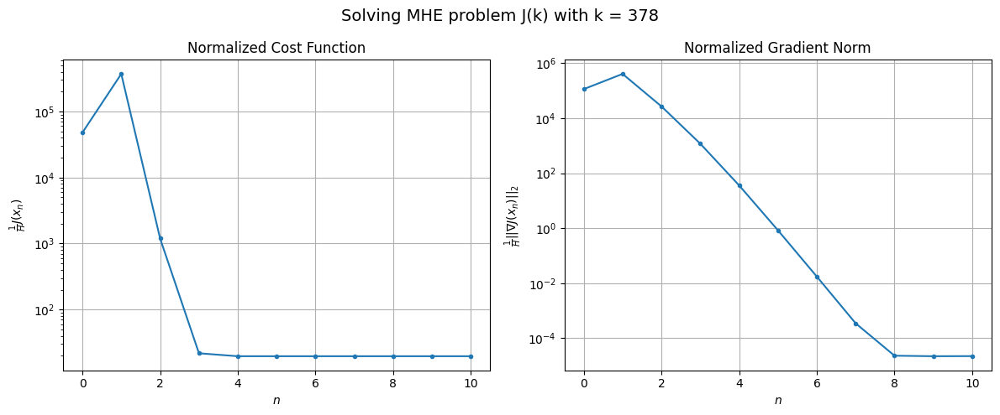

Windows:  96%|█████████▌| 370/386 [20:50<00:50,  3.17s/it]

[Gauss-Newton] Before applying the algorithm
Cost function: 395.8963921910737
Gradient norm: 125762.38984923811
Global estimation error: 8602.449505063632
Initial conditions estimation errors: 0.3679115527111744 m, 3371.419770887069 m, 5043.706273749713 m, 6098.90685335051 m
Position estimation errors: 2.089587023112425 m, 3835.4285798980945 m, 5844.768626228217 m, 6830.521648036883 m

[Gauss-Newton] Iteration 1
Cost function: 15036.393678535549 (3698.06%)
Gradient norm: 295655.3479742153 (135.09%)
Global estimation error: 7091.309948206837 (-17.57%)
Initial conditions estimation errors: 1.0557189922525092 m, 2763.6669414811868 m, 4191.519935762941 m, 5007.989787237279 m
Position estimation errors: 1.145324278297114 m, 3201.7712175742786 m, 4821.543656653778 m, 5647.83728987058 m

[Gauss-Newton] Iteration 2
Cost function: 246.92098141813148 (-98.36%)
Gradient norm: 2898.099683918883 (-99.02%)
Global estimation error: 7227.013533626923 (1.91%)
Initial conditions estimation errors: 1.055

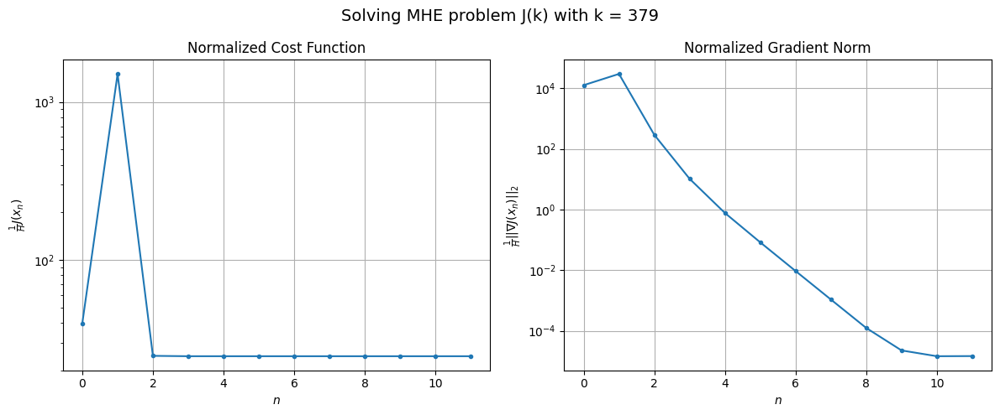

Windows:  96%|█████████▌| 371/386 [20:54<00:50,  3.34s/it]

[Gauss-Newton] Before applying the algorithm
Cost function: 481.6125176893309
Gradient norm: 133787.22975633698
Global estimation error: 7457.434810647571
Initial conditions estimation errors: 0.44069333607296596 m, 2914.6771676953367 m, 4421.571145590947 m, 5250.493632573349 m
Position estimation errors: 2.397681088428613 m, 3235.2846367156126 m, 4874.861437832027 m, 5696.253023120283 m

[Gauss-Newton] Iteration 1
Cost function: 1025974.2550387341 (212928.98%)
Gradient norm: 2559891.8059859225 (1813.41%)
Global estimation error: 3485.3985315252917 (-53.26%)
Initial conditions estimation errors: 1.1331065888147795 m, 1347.6350795457672 m, 2011.9927401893608 m, 2506.7441833942007 m
Position estimation errors: 1.4114212901447425 m, 1209.376764712838 m, 1814.1060399612827 m, 2081.0290595703646 m



/home/jgaspar/SpaceSim-Toolkit/test/new_newton_based_algorithms/gauss_newton.py:181: LinAlgWarning: Ill-conditioned matrix (rcond=2.5345e-17): result may not be accurate.
  delta_x = solve(HJ_x, -DJ_x)


[Gauss-Newton] Iteration 2
Cost function: 21595135.879497908 (2004.84%)
Gradient norm: 10952959.386034107 (327.87%)
Global estimation error: 6351.492839141565 (82.23%)
Initial conditions estimation errors: 1.1331065537799272 m, 2521.5009667194713 m, 3861.341684840716 m, 4367.324022031892 m
Position estimation errors: 1.4114213320209095 m, 2846.086701135329 m, 4407.19506129305 m, 4862.613391787437 m

[Gauss-Newton] Iteration 3
Cost function: 15442.536509472078 (-99.93%)
Gradient norm: 327376.76831444434 (-97.01%)
Global estimation error: 5090.62618092415 (-19.85%)
Initial conditions estimation errors: 1.1331066051841325 m, 2007.0962106215225 m, 3037.661103409949 m, 3557.8997195309194 m
Position estimation errors: 1.4114212939458328 m, 2010.069201248865 m, 3128.590698283385 m, 3395.392737300081 m

[Gauss-Newton] Iteration 4
Cost function: 351.9298515217274 (-97.72%)
Gradient norm: 15122.931907453856 (-95.38%)
Global estimation error: 5401.243408254004 (6.10%)
Initial conditions estimatio

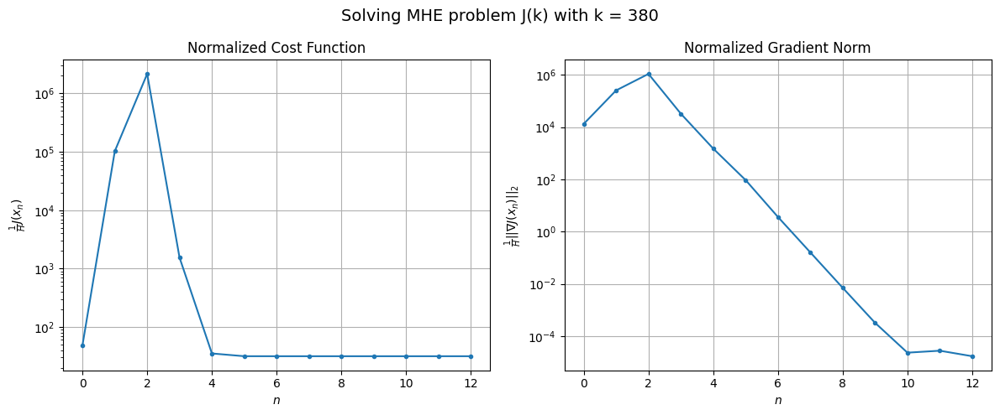

Windows:  96%|█████████▋| 372/386 [20:58<00:50,  3.59s/it]

[Gauss-Newton] Before applying the algorithm
Cost function: 756.1064906485728
Gradient norm: 177407.19048588234
Global estimation error: 5422.233228485172
Initial conditions estimation errors: 0.4125905427939992 m, 2143.1000147879804 m, 3255.7682866947 m, 3769.3110339421087 m
Position estimation errors: 2.8527782398742443 m, 2091.20411378387 m, 3263.947167243816 m, 3517.6291983658875 m

[Gauss-Newton] Iteration 1
Cost function: 634956.7464134723 (83877.16%)
Gradient norm: 1396935.1520935858 (687.42%)
Global estimation error: 10505.03808334113 (93.74%)
Initial conditions estimation errors: 1.289352659974116 m, 4070.700622007375 m, 6030.993277708731 m, 7577.092862635166 m
Position estimation errors: 1.5621222719604466 m, 3283.6329995922715 m, 5015.454642627236 m, 5463.524020214361 m

[Gauss-Newton] Iteration 2
Cost function: 1584.9767815721325 (-99.75%)
Gradient norm: 60503.31745262782 (-95.67%)
Global estimation error: 9461.476460451708 (-9.93%)
Initial conditions estimation errors: 1.2

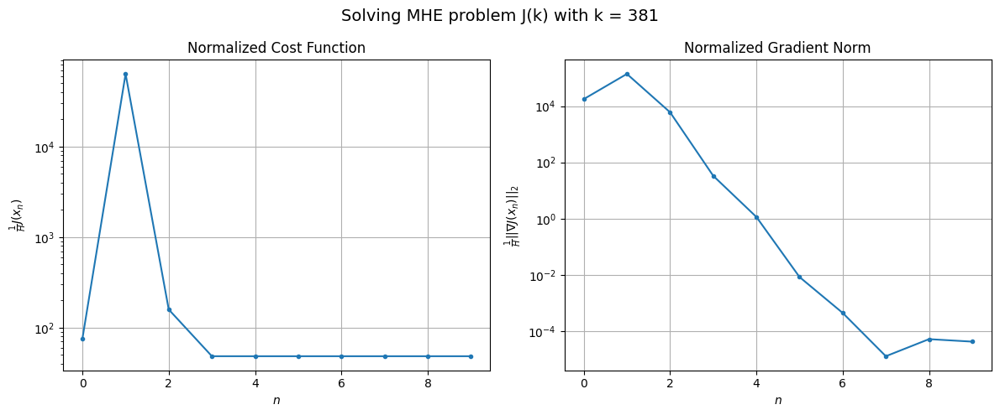

Windows:  97%|█████████▋| 373/386 [21:01<00:44,  3.44s/it]

[Gauss-Newton] Before applying the algorithm
Cost function: 924.9110448208517
Gradient norm: 186153.53377999298
Global estimation error: 9454.746308096353
Initial conditions estimation errors: 0.4572717981403939 m, 3686.9897881684265 m, 5487.746010504745 m, 6758.918046290417 m
Position estimation errors: 3.1752835961263837 m, 2897.652952505928 m, 4467.1585655701765 m, 4741.702199225331 m

[Gauss-Newton] Iteration 1
Cost function: 30048.502219834958 (3148.80%)
Gradient norm: 202590.45872494564 (8.83%)
Global estimation error: 6834.764518140987 (-27.71%)
Initial conditions estimation errors: 1.4408656552886556 m, 2682.0140418002716 m, 4142.222657270044 m, 4728.9315148742035 m
Position estimation errors: 1.808446600473317 m, 2607.2162878748813 m, 3983.6878969087406 m, 4344.088465226239 m

[Gauss-Newton] Iteration 2
Cost function: 984.264889362345 (-96.72%)
Gradient norm: 47173.89417131211 (-76.71%)
Global estimation error: 7427.673927951354 (8.67%)
Initial conditions estimation errors: 1.

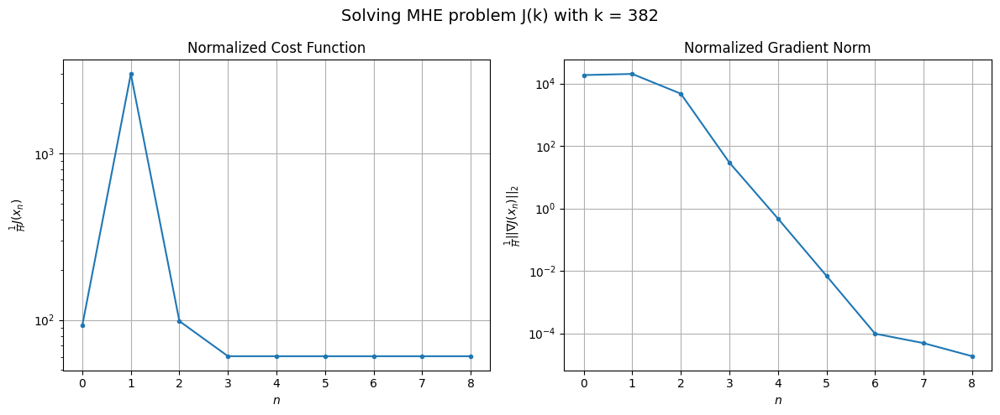

Windows:  97%|█████████▋| 374/386 [21:04<00:39,  3.29s/it]

[Gauss-Newton] Before applying the algorithm
Cost function: 1253.1558834232742
Gradient norm: 227115.02791909716
Global estimation error: 7602.193888723219
Initial conditions estimation errors: 0.514987624770477 m, 3001.970975135153 m, 4631.766359489817 m, 5227.643821901672 m
Position estimation errors: 3.6061210690958636 m, 2828.5022310361005 m, 4314.383752962364 m, 4688.167658488021 m



/home/jgaspar/SpaceSim-Toolkit/test/new_newton_based_algorithms/gauss_newton.py:181: LinAlgWarning: Ill-conditioned matrix (rcond=8.3827e-17): result may not be accurate.
  delta_x = solve(HJ_x, -DJ_x)


[Gauss-Newton] Iteration 1
Cost function: 6709784.517032741 (535330.96%)
Gradient norm: 4924641.636393858 (2068.35%)
Global estimation error: 1381.3408499563839 (-81.83%)
Initial conditions estimation errors: 1.6719854230906819 m, 504.4490126528363 m, 691.6601816177039 m, 1084.0747263249903 m
Position estimation errors: 1.9622317958399564 m, 468.833789159032 m, 787.2312396287863 m, 945.8118115906827 m



/home/jgaspar/SpaceSim-Toolkit/test/new_newton_based_algorithms/gauss_newton.py:181: LinAlgWarning: Ill-conditioned matrix (rcond=2.47552e-18): result may not be accurate.
  delta_x = solve(HJ_x, -DJ_x)


[Gauss-Newton] Iteration 2
Cost function: 9495107204.864365 (141411.36%)
Gradient norm: 218551769.5729516 (4337.92%)
Global estimation error: 54232.40021178255 (3826.07%)
Initial conditions estimation errors: 1.6719854465663735 m, 21433.882683709155 m, 32840.300385287635 m, 37460.06618357624 m
Position estimation errors: 1.9622317705424757 m, 18536.646150678094 m, 28773.875561005923 m, 30878.519590824762 m

[Gauss-Newton] Iteration 3
Cost function: 3369767860.566162 (-64.51%)
Gradient norm: 138527014.29849756 (-36.62%)
Global estimation error: 16665.45300691514 (-69.27%)
Initial conditions estimation errors: 1.6719850943811163 m, 6570.047725638445 m, 10010.035950629155 m, 11591.839608332812 m
Position estimation errors: 1.9622320757813672 m, 6001.967359560965 m, 9270.555704616516 m, 10212.415466256514 m



/home/jgaspar/SpaceSim-Toolkit/test/new_newton_based_algorithms/gauss_newton.py:181: LinAlgWarning: Ill-conditioned matrix (rcond=5.3245e-17): result may not be accurate.
  delta_x = solve(HJ_x, -DJ_x)


[Gauss-Newton] Iteration 4
Cost function: 261427968.86835024 (-92.24%)
Gradient norm: 36010261.473844826 (-74.00%)
Global estimation error: 30297.72934065996 (81.80%)
Initial conditions estimation errors: 1.6719852185464104 m, 11888.919085706311 m, 18009.94038012108 m, 21266.122363089755 m
Position estimation errors: 1.9622320057771605 m, 8411.40948185204 m, 13053.038618582967 m, 13541.564212550698 m

[Gauss-Newton] Iteration 5
Cost function: 54944588.78383315 (-78.98%)
Gradient norm: 15827799.980679959 (-56.05%)
Global estimation error: 16190.908252371439 (-46.56%)
Initial conditions estimation errors: 1.6719854336616233 m, 6310.323120247682 m, 9485.747273795148 m, 11504.166630911064 m
Position estimation errors: 1.96223178339624 m, 3764.1209189449514 m, 5797.353089161274 m, 5862.7253679835885 m

[Gauss-Newton] Iteration 6
Cost function: 3725572.441859191 (-93.22%)
Gradient norm: 4170783.021411985 (-73.65%)
Global estimation error: 8989.250619460783 (-44.48%)
Initial conditions estima

/home/jgaspar/SpaceSim-Toolkit/test/new_newton_based_algorithms/gauss_newton.py:181: LinAlgWarning: Ill-conditioned matrix (rcond=6.93519e-17): result may not be accurate.
  delta_x = solve(HJ_x, -DJ_x)


[Gauss-Newton] Iteration 7
Cost function: 312811.1009590409 (-91.60%)
Gradient norm: 1201442.910624788 (-71.19%)
Global estimation error: 5225.221467733669 (-41.87%)
Initial conditions estimation errors: 1.6719854789416482 m, 1970.9355175725202 m, 2859.8869143356196 m, 3903.75748110418 m
Position estimation errors: 1.9622317411857644 m, 140.0251081654532 m, 91.67135537495794 m, 186.76257689049044 m



/home/jgaspar/SpaceSim-Toolkit/test/new_newton_based_algorithms/gauss_newton.py:181: LinAlgWarning: Ill-conditioned matrix (rcond=1.06782e-17): result may not be accurate.
  delta_x = solve(HJ_x, -DJ_x)


[Gauss-Newton] STOP on Iteration 8 (gradient norm stagnated)
Cost function = 585351.7755124628 (87.13%)
Gradient norm = 1724162.1474453292 (43.51%)
Global estimation error = 9375.052635287573 (79.42%)
Final initial conditions estimation errors: 1.6719855032816167 m, 3619.3561538310446 m, 5403.546267908713 m, 6752.29564750733 m
Final position estimation errors: 1.9622317152389264 m, 1673.6921910895207 m, 2467.866516344102 m, 2425.0160481245275 m



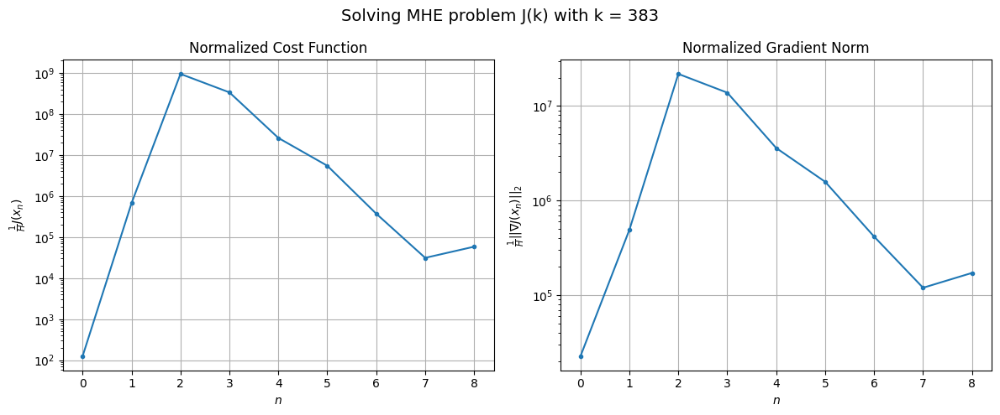

Windows:  97%|█████████▋| 375/386 [21:07<00:36,  3.33s/it]

[Gauss-Newton] Before applying the algorithm
Cost function: 565746.3988379571
Gradient norm: 1670153.13175019
Global estimation error: 8888.864790288388
Initial conditions estimation errors: 0.6148963361534597 m, 3453.972898472341 m, 5156.088668476932 m, 6363.699050843706 m
Position estimation errors: 3.9121478868913844 m, 1409.6252900778886 m, 2065.3615241102025 m, 1861.8299151531032 m



/home/jgaspar/SpaceSim-Toolkit/test/new_newton_based_algorithms/gauss_newton.py:181: LinAlgWarning: Ill-conditioned matrix (rcond=5.72423e-17): result may not be accurate.
  delta_x = solve(HJ_x, -DJ_x)


[Gauss-Newton] Iteration 1
Cost function: 11890305.362142468 (2001.70%)
Gradient norm: 7977585.038851944 (377.66%)
Global estimation error: 1018.1971943197602 (-88.55%)
Initial conditions estimation errors: 1.8965131466123413 m, 390.25567818234873 m, 502.44479896390965 m, 794.8866744208021 m
Position estimation errors: 2.236002483217576 m, 2056.183941959939 m, 3124.4705333793545 m, 3955.7455027902083 m



/home/jgaspar/SpaceSim-Toolkit/test/new_newton_based_algorithms/gauss_newton.py:181: LinAlgWarning: Ill-conditioned matrix (rcond=2.4386e-17): result may not be accurate.
  delta_x = solve(HJ_x, -DJ_x)


[Gauss-Newton] Iteration 2
Cost function: 47736455.57989303 (301.47%)
Gradient norm: 15889242.503344288 (99.17%)
Global estimation error: 12705.710699572444 (1147.86%)
Initial conditions estimation errors: 1.8965131661751644 m, 4968.430534820229 m, 7506.716194812342 m, 8966.544838840873 m
Position estimation errors: 2.236002460419498 m, 2758.5205500585193 m, 4388.296530487331 m, 4200.343230952763 m



/home/jgaspar/SpaceSim-Toolkit/test/new_newton_based_algorithms/gauss_newton.py:181: LinAlgWarning: Ill-conditioned matrix (rcond=1.09735e-16): result may not be accurate.
  delta_x = solve(HJ_x, -DJ_x)


[Gauss-Newton] Iteration 3
Cost function: 12811291.219224196 (-73.16%)
Gradient norm: 8229259.181841857 (-48.21%)
Global estimation error: 3829.600582094777 (-69.86%)
Initial conditions estimation errors: 1.8965131504301949 m, 1436.0313512149992 m, 2023.2924653485295 m, 2917.161518023622 m
Position estimation errors: 2.2360024758074335 m, 818.0887019251489 m, 1161.9192278266974 m, 1819.501089541934 m



/home/jgaspar/SpaceSim-Toolkit/test/new_newton_based_algorithms/gauss_newton.py:181: LinAlgWarning: Ill-conditioned matrix (rcond=1.67196e-18): result may not be accurate.
  delta_x = solve(HJ_x, -DJ_x)


[Gauss-Newton] Iteration 4
Cost function: 11831290.659458779 (-7.65%)
Gradient norm: 8536343.212951297 (3.73%)
Global estimation error: 4065.6529066964267 (6.16%)
Initial conditions estimation errors: 1.896513186617694 m, 1735.451274273292 m, 2895.925114223667 m, 2265.1919855822034 m
Position estimation errors: 2.2360024353419026 m, 4410.754282011847 m, 6768.617108854451 m, 8108.2651832168285 m



/home/jgaspar/SpaceSim-Toolkit/test/new_newton_based_algorithms/gauss_newton.py:181: LinAlgWarning: Ill-conditioned matrix (rcond=9.10748e-17): result may not be accurate.
  delta_x = solve(HJ_x, -DJ_x)


[Gauss-Newton] Iteration 5
Cost function: 34431323.413053215 (191.02%)
Gradient norm: 14869220.788514743 (74.19%)
Global estimation error: 5639.250179524163 (38.70%)
Initial conditions estimation errors: 1.8965131654698613 m, 2182.005852883059 m, 3236.4013497334213 m, 4070.0911455736823 m
Position estimation errors: 2.2360024607314215 m, 812.3945936347006 m, 1313.1574864009438 m, 1234.3930612938327 m



/home/jgaspar/SpaceSim-Toolkit/test/new_newton_based_algorithms/gauss_newton.py:181: LinAlgWarning: Ill-conditioned matrix (rcond=2.21919e-17): result may not be accurate.
  delta_x = solve(HJ_x, -DJ_x)


[Gauss-Newton] Iteration 6
Cost function: 82905685.79529902 (140.79%)
Gradient norm: 21656716.1997997 (45.65%)
Global estimation error: 8115.2552273661995 (43.91%)
Initial conditions estimation errors: 1.8965131560398591 m, 3323.5675128064663 m, 5305.527875477881 m, 5163.570262741396 m
Position estimation errors: 2.236002469482127 m, 5235.957968077629 m, 8064.770250829627 m, 9345.64322042291 m

[Gauss-Newton] STOP on Iteration 7 (gradient norm stagnated)
Cost function = 20143832.693062376 (-75.70%)
Gradient norm = 10505260.750666246 (-51.49%)
Global estimation error = 2172.7284160993613 (-73.23%)
Final initial conditions estimation errors: 1.8965131487582938 m, 800.2953897011191 m, 1061.7497551207075 m, 1718.3906034779266 m
Final position estimation errors: 2.2360024754067367 m, 1297.7011890980662 m, 1916.183788214041 m, 2606.3310774009597 m



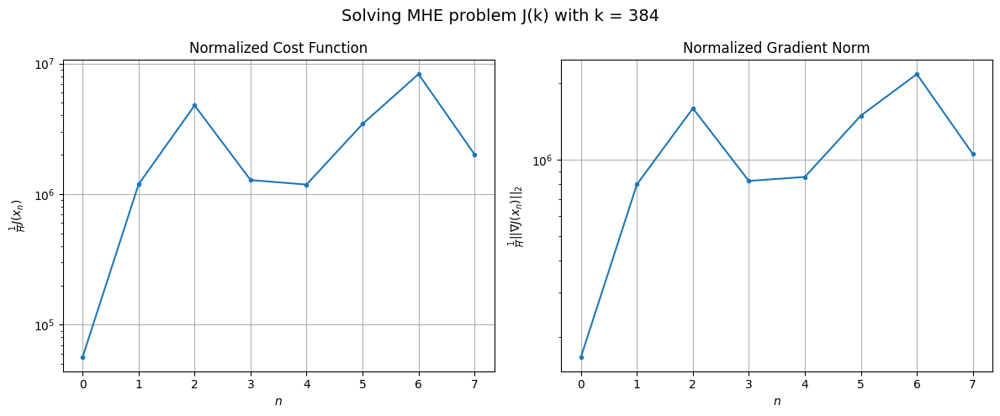

Windows:  97%|█████████▋| 376/386 [21:10<00:31,  3.18s/it]

[Gauss-Newton] Before applying the algorithm
Cost function: 20121957.55569522
Gradient norm: 10334561.255071444
Global estimation error: 1691.8852520958633
Initial conditions estimation errors: 0.6888077006549024 m, 630.6609099972889 m, 848.560436281091 m, 1320.8298111026386 m
Position estimation errors: 4.323825980201601 m, 1483.055813131007 m, 2173.8376703088334 m, 3014.333083312541 m



/home/jgaspar/SpaceSim-Toolkit/test/new_newton_based_algorithms/gauss_newton.py:181: LinAlgWarning: Ill-conditioned matrix (rcond=5.64242e-18): result may not be accurate.
  delta_x = solve(HJ_x, -DJ_x)


[Gauss-Newton] Iteration 1
Cost function: 66110000.06287702 (228.55%)
Gradient norm: 19172057.85860872 (85.51%)
Global estimation error: 11703.380618037198 (591.74%)
Initial conditions estimation errors: 2.1511951186075544 m, 4741.47355187336 m, 7502.2842610807475 m, 7629.092182934115 m
Position estimation errors: 2.4387278432641994 m, 6687.752657001081 m, 10388.966677352266 m, 12013.736740660539 m

[Gauss-Newton] Iteration 2
Cost function: 1145245.3264551826 (-98.27%)
Gradient norm: 1591266.252559032 (-91.70%)
Global estimation error: 5314.686544877446 (-54.59%)
Initial conditions estimation errors: 2.15119515941565 m, 2232.7638153750445 m, 3683.498423565176 m, 3113.214022631776 m
Position estimation errors: 2.438727811553218 m, 5435.9679882276805 m, 8410.358971440153 m, 10198.547348266788 m



/home/jgaspar/SpaceSim-Toolkit/test/new_newton_based_algorithms/gauss_newton.py:181: LinAlgWarning: Ill-conditioned matrix (rcond=6.93314e-17): result may not be accurate.
  delta_x = solve(HJ_x, -DJ_x)


[Gauss-Newton] Iteration 3
Cost function: 60495.58079207202 (-94.72%)
Gradient norm: 573182.2382264452 (-63.98%)
Global estimation error: 7491.607607455346 (40.96%)
Initial conditions estimation errors: 2.1511951747510234 m, 3105.3706299547794 m, 5048.481096468067 m, 4581.840927180058 m
Position estimation errors: 2.4387277978148463 m, 6330.130841056879 m, 9817.307537457998 m, 11722.167567604605 m



/home/jgaspar/SpaceSim-Toolkit/test/new_newton_based_algorithms/gauss_newton.py:181: LinAlgWarning: Ill-conditioned matrix (rcond=1.02016e-16): result may not be accurate.
  delta_x = solve(HJ_x, -DJ_x)


[Gauss-Newton] Iteration 4
Cost function: 1250.148854106298 (-97.93%)
Gradient norm: 46188.86209858972 (-91.94%)
Global estimation error: 7748.396361855164 (3.43%)
Initial conditions estimation errors: 2.1511951794265123 m, 3215.5347033303724 m, 5231.169979154142 m, 4725.713110181552 m
Position estimation errors: 2.438727791360789 m, 6626.865071565717 m, 10277.81614655257 m, 12279.505759942003 m



/home/jgaspar/SpaceSim-Toolkit/test/new_newton_based_algorithms/gauss_newton.py:181: LinAlgWarning: Ill-conditioned matrix (rcond=9.99442e-17): result may not be accurate.
  delta_x = solve(HJ_x, -DJ_x)


[Gauss-Newton] Iteration 5
Cost function: 1200.0112612317057 (-4.01%)
Gradient norm: 40713.38382091725 (-11.85%)
Global estimation error: 8142.966884593957 (5.09%)
Initial conditions estimation errors: 2.1511951828514055 m, 3377.875048086445 m, 5489.463830324719 m, 4976.258167533962 m
Position estimation errors: 2.4387277906423983 m, 6892.210138899121 m, 10689.980782952012 m, 12758.71332535717 m



/home/jgaspar/SpaceSim-Toolkit/test/new_newton_based_algorithms/gauss_newton.py:181: LinAlgWarning: Ill-conditioned matrix (rcond=1.02799e-16): result may not be accurate.
  delta_x = solve(HJ_x, -DJ_x)


[Gauss-Newton] STOP on Iteration 6 (gradient norm stagnated)
Cost function = 1022.2952156166948 (-14.81%)
Gradient norm = 19929.160494213764 (-51.05%)
Global estimation error = 8409.341441762017 (3.27%)
Final initial conditions estimation errors: 2.1511951849063413 m, 3487.8150041923013 m, 5664.552064509535 m, 5144.36431252942 m
Final position estimation errors: 2.4387277884412475 m, 7078.646794079551 m, 10979.4979434355 m, 13096.89764521164 m



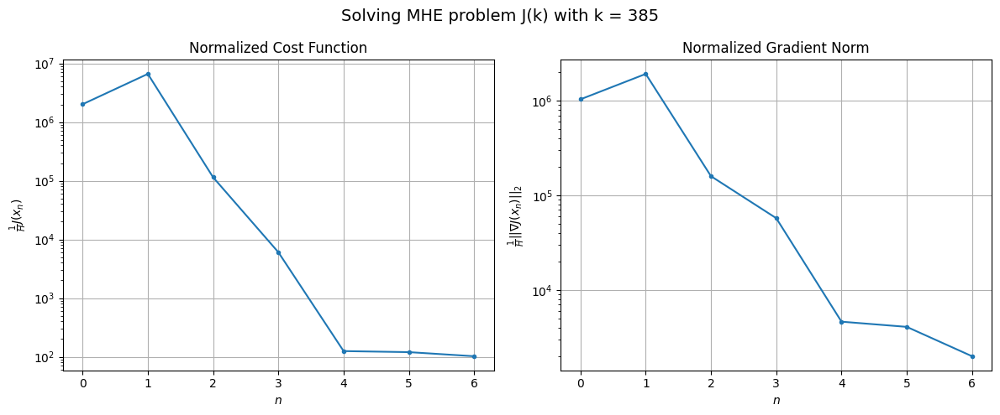

Windows:  98%|█████████▊| 377/386 [21:13<00:27,  3.01s/it]

[Gauss-Newton] Before applying the algorithm
Cost function: 1859.7194633604317
Gradient norm: 278044.5025350022
Global estimation error: 9724.794550557406
Initial conditions estimation errors: 0.7921015965797172 m, 3962.751685510243 m, 6389.670364553752 m, 6167.6444859843305 m
Position estimation errors: 4.605402806175918 m, 7349.206725938746 m, 11362.62641947741 m, 13743.095454203642 m

[Gauss-Newton] Iteration 1
Cost function: 477650.55342654657 (25584.01%)
Gradient norm: 1590992.4922263294 (472.21%)
Global estimation error: 5918.214514762245 (-39.14%)
Initial conditions estimation errors: 2.3360936830346968 m, 2429.4210333500587 m, 4059.7752934135574 m, 3555.4092764314705 m
Position estimation errors: 2.5648212742613485 m, 5904.9719291926685 m, 9095.320474807424 m, 11253.584078342681 m



/home/jgaspar/SpaceSim-Toolkit/test/new_newton_based_algorithms/gauss_newton.py:181: LinAlgWarning: Ill-conditioned matrix (rcond=7.88959e-17): result may not be accurate.
  delta_x = solve(HJ_x, -DJ_x)


[Gauss-Newton] Iteration 2
Cost function: 14985.254151080811 (-96.86%)
Gradient norm: 298981.37610241346 (-81.21%)
Global estimation error: 4568.166132867024 (-22.81%)
Initial conditions estimation errors: 2.3360936738110096 m, 1882.4584389208808 m, 3206.7756582529046 m, 2653.426387948938 m
Position estimation errors: 2.564821293685781 m, 5213.250519800166 m, 8022.7462620941005 m, 10014.413682790548 m



/home/jgaspar/SpaceSim-Toolkit/test/new_newton_based_algorithms/gauss_newton.py:181: LinAlgWarning: Ill-conditioned matrix (rcond=5.62242e-17): result may not be accurate.
  delta_x = solve(HJ_x, -DJ_x)


[Gauss-Newton] Iteration 3
Cost function: 1405.4628733291029 (-90.62%)
Gradient norm: 47127.26822118037 (-84.24%)
Global estimation error: 5016.1170179310875 (9.81%)
Initial conditions estimation errors: 2.3360936811244786 m, 2064.035958347434 m, 3497.9245609031886 m, 2943.682969682147 m
Position estimation errors: 2.564821285571903 m, 5493.5638264541885 m, 8457.73707133912 m, 10527.030469344643 m



/home/jgaspar/SpaceSim-Toolkit/test/new_newton_based_algorithms/gauss_newton.py:181: LinAlgWarning: Ill-conditioned matrix (rcond=6.31955e-17): result may not be accurate.
  delta_x = solve(HJ_x, -DJ_x)


[Gauss-Newton] Iteration 4
Cost function: 1148.972194483622 (-18.25%)
Gradient norm: 20568.32310543203 (-56.36%)
Global estimation error: 4707.976624052299 (-6.14%)
Initial conditions estimation errors: 2.336093676012911 m, 1939.0817043778065 m, 3299.1252346850274 m, 2742.327021835735 m
Position estimation errors: 2.5648212892846307 m, 5308.674191964131 m, 8171.146213260497 m, 10189.977812829378 m



/home/jgaspar/SpaceSim-Toolkit/test/new_newton_based_algorithms/gauss_newton.py:181: LinAlgWarning: Ill-conditioned matrix (rcond=5.82601e-17): result may not be accurate.
  delta_x = solve(HJ_x, -DJ_x)


[Gauss-Newton] Iteration 5
Cost function: 1095.3816060002086 (-4.66%)
Gradient norm: 7372.266204207835 (-64.16%)
Global estimation error: 4892.268821454695 (3.91%)
Initial conditions estimation errors: 2.336093679709152 m, 2013.7930023133993 m, 3418.128700207083 m, 2862.672850000138 m
Position estimation errors: 2.564821287038953 m, 5419.207784769205 m, 8342.570685519515 m, 10391.407553591584 m



/home/jgaspar/SpaceSim-Toolkit/test/new_newton_based_algorithms/gauss_newton.py:181: LinAlgWarning: Ill-conditioned matrix (rcond=6.11634e-17): result may not be accurate.
  delta_x = solve(HJ_x, -DJ_x)


[Gauss-Newton] Iteration 6
Cost function: 1088.6732259040978 (-0.61%)
Gradient norm: 2857.9279936371163 (-61.23%)
Global estimation error: 4777.101296487266 (-2.35%)
Initial conditions estimation errors: 2.3360936774914074 m, 1967.1125763229097 m, 3343.8025580929575 m, 2787.422454579923 m
Position estimation errors: 2.5648212916194426 m, 5350.361884576334 m, 8235.815927809579 m, 10265.981187057634 m



/home/jgaspar/SpaceSim-Toolkit/test/new_newton_based_algorithms/gauss_newton.py:181: LinAlgWarning: Ill-conditioned matrix (rcond=5.93377e-17): result may not be accurate.
  delta_x = solve(HJ_x, -DJ_x)


[Gauss-Newton] STOP on Iteration 7 (gradient norm stagnated)
Cost function = 1087.643034591725 (-0.09%)
Gradient norm = 1043.4499819891994 (-63.49%)
Global estimation error = 4846.562941143453 (1.45%)
Final initial conditions estimation errors: 2.336093678969904 m, 1995.2711607567362 m, 3388.6410669910533 m, 2832.798523193437 m
Final position estimation errors: 2.5648212862606825 m, 5391.949685101939 m, 8300.307641994741 m, 10341.75777847143 m



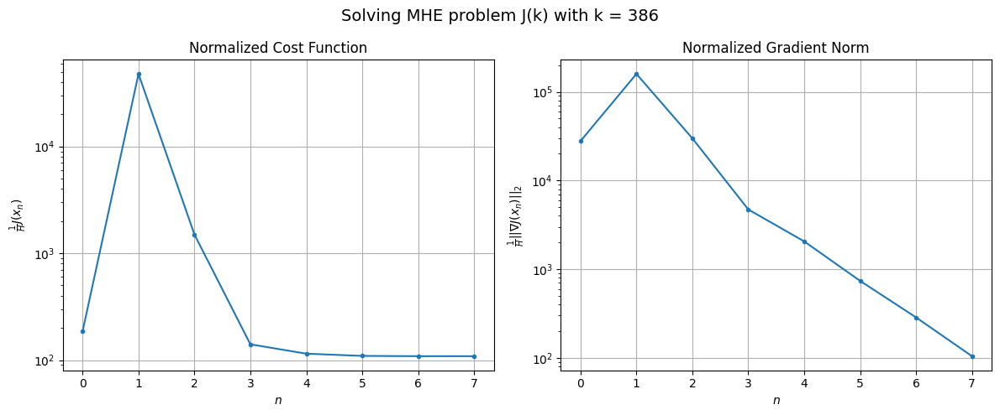

Windows:  98%|█████████▊| 378/386 [21:16<00:23,  2.96s/it]

[Gauss-Newton] Before applying the algorithm
Cost function: 2069.120589188431
Gradient norm: 298080.22039289435
Global estimation error: 6015.76899124242
Initial conditions estimation errors: 0.8437773352534541 m, 2418.36920219098 m, 4024.7532232014287 m, 3760.5743617817516 m
Position estimation errors: 4.768977184177364 m, 5676.943245323144 m, 8695.790067022821 m, 10996.98652178213 m

[Gauss-Newton] Iteration 1
Cost function: 951659.2907360338 (45893.42%)
Gradient norm: 2584050.146515023 (766.90%)
Global estimation error: 2747.046407751867 (-54.34%)
Initial conditions estimation errors: 2.450762868786097 m, 1115.088613722615 m, 1886.2903706677134 m, 1656.661098376008 m
Position estimation errors: 2.5977157903290324 m, 3609.309852761373 m, 5499.325596596582 m, 7157.7354313007645 m



/home/jgaspar/SpaceSim-Toolkit/test/new_newton_based_algorithms/gauss_newton.py:181: LinAlgWarning: Ill-conditioned matrix (rcond=4.19976e-17): result may not be accurate.
  delta_x = solve(HJ_x, -DJ_x)


[Gauss-Newton] Iteration 2
Cost function: 19335153.55286356 (1931.73%)
Gradient norm: 11526120.611494657 (346.05%)
Global estimation error: 4642.478538871641 (69.00%)
Initial conditions estimation errors: 2.450762793609356 m, 1831.2251826826844 m, 2852.388140161931 m, 3172.2350630963956 m
Position estimation errors: 2.5977158707881305 m, 913.7984183961836 m, 1438.8369864651127 m, 1348.5431778701231 m



/home/jgaspar/SpaceSim-Toolkit/test/new_newton_based_algorithms/gauss_newton.py:181: LinAlgWarning: Ill-conditioned matrix (rcond=8.8765e-17): result may not be accurate.
  delta_x = solve(HJ_x, -DJ_x)


[Gauss-Newton] Iteration 3
Cost function: 19506.229100164863 (-99.90%)
Gradient norm: 121634.99154491397 (-98.94%)
Global estimation error: 1963.2672780732037 (-57.71%)
Initial conditions estimation errors: 2.450762924314285 m, 760.60587792326 m, 1305.4186092235993 m, 1253.7005497807995 m
Position estimation errors: 2.597715734555039 m, 1171.9914233327322 m, 1765.697132166569 m, 2187.238392097161 m



/home/jgaspar/SpaceSim-Toolkit/test/new_newton_based_algorithms/gauss_newton.py:181: LinAlgWarning: Ill-conditioned matrix (rcond=2.40961e-17): result may not be accurate.
  delta_x = solve(HJ_x, -DJ_x)


[Gauss-Newton] Iteration 4
Cost function: 1148636.0063297942 (5788.56%)
Gradient norm: 2799290.412508074 (2201.39%)
Global estimation error: 1725.2098618579234 (-12.13%)
Initial conditions estimation errors: 2.4507629586122435 m, 715.2441436062463 m, 1039.1208805024282 m, 1176.8564843538422 m
Position estimation errors: 2.597715691105667 m, 988.5055500381102 m, 1559.6981902725415 m, 1816.4156612912739 m



/home/jgaspar/SpaceSim-Toolkit/test/new_newton_based_algorithms/gauss_newton.py:181: LinAlgWarning: Ill-conditioned matrix (rcond=1.43222e-17): result may not be accurate.
  delta_x = solve(HJ_x, -DJ_x)


[Gauss-Newton] Iteration 5
Cost function: 372814720.6078411 (32357.17%)
Gradient norm: 45248419.27427493 (1516.42%)
Global estimation error: 22127.92188743869 (1182.62%)
Initial conditions estimation errors: 2.4507629660102377 m, 8842.286246198073 m, 13746.032580462104 m, 14916.614284865564 m
Position estimation errors: 2.5977156882346324 m, 9158.240871313756 m, 14289.928269754351 m, 16045.179135780922 m

[Gauss-Newton] Iteration 6
Cost function: 36017734.8542839 (-90.34%)
Gradient norm: 14508109.33243042 (-67.94%)
Global estimation error: 10656.997460715193 (-51.84%)
Initial conditions estimation errors: 2.4507629997770053 m, 4270.013054492521 m, 6570.038754995271 m, 7223.098495757556 m
Position estimation errors: 2.597715652439783 m, 4203.22632362894 m, 6592.882846957106 m, 7325.221580242023 m

[Gauss-Newton] Iteration 7
Cost function: 88504.53825261602 (-99.75%)
Gradient norm: 650616.7813103434 (-95.52%)
Global estimation error: 7830.590243276734 (-26.52%)
Initial conditions estimat

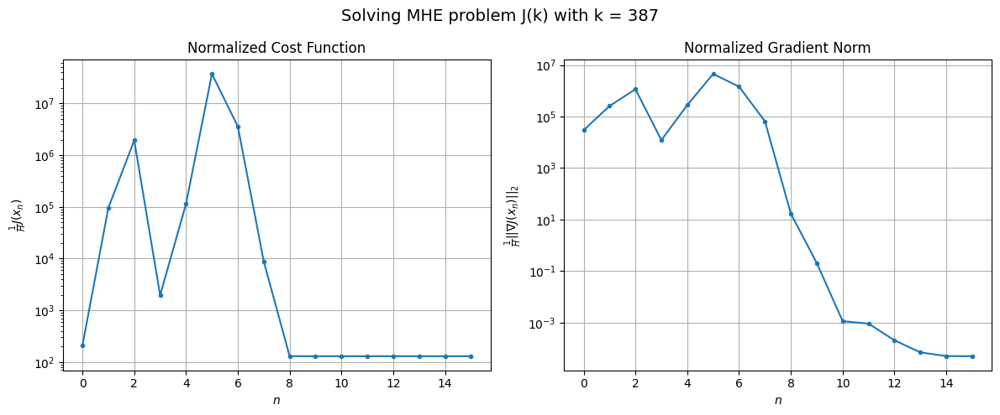

Windows:  98%|█████████▊| 379/386 [21:20<00:24,  3.51s/it]

[Gauss-Newton] Before applying the algorithm
Cost function: 2243.6864322382125
Gradient norm: 298248.43208096124
Global estimation error: 7965.533746054878
Initial conditions estimation errors: 0.8552002700344452 m, 3194.038330369292 m, 4896.797461498479 m, 5410.102866392154 m
Position estimation errors: 4.800463860784095 m, 3108.026057140393 m, 4899.742428600434 m, 5453.934923668737 m

[Gauss-Newton] Iteration 1
Cost function: 17886076.168157265 (797073.61%)
Gradient norm: 9044297.054263713 (2932.47%)
Global estimation error: 2527.3714401714024 (-68.27%)
Initial conditions estimation errors: 2.5483876333824775 m, 1029.0883724000842 m, 1503.6173405590914 m, 1751.4860865744538 m
Position estimation errors: 2.5813511090711976 m, 401.4271015283445 m, 607.6139990003493 m, 512.9977296563005 m



/home/jgaspar/SpaceSim-Toolkit/test/new_newton_based_algorithms/gauss_newton.py:181: LinAlgWarning: Ill-conditioned matrix (rcond=2.28261e-17): result may not be accurate.
  delta_x = solve(HJ_x, -DJ_x)


[Gauss-Newton] Iteration 2
Cost function: 913122335.8409448 (5005.21%)
Gradient norm: 72718092.35634838 (704.02%)
Global estimation error: 22561.084357333217 (792.67%)
Initial conditions estimation errors: 2.548387626726305 m, 8954.48330065672 m, 14143.986131795235 m, 15125.049942063359 m
Position estimation errors: 2.581351118916172 m, 10419.688547252585 m, 16150.31788686827 m, 18908.137417425765 m

[Gauss-Newton] Iteration 3
Cost function: 162053683.2335739 (-82.25%)
Gradient norm: 30403111.144808102 (-58.19%)
Global estimation error: 5967.898762329935 (-73.55%)
Initial conditions estimation errors: 2.54838774352547 m, 2358.13404517208 m, 3786.256765959383 m, 3964.7467308513333 m
Position estimation errors: 2.581350991632813 m, 3301.228406125053 m, 5123.906077073858 m, 6169.230945760764 m

[Gauss-Newton] STOP on Iteration 4 (gradient norm stagnated)
Cost function = 43556757.213609636 (-73.12%)
Gradient norm = 15282948.175437111 (-49.73%)
Global estimation error = 6776.513393239473 (1

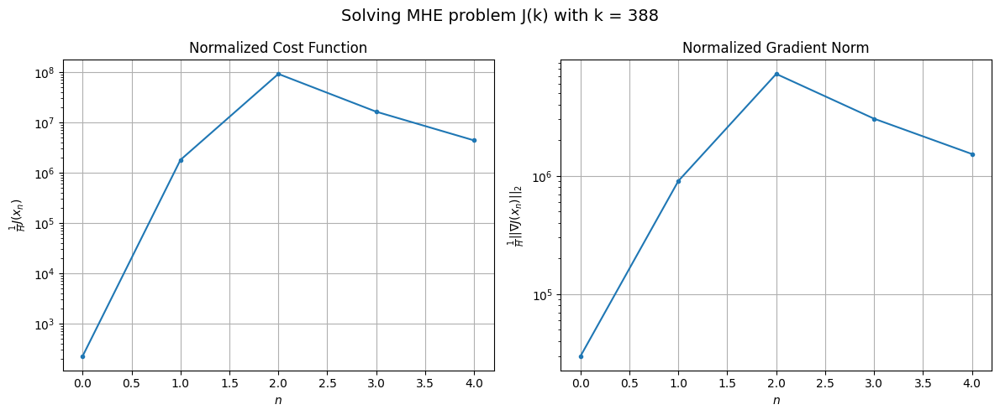

Windows:  98%|█████████▊| 380/386 [21:23<00:18,  3.09s/it]

[Gauss-Newton] Before applying the algorithm
Cost function: 43057952.03210152
Gradient norm: 14949054.409371722
Global estimation error: 6569.650423954602
Initial conditions estimation errors: 0.8654561047969822 m, 2638.7128766805367 m, 4029.0964301868157 m, 4468.094350314382 m
Position estimation errors: 4.77884626605923 m, 1536.5045083718182 m, 2377.8240300239727 m, 2271.124718907935 m

[Gauss-Newton] Iteration 1
Cost function: 5334181.445065787 (-87.61%)
Gradient norm: 4301844.358784616 (-71.22%)
Global estimation error: 2115.9634452605474 (-67.79%)
Initial conditions estimation errors: 2.5894931899610047 m, 813.7925420040339 m, 1297.3030402999982 m, 1460.1508811429603 m
Position estimation errors: 2.64281452946966 m, 726.4654200975261 m, 1233.2979027724164 m, 1274.531244448964 m



/home/jgaspar/SpaceSim-Toolkit/test/new_newton_based_algorithms/gauss_newton.py:181: LinAlgWarning: Ill-conditioned matrix (rcond=1.04069e-17): result may not be accurate.
  delta_x = solve(HJ_x, -DJ_x)


[Gauss-Newton] Iteration 2
Cost function: 98799738.85438448 (1752.20%)
Gradient norm: 22749507.114815198 (428.83%)
Global estimation error: 12954.65691766494 (512.23%)
Initial conditions estimation errors: 2.5894931968872794 m, 5159.565146649158 m, 8053.063274568098 m, 8737.858750604804 m
Position estimation errors: 2.642814537743345 m, 4898.130197412989 m, 7498.529706942579 m, 8612.498360212316 m

[Gauss-Newton] Iteration 3
Cost function: 8929354.928797135 (-90.96%)
Gradient norm: 6900222.500281554 (-69.67%)
Global estimation error: 4611.207334971733 (-64.41%)
Initial conditions estimation errors: 2.589493205791856 m, 1849.341796851943 m, 2878.4069386764368 m, 3091.590825740748 m
Position estimation errors: 2.6428145291650935 m, 1713.1107020574382 m, 2551.8306161382393 m, 2964.9438354645836 m

[Gauss-Newton] Iteration 4
Cost function: 821167.8072033126 (-90.80%)
Gradient norm: 2195192.9438849133 (-68.19%)
Global estimation error: 469.99092164153507 (-89.81%)
Initial conditions estimat

/home/jgaspar/SpaceSim-Toolkit/test/new_newton_based_algorithms/gauss_newton.py:181: LinAlgWarning: Ill-conditioned matrix (rcond=8.51892e-18): result may not be accurate.
  delta_x = solve(HJ_x, -DJ_x)


[Gauss-Newton] Iteration 5
Cost function: 2453.747806700495 (-99.70%)
Gradient norm: 74124.24047581594 (-96.62%)
Global estimation error: 438.6926091026714 (-6.66%)
Initial conditions estimation errors: 2.5894931767507288 m, 154.83356943603172 m, 255.78361563533414 m, 321.00303738907866 m
Position estimation errors: 2.6428145616367202 m, 415.74927083312866 m, 738.4644529520992 m, 869.7183656616295 m



/home/jgaspar/SpaceSim-Toolkit/test/new_newton_based_algorithms/gauss_newton.py:181: LinAlgWarning: Ill-conditioned matrix (rcond=4.14561e-18): result may not be accurate.
  delta_x = solve(HJ_x, -DJ_x)


[Gauss-Newton] Iteration 6
Cost function: 46185096.404193565 (1882126.70%)
Gradient norm: 16094334.03833708 (21612.65%)
Global estimation error: 11316.351758730472 (2479.56%)
Initial conditions estimation errors: 2.589493183598966 m, 4507.089389004799 m, 7051.78851281295 m, 7616.96930083329 m
Position estimation errors: 2.6428145546344886 m, 4388.0161303452305 m, 6688.857999047068 m, 7760.872677809327 m

[Gauss-Newton] Iteration 7
Cost function: 6043613.184586964 (-86.91%)
Gradient norm: 5843039.815408747 (-63.70%)
Global estimation error: 4190.970599442488 (-62.97%)
Initial conditions estimation errors: 2.5894932002327327 m, 1680.560374137309 m, 2620.302288874259 m, 2806.0578226382945 m
Position estimation errors: 2.6428145372830003 m, 1448.2768244174376 m, 2146.475459533951 m, 2457.8313294772315 m

[Gauss-Newton] Iteration 8
Cost function: 732055.3900677436 (-87.89%)
Gradient norm: 2032938.4130462918 (-65.21%)
Global estimation error: 180.9715369175002 (-95.68%)
Initial conditions es

/home/jgaspar/SpaceSim-Toolkit/test/new_newton_based_algorithms/gauss_newton.py:181: LinAlgWarning: Ill-conditioned matrix (rcond=5.26997e-18): result may not be accurate.
  delta_x = solve(HJ_x, -DJ_x)


[Gauss-Newton] STOP on Iteration 9 (gradient norm stagnated)
Cost function = 355963.9710553946 (-51.37%)
Gradient norm = 1435588.5339795107 (-29.38%)
Global estimation error = 3394.3297709481762 (1775.62%)
Final initial conditions estimation errors: 2.589493176715293 m, 1364.4821882031574 m, 2128.471831584279 m, 2264.7878091197435 m
Final position estimation errors: 2.6428145609202267 m, 1165.7400420833637 m, 1703.816231028697 m, 1977.7214293293596 m



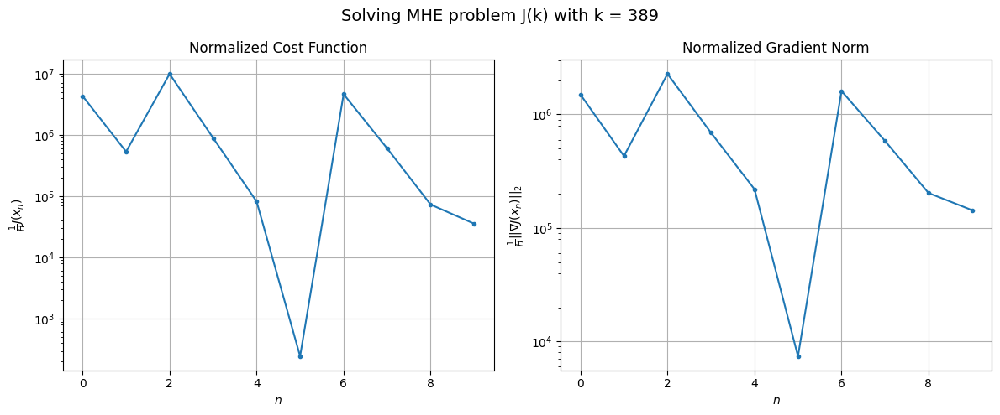

Windows:  99%|█████████▊| 381/386 [21:26<00:15,  3.17s/it]

[Gauss-Newton] Before applying the algorithm
Cost function: 367494.3112808503
Gradient norm: 1448580.8017557163
Global estimation error: 3391.795285166819
Initial conditions estimation errors: 0.8405196231249866 m, 1364.7376871470758 m, 2117.85903280181 m, 2270.7792941850657 m
Position estimation errors: 4.9286608446583955 m, 1117.384320974111 m, 1614.4272395020225 m, 1900.9598996106545 m

[Gauss-Newton] Iteration 1
Cost function: 7284258.215706371 (1882.14%)
Gradient norm: 7233169.9212659905 (399.33%)
Global estimation error: 8492.31804474537 (150.38%)
Initial conditions estimation errors: 2.597971698776436 m, 3417.606334481984 m, 5353.583544802764 m, 5637.239069305159 m
Position estimation errors: 2.6769119019698357 m, 4595.811274797331 m, 6900.078706543881 m, 8880.239005050964 m

[Gauss-Newton] Iteration 2
Cost function: 8768.853026313489 (-99.88%)
Gradient norm: 233533.905656481 (-96.77%)
Global estimation error: 7708.682727010507 (-9.23%)
Initial conditions estimation errors: 2.59

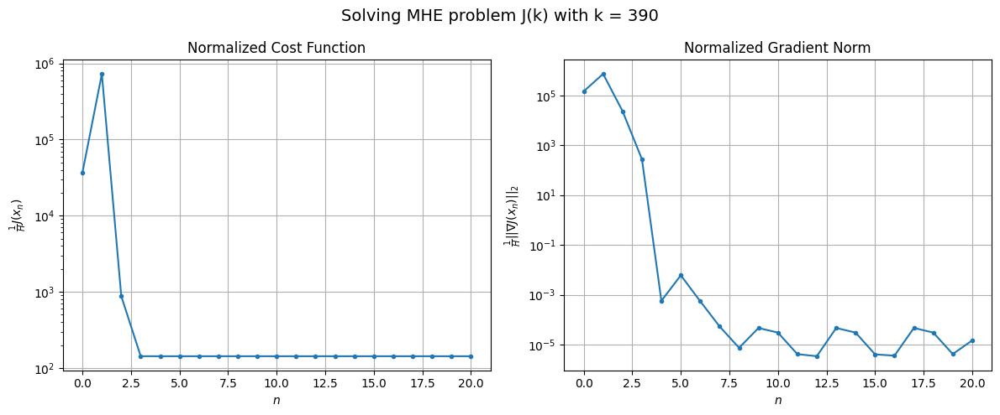

Windows:  99%|█████████▉| 382/386 [21:32<00:16,  4.04s/it]

[Gauss-Newton] Before applying the algorithm
Cost function: 2383.9521677509006
Gradient norm: 313354.6622908616
Global estimation error: 8001.483020531355
Initial conditions estimation errors: 0.7911192163869728 m, 3180.619689404954 m, 4974.896500219553 m, 5399.790763511153 m
Position estimation errors: 5.18918901184948 m, 3851.0561018881813 m, 5738.174003618058 m, 7493.40616080057 m

[Gauss-Newton] Iteration 1
Cost function: 27804.065613708484 (1066.30%)
Gradient norm: 404391.24566910556 (29.05%)
Global estimation error: 6363.696807407594 (-20.47%)
Initial conditions estimation errors: 2.662025147181825 m, 2561.371486328311 m, 3938.8216043074076 m, 4292.045704965728 m
Position estimation errors: 2.8243948540800847 m, 3094.3069635526667 m, 4625.705230225392 m, 5966.72856626995 m

[Gauss-Newton] Iteration 2
Cost function: 1492.9677060203803 (-94.63%)
Gradient norm: 19322.060259279006 (-95.22%)
Global estimation error: 6005.715398717101 (-5.63%)
Initial conditions estimation errors: 2.66

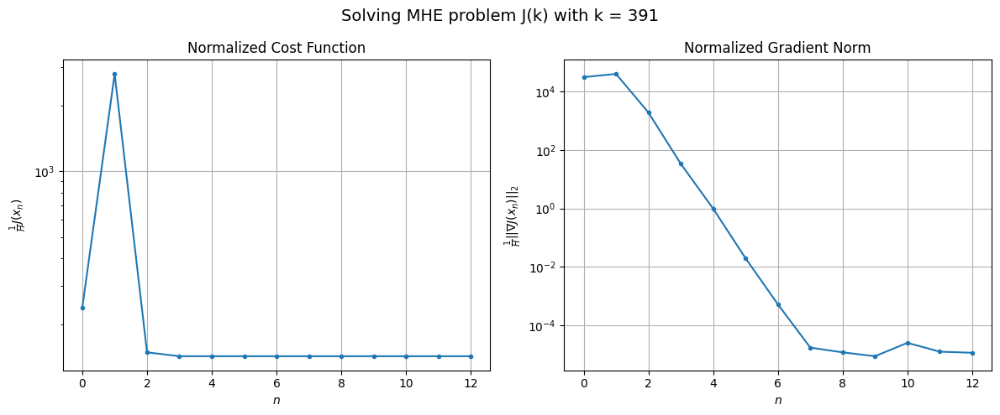

Windows:  99%|█████████▉| 383/386 [21:36<00:12,  4.00s/it]

[Gauss-Newton] Before applying the algorithm
Cost function: 2660.932617104042
Gradient norm: 343320.87401871546
Global estimation error: 6247.376708180252
Initial conditions estimation errors: 0.8192299650896331 m, 2495.9424883057227 m, 3824.395655466468 m, 4263.092573850909 m
Position estimation errors: 5.674344426527434 m, 2894.2531741207886 m, 4305.8752279428945 m, 5655.2215169093315 m

[Gauss-Newton] Iteration 1
Cost function: 248678.4550511338 (9245.54%)
Gradient norm: 1195020.4941228502 (248.08%)
Global estimation error: 3177.839965449408 (-49.13%)
Initial conditions estimation errors: 2.7227306417593162 m, 1257.3359111223874 m, 1926.6950129385787 m, 2192.1680535019923 m
Position estimation errors: 3.1655343541330034 m, 1617.2615248622715 m, 2332.987734971422 m, 3238.7612001085163 m

[Gauss-Newton] Iteration 2
Cost function: 30558.04499204027 (-87.71%)
Gradient norm: 415446.3208760817 (-65.24%)
Global estimation error: 1423.4081307066576 (-55.21%)
Initial conditions estimation er

/home/jgaspar/SpaceSim-Toolkit/test/new_newton_based_algorithms/gauss_newton.py:181: LinAlgWarning: Ill-conditioned matrix (rcond=5.90968e-17): result may not be accurate.
  delta_x = solve(HJ_x, -DJ_x)


[Gauss-Newton] Iteration 3
Cost function: 546193.2931849728 (1687.40%)
Gradient norm: 1827603.2141087125 (339.91%)
Global estimation error: 2139.963059276751 (50.34%)
Initial conditions estimation errors: 2.722730644812644 m, 845.9253562611744 m, 1387.0244457843016 m, 1392.841539184952 m
Position estimation errors: 3.1655343864663674 m, 794.8517200777782 m, 1334.6587727011733 m, 1346.96021892887 m



/home/jgaspar/SpaceSim-Toolkit/test/new_newton_based_algorithms/gauss_newton.py:181: LinAlgWarning: Ill-conditioned matrix (rcond=2.39567e-17): result may not be accurate.
  delta_x = solve(HJ_x, -DJ_x)


[Gauss-Newton] Iteration 4
Cost function: 193782817.46664986 (35378.80%)
Gradient norm: 32989794.022439145 (1705.09%)
Global estimation error: 19083.942649537352 (791.79%)
Initial conditions estimation errors: 2.722730560167467 m, 7515.038613231983 m, 11807.069732781363 m, 12973.591922670625 m
Position estimation errors: 3.1655344883561685 m, 7623.116528368466 m, 11776.398196693386 m, 14151.855491352548 m

[Gauss-Newton] Iteration 5
Cost function: 13128522.52554833 (-93.23%)
Gradient norm: 8932810.685757661 (-72.92%)
Global estimation error: 10568.689390230114 (-44.62%)
Initial conditions estimation errors: 2.722730593179687 m, 4136.484230597259 m, 6538.325538403892 m, 7199.790122868689 m
Position estimation errors: 3.1655344401445658 m, 3794.5052564373436 m, 5933.220396065481 m, 6913.083062320043 m

[Gauss-Newton] Iteration 6
Cost function: 21572.414505464032 (-99.84%)
Gradient norm: 323752.8055187609 (-96.38%)
Global estimation error: 8733.12278826847 (-17.37%)
Initial conditions est

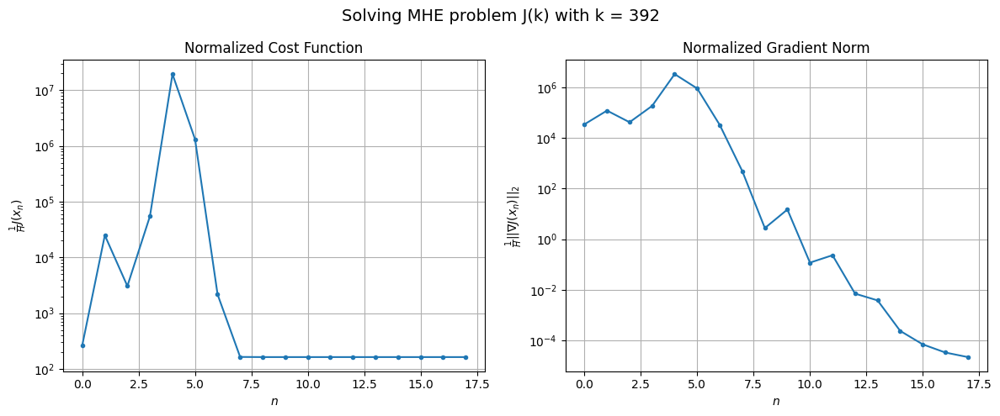

Windows:  99%|█████████▉| 384/386 [21:41<00:08,  4.43s/it]

[Gauss-Newton] Before applying the algorithm
Cost function: 3222.9495170238984
Gradient norm: 385656.61923721776
Global estimation error: 9184.218073067866
Initial conditions estimation errors: 0.8731886042703964 m, 3591.548230192111 m, 5640.148966662188 m, 6295.979703056867 m
Position estimation errors: 6.406158062048523 m, 3058.5988581085016 m, 4819.493086623846 m, 5543.621097559324 m

[Gauss-Newton] Iteration 1
Cost function: 44821431.0710989 (1390596.03%)
Gradient norm: 13088553.966447193 (3293.84%)
Global estimation error: 4939.260120666789 (-46.22%)
Initial conditions estimation errors: 2.9820654129981223 m, 1855.5809047446448 m, 2679.3428174587616 m, 3711.3610277000826 m
Position estimation errors: 3.6104945026840447 m, 695.0582525372824 m, 1099.7964937566987 m, 1179.9394068770268 m

[Gauss-Newton] Iteration 2
Cost function: 854017.8964539065 (-98.09%)
Gradient norm: 1445961.8217055767 (-88.95%)
Global estimation error: 1282.080682974859 (-74.04%)
Initial conditions estimation e

/home/jgaspar/SpaceSim-Toolkit/test/new_newton_based_algorithms/gauss_newton.py:181: LinAlgWarning: Ill-conditioned matrix (rcond=4.08219e-17): result may not be accurate.
  delta_x = solve(HJ_x, -DJ_x)


[Gauss-Newton] Iteration 3
Cost function: 1012223398.7958939 (118424.85%)
Gradient norm: 75356100.37667571 (5111.49%)
Global estimation error: 24967.530581685984 (1847.42%)
Initial conditions estimation errors: 2.9820654637595005 m, 9795.57890579689 m, 15094.186494189244 m, 17308.65688197503 m
Position estimation errors: 3.6104944802610905 m, 10023.285929277477 m, 15218.459557437875 m, 19215.653428888232 m

[Gauss-Newton] Iteration 4
Cost function: 89944431.67677172 (-91.11%)
Gradient norm: 21406126.644625917 (-71.59%)
Global estimation error: 8818.215430500593 (-64.68%)
Initial conditions estimation errors: 2.9820655259001643 m, 3479.226563345775 m, 5286.443963568039 m, 6140.793992130094 m
Position estimation errors: 3.610494455074472 m, 4053.509721438491 m, 6107.769325211646 m, 7964.064487106862 m

[Gauss-Newton] Iteration 5
Cost function: 6833603.0948685445 (-92.40%)
Gradient norm: 6823556.063539281 (-68.12%)
Global estimation error: 2624.674048860595 (-70.24%)
Initial conditions es

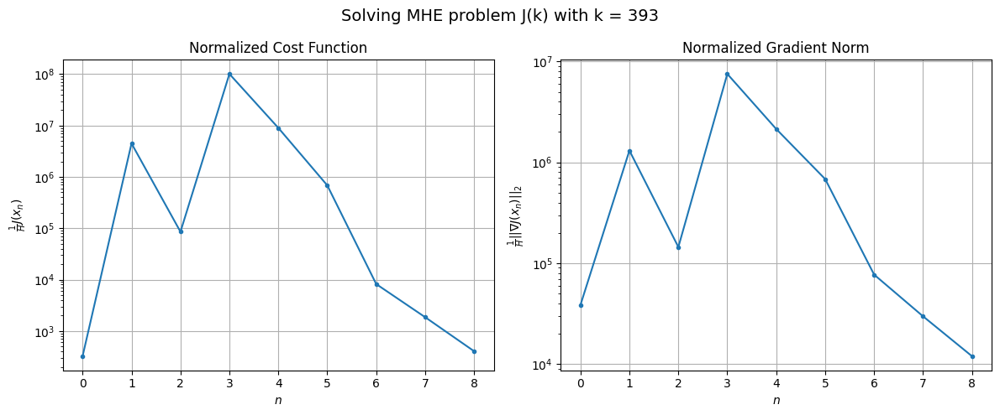

Windows: 100%|█████████▉| 385/386 [21:44<00:04,  4.04s/it]

[Gauss-Newton] Before applying the algorithm
Cost function: 6608.460592390503
Gradient norm: 457481.45539705484
Global estimation error: 4979.74616037152
Initial conditions estimation errors: 1.076809848284259 m, 1952.8112700147096 m, 2908.4405681937187 m, 3539.1195153158837 m
Position estimation errors: 7.230540752293937 m, 1969.8101677342852 m, 2972.389389004635 m, 3878.248353513414 m

[Gauss-Newton] Iteration 1
Cost function: 2609.9027430975207 (-60.51%)
Gradient norm: 1007.1261160936635 (-99.78%)
Global estimation error: 5170.161559704811 (3.82%)
Initial conditions estimation errors: 3.278282612994805 m, 2020.2951570334353 m, 3009.3522769572655 m, 3686.8363379216917 m
Position estimation errors: 4.084745209287454 m, 1977.1748086984928 m, 2961.6295412884842 m, 3884.9324552045077 m

[Gauss-Newton] Iteration 2
Cost function: 2610.749028194958 (0.03%)
Gradient norm: 3732.864709029464 (270.65%)
Global estimation error: 5226.764863046829 (1.09%)
Initial conditions estimation errors: 3.27

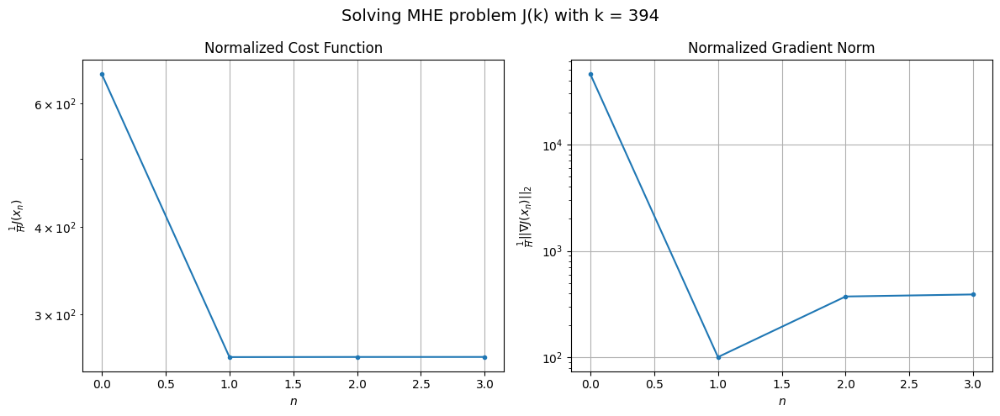

This Monte Carlo run RMSE for 386 timestamps:
RMSE_1 = 3.005217366755155
RMSE_2 = 7066.648121050297
RMSE_3 = 6367.770035464999
RMSE_4 = 25570.48143011697
CentralizedNewton applied to J(H - 1) converged with [] iterations.
CentralizedNewton applied to J(k) with k = H, ..., K - 1 converged with nan iterations on average.


/usr/local/lib/python3.10/dist-packages/numpy/core/fromnumeric.py:3504: RuntimeWarning: Mean of empty slice.
  return _methods._mean(a, axis=axis, dtype=dtype,
/usr/local/lib/python3.10/dist-packages/numpy/core/_methods.py:129: RuntimeWarning: invalid value encountered in scalar divide
  ret = ret.dtype.type(ret / rcount)


In [7]:
first_round_stop_iteration = []
K_minus_H_next_rounds_stop_iteration = []

# Cold-start
x_init = X_initial + np.random.multivariate_normal(np.zeros(n), P_0).reshape((n, 1))

# Apply the algorithm
X_est = np.zeros((n, 1, K))
for k in tqdm(range(H - 1, K), desc="Windows", leave=False):
    centralized_newton.cost_values, centralized_newton.gradient_norm_values = [], []
    x_init, x_est = centralized_newton.solve_MHE_problem(k, dt, Y, x_init, X_true[:, :, k - H + 1],  X_true[:, :, k])
    X_est[:, :, k] = x_est
    
    plots(k, centralized_newton)

    # Warm-start
    x_init = dyn.f(dt, x_init)

# After each Monte Carlo Run compute the RMSE_m for each K - H + 1 timestamps
position_estimation_error_1, position_estimation_error_2, position_estimation_error_3, position_estimation_error_4 = [], [], [], []
for k in range(H - 1, K):
    position_estimation_error_1.append(np.linalg.norm(X_est[:n_p, :, k] - X_true[:n_p, :, k]))
    position_estimation_error_2.append(np.linalg.norm(X_est[n_x:n_x + n_p, :, k] - X_true[n_x:n_x + n_p, :, k]))
    position_estimation_error_3.append(np.linalg.norm(X_est[2*n_x:2*n_x + n_p, :, k] - X_true[2*n_x:2*n_x + n_p, :, k]))
    position_estimation_error_4.append(np.linalg.norm(X_est[3*n_x:3*n_x + n_p, :, k] - X_true[3*n_x:3*n_x + n_p, :, k]))
rmse_1 = np.sqrt(np.mean(np.array(position_estimation_error_1) ** 2))
rmse_2 = np.sqrt(np.mean(np.array(position_estimation_error_2) ** 2))
rmse_3 = np.sqrt(np.mean(np.array(position_estimation_error_3) ** 2))
rmse_4 = np.sqrt(np.mean(np.array(position_estimation_error_4) ** 2))
print(f'This Monte Carlo run RMSE for {K - H + 1} timestamps:')
print(f'RMSE_1 = {np.mean(rmse_1)}\nRMSE_2 = {np.mean(rmse_2)}\nRMSE_3 = {np.mean(rmse_3)}\nRMSE_4 = {np.mean(rmse_4)}')
print(f'CentralizedNewton applied to J(H - 1) converged with {first_round_stop_iteration} iterations.')
print(f'CentralizedNewton applied to J(k) with k = H, ..., K - 1 converged with {np.mean(K_minus_H_next_rounds_stop_iteration)} iterations on average.')

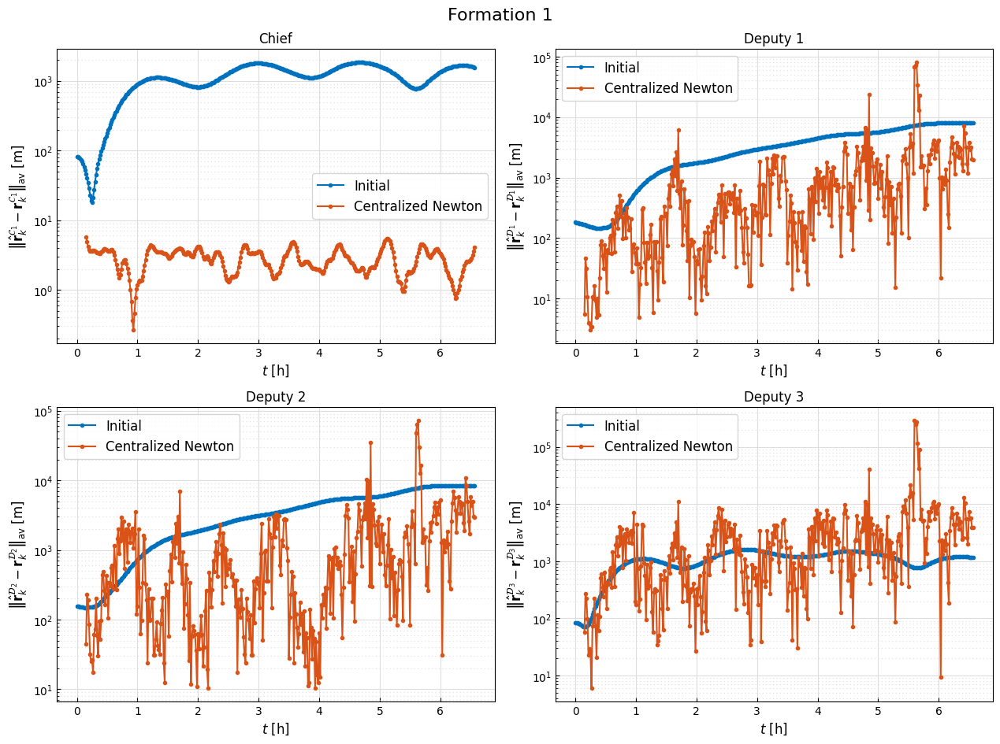

In [8]:
# MATLAB default color cycle
matlab_default_colors = [
    [0, 0.4470, 0.7410],  # blue
    [0.8500, 0.3250, 0.0980],  # orange
    [0.9290, 0.6940, 0.1250],  # yellow
    [0.4940, 0.1840, 0.5560],  # purple
    [0.4660, 0.6740, 0.1880],  # green
    [0.3010, 0.7450, 0.9330],  # light blue
    [0.6350, 0.0780, 0.1840],  # red
]
# Set the color cycle in Matplotlib to match MATLAB's default
plt.rcParams["axes.prop_cycle"] = plt.cycler(color=matlab_default_colors)

time = np.arange(0, K) / dt
algorithm = "Centralized Newton"

# Plot positions based on screen size
fig_width = 2 * 6.4  # in inchesa
fig_height = 2 * 4.8  # in inches

# Create a 2 by 2 figure
fig, axs = plt.subplots(2, 2, figsize=(fig_width, fig_height))

# Plot 1: Chief
axs[0, 0].plot(time, position_estimation_error_1_initial, ".-", label="Initial")
axs[0, 0].plot(time[H - 1:], position_estimation_error_1, ".-", label=algorithm)
axs[0, 0].grid(which="major", color="#DDDDDD", zorder=1)
axs[0, 0].grid(which="minor", color="#DDDDDD", linestyle=(0, (1, 3)), zorder=2)
axs[0, 0].grid(True, which="both")
axs[0, 0].set_yscale("log")
axs[0, 0].set_xlabel("$t$ [h]", fontsize=12)
axs[0, 0].set_ylabel(
    "$\\left\\|\\hat{\\mathbf{r}}_k^{\\mathcal{C}_1} - \\mathbf{r}_k^{\\mathcal{C}_1}\\right\\|_\\mathrm{av}$ [m]",
    fontsize=12,
)
# axs[0, 0].set_ylim([1e-2, 1e3])
axs[0, 0].tick_params(axis="both", which="both", direction="in")
axs[0, 0].legend(fontsize=12)
axs[0, 0].set_title("Chief")

# Plot 2: Deputy 1
axs[0, 1].plot(time, position_estimation_error_2_initial, ".-", label="Initial")
axs[0, 1].plot(time[H - 1:], position_estimation_error_2, ".-", label=algorithm)
axs[0, 1].grid(which="major", color="#DDDDDD", zorder=1)
axs[0, 1].grid(which="minor", color="#DDDDDD", linestyle=(0, (1, 3)), zorder=2)
axs[0, 1].grid(True, which="both")
axs[0, 1].set_yscale("log")
axs[0, 1].set_xlabel("$t$ [h]", fontsize=12)
axs[0, 1].set_ylabel(
    "$\\left\\|\\hat{\\mathbf{r}}_k^{\\mathcal{D}_1} - \\mathbf{r}_k^{\\mathcal{D}_1}\\right\\|_\\mathrm{av}$ [m]",
    fontsize=12,
)
# axs[0, 1].set_ylim([1e-1, 1e3])
axs[0, 1].tick_params(axis="both", which="both", direction="in")
axs[0, 1].legend(fontsize=12)
axs[0, 1].set_title("Deputy 1")

# Plot 3: Deputy 2
axs[1, 0].plot(time, position_estimation_error_3_initial, ".-", label="Initial")
axs[1, 0].plot(time[H - 1:], position_estimation_error_3, ".-", label=algorithm)
axs[1, 0].grid(which="major", color="#DDDDDD", zorder=1)
axs[1, 0].grid(which="minor", color="#DDDDDD", linestyle=(0, (1, 3)), zorder=2)
axs[1, 0].grid(True, which="both")
axs[1, 0].set_yscale("log")
axs[1, 0].set_xlabel("$t$ [h]", fontsize=12)
axs[1, 0].set_ylabel(
    "$\\left\\|\\hat{\\mathbf{r}}_k^{\\mathcal{D}_2} - \\mathbf{r}_k^{\\mathcal{D}_2}\\right\\|_\\mathrm{av}$ [m]",
    fontsize=12,
)
# axs[1, 0].set_ylim([1e-1, 1e3])
axs[1, 0].tick_params(axis="both", which="both", direction="in")
axs[1, 0].legend(fontsize=12)
axs[1, 0].set_title("Deputy 2")

# Plot 4: Deputy 3
axs[1, 1].plot(time, position_estimation_error_4_initial, ".-", label="Initial")
axs[1, 1].plot(time[H - 1:], position_estimation_error_4, ".-", label=algorithm)
axs[1, 1].grid(which="major", color="#DDDDDD", zorder=1)
axs[1, 1].grid(which="minor", color="#DDDDDD", linestyle=(0, (1, 3)), zorder=2)
axs[1, 1].grid(True, which="both")
axs[1, 1].set_yscale("log")
axs[1, 1].set_xlabel("$t$ [h]", fontsize=12)
axs[1, 1].set_ylabel(
    "$\\left\\|\\hat{\\mathbf{r}}_k^{\\mathcal{D}_3} - \\mathbf{r}_k^{\\mathcal{D}_3}\\right\\|_\\mathrm{av}$ [m]",
    fontsize=12,
)
# axs[1, 1].set_ylim([1e-1, 1e3])
axs[1, 1].tick_params(axis="both", which="both", direction="in")
axs[1, 1].legend(fontsize=12)
axs[1, 1].set_title("Deputy 3")

fig.suptitle(f"Formation {formation}", fontsize=16)
plt.tight_layout(rect=[0, 0, 1, 1])
plt.show()

In [15]:
import pickle
from datetime import datetime

# Fill the dictionary
data = {}
data["H"] = H
data["true"] = X_true
data[0] = X_est

# Save to pickle file
with open(f'gauss_newton_H{H}_form{formation}_{datetime.now().strftime("%Y%m%d_%H%M%S")}.pkl', "wb") as file:
    pickle.dump(data, file)